In [1]:
import numpy as np
import random
import os 
import torch
import torch.nn as nn
from torch import Tensor
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader, SubsetRandomSampler, ConcatDataset
import torch.nn.functional as F
from torch.cuda.amp.grad_scaler import GradScaler
from torch.cuda.amp import autocast

from torchsummary import summary
from sklearn.metrics import r2_score

from ray import tune

import json
import itertools
from itertools import groupby
import gzip 
from io import BytesIO
from time import time 

import matplotlib.pyplot as plt

# import pyBigWig
from scipy.sparse import csc_matrix
import math 

import torch.cuda.amp as amp

import functools

import captum 
from captum.attr import DeepLift, DeepLiftShap
# import seaborn as sns
from sklearn.metrics import confusion_matrix, precision_score, f1_score

from copy import deepcopy


In [2]:
from modules import * 

In [3]:
class upd_GELU(nn.Module):
    def forward(self, input: Tensor) -> Tensor:
        return torch.sigmoid(torch.Tensor([1.702]).cuda() * input) * input

def ones_(tensor: Tensor) -> Tensor:
    return torch.ones_like(tensor)

def zeros_(tensor: Tensor) -> Tensor:
    return torch.zeros_like(tensor)

class BasenjiModel_Classif(nn.Module):
    def __init__(self, num_targets, n_channel=4, max_len=128, 
                 conv1kc=64, conv1ks=15, conv1st=1, conv1pd=7, pool1ks=8, pool1st=1 , pdrop1=0.4, #conv_block_1 parameters
                 conv2kc=64, conv2ks=5, conv2st=1, conv2pd=3, pool2ks=4 , pool2st=1, pdrop2=0.4, #conv_block_2 parameters
                 conv3kc=round(64*1.125), conv3ks=5, conv3st=1, conv3pd=3, pool3ks=4 , pool3st=1, pdrop3=0.4, #conv_block_2 parameters
                 convdc = 6, convdkc=32 , convdks=3, debug=False):                 
        super(BasenjiModel_Classif, self).__init__()
        
        self.convdc = convdc
        self.debug = debug
        self.num_targets =  num_targets
        ## CNN + dilated CNN
        
        self.conv_block_1 = nn.Sequential(
            upd_GELU(),
            nn.Conv1d(n_channel, conv1kc, kernel_size=conv1ks, stride=conv1st, padding=conv1pd, bias=False),
            nn.BatchNorm1d(conv1kc, momentum=0.9, affine=True),
            nn.MaxPool1d(kernel_size=pool1ks),
            nn.Dropout(p=0.2))
                
        self.conv_block_2 = nn.Sequential(
            upd_GELU(),
            nn.Conv1d(conv1kc, conv2kc, kernel_size=conv2ks, stride=conv2st, padding=conv2pd, bias=False),
            nn.BatchNorm1d(conv2kc, momentum=0.9, affine=True),
            nn.MaxPool1d(kernel_size=pool2ks),
            nn.Dropout(p=0.2))
        
        self.conv_block_3 = nn.Sequential(
            upd_GELU(),
            nn.Conv1d(conv2kc, round(conv2kc*1.125), kernel_size=conv3ks, stride=conv3st, padding=conv3pd, bias=False),
            nn.BatchNorm1d(conv3kc, momentum=0.9, affine=True),
            nn.MaxPool1d(kernel_size=pool3ks),
            nn.Dropout(p=0.2))
        

        self.dilations = nn.ModuleList()
        for i in range(convdc):
            padding = 2**(i)
            self.dilations.append(nn.Sequential(
                upd_GELU(),
                nn.Conv1d(conv3kc, 32, kernel_size=3, padding=padding, dilation=2**i, bias=False),
                nn.BatchNorm1d(32, momentum=0.9, affine=True), 
                upd_GELU(),
                nn.Conv1d(32, 72, kernel_size=1, padding=0, bias=False),
                nn.BatchNorm1d(72, momentum=0.9, affine=True), 
                nn.Dropout(p=0.25)))
            
        self.conv_block_4 = nn.Sequential(
            upd_GELU(),
            nn.Conv1d(72, 64, kernel_size=1, stride=1, padding=0, bias=False),
            nn.BatchNorm1d(64, momentum=0.9, affine=True), 
            nn.Dropout(p=0.1)) 
            
        self.conv_block_5 = nn.Sequential(
            upd_GELU(),
            nn.Linear(64, self.num_targets, bias=True)) 

    
        self.conv_block_1[1].weight.data = self.truncated_normal(self.conv_block_1[1].weight, 0.0, np.sqrt(2/60)) #4
        self.conv_block_2[1].weight.data = self.truncated_normal(self.conv_block_2[1].weight, 0.0, np.sqrt(2/322)) # conv1kc
        self.conv_block_3[1].weight.data = self.truncated_normal(self.conv_block_3[1].weight, 0.0, np.sqrt(2/322)) # conv1kc
        self.conv_block_4[1].weight.data = self.truncated_normal(self.conv_block_4[1].weight, 0.0, np.sqrt(2/72)) # 72
        self.conv_block_5[1].weight.data = self.truncated_normal(self.conv_block_5[1].weight, 0.0, np.sqrt(2/64)) # 64        
        self.conv_block_1[2].weight.data = ones_(self.conv_block_1[2].weight)
        self.conv_block_2[2].weight.data = ones_(self.conv_block_2[2].weight)
        self.conv_block_3[2].weight.data = ones_(self.conv_block_3[2].weight)
        self.conv_block_4[2].weight.data = ones_(self.conv_block_4[2].weight)

        
        for i in range(convdc):
            self.dilations[i][1].weight.data = self.truncated_normal(self.dilations[i][1].weight, 0.0, np.sqrt(2/218)) # 72
            self.dilations[i][-2].weight.data = self.truncated_normal(self.dilations[i][-2].weight, 0.0, np.sqrt(2/32)) # 32
            self.dilations[i][2].weight.data = zeros_(self.dilations[i][2].weight)
            self.dilations[i][-2].weight.data = ones_(self.dilations[i][-2].weight)

    
    def truncated_normal(self, t, mean, std):
        torch.nn.init.normal_(t, mean, std)
        while True:
            cond = torch.logical_or(t < (mean - 2.28*std), t > (mean + 2.28*std))
            if not torch.sum(cond):
                break
            t = torch.where(cond, torch.nn.init.normal_(torch.ones(t.shape), mean=mean, std=std), t)
        return t


    def forward(self, seq):
        if self.debug: 
            print (seq.shape)
        seq = self.conv_block_1(seq)
        if self.debug: 
            print ('conv1', seq.shape)
        seq = self.conv_block_2(seq)
        if self.debug: 
            print ('conv2', seq.shape)
        seq = self.conv_block_3(seq)
        if self.debug: 
            print ('conv3', seq.shape)
        for i in range(self.convdc):
            if i == 0:
                y = self.dilations[i](seq)
            if i >= 1:
                y = y.add(self.dilations[i](seq))
            if self.debug: 
                print ('dil', i, self.dilations[i](seq).shape)
        if self.debug:
            print ('y', y.shape)
        res = self.conv_block_4(y)
        if self.debug: 
            print ('res', res.shape)
        res_lin = res.transpose(1, 2)
        if self.debug: 
            print ('res_lin', res_lin.shape)
        res = self.conv_block_5(res_lin)
        if self.debug: 
            print ('res', res.shape)
        return res
        
    def compile(self, device='cpu'):
        self.to(device)

In [4]:
param_vals = { 
"mode": "classification",
"optimizer" : "Adam", 
"init_lr": 0.001, 
"optimizer_momentum": 0.9, 
"weight_decay": 1e-3, 
"loss": "bce", 
"num_targets": 1,
"seq_len": 128*128*8,
"target_window": 1024*32,
"batch_size": 8,
"cut": 0.8,
"num_workers": 8,
"num_epochs": 20,
}


In [5]:
memmap_data_contigs_dir = '/data/users/goodarzilab/darya/work/Datasets/hg38_memmaps'
targets_memmap_data_dir_cl = '/data/users/goodarzilab/darya/work/Datasets/hg38_targets_memmaps_CL.ATAC'
targets_memmap_data_dir_pdx = '/data/users/goodarzilab/darya/work/Datasets/hg38_targets_memmaps_PDX.ATAC'
target_files_dir = [targets_memmap_data_dir_cl, targets_memmap_data_dir_pdx]

In [6]:
model = BasenjiModel_Classif(num_targets=1)
model.compile('cuda')

In [7]:
trainer = Trainer(param_vals, model, memmap_data_contigs_dir, target_files_dir)

init dsets


In [8]:
# trainer = Trainer(param_vals, model, memmap_data_contigs_dir, targets_memmap_data_dir_cl, targets_memmap_data_dir_pdx, mode='classification')

In [9]:
# trainer.load_model(trainer.model, "basenji_toy_upd_motif_32k_recfield_13epochs.pt")

In [10]:
# trainer.save_model(trainer.model, "basenji_toy_upd_motif_32k_recfield_160bp_8epochs.pt")

In [11]:
# f1 = f1_score(y_true, y_pred, average='macro')
# pres = precision_score(y_true, y_pred, average='micro')


In [12]:
torch.set_num_threads(8)

began training
2220 582
Train Epoch: 0 [0/2220 (0%)]	Loss: 0.725240	Pres: 0.010254	F1 Score: 0.020300
84.0 555.5


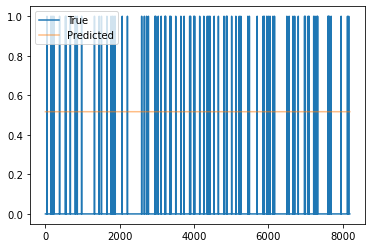

Train Epoch: 0 [10/2220 (0%)]	Loss: 0.700228	Pres: 0.008251	F1 Score: 0.016201
Train Epoch: 0 [20/2220 (0%)]	Loss: 0.537619	Pres: 0.009050	F1 Score: 0.017241
Train Epoch: 0 [30/2220 (1%)]	Loss: 0.416781	Pres: 0.005576	F1 Score: 0.009804
Train Epoch: 0 [40/2220 (1%)]	Loss: 0.321665	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [50/2220 (2%)]	Loss: 0.241420	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [60/2220 (2%)]	Loss: 0.188571	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [70/2220 (3%)]	Loss: 0.150530	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [80/2220 (3%)]	Loss: 0.138120	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [90/2220 (4%)]	Loss: 0.114149	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [100/2220 (4%)]	Loss: 0.105717	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [110/2220 (4%)]	Loss: 0.097361	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [120/2220 (5%)]	Loss: 0.090425	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [130/2220 (5%)]	Loss: 0.085655	Pre

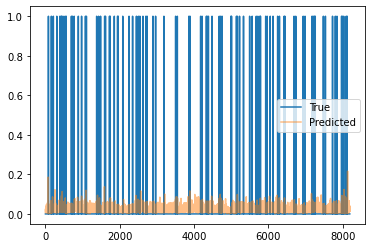

Train Epoch: 0 [310/2220 (13%)]	Loss: 0.054116	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [320/2220 (14%)]	Loss: 0.053022	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [330/2220 (14%)]	Loss: 0.047670	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [340/2220 (15%)]	Loss: 0.049225	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [350/2220 (15%)]	Loss: 0.052025	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [360/2220 (16%)]	Loss: 0.048360	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [370/2220 (16%)]	Loss: 0.045502	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [380/2220 (17%)]	Loss: 0.046142	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [390/2220 (17%)]	Loss: 0.043875	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [400/2220 (18%)]	Loss: 0.045594	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [410/2220 (18%)]	Loss: 0.044551	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [420/2220 (18%)]	Loss: 0.042744	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [430/2220 (19

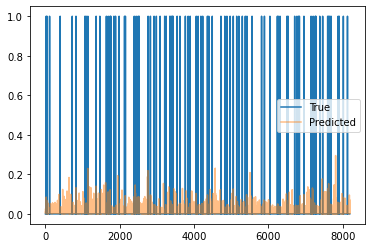

Train Epoch: 0 [610/2220 (27%)]	Loss: 0.042179	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [620/2220 (27%)]	Loss: 0.041818	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [630/2220 (28%)]	Loss: 0.042245	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [640/2220 (28%)]	Loss: 0.034046	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [650/2220 (29%)]	Loss: 0.037441	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [660/2220 (29%)]	Loss: 0.038530	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [670/2220 (30%)]	Loss: 0.042455	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [680/2220 (30%)]	Loss: 0.042513	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [690/2220 (31%)]	Loss: 0.042701	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [700/2220 (31%)]	Loss: 0.038579	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [710/2220 (31%)]	Loss: 0.038442	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [720/2220 (32%)]	Loss: 0.036066	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [730/2220 (32

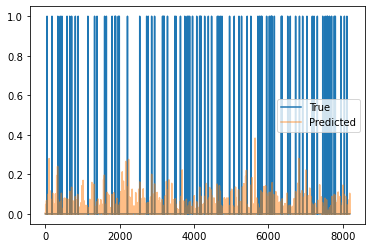

Train Epoch: 0 [910/2220 (40%)]	Loss: 0.038077	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [920/2220 (41%)]	Loss: 0.035414	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [930/2220 (41%)]	Loss: 0.033204	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [940/2220 (42%)]	Loss: 0.040725	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [950/2220 (42%)]	Loss: 0.034471	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [960/2220 (43%)]	Loss: 0.036045	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [970/2220 (43%)]	Loss: 0.033416	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [980/2220 (44%)]	Loss: 0.034015	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [990/2220 (44%)]	Loss: 0.037724	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [1000/2220 (45%)]	Loss: 0.035915	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [1010/2220 (45%)]	Loss: 0.035439	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [1020/2220 (45%)]	Loss: 0.038853	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [1030/2220

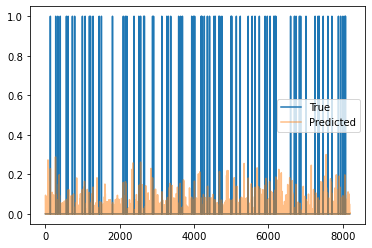

Train Epoch: 0 [1210/2220 (54%)]	Loss: 0.033163	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [1220/2220 (54%)]	Loss: 0.027842	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [1230/2220 (55%)]	Loss: 0.037379	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [1240/2220 (55%)]	Loss: 0.035875	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [1250/2220 (56%)]	Loss: 0.029641	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [1260/2220 (56%)]	Loss: 0.031159	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [1270/2220 (57%)]	Loss: 0.035914	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [1280/2220 (57%)]	Loss: 0.035265	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [1290/2220 (58%)]	Loss: 0.038897	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [1300/2220 (58%)]	Loss: 0.037497	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [1310/2220 (59%)]	Loss: 0.037075	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [1320/2220 (59%)]	Loss: 0.034587	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [

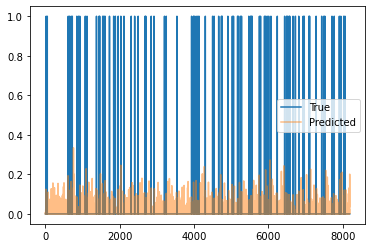

Train Epoch: 0 [1510/2220 (68%)]	Loss: 0.033807	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [1520/2220 (68%)]	Loss: 0.034426	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [1530/2220 (68%)]	Loss: 0.034811	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [1540/2220 (69%)]	Loss: 0.035483	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [1550/2220 (69%)]	Loss: 0.034206	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [1560/2220 (70%)]	Loss: 0.029897	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [1570/2220 (70%)]	Loss: 0.034346	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [1580/2220 (71%)]	Loss: 0.032568	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [1590/2220 (71%)]	Loss: 0.033133	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [1600/2220 (72%)]	Loss: 0.028569	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [1610/2220 (72%)]	Loss: 0.030986	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [1620/2220 (72%)]	Loss: 0.034868	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [

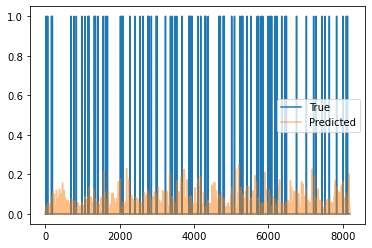

Train Epoch: 0 [1810/2220 (81%)]	Loss: 0.033095	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [1820/2220 (81%)]	Loss: 0.034651	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [1830/2220 (82%)]	Loss: 0.031580	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [1840/2220 (82%)]	Loss: 0.038070	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [1850/2220 (83%)]	Loss: 0.032638	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [1860/2220 (83%)]	Loss: 0.035520	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [1870/2220 (84%)]	Loss: 0.035936	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [1880/2220 (84%)]	Loss: 0.032911	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [1890/2220 (85%)]	Loss: 0.039359	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [1900/2220 (85%)]	Loss: 0.038125	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [1910/2220 (86%)]	Loss: 0.034484	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [1920/2220 (86%)]	Loss: 0.032086	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [

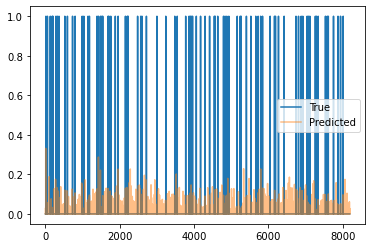

Train Epoch: 0 [2110/2220 (95%)]	Loss: 0.037884	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [2120/2220 (95%)]	Loss: 0.035764	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [2130/2220 (95%)]	Loss: 0.031105	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [2140/2220 (96%)]	Loss: 0.034245	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [2150/2220 (96%)]	Loss: 0.029791	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [2160/2220 (97%)]	Loss: 0.036467	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [2170/2220 (97%)]	Loss: 0.034861	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [2180/2220 (98%)]	Loss: 0.035041	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [2190/2220 (98%)]	Loss: 0.029950	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [2200/2220 (99%)]	Loss: 0.035179	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [2210/2220 (99%)]	Loss: 0.033824	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 0 [0/582 (0%)]	Loss: 0.033594	Pres: 0.000000	F1 Score: 0.000000


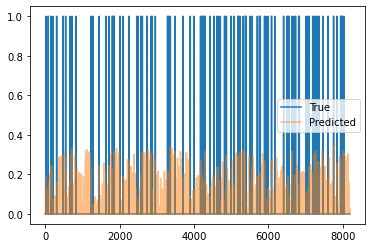

Validation Epoch: 0 [10/582 (1%)]	Loss: 0.035299	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 0 [20/582 (3%)]	Loss: 0.032942	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 0 [30/582 (5%)]	Loss: 0.033229	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 0 [40/582 (6%)]	Loss: 0.032660	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 0 [50/582 (8%)]	Loss: 0.034145	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 0 [60/582 (10%)]	Loss: 0.033852	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 0 [70/582 (12%)]	Loss: 0.032955	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 0 [80/582 (13%)]	Loss: 0.034354	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 0 [90/582 (15%)]	Loss: 0.033403	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 0 [100/582 (17%)]	Loss: 0.035253	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 0 [110/582 (18%)]	Loss: 0.034986	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 0 [120/582 (20%)]	Loss: 0.034012	Pres: 0.000000	F1 Score: 0.0

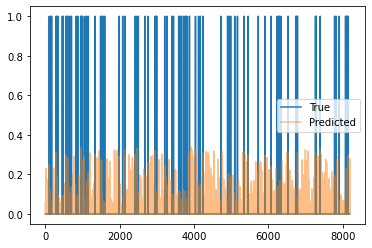

Validation Epoch: 0 [310/582 (53%)]	Loss: 0.034525	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 0 [320/582 (54%)]	Loss: 0.031973	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 0 [330/582 (56%)]	Loss: 0.032162	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 0 [340/582 (58%)]	Loss: 0.034312	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 0 [350/582 (60%)]	Loss: 0.030799	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 0 [360/582 (61%)]	Loss: 0.032293	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 0 [370/582 (63%)]	Loss: 0.031763	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 0 [380/582 (65%)]	Loss: 0.033662	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 0 [390/582 (67%)]	Loss: 0.034988	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 0 [400/582 (68%)]	Loss: 0.032782	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 0 [410/582 (70%)]	Loss: 0.031849	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 0 [420/582 (72%)]	Loss: 0.031439	Pres: 0.000000

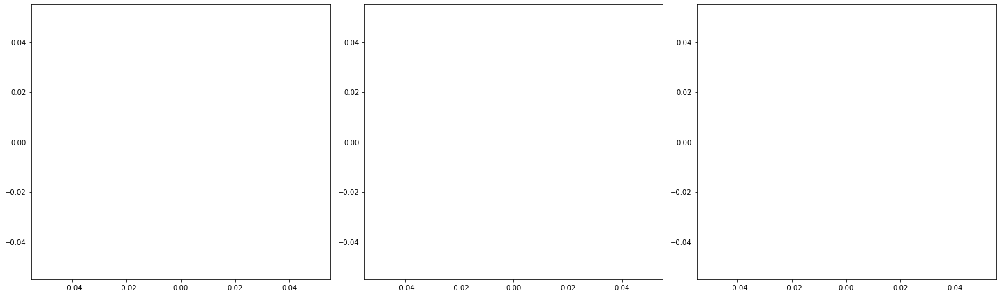

2220 582
Train Epoch: 1 [0/2220 (0%)]	Loss: 0.038338	Pres: 0.000000	F1 Score: 0.000000
93.0 -56768.0


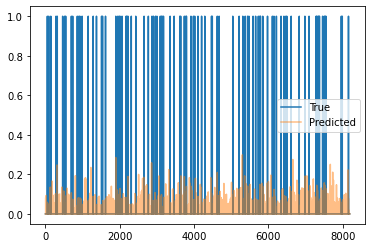

Train Epoch: 1 [10/2220 (0%)]	Loss: 0.038218	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [20/2220 (0%)]	Loss: 0.038110	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [30/2220 (1%)]	Loss: 0.035573	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [40/2220 (1%)]	Loss: 0.039111	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [50/2220 (2%)]	Loss: 0.032410	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [60/2220 (2%)]	Loss: 0.032208	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [70/2220 (3%)]	Loss: 0.039648	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [80/2220 (3%)]	Loss: 0.035461	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [90/2220 (4%)]	Loss: 0.036473	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [100/2220 (4%)]	Loss: 0.032860	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [110/2220 (4%)]	Loss: 0.034857	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [120/2220 (5%)]	Loss: 0.032492	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [130/2220 (5%)]	Loss: 0.032984	Pre

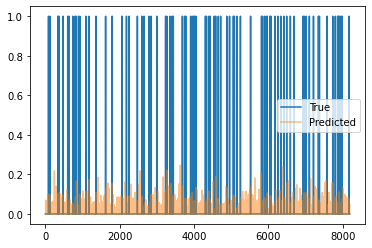

Train Epoch: 1 [310/2220 (13%)]	Loss: 0.029726	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [320/2220 (14%)]	Loss: 0.039722	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [330/2220 (14%)]	Loss: 0.034944	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [340/2220 (15%)]	Loss: 0.031041	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [350/2220 (15%)]	Loss: 0.032000	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [360/2220 (16%)]	Loss: 0.033197	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [370/2220 (16%)]	Loss: 0.034387	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [380/2220 (17%)]	Loss: 0.033410	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [390/2220 (17%)]	Loss: 0.036478	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [400/2220 (18%)]	Loss: 0.034919	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [410/2220 (18%)]	Loss: 0.029940	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [420/2220 (18%)]	Loss: 0.035416	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [430/2220 (19

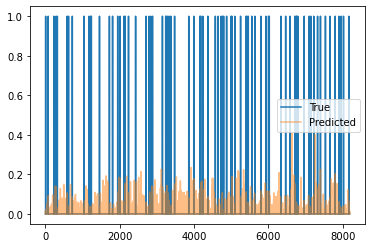

Train Epoch: 1 [610/2220 (27%)]	Loss: 0.037826	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [620/2220 (27%)]	Loss: 0.035756	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [630/2220 (28%)]	Loss: 0.035535	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [640/2220 (28%)]	Loss: 0.035654	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [650/2220 (29%)]	Loss: 0.032850	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [660/2220 (29%)]	Loss: 0.034798	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [670/2220 (30%)]	Loss: 0.040668	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [680/2220 (30%)]	Loss: 0.038178	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [690/2220 (31%)]	Loss: 0.036473	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [700/2220 (31%)]	Loss: 0.033769	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [710/2220 (31%)]	Loss: 0.033629	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [720/2220 (32%)]	Loss: 0.033383	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [730/2220 (32

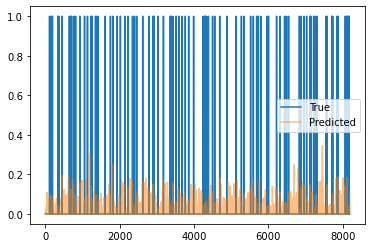

Train Epoch: 1 [910/2220 (40%)]	Loss: 0.032578	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [920/2220 (41%)]	Loss: 0.040284	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [930/2220 (41%)]	Loss: 0.028567	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [940/2220 (42%)]	Loss: 0.036890	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [950/2220 (42%)]	Loss: 0.034808	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [960/2220 (43%)]	Loss: 0.031631	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [970/2220 (43%)]	Loss: 0.037150	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [980/2220 (44%)]	Loss: 0.036016	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [990/2220 (44%)]	Loss: 0.035349	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [1000/2220 (45%)]	Loss: 0.038471	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [1010/2220 (45%)]	Loss: 0.035676	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [1020/2220 (45%)]	Loss: 0.035389	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [1030/2220

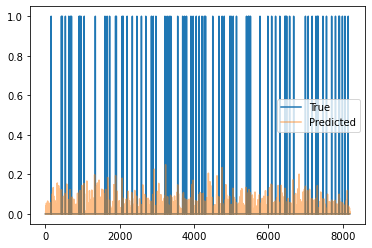

Train Epoch: 1 [1210/2220 (54%)]	Loss: 0.035357	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [1220/2220 (54%)]	Loss: 0.038394	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [1230/2220 (55%)]	Loss: 0.035168	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [1240/2220 (55%)]	Loss: 0.037743	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [1250/2220 (56%)]	Loss: 0.035907	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [1260/2220 (56%)]	Loss: 0.039428	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [1270/2220 (57%)]	Loss: 0.035880	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [1280/2220 (57%)]	Loss: 0.034531	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [1290/2220 (58%)]	Loss: 0.031741	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [1300/2220 (58%)]	Loss: 0.034169	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [1310/2220 (59%)]	Loss: 0.033784	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [1320/2220 (59%)]	Loss: 0.035434	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [

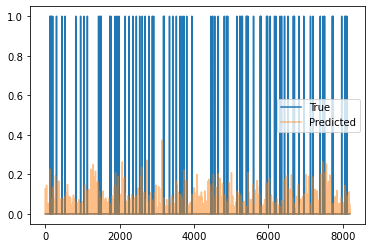

Train Epoch: 1 [1510/2220 (68%)]	Loss: 0.034345	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [1520/2220 (68%)]	Loss: 0.036315	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [1530/2220 (68%)]	Loss: 0.035887	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [1540/2220 (69%)]	Loss: 0.034415	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [1550/2220 (69%)]	Loss: 0.039193	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [1560/2220 (70%)]	Loss: 0.029759	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [1570/2220 (70%)]	Loss: 0.036043	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [1580/2220 (71%)]	Loss: 0.038666	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [1590/2220 (71%)]	Loss: 0.038532	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [1600/2220 (72%)]	Loss: 0.032690	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [1610/2220 (72%)]	Loss: 0.035675	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [1620/2220 (72%)]	Loss: 0.037405	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [

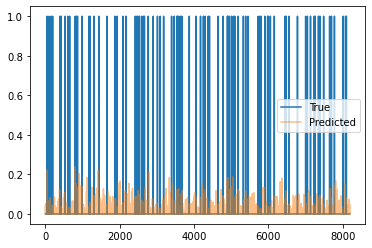

Train Epoch: 1 [1810/2220 (81%)]	Loss: 0.037418	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [1820/2220 (81%)]	Loss: 0.031593	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [1830/2220 (82%)]	Loss: 0.032551	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [1840/2220 (82%)]	Loss: 0.035869	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [1850/2220 (83%)]	Loss: 0.035052	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [1860/2220 (83%)]	Loss: 0.035850	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [1870/2220 (84%)]	Loss: 0.031040	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [1880/2220 (84%)]	Loss: 0.050727	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [1890/2220 (85%)]	Loss: 0.038137	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [1900/2220 (85%)]	Loss: 0.037962	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [1910/2220 (86%)]	Loss: 0.036618	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [1920/2220 (86%)]	Loss: 0.033175	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [

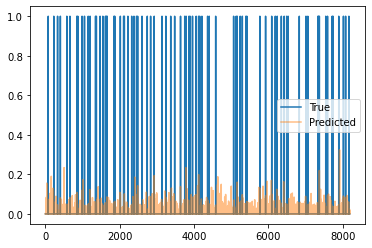

Train Epoch: 1 [2110/2220 (95%)]	Loss: 0.038461	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [2120/2220 (95%)]	Loss: 0.033467	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [2130/2220 (95%)]	Loss: 0.035960	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [2140/2220 (96%)]	Loss: 0.035399	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [2150/2220 (96%)]	Loss: 0.032979	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [2160/2220 (97%)]	Loss: 0.032573	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [2170/2220 (97%)]	Loss: 0.038254	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [2180/2220 (98%)]	Loss: 0.036533	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [2190/2220 (98%)]	Loss: 0.037538	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [2200/2220 (99%)]	Loss: 0.034959	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [2210/2220 (99%)]	Loss: 0.037079	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 1 [0/582 (0%)]	Loss: 0.034200	Pres: 0.000000	F1 Score: 0.000000


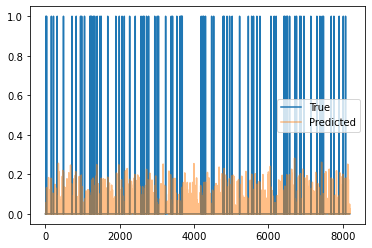

Validation Epoch: 1 [10/582 (1%)]	Loss: 0.033723	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 1 [20/582 (3%)]	Loss: 0.033376	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 1 [30/582 (5%)]	Loss: 0.034640	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 1 [40/582 (6%)]	Loss: 0.034833	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 1 [50/582 (8%)]	Loss: 0.036764	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 1 [60/582 (10%)]	Loss: 0.032781	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 1 [70/582 (12%)]	Loss: 0.034945	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 1 [80/582 (13%)]	Loss: 0.034442	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 1 [90/582 (15%)]	Loss: 0.034485	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 1 [100/582 (17%)]	Loss: 0.036606	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 1 [110/582 (18%)]	Loss: 0.036215	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 1 [120/582 (20%)]	Loss: 0.039495	Pres: 0.000000	F1 Score: 0.0

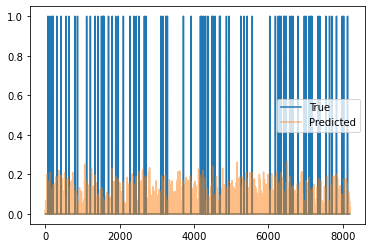

Validation Epoch: 1 [310/582 (53%)]	Loss: 0.032764	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 1 [320/582 (54%)]	Loss: 0.033257	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 1 [330/582 (56%)]	Loss: 0.034456	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 1 [340/582 (58%)]	Loss: 0.032272	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 1 [350/582 (60%)]	Loss: 0.032258	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 1 [360/582 (61%)]	Loss: 0.030926	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 1 [370/582 (63%)]	Loss: 0.033892	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 1 [380/582 (65%)]	Loss: 0.034660	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 1 [390/582 (67%)]	Loss: 0.034124	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 1 [400/582 (68%)]	Loss: 0.034220	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 1 [410/582 (70%)]	Loss: 0.035765	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 1 [420/582 (72%)]	Loss: 0.037388	Pres: 0.000000

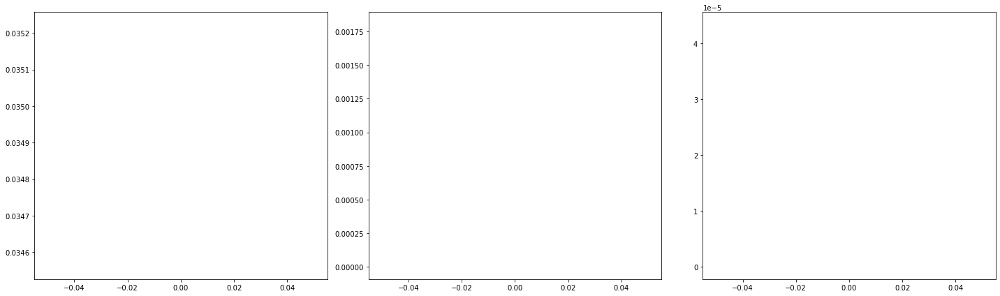

2220 582
Train Epoch: 2 [0/2220 (0%)]	Loss: 0.036386	Pres: 0.000000	F1 Score: 0.000000
81.0 -inf


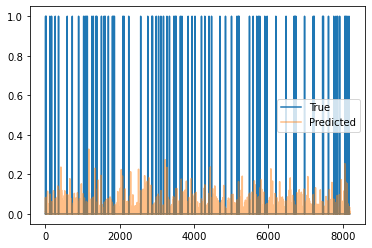

Train Epoch: 2 [10/2220 (0%)]	Loss: 0.034208	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [20/2220 (0%)]	Loss: 0.039285	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [30/2220 (1%)]	Loss: 0.034817	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [40/2220 (1%)]	Loss: 0.034005	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [50/2220 (2%)]	Loss: 0.035295	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [60/2220 (2%)]	Loss: 0.035377	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [70/2220 (3%)]	Loss: 0.033959	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [80/2220 (3%)]	Loss: 0.038226	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [90/2220 (4%)]	Loss: 0.035661	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [100/2220 (4%)]	Loss: 0.039458	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [110/2220 (4%)]	Loss: 0.036043	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [120/2220 (5%)]	Loss: 0.037710	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [130/2220 (5%)]	Loss: 0.034299	Pre

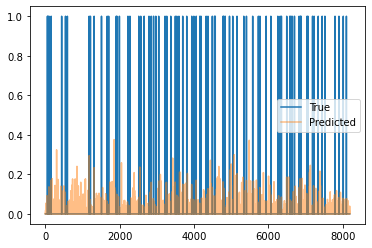

Train Epoch: 2 [310/2220 (13%)]	Loss: 0.033823	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [320/2220 (14%)]	Loss: 0.033601	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [330/2220 (14%)]	Loss: 0.034180	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [340/2220 (15%)]	Loss: 0.036150	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [350/2220 (15%)]	Loss: 0.032245	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [360/2220 (16%)]	Loss: 0.039204	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [370/2220 (16%)]	Loss: 0.036980	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [380/2220 (17%)]	Loss: 0.036113	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [390/2220 (17%)]	Loss: 0.036606	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [400/2220 (18%)]	Loss: 0.032840	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [410/2220 (18%)]	Loss: 0.037331	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [420/2220 (18%)]	Loss: 0.035852	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [430/2220 (19

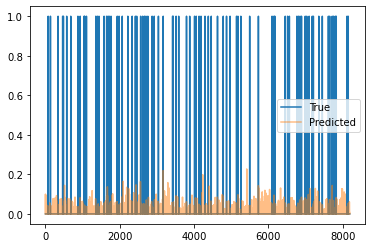

Train Epoch: 2 [610/2220 (27%)]	Loss: 0.036040	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [620/2220 (27%)]	Loss: 0.039528	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [630/2220 (28%)]	Loss: 0.037001	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [640/2220 (28%)]	Loss: 0.030363	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [650/2220 (29%)]	Loss: 0.035790	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [660/2220 (29%)]	Loss: 0.041619	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [670/2220 (30%)]	Loss: 0.035380	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [680/2220 (30%)]	Loss: 0.035944	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [690/2220 (31%)]	Loss: 0.040919	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [700/2220 (31%)]	Loss: 0.036995	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [710/2220 (31%)]	Loss: 0.039679	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [720/2220 (32%)]	Loss: 0.036337	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [730/2220 (32

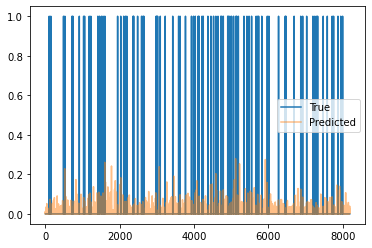

Train Epoch: 2 [910/2220 (40%)]	Loss: 0.034624	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [920/2220 (41%)]	Loss: 0.038629	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [930/2220 (41%)]	Loss: 0.039342	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [940/2220 (42%)]	Loss: 0.037126	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [950/2220 (42%)]	Loss: 0.038760	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [960/2220 (43%)]	Loss: 0.034150	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [970/2220 (43%)]	Loss: 0.033574	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [980/2220 (44%)]	Loss: 0.036590	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [990/2220 (44%)]	Loss: 0.033742	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [1000/2220 (45%)]	Loss: 0.039685	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [1010/2220 (45%)]	Loss: 0.034581	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [1020/2220 (45%)]	Loss: 0.037192	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [1030/2220

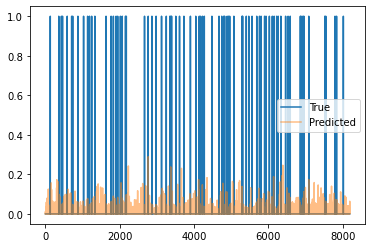

Train Epoch: 2 [1210/2220 (54%)]	Loss: 0.038718	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [1220/2220 (54%)]	Loss: 0.034594	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [1230/2220 (55%)]	Loss: 0.041772	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [1240/2220 (55%)]	Loss: 0.033480	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [1250/2220 (56%)]	Loss: 0.033177	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [1260/2220 (56%)]	Loss: 0.035957	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [1270/2220 (57%)]	Loss: 0.036043	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [1280/2220 (57%)]	Loss: 0.036066	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [1290/2220 (58%)]	Loss: 0.034786	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [1300/2220 (58%)]	Loss: 0.033069	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [1310/2220 (59%)]	Loss: 0.037784	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [1320/2220 (59%)]	Loss: 0.034079	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [

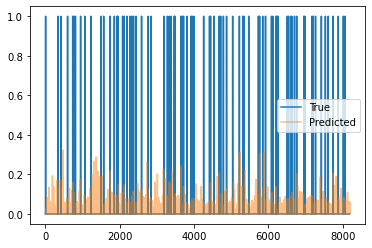

Train Epoch: 2 [1510/2220 (68%)]	Loss: 0.034551	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [1520/2220 (68%)]	Loss: 0.033386	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [1530/2220 (68%)]	Loss: 0.038249	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [1540/2220 (69%)]	Loss: 0.036345	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [1550/2220 (69%)]	Loss: 0.034984	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [1560/2220 (70%)]	Loss: 0.038466	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [1570/2220 (70%)]	Loss: 0.033389	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [1580/2220 (71%)]	Loss: 0.033752	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [1590/2220 (71%)]	Loss: 0.036029	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [1600/2220 (72%)]	Loss: 0.032202	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [1610/2220 (72%)]	Loss: 0.032764	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [1620/2220 (72%)]	Loss: 0.037835	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [

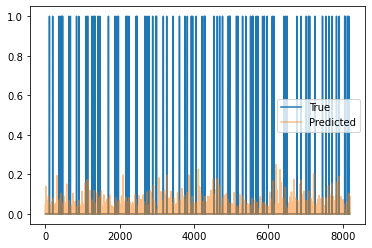

Train Epoch: 2 [1810/2220 (81%)]	Loss: 0.037871	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [1820/2220 (81%)]	Loss: 0.032334	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [1830/2220 (82%)]	Loss: 0.039886	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [1840/2220 (82%)]	Loss: 0.040911	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [1850/2220 (83%)]	Loss: 0.036373	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [1860/2220 (83%)]	Loss: 0.036040	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [1870/2220 (84%)]	Loss: 0.034272	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [1880/2220 (84%)]	Loss: 0.033638	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [1890/2220 (85%)]	Loss: 0.038519	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [1900/2220 (85%)]	Loss: 0.033552	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [1910/2220 (86%)]	Loss: 0.038541	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [1920/2220 (86%)]	Loss: 0.039354	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [

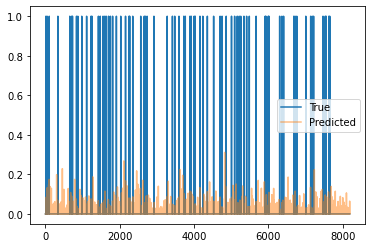

Train Epoch: 2 [2110/2220 (95%)]	Loss: 0.036057	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [2120/2220 (95%)]	Loss: 0.035431	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [2130/2220 (95%)]	Loss: 0.030615	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [2140/2220 (96%)]	Loss: 0.031299	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [2150/2220 (96%)]	Loss: 0.043241	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [2160/2220 (97%)]	Loss: 0.036250	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [2170/2220 (97%)]	Loss: 0.032738	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [2180/2220 (98%)]	Loss: 0.038339	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [2190/2220 (98%)]	Loss: 0.032093	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [2200/2220 (99%)]	Loss: 0.034652	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [2210/2220 (99%)]	Loss: 0.033734	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 2 [0/582 (0%)]	Loss: 0.030914	Pres: 0.000000	F1 Score: 0.000000


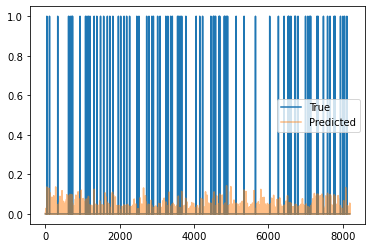

Validation Epoch: 2 [10/582 (1%)]	Loss: 0.030814	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 2 [20/582 (3%)]	Loss: 0.034827	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 2 [30/582 (5%)]	Loss: 0.032632	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 2 [40/582 (6%)]	Loss: 0.032148	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 2 [50/582 (8%)]	Loss: 0.031934	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 2 [60/582 (10%)]	Loss: 0.030001	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 2 [70/582 (12%)]	Loss: 0.030660	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 2 [80/582 (13%)]	Loss: 0.035639	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 2 [90/582 (15%)]	Loss: 0.032945	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 2 [100/582 (17%)]	Loss: 0.033185	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 2 [110/582 (18%)]	Loss: 0.032267	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 2 [120/582 (20%)]	Loss: 0.032984	Pres: 0.000000	F1 Score: 0.0

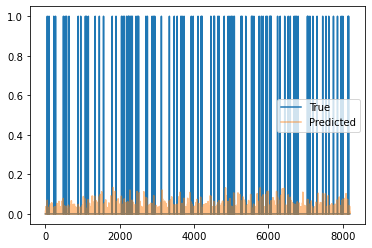

Validation Epoch: 2 [310/582 (53%)]	Loss: 0.031906	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 2 [320/582 (54%)]	Loss: 0.031796	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 2 [330/582 (56%)]	Loss: 0.032205	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 2 [340/582 (58%)]	Loss: 0.032469	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 2 [350/582 (60%)]	Loss: 0.033257	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 2 [360/582 (61%)]	Loss: 0.029734	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 2 [370/582 (63%)]	Loss: 0.028887	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 2 [380/582 (65%)]	Loss: 0.032035	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 2 [390/582 (67%)]	Loss: 0.030611	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 2 [400/582 (68%)]	Loss: 0.027433	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 2 [410/582 (70%)]	Loss: 0.035707	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 2 [420/582 (72%)]	Loss: 0.034884	Pres: 0.000000

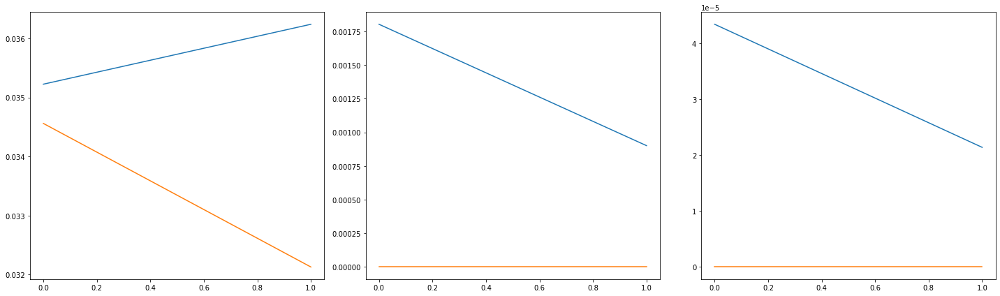

2220 582
Train Epoch: 3 [0/2220 (0%)]	Loss: 0.031901	Pres: 0.000000	F1 Score: 0.000000
74.0 -62880.0


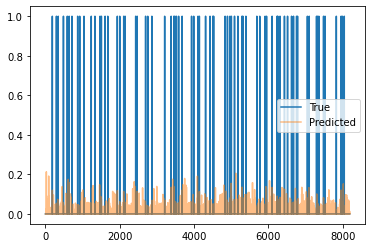

Train Epoch: 3 [10/2220 (0%)]	Loss: 0.037449	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [20/2220 (0%)]	Loss: 0.036851	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [30/2220 (1%)]	Loss: 0.034609	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [40/2220 (1%)]	Loss: 0.037835	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [50/2220 (2%)]	Loss: 0.035619	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [60/2220 (2%)]	Loss: 0.037186	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [70/2220 (3%)]	Loss: 0.040552	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [80/2220 (3%)]	Loss: 0.033938	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [90/2220 (4%)]	Loss: 0.035823	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [100/2220 (4%)]	Loss: 0.037414	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [110/2220 (4%)]	Loss: 0.034764	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [120/2220 (5%)]	Loss: 0.030098	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [130/2220 (5%)]	Loss: 0.037617	Pre

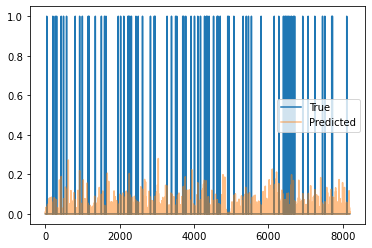

Train Epoch: 3 [310/2220 (13%)]	Loss: 0.035790	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [320/2220 (14%)]	Loss: 0.035221	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [330/2220 (14%)]	Loss: 0.035229	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [340/2220 (15%)]	Loss: 0.041320	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [350/2220 (15%)]	Loss: 0.031985	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [360/2220 (16%)]	Loss: 0.034684	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [370/2220 (16%)]	Loss: 0.039663	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [380/2220 (17%)]	Loss: 0.034683	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [390/2220 (17%)]	Loss: 0.037581	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [400/2220 (18%)]	Loss: 0.035902	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [410/2220 (18%)]	Loss: 0.034206	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [420/2220 (18%)]	Loss: 0.036462	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [430/2220 (19

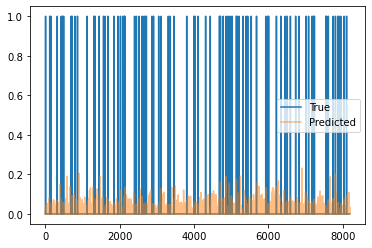

Train Epoch: 3 [610/2220 (27%)]	Loss: 0.034867	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [620/2220 (27%)]	Loss: 0.032974	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [630/2220 (28%)]	Loss: 0.033348	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [640/2220 (28%)]	Loss: 0.038005	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [650/2220 (29%)]	Loss: 0.035808	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [660/2220 (29%)]	Loss: 0.036557	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [670/2220 (30%)]	Loss: 0.031840	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [680/2220 (30%)]	Loss: 0.040381	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [690/2220 (31%)]	Loss: 0.033388	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [700/2220 (31%)]	Loss: 0.038291	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [710/2220 (31%)]	Loss: 0.034703	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [720/2220 (32%)]	Loss: 0.038410	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [730/2220 (32

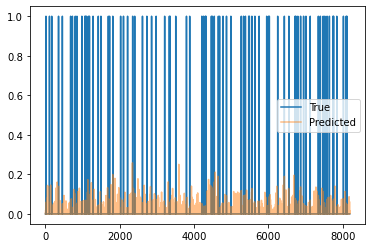

Train Epoch: 3 [910/2220 (40%)]	Loss: 0.032632	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [920/2220 (41%)]	Loss: 0.035056	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [930/2220 (41%)]	Loss: 0.039543	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [940/2220 (42%)]	Loss: 0.035066	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [950/2220 (42%)]	Loss: 0.034687	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [960/2220 (43%)]	Loss: 0.036953	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [970/2220 (43%)]	Loss: 0.036246	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [980/2220 (44%)]	Loss: 0.034163	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [990/2220 (44%)]	Loss: 0.033672	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [1000/2220 (45%)]	Loss: 0.036437	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [1010/2220 (45%)]	Loss: 0.037280	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [1020/2220 (45%)]	Loss: 0.036230	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [1030/2220

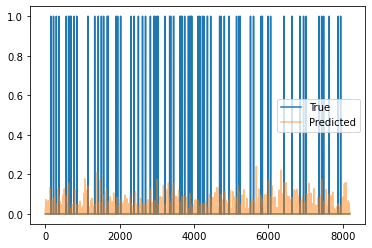

Train Epoch: 3 [1210/2220 (54%)]	Loss: 0.034594	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [1220/2220 (54%)]	Loss: 0.032067	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [1230/2220 (55%)]	Loss: 0.036456	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [1240/2220 (55%)]	Loss: 0.036735	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [1250/2220 (56%)]	Loss: 0.032225	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [1260/2220 (56%)]	Loss: 0.038513	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [1270/2220 (57%)]	Loss: 0.035067	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [1280/2220 (57%)]	Loss: 0.035700	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [1290/2220 (58%)]	Loss: 0.033194	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [1300/2220 (58%)]	Loss: 0.041447	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [1310/2220 (59%)]	Loss: 0.039498	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [1320/2220 (59%)]	Loss: 0.034830	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [

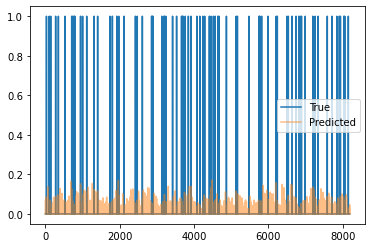

Train Epoch: 3 [1510/2220 (68%)]	Loss: 0.037828	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [1520/2220 (68%)]	Loss: 0.036684	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [1530/2220 (68%)]	Loss: 0.037261	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [1540/2220 (69%)]	Loss: 0.036102	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [1550/2220 (69%)]	Loss: 0.032946	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [1560/2220 (70%)]	Loss: 0.035917	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [1570/2220 (70%)]	Loss: 0.032404	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [1580/2220 (71%)]	Loss: 0.031160	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [1590/2220 (71%)]	Loss: 0.034734	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [1600/2220 (72%)]	Loss: 0.036594	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [1610/2220 (72%)]	Loss: 0.037203	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [1620/2220 (72%)]	Loss: 0.033882	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [

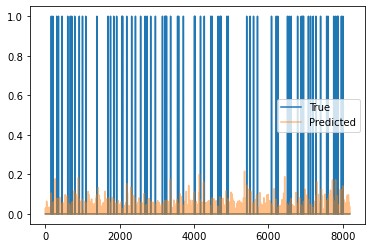

Train Epoch: 3 [1810/2220 (81%)]	Loss: 0.033389	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [1820/2220 (81%)]	Loss: 0.033734	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [1830/2220 (82%)]	Loss: 0.032883	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [1840/2220 (82%)]	Loss: 0.034402	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [1850/2220 (83%)]	Loss: 0.035792	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [1860/2220 (83%)]	Loss: 0.034062	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [1870/2220 (84%)]	Loss: 0.035153	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [1880/2220 (84%)]	Loss: 0.034972	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [1890/2220 (85%)]	Loss: 0.034998	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [1900/2220 (85%)]	Loss: 0.033401	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [1910/2220 (86%)]	Loss: 0.036423	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [1920/2220 (86%)]	Loss: 0.036312	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [

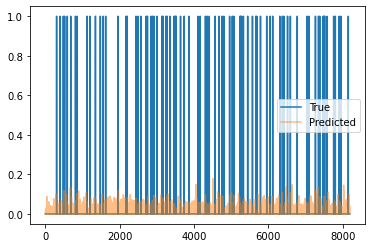

Train Epoch: 3 [2110/2220 (95%)]	Loss: 0.034679	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [2120/2220 (95%)]	Loss: 0.037531	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [2130/2220 (95%)]	Loss: 0.034789	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [2140/2220 (96%)]	Loss: 0.034652	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [2150/2220 (96%)]	Loss: 0.032082	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [2160/2220 (97%)]	Loss: 0.036265	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [2170/2220 (97%)]	Loss: 0.037430	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [2180/2220 (98%)]	Loss: 0.032948	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [2190/2220 (98%)]	Loss: 0.038309	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [2200/2220 (99%)]	Loss: 0.037312	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [2210/2220 (99%)]	Loss: 0.037567	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 3 [0/582 (0%)]	Loss: 0.033473	Pres: 0.000000	F1 Score: 0.000000


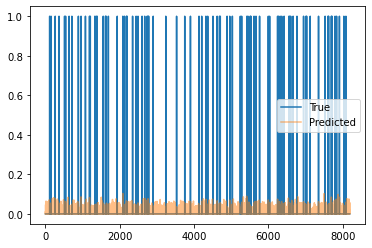

Validation Epoch: 3 [10/582 (1%)]	Loss: 0.032959	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 3 [20/582 (3%)]	Loss: 0.036413	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 3 [30/582 (5%)]	Loss: 0.031515	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 3 [40/582 (6%)]	Loss: 0.033642	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 3 [50/582 (8%)]	Loss: 0.033361	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 3 [60/582 (10%)]	Loss: 0.034421	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 3 [70/582 (12%)]	Loss: 0.034499	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 3 [80/582 (13%)]	Loss: 0.031724	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 3 [90/582 (15%)]	Loss: 0.031883	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 3 [100/582 (17%)]	Loss: 0.036080	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 3 [110/582 (18%)]	Loss: 0.033956	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 3 [120/582 (20%)]	Loss: 0.033196	Pres: 0.000000	F1 Score: 0.0

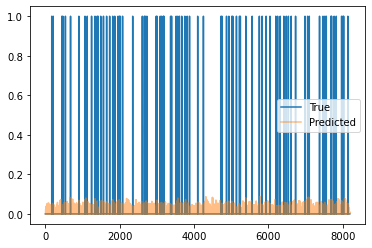

Validation Epoch: 3 [310/582 (53%)]	Loss: 0.035162	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 3 [320/582 (54%)]	Loss: 0.033595	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 3 [330/582 (56%)]	Loss: 0.028305	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 3 [340/582 (58%)]	Loss: 0.032891	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 3 [350/582 (60%)]	Loss: 0.032350	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 3 [360/582 (61%)]	Loss: 0.030888	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 3 [370/582 (63%)]	Loss: 0.035087	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 3 [380/582 (65%)]	Loss: 0.035571	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 3 [390/582 (67%)]	Loss: 0.029525	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 3 [400/582 (68%)]	Loss: 0.034373	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 3 [410/582 (70%)]	Loss: 0.032678	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 3 [420/582 (72%)]	Loss: 0.034207	Pres: 0.000000

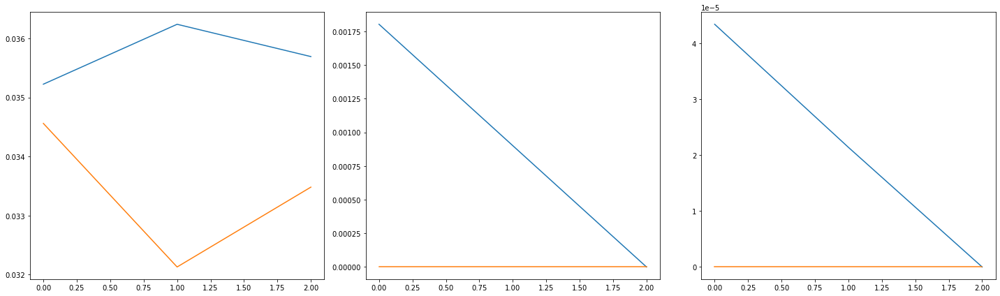

2220 582
Train Epoch: 4 [0/2220 (0%)]	Loss: 0.034654	Pres: 0.000000	F1 Score: 0.000000
79.0 -57472.0


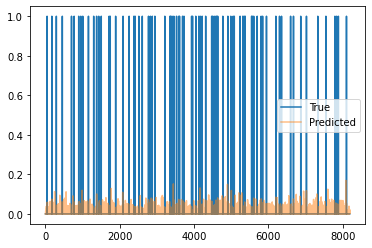

Train Epoch: 4 [10/2220 (0%)]	Loss: 0.032348	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [20/2220 (0%)]	Loss: 0.034498	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [30/2220 (1%)]	Loss: 0.034696	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [40/2220 (1%)]	Loss: 0.034522	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [50/2220 (2%)]	Loss: 0.039822	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [60/2220 (2%)]	Loss: 0.041942	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [70/2220 (3%)]	Loss: 0.037725	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [80/2220 (3%)]	Loss: 0.034963	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [90/2220 (4%)]	Loss: 0.033548	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [100/2220 (4%)]	Loss: 0.040899	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [110/2220 (4%)]	Loss: 0.033997	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [120/2220 (5%)]	Loss: 0.035499	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [130/2220 (5%)]	Loss: 0.036904	Pre

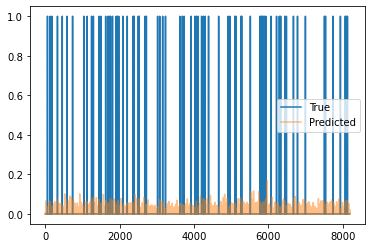

Train Epoch: 4 [310/2220 (13%)]	Loss: 0.031891	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [320/2220 (14%)]	Loss: 0.035189	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [330/2220 (14%)]	Loss: 0.038213	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [340/2220 (15%)]	Loss: 0.034064	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [350/2220 (15%)]	Loss: 0.034228	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [360/2220 (16%)]	Loss: 0.034959	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [370/2220 (16%)]	Loss: 0.032893	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [380/2220 (17%)]	Loss: 0.036542	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [390/2220 (17%)]	Loss: 0.034145	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [400/2220 (18%)]	Loss: 0.035987	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [410/2220 (18%)]	Loss: 0.035484	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [420/2220 (18%)]	Loss: 0.034412	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [430/2220 (19

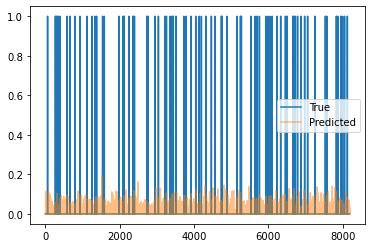

Train Epoch: 4 [610/2220 (27%)]	Loss: 0.034262	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [620/2220 (27%)]	Loss: 0.036951	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [630/2220 (28%)]	Loss: 0.037473	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [640/2220 (28%)]	Loss: 0.034000	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [650/2220 (29%)]	Loss: 0.035224	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [660/2220 (29%)]	Loss: 0.034979	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [670/2220 (30%)]	Loss: 0.037056	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [680/2220 (30%)]	Loss: 0.032687	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [690/2220 (31%)]	Loss: 0.034004	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [700/2220 (31%)]	Loss: 0.032544	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [710/2220 (31%)]	Loss: 0.031070	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [720/2220 (32%)]	Loss: 0.034619	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [730/2220 (32

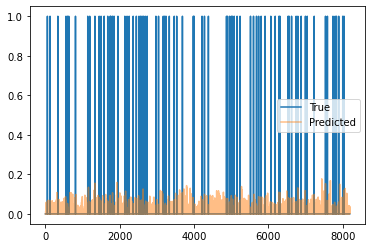

Train Epoch: 4 [910/2220 (40%)]	Loss: 0.037372	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [920/2220 (41%)]	Loss: 0.032274	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [930/2220 (41%)]	Loss: 0.036284	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [940/2220 (42%)]	Loss: 0.036953	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [950/2220 (42%)]	Loss: 0.038017	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [960/2220 (43%)]	Loss: 0.031841	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [970/2220 (43%)]	Loss: 0.032226	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [980/2220 (44%)]	Loss: 0.035868	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [990/2220 (44%)]	Loss: 0.033309	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [1000/2220 (45%)]	Loss: 0.032088	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [1010/2220 (45%)]	Loss: 0.034319	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [1020/2220 (45%)]	Loss: 0.037193	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [1030/2220

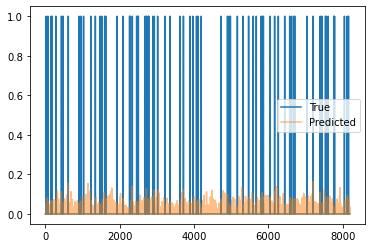

Train Epoch: 4 [1210/2220 (54%)]	Loss: 0.036731	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [1220/2220 (54%)]	Loss: 0.036432	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [1230/2220 (55%)]	Loss: 0.034036	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [1240/2220 (55%)]	Loss: 0.035976	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [1250/2220 (56%)]	Loss: 0.032522	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [1260/2220 (56%)]	Loss: 0.038212	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [1270/2220 (57%)]	Loss: 0.036976	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [1280/2220 (57%)]	Loss: 0.034623	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [1290/2220 (58%)]	Loss: 0.036153	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [1300/2220 (58%)]	Loss: 0.033940	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [1310/2220 (59%)]	Loss: 0.033812	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [1320/2220 (59%)]	Loss: 0.037018	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [

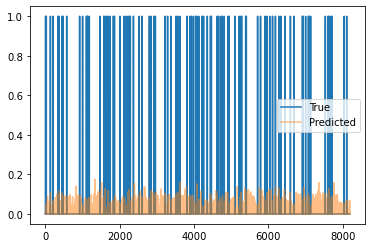

Train Epoch: 4 [1510/2220 (68%)]	Loss: 0.035398	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [1520/2220 (68%)]	Loss: 0.036104	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [1530/2220 (68%)]	Loss: 0.033629	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [1540/2220 (69%)]	Loss: 0.036457	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [1550/2220 (69%)]	Loss: 0.034711	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [1560/2220 (70%)]	Loss: 0.034947	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [1570/2220 (70%)]	Loss: 0.032463	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [1580/2220 (71%)]	Loss: 0.033336	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [1590/2220 (71%)]	Loss: 0.035781	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [1600/2220 (72%)]	Loss: 0.035367	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [1610/2220 (72%)]	Loss: 0.035977	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [1620/2220 (72%)]	Loss: 0.032202	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [

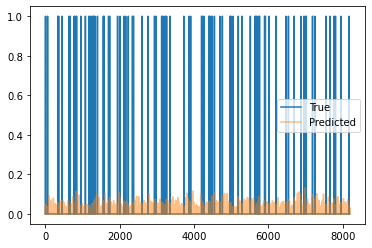

Train Epoch: 4 [1810/2220 (81%)]	Loss: 0.033390	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [1820/2220 (81%)]	Loss: 0.036273	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [1830/2220 (82%)]	Loss: 0.040353	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [1840/2220 (82%)]	Loss: 0.036600	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [1850/2220 (83%)]	Loss: 0.038277	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [1860/2220 (83%)]	Loss: 0.032977	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [1870/2220 (84%)]	Loss: 0.033895	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [1880/2220 (84%)]	Loss: 0.032724	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [1890/2220 (85%)]	Loss: 0.037141	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [1900/2220 (85%)]	Loss: 0.036101	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [1910/2220 (86%)]	Loss: 0.037414	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [1920/2220 (86%)]	Loss: 0.038555	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [

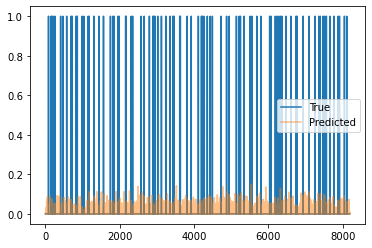

Train Epoch: 4 [2110/2220 (95%)]	Loss: 0.035457	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [2120/2220 (95%)]	Loss: 0.040293	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [2130/2220 (95%)]	Loss: 0.033387	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [2140/2220 (96%)]	Loss: 0.036353	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [2150/2220 (96%)]	Loss: 0.036794	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [2160/2220 (97%)]	Loss: 0.038224	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [2170/2220 (97%)]	Loss: 0.036964	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [2180/2220 (98%)]	Loss: 0.038367	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [2190/2220 (98%)]	Loss: 0.037642	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [2200/2220 (99%)]	Loss: 0.033909	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [2210/2220 (99%)]	Loss: 0.036750	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 4 [0/582 (0%)]	Loss: 0.035439	Pres: 0.000000	F1 Score: 0.000000


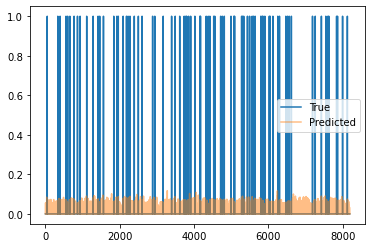

Validation Epoch: 4 [10/582 (1%)]	Loss: 0.037307	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 4 [20/582 (3%)]	Loss: 0.039485	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 4 [30/582 (5%)]	Loss: 0.034868	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 4 [40/582 (6%)]	Loss: 0.037182	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 4 [50/582 (8%)]	Loss: 0.036233	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 4 [60/582 (10%)]	Loss: 0.034766	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 4 [70/582 (12%)]	Loss: 0.034810	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 4 [80/582 (13%)]	Loss: 0.037456	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 4 [90/582 (15%)]	Loss: 0.037525	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 4 [100/582 (17%)]	Loss: 0.036428	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 4 [110/582 (18%)]	Loss: 0.041501	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 4 [120/582 (20%)]	Loss: 0.036190	Pres: 0.000000	F1 Score: 0.0

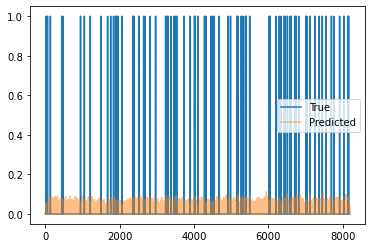

Validation Epoch: 4 [310/582 (53%)]	Loss: 0.035039	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 4 [320/582 (54%)]	Loss: 0.036270	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 4 [330/582 (56%)]	Loss: 0.037150	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 4 [340/582 (58%)]	Loss: 0.036439	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 4 [350/582 (60%)]	Loss: 0.038559	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 4 [360/582 (61%)]	Loss: 0.036269	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 4 [370/582 (63%)]	Loss: 0.037590	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 4 [380/582 (65%)]	Loss: 0.039269	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 4 [390/582 (67%)]	Loss: 0.034808	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 4 [400/582 (68%)]	Loss: 0.035034	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 4 [410/582 (70%)]	Loss: 0.037469	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 4 [420/582 (72%)]	Loss: 0.038961	Pres: 0.000000

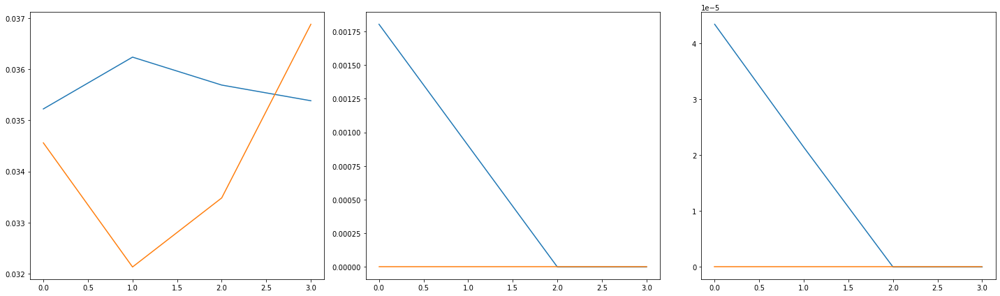

2220 582
Train Epoch: 5 [0/2220 (0%)]	Loss: 0.035739	Pres: 0.000000	F1 Score: 0.000000
82.0 -57728.0


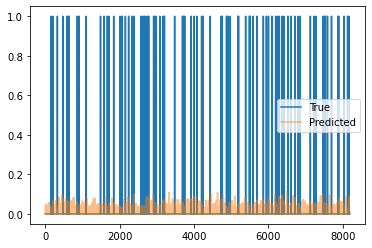

Train Epoch: 5 [10/2220 (0%)]	Loss: 0.035944	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [20/2220 (0%)]	Loss: 0.036342	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [30/2220 (1%)]	Loss: 0.037056	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [40/2220 (1%)]	Loss: 0.034909	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [50/2220 (2%)]	Loss: 0.033692	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [60/2220 (2%)]	Loss: 0.035264	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [70/2220 (3%)]	Loss: 0.036934	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [80/2220 (3%)]	Loss: 0.036619	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [90/2220 (4%)]	Loss: 0.036161	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [100/2220 (4%)]	Loss: 0.034454	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [110/2220 (4%)]	Loss: 0.036605	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [120/2220 (5%)]	Loss: 0.037678	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [130/2220 (5%)]	Loss: 0.036382	Pre

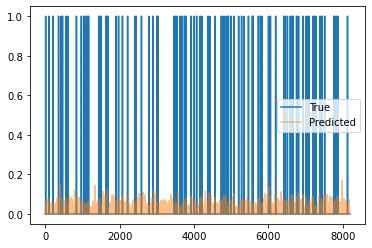

Train Epoch: 5 [310/2220 (13%)]	Loss: 0.035134	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [320/2220 (14%)]	Loss: 0.039025	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [330/2220 (14%)]	Loss: 0.036266	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [340/2220 (15%)]	Loss: 0.036339	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [350/2220 (15%)]	Loss: 0.037924	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [360/2220 (16%)]	Loss: 0.033240	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [370/2220 (16%)]	Loss: 0.033371	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [380/2220 (17%)]	Loss: 0.036358	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [390/2220 (17%)]	Loss: 0.037721	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [400/2220 (18%)]	Loss: 0.042781	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [410/2220 (18%)]	Loss: 0.036146	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [420/2220 (18%)]	Loss: 0.036428	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [430/2220 (19

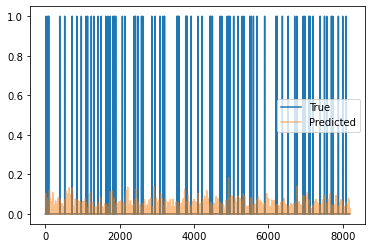

Train Epoch: 5 [610/2220 (27%)]	Loss: 0.037613	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [620/2220 (27%)]	Loss: 0.037196	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [630/2220 (28%)]	Loss: 0.037930	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [640/2220 (28%)]	Loss: 0.039922	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [650/2220 (29%)]	Loss: 0.034377	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [660/2220 (29%)]	Loss: 0.039184	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [670/2220 (30%)]	Loss: 0.034755	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [680/2220 (30%)]	Loss: 0.035977	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [690/2220 (31%)]	Loss: 0.034666	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [700/2220 (31%)]	Loss: 0.039556	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [710/2220 (31%)]	Loss: 0.036329	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [720/2220 (32%)]	Loss: 0.034688	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [730/2220 (32

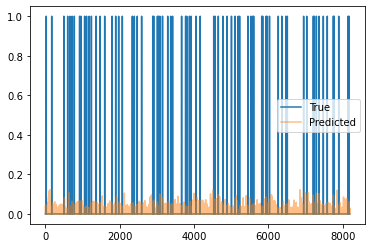

Train Epoch: 5 [910/2220 (40%)]	Loss: 0.043413	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [920/2220 (41%)]	Loss: 0.034118	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [930/2220 (41%)]	Loss: 0.034896	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [940/2220 (42%)]	Loss: 0.033800	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [950/2220 (42%)]	Loss: 0.032650	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [960/2220 (43%)]	Loss: 0.036675	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [970/2220 (43%)]	Loss: 0.037632	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [980/2220 (44%)]	Loss: 0.037941	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [990/2220 (44%)]	Loss: 0.037895	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [1000/2220 (45%)]	Loss: 0.042284	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [1010/2220 (45%)]	Loss: 0.034612	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [1020/2220 (45%)]	Loss: 0.039809	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [1030/2220

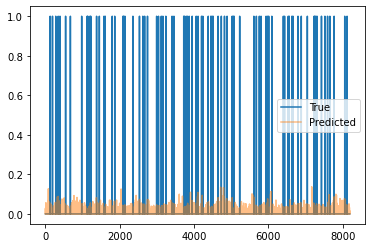

Train Epoch: 5 [1210/2220 (54%)]	Loss: 0.039009	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [1220/2220 (54%)]	Loss: 0.040580	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [1230/2220 (55%)]	Loss: 0.039983	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [1240/2220 (55%)]	Loss: 0.036252	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [1250/2220 (56%)]	Loss: 0.038705	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [1260/2220 (56%)]	Loss: 0.039264	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [1270/2220 (57%)]	Loss: 0.040671	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [1280/2220 (57%)]	Loss: 0.036757	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [1290/2220 (58%)]	Loss: 0.037808	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [1300/2220 (58%)]	Loss: 0.044111	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [1310/2220 (59%)]	Loss: 0.034342	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [1320/2220 (59%)]	Loss: 0.037473	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [

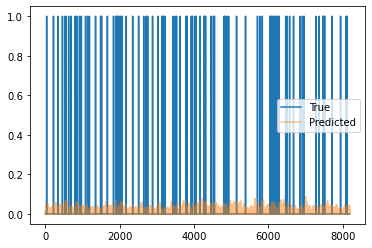

Train Epoch: 5 [1510/2220 (68%)]	Loss: 0.036897	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [1520/2220 (68%)]	Loss: 0.035957	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [1530/2220 (68%)]	Loss: 0.038044	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [1540/2220 (69%)]	Loss: 0.032685	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [1550/2220 (69%)]	Loss: 0.035256	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [1560/2220 (70%)]	Loss: 0.039908	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [1570/2220 (70%)]	Loss: 0.037987	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [1580/2220 (71%)]	Loss: 0.038851	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [1590/2220 (71%)]	Loss: 0.038340	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [1600/2220 (72%)]	Loss: 0.037688	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [1610/2220 (72%)]	Loss: 0.037867	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [1620/2220 (72%)]	Loss: 0.037302	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [

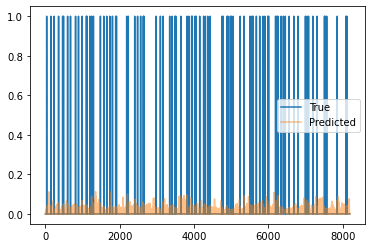

Train Epoch: 5 [1810/2220 (81%)]	Loss: 0.044148	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [1820/2220 (81%)]	Loss: 0.039515	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [1830/2220 (82%)]	Loss: 0.037972	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [1840/2220 (82%)]	Loss: 0.037690	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [1850/2220 (83%)]	Loss: 0.035452	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [1860/2220 (83%)]	Loss: 0.039529	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [1870/2220 (84%)]	Loss: 0.038956	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [1880/2220 (84%)]	Loss: 0.043042	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [1890/2220 (85%)]	Loss: 0.042827	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [1900/2220 (85%)]	Loss: 0.038689	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [1910/2220 (86%)]	Loss: 0.040403	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [1920/2220 (86%)]	Loss: 0.042736	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [

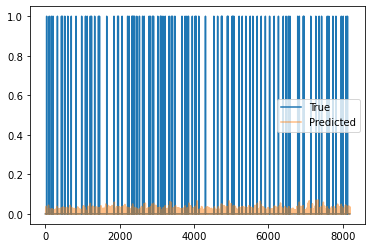

Train Epoch: 5 [2110/2220 (95%)]	Loss: 0.037992	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [2120/2220 (95%)]	Loss: 0.041509	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [2130/2220 (95%)]	Loss: 0.037873	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [2140/2220 (96%)]	Loss: 0.040590	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [2150/2220 (96%)]	Loss: 0.038568	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [2160/2220 (97%)]	Loss: 0.043186	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [2170/2220 (97%)]	Loss: 0.043358	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [2180/2220 (98%)]	Loss: 0.041467	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [2190/2220 (98%)]	Loss: 0.043436	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [2200/2220 (99%)]	Loss: 0.044349	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [2210/2220 (99%)]	Loss: 0.039268	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 5 [0/582 (0%)]	Loss: 0.038396	Pres: 0.000000	F1 Score: 0.000000


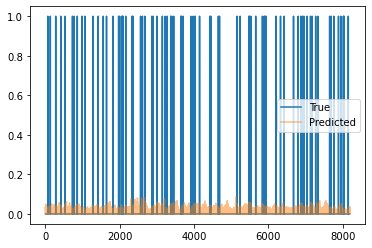

Validation Epoch: 5 [10/582 (1%)]	Loss: 0.040404	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 5 [20/582 (3%)]	Loss: 0.040280	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 5 [30/582 (5%)]	Loss: 0.040738	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 5 [40/582 (6%)]	Loss: 0.036640	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 5 [50/582 (8%)]	Loss: 0.045010	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 5 [60/582 (10%)]	Loss: 0.035589	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 5 [70/582 (12%)]	Loss: 0.038165	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 5 [80/582 (13%)]	Loss: 0.039580	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 5 [90/582 (15%)]	Loss: 0.040301	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 5 [100/582 (17%)]	Loss: 0.038720	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 5 [110/582 (18%)]	Loss: 0.040719	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 5 [120/582 (20%)]	Loss: 0.040562	Pres: 0.000000	F1 Score: 0.0

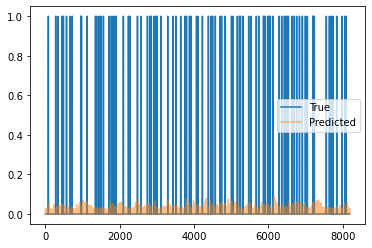

Validation Epoch: 5 [310/582 (53%)]	Loss: 0.039987	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 5 [320/582 (54%)]	Loss: 0.040294	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 5 [330/582 (56%)]	Loss: 0.037575	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 5 [340/582 (58%)]	Loss: 0.037405	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 5 [350/582 (60%)]	Loss: 0.039580	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 5 [360/582 (61%)]	Loss: 0.043276	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 5 [370/582 (63%)]	Loss: 0.037505	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 5 [380/582 (65%)]	Loss: 0.037223	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 5 [390/582 (67%)]	Loss: 0.041321	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 5 [400/582 (68%)]	Loss: 0.039761	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 5 [410/582 (70%)]	Loss: 0.039267	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 5 [420/582 (72%)]	Loss: 0.037582	Pres: 0.000000

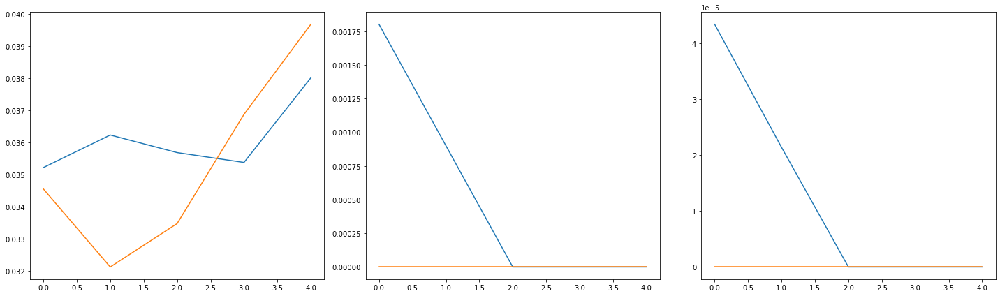

2220 582
Train Epoch: 6 [0/2220 (0%)]	Loss: 0.041123	Pres: 0.000000	F1 Score: 0.000000
84.0 -52864.0


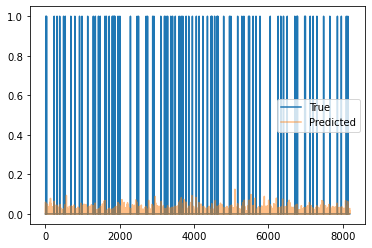

Train Epoch: 6 [10/2220 (0%)]	Loss: 0.044697	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [20/2220 (0%)]	Loss: 0.042101	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [30/2220 (1%)]	Loss: 0.045439	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [40/2220 (1%)]	Loss: 0.041447	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [50/2220 (2%)]	Loss: 0.039372	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [60/2220 (2%)]	Loss: 0.043632	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [70/2220 (3%)]	Loss: 0.037993	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [80/2220 (3%)]	Loss: 0.040668	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [90/2220 (4%)]	Loss: 0.040647	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [100/2220 (4%)]	Loss: 0.045594	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [110/2220 (4%)]	Loss: 0.036971	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [120/2220 (5%)]	Loss: 0.038238	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [130/2220 (5%)]	Loss: 0.039431	Pre

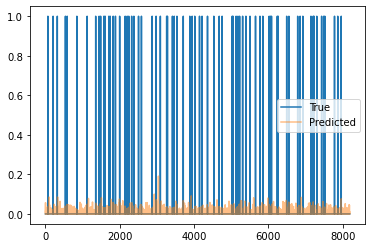

Train Epoch: 6 [310/2220 (13%)]	Loss: 0.038778	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [320/2220 (14%)]	Loss: 0.042106	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [330/2220 (14%)]	Loss: 0.040932	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [340/2220 (15%)]	Loss: 0.041510	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [350/2220 (15%)]	Loss: 0.036369	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [360/2220 (16%)]	Loss: 0.038589	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [370/2220 (16%)]	Loss: 0.041865	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [380/2220 (17%)]	Loss: 0.041374	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [390/2220 (17%)]	Loss: 0.037968	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [400/2220 (18%)]	Loss: 0.040546	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [410/2220 (18%)]	Loss: 0.038027	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [420/2220 (18%)]	Loss: 0.037125	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [430/2220 (19

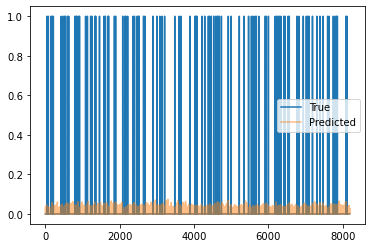

Train Epoch: 6 [610/2220 (27%)]	Loss: 0.041123	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [620/2220 (27%)]	Loss: 0.035962	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [630/2220 (28%)]	Loss: 0.033364	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [640/2220 (28%)]	Loss: 0.040624	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [650/2220 (29%)]	Loss: 0.039578	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [660/2220 (29%)]	Loss: 0.033297	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [670/2220 (30%)]	Loss: 0.043197	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [680/2220 (30%)]	Loss: 0.037829	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [690/2220 (31%)]	Loss: 0.040002	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [700/2220 (31%)]	Loss: 0.037083	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [710/2220 (31%)]	Loss: 0.035222	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [720/2220 (32%)]	Loss: 0.037780	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [730/2220 (32

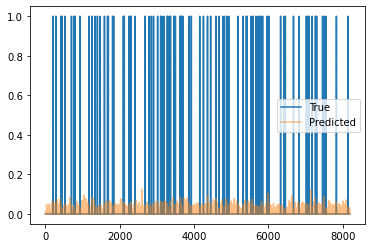

Train Epoch: 6 [910/2220 (40%)]	Loss: 0.041818	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [920/2220 (41%)]	Loss: 0.036568	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [930/2220 (41%)]	Loss: 0.036255	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [940/2220 (42%)]	Loss: 0.040418	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [950/2220 (42%)]	Loss: 0.034610	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [960/2220 (43%)]	Loss: 0.040016	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [970/2220 (43%)]	Loss: 0.038068	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [980/2220 (44%)]	Loss: 0.030964	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [990/2220 (44%)]	Loss: 0.041250	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [1000/2220 (45%)]	Loss: 0.041532	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [1010/2220 (45%)]	Loss: 0.037859	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [1020/2220 (45%)]	Loss: 0.040382	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [1030/2220

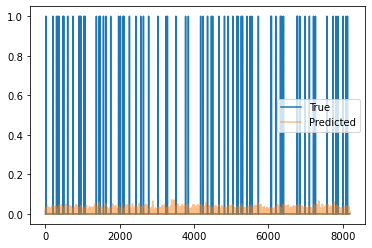

Train Epoch: 6 [1210/2220 (54%)]	Loss: 0.036097	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [1220/2220 (54%)]	Loss: 0.038020	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [1230/2220 (55%)]	Loss: 0.042232	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [1240/2220 (55%)]	Loss: 0.042137	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [1250/2220 (56%)]	Loss: 0.045035	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [1260/2220 (56%)]	Loss: 0.037624	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [1270/2220 (57%)]	Loss: 0.039329	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [1280/2220 (57%)]	Loss: 0.042572	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [1290/2220 (58%)]	Loss: 0.049205	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [1300/2220 (58%)]	Loss: 0.038355	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [1310/2220 (59%)]	Loss: 0.043336	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [1320/2220 (59%)]	Loss: 0.040256	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [

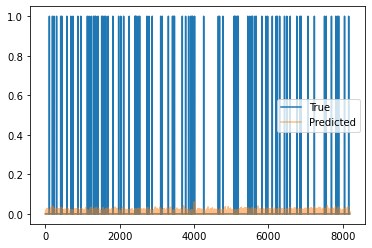

Train Epoch: 6 [1510/2220 (68%)]	Loss: 0.038200	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [1520/2220 (68%)]	Loss: 0.043536	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [1530/2220 (68%)]	Loss: 0.044047	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [1540/2220 (69%)]	Loss: 0.043054	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [1550/2220 (69%)]	Loss: 0.039877	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [1560/2220 (70%)]	Loss: 0.042496	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [1570/2220 (70%)]	Loss: 0.037779	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [1580/2220 (71%)]	Loss: 0.041512	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [1590/2220 (71%)]	Loss: 0.039451	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [1600/2220 (72%)]	Loss: 0.035440	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [1610/2220 (72%)]	Loss: 0.044960	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [1620/2220 (72%)]	Loss: 0.042236	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [

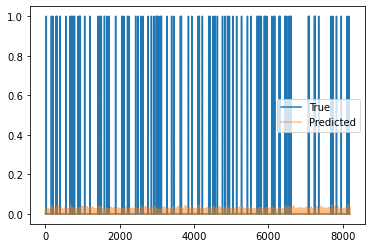

Train Epoch: 6 [1810/2220 (81%)]	Loss: 0.039930	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [1820/2220 (81%)]	Loss: 0.040444	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [1830/2220 (82%)]	Loss: 0.039228	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [1840/2220 (82%)]	Loss: 0.038054	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [1850/2220 (83%)]	Loss: 0.040159	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [1860/2220 (83%)]	Loss: 0.041007	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [1870/2220 (84%)]	Loss: 0.041693	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [1880/2220 (84%)]	Loss: 0.036072	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [1890/2220 (85%)]	Loss: 0.035931	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [1900/2220 (85%)]	Loss: 0.040314	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [1910/2220 (86%)]	Loss: 0.040290	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [1920/2220 (86%)]	Loss: 0.039914	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [

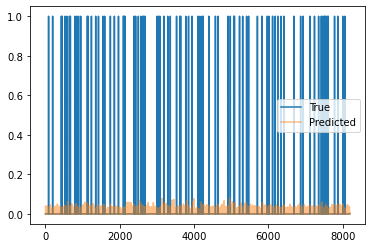

Train Epoch: 6 [2110/2220 (95%)]	Loss: 0.040688	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [2120/2220 (95%)]	Loss: 0.036738	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [2130/2220 (95%)]	Loss: 0.036495	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [2140/2220 (96%)]	Loss: 0.034252	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [2150/2220 (96%)]	Loss: 0.041216	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [2160/2220 (97%)]	Loss: 0.041522	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [2170/2220 (97%)]	Loss: 0.038185	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [2180/2220 (98%)]	Loss: 0.038400	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [2190/2220 (98%)]	Loss: 0.036837	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [2200/2220 (99%)]	Loss: 0.039236	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [2210/2220 (99%)]	Loss: 0.038668	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 6 [0/582 (0%)]	Loss: 0.037960	Pres: 0.000000	F1 Score: 0.000000


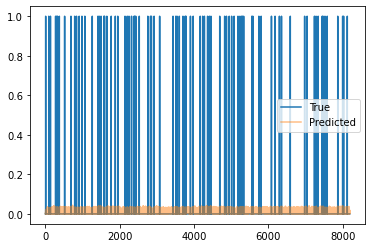

Validation Epoch: 6 [10/582 (1%)]	Loss: 0.038740	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 6 [20/582 (3%)]	Loss: 0.036620	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 6 [30/582 (5%)]	Loss: 0.037030	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 6 [40/582 (6%)]	Loss: 0.035865	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 6 [50/582 (8%)]	Loss: 0.036718	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 6 [60/582 (10%)]	Loss: 0.030620	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 6 [70/582 (12%)]	Loss: 0.034445	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 6 [80/582 (13%)]	Loss: 0.038644	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 6 [90/582 (15%)]	Loss: 0.038504	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 6 [100/582 (17%)]	Loss: 0.038683	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 6 [110/582 (18%)]	Loss: 0.034381	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 6 [120/582 (20%)]	Loss: 0.040191	Pres: 0.000000	F1 Score: 0.0

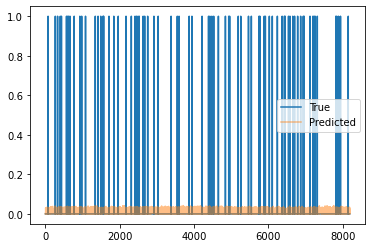

Validation Epoch: 6 [310/582 (53%)]	Loss: 0.037305	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 6 [320/582 (54%)]	Loss: 0.035489	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 6 [330/582 (56%)]	Loss: 0.039105	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 6 [340/582 (58%)]	Loss: 0.032710	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 6 [350/582 (60%)]	Loss: 0.039792	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 6 [360/582 (61%)]	Loss: 0.039153	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 6 [370/582 (63%)]	Loss: 0.037770	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 6 [380/582 (65%)]	Loss: 0.035992	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 6 [390/582 (67%)]	Loss: 0.037688	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 6 [400/582 (68%)]	Loss: 0.035783	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 6 [410/582 (70%)]	Loss: 0.036720	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 6 [420/582 (72%)]	Loss: 0.035073	Pres: 0.000000

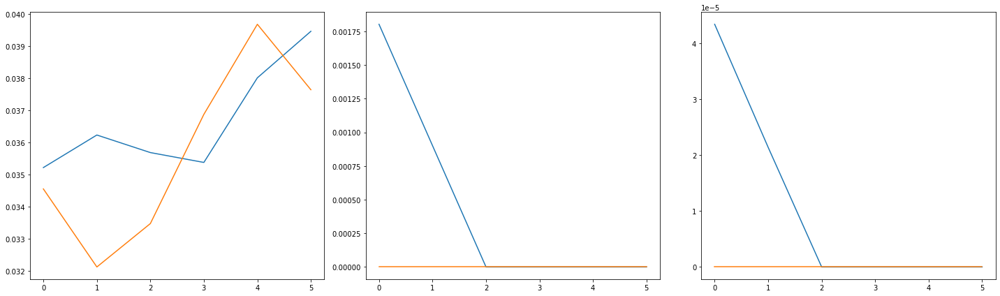

2220 582
Train Epoch: 7 [0/2220 (0%)]	Loss: 0.035101	Pres: 0.000000	F1 Score: 0.000000
76.0 -52512.0


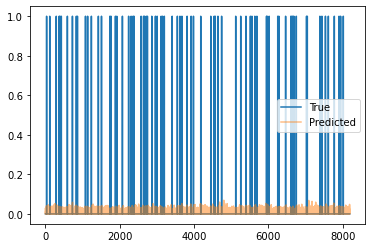

Train Epoch: 7 [10/2220 (0%)]	Loss: 0.038632	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [20/2220 (0%)]	Loss: 0.038320	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [30/2220 (1%)]	Loss: 0.043465	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [40/2220 (1%)]	Loss: 0.034287	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [50/2220 (2%)]	Loss: 0.040432	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [60/2220 (2%)]	Loss: 0.037378	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [70/2220 (3%)]	Loss: 0.041139	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [80/2220 (3%)]	Loss: 0.041921	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [90/2220 (4%)]	Loss: 0.039683	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [100/2220 (4%)]	Loss: 0.043987	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [110/2220 (4%)]	Loss: 0.035525	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [120/2220 (5%)]	Loss: 0.040728	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [130/2220 (5%)]	Loss: 0.042573	Pre

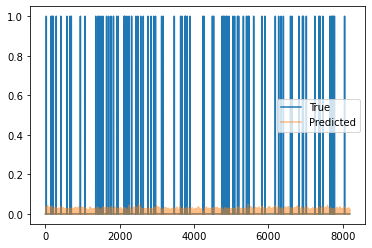

Train Epoch: 7 [310/2220 (13%)]	Loss: 0.039290	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [320/2220 (14%)]	Loss: 0.043407	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [330/2220 (14%)]	Loss: 0.038046	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [340/2220 (15%)]	Loss: 0.043370	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [350/2220 (15%)]	Loss: 0.041893	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [360/2220 (16%)]	Loss: 0.037025	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [370/2220 (16%)]	Loss: 0.040881	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [380/2220 (17%)]	Loss: 0.038320	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [390/2220 (17%)]	Loss: 0.043674	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [400/2220 (18%)]	Loss: 0.038463	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [410/2220 (18%)]	Loss: 0.040808	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [420/2220 (18%)]	Loss: 0.042640	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [430/2220 (19

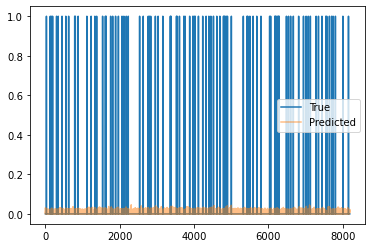

Train Epoch: 7 [610/2220 (27%)]	Loss: 0.034744	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [620/2220 (27%)]	Loss: 0.040589	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [630/2220 (28%)]	Loss: 0.038869	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [640/2220 (28%)]	Loss: 0.042937	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [650/2220 (29%)]	Loss: 0.039153	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [660/2220 (29%)]	Loss: 0.038586	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [670/2220 (30%)]	Loss: 0.039822	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [680/2220 (30%)]	Loss: 0.045754	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [690/2220 (31%)]	Loss: 0.044081	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [700/2220 (31%)]	Loss: 0.044594	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [710/2220 (31%)]	Loss: 0.042465	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [720/2220 (32%)]	Loss: 0.036795	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [730/2220 (32

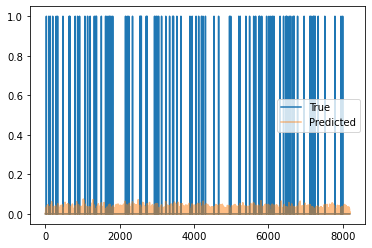

Train Epoch: 7 [910/2220 (40%)]	Loss: 0.041224	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [920/2220 (41%)]	Loss: 0.033515	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [930/2220 (41%)]	Loss: 0.039887	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [940/2220 (42%)]	Loss: 0.039604	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [950/2220 (42%)]	Loss: 0.036524	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [960/2220 (43%)]	Loss: 0.035979	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [970/2220 (43%)]	Loss: 0.037899	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [980/2220 (44%)]	Loss: 0.038063	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [990/2220 (44%)]	Loss: 0.037003	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [1000/2220 (45%)]	Loss: 0.035444	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [1010/2220 (45%)]	Loss: 0.038188	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [1020/2220 (45%)]	Loss: 0.039416	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [1030/2220

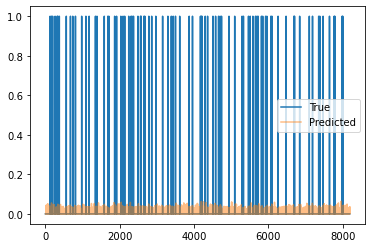

Train Epoch: 7 [1210/2220 (54%)]	Loss: 0.037729	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [1220/2220 (54%)]	Loss: 0.034965	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [1230/2220 (55%)]	Loss: 0.039300	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [1240/2220 (55%)]	Loss: 0.036491	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [1250/2220 (56%)]	Loss: 0.044396	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [1260/2220 (56%)]	Loss: 0.038627	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [1270/2220 (57%)]	Loss: 0.043606	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [1280/2220 (57%)]	Loss: 0.037277	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [1290/2220 (58%)]	Loss: 0.035080	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [1300/2220 (58%)]	Loss: 0.041916	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [1310/2220 (59%)]	Loss: 0.033627	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [1320/2220 (59%)]	Loss: 0.038835	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [

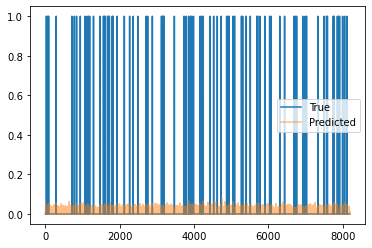

Train Epoch: 7 [1510/2220 (68%)]	Loss: 0.032343	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [1520/2220 (68%)]	Loss: 0.035153	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [1530/2220 (68%)]	Loss: 0.041286	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [1540/2220 (69%)]	Loss: 0.038362	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [1550/2220 (69%)]	Loss: 0.042570	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [1560/2220 (70%)]	Loss: 0.034351	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [1570/2220 (70%)]	Loss: 0.041969	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [1580/2220 (71%)]	Loss: 0.037503	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [1590/2220 (71%)]	Loss: 0.037175	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [1600/2220 (72%)]	Loss: 0.038173	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [1610/2220 (72%)]	Loss: 0.038283	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [1620/2220 (72%)]	Loss: 0.040634	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [

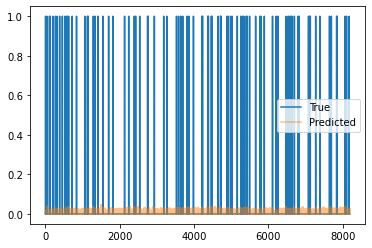

Train Epoch: 7 [1810/2220 (81%)]	Loss: 0.038181	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [1820/2220 (81%)]	Loss: 0.041441	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [1830/2220 (82%)]	Loss: 0.043310	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [1840/2220 (82%)]	Loss: 0.041863	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [1850/2220 (83%)]	Loss: 0.043114	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [1860/2220 (83%)]	Loss: 0.039498	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [1870/2220 (84%)]	Loss: 0.042371	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [1880/2220 (84%)]	Loss: 0.040009	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [1890/2220 (85%)]	Loss: 0.041900	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [1900/2220 (85%)]	Loss: 0.040575	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [1910/2220 (86%)]	Loss: 0.041530	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [1920/2220 (86%)]	Loss: 0.046479	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [

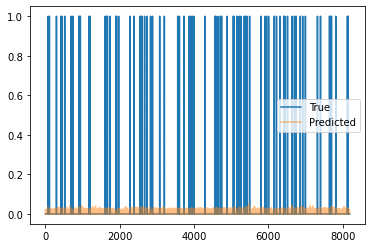

Train Epoch: 7 [2110/2220 (95%)]	Loss: 0.040054	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [2120/2220 (95%)]	Loss: 0.037907	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [2130/2220 (95%)]	Loss: 0.037821	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [2140/2220 (96%)]	Loss: 0.040932	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [2150/2220 (96%)]	Loss: 0.041283	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [2160/2220 (97%)]	Loss: 0.039231	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [2170/2220 (97%)]	Loss: 0.039189	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [2180/2220 (98%)]	Loss: 0.042671	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [2190/2220 (98%)]	Loss: 0.037537	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [2200/2220 (99%)]	Loss: 0.039750	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [2210/2220 (99%)]	Loss: 0.040012	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 7 [0/582 (0%)]	Loss: 0.038953	Pres: 0.000000	F1 Score: 0.000000


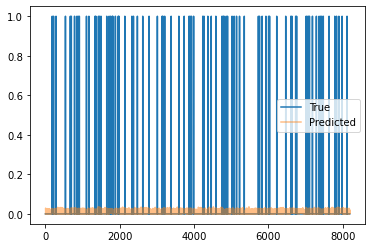

Validation Epoch: 7 [10/582 (1%)]	Loss: 0.035864	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 7 [20/582 (3%)]	Loss: 0.036591	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 7 [30/582 (5%)]	Loss: 0.038141	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 7 [40/582 (6%)]	Loss: 0.038822	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 7 [50/582 (8%)]	Loss: 0.038734	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 7 [60/582 (10%)]	Loss: 0.039708	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 7 [70/582 (12%)]	Loss: 0.033581	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 7 [80/582 (13%)]	Loss: 0.042086	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 7 [90/582 (15%)]	Loss: 0.035574	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 7 [100/582 (17%)]	Loss: 0.037152	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 7 [110/582 (18%)]	Loss: 0.038478	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 7 [120/582 (20%)]	Loss: 0.043209	Pres: 0.000000	F1 Score: 0.0

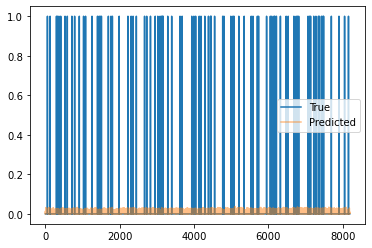

Validation Epoch: 7 [310/582 (53%)]	Loss: 0.034032	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 7 [320/582 (54%)]	Loss: 0.043251	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 7 [330/582 (56%)]	Loss: 0.039484	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 7 [340/582 (58%)]	Loss: 0.038302	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 7 [350/582 (60%)]	Loss: 0.039742	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 7 [360/582 (61%)]	Loss: 0.034578	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 7 [370/582 (63%)]	Loss: 0.040359	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 7 [380/582 (65%)]	Loss: 0.037758	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 7 [390/582 (67%)]	Loss: 0.037737	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 7 [400/582 (68%)]	Loss: 0.034285	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 7 [410/582 (70%)]	Loss: 0.035518	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 7 [420/582 (72%)]	Loss: 0.041398	Pres: 0.000000

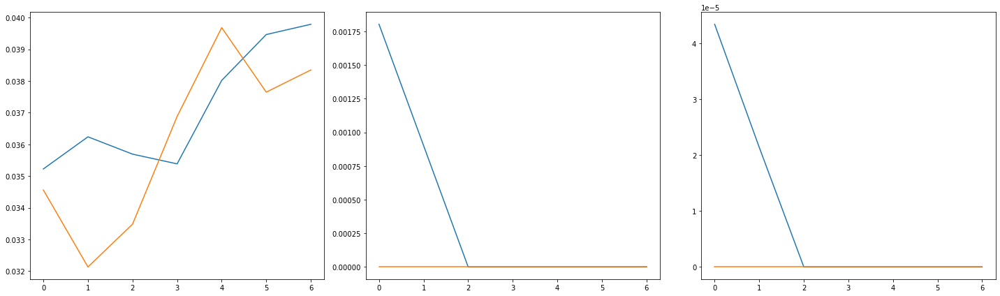

2220 582
Train Epoch: 8 [0/2220 (0%)]	Loss: 0.038434	Pres: 0.000000	F1 Score: 0.000000
82.0 -51392.0


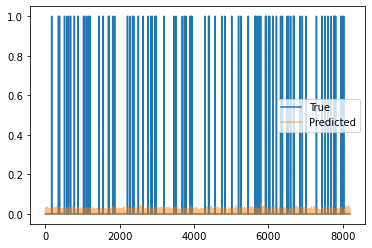

Train Epoch: 8 [10/2220 (0%)]	Loss: 0.038436	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [20/2220 (0%)]	Loss: 0.043433	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [30/2220 (1%)]	Loss: 0.036328	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [40/2220 (1%)]	Loss: 0.038611	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [50/2220 (2%)]	Loss: 0.036677	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [60/2220 (2%)]	Loss: 0.035814	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [70/2220 (3%)]	Loss: 0.040595	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [80/2220 (3%)]	Loss: 0.039288	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [90/2220 (4%)]	Loss: 0.042936	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [100/2220 (4%)]	Loss: 0.038378	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [110/2220 (4%)]	Loss: 0.037819	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [120/2220 (5%)]	Loss: 0.039211	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [130/2220 (5%)]	Loss: 0.042840	Pre

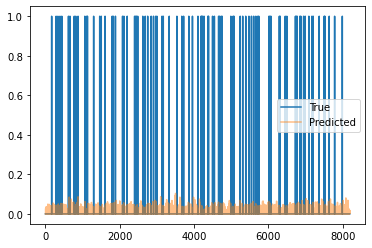

Train Epoch: 8 [310/2220 (13%)]	Loss: 0.038799	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [320/2220 (14%)]	Loss: 0.035736	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [330/2220 (14%)]	Loss: 0.035315	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [340/2220 (15%)]	Loss: 0.037419	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [350/2220 (15%)]	Loss: 0.034810	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [360/2220 (16%)]	Loss: 0.035596	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [370/2220 (16%)]	Loss: 0.039257	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [380/2220 (17%)]	Loss: 0.039502	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [390/2220 (17%)]	Loss: 0.037394	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [400/2220 (18%)]	Loss: 0.036775	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [410/2220 (18%)]	Loss: 0.041608	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [420/2220 (18%)]	Loss: 0.040720	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [430/2220 (19

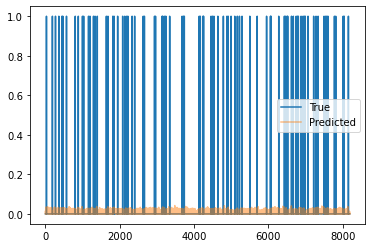

Train Epoch: 8 [610/2220 (27%)]	Loss: 0.042771	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [620/2220 (27%)]	Loss: 0.041177	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [630/2220 (28%)]	Loss: 0.040921	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [640/2220 (28%)]	Loss: 0.041602	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [650/2220 (29%)]	Loss: 0.041649	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [660/2220 (29%)]	Loss: 0.043963	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [670/2220 (30%)]	Loss: 0.040351	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [680/2220 (30%)]	Loss: 0.040827	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [690/2220 (31%)]	Loss: 0.041593	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [700/2220 (31%)]	Loss: 0.037696	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [710/2220 (31%)]	Loss: 0.043812	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [720/2220 (32%)]	Loss: 0.037520	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [730/2220 (32

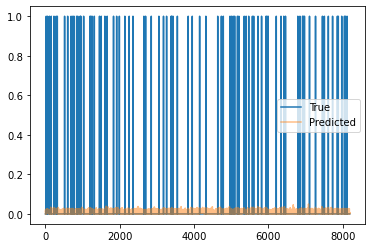

Train Epoch: 8 [910/2220 (40%)]	Loss: 0.042143	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [920/2220 (41%)]	Loss: 0.042086	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [930/2220 (41%)]	Loss: 0.035777	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [940/2220 (42%)]	Loss: 0.040075	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [950/2220 (42%)]	Loss: 0.041284	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [960/2220 (43%)]	Loss: 0.039191	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [970/2220 (43%)]	Loss: 0.040802	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [980/2220 (44%)]	Loss: 0.040847	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [990/2220 (44%)]	Loss: 0.040116	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [1000/2220 (45%)]	Loss: 0.038287	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [1010/2220 (45%)]	Loss: 0.041163	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [1020/2220 (45%)]	Loss: 0.039177	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [1030/2220

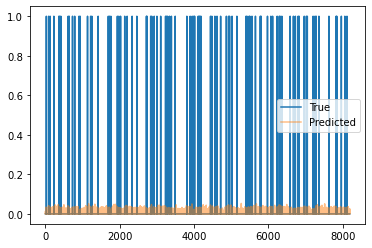

Train Epoch: 8 [1210/2220 (54%)]	Loss: 0.038554	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [1220/2220 (54%)]	Loss: 0.037819	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [1230/2220 (55%)]	Loss: 0.041540	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [1240/2220 (55%)]	Loss: 0.037183	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [1250/2220 (56%)]	Loss: 0.040560	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [1260/2220 (56%)]	Loss: 0.038466	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [1270/2220 (57%)]	Loss: 0.036859	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [1280/2220 (57%)]	Loss: 0.039057	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [1290/2220 (58%)]	Loss: 0.038924	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [1300/2220 (58%)]	Loss: 0.040575	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [1310/2220 (59%)]	Loss: 0.037882	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [1320/2220 (59%)]	Loss: 0.034461	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [

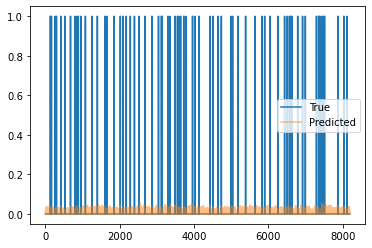

Train Epoch: 8 [1510/2220 (68%)]	Loss: 0.040212	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [1520/2220 (68%)]	Loss: 0.040060	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [1530/2220 (68%)]	Loss: 0.043461	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [1540/2220 (69%)]	Loss: 0.040938	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [1550/2220 (69%)]	Loss: 0.037566	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [1560/2220 (70%)]	Loss: 0.039410	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [1570/2220 (70%)]	Loss: 0.042024	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [1580/2220 (71%)]	Loss: 0.042059	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [1590/2220 (71%)]	Loss: 0.041249	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [1600/2220 (72%)]	Loss: 0.037263	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [1610/2220 (72%)]	Loss: 0.040610	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [1620/2220 (72%)]	Loss: 0.040746	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [

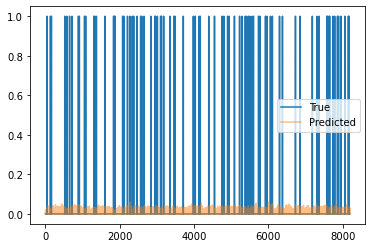

Train Epoch: 8 [1810/2220 (81%)]	Loss: 0.040674	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [1820/2220 (81%)]	Loss: 0.041976	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [1830/2220 (82%)]	Loss: 0.038667	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [1840/2220 (82%)]	Loss: 0.042224	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [1850/2220 (83%)]	Loss: 0.042154	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [1860/2220 (83%)]	Loss: 0.043453	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [1870/2220 (84%)]	Loss: 0.039162	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [1880/2220 (84%)]	Loss: 0.038972	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [1890/2220 (85%)]	Loss: 0.039935	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [1900/2220 (85%)]	Loss: 0.043653	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [1910/2220 (86%)]	Loss: 0.034684	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [1920/2220 (86%)]	Loss: 0.040408	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [

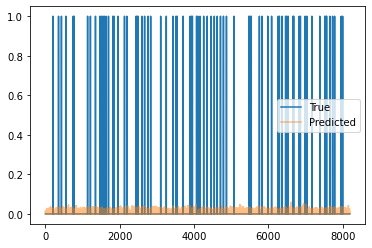

Train Epoch: 8 [2110/2220 (95%)]	Loss: 0.036991	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [2120/2220 (95%)]	Loss: 0.042658	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [2130/2220 (95%)]	Loss: 0.037037	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [2140/2220 (96%)]	Loss: 0.042578	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [2150/2220 (96%)]	Loss: 0.040134	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [2160/2220 (97%)]	Loss: 0.038088	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [2170/2220 (97%)]	Loss: 0.033141	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [2180/2220 (98%)]	Loss: 0.041115	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [2190/2220 (98%)]	Loss: 0.041381	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [2200/2220 (99%)]	Loss: 0.039319	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [2210/2220 (99%)]	Loss: 0.042220	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 8 [0/582 (0%)]	Loss: 0.040565	Pres: 0.000000	F1 Score: 0.000000


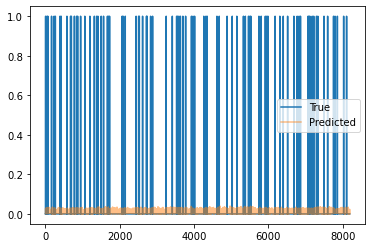

Validation Epoch: 8 [10/582 (1%)]	Loss: 0.039535	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 8 [20/582 (3%)]	Loss: 0.040325	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 8 [30/582 (5%)]	Loss: 0.041443	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 8 [40/582 (6%)]	Loss: 0.041351	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 8 [50/582 (8%)]	Loss: 0.040662	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 8 [60/582 (10%)]	Loss: 0.039690	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 8 [70/582 (12%)]	Loss: 0.034246	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 8 [80/582 (13%)]	Loss: 0.038681	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 8 [90/582 (15%)]	Loss: 0.040050	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 8 [100/582 (17%)]	Loss: 0.038003	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 8 [110/582 (18%)]	Loss: 0.039246	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 8 [120/582 (20%)]	Loss: 0.036136	Pres: 0.000000	F1 Score: 0.0

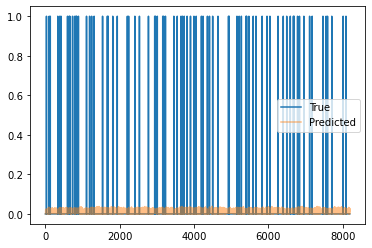

Validation Epoch: 8 [310/582 (53%)]	Loss: 0.038384	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 8 [320/582 (54%)]	Loss: 0.037170	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 8 [330/582 (56%)]	Loss: 0.038730	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 8 [340/582 (58%)]	Loss: 0.040932	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 8 [350/582 (60%)]	Loss: 0.038579	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 8 [360/582 (61%)]	Loss: 0.037837	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 8 [370/582 (63%)]	Loss: 0.040897	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 8 [380/582 (65%)]	Loss: 0.040393	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 8 [390/582 (67%)]	Loss: 0.038296	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 8 [400/582 (68%)]	Loss: 0.037794	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 8 [410/582 (70%)]	Loss: 0.033225	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 8 [420/582 (72%)]	Loss: 0.037367	Pres: 0.000000

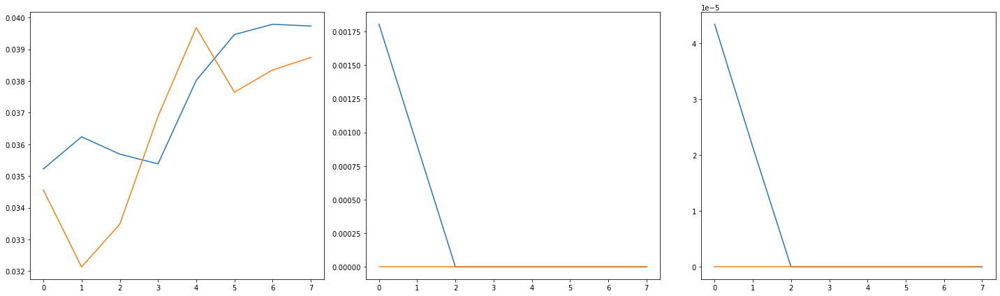

2220 582
Train Epoch: 9 [0/2220 (0%)]	Loss: 0.039378	Pres: 0.000000	F1 Score: 0.000000
83.0 -50976.0


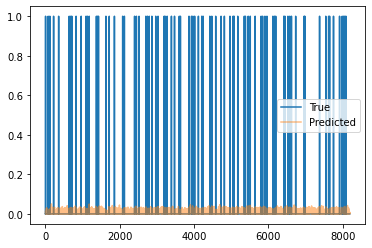

Train Epoch: 9 [10/2220 (0%)]	Loss: 0.041853	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [20/2220 (0%)]	Loss: 0.043374	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [30/2220 (1%)]	Loss: 0.037314	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [40/2220 (1%)]	Loss: 0.041041	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [50/2220 (2%)]	Loss: 0.040386	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [60/2220 (2%)]	Loss: 0.038522	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [70/2220 (3%)]	Loss: 0.040218	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [80/2220 (3%)]	Loss: 0.036021	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [90/2220 (4%)]	Loss: 0.038156	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [100/2220 (4%)]	Loss: 0.040059	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [110/2220 (4%)]	Loss: 0.041428	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [120/2220 (5%)]	Loss: 0.040275	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [130/2220 (5%)]	Loss: 0.040652	Pre

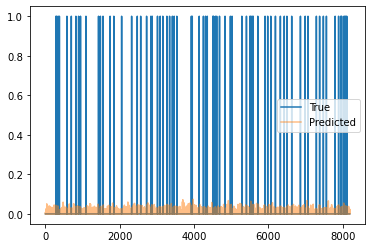

Train Epoch: 9 [310/2220 (13%)]	Loss: 0.038060	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [320/2220 (14%)]	Loss: 0.043753	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [330/2220 (14%)]	Loss: 0.036595	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [340/2220 (15%)]	Loss: 0.041032	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [350/2220 (15%)]	Loss: 0.039277	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [360/2220 (16%)]	Loss: 0.038614	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [370/2220 (16%)]	Loss: 0.037333	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [380/2220 (17%)]	Loss: 0.041676	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [390/2220 (17%)]	Loss: 0.038181	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [400/2220 (18%)]	Loss: 0.038609	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [410/2220 (18%)]	Loss: 0.038811	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [420/2220 (18%)]	Loss: 0.039122	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [430/2220 (19

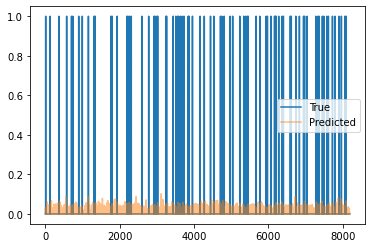

Train Epoch: 9 [610/2220 (27%)]	Loss: 0.035909	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [620/2220 (27%)]	Loss: 0.039167	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [630/2220 (28%)]	Loss: 0.039482	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [640/2220 (28%)]	Loss: 0.039122	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [650/2220 (29%)]	Loss: 0.037051	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [660/2220 (29%)]	Loss: 0.037238	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [670/2220 (30%)]	Loss: 0.035283	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [680/2220 (30%)]	Loss: 0.039175	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [690/2220 (31%)]	Loss: 0.038556	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [700/2220 (31%)]	Loss: 0.038171	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [710/2220 (31%)]	Loss: 0.035293	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [720/2220 (32%)]	Loss: 0.042029	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [730/2220 (32

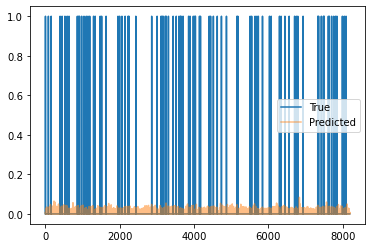

Train Epoch: 9 [910/2220 (40%)]	Loss: 0.040162	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [920/2220 (41%)]	Loss: 0.033348	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [930/2220 (41%)]	Loss: 0.039914	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [940/2220 (42%)]	Loss: 0.035658	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [950/2220 (42%)]	Loss: 0.037185	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [960/2220 (43%)]	Loss: 0.039757	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [970/2220 (43%)]	Loss: 0.042813	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [980/2220 (44%)]	Loss: 0.036113	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [990/2220 (44%)]	Loss: 0.042151	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [1000/2220 (45%)]	Loss: 0.036018	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [1010/2220 (45%)]	Loss: 0.041076	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [1020/2220 (45%)]	Loss: 0.040009	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [1030/2220

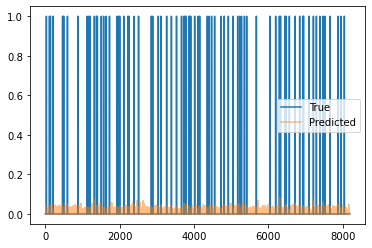

Train Epoch: 9 [1210/2220 (54%)]	Loss: 0.037786	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [1220/2220 (54%)]	Loss: 0.034956	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [1230/2220 (55%)]	Loss: 0.041384	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [1240/2220 (55%)]	Loss: 0.038918	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [1250/2220 (56%)]	Loss: 0.039409	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [1260/2220 (56%)]	Loss: 0.044655	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [1270/2220 (57%)]	Loss: 0.039932	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [1280/2220 (57%)]	Loss: 0.034086	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [1290/2220 (58%)]	Loss: 0.034660	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [1300/2220 (58%)]	Loss: 0.039389	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [1310/2220 (59%)]	Loss: 0.041063	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [1320/2220 (59%)]	Loss: 0.034289	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [

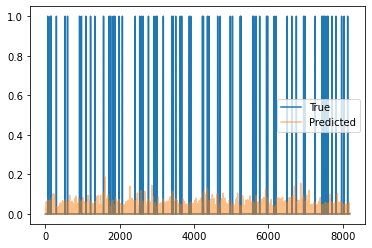

Train Epoch: 9 [1510/2220 (68%)]	Loss: 0.037828	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [1520/2220 (68%)]	Loss: 0.036068	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [1530/2220 (68%)]	Loss: 0.038043	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [1540/2220 (69%)]	Loss: 0.041778	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [1550/2220 (69%)]	Loss: 0.032352	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [1560/2220 (70%)]	Loss: 0.041222	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [1570/2220 (70%)]	Loss: 0.036552	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [1580/2220 (71%)]	Loss: 0.037119	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [1590/2220 (71%)]	Loss: 0.038380	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [1600/2220 (72%)]	Loss: 0.036942	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [1610/2220 (72%)]	Loss: 0.037429	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [1620/2220 (72%)]	Loss: 0.040509	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [

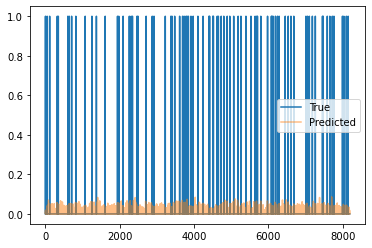

Train Epoch: 9 [1810/2220 (81%)]	Loss: 0.037513	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [1820/2220 (81%)]	Loss: 0.040994	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [1830/2220 (82%)]	Loss: 0.036282	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [1840/2220 (82%)]	Loss: 0.043959	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [1850/2220 (83%)]	Loss: 0.035881	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [1860/2220 (83%)]	Loss: 0.036857	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [1870/2220 (84%)]	Loss: 0.038354	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [1880/2220 (84%)]	Loss: 0.039384	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [1890/2220 (85%)]	Loss: 0.033541	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [1900/2220 (85%)]	Loss: 0.042681	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [1910/2220 (86%)]	Loss: 0.039488	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [1920/2220 (86%)]	Loss: 0.044031	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [

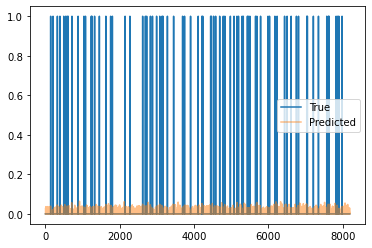

Train Epoch: 9 [2110/2220 (95%)]	Loss: 0.036048	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [2120/2220 (95%)]	Loss: 0.037189	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [2130/2220 (95%)]	Loss: 0.038064	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [2140/2220 (96%)]	Loss: 0.037213	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [2150/2220 (96%)]	Loss: 0.042574	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [2160/2220 (97%)]	Loss: 0.039746	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [2170/2220 (97%)]	Loss: 0.043239	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [2180/2220 (98%)]	Loss: 0.040498	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [2190/2220 (98%)]	Loss: 0.034546	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [2200/2220 (99%)]	Loss: 0.040666	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [2210/2220 (99%)]	Loss: 0.040504	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 9 [0/582 (0%)]	Loss: 0.045144	Pres: 0.000000	F1 Score: 0.000000


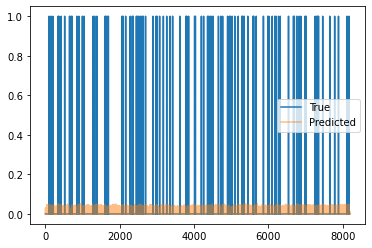

Validation Epoch: 9 [10/582 (1%)]	Loss: 0.042416	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 9 [20/582 (3%)]	Loss: 0.039548	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 9 [30/582 (5%)]	Loss: 0.038583	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 9 [40/582 (6%)]	Loss: 0.040096	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 9 [50/582 (8%)]	Loss: 0.040894	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 9 [60/582 (10%)]	Loss: 0.041588	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 9 [70/582 (12%)]	Loss: 0.040050	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 9 [80/582 (13%)]	Loss: 0.043548	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 9 [90/582 (15%)]	Loss: 0.038182	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 9 [100/582 (17%)]	Loss: 0.039451	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 9 [110/582 (18%)]	Loss: 0.044130	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 9 [120/582 (20%)]	Loss: 0.041286	Pres: 0.000000	F1 Score: 0.0

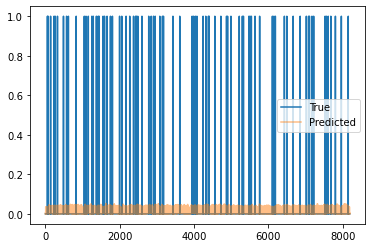

Validation Epoch: 9 [310/582 (53%)]	Loss: 0.035357	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 9 [320/582 (54%)]	Loss: 0.041468	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 9 [330/582 (56%)]	Loss: 0.038182	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 9 [340/582 (58%)]	Loss: 0.042877	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 9 [350/582 (60%)]	Loss: 0.039570	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 9 [360/582 (61%)]	Loss: 0.040926	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 9 [370/582 (63%)]	Loss: 0.039383	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 9 [380/582 (65%)]	Loss: 0.039649	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 9 [390/582 (67%)]	Loss: 0.040416	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 9 [400/582 (68%)]	Loss: 0.041467	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 9 [410/582 (70%)]	Loss: 0.042333	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 9 [420/582 (72%)]	Loss: 0.042982	Pres: 0.000000

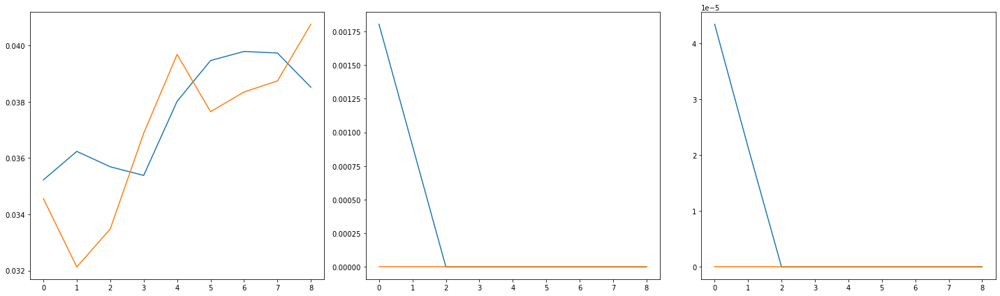

2220 582
Train Epoch: 10 [0/2220 (0%)]	Loss: 0.036133	Pres: 0.000000	F1 Score: 0.000000
76.0 -54720.0


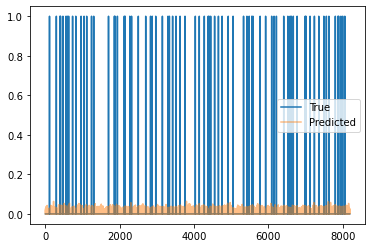

Train Epoch: 10 [10/2220 (0%)]	Loss: 0.040281	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [20/2220 (0%)]	Loss: 0.032313	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [30/2220 (1%)]	Loss: 0.044388	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [40/2220 (1%)]	Loss: 0.038667	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [50/2220 (2%)]	Loss: 0.037496	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [60/2220 (2%)]	Loss: 0.039070	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [70/2220 (3%)]	Loss: 0.040690	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [80/2220 (3%)]	Loss: 0.042822	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [90/2220 (4%)]	Loss: 0.040762	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [100/2220 (4%)]	Loss: 0.042773	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [110/2220 (4%)]	Loss: 0.034572	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [120/2220 (5%)]	Loss: 0.034105	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [130/2220 (5%)]	Loss:

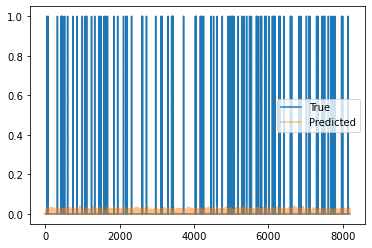

Train Epoch: 10 [310/2220 (13%)]	Loss: 0.036704	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [320/2220 (14%)]	Loss: 0.033743	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [330/2220 (14%)]	Loss: 0.037732	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [340/2220 (15%)]	Loss: 0.038618	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [350/2220 (15%)]	Loss: 0.035303	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [360/2220 (16%)]	Loss: 0.040725	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [370/2220 (16%)]	Loss: 0.035290	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [380/2220 (17%)]	Loss: 0.035418	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [390/2220 (17%)]	Loss: 0.040411	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [400/2220 (18%)]	Loss: 0.039755	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [410/2220 (18%)]	Loss: 0.036681	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [420/2220 (18%)]	Loss: 0.036284	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 

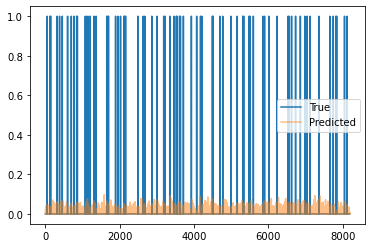

Train Epoch: 10 [610/2220 (27%)]	Loss: 0.039351	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [620/2220 (27%)]	Loss: 0.038998	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [630/2220 (28%)]	Loss: 0.039421	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [640/2220 (28%)]	Loss: 0.033148	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [650/2220 (29%)]	Loss: 0.036530	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [660/2220 (29%)]	Loss: 0.042597	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [670/2220 (30%)]	Loss: 0.036462	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [680/2220 (30%)]	Loss: 0.040784	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [690/2220 (31%)]	Loss: 0.035833	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [700/2220 (31%)]	Loss: 0.041797	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [710/2220 (31%)]	Loss: 0.035853	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [720/2220 (32%)]	Loss: 0.039972	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 

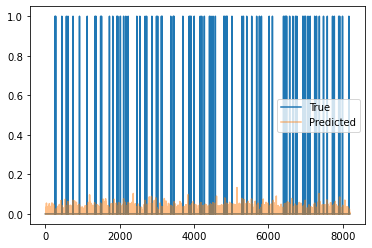

Train Epoch: 10 [910/2220 (40%)]	Loss: 0.040835	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [920/2220 (41%)]	Loss: 0.037460	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [930/2220 (41%)]	Loss: 0.040563	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [940/2220 (42%)]	Loss: 0.040180	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [950/2220 (42%)]	Loss: 0.039505	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [960/2220 (43%)]	Loss: 0.038313	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [970/2220 (43%)]	Loss: 0.041068	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [980/2220 (44%)]	Loss: 0.038312	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [990/2220 (44%)]	Loss: 0.042486	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [1000/2220 (45%)]	Loss: 0.041008	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [1010/2220 (45%)]	Loss: 0.039626	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [1020/2220 (45%)]	Loss: 0.041779	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 

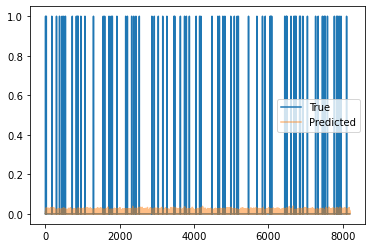

Train Epoch: 10 [1210/2220 (54%)]	Loss: 0.039866	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [1220/2220 (54%)]	Loss: 0.034085	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [1230/2220 (55%)]	Loss: 0.041275	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [1240/2220 (55%)]	Loss: 0.038574	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [1250/2220 (56%)]	Loss: 0.044460	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [1260/2220 (56%)]	Loss: 0.040279	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [1270/2220 (57%)]	Loss: 0.039039	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [1280/2220 (57%)]	Loss: 0.040267	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [1290/2220 (58%)]	Loss: 0.040077	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [1300/2220 (58%)]	Loss: 0.040126	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [1310/2220 (59%)]	Loss: 0.037801	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [1320/2220 (59%)]	Loss: 0.039974	Pres: 0.000000	F1 Score: 0.000000
Trai

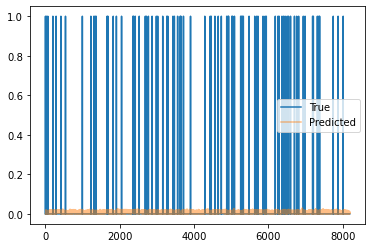

Train Epoch: 10 [1510/2220 (68%)]	Loss: 0.041887	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [1520/2220 (68%)]	Loss: 0.041891	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [1530/2220 (68%)]	Loss: 0.038769	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [1540/2220 (69%)]	Loss: 0.041145	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [1550/2220 (69%)]	Loss: 0.041874	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [1560/2220 (70%)]	Loss: 0.037897	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [1570/2220 (70%)]	Loss: 0.043784	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [1580/2220 (71%)]	Loss: 0.040754	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [1590/2220 (71%)]	Loss: 0.042050	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [1600/2220 (72%)]	Loss: 0.041777	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [1610/2220 (72%)]	Loss: 0.042304	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [1620/2220 (72%)]	Loss: 0.036996	Pres: 0.000000	F1 Score: 0.000000
Trai

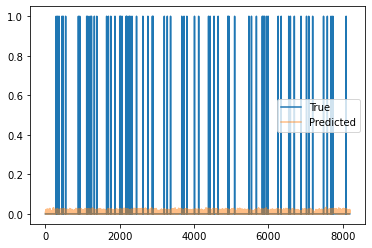

Train Epoch: 10 [1810/2220 (81%)]	Loss: 0.043688	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [1820/2220 (81%)]	Loss: 0.036891	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [1830/2220 (82%)]	Loss: 0.039999	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [1840/2220 (82%)]	Loss: 0.042909	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [1850/2220 (83%)]	Loss: 0.040758	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [1860/2220 (83%)]	Loss: 0.042961	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [1870/2220 (84%)]	Loss: 0.041416	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [1880/2220 (84%)]	Loss: 0.041534	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [1890/2220 (85%)]	Loss: 0.042043	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [1900/2220 (85%)]	Loss: 0.042638	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [1910/2220 (86%)]	Loss: 0.041936	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [1920/2220 (86%)]	Loss: 0.045323	Pres: 0.000000	F1 Score: 0.000000
Trai

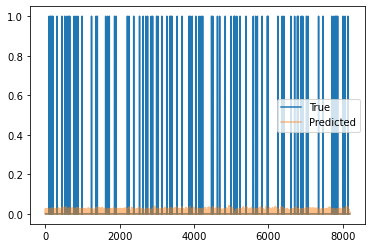

Train Epoch: 10 [2110/2220 (95%)]	Loss: 0.036498	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [2120/2220 (95%)]	Loss: 0.041709	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [2130/2220 (95%)]	Loss: 0.039142	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [2140/2220 (96%)]	Loss: 0.039568	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [2150/2220 (96%)]	Loss: 0.037091	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [2160/2220 (97%)]	Loss: 0.036974	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [2170/2220 (97%)]	Loss: 0.036637	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [2180/2220 (98%)]	Loss: 0.038822	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [2190/2220 (98%)]	Loss: 0.039312	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [2200/2220 (99%)]	Loss: 0.038126	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [2210/2220 (99%)]	Loss: 0.040145	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 10 [0/582 (0%)]	Loss: 0.036368	Pres: 0.000000	F1 Score: 0.000000


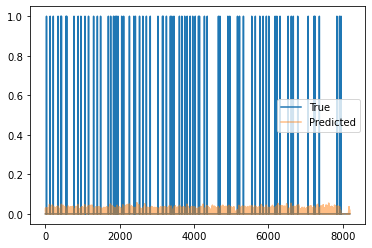

Validation Epoch: 10 [10/582 (1%)]	Loss: 0.036205	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 10 [20/582 (3%)]	Loss: 0.037538	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 10 [30/582 (5%)]	Loss: 0.039699	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 10 [40/582 (6%)]	Loss: 0.036429	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 10 [50/582 (8%)]	Loss: 0.041324	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 10 [60/582 (10%)]	Loss: 0.039056	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 10 [70/582 (12%)]	Loss: 0.042663	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 10 [80/582 (13%)]	Loss: 0.040058	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 10 [90/582 (15%)]	Loss: 0.039197	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 10 [100/582 (17%)]	Loss: 0.036403	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 10 [110/582 (18%)]	Loss: 0.041139	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 10 [120/582 (20%)]	Loss: 0.033144	Pres: 0.000000	F

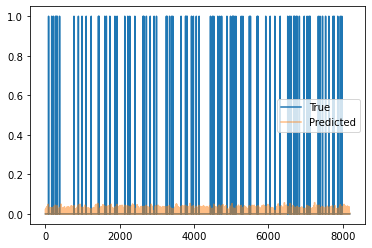

Validation Epoch: 10 [310/582 (53%)]	Loss: 0.035700	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 10 [320/582 (54%)]	Loss: 0.038842	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 10 [330/582 (56%)]	Loss: 0.036088	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 10 [340/582 (58%)]	Loss: 0.038093	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 10 [350/582 (60%)]	Loss: 0.041284	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 10 [360/582 (61%)]	Loss: 0.042111	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 10 [370/582 (63%)]	Loss: 0.035758	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 10 [380/582 (65%)]	Loss: 0.041164	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 10 [390/582 (67%)]	Loss: 0.036346	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 10 [400/582 (68%)]	Loss: 0.040348	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 10 [410/582 (70%)]	Loss: 0.037869	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 10 [420/582 (72%)]	Loss: 0.037207	Pr

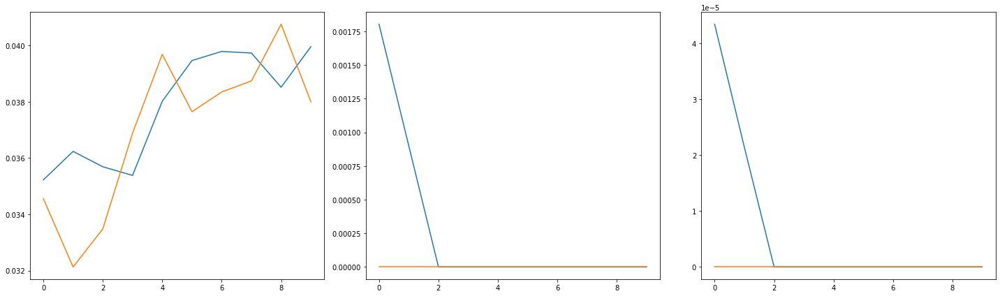

2220 582
Train Epoch: 11 [0/2220 (0%)]	Loss: 0.040603	Pres: 0.000000	F1 Score: 0.000000
87.0 -53216.0


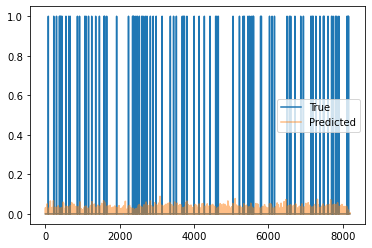

Train Epoch: 11 [10/2220 (0%)]	Loss: 0.039532	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [20/2220 (0%)]	Loss: 0.038190	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [30/2220 (1%)]	Loss: 0.039855	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [40/2220 (1%)]	Loss: 0.036786	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [50/2220 (2%)]	Loss: 0.039758	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [60/2220 (2%)]	Loss: 0.033718	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [70/2220 (3%)]	Loss: 0.038602	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [80/2220 (3%)]	Loss: 0.039522	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [90/2220 (4%)]	Loss: 0.041067	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [100/2220 (4%)]	Loss: 0.037670	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [110/2220 (4%)]	Loss: 0.036731	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [120/2220 (5%)]	Loss: 0.037955	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [130/2220 (5%)]	Loss:

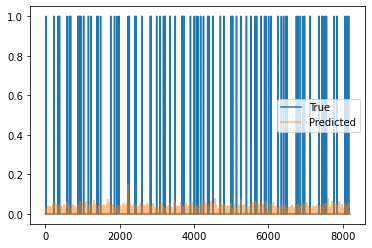

Train Epoch: 11 [310/2220 (13%)]	Loss: 0.036792	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [320/2220 (14%)]	Loss: 0.038198	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [330/2220 (14%)]	Loss: 0.037853	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [340/2220 (15%)]	Loss: 0.042582	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [350/2220 (15%)]	Loss: 0.035245	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [360/2220 (16%)]	Loss: 0.036217	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [370/2220 (16%)]	Loss: 0.038972	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [380/2220 (17%)]	Loss: 0.038178	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [390/2220 (17%)]	Loss: 0.039090	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [400/2220 (18%)]	Loss: 0.042953	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [410/2220 (18%)]	Loss: 0.039431	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [420/2220 (18%)]	Loss: 0.037202	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 

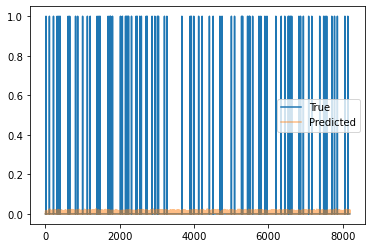

Train Epoch: 11 [610/2220 (27%)]	Loss: 0.044435	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [620/2220 (27%)]	Loss: 0.043255	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [630/2220 (28%)]	Loss: 0.037999	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [640/2220 (28%)]	Loss: 0.039511	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [650/2220 (29%)]	Loss: 0.042915	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [660/2220 (29%)]	Loss: 0.042227	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [670/2220 (30%)]	Loss: 0.037947	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [680/2220 (30%)]	Loss: 0.047145	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [690/2220 (31%)]	Loss: 0.042572	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [700/2220 (31%)]	Loss: 0.043254	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [710/2220 (31%)]	Loss: 0.036953	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [720/2220 (32%)]	Loss: 0.040098	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 

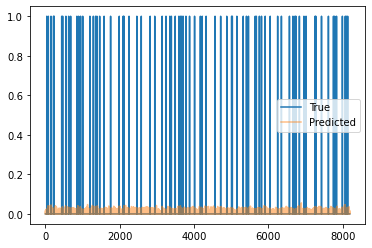

Train Epoch: 11 [910/2220 (40%)]	Loss: 0.039772	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [920/2220 (41%)]	Loss: 0.037406	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [930/2220 (41%)]	Loss: 0.040405	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [940/2220 (42%)]	Loss: 0.035300	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [950/2220 (42%)]	Loss: 0.035578	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [960/2220 (43%)]	Loss: 0.035486	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [970/2220 (43%)]	Loss: 0.042426	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [980/2220 (44%)]	Loss: 0.039285	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [990/2220 (44%)]	Loss: 0.040845	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [1000/2220 (45%)]	Loss: 0.042812	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [1010/2220 (45%)]	Loss: 0.040827	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [1020/2220 (45%)]	Loss: 0.050606	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 

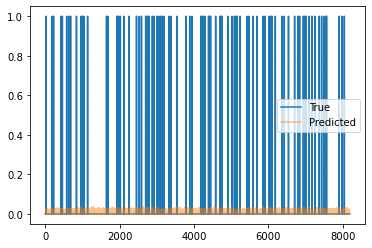

Train Epoch: 11 [1210/2220 (54%)]	Loss: 0.038478	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [1220/2220 (54%)]	Loss: 0.040162	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [1230/2220 (55%)]	Loss: 0.042481	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [1240/2220 (55%)]	Loss: 0.039453	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [1250/2220 (56%)]	Loss: 0.039239	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [1260/2220 (56%)]	Loss: 0.043703	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [1270/2220 (57%)]	Loss: 0.038455	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [1280/2220 (57%)]	Loss: 0.040185	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [1290/2220 (58%)]	Loss: 0.042693	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [1300/2220 (58%)]	Loss: 0.045356	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [1310/2220 (59%)]	Loss: 0.041341	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [1320/2220 (59%)]	Loss: 0.039878	Pres: 0.000000	F1 Score: 0.000000
Trai

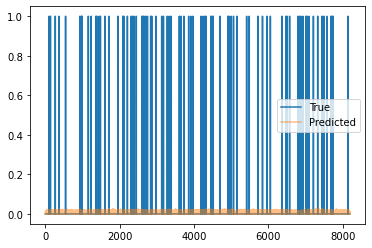

Train Epoch: 11 [1510/2220 (68%)]	Loss: 0.037851	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [1520/2220 (68%)]	Loss: 0.040501	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [1530/2220 (68%)]	Loss: 0.043408	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [1540/2220 (69%)]	Loss: 0.037838	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [1550/2220 (69%)]	Loss: 0.045533	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [1560/2220 (70%)]	Loss: 0.038837	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [1570/2220 (70%)]	Loss: 0.040542	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [1580/2220 (71%)]	Loss: 0.039803	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [1590/2220 (71%)]	Loss: 0.046805	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [1600/2220 (72%)]	Loss: 0.041582	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [1610/2220 (72%)]	Loss: 0.038775	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [1620/2220 (72%)]	Loss: 0.039155	Pres: 0.000000	F1 Score: 0.000000
Trai

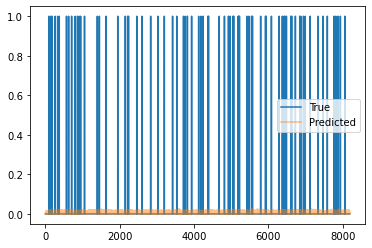

Train Epoch: 11 [1810/2220 (81%)]	Loss: 0.040912	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [1820/2220 (81%)]	Loss: 0.041329	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [1830/2220 (82%)]	Loss: 0.040618	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [1840/2220 (82%)]	Loss: 0.041511	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [1850/2220 (83%)]	Loss: 0.039426	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [1860/2220 (83%)]	Loss: 0.039642	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [1870/2220 (84%)]	Loss: 0.032870	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [1880/2220 (84%)]	Loss: 0.035797	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [1890/2220 (85%)]	Loss: 0.038744	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [1900/2220 (85%)]	Loss: 0.036079	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [1910/2220 (86%)]	Loss: 0.038079	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [1920/2220 (86%)]	Loss: 0.036573	Pres: 0.000000	F1 Score: 0.000000
Trai

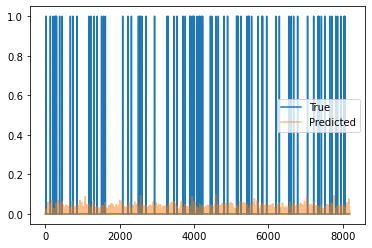

Train Epoch: 11 [2110/2220 (95%)]	Loss: 0.042114	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [2120/2220 (95%)]	Loss: 0.042729	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [2130/2220 (95%)]	Loss: 0.040307	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [2140/2220 (96%)]	Loss: 0.038517	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [2150/2220 (96%)]	Loss: 0.036638	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [2160/2220 (97%)]	Loss: 0.038058	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [2170/2220 (97%)]	Loss: 0.035892	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [2180/2220 (98%)]	Loss: 0.045285	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [2190/2220 (98%)]	Loss: 0.038336	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [2200/2220 (99%)]	Loss: 0.036774	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [2210/2220 (99%)]	Loss: 0.041543	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 11 [0/582 (0%)]	Loss: 0.039673	Pres: 0.000000	F1 Score: 0.000000


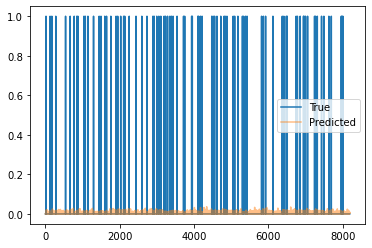

Validation Epoch: 11 [10/582 (1%)]	Loss: 0.040573	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 11 [20/582 (3%)]	Loss: 0.034599	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 11 [30/582 (5%)]	Loss: 0.036144	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 11 [40/582 (6%)]	Loss: 0.036630	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 11 [50/582 (8%)]	Loss: 0.040944	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 11 [60/582 (10%)]	Loss: 0.038494	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 11 [70/582 (12%)]	Loss: 0.034744	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 11 [80/582 (13%)]	Loss: 0.042893	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 11 [90/582 (15%)]	Loss: 0.037203	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 11 [100/582 (17%)]	Loss: 0.040164	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 11 [110/582 (18%)]	Loss: 0.037023	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 11 [120/582 (20%)]	Loss: 0.037044	Pres: 0.000000	F

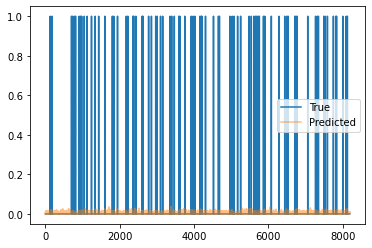

Validation Epoch: 11 [310/582 (53%)]	Loss: 0.035756	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 11 [320/582 (54%)]	Loss: 0.035747	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 11 [330/582 (56%)]	Loss: 0.037134	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 11 [340/582 (58%)]	Loss: 0.034456	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 11 [350/582 (60%)]	Loss: 0.035070	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 11 [360/582 (61%)]	Loss: 0.036656	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 11 [370/582 (63%)]	Loss: 0.033051	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 11 [380/582 (65%)]	Loss: 0.040306	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 11 [390/582 (67%)]	Loss: 0.039769	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 11 [400/582 (68%)]	Loss: 0.035400	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 11 [410/582 (70%)]	Loss: 0.040119	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 11 [420/582 (72%)]	Loss: 0.038757	Pr

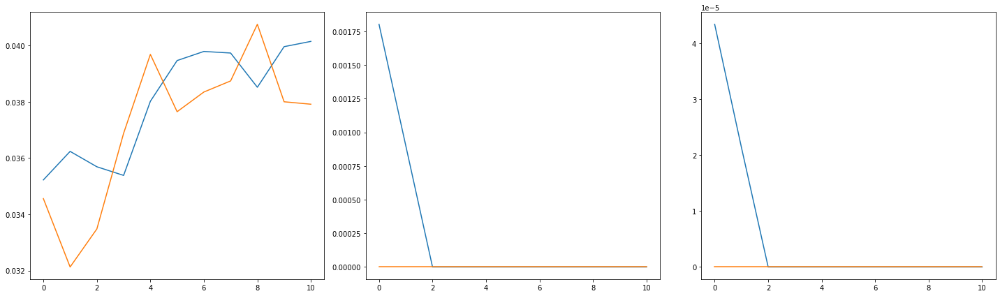

2220 582
Train Epoch: 12 [0/2220 (0%)]	Loss: 0.041029	Pres: 0.000000	F1 Score: 0.000000
89.0 -52864.0


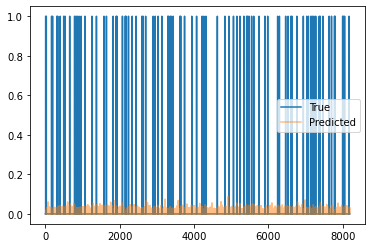

Train Epoch: 12 [10/2220 (0%)]	Loss: 0.042434	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [20/2220 (0%)]	Loss: 0.041975	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [30/2220 (1%)]	Loss: 0.040101	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [40/2220 (1%)]	Loss: 0.042452	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [50/2220 (2%)]	Loss: 0.040730	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [60/2220 (2%)]	Loss: 0.034683	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [70/2220 (3%)]	Loss: 0.039639	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [80/2220 (3%)]	Loss: 0.042723	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [90/2220 (4%)]	Loss: 0.039009	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [100/2220 (4%)]	Loss: 0.039022	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [110/2220 (4%)]	Loss: 0.042563	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [120/2220 (5%)]	Loss: 0.041314	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [130/2220 (5%)]	Loss:

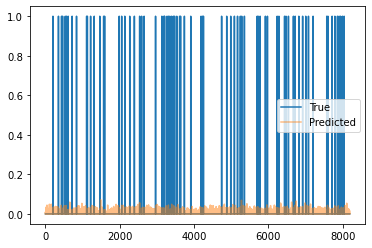

Train Epoch: 12 [310/2220 (13%)]	Loss: 0.044775	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [320/2220 (14%)]	Loss: 0.038761	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [330/2220 (14%)]	Loss: 0.037635	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [340/2220 (15%)]	Loss: 0.037263	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [350/2220 (15%)]	Loss: 0.040539	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [360/2220 (16%)]	Loss: 0.041540	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [370/2220 (16%)]	Loss: 0.039477	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [380/2220 (17%)]	Loss: 0.041357	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [390/2220 (17%)]	Loss: 0.040516	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [400/2220 (18%)]	Loss: 0.042903	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [410/2220 (18%)]	Loss: 0.041662	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [420/2220 (18%)]	Loss: 0.042234	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 

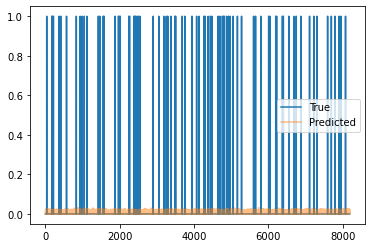

Train Epoch: 12 [610/2220 (27%)]	Loss: 0.042783	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [620/2220 (27%)]	Loss: 0.042992	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [630/2220 (28%)]	Loss: 0.039847	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [640/2220 (28%)]	Loss: 0.043780	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [650/2220 (29%)]	Loss: 0.042878	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [660/2220 (29%)]	Loss: 0.036370	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [670/2220 (30%)]	Loss: 0.040640	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [680/2220 (30%)]	Loss: 0.042412	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [690/2220 (31%)]	Loss: 0.039333	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [700/2220 (31%)]	Loss: 0.038047	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [710/2220 (31%)]	Loss: 0.043643	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [720/2220 (32%)]	Loss: 0.038647	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 

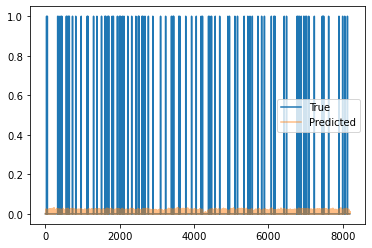

Train Epoch: 12 [910/2220 (40%)]	Loss: 0.044967	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [920/2220 (41%)]	Loss: 0.043210	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [930/2220 (41%)]	Loss: 0.038495	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [940/2220 (42%)]	Loss: 0.042235	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [950/2220 (42%)]	Loss: 0.042830	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [960/2220 (43%)]	Loss: 0.042303	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [970/2220 (43%)]	Loss: 0.040840	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [980/2220 (44%)]	Loss: 0.045330	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [990/2220 (44%)]	Loss: 0.042170	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [1000/2220 (45%)]	Loss: 0.042478	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [1010/2220 (45%)]	Loss: 0.038079	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [1020/2220 (45%)]	Loss: 0.040162	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 

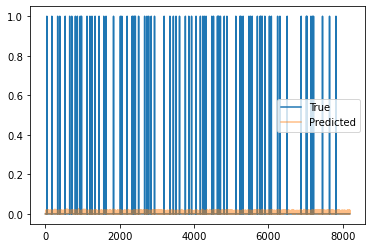

Train Epoch: 12 [1210/2220 (54%)]	Loss: 0.042721	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [1220/2220 (54%)]	Loss: 0.040696	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [1230/2220 (55%)]	Loss: 0.040246	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [1240/2220 (55%)]	Loss: 0.041674	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [1250/2220 (56%)]	Loss: 0.041022	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [1260/2220 (56%)]	Loss: 0.037091	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [1270/2220 (57%)]	Loss: 0.040510	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [1280/2220 (57%)]	Loss: 0.039811	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [1290/2220 (58%)]	Loss: 0.045466	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [1300/2220 (58%)]	Loss: 0.041366	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [1310/2220 (59%)]	Loss: 0.040825	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [1320/2220 (59%)]	Loss: 0.043861	Pres: 0.000000	F1 Score: 0.000000
Trai

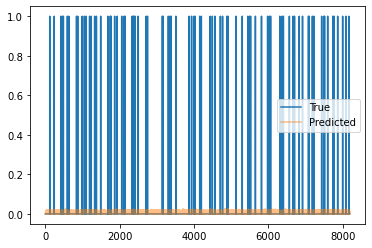

Train Epoch: 12 [1510/2220 (68%)]	Loss: 0.037892	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [1520/2220 (68%)]	Loss: 0.041444	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [1530/2220 (68%)]	Loss: 0.040087	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [1540/2220 (69%)]	Loss: 0.039108	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [1550/2220 (69%)]	Loss: 0.039528	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [1560/2220 (70%)]	Loss: 0.039837	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [1570/2220 (70%)]	Loss: 0.040502	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [1580/2220 (71%)]	Loss: 0.042840	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [1590/2220 (71%)]	Loss: 0.039262	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [1600/2220 (72%)]	Loss: 0.043488	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [1610/2220 (72%)]	Loss: 0.041839	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [1620/2220 (72%)]	Loss: 0.043655	Pres: 0.000000	F1 Score: 0.000000
Trai

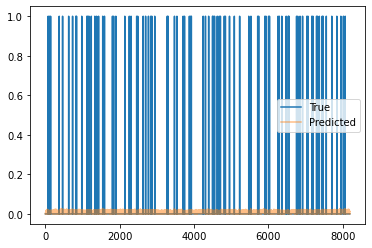

Train Epoch: 12 [1810/2220 (81%)]	Loss: 0.043104	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [1820/2220 (81%)]	Loss: 0.045773	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [1830/2220 (82%)]	Loss: 0.039826	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [1840/2220 (82%)]	Loss: 0.043194	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [1850/2220 (83%)]	Loss: 0.040309	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [1860/2220 (83%)]	Loss: 0.041790	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [1870/2220 (84%)]	Loss: 0.041243	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [1880/2220 (84%)]	Loss: 0.037719	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [1890/2220 (85%)]	Loss: 0.033983	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [1900/2220 (85%)]	Loss: 0.042696	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [1910/2220 (86%)]	Loss: 0.042055	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [1920/2220 (86%)]	Loss: 0.038507	Pres: 0.000000	F1 Score: 0.000000
Trai

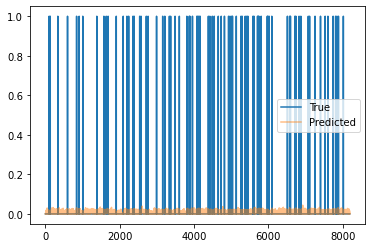

Train Epoch: 12 [2110/2220 (95%)]	Loss: 0.040509	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [2120/2220 (95%)]	Loss: 0.044877	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [2130/2220 (95%)]	Loss: 0.040541	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [2140/2220 (96%)]	Loss: 0.042326	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [2150/2220 (96%)]	Loss: 0.039169	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [2160/2220 (97%)]	Loss: 0.039692	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [2170/2220 (97%)]	Loss: 0.044138	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [2180/2220 (98%)]	Loss: 0.045703	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [2190/2220 (98%)]	Loss: 0.040487	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [2200/2220 (99%)]	Loss: 0.040104	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [2210/2220 (99%)]	Loss: 0.033907	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 12 [0/582 (0%)]	Loss: 0.043206	Pres: 0.000000	F1 Score: 0.000000


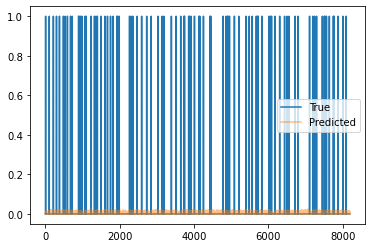

Validation Epoch: 12 [10/582 (1%)]	Loss: 0.035085	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 12 [20/582 (3%)]	Loss: 0.043620	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 12 [30/582 (5%)]	Loss: 0.043289	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 12 [40/582 (6%)]	Loss: 0.037364	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 12 [50/582 (8%)]	Loss: 0.046974	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 12 [60/582 (10%)]	Loss: 0.042756	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 12 [70/582 (12%)]	Loss: 0.037757	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 12 [80/582 (13%)]	Loss: 0.042596	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 12 [90/582 (15%)]	Loss: 0.037545	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 12 [100/582 (17%)]	Loss: 0.038163	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 12 [110/582 (18%)]	Loss: 0.043552	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 12 [120/582 (20%)]	Loss: 0.041196	Pres: 0.000000	F

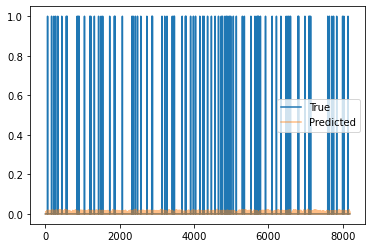

Validation Epoch: 12 [310/582 (53%)]	Loss: 0.031010	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 12 [320/582 (54%)]	Loss: 0.034785	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 12 [330/582 (56%)]	Loss: 0.043519	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 12 [340/582 (58%)]	Loss: 0.041838	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 12 [350/582 (60%)]	Loss: 0.045645	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 12 [360/582 (61%)]	Loss: 0.040532	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 12 [370/582 (63%)]	Loss: 0.034339	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 12 [380/582 (65%)]	Loss: 0.035279	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 12 [390/582 (67%)]	Loss: 0.043116	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 12 [400/582 (68%)]	Loss: 0.040118	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 12 [410/582 (70%)]	Loss: 0.042048	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 12 [420/582 (72%)]	Loss: 0.035679	Pr

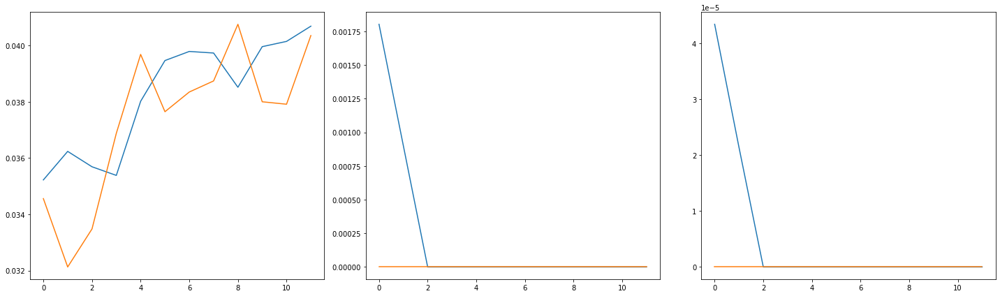

2220 582
Train Epoch: 13 [0/2220 (0%)]	Loss: 0.042970	Pres: 0.000000	F1 Score: 0.000000
89.0 -48416.0


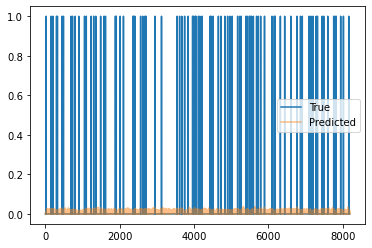

Train Epoch: 13 [10/2220 (0%)]	Loss: 0.039737	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [20/2220 (0%)]	Loss: 0.041405	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [30/2220 (1%)]	Loss: 0.040866	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [40/2220 (1%)]	Loss: 0.041357	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [50/2220 (2%)]	Loss: 0.041322	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [60/2220 (2%)]	Loss: 0.038354	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [70/2220 (3%)]	Loss: 0.037272	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [80/2220 (3%)]	Loss: 0.043963	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [90/2220 (4%)]	Loss: 0.042252	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [100/2220 (4%)]	Loss: 0.036732	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [110/2220 (4%)]	Loss: 0.037931	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [120/2220 (5%)]	Loss: 0.038239	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [130/2220 (5%)]	Loss:

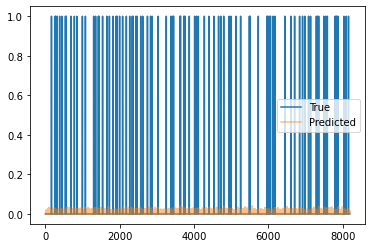

Train Epoch: 13 [310/2220 (13%)]	Loss: 0.038612	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [320/2220 (14%)]	Loss: 0.043874	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [330/2220 (14%)]	Loss: 0.040517	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [340/2220 (15%)]	Loss: 0.042929	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [350/2220 (15%)]	Loss: 0.041484	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [360/2220 (16%)]	Loss: 0.044483	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [370/2220 (16%)]	Loss: 0.042317	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [380/2220 (17%)]	Loss: 0.043468	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [390/2220 (17%)]	Loss: 0.041728	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [400/2220 (18%)]	Loss: 0.037888	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [410/2220 (18%)]	Loss: 0.043058	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [420/2220 (18%)]	Loss: 0.039258	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 

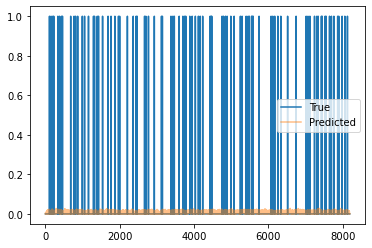

Train Epoch: 13 [610/2220 (27%)]	Loss: 0.040510	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [620/2220 (27%)]	Loss: 0.042305	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [630/2220 (28%)]	Loss: 0.041139	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [640/2220 (28%)]	Loss: 0.039628	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [650/2220 (29%)]	Loss: 0.039203	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [660/2220 (29%)]	Loss: 0.040909	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [670/2220 (30%)]	Loss: 0.040567	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [680/2220 (30%)]	Loss: 0.037532	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [690/2220 (31%)]	Loss: 0.039008	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [700/2220 (31%)]	Loss: 0.038963	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [710/2220 (31%)]	Loss: 0.038156	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [720/2220 (32%)]	Loss: 0.042190	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 

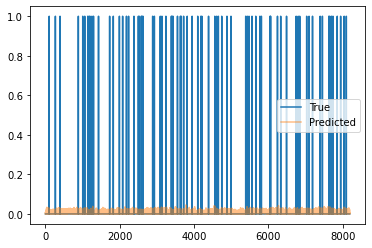

Train Epoch: 13 [910/2220 (40%)]	Loss: 0.046056	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [920/2220 (41%)]	Loss: 0.040150	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [930/2220 (41%)]	Loss: 0.046155	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [940/2220 (42%)]	Loss: 0.046648	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [950/2220 (42%)]	Loss: 0.043005	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [960/2220 (43%)]	Loss: 0.039932	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [970/2220 (43%)]	Loss: 0.045157	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [980/2220 (44%)]	Loss: 0.039987	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [990/2220 (44%)]	Loss: 0.041125	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1000/2220 (45%)]	Loss: 0.040846	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1010/2220 (45%)]	Loss: 0.043776	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1020/2220 (45%)]	Loss: 0.041202	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 

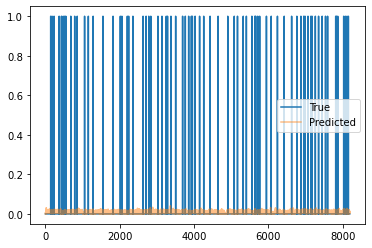

Train Epoch: 13 [1210/2220 (54%)]	Loss: 0.047493	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1220/2220 (54%)]	Loss: 0.041961	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1230/2220 (55%)]	Loss: 0.041961	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1240/2220 (55%)]	Loss: 0.044192	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1250/2220 (56%)]	Loss: 0.044226	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1260/2220 (56%)]	Loss: 0.043807	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1270/2220 (57%)]	Loss: 0.039476	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1280/2220 (57%)]	Loss: 0.041128	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1290/2220 (58%)]	Loss: 0.042700	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1300/2220 (58%)]	Loss: 0.040602	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1310/2220 (59%)]	Loss: 0.043159	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1320/2220 (59%)]	Loss: 0.044007	Pres: 0.000000	F1 Score: 0.000000
Trai

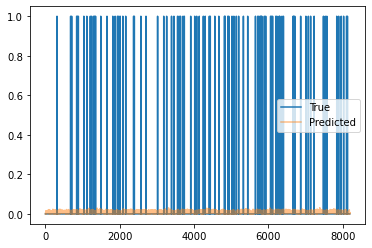

Train Epoch: 13 [1510/2220 (68%)]	Loss: 0.041973	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1520/2220 (68%)]	Loss: 0.037516	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1530/2220 (68%)]	Loss: 0.043376	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1540/2220 (69%)]	Loss: 0.040916	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1550/2220 (69%)]	Loss: 0.042132	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1560/2220 (70%)]	Loss: 0.042395	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1570/2220 (70%)]	Loss: 0.042345	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1580/2220 (71%)]	Loss: 0.044826	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1590/2220 (71%)]	Loss: 0.041454	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1600/2220 (72%)]	Loss: 0.040429	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1610/2220 (72%)]	Loss: 0.041046	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1620/2220 (72%)]	Loss: 0.044634	Pres: 0.000000	F1 Score: 0.000000
Trai

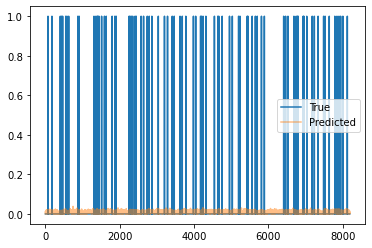

Train Epoch: 13 [1810/2220 (81%)]	Loss: 0.040988	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1820/2220 (81%)]	Loss: 0.046342	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1830/2220 (82%)]	Loss: 0.044109	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1840/2220 (82%)]	Loss: 0.045300	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1850/2220 (83%)]	Loss: 0.041224	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1860/2220 (83%)]	Loss: 0.040424	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1870/2220 (84%)]	Loss: 0.041182	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1880/2220 (84%)]	Loss: 0.041015	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1890/2220 (85%)]	Loss: 0.040694	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1900/2220 (85%)]	Loss: 0.035039	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1910/2220 (86%)]	Loss: 0.042912	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1920/2220 (86%)]	Loss: 0.042350	Pres: 0.000000	F1 Score: 0.000000
Trai

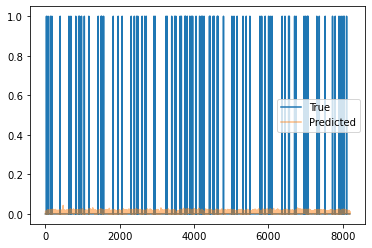

Train Epoch: 13 [2110/2220 (95%)]	Loss: 0.040855	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [2120/2220 (95%)]	Loss: 0.045557	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [2130/2220 (95%)]	Loss: 0.040168	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [2140/2220 (96%)]	Loss: 0.041287	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [2150/2220 (96%)]	Loss: 0.039153	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [2160/2220 (97%)]	Loss: 0.037320	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [2170/2220 (97%)]	Loss: 0.038770	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [2180/2220 (98%)]	Loss: 0.048423	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [2190/2220 (98%)]	Loss: 0.042149	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [2200/2220 (99%)]	Loss: 0.045051	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [2210/2220 (99%)]	Loss: 0.040933	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 13 [0/582 (0%)]	Loss: 0.042626	Pres: 0.000000	F1 Score: 0.000000


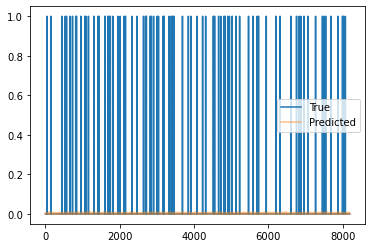

Validation Epoch: 13 [10/582 (1%)]	Loss: 0.040949	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 13 [20/582 (3%)]	Loss: 0.047680	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 13 [30/582 (5%)]	Loss: 0.042377	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 13 [40/582 (6%)]	Loss: 0.044636	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 13 [50/582 (8%)]	Loss: 0.046230	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 13 [60/582 (10%)]	Loss: 0.048128	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 13 [70/582 (12%)]	Loss: 0.043616	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 13 [80/582 (13%)]	Loss: 0.043888	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 13 [90/582 (15%)]	Loss: 0.042721	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 13 [100/582 (17%)]	Loss: 0.044281	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 13 [110/582 (18%)]	Loss: 0.044772	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 13 [120/582 (20%)]	Loss: 0.049792	Pres: 0.000000	F

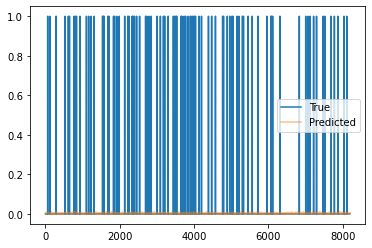

Validation Epoch: 13 [310/582 (53%)]	Loss: 0.043259	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 13 [320/582 (54%)]	Loss: 0.041839	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 13 [330/582 (56%)]	Loss: 0.045603	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 13 [340/582 (58%)]	Loss: 0.049770	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 13 [350/582 (60%)]	Loss: 0.044205	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 13 [360/582 (61%)]	Loss: 0.044588	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 13 [370/582 (63%)]	Loss: 0.050617	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 13 [380/582 (65%)]	Loss: 0.045415	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 13 [390/582 (67%)]	Loss: 0.042576	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 13 [400/582 (68%)]	Loss: 0.039011	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 13 [410/582 (70%)]	Loss: 0.045699	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 13 [420/582 (72%)]	Loss: 0.051335	Pr

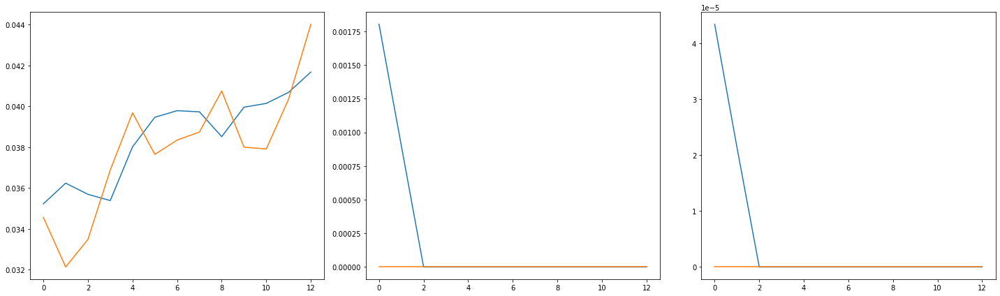

2220 582
Train Epoch: 14 [0/2220 (0%)]	Loss: 0.041744	Pres: 0.000000	F1 Score: 0.000000
82.0 -44320.0


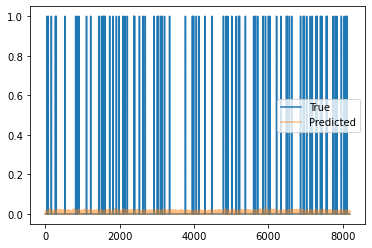

Train Epoch: 14 [10/2220 (0%)]	Loss: 0.044820	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [20/2220 (0%)]	Loss: 0.043365	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [30/2220 (1%)]	Loss: 0.043160	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [40/2220 (1%)]	Loss: 0.045290	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [50/2220 (2%)]	Loss: 0.045133	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [60/2220 (2%)]	Loss: 0.045925	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [70/2220 (3%)]	Loss: 0.045929	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [80/2220 (3%)]	Loss: 0.041631	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [90/2220 (4%)]	Loss: 0.045343	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [100/2220 (4%)]	Loss: 0.043207	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [110/2220 (4%)]	Loss: 0.047436	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [120/2220 (5%)]	Loss: 0.042659	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [130/2220 (5%)]	Loss:

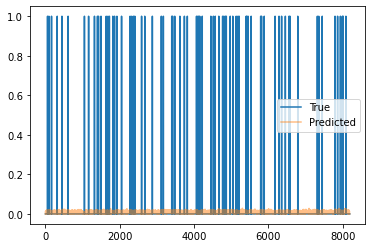

Train Epoch: 14 [310/2220 (13%)]	Loss: 0.048084	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [320/2220 (14%)]	Loss: 0.043329	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [330/2220 (14%)]	Loss: 0.041744	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [340/2220 (15%)]	Loss: 0.045953	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [350/2220 (15%)]	Loss: 0.042693	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [360/2220 (16%)]	Loss: 0.042558	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [370/2220 (16%)]	Loss: 0.042492	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [380/2220 (17%)]	Loss: 0.042017	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [390/2220 (17%)]	Loss: 0.043728	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [400/2220 (18%)]	Loss: 0.043585	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [410/2220 (18%)]	Loss: 0.041809	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [420/2220 (18%)]	Loss: 0.042100	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 

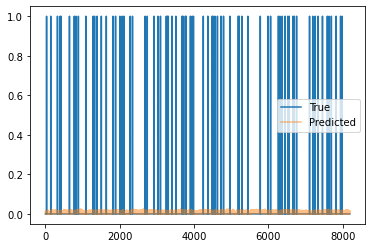

Train Epoch: 14 [610/2220 (27%)]	Loss: 0.039323	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [620/2220 (27%)]	Loss: 0.039975	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [630/2220 (28%)]	Loss: 0.038764	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [640/2220 (28%)]	Loss: 0.042370	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [650/2220 (29%)]	Loss: 0.045927	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [660/2220 (29%)]	Loss: 0.044958	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [670/2220 (30%)]	Loss: 0.043799	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [680/2220 (30%)]	Loss: 0.047709	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [690/2220 (31%)]	Loss: 0.042048	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [700/2220 (31%)]	Loss: 0.044697	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [710/2220 (31%)]	Loss: 0.043353	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [720/2220 (32%)]	Loss: 0.039981	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 

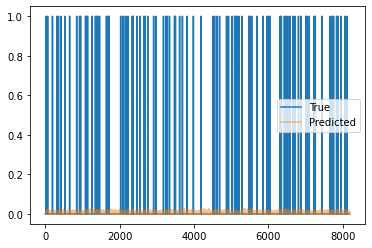

Train Epoch: 14 [910/2220 (40%)]	Loss: 0.043641	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [920/2220 (41%)]	Loss: 0.041349	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [930/2220 (41%)]	Loss: 0.041269	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [940/2220 (42%)]	Loss: 0.044233	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [950/2220 (42%)]	Loss: 0.047717	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [960/2220 (43%)]	Loss: 0.041576	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [970/2220 (43%)]	Loss: 0.037565	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [980/2220 (44%)]	Loss: 0.037260	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [990/2220 (44%)]	Loss: 0.039964	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1000/2220 (45%)]	Loss: 0.044330	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1010/2220 (45%)]	Loss: 0.043550	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1020/2220 (45%)]	Loss: 0.035916	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 

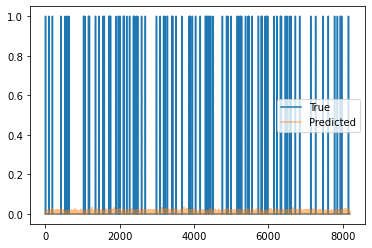

Train Epoch: 14 [1210/2220 (54%)]	Loss: 0.037466	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1220/2220 (54%)]	Loss: 0.041208	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1230/2220 (55%)]	Loss: 0.042461	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1240/2220 (55%)]	Loss: 0.039231	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1250/2220 (56%)]	Loss: 0.043335	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1260/2220 (56%)]	Loss: 0.045681	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1270/2220 (57%)]	Loss: 0.044679	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1280/2220 (57%)]	Loss: 0.041752	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1290/2220 (58%)]	Loss: 0.040191	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1300/2220 (58%)]	Loss: 0.040256	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1310/2220 (59%)]	Loss: 0.041995	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1320/2220 (59%)]	Loss: 0.040722	Pres: 0.000000	F1 Score: 0.000000
Trai

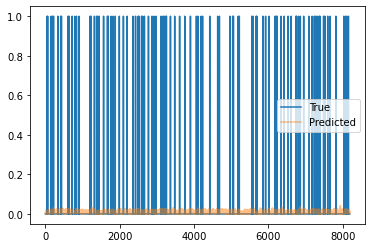

Train Epoch: 14 [1510/2220 (68%)]	Loss: 0.041289	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1520/2220 (68%)]	Loss: 0.045025	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1530/2220 (68%)]	Loss: 0.044512	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1540/2220 (69%)]	Loss: 0.040286	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1550/2220 (69%)]	Loss: 0.046984	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1560/2220 (70%)]	Loss: 0.041556	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1570/2220 (70%)]	Loss: 0.047831	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1580/2220 (71%)]	Loss: 0.039799	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1590/2220 (71%)]	Loss: 0.042241	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1600/2220 (72%)]	Loss: 0.042258	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1610/2220 (72%)]	Loss: 0.046613	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1620/2220 (72%)]	Loss: 0.041910	Pres: 0.000000	F1 Score: 0.000000
Trai

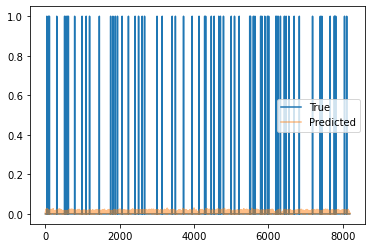

Train Epoch: 14 [1810/2220 (81%)]	Loss: 0.038861	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1820/2220 (81%)]	Loss: 0.046697	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1830/2220 (82%)]	Loss: 0.040813	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1840/2220 (82%)]	Loss: 0.046023	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1850/2220 (83%)]	Loss: 0.044773	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1860/2220 (83%)]	Loss: 0.039683	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1870/2220 (84%)]	Loss: 0.044018	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1880/2220 (84%)]	Loss: 0.044178	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1890/2220 (85%)]	Loss: 0.038629	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1900/2220 (85%)]	Loss: 0.043822	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1910/2220 (86%)]	Loss: 0.045557	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1920/2220 (86%)]	Loss: 0.039934	Pres: 0.000000	F1 Score: 0.000000
Trai

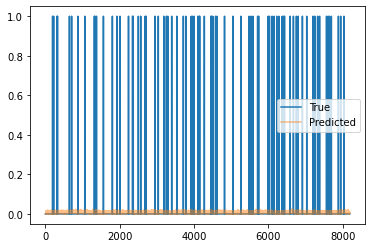

Train Epoch: 14 [2110/2220 (95%)]	Loss: 0.041573	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [2120/2220 (95%)]	Loss: 0.040553	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [2130/2220 (95%)]	Loss: 0.045867	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [2140/2220 (96%)]	Loss: 0.040411	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [2150/2220 (96%)]	Loss: 0.043852	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [2160/2220 (97%)]	Loss: 0.044055	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [2170/2220 (97%)]	Loss: 0.042146	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [2180/2220 (98%)]	Loss: 0.039527	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [2190/2220 (98%)]	Loss: 0.039253	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [2200/2220 (99%)]	Loss: 0.045697	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [2210/2220 (99%)]	Loss: 0.041614	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 14 [0/582 (0%)]	Loss: 0.041980	Pres: 0.000000	F1 Score: 0.000000


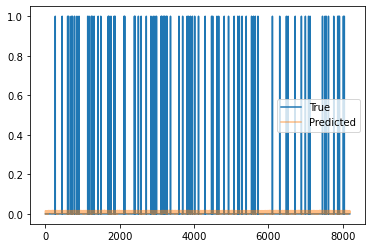

Validation Epoch: 14 [10/582 (1%)]	Loss: 0.041898	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 14 [20/582 (3%)]	Loss: 0.042152	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 14 [30/582 (5%)]	Loss: 0.044399	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 14 [40/582 (6%)]	Loss: 0.038676	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 14 [50/582 (8%)]	Loss: 0.044852	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 14 [60/582 (10%)]	Loss: 0.041736	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 14 [70/582 (12%)]	Loss: 0.042801	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 14 [80/582 (13%)]	Loss: 0.046930	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 14 [90/582 (15%)]	Loss: 0.039105	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 14 [100/582 (17%)]	Loss: 0.047072	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 14 [110/582 (18%)]	Loss: 0.044243	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 14 [120/582 (20%)]	Loss: 0.040002	Pres: 0.000000	F

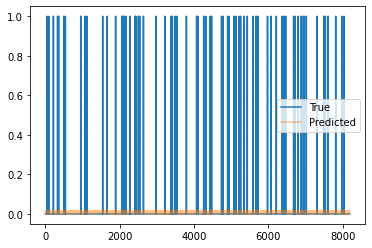

Validation Epoch: 14 [310/582 (53%)]	Loss: 0.046964	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 14 [320/582 (54%)]	Loss: 0.044162	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 14 [330/582 (56%)]	Loss: 0.037942	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 14 [340/582 (58%)]	Loss: 0.042618	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 14 [350/582 (60%)]	Loss: 0.045417	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 14 [360/582 (61%)]	Loss: 0.041973	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 14 [370/582 (63%)]	Loss: 0.043908	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 14 [380/582 (65%)]	Loss: 0.042657	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 14 [390/582 (67%)]	Loss: 0.043901	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 14 [400/582 (68%)]	Loss: 0.041890	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 14 [410/582 (70%)]	Loss: 0.044940	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 14 [420/582 (72%)]	Loss: 0.042998	Pr

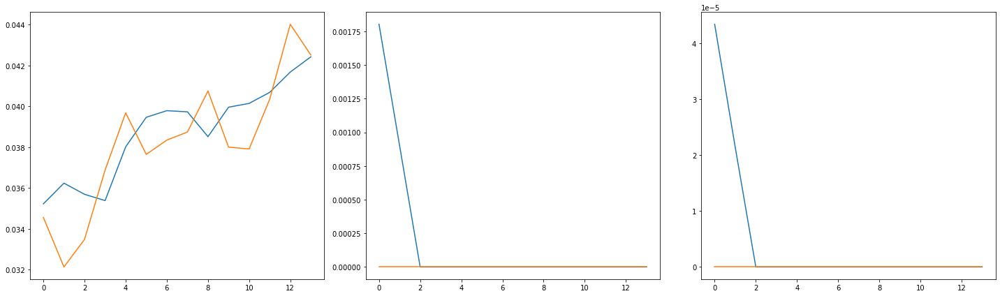

2220 582
Train Epoch: 15 [0/2220 (0%)]	Loss: 0.041084	Pres: 0.000000	F1 Score: 0.000000
83.0 -46848.0


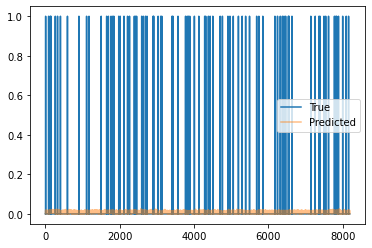

Train Epoch: 15 [10/2220 (0%)]	Loss: 0.038814	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [20/2220 (0%)]	Loss: 0.039188	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [30/2220 (1%)]	Loss: 0.042948	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [40/2220 (1%)]	Loss: 0.044430	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [50/2220 (2%)]	Loss: 0.043571	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [60/2220 (2%)]	Loss: 0.045371	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [70/2220 (3%)]	Loss: 0.038264	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [80/2220 (3%)]	Loss: 0.039185	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [90/2220 (4%)]	Loss: 0.040792	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [100/2220 (4%)]	Loss: 0.040382	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [110/2220 (4%)]	Loss: 0.041693	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [120/2220 (5%)]	Loss: 0.042513	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [130/2220 (5%)]	Loss:

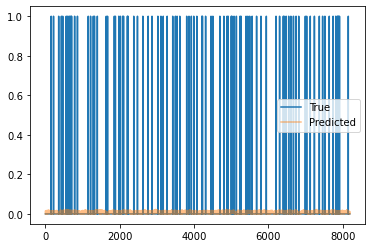

Train Epoch: 15 [310/2220 (13%)]	Loss: 0.035020	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [320/2220 (14%)]	Loss: 0.040746	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [330/2220 (14%)]	Loss: 0.047752	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [340/2220 (15%)]	Loss: 0.044646	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [350/2220 (15%)]	Loss: 0.037663	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [360/2220 (16%)]	Loss: 0.044318	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [370/2220 (16%)]	Loss: 0.042490	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [380/2220 (17%)]	Loss: 0.048128	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [390/2220 (17%)]	Loss: 0.042866	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [400/2220 (18%)]	Loss: 0.039072	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [410/2220 (18%)]	Loss: 0.042546	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [420/2220 (18%)]	Loss: 0.040769	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 

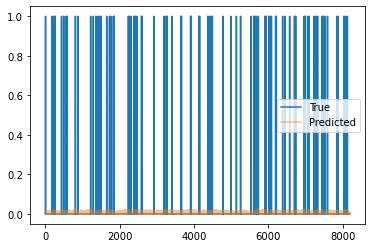

Train Epoch: 15 [610/2220 (27%)]	Loss: 0.044966	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [620/2220 (27%)]	Loss: 0.045223	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [630/2220 (28%)]	Loss: 0.041136	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [640/2220 (28%)]	Loss: 0.045592	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [650/2220 (29%)]	Loss: 0.043330	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [660/2220 (29%)]	Loss: 0.041761	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [670/2220 (30%)]	Loss: 0.041169	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [680/2220 (30%)]	Loss: 0.042057	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [690/2220 (31%)]	Loss: 0.043903	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [700/2220 (31%)]	Loss: 0.042985	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [710/2220 (31%)]	Loss: 0.040719	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [720/2220 (32%)]	Loss: 0.038951	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 

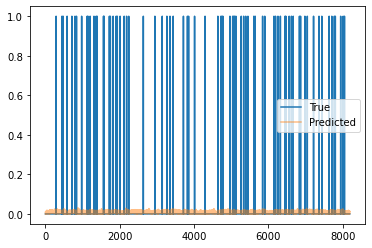

Train Epoch: 15 [910/2220 (40%)]	Loss: 0.040620	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [920/2220 (41%)]	Loss: 0.042444	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [930/2220 (41%)]	Loss: 0.042586	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [940/2220 (42%)]	Loss: 0.041116	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [950/2220 (42%)]	Loss: 0.037744	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [960/2220 (43%)]	Loss: 0.043151	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [970/2220 (43%)]	Loss: 0.040082	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [980/2220 (44%)]	Loss: 0.047203	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [990/2220 (44%)]	Loss: 0.042921	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1000/2220 (45%)]	Loss: 0.040625	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1010/2220 (45%)]	Loss: 0.041672	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1020/2220 (45%)]	Loss: 0.042192	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 

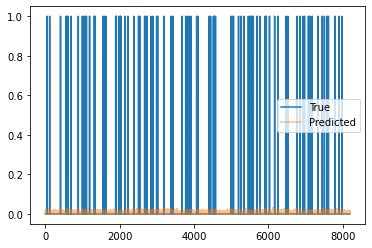

Train Epoch: 15 [1210/2220 (54%)]	Loss: 0.038911	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1220/2220 (54%)]	Loss: 0.039671	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1230/2220 (55%)]	Loss: 0.038735	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1240/2220 (55%)]	Loss: 0.042640	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1250/2220 (56%)]	Loss: 0.045269	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1260/2220 (56%)]	Loss: 0.046413	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1270/2220 (57%)]	Loss: 0.039343	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1280/2220 (57%)]	Loss: 0.041101	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1290/2220 (58%)]	Loss: 0.039357	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1300/2220 (58%)]	Loss: 0.041387	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1310/2220 (59%)]	Loss: 0.042147	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1320/2220 (59%)]	Loss: 0.043549	Pres: 0.000000	F1 Score: 0.000000
Trai

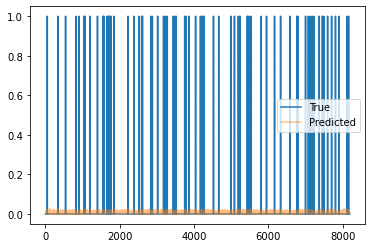

Train Epoch: 15 [1510/2220 (68%)]	Loss: 0.042701	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1520/2220 (68%)]	Loss: 0.048593	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1530/2220 (68%)]	Loss: 0.047861	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1540/2220 (69%)]	Loss: 0.043641	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1550/2220 (69%)]	Loss: 0.037998	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1560/2220 (70%)]	Loss: 0.039179	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1570/2220 (70%)]	Loss: 0.036246	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1580/2220 (71%)]	Loss: 0.041799	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1590/2220 (71%)]	Loss: 0.042174	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1600/2220 (72%)]	Loss: 0.043520	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1610/2220 (72%)]	Loss: 0.046372	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1620/2220 (72%)]	Loss: 0.040759	Pres: 0.000000	F1 Score: 0.000000
Trai

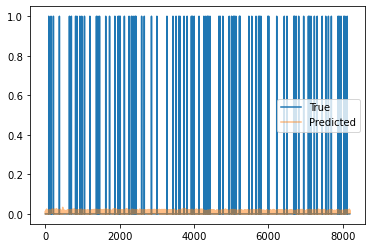

Train Epoch: 15 [1810/2220 (81%)]	Loss: 0.043550	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1820/2220 (81%)]	Loss: 0.043484	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1830/2220 (82%)]	Loss: 0.037590	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1840/2220 (82%)]	Loss: 0.039516	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1850/2220 (83%)]	Loss: 0.042751	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1860/2220 (83%)]	Loss: 0.041401	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1870/2220 (84%)]	Loss: 0.044497	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1880/2220 (84%)]	Loss: 0.040374	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1890/2220 (85%)]	Loss: 0.049436	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1900/2220 (85%)]	Loss: 0.039308	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1910/2220 (86%)]	Loss: 0.044908	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1920/2220 (86%)]	Loss: 0.039059	Pres: 0.000000	F1 Score: 0.000000
Trai

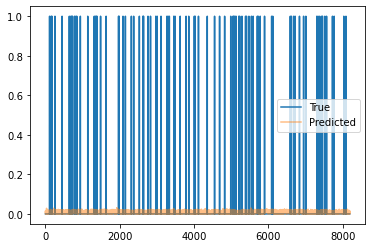

Train Epoch: 15 [2110/2220 (95%)]	Loss: 0.042169	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [2120/2220 (95%)]	Loss: 0.038379	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [2130/2220 (95%)]	Loss: 0.039355	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [2140/2220 (96%)]	Loss: 0.043588	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [2150/2220 (96%)]	Loss: 0.048519	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [2160/2220 (97%)]	Loss: 0.043877	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [2170/2220 (97%)]	Loss: 0.036209	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [2180/2220 (98%)]	Loss: 0.043947	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [2190/2220 (98%)]	Loss: 0.040139	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [2200/2220 (99%)]	Loss: 0.042954	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [2210/2220 (99%)]	Loss: 0.043976	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 15 [0/582 (0%)]	Loss: 0.044924	Pres: 0.000000	F1 Score: 0.000000


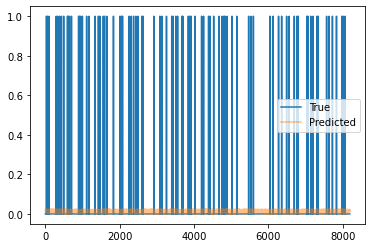

Validation Epoch: 15 [10/582 (1%)]	Loss: 0.046805	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 15 [20/582 (3%)]	Loss: 0.039043	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 15 [30/582 (5%)]	Loss: 0.043599	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 15 [40/582 (6%)]	Loss: 0.042966	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 15 [50/582 (8%)]	Loss: 0.044098	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 15 [60/582 (10%)]	Loss: 0.043243	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 15 [70/582 (12%)]	Loss: 0.041420	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 15 [80/582 (13%)]	Loss: 0.043857	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 15 [90/582 (15%)]	Loss: 0.046387	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 15 [100/582 (17%)]	Loss: 0.043810	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 15 [110/582 (18%)]	Loss: 0.045815	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 15 [120/582 (20%)]	Loss: 0.045626	Pres: 0.000000	F

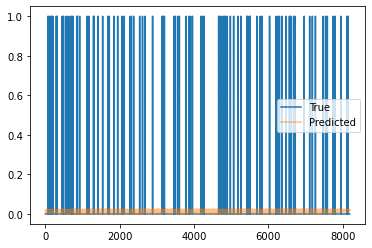

Validation Epoch: 15 [310/582 (53%)]	Loss: 0.044657	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 15 [320/582 (54%)]	Loss: 0.044615	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 15 [330/582 (56%)]	Loss: 0.041534	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 15 [340/582 (58%)]	Loss: 0.041478	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 15 [350/582 (60%)]	Loss: 0.046969	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 15 [360/582 (61%)]	Loss: 0.045310	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 15 [370/582 (63%)]	Loss: 0.044797	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 15 [380/582 (65%)]	Loss: 0.046162	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 15 [390/582 (67%)]	Loss: 0.042803	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 15 [400/582 (68%)]	Loss: 0.042017	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 15 [410/582 (70%)]	Loss: 0.047408	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 15 [420/582 (72%)]	Loss: 0.045052	Pr

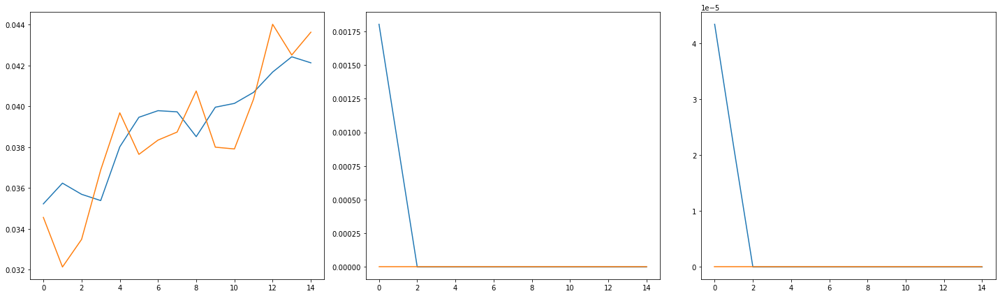

2220 582
Train Epoch: 16 [0/2220 (0%)]	Loss: 0.043097	Pres: 0.000000	F1 Score: 0.000000
89.0 -46016.0


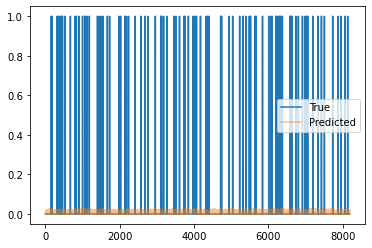

Train Epoch: 16 [10/2220 (0%)]	Loss: 0.038361	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [20/2220 (0%)]	Loss: 0.040423	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [30/2220 (1%)]	Loss: 0.038776	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [40/2220 (1%)]	Loss: 0.039870	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [50/2220 (2%)]	Loss: 0.040407	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [60/2220 (2%)]	Loss: 0.044294	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [70/2220 (3%)]	Loss: 0.039413	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [80/2220 (3%)]	Loss: 0.046337	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [90/2220 (4%)]	Loss: 0.038342	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [100/2220 (4%)]	Loss: 0.046363	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [110/2220 (4%)]	Loss: 0.039591	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [120/2220 (5%)]	Loss: 0.044735	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [130/2220 (5%)]	Loss:

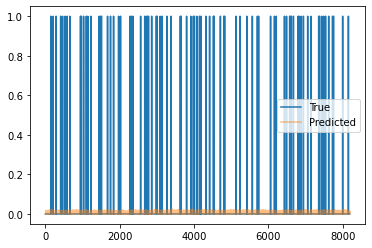

Train Epoch: 16 [310/2220 (13%)]	Loss: 0.041166	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [320/2220 (14%)]	Loss: 0.041425	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [330/2220 (14%)]	Loss: 0.041138	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [340/2220 (15%)]	Loss: 0.044632	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [350/2220 (15%)]	Loss: 0.043187	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [360/2220 (16%)]	Loss: 0.041435	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [370/2220 (16%)]	Loss: 0.044574	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [380/2220 (17%)]	Loss: 0.041220	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [390/2220 (17%)]	Loss: 0.047915	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [400/2220 (18%)]	Loss: 0.043422	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [410/2220 (18%)]	Loss: 0.045277	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [420/2220 (18%)]	Loss: 0.042936	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 

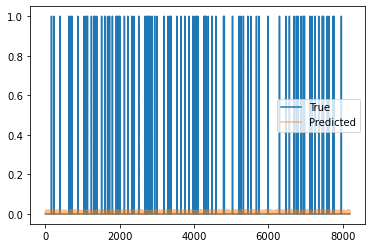

Train Epoch: 16 [610/2220 (27%)]	Loss: 0.040862	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [620/2220 (27%)]	Loss: 0.043774	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [630/2220 (28%)]	Loss: 0.044380	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [640/2220 (28%)]	Loss: 0.043481	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [650/2220 (29%)]	Loss: 0.036198	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [660/2220 (29%)]	Loss: 0.045497	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [670/2220 (30%)]	Loss: 0.042982	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [680/2220 (30%)]	Loss: 0.040450	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [690/2220 (31%)]	Loss: 0.042282	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [700/2220 (31%)]	Loss: 0.046432	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [710/2220 (31%)]	Loss: 0.039973	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [720/2220 (32%)]	Loss: 0.040804	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 

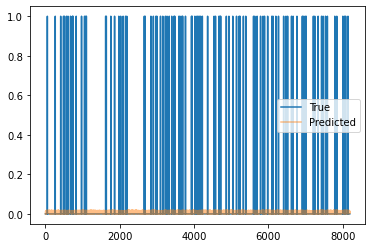

Train Epoch: 16 [910/2220 (40%)]	Loss: 0.040259	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [920/2220 (41%)]	Loss: 0.036090	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [930/2220 (41%)]	Loss: 0.038055	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [940/2220 (42%)]	Loss: 0.043512	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [950/2220 (42%)]	Loss: 0.042334	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [960/2220 (43%)]	Loss: 0.043112	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [970/2220 (43%)]	Loss: 0.041905	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [980/2220 (44%)]	Loss: 0.043912	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [990/2220 (44%)]	Loss: 0.040289	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1000/2220 (45%)]	Loss: 0.041624	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1010/2220 (45%)]	Loss: 0.050790	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1020/2220 (45%)]	Loss: 0.040470	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 

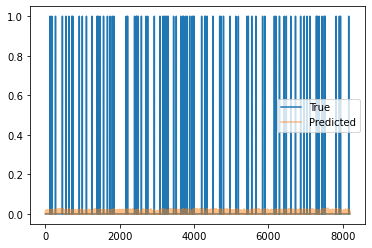

Train Epoch: 16 [1210/2220 (54%)]	Loss: 0.039920	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1220/2220 (54%)]	Loss: 0.042222	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1230/2220 (55%)]	Loss: 0.041540	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1240/2220 (55%)]	Loss: 0.042462	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1250/2220 (56%)]	Loss: 0.045386	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1260/2220 (56%)]	Loss: 0.037935	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1270/2220 (57%)]	Loss: 0.038262	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1280/2220 (57%)]	Loss: 0.043394	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1290/2220 (58%)]	Loss: 0.038896	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1300/2220 (58%)]	Loss: 0.042265	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1310/2220 (59%)]	Loss: 0.041835	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1320/2220 (59%)]	Loss: 0.043985	Pres: 0.000000	F1 Score: 0.000000
Trai

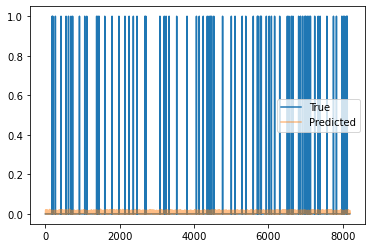

Train Epoch: 16 [1510/2220 (68%)]	Loss: 0.037714	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1520/2220 (68%)]	Loss: 0.045451	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1530/2220 (68%)]	Loss: 0.042891	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1540/2220 (69%)]	Loss: 0.040495	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1550/2220 (69%)]	Loss: 0.046710	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1560/2220 (70%)]	Loss: 0.046171	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1570/2220 (70%)]	Loss: 0.044106	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1580/2220 (71%)]	Loss: 0.043312	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1590/2220 (71%)]	Loss: 0.045426	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1600/2220 (72%)]	Loss: 0.044426	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1610/2220 (72%)]	Loss: 0.046253	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1620/2220 (72%)]	Loss: 0.039901	Pres: 0.000000	F1 Score: 0.000000
Trai

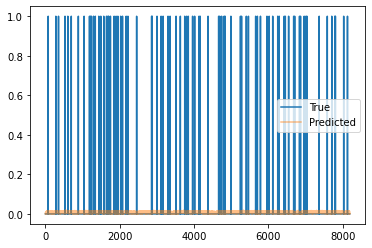

Train Epoch: 16 [1810/2220 (81%)]	Loss: 0.039710	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1820/2220 (81%)]	Loss: 0.040591	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1830/2220 (82%)]	Loss: 0.040168	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1840/2220 (82%)]	Loss: 0.047071	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1850/2220 (83%)]	Loss: 0.041481	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1860/2220 (83%)]	Loss: 0.046920	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1870/2220 (84%)]	Loss: 0.043559	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1880/2220 (84%)]	Loss: 0.046923	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1890/2220 (85%)]	Loss: 0.042033	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1900/2220 (85%)]	Loss: 0.042068	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1910/2220 (86%)]	Loss: 0.040925	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1920/2220 (86%)]	Loss: 0.039498	Pres: 0.000000	F1 Score: 0.000000
Trai

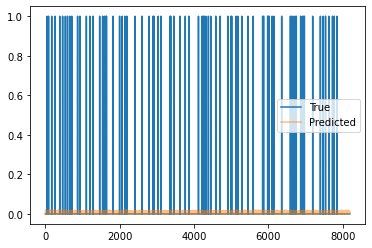

Train Epoch: 16 [2110/2220 (95%)]	Loss: 0.041778	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [2120/2220 (95%)]	Loss: 0.039697	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [2130/2220 (95%)]	Loss: 0.043657	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [2140/2220 (96%)]	Loss: 0.041604	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [2150/2220 (96%)]	Loss: 0.040177	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [2160/2220 (97%)]	Loss: 0.041710	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [2170/2220 (97%)]	Loss: 0.043692	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [2180/2220 (98%)]	Loss: 0.040322	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [2190/2220 (98%)]	Loss: 0.042759	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [2200/2220 (99%)]	Loss: 0.043661	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [2210/2220 (99%)]	Loss: 0.038667	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 16 [0/582 (0%)]	Loss: 0.038614	Pres: 0.000000	F1 Score: 0.000000


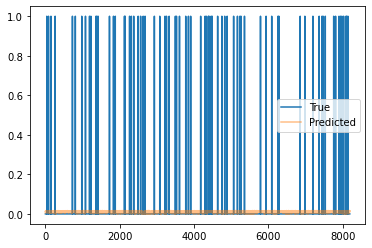

Validation Epoch: 16 [10/582 (1%)]	Loss: 0.046268	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 16 [20/582 (3%)]	Loss: 0.041463	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 16 [30/582 (5%)]	Loss: 0.040810	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 16 [40/582 (6%)]	Loss: 0.039601	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 16 [50/582 (8%)]	Loss: 0.045129	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 16 [60/582 (10%)]	Loss: 0.044430	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 16 [70/582 (12%)]	Loss: 0.043215	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 16 [80/582 (13%)]	Loss: 0.044078	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 16 [90/582 (15%)]	Loss: 0.042113	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 16 [100/582 (17%)]	Loss: 0.042095	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 16 [110/582 (18%)]	Loss: 0.041690	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 16 [120/582 (20%)]	Loss: 0.047313	Pres: 0.000000	F

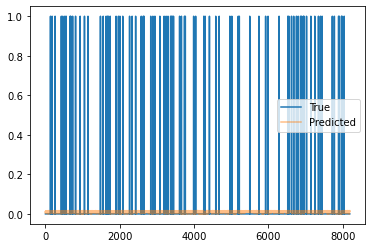

Validation Epoch: 16 [310/582 (53%)]	Loss: 0.044292	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 16 [320/582 (54%)]	Loss: 0.045436	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 16 [330/582 (56%)]	Loss: 0.043557	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 16 [340/582 (58%)]	Loss: 0.040273	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 16 [350/582 (60%)]	Loss: 0.045621	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 16 [360/582 (61%)]	Loss: 0.042247	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 16 [370/582 (63%)]	Loss: 0.037061	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 16 [380/582 (65%)]	Loss: 0.043584	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 16 [390/582 (67%)]	Loss: 0.041942	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 16 [400/582 (68%)]	Loss: 0.042927	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 16 [410/582 (70%)]	Loss: 0.039947	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 16 [420/582 (72%)]	Loss: 0.043655	Pr

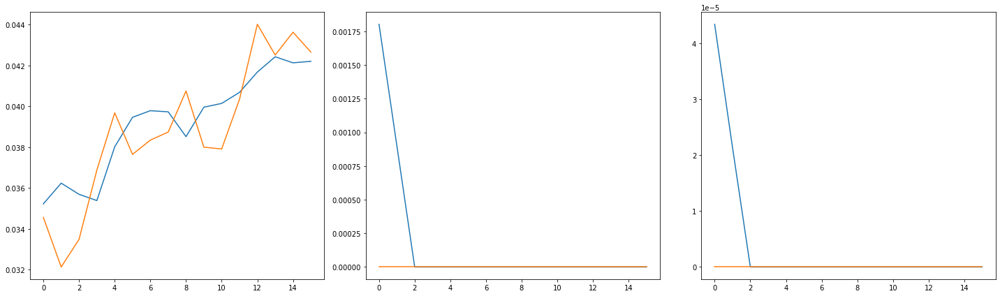

2220 582
Train Epoch: 17 [0/2220 (0%)]	Loss: 0.042281	Pres: 0.000000	F1 Score: 0.000000
82.0 -44704.0


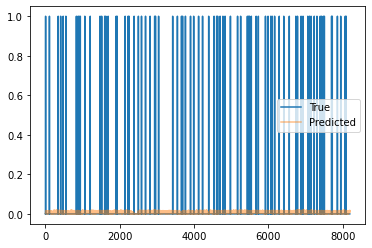

Train Epoch: 17 [10/2220 (0%)]	Loss: 0.040381	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [20/2220 (0%)]	Loss: 0.038877	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [30/2220 (1%)]	Loss: 0.040934	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [40/2220 (1%)]	Loss: 0.042669	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [50/2220 (2%)]	Loss: 0.038996	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [60/2220 (2%)]	Loss: 0.042439	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [70/2220 (3%)]	Loss: 0.041389	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [80/2220 (3%)]	Loss: 0.039471	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [90/2220 (4%)]	Loss: 0.040776	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [100/2220 (4%)]	Loss: 0.044589	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [110/2220 (4%)]	Loss: 0.042999	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [120/2220 (5%)]	Loss: 0.040293	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [130/2220 (5%)]	Loss:

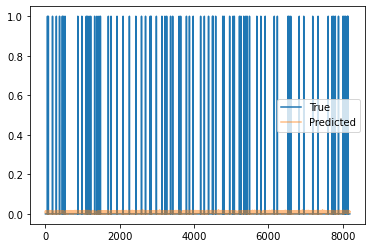

Train Epoch: 17 [310/2220 (13%)]	Loss: 0.043367	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [320/2220 (14%)]	Loss: 0.037221	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [330/2220 (14%)]	Loss: 0.043633	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [340/2220 (15%)]	Loss: 0.047298	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [350/2220 (15%)]	Loss: 0.044891	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [360/2220 (16%)]	Loss: 0.044482	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [370/2220 (16%)]	Loss: 0.042560	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [380/2220 (17%)]	Loss: 0.045532	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [390/2220 (17%)]	Loss: 0.042428	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [400/2220 (18%)]	Loss: 0.049055	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [410/2220 (18%)]	Loss: 0.047315	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [420/2220 (18%)]	Loss: 0.043566	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 

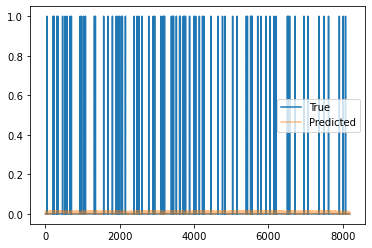

Train Epoch: 17 [610/2220 (27%)]	Loss: 0.044527	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [620/2220 (27%)]	Loss: 0.040080	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [630/2220 (28%)]	Loss: 0.044327	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [640/2220 (28%)]	Loss: 0.045291	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [650/2220 (29%)]	Loss: 0.042746	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [660/2220 (29%)]	Loss: 0.042478	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [670/2220 (30%)]	Loss: 0.040453	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [680/2220 (30%)]	Loss: 0.038131	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [690/2220 (31%)]	Loss: 0.044288	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [700/2220 (31%)]	Loss: 0.043973	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [710/2220 (31%)]	Loss: 0.043779	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [720/2220 (32%)]	Loss: 0.037720	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 

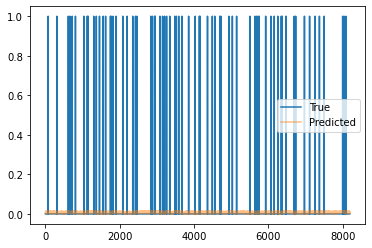

Train Epoch: 17 [910/2220 (40%)]	Loss: 0.043997	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [920/2220 (41%)]	Loss: 0.043650	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [930/2220 (41%)]	Loss: 0.041968	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [940/2220 (42%)]	Loss: 0.042166	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [950/2220 (42%)]	Loss: 0.040062	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [960/2220 (43%)]	Loss: 0.040713	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [970/2220 (43%)]	Loss: 0.045677	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [980/2220 (44%)]	Loss: 0.047243	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [990/2220 (44%)]	Loss: 0.036593	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1000/2220 (45%)]	Loss: 0.039780	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1010/2220 (45%)]	Loss: 0.046807	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1020/2220 (45%)]	Loss: 0.044017	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 

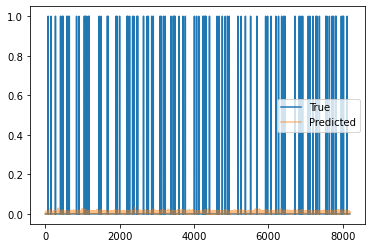

Train Epoch: 17 [1210/2220 (54%)]	Loss: 0.043390	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1220/2220 (54%)]	Loss: 0.042381	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1230/2220 (55%)]	Loss: 0.049976	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1240/2220 (55%)]	Loss: 0.044492	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1250/2220 (56%)]	Loss: 0.037246	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1260/2220 (56%)]	Loss: 0.043351	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1270/2220 (57%)]	Loss: 0.043558	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1280/2220 (57%)]	Loss: 0.044205	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1290/2220 (58%)]	Loss: 0.045493	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1300/2220 (58%)]	Loss: 0.048474	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1310/2220 (59%)]	Loss: 0.046383	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1320/2220 (59%)]	Loss: 0.047952	Pres: 0.000000	F1 Score: 0.000000
Trai

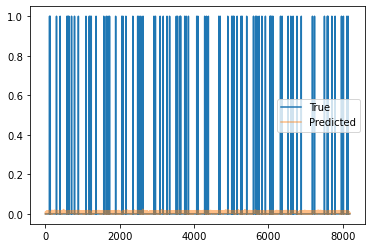

Train Epoch: 17 [1510/2220 (68%)]	Loss: 0.048436	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1520/2220 (68%)]	Loss: 0.039207	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1530/2220 (68%)]	Loss: 0.042530	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1540/2220 (69%)]	Loss: 0.043970	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1550/2220 (69%)]	Loss: 0.040920	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1560/2220 (70%)]	Loss: 0.045351	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1570/2220 (70%)]	Loss: 0.042515	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1580/2220 (71%)]	Loss: 0.040463	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1590/2220 (71%)]	Loss: 0.044618	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1600/2220 (72%)]	Loss: 0.047281	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1610/2220 (72%)]	Loss: 0.040169	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1620/2220 (72%)]	Loss: 0.042419	Pres: 0.000000	F1 Score: 0.000000
Trai

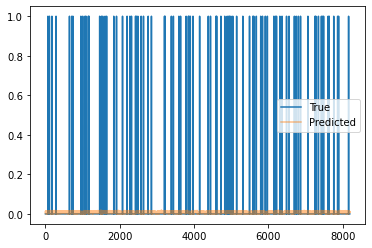

Train Epoch: 17 [1810/2220 (81%)]	Loss: 0.040070	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1820/2220 (81%)]	Loss: 0.043447	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1830/2220 (82%)]	Loss: 0.045396	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1840/2220 (82%)]	Loss: 0.036645	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1850/2220 (83%)]	Loss: 0.042750	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1860/2220 (83%)]	Loss: 0.041838	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1870/2220 (84%)]	Loss: 0.041962	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1880/2220 (84%)]	Loss: 0.041333	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1890/2220 (85%)]	Loss: 0.040104	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1900/2220 (85%)]	Loss: 0.044824	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1910/2220 (86%)]	Loss: 0.042773	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1920/2220 (86%)]	Loss: 0.043877	Pres: 0.000000	F1 Score: 0.000000
Trai

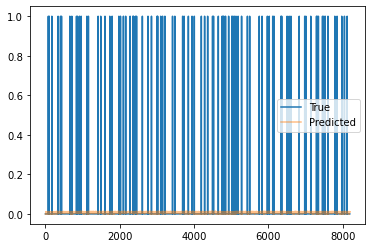

Train Epoch: 17 [2110/2220 (95%)]	Loss: 0.042584	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [2120/2220 (95%)]	Loss: 0.040228	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [2130/2220 (95%)]	Loss: 0.040063	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [2140/2220 (96%)]	Loss: 0.042735	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [2150/2220 (96%)]	Loss: 0.041988	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [2160/2220 (97%)]	Loss: 0.044305	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [2170/2220 (97%)]	Loss: 0.037267	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [2180/2220 (98%)]	Loss: 0.042000	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [2190/2220 (98%)]	Loss: 0.043926	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [2200/2220 (99%)]	Loss: 0.044907	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [2210/2220 (99%)]	Loss: 0.045957	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 17 [0/582 (0%)]	Loss: 0.040081	Pres: 0.000000	F1 Score: 0.000000


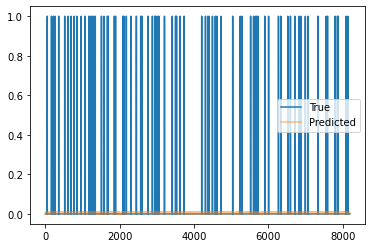

Validation Epoch: 17 [10/582 (1%)]	Loss: 0.048086	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 17 [20/582 (3%)]	Loss: 0.040632	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 17 [30/582 (5%)]	Loss: 0.041347	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 17 [40/582 (6%)]	Loss: 0.051511	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 17 [50/582 (8%)]	Loss: 0.041852	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 17 [60/582 (10%)]	Loss: 0.042933	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 17 [70/582 (12%)]	Loss: 0.040081	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 17 [80/582 (13%)]	Loss: 0.038212	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 17 [90/582 (15%)]	Loss: 0.046678	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 17 [100/582 (17%)]	Loss: 0.045025	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 17 [110/582 (18%)]	Loss: 0.044939	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 17 [120/582 (20%)]	Loss: 0.037786	Pres: 0.000000	F

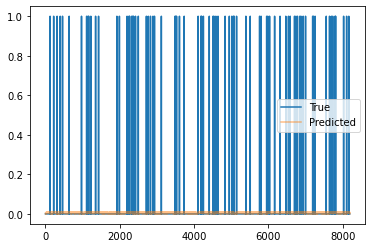

Validation Epoch: 17 [310/582 (53%)]	Loss: 0.044810	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 17 [320/582 (54%)]	Loss: 0.035357	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 17 [330/582 (56%)]	Loss: 0.050618	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 17 [340/582 (58%)]	Loss: 0.044201	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 17 [350/582 (60%)]	Loss: 0.038982	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 17 [360/582 (61%)]	Loss: 0.042589	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 17 [370/582 (63%)]	Loss: 0.040644	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 17 [380/582 (65%)]	Loss: 0.044640	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 17 [390/582 (67%)]	Loss: 0.045016	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 17 [400/582 (68%)]	Loss: 0.041150	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 17 [410/582 (70%)]	Loss: 0.043598	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 17 [420/582 (72%)]	Loss: 0.042171	Pr

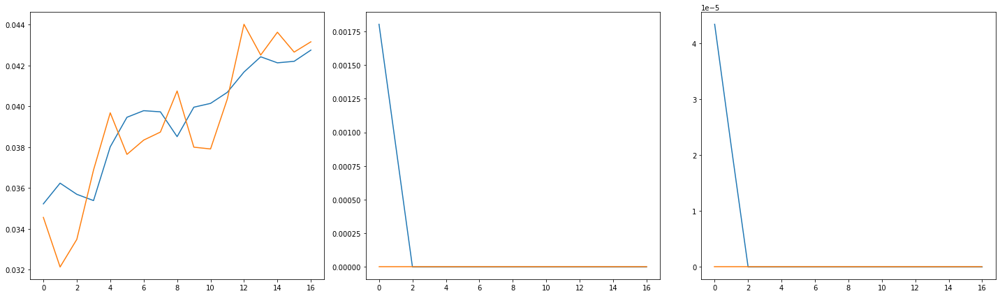

2220 582
Train Epoch: 18 [0/2220 (0%)]	Loss: 0.043536	Pres: 0.000000	F1 Score: 0.000000
85.0 -42240.0


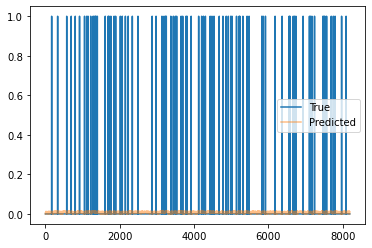

Train Epoch: 18 [10/2220 (0%)]	Loss: 0.044355	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [20/2220 (0%)]	Loss: 0.041637	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [30/2220 (1%)]	Loss: 0.045832	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [40/2220 (1%)]	Loss: 0.047267	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [50/2220 (2%)]	Loss: 0.041236	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [60/2220 (2%)]	Loss: 0.043920	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [70/2220 (3%)]	Loss: 0.043021	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [80/2220 (3%)]	Loss: 0.044443	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [90/2220 (4%)]	Loss: 0.041746	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [100/2220 (4%)]	Loss: 0.037831	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [110/2220 (4%)]	Loss: 0.041685	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [120/2220 (5%)]	Loss: 0.042944	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [130/2220 (5%)]	Loss:

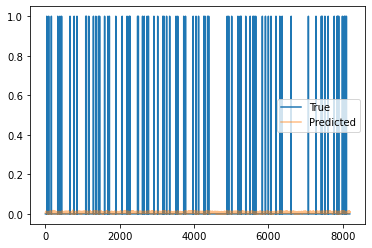

Train Epoch: 18 [310/2220 (13%)]	Loss: 0.043731	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [320/2220 (14%)]	Loss: 0.045823	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [330/2220 (14%)]	Loss: 0.036884	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [340/2220 (15%)]	Loss: 0.040869	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [350/2220 (15%)]	Loss: 0.043691	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [360/2220 (16%)]	Loss: 0.040901	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [370/2220 (16%)]	Loss: 0.042756	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [380/2220 (17%)]	Loss: 0.046336	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [390/2220 (17%)]	Loss: 0.045146	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [400/2220 (18%)]	Loss: 0.045958	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [410/2220 (18%)]	Loss: 0.042083	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [420/2220 (18%)]	Loss: 0.040491	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 

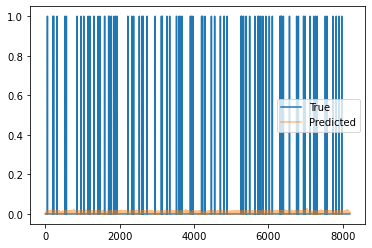

Train Epoch: 18 [610/2220 (27%)]	Loss: 0.045108	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [620/2220 (27%)]	Loss: 0.042050	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [630/2220 (28%)]	Loss: 0.045121	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [640/2220 (28%)]	Loss: 0.040783	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [650/2220 (29%)]	Loss: 0.045948	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [660/2220 (29%)]	Loss: 0.044123	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [670/2220 (30%)]	Loss: 0.041599	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [680/2220 (30%)]	Loss: 0.042041	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [690/2220 (31%)]	Loss: 0.045369	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [700/2220 (31%)]	Loss: 0.044157	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [710/2220 (31%)]	Loss: 0.042902	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [720/2220 (32%)]	Loss: 0.040955	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 

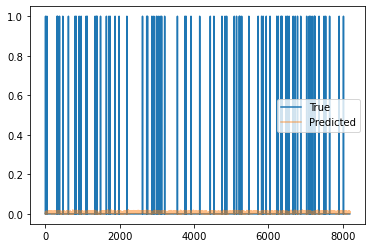

Train Epoch: 18 [910/2220 (40%)]	Loss: 0.045502	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [920/2220 (41%)]	Loss: 0.043569	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [930/2220 (41%)]	Loss: 0.043611	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [940/2220 (42%)]	Loss: 0.046072	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [950/2220 (42%)]	Loss: 0.044899	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [960/2220 (43%)]	Loss: 0.042373	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [970/2220 (43%)]	Loss: 0.043793	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [980/2220 (44%)]	Loss: 0.043230	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [990/2220 (44%)]	Loss: 0.041682	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1000/2220 (45%)]	Loss: 0.041813	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1010/2220 (45%)]	Loss: 0.043450	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1020/2220 (45%)]	Loss: 0.042325	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 

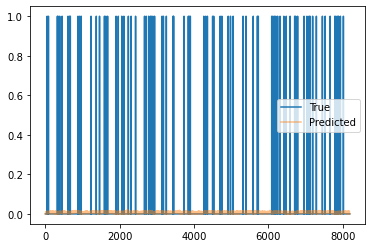

Train Epoch: 18 [1210/2220 (54%)]	Loss: 0.037818	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1220/2220 (54%)]	Loss: 0.042117	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1230/2220 (55%)]	Loss: 0.042535	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1240/2220 (55%)]	Loss: 0.041435	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1250/2220 (56%)]	Loss: 0.043043	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1260/2220 (56%)]	Loss: 0.039038	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1270/2220 (57%)]	Loss: 0.040691	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1280/2220 (57%)]	Loss: 0.039709	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1290/2220 (58%)]	Loss: 0.044950	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1300/2220 (58%)]	Loss: 0.046742	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1310/2220 (59%)]	Loss: 0.041767	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1320/2220 (59%)]	Loss: 0.044236	Pres: 0.000000	F1 Score: 0.000000
Trai

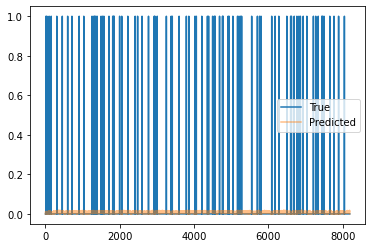

Train Epoch: 18 [1510/2220 (68%)]	Loss: 0.047350	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1520/2220 (68%)]	Loss: 0.046088	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1530/2220 (68%)]	Loss: 0.041667	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1540/2220 (69%)]	Loss: 0.043428	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1550/2220 (69%)]	Loss: 0.044985	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1560/2220 (70%)]	Loss: 0.038201	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1570/2220 (70%)]	Loss: 0.044268	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1580/2220 (71%)]	Loss: 0.044537	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1590/2220 (71%)]	Loss: 0.043464	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1600/2220 (72%)]	Loss: 0.040947	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1610/2220 (72%)]	Loss: 0.045576	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1620/2220 (72%)]	Loss: 0.038860	Pres: 0.000000	F1 Score: 0.000000
Trai

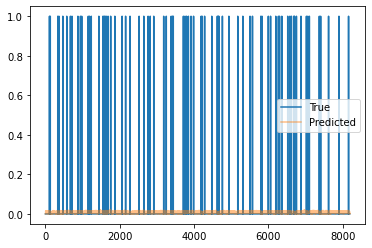

Train Epoch: 18 [1810/2220 (81%)]	Loss: 0.041839	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1820/2220 (81%)]	Loss: 0.043701	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1830/2220 (82%)]	Loss: 0.038495	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1840/2220 (82%)]	Loss: 0.042091	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1850/2220 (83%)]	Loss: 0.045893	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1860/2220 (83%)]	Loss: 0.043773	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1870/2220 (84%)]	Loss: 0.047094	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1880/2220 (84%)]	Loss: 0.044962	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1890/2220 (85%)]	Loss: 0.046121	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1900/2220 (85%)]	Loss: 0.041949	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1910/2220 (86%)]	Loss: 0.040007	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1920/2220 (86%)]	Loss: 0.042859	Pres: 0.000000	F1 Score: 0.000000
Trai

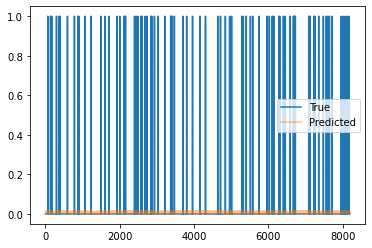

Train Epoch: 18 [2110/2220 (95%)]	Loss: 0.035186	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [2120/2220 (95%)]	Loss: 0.041669	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [2130/2220 (95%)]	Loss: 0.041229	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [2140/2220 (96%)]	Loss: 0.038741	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [2150/2220 (96%)]	Loss: 0.042103	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [2160/2220 (97%)]	Loss: 0.041138	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [2170/2220 (97%)]	Loss: 0.041653	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [2180/2220 (98%)]	Loss: 0.041062	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [2190/2220 (98%)]	Loss: 0.043237	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [2200/2220 (99%)]	Loss: 0.050519	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [2210/2220 (99%)]	Loss: 0.039127	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 18 [0/582 (0%)]	Loss: 0.042756	Pres: 0.000000	F1 Score: 0.000000


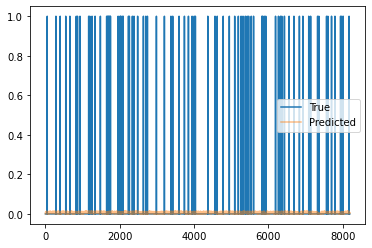

Validation Epoch: 18 [10/582 (1%)]	Loss: 0.041649	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 18 [20/582 (3%)]	Loss: 0.043225	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 18 [30/582 (5%)]	Loss: 0.042904	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 18 [40/582 (6%)]	Loss: 0.043921	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 18 [50/582 (8%)]	Loss: 0.043543	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 18 [60/582 (10%)]	Loss: 0.042468	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 18 [70/582 (12%)]	Loss: 0.041017	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 18 [80/582 (13%)]	Loss: 0.037143	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 18 [90/582 (15%)]	Loss: 0.044169	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 18 [100/582 (17%)]	Loss: 0.041674	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 18 [110/582 (18%)]	Loss: 0.041632	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 18 [120/582 (20%)]	Loss: 0.043280	Pres: 0.000000	F

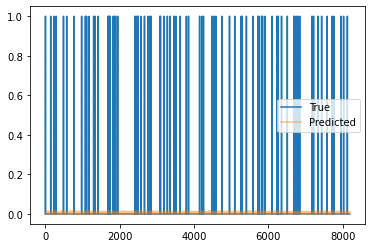

Validation Epoch: 18 [310/582 (53%)]	Loss: 0.037729	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 18 [320/582 (54%)]	Loss: 0.040766	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 18 [330/582 (56%)]	Loss: 0.042855	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 18 [340/582 (58%)]	Loss: 0.040439	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 18 [350/582 (60%)]	Loss: 0.041814	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 18 [360/582 (61%)]	Loss: 0.043769	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 18 [370/582 (63%)]	Loss: 0.040540	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 18 [380/582 (65%)]	Loss: 0.043912	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 18 [390/582 (67%)]	Loss: 0.037118	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 18 [400/582 (68%)]	Loss: 0.036317	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 18 [410/582 (70%)]	Loss: 0.041855	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 18 [420/582 (72%)]	Loss: 0.043854	Pr

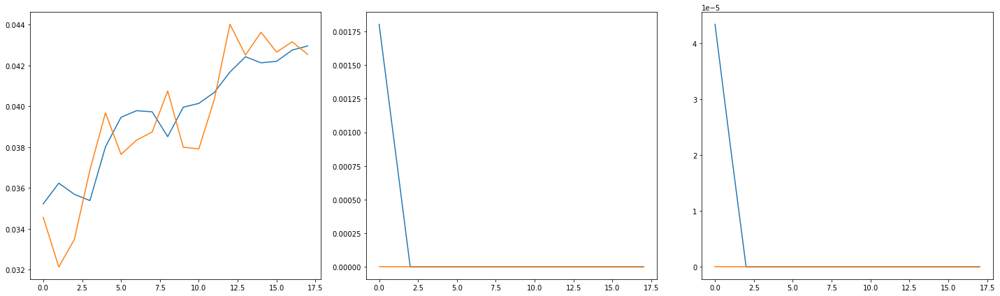

2220 582
Train Epoch: 19 [0/2220 (0%)]	Loss: 0.035477	Pres: 0.000000	F1 Score: 0.000000
66.0 -43840.0


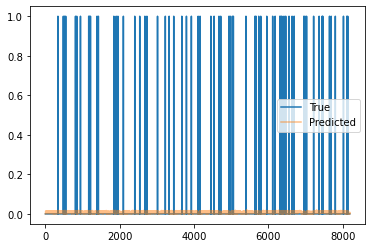

Train Epoch: 19 [10/2220 (0%)]	Loss: 0.036732	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [20/2220 (0%)]	Loss: 0.044352	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [30/2220 (1%)]	Loss: 0.043019	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [40/2220 (1%)]	Loss: 0.040159	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [50/2220 (2%)]	Loss: 0.040563	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [60/2220 (2%)]	Loss: 0.039350	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [70/2220 (3%)]	Loss: 0.042108	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [80/2220 (3%)]	Loss: 0.044206	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [90/2220 (4%)]	Loss: 0.044940	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [100/2220 (4%)]	Loss: 0.042189	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [110/2220 (4%)]	Loss: 0.044978	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [120/2220 (5%)]	Loss: 0.041650	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [130/2220 (5%)]	Loss:

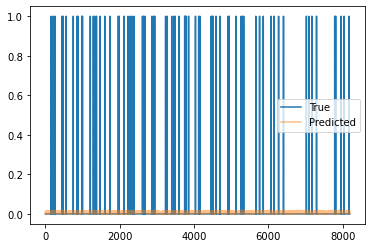

Train Epoch: 19 [310/2220 (13%)]	Loss: 0.043188	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [320/2220 (14%)]	Loss: 0.037497	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [330/2220 (14%)]	Loss: 0.038573	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [340/2220 (15%)]	Loss: 0.043355	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [350/2220 (15%)]	Loss: 0.045216	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [360/2220 (16%)]	Loss: 0.043470	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [370/2220 (16%)]	Loss: 0.041208	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [380/2220 (17%)]	Loss: 0.044101	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [390/2220 (17%)]	Loss: 0.041936	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [400/2220 (18%)]	Loss: 0.041729	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [410/2220 (18%)]	Loss: 0.042914	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [420/2220 (18%)]	Loss: 0.039587	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 

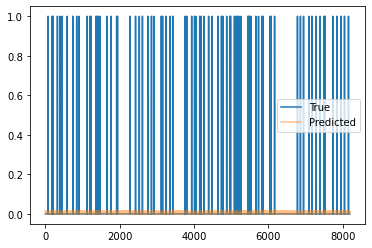

Train Epoch: 19 [610/2220 (27%)]	Loss: 0.040305	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [620/2220 (27%)]	Loss: 0.042570	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [630/2220 (28%)]	Loss: 0.038183	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [640/2220 (28%)]	Loss: 0.047463	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [650/2220 (29%)]	Loss: 0.049045	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [660/2220 (29%)]	Loss: 0.043489	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [670/2220 (30%)]	Loss: 0.042749	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [680/2220 (30%)]	Loss: 0.043868	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [690/2220 (31%)]	Loss: 0.046136	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [700/2220 (31%)]	Loss: 0.041237	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [710/2220 (31%)]	Loss: 0.042468	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [720/2220 (32%)]	Loss: 0.041867	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 

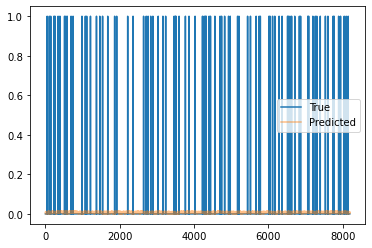

Train Epoch: 19 [910/2220 (40%)]	Loss: 0.044100	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [920/2220 (41%)]	Loss: 0.043029	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [930/2220 (41%)]	Loss: 0.042818	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [940/2220 (42%)]	Loss: 0.037570	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [950/2220 (42%)]	Loss: 0.042475	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [960/2220 (43%)]	Loss: 0.041216	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [970/2220 (43%)]	Loss: 0.040893	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [980/2220 (44%)]	Loss: 0.042242	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [990/2220 (44%)]	Loss: 0.041713	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1000/2220 (45%)]	Loss: 0.039935	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1010/2220 (45%)]	Loss: 0.045074	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1020/2220 (45%)]	Loss: 0.041444	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 

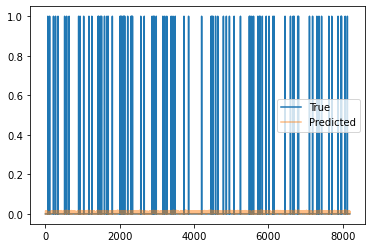

Train Epoch: 19 [1210/2220 (54%)]	Loss: 0.042051	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1220/2220 (54%)]	Loss: 0.043278	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1230/2220 (55%)]	Loss: 0.037531	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1240/2220 (55%)]	Loss: 0.043496	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1250/2220 (56%)]	Loss: 0.042916	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1260/2220 (56%)]	Loss: 0.043371	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1270/2220 (57%)]	Loss: 0.044309	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1280/2220 (57%)]	Loss: 0.043968	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1290/2220 (58%)]	Loss: 0.039860	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1300/2220 (58%)]	Loss: 0.044048	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1310/2220 (59%)]	Loss: 0.041358	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1320/2220 (59%)]	Loss: 0.039256	Pres: 0.000000	F1 Score: 0.000000
Trai

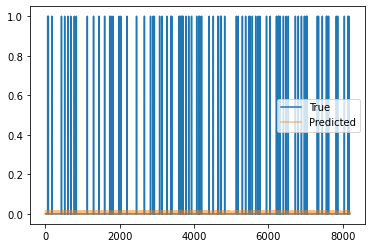

Train Epoch: 19 [1510/2220 (68%)]	Loss: 0.041525	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1520/2220 (68%)]	Loss: 0.039502	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1530/2220 (68%)]	Loss: 0.041470	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1540/2220 (69%)]	Loss: 0.044770	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1550/2220 (69%)]	Loss: 0.046244	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1560/2220 (70%)]	Loss: 0.038955	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1570/2220 (70%)]	Loss: 0.047054	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1580/2220 (71%)]	Loss: 0.040418	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1590/2220 (71%)]	Loss: 0.046678	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1600/2220 (72%)]	Loss: 0.040516	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1610/2220 (72%)]	Loss: 0.045179	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1620/2220 (72%)]	Loss: 0.040700	Pres: 0.000000	F1 Score: 0.000000
Trai

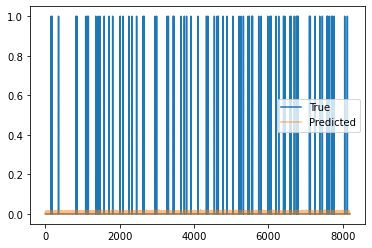

Train Epoch: 19 [1810/2220 (81%)]	Loss: 0.044038	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1820/2220 (81%)]	Loss: 0.042732	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1830/2220 (82%)]	Loss: 0.042238	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1840/2220 (82%)]	Loss: 0.047636	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1850/2220 (83%)]	Loss: 0.044376	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1860/2220 (83%)]	Loss: 0.043540	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1870/2220 (84%)]	Loss: 0.048371	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1880/2220 (84%)]	Loss: 0.043354	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1890/2220 (85%)]	Loss: 0.046491	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1900/2220 (85%)]	Loss: 0.041240	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1910/2220 (86%)]	Loss: 0.045091	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1920/2220 (86%)]	Loss: 0.044348	Pres: 0.000000	F1 Score: 0.000000
Trai

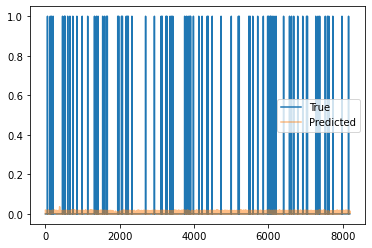

Train Epoch: 19 [2110/2220 (95%)]	Loss: 0.037244	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [2120/2220 (95%)]	Loss: 0.040982	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [2130/2220 (95%)]	Loss: 0.042418	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [2140/2220 (96%)]	Loss: 0.040999	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [2150/2220 (96%)]	Loss: 0.043890	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [2160/2220 (97%)]	Loss: 0.044783	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [2170/2220 (97%)]	Loss: 0.041239	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [2180/2220 (98%)]	Loss: 0.042919	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [2190/2220 (98%)]	Loss: 0.038637	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [2200/2220 (99%)]	Loss: 0.041774	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [2210/2220 (99%)]	Loss: 0.043921	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 19 [0/582 (0%)]	Loss: 0.039381	Pres: 0.000000	F1 Score: 0.000000


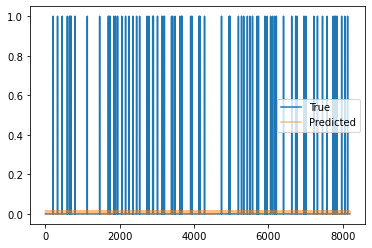

Validation Epoch: 19 [10/582 (1%)]	Loss: 0.044394	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 19 [20/582 (3%)]	Loss: 0.046892	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 19 [30/582 (5%)]	Loss: 0.043402	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 19 [40/582 (6%)]	Loss: 0.042577	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 19 [50/582 (8%)]	Loss: 0.041316	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 19 [60/582 (10%)]	Loss: 0.042115	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 19 [70/582 (12%)]	Loss: 0.039785	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 19 [80/582 (13%)]	Loss: 0.046747	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 19 [90/582 (15%)]	Loss: 0.041060	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 19 [100/582 (17%)]	Loss: 0.049323	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 19 [110/582 (18%)]	Loss: 0.042554	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 19 [120/582 (20%)]	Loss: 0.045827	Pres: 0.000000	F

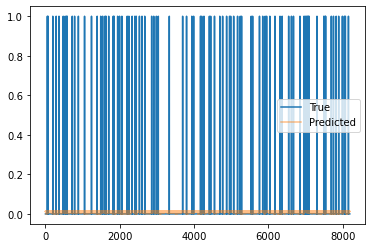

Validation Epoch: 19 [310/582 (53%)]	Loss: 0.041138	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 19 [320/582 (54%)]	Loss: 0.049833	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 19 [330/582 (56%)]	Loss: 0.047377	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 19 [340/582 (58%)]	Loss: 0.043410	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 19 [350/582 (60%)]	Loss: 0.044350	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 19 [360/582 (61%)]	Loss: 0.042617	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 19 [370/582 (63%)]	Loss: 0.044894	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 19 [380/582 (65%)]	Loss: 0.043231	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 19 [390/582 (67%)]	Loss: 0.044139	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 19 [400/582 (68%)]	Loss: 0.046298	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 19 [410/582 (70%)]	Loss: 0.040038	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 19 [420/582 (72%)]	Loss: 0.040426	Pr

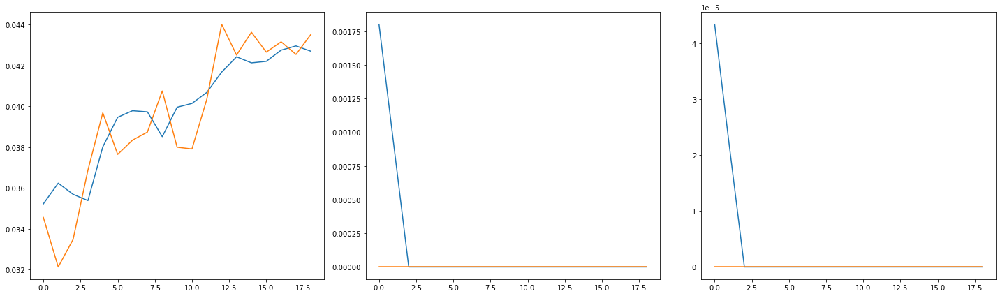

In [13]:
# 0.2 ids, 2048 dist, average='binary'
trainer.train(debug=False)

began training
2220 582
Train Epoch: 0 [0/2220 (0%)]	Loss: 0.712257	Pres: 0.013794	F1 Score: 0.027213
113.0 357.0


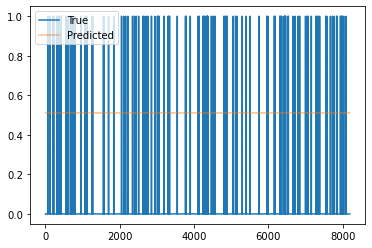

Train Epoch: 0 [10/2220 (0%)]	Loss: 0.717936	Pres: 0.015082	F1 Score: 0.029324
Train Epoch: 0 [20/2220 (0%)]	Loss: 0.557664	Pres: 0.016749	F1 Score: 0.031432
Train Epoch: 0 [30/2220 (1%)]	Loss: 0.431501	Pres: 0.018568	F1 Score: 0.029474
Train Epoch: 0 [40/2220 (1%)]	Loss: 0.341458	Pres: 0.007634	F1 Score: 0.008333
Train Epoch: 0 [50/2220 (2%)]	Loss: 0.275021	Pres: 0.020000	F1 Score: 0.011696
Train Epoch: 0 [60/2220 (2%)]	Loss: 0.223560	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [70/2220 (3%)]	Loss: 0.194124	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [80/2220 (3%)]	Loss: 0.164475	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [90/2220 (4%)]	Loss: 0.140597	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [100/2220 (4%)]	Loss: 0.133026	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [110/2220 (4%)]	Loss: 0.111740	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [120/2220 (5%)]	Loss: 0.102050	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [130/2220 (5%)]	Loss: 0.095416	Pre

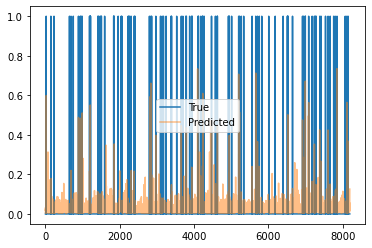

Train Epoch: 0 [310/2220 (13%)]	Loss: 0.043721	Pres: 0.857143	F1 Score: 0.305085
Train Epoch: 0 [320/2220 (14%)]	Loss: 0.044383	Pres: 0.648649	F1 Score: 0.372093
Train Epoch: 0 [330/2220 (14%)]	Loss: 0.040391	Pres: 0.923077	F1 Score: 0.393443
Train Epoch: 0 [340/2220 (15%)]	Loss: 0.044554	Pres: 0.705882	F1 Score: 0.200000
Train Epoch: 0 [350/2220 (15%)]	Loss: 0.039995	Pres: 0.837838	F1 Score: 0.462687
Train Epoch: 0 [360/2220 (16%)]	Loss: 0.038617	Pres: 0.821429	F1 Score: 0.547619
Train Epoch: 0 [370/2220 (16%)]	Loss: 0.034590	Pres: 0.914286	F1 Score: 0.503937
Train Epoch: 0 [380/2220 (17%)]	Loss: 0.036545	Pres: 0.757576	F1 Score: 0.373134
Train Epoch: 0 [390/2220 (17%)]	Loss: 0.037110	Pres: 0.833333	F1 Score: 0.333333
Train Epoch: 0 [400/2220 (18%)]	Loss: 0.035926	Pres: 0.842105	F1 Score: 0.460432
Train Epoch: 0 [410/2220 (18%)]	Loss: 0.033925	Pres: 0.805556	F1 Score: 0.432836
Train Epoch: 0 [420/2220 (18%)]	Loss: 0.034720	Pres: 0.793103	F1 Score: 0.338235
Train Epoch: 0 [430/2220 (19

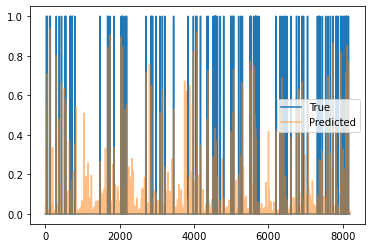

Train Epoch: 0 [610/2220 (27%)]	Loss: 0.025687	Pres: 0.806452	F1 Score: 0.373134
Train Epoch: 0 [620/2220 (27%)]	Loss: 0.027545	Pres: 0.809524	F1 Score: 0.456376
Train Epoch: 0 [630/2220 (28%)]	Loss: 0.025448	Pres: 0.693878	F1 Score: 0.511278
Train Epoch: 0 [640/2220 (28%)]	Loss: 0.022119	Pres: 0.812500	F1 Score: 0.619048
Train Epoch: 0 [650/2220 (29%)]	Loss: 0.024526	Pres: 0.729167	F1 Score: 0.507246
Train Epoch: 0 [660/2220 (29%)]	Loss: 0.024102	Pres: 0.877551	F1 Score: 0.544304
Train Epoch: 0 [670/2220 (30%)]	Loss: 0.022252	Pres: 0.928571	F1 Score: 0.553191
Train Epoch: 0 [680/2220 (30%)]	Loss: 0.022296	Pres: 0.720588	F1 Score: 0.604938
Train Epoch: 0 [690/2220 (31%)]	Loss: 0.026242	Pres: 0.703704	F1 Score: 0.487179
Train Epoch: 0 [700/2220 (31%)]	Loss: 0.024628	Pres: 0.740000	F1 Score: 0.465409
Train Epoch: 0 [710/2220 (31%)]	Loss: 0.024789	Pres: 0.774194	F1 Score: 0.536313
Train Epoch: 0 [720/2220 (32%)]	Loss: 0.023990	Pres: 0.781250	F1 Score: 0.406504
Train Epoch: 0 [730/2220 (32

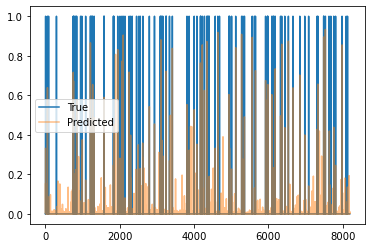

Train Epoch: 0 [910/2220 (40%)]	Loss: 0.018467	Pres: 0.870968	F1 Score: 0.654545
Train Epoch: 0 [920/2220 (41%)]	Loss: 0.016748	Pres: 0.775862	F1 Score: 0.616438
Train Epoch: 0 [930/2220 (41%)]	Loss: 0.017199	Pres: 0.882353	F1 Score: 0.647482
Train Epoch: 0 [940/2220 (42%)]	Loss: 0.018669	Pres: 0.910714	F1 Score: 0.618182
Train Epoch: 0 [950/2220 (42%)]	Loss: 0.019752	Pres: 0.890625	F1 Score: 0.633333
Train Epoch: 0 [960/2220 (43%)]	Loss: 0.016126	Pres: 0.780822	F1 Score: 0.703704
Train Epoch: 0 [970/2220 (43%)]	Loss: 0.020235	Pres: 0.761905	F1 Score: 0.663212
Train Epoch: 0 [980/2220 (44%)]	Loss: 0.018003	Pres: 0.787879	F1 Score: 0.650000
Train Epoch: 0 [990/2220 (44%)]	Loss: 0.019696	Pres: 0.752688	F1 Score: 0.686275
Train Epoch: 0 [1000/2220 (45%)]	Loss: 0.019259	Pres: 0.933333	F1 Score: 0.615385
Train Epoch: 0 [1010/2220 (45%)]	Loss: 0.015741	Pres: 0.808824	F1 Score: 0.714286
Train Epoch: 0 [1020/2220 (45%)]	Loss: 0.016220	Pres: 0.810811	F1 Score: 0.722892
Train Epoch: 0 [1030/2220

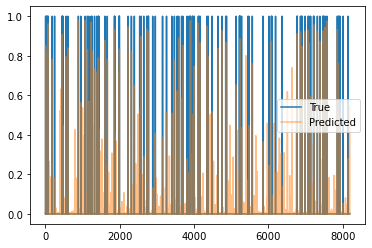

Train Epoch: 0 [1210/2220 (54%)]	Loss: 0.019281	Pres: 0.829268	F1 Score: 0.693878
Train Epoch: 0 [1220/2220 (54%)]	Loss: 0.016328	Pres: 0.812500	F1 Score: 0.641975
Train Epoch: 0 [1230/2220 (55%)]	Loss: 0.014065	Pres: 0.736842	F1 Score: 0.744681
Train Epoch: 0 [1240/2220 (55%)]	Loss: 0.015277	Pres: 0.763158	F1 Score: 0.703030
Train Epoch: 0 [1250/2220 (56%)]	Loss: 0.014705	Pres: 0.838710	F1 Score: 0.688742
Train Epoch: 0 [1260/2220 (56%)]	Loss: 0.020295	Pres: 0.761905	F1 Score: 0.659794
Train Epoch: 0 [1270/2220 (57%)]	Loss: 0.015488	Pres: 0.826667	F1 Score: 0.733728
Train Epoch: 0 [1280/2220 (57%)]	Loss: 0.018484	Pres: 0.840000	F1 Score: 0.684783
Train Epoch: 0 [1290/2220 (58%)]	Loss: 0.015369	Pres: 0.839080	F1 Score: 0.730000
Train Epoch: 0 [1300/2220 (58%)]	Loss: 0.012713	Pres: 0.937500	F1 Score: 0.785340
Train Epoch: 0 [1310/2220 (59%)]	Loss: 0.014747	Pres: 0.793103	F1 Score: 0.737968
Train Epoch: 0 [1320/2220 (59%)]	Loss: 0.015645	Pres: 0.800000	F1 Score: 0.780488
Train Epoch: 0 [

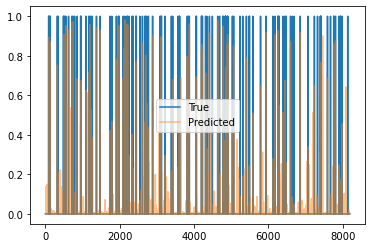

Train Epoch: 0 [1510/2220 (68%)]	Loss: 0.014971	Pres: 0.857143	F1 Score: 0.730964
Train Epoch: 0 [1520/2220 (68%)]	Loss: 0.013944	Pres: 0.839080	F1 Score: 0.752577
Train Epoch: 0 [1530/2220 (68%)]	Loss: 0.013983	Pres: 0.857143	F1 Score: 0.710059
Train Epoch: 0 [1540/2220 (69%)]	Loss: 0.013632	Pres: 0.863636	F1 Score: 0.712500
Train Epoch: 0 [1550/2220 (69%)]	Loss: 0.015433	Pres: 0.845070	F1 Score: 0.685714
Train Epoch: 0 [1560/2220 (70%)]	Loss: 0.015599	Pres: 0.878049	F1 Score: 0.746114
Train Epoch: 0 [1570/2220 (70%)]	Loss: 0.016235	Pres: 0.888889	F1 Score: 0.707182
Train Epoch: 0 [1580/2220 (71%)]	Loss: 0.017154	Pres: 0.840000	F1 Score: 0.677419
Train Epoch: 0 [1590/2220 (71%)]	Loss: 0.014312	Pres: 0.904110	F1 Score: 0.721311
Train Epoch: 0 [1600/2220 (72%)]	Loss: 0.014994	Pres: 0.873563	F1 Score: 0.752475
Train Epoch: 0 [1610/2220 (72%)]	Loss: 0.016995	Pres: 0.824742	F1 Score: 0.747664
Train Epoch: 0 [1620/2220 (72%)]	Loss: 0.012201	Pres: 0.881579	F1 Score: 0.812121
Train Epoch: 0 [

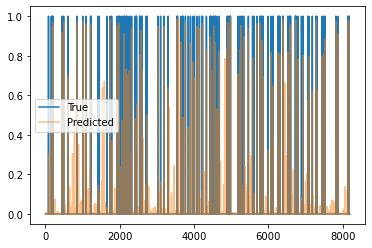

Train Epoch: 0 [1810/2220 (81%)]	Loss: 0.011909	Pres: 0.879518	F1 Score: 0.797814
Train Epoch: 0 [1820/2220 (81%)]	Loss: 0.012325	Pres: 0.891304	F1 Score: 0.792271
Train Epoch: 0 [1830/2220 (82%)]	Loss: 0.017458	Pres: 0.805195	F1 Score: 0.645833
Train Epoch: 0 [1840/2220 (82%)]	Loss: 0.012646	Pres: 0.829545	F1 Score: 0.764398
Train Epoch: 0 [1850/2220 (83%)]	Loss: 0.014323	Pres: 0.826923	F1 Score: 0.785388
Train Epoch: 0 [1860/2220 (83%)]	Loss: 0.010252	Pres: 0.878378	F1 Score: 0.787879
Train Epoch: 0 [1870/2220 (84%)]	Loss: 0.012563	Pres: 0.827957	F1 Score: 0.781726
Train Epoch: 0 [1880/2220 (84%)]	Loss: 0.016020	Pres: 0.900000	F1 Score: 0.775862
Train Epoch: 0 [1890/2220 (85%)]	Loss: 0.015036	Pres: 0.957143	F1 Score: 0.728261
Train Epoch: 0 [1900/2220 (85%)]	Loss: 0.015692	Pres: 0.902439	F1 Score: 0.736318
Train Epoch: 0 [1910/2220 (86%)]	Loss: 0.012965	Pres: 0.810811	F1 Score: 0.736196
Train Epoch: 0 [1920/2220 (86%)]	Loss: 0.011012	Pres: 0.817073	F1 Score: 0.792899
Train Epoch: 0 [

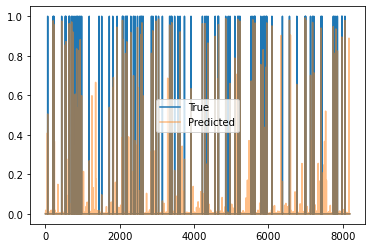

Train Epoch: 0 [2110/2220 (95%)]	Loss: 0.012403	Pres: 0.844444	F1 Score: 0.771574
Train Epoch: 0 [2120/2220 (95%)]	Loss: 0.009604	Pres: 0.879518	F1 Score: 0.839080
Train Epoch: 0 [2130/2220 (95%)]	Loss: 0.011668	Pres: 0.861702	F1 Score: 0.790244
Train Epoch: 0 [2140/2220 (96%)]	Loss: 0.011943	Pres: 0.843373	F1 Score: 0.765027
Train Epoch: 0 [2150/2220 (96%)]	Loss: 0.012938	Pres: 0.895833	F1 Score: 0.819048
Train Epoch: 0 [2160/2220 (97%)]	Loss: 0.010687	Pres: 0.802469	F1 Score: 0.755814
Train Epoch: 0 [2170/2220 (97%)]	Loss: 0.010250	Pres: 0.918605	F1 Score: 0.822917
Train Epoch: 0 [2180/2220 (98%)]	Loss: 0.014434	Pres: 0.821782	F1 Score: 0.757991
Train Epoch: 0 [2190/2220 (98%)]	Loss: 0.012443	Pres: 0.818182	F1 Score: 0.765957
Train Epoch: 0 [2200/2220 (99%)]	Loss: 0.008835	Pres: 0.841463	F1 Score: 0.807018
Train Epoch: 0 [2210/2220 (99%)]	Loss: 0.011144	Pres: 0.810526	F1 Score: 0.823529
Validation Epoch: 0 [0/582 (0%)]	Loss: 0.009361	Pres: 0.887931	F1 Score: 0.891775


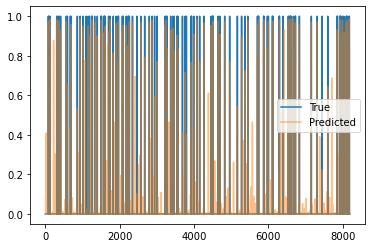

Validation Epoch: 0 [10/582 (1%)]	Loss: 0.009314	Pres: 0.867925	F1 Score: 0.888889
Validation Epoch: 0 [20/582 (3%)]	Loss: 0.010098	Pres: 0.842105	F1 Score: 0.868778
Validation Epoch: 0 [30/582 (5%)]	Loss: 0.007494	Pres: 0.915888	F1 Score: 0.924528
Validation Epoch: 0 [40/582 (6%)]	Loss: 0.009224	Pres: 0.871287	F1 Score: 0.854369
Validation Epoch: 0 [50/582 (8%)]	Loss: 0.009852	Pres: 0.830357	F1 Score: 0.873239
Validation Epoch: 0 [60/582 (10%)]	Loss: 0.011289	Pres: 0.812500	F1 Score: 0.831050
Validation Epoch: 0 [70/582 (12%)]	Loss: 0.009190	Pres: 0.866667	F1 Score: 0.858491
Validation Epoch: 0 [80/582 (13%)]	Loss: 0.010648	Pres: 0.803922	F1 Score: 0.841026
Validation Epoch: 0 [90/582 (15%)]	Loss: 0.009254	Pres: 0.840000	F1 Score: 0.865979
Validation Epoch: 0 [100/582 (17%)]	Loss: 0.008621	Pres: 0.816092	F1 Score: 0.860606
Validation Epoch: 0 [110/582 (18%)]	Loss: 0.010232	Pres: 0.850000	F1 Score: 0.871795
Validation Epoch: 0 [120/582 (20%)]	Loss: 0.007565	Pres: 0.869565	F1 Score: 0.9

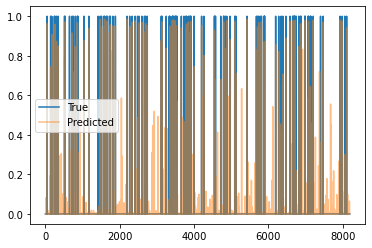

Validation Epoch: 0 [310/582 (53%)]	Loss: 0.009979	Pres: 0.886792	F1 Score: 0.899522
Validation Epoch: 0 [320/582 (54%)]	Loss: 0.010073	Pres: 0.824074	F1 Score: 0.855769
Validation Epoch: 0 [330/582 (56%)]	Loss: 0.008282	Pres: 0.865169	F1 Score: 0.890173
Validation Epoch: 0 [340/582 (58%)]	Loss: 0.008769	Pres: 0.854167	F1 Score: 0.858639
Validation Epoch: 0 [350/582 (60%)]	Loss: 0.009203	Pres: 0.882353	F1 Score: 0.886700
Validation Epoch: 0 [360/582 (61%)]	Loss: 0.008355	Pres: 0.873950	F1 Score: 0.888889
Validation Epoch: 0 [370/582 (63%)]	Loss: 0.009584	Pres: 0.815789	F1 Score: 0.873239
Validation Epoch: 0 [380/582 (65%)]	Loss: 0.011178	Pres: 0.848214	F1 Score: 0.863636
Validation Epoch: 0 [390/582 (67%)]	Loss: 0.007808	Pres: 0.875000	F1 Score: 0.879581
Validation Epoch: 0 [400/582 (68%)]	Loss: 0.009218	Pres: 0.890000	F1 Score: 0.885572
Validation Epoch: 0 [410/582 (70%)]	Loss: 0.009165	Pres: 0.863248	F1 Score: 0.897778
Validation Epoch: 0 [420/582 (72%)]	Loss: 0.009312	Pres: 0.862745

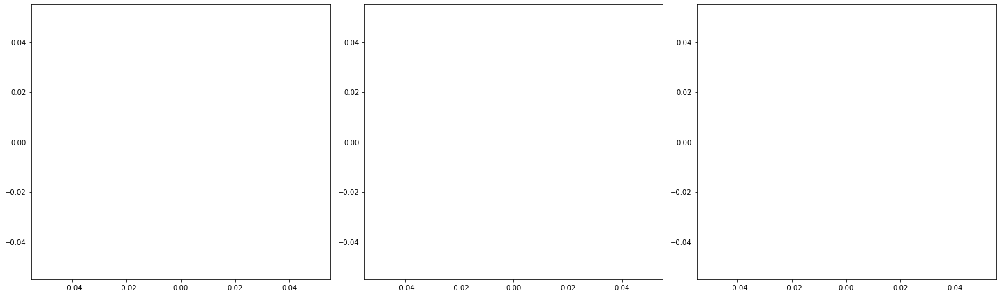

2220 582
Train Epoch: 1 [0/2220 (0%)]	Loss: 0.009988	Pres: 0.875000	F1 Score: 0.823529
108.0 -64864.0


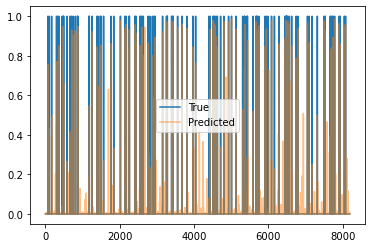

Train Epoch: 1 [10/2220 (0%)]	Loss: 0.010527	Pres: 0.875000	F1 Score: 0.782609
Train Epoch: 1 [20/2220 (0%)]	Loss: 0.009316	Pres: 0.898876	F1 Score: 0.846561
Train Epoch: 1 [30/2220 (1%)]	Loss: 0.011480	Pres: 0.904762	F1 Score: 0.812834
Train Epoch: 1 [40/2220 (1%)]	Loss: 0.015435	Pres: 0.811111	F1 Score: 0.760417
Train Epoch: 1 [50/2220 (2%)]	Loss: 0.011764	Pres: 0.829268	F1 Score: 0.777143
Train Epoch: 1 [60/2220 (2%)]	Loss: 0.011126	Pres: 0.861702	F1 Score: 0.805970
Train Epoch: 1 [70/2220 (3%)]	Loss: 0.010256	Pres: 0.888889	F1 Score: 0.842105
Train Epoch: 1 [80/2220 (3%)]	Loss: 0.010468	Pres: 0.850000	F1 Score: 0.781609
Train Epoch: 1 [90/2220 (4%)]	Loss: 0.011042	Pres: 0.880435	F1 Score: 0.826531
Train Epoch: 1 [100/2220 (4%)]	Loss: 0.011119	Pres: 0.911392	F1 Score: 0.795580
Train Epoch: 1 [110/2220 (4%)]	Loss: 0.013643	Pres: 0.927083	F1 Score: 0.809091
Train Epoch: 1 [120/2220 (5%)]	Loss: 0.011550	Pres: 0.822917	F1 Score: 0.797980
Train Epoch: 1 [130/2220 (5%)]	Loss: 0.012364	Pre

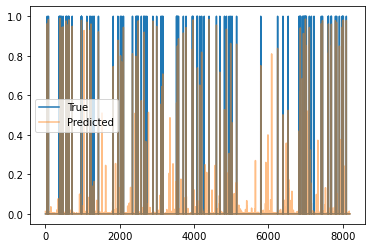

Train Epoch: 1 [310/2220 (13%)]	Loss: 0.011528	Pres: 0.918919	F1 Score: 0.824242
Train Epoch: 1 [320/2220 (14%)]	Loss: 0.012147	Pres: 0.785714	F1 Score: 0.763006
Train Epoch: 1 [330/2220 (14%)]	Loss: 0.008810	Pres: 0.885057	F1 Score: 0.846154
Train Epoch: 1 [340/2220 (15%)]	Loss: 0.012753	Pres: 0.853933	F1 Score: 0.775510
Train Epoch: 1 [350/2220 (15%)]	Loss: 0.012059	Pres: 0.842697	F1 Score: 0.793651
Train Epoch: 1 [360/2220 (16%)]	Loss: 0.012472	Pres: 0.781609	F1 Score: 0.755556
Train Epoch: 1 [370/2220 (16%)]	Loss: 0.011657	Pres: 0.831169	F1 Score: 0.766467
Train Epoch: 1 [380/2220 (17%)]	Loss: 0.010496	Pres: 0.912500	F1 Score: 0.815642
Train Epoch: 1 [390/2220 (17%)]	Loss: 0.013094	Pres: 0.844660	F1 Score: 0.809302
Train Epoch: 1 [400/2220 (18%)]	Loss: 0.012092	Pres: 0.833333	F1 Score: 0.786517
Train Epoch: 1 [410/2220 (18%)]	Loss: 0.010717	Pres: 0.862069	F1 Score: 0.819672
Train Epoch: 1 [420/2220 (18%)]	Loss: 0.013286	Pres: 0.818182	F1 Score: 0.761905
Train Epoch: 1 [430/2220 (19

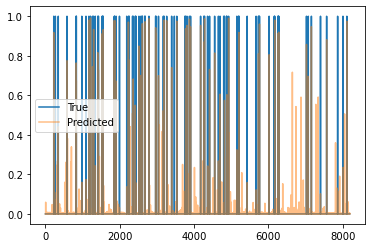

Train Epoch: 1 [610/2220 (27%)]	Loss: 0.014259	Pres: 0.784314	F1 Score: 0.747664
Train Epoch: 1 [620/2220 (27%)]	Loss: 0.009419	Pres: 0.853659	F1 Score: 0.804598
Train Epoch: 1 [630/2220 (28%)]	Loss: 0.017124	Pres: 0.905405	F1 Score: 0.716578
Train Epoch: 1 [640/2220 (28%)]	Loss: 0.009382	Pres: 0.898876	F1 Score: 0.833333
Train Epoch: 1 [650/2220 (29%)]	Loss: 0.010894	Pres: 0.912500	F1 Score: 0.806630
Train Epoch: 1 [660/2220 (29%)]	Loss: 0.011895	Pres: 0.817073	F1 Score: 0.761364
Train Epoch: 1 [670/2220 (30%)]	Loss: 0.013263	Pres: 0.865169	F1 Score: 0.793814
Train Epoch: 1 [680/2220 (30%)]	Loss: 0.014429	Pres: 0.881188	F1 Score: 0.787611
Train Epoch: 1 [690/2220 (31%)]	Loss: 0.010385	Pres: 0.875000	F1 Score: 0.773006
Train Epoch: 1 [700/2220 (31%)]	Loss: 0.010577	Pres: 0.879518	F1 Score: 0.829545
Train Epoch: 1 [710/2220 (31%)]	Loss: 0.010444	Pres: 0.894118	F1 Score: 0.808511
Train Epoch: 1 [720/2220 (32%)]	Loss: 0.013092	Pres: 0.864198	F1 Score: 0.744681
Train Epoch: 1 [730/2220 (32

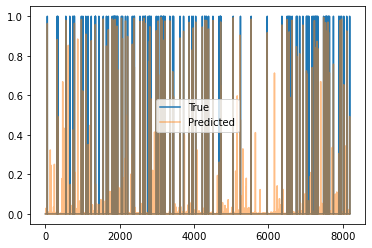

Train Epoch: 1 [910/2220 (40%)]	Loss: 0.011207	Pres: 0.824176	F1 Score: 0.789474
Train Epoch: 1 [920/2220 (41%)]	Loss: 0.007095	Pres: 0.940476	F1 Score: 0.882682
Train Epoch: 1 [930/2220 (41%)]	Loss: 0.012294	Pres: 0.757282	F1 Score: 0.764706
Train Epoch: 1 [940/2220 (42%)]	Loss: 0.008825	Pres: 0.900000	F1 Score: 0.839378
Train Epoch: 1 [950/2220 (42%)]	Loss: 0.010737	Pres: 0.867647	F1 Score: 0.737500
Train Epoch: 1 [960/2220 (43%)]	Loss: 0.013086	Pres: 0.875000	F1 Score: 0.773869
Train Epoch: 1 [970/2220 (43%)]	Loss: 0.013036	Pres: 0.836364	F1 Score: 0.814159
Train Epoch: 1 [980/2220 (44%)]	Loss: 0.009218	Pres: 0.963415	F1 Score: 0.835979
Train Epoch: 1 [990/2220 (44%)]	Loss: 0.009152	Pres: 0.958333	F1 Score: 0.872038
Train Epoch: 1 [1000/2220 (45%)]	Loss: 0.014633	Pres: 0.865979	F1 Score: 0.788732
Train Epoch: 1 [1010/2220 (45%)]	Loss: 0.013364	Pres: 0.972222	F1 Score: 0.748663
Train Epoch: 1 [1020/2220 (45%)]	Loss: 0.010950	Pres: 0.873786	F1 Score: 0.833333
Train Epoch: 1 [1030/2220

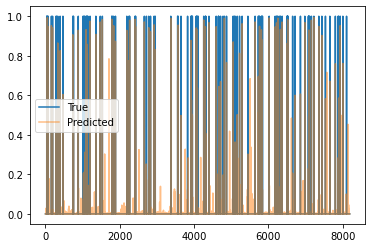

Train Epoch: 1 [1210/2220 (54%)]	Loss: 0.012110	Pres: 0.920000	F1 Score: 0.745946
Train Epoch: 1 [1220/2220 (54%)]	Loss: 0.010084	Pres: 0.905263	F1 Score: 0.847291
Train Epoch: 1 [1230/2220 (55%)]	Loss: 0.012574	Pres: 0.972222	F1 Score: 0.777778
Train Epoch: 1 [1240/2220 (55%)]	Loss: 0.013305	Pres: 0.862745	F1 Score: 0.792793
Train Epoch: 1 [1250/2220 (56%)]	Loss: 0.011614	Pres: 0.875000	F1 Score: 0.773481
Train Epoch: 1 [1260/2220 (56%)]	Loss: 0.011680	Pres: 0.885714	F1 Score: 0.815789
Train Epoch: 1 [1270/2220 (57%)]	Loss: 0.009711	Pres: 0.900000	F1 Score: 0.798030
Train Epoch: 1 [1280/2220 (57%)]	Loss: 0.013255	Pres: 0.868687	F1 Score: 0.822967
Train Epoch: 1 [1290/2220 (58%)]	Loss: 0.008330	Pres: 0.876190	F1 Score: 0.859813
Train Epoch: 1 [1300/2220 (58%)]	Loss: 0.013481	Pres: 0.978723	F1 Score: 0.807018
Train Epoch: 1 [1310/2220 (59%)]	Loss: 0.011242	Pres: 0.929204	F1 Score: 0.857143
Train Epoch: 1 [1320/2220 (59%)]	Loss: 0.007926	Pres: 0.943820	F1 Score: 0.884211
Train Epoch: 1 [

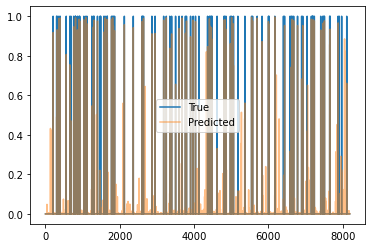

Train Epoch: 1 [1510/2220 (68%)]	Loss: 0.010243	Pres: 0.870588	F1 Score: 0.822222
Train Epoch: 1 [1520/2220 (68%)]	Loss: 0.012520	Pres: 0.833333	F1 Score: 0.796020
Train Epoch: 1 [1530/2220 (68%)]	Loss: 0.011685	Pres: 0.732143	F1 Score: 0.769953
Train Epoch: 1 [1540/2220 (69%)]	Loss: 0.011558	Pres: 0.935484	F1 Score: 0.813084
Train Epoch: 1 [1550/2220 (69%)]	Loss: 0.008569	Pres: 0.932432	F1 Score: 0.811765
Train Epoch: 1 [1560/2220 (70%)]	Loss: 0.009263	Pres: 0.771739	F1 Score: 0.811429
Train Epoch: 1 [1570/2220 (70%)]	Loss: 0.010763	Pres: 0.814433	F1 Score: 0.822917
Train Epoch: 1 [1580/2220 (71%)]	Loss: 0.009853	Pres: 0.882353	F1 Score: 0.802139
Train Epoch: 1 [1590/2220 (71%)]	Loss: 0.010172	Pres: 0.946809	F1 Score: 0.859903
Train Epoch: 1 [1600/2220 (72%)]	Loss: 0.010888	Pres: 0.872340	F1 Score: 0.845361
Train Epoch: 1 [1610/2220 (72%)]	Loss: 0.010078	Pres: 0.923913	F1 Score: 0.829268
Train Epoch: 1 [1620/2220 (72%)]	Loss: 0.008720	Pres: 0.858824	F1 Score: 0.824859
Train Epoch: 1 [

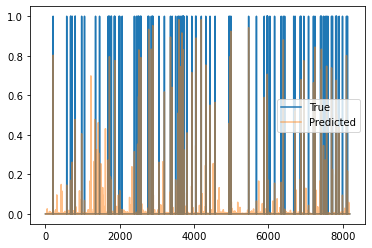

Train Epoch: 1 [1810/2220 (81%)]	Loss: 0.010218	Pres: 0.903226	F1 Score: 0.815534
Train Epoch: 1 [1820/2220 (81%)]	Loss: 0.010475	Pres: 0.871287	F1 Score: 0.834123
Train Epoch: 1 [1830/2220 (82%)]	Loss: 0.010463	Pres: 0.928571	F1 Score: 0.838710
Train Epoch: 1 [1840/2220 (82%)]	Loss: 0.009611	Pres: 0.898876	F1 Score: 0.820513
Train Epoch: 1 [1850/2220 (83%)]	Loss: 0.011392	Pres: 0.803922	F1 Score: 0.784689
Train Epoch: 1 [1860/2220 (83%)]	Loss: 0.010656	Pres: 0.829787	F1 Score: 0.808290
Train Epoch: 1 [1870/2220 (84%)]	Loss: 0.010677	Pres: 0.846154	F1 Score: 0.832432
Train Epoch: 1 [1880/2220 (84%)]	Loss: 0.009078	Pres: 0.908163	F1 Score: 0.864078
Train Epoch: 1 [1890/2220 (85%)]	Loss: 0.008882	Pres: 0.847059	F1 Score: 0.808989
Train Epoch: 1 [1900/2220 (85%)]	Loss: 0.007920	Pres: 0.934066	F1 Score: 0.854271
Train Epoch: 1 [1910/2220 (86%)]	Loss: 0.010783	Pres: 0.850877	F1 Score: 0.839827
Train Epoch: 1 [1920/2220 (86%)]	Loss: 0.009291	Pres: 0.850000	F1 Score: 0.790698
Train Epoch: 1 [

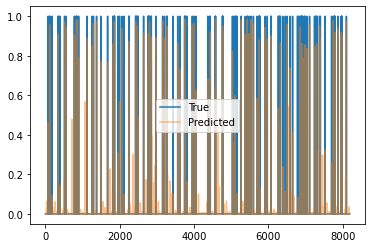

Train Epoch: 1 [2110/2220 (95%)]	Loss: 0.010987	Pres: 0.876289	F1 Score: 0.854271
Train Epoch: 1 [2120/2220 (95%)]	Loss: 0.008680	Pres: 0.911392	F1 Score: 0.822857
Train Epoch: 1 [2130/2220 (95%)]	Loss: 0.010209	Pres: 0.890110	F1 Score: 0.826531
Train Epoch: 1 [2140/2220 (96%)]	Loss: 0.009441	Pres: 0.900000	F1 Score: 0.843750
Train Epoch: 1 [2150/2220 (96%)]	Loss: 0.010974	Pres: 0.862069	F1 Score: 0.785340
Train Epoch: 1 [2160/2220 (97%)]	Loss: 0.008557	Pres: 0.862500	F1 Score: 0.846626
Train Epoch: 1 [2170/2220 (97%)]	Loss: 0.009852	Pres: 0.879518	F1 Score: 0.820225
Train Epoch: 1 [2180/2220 (98%)]	Loss: 0.008620	Pres: 0.892473	F1 Score: 0.842640
Train Epoch: 1 [2190/2220 (98%)]	Loss: 0.010557	Pres: 0.876404	F1 Score: 0.800000
Train Epoch: 1 [2200/2220 (99%)]	Loss: 0.013986	Pres: 0.864865	F1 Score: 0.735632
Train Epoch: 1 [2210/2220 (99%)]	Loss: 0.008122	Pres: 0.943182	F1 Score: 0.873684
Validation Epoch: 1 [0/582 (0%)]	Loss: 0.010005	Pres: 0.776923	F1 Score: 0.852321


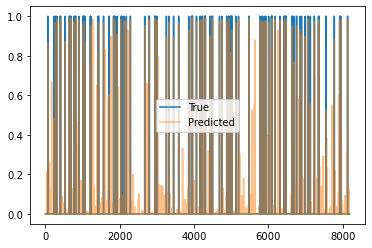

Validation Epoch: 1 [10/582 (1%)]	Loss: 0.007379	Pres: 0.855769	F1 Score: 0.898990
Validation Epoch: 1 [20/582 (3%)]	Loss: 0.006867	Pres: 0.834783	F1 Score: 0.897196
Validation Epoch: 1 [30/582 (5%)]	Loss: 0.008730	Pres: 0.851852	F1 Score: 0.893204
Validation Epoch: 1 [40/582 (6%)]	Loss: 0.007839	Pres: 0.834783	F1 Score: 0.880734
Validation Epoch: 1 [50/582 (8%)]	Loss: 0.007347	Pres: 0.808696	F1 Score: 0.881517
Validation Epoch: 1 [60/582 (10%)]	Loss: 0.008239	Pres: 0.843284	F1 Score: 0.896825
Validation Epoch: 1 [70/582 (12%)]	Loss: 0.006485	Pres: 0.857143	F1 Score: 0.910714
Validation Epoch: 1 [80/582 (13%)]	Loss: 0.008923	Pres: 0.828571	F1 Score: 0.892308
Validation Epoch: 1 [90/582 (15%)]	Loss: 0.006479	Pres: 0.882353	F1 Score: 0.932642
Validation Epoch: 1 [100/582 (17%)]	Loss: 0.008769	Pres: 0.842975	F1 Score: 0.883117
Validation Epoch: 1 [110/582 (18%)]	Loss: 0.009747	Pres: 0.834862	F1 Score: 0.879227
Validation Epoch: 1 [120/582 (20%)]	Loss: 0.009069	Pres: 0.780303	F1 Score: 0.8

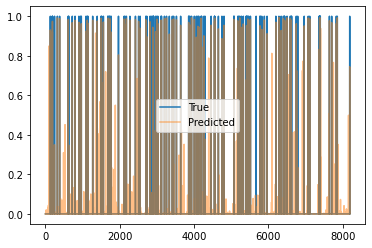

Validation Epoch: 1 [310/582 (53%)]	Loss: 0.009081	Pres: 0.794643	F1 Score: 0.855769
Validation Epoch: 1 [320/582 (54%)]	Loss: 0.008524	Pres: 0.854839	F1 Score: 0.909871
Validation Epoch: 1 [330/582 (56%)]	Loss: 0.010588	Pres: 0.782609	F1 Score: 0.853755
Validation Epoch: 1 [340/582 (58%)]	Loss: 0.011055	Pres: 0.748201	F1 Score: 0.832000
Validation Epoch: 1 [350/582 (60%)]	Loss: 0.008386	Pres: 0.837398	F1 Score: 0.895652
Validation Epoch: 1 [360/582 (61%)]	Loss: 0.007647	Pres: 0.864865	F1 Score: 0.914286
Validation Epoch: 1 [370/582 (63%)]	Loss: 0.015136	Pres: 0.788462	F1 Score: 0.828283
Validation Epoch: 1 [380/582 (65%)]	Loss: 0.008229	Pres: 0.814815	F1 Score: 0.884422
Validation Epoch: 1 [390/582 (67%)]	Loss: 0.007198	Pres: 0.858407	F1 Score: 0.906542
Validation Epoch: 1 [400/582 (68%)]	Loss: 0.008249	Pres: 0.835938	F1 Score: 0.902954
Validation Epoch: 1 [410/582 (70%)]	Loss: 0.011685	Pres: 0.795775	F1 Score: 0.859316
Validation Epoch: 1 [420/582 (72%)]	Loss: 0.008349	Pres: 0.853659

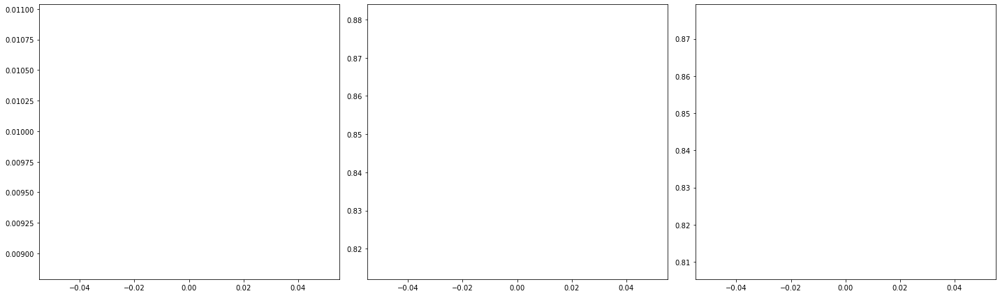

2220 582
Train Epoch: 2 [0/2220 (0%)]	Loss: 0.008873	Pres: 0.913043	F1 Score: 0.848485
106.0 -inf


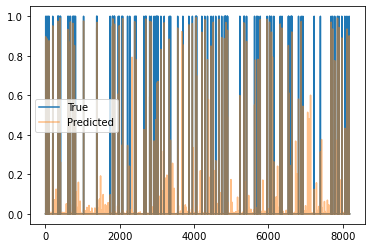

Train Epoch: 2 [10/2220 (0%)]	Loss: 0.009780	Pres: 0.880435	F1 Score: 0.826531
Train Epoch: 2 [20/2220 (0%)]	Loss: 0.011173	Pres: 0.858824	F1 Score: 0.797814
Train Epoch: 2 [30/2220 (1%)]	Loss: 0.011227	Pres: 0.896552	F1 Score: 0.825397
Train Epoch: 2 [40/2220 (1%)]	Loss: 0.007403	Pres: 0.957447	F1 Score: 0.891089
Train Epoch: 2 [50/2220 (2%)]	Loss: 0.008716	Pres: 0.840909	F1 Score: 0.826816
Train Epoch: 2 [60/2220 (2%)]	Loss: 0.008664	Pres: 0.910112	F1 Score: 0.848168
Train Epoch: 2 [70/2220 (3%)]	Loss: 0.010020	Pres: 0.930233	F1 Score: 0.796020
Train Epoch: 2 [80/2220 (3%)]	Loss: 0.014607	Pres: 0.862069	F1 Score: 0.675676
Train Epoch: 2 [90/2220 (4%)]	Loss: 0.010651	Pres: 0.876190	F1 Score: 0.847926
Train Epoch: 2 [100/2220 (4%)]	Loss: 0.008820	Pres: 0.851064	F1 Score: 0.837696
Train Epoch: 2 [110/2220 (4%)]	Loss: 0.011327	Pres: 0.911765	F1 Score: 0.845455
Train Epoch: 2 [120/2220 (5%)]	Loss: 0.008596	Pres: 0.880435	F1 Score: 0.839378
Train Epoch: 2 [130/2220 (5%)]	Loss: 0.010304	Pre

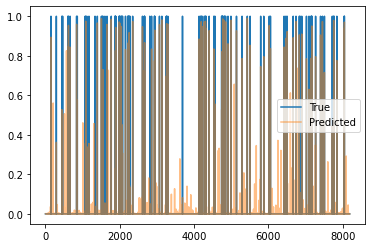

Train Epoch: 2 [310/2220 (13%)]	Loss: 0.009919	Pres: 0.900000	F1 Score: 0.818182
Train Epoch: 2 [320/2220 (14%)]	Loss: 0.009439	Pres: 0.889908	F1 Score: 0.832618
Train Epoch: 2 [330/2220 (14%)]	Loss: 0.010463	Pres: 0.850000	F1 Score: 0.800000
Train Epoch: 2 [340/2220 (15%)]	Loss: 0.008666	Pres: 0.839623	F1 Score: 0.859903
Train Epoch: 2 [350/2220 (15%)]	Loss: 0.013080	Pres: 0.865169	F1 Score: 0.789744
Train Epoch: 2 [360/2220 (16%)]	Loss: 0.010406	Pres: 0.868132	F1 Score: 0.802030
Train Epoch: 2 [370/2220 (16%)]	Loss: 0.008459	Pres: 0.845455	F1 Score: 0.853211
Train Epoch: 2 [380/2220 (17%)]	Loss: 0.007656	Pres: 0.934783	F1 Score: 0.860000
Train Epoch: 2 [390/2220 (17%)]	Loss: 0.008990	Pres: 0.850000	F1 Score: 0.854271
Train Epoch: 2 [400/2220 (18%)]	Loss: 0.016736	Pres: 0.757576	F1 Score: 0.657895
Train Epoch: 2 [410/2220 (18%)]	Loss: 0.009517	Pres: 0.898990	F1 Score: 0.843602
Train Epoch: 2 [420/2220 (18%)]	Loss: 0.009284	Pres: 0.875000	F1 Score: 0.823529
Train Epoch: 2 [430/2220 (19

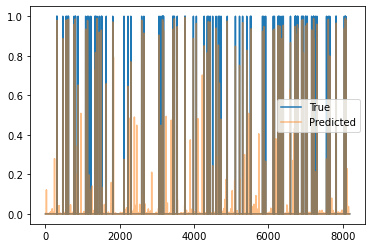

Train Epoch: 2 [610/2220 (27%)]	Loss: 0.008891	Pres: 0.960526	F1 Score: 0.843931
Train Epoch: 2 [620/2220 (27%)]	Loss: 0.009752	Pres: 0.876404	F1 Score: 0.829787
Train Epoch: 2 [630/2220 (28%)]	Loss: 0.006571	Pres: 0.917526	F1 Score: 0.885572
Train Epoch: 2 [640/2220 (28%)]	Loss: 0.010523	Pres: 0.895833	F1 Score: 0.815166
Train Epoch: 2 [650/2220 (29%)]	Loss: 0.009667	Pres: 0.880435	F1 Score: 0.848168
Train Epoch: 2 [660/2220 (29%)]	Loss: 0.008172	Pres: 0.904255	F1 Score: 0.867347
Train Epoch: 2 [670/2220 (30%)]	Loss: 0.010359	Pres: 0.887755	F1 Score: 0.805556
Train Epoch: 2 [680/2220 (30%)]	Loss: 0.009772	Pres: 0.881720	F1 Score: 0.815920
Train Epoch: 2 [690/2220 (31%)]	Loss: 0.010244	Pres: 0.853211	F1 Score: 0.845455
Train Epoch: 2 [700/2220 (31%)]	Loss: 0.011482	Pres: 0.829787	F1 Score: 0.812500
Train Epoch: 2 [710/2220 (31%)]	Loss: 0.007285	Pres: 0.877551	F1 Score: 0.891192
Train Epoch: 2 [720/2220 (32%)]	Loss: 0.008680	Pres: 0.892473	F1 Score: 0.846939
Train Epoch: 2 [730/2220 (32

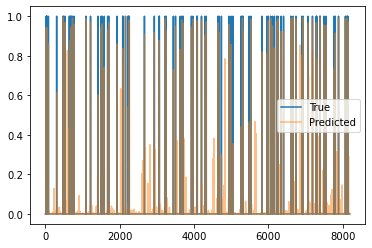

Train Epoch: 2 [910/2220 (40%)]	Loss: 0.007530	Pres: 0.846154	F1 Score: 0.866995
Train Epoch: 2 [920/2220 (41%)]	Loss: 0.008087	Pres: 0.877778	F1 Score: 0.849462
Train Epoch: 2 [930/2220 (41%)]	Loss: 0.009677	Pres: 0.850000	F1 Score: 0.837438
Train Epoch: 2 [940/2220 (42%)]	Loss: 0.008443	Pres: 0.915663	F1 Score: 0.826087
Train Epoch: 2 [950/2220 (42%)]	Loss: 0.008875	Pres: 0.967391	F1 Score: 0.859903
Train Epoch: 2 [960/2220 (43%)]	Loss: 0.008592	Pres: 0.893617	F1 Score: 0.857143
Train Epoch: 2 [970/2220 (43%)]	Loss: 0.011083	Pres: 0.888889	F1 Score: 0.842105
Train Epoch: 2 [980/2220 (44%)]	Loss: 0.007111	Pres: 0.938144	F1 Score: 0.879227
Train Epoch: 2 [990/2220 (44%)]	Loss: 0.007140	Pres: 0.895349	F1 Score: 0.875000
Train Epoch: 2 [1000/2220 (45%)]	Loss: 0.010064	Pres: 0.946237	F1 Score: 0.854369
Train Epoch: 2 [1010/2220 (45%)]	Loss: 0.006509	Pres: 0.910714	F1 Score: 0.923077
Train Epoch: 2 [1020/2220 (45%)]	Loss: 0.008465	Pres: 0.950617	F1 Score: 0.846154
Train Epoch: 2 [1030/2220

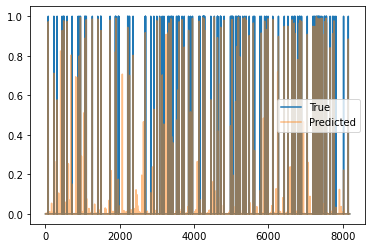

Train Epoch: 2 [1210/2220 (54%)]	Loss: 0.008136	Pres: 0.855670	F1 Score: 0.855670
Train Epoch: 2 [1220/2220 (54%)]	Loss: 0.006724	Pres: 0.931818	F1 Score: 0.872340
Train Epoch: 2 [1230/2220 (55%)]	Loss: 0.009529	Pres: 0.851064	F1 Score: 0.833333
Train Epoch: 2 [1240/2220 (55%)]	Loss: 0.006383	Pres: 0.913978	F1 Score: 0.880829
Train Epoch: 2 [1250/2220 (56%)]	Loss: 0.008987	Pres: 0.895833	F1 Score: 0.864322
Train Epoch: 2 [1260/2220 (56%)]	Loss: 0.010289	Pres: 0.967742	F1 Score: 0.857143
Train Epoch: 2 [1270/2220 (57%)]	Loss: 0.007680	Pres: 0.902174	F1 Score: 0.873684
Train Epoch: 2 [1280/2220 (57%)]	Loss: 0.007814	Pres: 0.921739	F1 Score: 0.890756
Train Epoch: 2 [1290/2220 (58%)]	Loss: 0.007538	Pres: 0.916667	F1 Score: 0.920930
Train Epoch: 2 [1300/2220 (58%)]	Loss: 0.007265	Pres: 0.899083	F1 Score: 0.882883
Train Epoch: 2 [1310/2220 (59%)]	Loss: 0.005516	Pres: 0.975309	F1 Score: 0.923977
Train Epoch: 2 [1320/2220 (59%)]	Loss: 0.008592	Pres: 0.933333	F1 Score: 0.852792
Train Epoch: 2 [

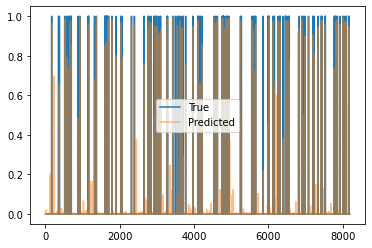

Train Epoch: 2 [1510/2220 (68%)]	Loss: 0.006771	Pres: 0.927083	F1 Score: 0.885572
Train Epoch: 2 [1520/2220 (68%)]	Loss: 0.005650	Pres: 0.966292	F1 Score: 0.882051
Train Epoch: 2 [1530/2220 (68%)]	Loss: 0.008251	Pres: 0.879121	F1 Score: 0.855615
Train Epoch: 2 [1540/2220 (69%)]	Loss: 0.008538	Pres: 0.940594	F1 Score: 0.871560
Train Epoch: 2 [1550/2220 (69%)]	Loss: 0.006590	Pres: 0.907216	F1 Score: 0.902564
Train Epoch: 2 [1560/2220 (70%)]	Loss: 0.007038	Pres: 0.898876	F1 Score: 0.874317
Train Epoch: 2 [1570/2220 (70%)]	Loss: 0.007227	Pres: 0.939759	F1 Score: 0.866667
Train Epoch: 2 [1580/2220 (71%)]	Loss: 0.006123	Pres: 0.963964	F1 Score: 0.930435
Train Epoch: 2 [1590/2220 (71%)]	Loss: 0.004780	Pres: 0.952830	F1 Score: 0.939535
Train Epoch: 2 [1600/2220 (72%)]	Loss: 0.007311	Pres: 0.920455	F1 Score: 0.900000
Train Epoch: 2 [1610/2220 (72%)]	Loss: 0.007129	Pres: 0.923077	F1 Score: 0.905660
Train Epoch: 2 [1620/2220 (72%)]	Loss: 0.009488	Pres: 0.916667	F1 Score: 0.854369
Train Epoch: 2 [

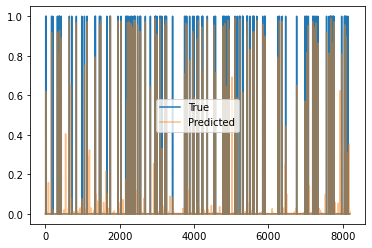

Train Epoch: 2 [1810/2220 (81%)]	Loss: 0.008308	Pres: 0.896552	F1 Score: 0.829787
Train Epoch: 2 [1820/2220 (81%)]	Loss: 0.007194	Pres: 0.828571	F1 Score: 0.857143
Train Epoch: 2 [1830/2220 (82%)]	Loss: 0.007846	Pres: 0.950617	F1 Score: 0.841530
Train Epoch: 2 [1840/2220 (82%)]	Loss: 0.010268	Pres: 0.810811	F1 Score: 0.837209
Train Epoch: 2 [1850/2220 (83%)]	Loss: 0.010556	Pres: 0.972603	F1 Score: 0.806818
Train Epoch: 2 [1860/2220 (83%)]	Loss: 0.008953	Pres: 0.928571	F1 Score: 0.843243
Train Epoch: 2 [1870/2220 (84%)]	Loss: 0.007063	Pres: 0.856000	F1 Score: 0.891667
Train Epoch: 2 [1880/2220 (84%)]	Loss: 0.007022	Pres: 0.952381	F1 Score: 0.864865
Train Epoch: 2 [1890/2220 (85%)]	Loss: 0.008714	Pres: 0.836957	F1 Score: 0.832432
Train Epoch: 2 [1900/2220 (85%)]	Loss: 0.008208	Pres: 0.959596	F1 Score: 0.879630
Train Epoch: 2 [1910/2220 (86%)]	Loss: 0.010274	Pres: 0.898990	F1 Score: 0.868293
Train Epoch: 2 [1920/2220 (86%)]	Loss: 0.007004	Pres: 0.963855	F1 Score: 0.864865
Train Epoch: 2 [

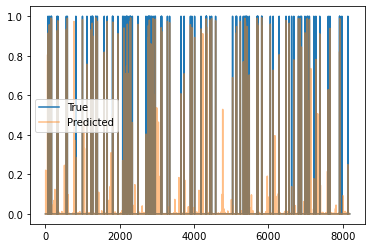

Train Epoch: 2 [2110/2220 (95%)]	Loss: 0.006954	Pres: 0.932584	F1 Score: 0.897297
Train Epoch: 2 [2120/2220 (95%)]	Loss: 0.008520	Pres: 0.895349	F1 Score: 0.846154
Train Epoch: 2 [2130/2220 (95%)]	Loss: 0.009208	Pres: 0.845361	F1 Score: 0.832487
Train Epoch: 2 [2140/2220 (96%)]	Loss: 0.008250	Pres: 0.941176	F1 Score: 0.884793
Train Epoch: 2 [2150/2220 (96%)]	Loss: 0.006745	Pres: 0.914634	F1 Score: 0.867052
Train Epoch: 2 [2160/2220 (97%)]	Loss: 0.007097	Pres: 0.898305	F1 Score: 0.898305
Train Epoch: 2 [2170/2220 (97%)]	Loss: 0.007141	Pres: 0.887640	F1 Score: 0.877778
Train Epoch: 2 [2180/2220 (98%)]	Loss: 0.007975	Pres: 0.956044	F1 Score: 0.874372
Train Epoch: 2 [2190/2220 (98%)]	Loss: 0.008737	Pres: 0.932203	F1 Score: 0.894309
Train Epoch: 2 [2200/2220 (99%)]	Loss: 0.008507	Pres: 0.871287	F1 Score: 0.858537
Train Epoch: 2 [2210/2220 (99%)]	Loss: 0.007751	Pres: 0.861789	F1 Score: 0.872428
Validation Epoch: 2 [0/582 (0%)]	Loss: 0.003975	Pres: 0.982609	F1 Score: 0.945607


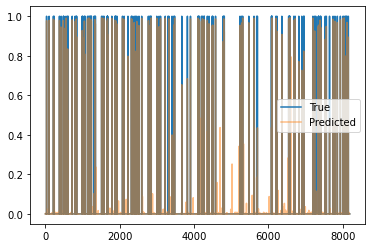

Validation Epoch: 2 [10/582 (1%)]	Loss: 0.003987	Pres: 0.963855	F1 Score: 0.946746
Validation Epoch: 2 [20/582 (3%)]	Loss: 0.005481	Pres: 0.959596	F1 Score: 0.917874
Validation Epoch: 2 [30/582 (5%)]	Loss: 0.003380	Pres: 0.964706	F1 Score: 0.931818
Validation Epoch: 2 [40/582 (6%)]	Loss: 0.003354	Pres: 0.962500	F1 Score: 0.950617
Validation Epoch: 2 [50/582 (8%)]	Loss: 0.003043	Pres: 0.966667	F1 Score: 0.956044
Validation Epoch: 2 [60/582 (10%)]	Loss: 0.002595	Pres: 0.980952	F1 Score: 0.967136
Validation Epoch: 2 [70/582 (12%)]	Loss: 0.002267	Pres: 0.988889	F1 Score: 0.972678
Validation Epoch: 2 [80/582 (13%)]	Loss: 0.004192	Pres: 0.988764	F1 Score: 0.946237
Validation Epoch: 2 [90/582 (15%)]	Loss: 0.003569	Pres: 0.953704	F1 Score: 0.949309
Validation Epoch: 2 [100/582 (17%)]	Loss: 0.003154	Pres: 0.989899	F1 Score: 0.965517
Validation Epoch: 2 [110/582 (18%)]	Loss: 0.002829	Pres: 0.971963	F1 Score: 0.962963
Validation Epoch: 2 [120/582 (20%)]	Loss: 0.004891	Pres: 0.921569	F1 Score: 0.9

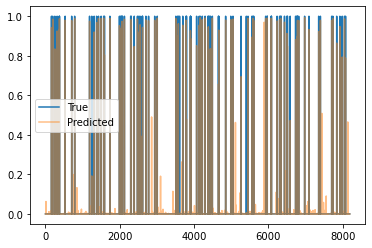

Validation Epoch: 2 [310/582 (53%)]	Loss: 0.004018	Pres: 0.951923	F1 Score: 0.938389
Validation Epoch: 2 [320/582 (54%)]	Loss: 0.004935	Pres: 0.929293	F1 Score: 0.915423
Validation Epoch: 2 [330/582 (56%)]	Loss: 0.003402	Pres: 0.988764	F1 Score: 0.956522
Validation Epoch: 2 [340/582 (58%)]	Loss: 0.003360	Pres: 0.972973	F1 Score: 0.955752
Validation Epoch: 2 [350/582 (60%)]	Loss: 0.004700	Pres: 0.960396	F1 Score: 0.937198
Validation Epoch: 2 [360/582 (61%)]	Loss: 0.003401	Pres: 0.980392	F1 Score: 0.943396
Validation Epoch: 2 [370/582 (63%)]	Loss: 0.004071	Pres: 0.935484	F1 Score: 0.935484
Validation Epoch: 2 [380/582 (65%)]	Loss: 0.004773	Pres: 0.971429	F1 Score: 0.940092
Validation Epoch: 2 [390/582 (67%)]	Loss: 0.003814	Pres: 0.989899	F1 Score: 0.956098
Validation Epoch: 2 [400/582 (68%)]	Loss: 0.003695	Pres: 0.952830	F1 Score: 0.961905
Validation Epoch: 2 [410/582 (70%)]	Loss: 0.004878	Pres: 0.956522	F1 Score: 0.940171
Validation Epoch: 2 [420/582 (72%)]	Loss: 0.003427	Pres: 0.958333

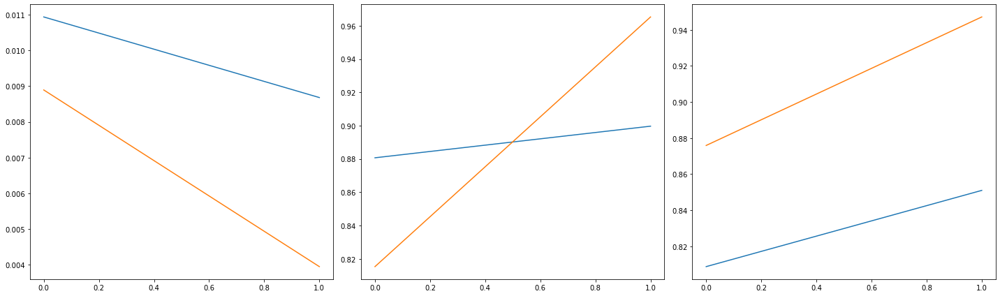

2220 582
Train Epoch: 3 [0/2220 (0%)]	Loss: 0.008464	Pres: 0.932039	F1 Score: 0.864865
119.0 -inf


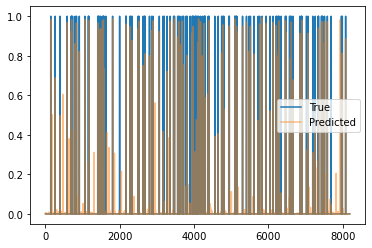

Train Epoch: 3 [10/2220 (0%)]	Loss: 0.008432	Pres: 0.917431	F1 Score: 0.884956
Train Epoch: 3 [20/2220 (0%)]	Loss: 0.008283	Pres: 0.860215	F1 Score: 0.860215
Train Epoch: 3 [30/2220 (1%)]	Loss: 0.006382	Pres: 0.890110	F1 Score: 0.890110
Train Epoch: 3 [40/2220 (1%)]	Loss: 0.009711	Pres: 0.861386	F1 Score: 0.832536
Train Epoch: 3 [50/2220 (2%)]	Loss: 0.006341	Pres: 0.962500	F1 Score: 0.880000
Train Epoch: 3 [60/2220 (2%)]	Loss: 0.007290	Pres: 0.876289	F1 Score: 0.871795
Train Epoch: 3 [70/2220 (3%)]	Loss: 0.006859	Pres: 0.928571	F1 Score: 0.887805
Train Epoch: 3 [80/2220 (3%)]	Loss: 0.006869	Pres: 0.922330	F1 Score: 0.879630
Train Epoch: 3 [90/2220 (4%)]	Loss: 0.007347	Pres: 0.914894	F1 Score: 0.873096
Train Epoch: 3 [100/2220 (4%)]	Loss: 0.008892	Pres: 0.840000	F1 Score: 0.848485
Train Epoch: 3 [110/2220 (4%)]	Loss: 0.006734	Pres: 0.942857	F1 Score: 0.912442
Train Epoch: 3 [120/2220 (5%)]	Loss: 0.003987	Pres: 0.956522	F1 Score: 0.941176
Train Epoch: 3 [130/2220 (5%)]	Loss: 0.006992	Pre

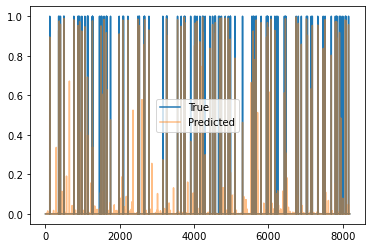

Train Epoch: 3 [310/2220 (13%)]	Loss: 0.006959	Pres: 0.890110	F1 Score: 0.866310
Train Epoch: 3 [320/2220 (14%)]	Loss: 0.008141	Pres: 0.959596	F1 Score: 0.892019
Train Epoch: 3 [330/2220 (14%)]	Loss: 0.007094	Pres: 0.929293	F1 Score: 0.888889
Train Epoch: 3 [340/2220 (15%)]	Loss: 0.006246	Pres: 0.895833	F1 Score: 0.860000
Train Epoch: 3 [350/2220 (15%)]	Loss: 0.006985	Pres: 0.942857	F1 Score: 0.920930
Train Epoch: 3 [360/2220 (16%)]	Loss: 0.007555	Pres: 0.914894	F1 Score: 0.877551
Train Epoch: 3 [370/2220 (16%)]	Loss: 0.008667	Pres: 0.965116	F1 Score: 0.873684
Train Epoch: 3 [380/2220 (17%)]	Loss: 0.006458	Pres: 0.891892	F1 Score: 0.908257
Train Epoch: 3 [390/2220 (17%)]	Loss: 0.011089	Pres: 0.876190	F1 Score: 0.844037
Train Epoch: 3 [400/2220 (18%)]	Loss: 0.009265	Pres: 0.911765	F1 Score: 0.861111
Train Epoch: 3 [410/2220 (18%)]	Loss: 0.004996	Pres: 0.909091	F1 Score: 0.924855
Train Epoch: 3 [420/2220 (18%)]	Loss: 0.007880	Pres: 0.878049	F1 Score: 0.842105
Train Epoch: 3 [430/2220 (19

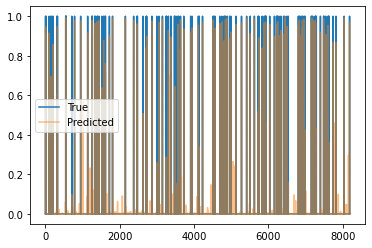

Train Epoch: 3 [610/2220 (27%)]	Loss: 0.005527	Pres: 0.930233	F1 Score: 0.924855
Train Epoch: 3 [620/2220 (27%)]	Loss: 0.006036	Pres: 0.877358	F1 Score: 0.902913
Train Epoch: 3 [630/2220 (28%)]	Loss: 0.004473	Pres: 0.989247	F1 Score: 0.929293
Train Epoch: 3 [640/2220 (28%)]	Loss: 0.006343	Pres: 0.960526	F1 Score: 0.858824
Train Epoch: 3 [650/2220 (29%)]	Loss: 0.004689	Pres: 0.930693	F1 Score: 0.921569
Train Epoch: 3 [660/2220 (29%)]	Loss: 0.006931	Pres: 0.935484	F1 Score: 0.883249
Train Epoch: 3 [670/2220 (30%)]	Loss: 0.007608	Pres: 0.978947	F1 Score: 0.902913
Train Epoch: 3 [680/2220 (30%)]	Loss: 0.007555	Pres: 0.809524	F1 Score: 0.867347
Train Epoch: 3 [690/2220 (31%)]	Loss: 0.007549	Pres: 0.969388	F1 Score: 0.892019
Train Epoch: 3 [700/2220 (31%)]	Loss: 0.006806	Pres: 0.910000	F1 Score: 0.919192
Train Epoch: 3 [710/2220 (31%)]	Loss: 0.005095	Pres: 0.866667	F1 Score: 0.887805
Train Epoch: 3 [720/2220 (32%)]	Loss: 0.006640	Pres: 0.934066	F1 Score: 0.885417
Train Epoch: 3 [730/2220 (32

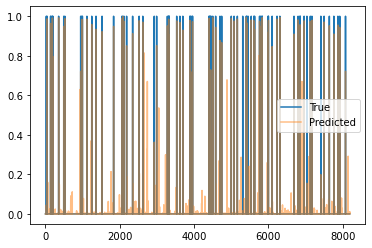

Train Epoch: 3 [910/2220 (40%)]	Loss: 0.007021	Pres: 0.924731	F1 Score: 0.864322
Train Epoch: 3 [920/2220 (41%)]	Loss: 0.007188	Pres: 0.852273	F1 Score: 0.847458
Train Epoch: 3 [930/2220 (41%)]	Loss: 0.005482	Pres: 0.883721	F1 Score: 0.919355
Train Epoch: 3 [940/2220 (42%)]	Loss: 0.008138	Pres: 0.950617	F1 Score: 0.860335
Train Epoch: 3 [950/2220 (42%)]	Loss: 0.005592	Pres: 0.938144	F1 Score: 0.919192
Train Epoch: 3 [960/2220 (43%)]	Loss: 0.007744	Pres: 0.979798	F1 Score: 0.873874
Train Epoch: 3 [970/2220 (43%)]	Loss: 0.005740	Pres: 0.973214	F1 Score: 0.927660
Train Epoch: 3 [980/2220 (44%)]	Loss: 0.008078	Pres: 0.909091	F1 Score: 0.851064
Train Epoch: 3 [990/2220 (44%)]	Loss: 0.006069	Pres: 0.892857	F1 Score: 0.882353
Train Epoch: 3 [1000/2220 (45%)]	Loss: 0.009844	Pres: 0.926316	F1 Score: 0.854369
Train Epoch: 3 [1010/2220 (45%)]	Loss: 0.007849	Pres: 0.949367	F1 Score: 0.828729
Train Epoch: 3 [1020/2220 (45%)]	Loss: 0.009095	Pres: 0.882353	F1 Score: 0.901288
Train Epoch: 3 [1030/2220

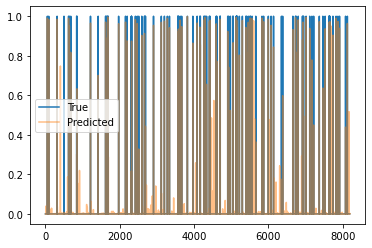

Train Epoch: 3 [1210/2220 (54%)]	Loss: 0.005411	Pres: 0.955752	F1 Score: 0.951542
Train Epoch: 3 [1220/2220 (54%)]	Loss: 0.007761	Pres: 0.858824	F1 Score: 0.829545
Train Epoch: 3 [1230/2220 (55%)]	Loss: 0.005814	Pres: 0.905263	F1 Score: 0.886598
Train Epoch: 3 [1240/2220 (55%)]	Loss: 0.005540	Pres: 0.890110	F1 Score: 0.900000
Train Epoch: 3 [1250/2220 (56%)]	Loss: 0.020691	Pres: 0.731343	F1 Score: 0.590361
Train Epoch: 3 [1260/2220 (56%)]	Loss: 0.006511	Pres: 0.957895	F1 Score: 0.905473
Train Epoch: 3 [1270/2220 (57%)]	Loss: 0.014952	Pres: 0.945455	F1 Score: 0.634146
Train Epoch: 3 [1280/2220 (57%)]	Loss: 0.006548	Pres: 0.936842	F1 Score: 0.917526
Train Epoch: 3 [1290/2220 (58%)]	Loss: 0.006683	Pres: 0.892473	F1 Score: 0.869110
Train Epoch: 3 [1300/2220 (58%)]	Loss: 0.007216	Pres: 0.834783	F1 Score: 0.880734
Train Epoch: 3 [1310/2220 (59%)]	Loss: 0.005076	Pres: 0.911765	F1 Score: 0.902913
Train Epoch: 3 [1320/2220 (59%)]	Loss: 0.006746	Pres: 0.915789	F1 Score: 0.887755
Train Epoch: 3 [

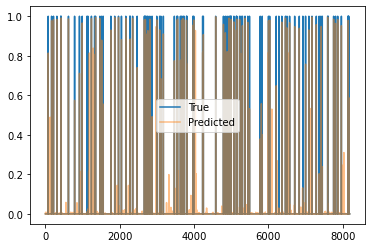

Train Epoch: 3 [1510/2220 (68%)]	Loss: 0.007356	Pres: 0.913043	F1 Score: 0.898396
Train Epoch: 3 [1520/2220 (68%)]	Loss: 0.007996	Pres: 0.883495	F1 Score: 0.870813
Train Epoch: 3 [1530/2220 (68%)]	Loss: 0.007144	Pres: 0.834783	F1 Score: 0.880734
Train Epoch: 3 [1540/2220 (69%)]	Loss: 0.006338	Pres: 0.907216	F1 Score: 0.884422
Train Epoch: 3 [1550/2220 (69%)]	Loss: 0.007974	Pres: 0.951456	F1 Score: 0.890909
Train Epoch: 3 [1560/2220 (70%)]	Loss: 0.005563	Pres: 0.933333	F1 Score: 0.918033
Train Epoch: 3 [1570/2220 (70%)]	Loss: 0.007181	Pres: 0.933962	F1 Score: 0.904110
Train Epoch: 3 [1580/2220 (71%)]	Loss: 0.004964	Pres: 0.950000	F1 Score: 0.931373
Train Epoch: 3 [1590/2220 (71%)]	Loss: 0.005555	Pres: 0.924731	F1 Score: 0.934783
Train Epoch: 3 [1600/2220 (72%)]	Loss: 0.006522	Pres: 0.927083	F1 Score: 0.885572
Train Epoch: 3 [1610/2220 (72%)]	Loss: 0.007245	Pres: 0.904762	F1 Score: 0.883721
Train Epoch: 3 [1620/2220 (72%)]	Loss: 0.005625	Pres: 0.944444	F1 Score: 0.918919
Train Epoch: 3 [

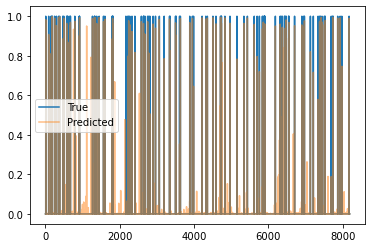

Train Epoch: 3 [1810/2220 (81%)]	Loss: 0.006010	Pres: 0.933333	F1 Score: 0.907407
Train Epoch: 3 [1820/2220 (81%)]	Loss: 0.003633	Pres: 0.952941	F1 Score: 0.941860
Train Epoch: 3 [1830/2220 (82%)]	Loss: 0.004080	Pres: 0.970297	F1 Score: 0.960784
Train Epoch: 3 [1840/2220 (82%)]	Loss: 0.006038	Pres: 0.903846	F1 Score: 0.903846
Train Epoch: 3 [1850/2220 (83%)]	Loss: 0.005209	Pres: 0.944444	F1 Score: 0.885417
Train Epoch: 3 [1860/2220 (83%)]	Loss: 0.007980	Pres: 0.898305	F1 Score: 0.898305
Train Epoch: 3 [1870/2220 (84%)]	Loss: 0.021096	Pres: 0.958333	F1 Score: 0.370968
Train Epoch: 3 [1880/2220 (84%)]	Loss: 0.005503	Pres: 0.917647	F1 Score: 0.896552
Train Epoch: 3 [1890/2220 (85%)]	Loss: 0.006453	Pres: 0.953271	F1 Score: 0.927273
Train Epoch: 3 [1900/2220 (85%)]	Loss: 0.004675	Pres: 0.970000	F1 Score: 0.923810
Train Epoch: 3 [1910/2220 (86%)]	Loss: 0.005047	Pres: 0.902174	F1 Score: 0.917127
Train Epoch: 3 [1920/2220 (86%)]	Loss: 0.007137	Pres: 0.920000	F1 Score: 0.888889
Train Epoch: 3 [

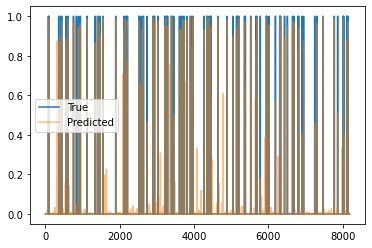

Train Epoch: 3 [2110/2220 (95%)]	Loss: 0.022880	Pres: 0.861111	F1 Score: 0.405229
Train Epoch: 3 [2120/2220 (95%)]	Loss: 0.005443	Pres: 0.946237	F1 Score: 0.911917
Train Epoch: 3 [2130/2220 (95%)]	Loss: 0.005076	Pres: 0.945652	F1 Score: 0.906250
Train Epoch: 3 [2140/2220 (96%)]	Loss: 0.005110	Pres: 0.922330	F1 Score: 0.926829
Train Epoch: 3 [2150/2220 (96%)]	Loss: 0.004989	Pres: 0.980000	F1 Score: 0.920188
Train Epoch: 3 [2160/2220 (97%)]	Loss: 0.016960	Pres: 0.691667	F1 Score: 0.751131
Train Epoch: 3 [2170/2220 (97%)]	Loss: 0.006067	Pres: 0.963415	F1 Score: 0.913295
Train Epoch: 3 [2180/2220 (98%)]	Loss: 0.005449	Pres: 0.870690	F1 Score: 0.914027
Train Epoch: 3 [2190/2220 (98%)]	Loss: 0.003142	Pres: 0.939394	F1 Score: 0.948980
Train Epoch: 3 [2200/2220 (99%)]	Loss: 0.004938	Pres: 0.933333	F1 Score: 0.918033
Train Epoch: 3 [2210/2220 (99%)]	Loss: 0.005726	Pres: 0.968421	F1 Score: 0.906404
Validation Epoch: 3 [0/582 (0%)]	Loss: 0.004204	Pres: 0.931624	F1 Score: 0.951965


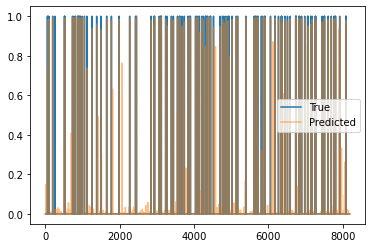

Validation Epoch: 3 [10/582 (1%)]	Loss: 0.005744	Pres: 0.891892	F1 Score: 0.925234
Validation Epoch: 3 [20/582 (3%)]	Loss: 0.004671	Pres: 0.864865	F1 Score: 0.914286
Validation Epoch: 3 [30/582 (5%)]	Loss: 0.006071	Pres: 0.825397	F1 Score: 0.888889
Validation Epoch: 3 [40/582 (6%)]	Loss: 0.003852	Pres: 0.901786	F1 Score: 0.948357
Validation Epoch: 3 [50/582 (8%)]	Loss: 0.004437	Pres: 0.894309	F1 Score: 0.940171
Validation Epoch: 3 [60/582 (10%)]	Loss: 0.003680	Pres: 0.936937	F1 Score: 0.958525
Validation Epoch: 3 [70/582 (12%)]	Loss: 0.006156	Pres: 0.821429	F1 Score: 0.888889
Validation Epoch: 3 [80/582 (13%)]	Loss: 0.005554	Pres: 0.862595	F1 Score: 0.922449
Validation Epoch: 3 [90/582 (15%)]	Loss: 0.004565	Pres: 0.912000	F1 Score: 0.946058
Validation Epoch: 3 [100/582 (17%)]	Loss: 0.005398	Pres: 0.859813	F1 Score: 0.910891
Validation Epoch: 3 [110/582 (18%)]	Loss: 0.006739	Pres: 0.795082	F1 Score: 0.877828
Validation Epoch: 3 [120/582 (20%)]	Loss: 0.006645	Pres: 0.826772	F1 Score: 0.8

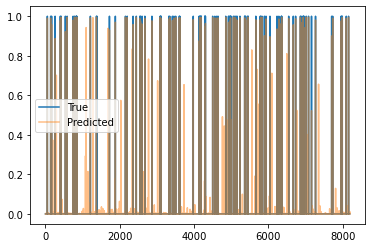

Validation Epoch: 3 [310/582 (53%)]	Loss: 0.004857	Pres: 0.870370	F1 Score: 0.921569
Validation Epoch: 3 [320/582 (54%)]	Loss: 0.004272	Pres: 0.923729	F1 Score: 0.951965
Validation Epoch: 3 [330/582 (56%)]	Loss: 0.007055	Pres: 0.875000	F1 Score: 0.918919
Validation Epoch: 3 [340/582 (58%)]	Loss: 0.004561	Pres: 0.912621	F1 Score: 0.944724
Validation Epoch: 3 [350/582 (60%)]	Loss: 0.005641	Pres: 0.885714	F1 Score: 0.916256
Validation Epoch: 3 [360/582 (61%)]	Loss: 0.006344	Pres: 0.837209	F1 Score: 0.907563
Validation Epoch: 3 [370/582 (63%)]	Loss: 0.005959	Pres: 0.880952	F1 Score: 0.917355
Validation Epoch: 3 [380/582 (65%)]	Loss: 0.004031	Pres: 0.917431	F1 Score: 0.952381
Validation Epoch: 3 [390/582 (67%)]	Loss: 0.004426	Pres: 0.880734	F1 Score: 0.927536
Validation Epoch: 3 [400/582 (68%)]	Loss: 0.006519	Pres: 0.901515	F1 Score: 0.929688
Validation Epoch: 3 [410/582 (70%)]	Loss: 0.003147	Pres: 0.933333	F1 Score: 0.965517
Validation Epoch: 3 [420/582 (72%)]	Loss: 0.005050	Pres: 0.848214

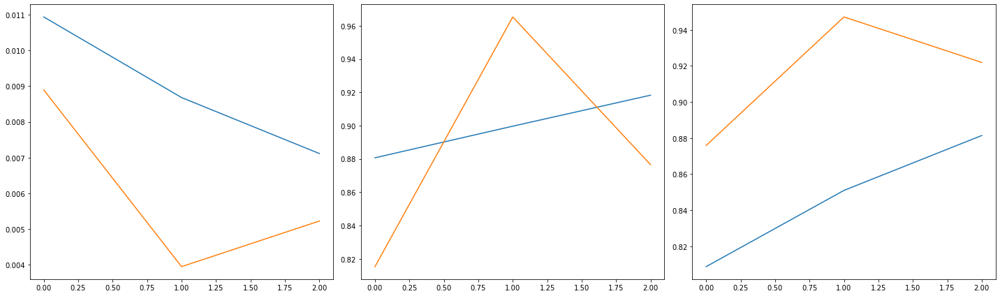

2220 582
Train Epoch: 4 [0/2220 (0%)]	Loss: 0.005065	Pres: 0.946429	F1 Score: 0.938053
114.0 -inf


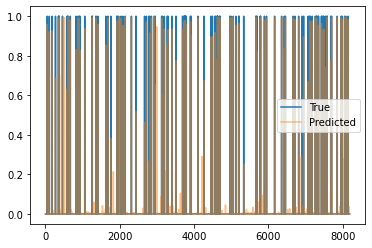

Train Epoch: 4 [10/2220 (0%)]	Loss: 0.006705	Pres: 0.920792	F1 Score: 0.911765
Train Epoch: 4 [20/2220 (0%)]	Loss: 0.005289	Pres: 0.961905	F1 Score: 0.935185
Train Epoch: 4 [30/2220 (1%)]	Loss: 0.017591	Pres: 0.859375	F1 Score: 0.647059
Train Epoch: 4 [40/2220 (1%)]	Loss: 0.007043	Pres: 0.934783	F1 Score: 0.886598
Train Epoch: 4 [50/2220 (2%)]	Loss: 0.006359	Pres: 0.936842	F1 Score: 0.881188
Train Epoch: 4 [60/2220 (2%)]	Loss: 0.004419	Pres: 0.921569	F1 Score: 0.912621
Train Epoch: 4 [70/2220 (3%)]	Loss: 0.006301	Pres: 0.827586	F1 Score: 0.883436
Train Epoch: 4 [80/2220 (3%)]	Loss: 0.004714	Pres: 0.959596	F1 Score: 0.926829
Train Epoch: 4 [90/2220 (4%)]	Loss: 0.008734	Pres: 0.896907	F1 Score: 0.874372
Train Epoch: 4 [100/2220 (4%)]	Loss: 0.004042	Pres: 0.988764	F1 Score: 0.936170
Train Epoch: 4 [110/2220 (4%)]	Loss: 0.005072	Pres: 0.934066	F1 Score: 0.928962
Train Epoch: 4 [120/2220 (5%)]	Loss: 0.004208	Pres: 0.917431	F1 Score: 0.938967
Train Epoch: 4 [130/2220 (5%)]	Loss: 0.007553	Pre

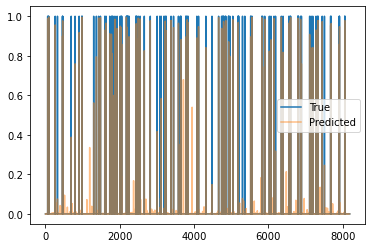

Train Epoch: 4 [310/2220 (13%)]	Loss: 0.003652	Pres: 0.950000	F1 Score: 0.966102
Train Epoch: 4 [320/2220 (14%)]	Loss: 0.006632	Pres: 0.924731	F1 Score: 0.891192
Train Epoch: 4 [330/2220 (14%)]	Loss: 0.004577	Pres: 0.892473	F1 Score: 0.917127
Train Epoch: 4 [340/2220 (15%)]	Loss: 0.006820	Pres: 0.941748	F1 Score: 0.902326
Train Epoch: 4 [350/2220 (15%)]	Loss: 0.007290	Pres: 0.829787	F1 Score: 0.866667
Train Epoch: 4 [360/2220 (16%)]	Loss: 0.004392	Pres: 0.981481	F1 Score: 0.950673
Train Epoch: 4 [370/2220 (16%)]	Loss: 0.004379	Pres: 0.909091	F1 Score: 0.909091
Train Epoch: 4 [380/2220 (17%)]	Loss: 0.007083	Pres: 0.965909	F1 Score: 0.894737
Train Epoch: 4 [390/2220 (17%)]	Loss: 0.004774	Pres: 0.968750	F1 Score: 0.939394
Train Epoch: 4 [400/2220 (18%)]	Loss: 0.005436	Pres: 0.978723	F1 Score: 0.906404
Train Epoch: 4 [410/2220 (18%)]	Loss: 0.005443	Pres: 0.909091	F1 Score: 0.886700
Train Epoch: 4 [420/2220 (18%)]	Loss: 0.006721	Pres: 0.932584	F1 Score: 0.887701
Train Epoch: 4 [430/2220 (19

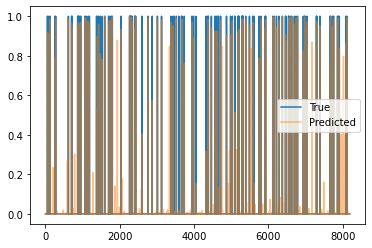

Train Epoch: 4 [610/2220 (27%)]	Loss: 0.007999	Pres: 0.956522	F1 Score: 0.880000
Train Epoch: 4 [620/2220 (27%)]	Loss: 0.007418	Pres: 0.908257	F1 Score: 0.895928
Train Epoch: 4 [630/2220 (28%)]	Loss: 0.007381	Pres: 0.927835	F1 Score: 0.900000
Train Epoch: 4 [640/2220 (28%)]	Loss: 0.005994	Pres: 0.968085	F1 Score: 0.914573
Train Epoch: 4 [650/2220 (29%)]	Loss: 0.007239	Pres: 0.904762	F1 Score: 0.894118
Train Epoch: 4 [660/2220 (29%)]	Loss: 0.005317	Pres: 0.968085	F1 Score: 0.938144
Train Epoch: 4 [670/2220 (30%)]	Loss: 0.004287	Pres: 0.915888	F1 Score: 0.933333
Train Epoch: 4 [680/2220 (30%)]	Loss: 0.004942	Pres: 0.931034	F1 Score: 0.890110
Train Epoch: 4 [690/2220 (31%)]	Loss: 0.006817	Pres: 0.904255	F1 Score: 0.871795
Train Epoch: 4 [700/2220 (31%)]	Loss: 0.005998	Pres: 0.933333	F1 Score: 0.920188
Train Epoch: 4 [710/2220 (31%)]	Loss: 0.008590	Pres: 0.872549	F1 Score: 0.890000
Train Epoch: 4 [720/2220 (32%)]	Loss: 0.004969	Pres: 0.989011	F1 Score: 0.909091
Train Epoch: 4 [730/2220 (32

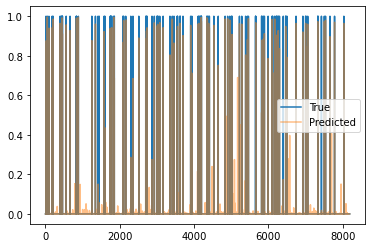

Train Epoch: 4 [910/2220 (40%)]	Loss: 0.005153	Pres: 0.955056	F1 Score: 0.899471
Train Epoch: 4 [920/2220 (41%)]	Loss: 0.004379	Pres: 0.946809	F1 Score: 0.912821
Train Epoch: 4 [930/2220 (41%)]	Loss: 0.003789	Pres: 0.958763	F1 Score: 0.958763
Train Epoch: 4 [940/2220 (42%)]	Loss: 0.003607	Pres: 0.931373	F1 Score: 0.954774
Train Epoch: 4 [950/2220 (42%)]	Loss: 0.005513	Pres: 0.913043	F1 Score: 0.888889
Train Epoch: 4 [960/2220 (43%)]	Loss: 0.005408	Pres: 0.898990	F1 Score: 0.908163
Train Epoch: 4 [970/2220 (43%)]	Loss: 0.005302	Pres: 0.915789	F1 Score: 0.896907
Train Epoch: 4 [980/2220 (44%)]	Loss: 0.005209	Pres: 0.946237	F1 Score: 0.921466
Train Epoch: 4 [990/2220 (44%)]	Loss: 0.004912	Pres: 0.970000	F1 Score: 0.937198
Train Epoch: 4 [1000/2220 (45%)]	Loss: 0.004909	Pres: 0.955556	F1 Score: 0.900524
Train Epoch: 4 [1010/2220 (45%)]	Loss: 0.008232	Pres: 0.965909	F1 Score: 0.867347
Train Epoch: 4 [1020/2220 (45%)]	Loss: 0.007855	Pres: 0.841584	F1 Score: 0.858586
Train Epoch: 4 [1030/2220

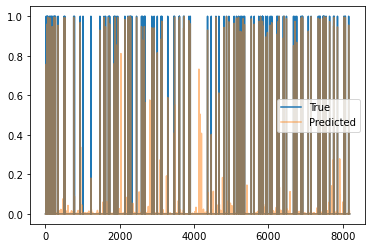

Train Epoch: 4 [1210/2220 (54%)]	Loss: 0.005288	Pres: 0.945055	F1 Score: 0.914894
Train Epoch: 4 [1220/2220 (54%)]	Loss: 0.005506	Pres: 0.885714	F1 Score: 0.907317
Train Epoch: 4 [1230/2220 (55%)]	Loss: 0.005993	Pres: 0.948980	F1 Score: 0.920792
Train Epoch: 4 [1240/2220 (55%)]	Loss: 0.004588	Pres: 0.930693	F1 Score: 0.921569
Train Epoch: 4 [1250/2220 (56%)]	Loss: 0.002660	Pres: 0.981308	F1 Score: 0.967742
Train Epoch: 4 [1260/2220 (56%)]	Loss: 0.003741	Pres: 0.971698	F1 Score: 0.944954
Train Epoch: 4 [1270/2220 (57%)]	Loss: 0.006439	Pres: 0.827957	F1 Score: 0.855556
Train Epoch: 4 [1280/2220 (57%)]	Loss: 0.006304	Pres: 0.980392	F1 Score: 0.909091
Train Epoch: 4 [1290/2220 (58%)]	Loss: 0.006225	Pres: 0.924731	F1 Score: 0.900524
Train Epoch: 4 [1300/2220 (58%)]	Loss: 0.004663	Pres: 0.920000	F1 Score: 0.906404
Train Epoch: 4 [1310/2220 (59%)]	Loss: 0.005320	Pres: 0.945455	F1 Score: 0.924444
Train Epoch: 4 [1320/2220 (59%)]	Loss: 0.003746	Pres: 0.898734	F1 Score: 0.928105
Train Epoch: 4 [

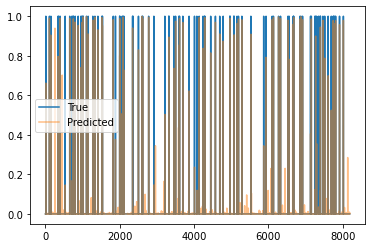

Train Epoch: 4 [1510/2220 (68%)]	Loss: 0.004850	Pres: 0.936364	F1 Score: 0.944954
Train Epoch: 4 [1520/2220 (68%)]	Loss: 0.006587	Pres: 0.955556	F1 Score: 0.905263
Train Epoch: 4 [1530/2220 (68%)]	Loss: 0.007486	Pres: 0.935185	F1 Score: 0.893805
Train Epoch: 4 [1540/2220 (69%)]	Loss: 0.006399	Pres: 1.000000	F1 Score: 0.925373
Train Epoch: 4 [1550/2220 (69%)]	Loss: 0.004872	Pres: 0.876033	F1 Score: 0.921739
Train Epoch: 4 [1560/2220 (70%)]	Loss: 0.005465	Pres: 0.966292	F1 Score: 0.934783
Train Epoch: 4 [1570/2220 (70%)]	Loss: 0.007214	Pres: 0.926606	F1 Score: 0.901786
Train Epoch: 4 [1580/2220 (71%)]	Loss: 0.006015	Pres: 0.840000	F1 Score: 0.884211
Train Epoch: 4 [1590/2220 (71%)]	Loss: 0.003757	Pres: 0.968085	F1 Score: 0.933333
Train Epoch: 4 [1600/2220 (72%)]	Loss: 0.005724	Pres: 0.864198	F1 Score: 0.869565
Train Epoch: 4 [1610/2220 (72%)]	Loss: 0.003416	Pres: 0.965217	F1 Score: 0.956897
Train Epoch: 4 [1620/2220 (72%)]	Loss: 0.007152	Pres: 0.927835	F1 Score: 0.909091
Train Epoch: 4 [

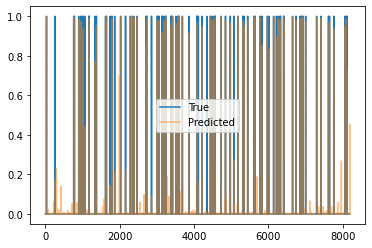

Train Epoch: 4 [1810/2220 (81%)]	Loss: 0.005991	Pres: 0.945455	F1 Score: 0.920354
Train Epoch: 4 [1820/2220 (81%)]	Loss: 0.004673	Pres: 0.938053	F1 Score: 0.921739
Train Epoch: 4 [1830/2220 (82%)]	Loss: 0.005633	Pres: 0.930233	F1 Score: 0.864865
Train Epoch: 4 [1840/2220 (82%)]	Loss: 0.006005	Pres: 0.946903	F1 Score: 0.934498
Train Epoch: 4 [1850/2220 (83%)]	Loss: 0.006538	Pres: 0.959596	F1 Score: 0.896226
Train Epoch: 4 [1860/2220 (83%)]	Loss: 0.004433	Pres: 0.917647	F1 Score: 0.928571
Train Epoch: 4 [1870/2220 (84%)]	Loss: 0.004189	Pres: 0.962963	F1 Score: 0.934132
Train Epoch: 4 [1880/2220 (84%)]	Loss: 0.019785	Pres: 0.753425	F1 Score: 0.621469
Train Epoch: 4 [1890/2220 (85%)]	Loss: 0.002777	Pres: 0.960396	F1 Score: 0.960396
Train Epoch: 4 [1900/2220 (85%)]	Loss: 0.005788	Pres: 0.934579	F1 Score: 0.913242
Train Epoch: 4 [1910/2220 (86%)]	Loss: 0.003993	Pres: 0.927083	F1 Score: 0.917526
Train Epoch: 4 [1920/2220 (86%)]	Loss: 0.005475	Pres: 0.876289	F1 Score: 0.918919
Train Epoch: 4 [

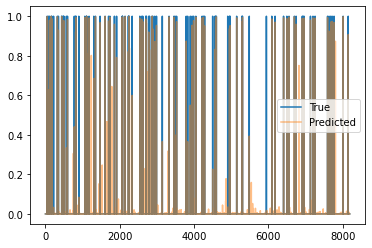

Train Epoch: 4 [2110/2220 (95%)]	Loss: 0.005388	Pres: 0.957447	F1 Score: 0.895522
Train Epoch: 4 [2120/2220 (95%)]	Loss: 0.005611	Pres: 0.950413	F1 Score: 0.934959
Train Epoch: 4 [2130/2220 (95%)]	Loss: 0.006579	Pres: 0.938144	F1 Score: 0.875000
Train Epoch: 4 [2140/2220 (96%)]	Loss: 0.003697	Pres: 0.932039	F1 Score: 0.945813
Train Epoch: 4 [2150/2220 (96%)]	Loss: 0.004352	Pres: 0.961039	F1 Score: 0.891566
Train Epoch: 4 [2160/2220 (97%)]	Loss: 0.005599	Pres: 0.956140	F1 Score: 0.943723
Train Epoch: 4 [2170/2220 (97%)]	Loss: 0.008210	Pres: 0.941748	F1 Score: 0.885845
Train Epoch: 4 [2180/2220 (98%)]	Loss: 0.005521	Pres: 0.954128	F1 Score: 0.928571
Train Epoch: 4 [2190/2220 (98%)]	Loss: 0.004315	Pres: 0.944444	F1 Score: 0.927273
Train Epoch: 4 [2200/2220 (99%)]	Loss: 0.005016	Pres: 0.963303	F1 Score: 0.933333
Train Epoch: 4 [2210/2220 (99%)]	Loss: 0.007914	Pres: 0.935484	F1 Score: 0.906250
Validation Epoch: 4 [0/582 (0%)]	Loss: 0.003214	Pres: 0.963303	F1 Score: 0.972222


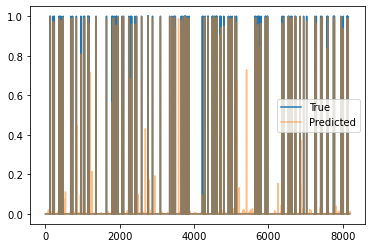

Validation Epoch: 4 [10/582 (1%)]	Loss: 0.002529	Pres: 0.931034	F1 Score: 0.964286
Validation Epoch: 4 [20/582 (3%)]	Loss: 0.002718	Pres: 0.910714	F1 Score: 0.953271
Validation Epoch: 4 [30/582 (5%)]	Loss: 0.007040	Pres: 0.879032	F1 Score: 0.915966
Validation Epoch: 4 [40/582 (6%)]	Loss: 0.002177	Pres: 0.928571	F1 Score: 0.962963
Validation Epoch: 4 [50/582 (8%)]	Loss: 0.003701	Pres: 0.935185	F1 Score: 0.957346
Validation Epoch: 4 [60/582 (10%)]	Loss: 0.002771	Pres: 0.925926	F1 Score: 0.952381
Validation Epoch: 4 [70/582 (12%)]	Loss: 0.004942	Pres: 0.924528	F1 Score: 0.946860
Validation Epoch: 4 [80/582 (13%)]	Loss: 0.003765	Pres: 0.925000	F1 Score: 0.952790
Validation Epoch: 4 [90/582 (15%)]	Loss: 0.004584	Pres: 0.930435	F1 Score: 0.946903
Validation Epoch: 4 [100/582 (17%)]	Loss: 0.004861	Pres: 0.882979	F1 Score: 0.912088
Validation Epoch: 4 [110/582 (18%)]	Loss: 0.004149	Pres: 0.921569	F1 Score: 0.944724
Validation Epoch: 4 [120/582 (20%)]	Loss: 0.003696	Pres: 0.909091	F1 Score: 0.9

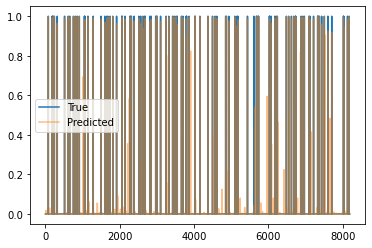

Validation Epoch: 4 [310/582 (53%)]	Loss: 0.004828	Pres: 0.913043	F1 Score: 0.945946
Validation Epoch: 4 [320/582 (54%)]	Loss: 0.002906	Pres: 0.926606	F1 Score: 0.957346
Validation Epoch: 4 [330/582 (56%)]	Loss: 0.003438	Pres: 0.961538	F1 Score: 0.966184
Validation Epoch: 4 [340/582 (58%)]	Loss: 0.002890	Pres: 0.923077	F1 Score: 0.949153
Validation Epoch: 4 [350/582 (60%)]	Loss: 0.001824	Pres: 0.954128	F1 Score: 0.976526
Validation Epoch: 4 [360/582 (61%)]	Loss: 0.004312	Pres: 0.873563	F1 Score: 0.921212
Validation Epoch: 4 [370/582 (63%)]	Loss: 0.004392	Pres: 0.891892	F1 Score: 0.929577
Validation Epoch: 4 [380/582 (65%)]	Loss: 0.004587	Pres: 0.925926	F1 Score: 0.943396
Validation Epoch: 4 [390/582 (67%)]	Loss: 0.004361	Pres: 0.927083	F1 Score: 0.936842
Validation Epoch: 4 [400/582 (68%)]	Loss: 0.004592	Pres: 0.927273	F1 Score: 0.944444
Validation Epoch: 4 [410/582 (70%)]	Loss: 0.005275	Pres: 0.843137	F1 Score: 0.895833
Validation Epoch: 4 [420/582 (72%)]	Loss: 0.004056	Pres: 0.904348

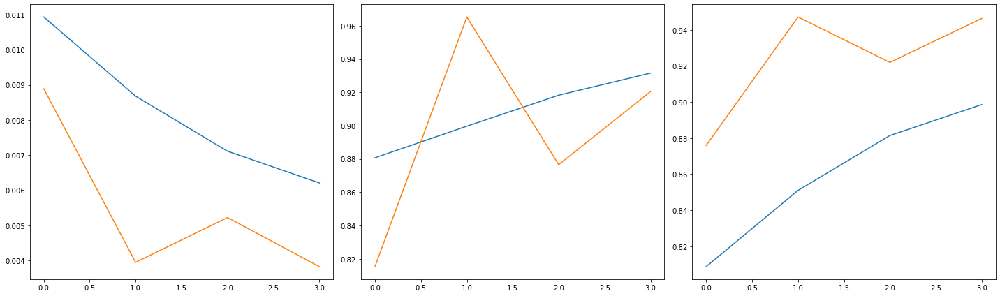

2220 582
Train Epoch: 5 [0/2220 (0%)]	Loss: 0.004892	Pres: 0.948980	F1 Score: 0.934673
101.0 -inf


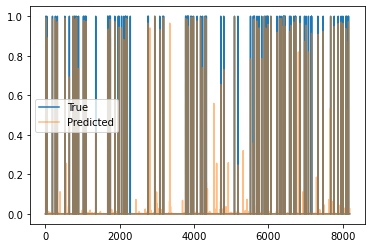

Train Epoch: 5 [10/2220 (0%)]	Loss: 0.005966	Pres: 0.951456	F1 Score: 0.890909
Train Epoch: 5 [20/2220 (0%)]	Loss: 0.005655	Pres: 0.918182	F1 Score: 0.935185
Train Epoch: 5 [30/2220 (1%)]	Loss: 0.008291	Pres: 1.000000	F1 Score: 0.887850
Train Epoch: 5 [40/2220 (1%)]	Loss: 0.006363	Pres: 0.917431	F1 Score: 0.909091
Train Epoch: 5 [50/2220 (2%)]	Loss: 0.005855	Pres: 0.922330	F1 Score: 0.892019
Train Epoch: 5 [60/2220 (2%)]	Loss: 0.004485	Pres: 0.959596	F1 Score: 0.913462
Train Epoch: 5 [70/2220 (3%)]	Loss: 0.005465	Pres: 0.980000	F1 Score: 0.942308
Train Epoch: 5 [80/2220 (3%)]	Loss: 0.019449	Pres: 0.725000	F1 Score: 0.384106
Train Epoch: 5 [90/2220 (4%)]	Loss: 0.007053	Pres: 0.915888	F1 Score: 0.911628
Train Epoch: 5 [100/2220 (4%)]	Loss: 0.005758	Pres: 0.964286	F1 Score: 0.905028
Train Epoch: 5 [110/2220 (4%)]	Loss: 0.006419	Pres: 0.894737	F1 Score: 0.918919
Train Epoch: 5 [120/2220 (5%)]	Loss: 0.007283	Pres: 0.921569	F1 Score: 0.912621
Train Epoch: 5 [130/2220 (5%)]	Loss: 0.004417	Pre

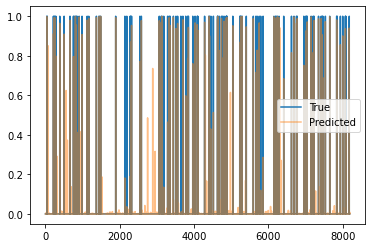

Train Epoch: 5 [310/2220 (13%)]	Loss: 0.006482	Pres: 0.908163	F1 Score: 0.894472
Train Epoch: 5 [320/2220 (14%)]	Loss: 0.004930	Pres: 0.936842	F1 Score: 0.931937
Train Epoch: 5 [330/2220 (14%)]	Loss: 0.004209	Pres: 0.952381	F1 Score: 0.935673
Train Epoch: 5 [340/2220 (15%)]	Loss: 0.004028	Pres: 0.961538	F1 Score: 0.930233
Train Epoch: 5 [350/2220 (15%)]	Loss: 0.002920	Pres: 0.951220	F1 Score: 0.939759
Train Epoch: 5 [360/2220 (16%)]	Loss: 0.005206	Pres: 0.930693	F1 Score: 0.912621
Train Epoch: 5 [370/2220 (16%)]	Loss: 0.003428	Pres: 0.951456	F1 Score: 0.942308
Train Epoch: 5 [380/2220 (17%)]	Loss: 0.004278	Pres: 0.882353	F1 Score: 0.913706
Train Epoch: 5 [390/2220 (17%)]	Loss: 0.006444	Pres: 0.966292	F1 Score: 0.900524
Train Epoch: 5 [400/2220 (18%)]	Loss: 0.006352	Pres: 0.980952	F1 Score: 0.923767
Train Epoch: 5 [410/2220 (18%)]	Loss: 0.005322	Pres: 0.990826	F1 Score: 0.915254
Train Epoch: 5 [420/2220 (18%)]	Loss: 0.006966	Pres: 0.947368	F1 Score: 0.919149
Train Epoch: 5 [430/2220 (19

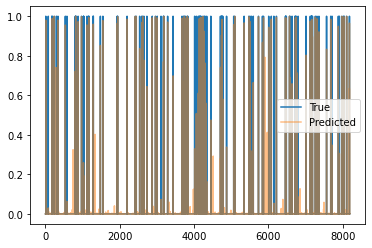

Train Epoch: 5 [610/2220 (27%)]	Loss: 0.004269	Pres: 0.941176	F1 Score: 0.932039
Train Epoch: 5 [620/2220 (27%)]	Loss: 0.005269	Pres: 0.960396	F1 Score: 0.910798
Train Epoch: 5 [630/2220 (28%)]	Loss: 0.004637	Pres: 0.981132	F1 Score: 0.954128
Train Epoch: 5 [640/2220 (28%)]	Loss: 0.004593	Pres: 0.970000	F1 Score: 0.932692
Train Epoch: 5 [650/2220 (29%)]	Loss: 0.006462	Pres: 0.887755	F1 Score: 0.910995
Train Epoch: 5 [660/2220 (29%)]	Loss: 0.005228	Pres: 0.943820	F1 Score: 0.918033
Train Epoch: 5 [670/2220 (30%)]	Loss: 0.006285	Pres: 0.937500	F1 Score: 0.895522
Train Epoch: 5 [680/2220 (30%)]	Loss: 0.004287	Pres: 0.958333	F1 Score: 0.924623
Train Epoch: 5 [690/2220 (31%)]	Loss: 0.022277	Pres: 0.880000	F1 Score: 0.571429
Train Epoch: 5 [700/2220 (31%)]	Loss: 0.003254	Pres: 0.968750	F1 Score: 0.953846
Train Epoch: 5 [710/2220 (31%)]	Loss: 0.005848	Pres: 0.951456	F1 Score: 0.937799
Train Epoch: 5 [720/2220 (32%)]	Loss: 0.004810	Pres: 0.960396	F1 Score: 0.937198
Train Epoch: 5 [730/2220 (32

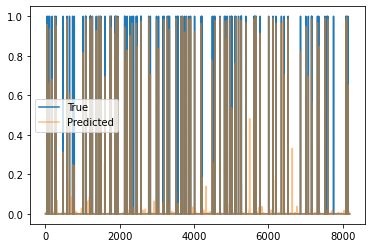

Train Epoch: 5 [910/2220 (40%)]	Loss: 0.004902	Pres: 0.955056	F1 Score: 0.909091
Train Epoch: 5 [920/2220 (41%)]	Loss: 0.005125	Pres: 0.942857	F1 Score: 0.942857
Train Epoch: 5 [930/2220 (41%)]	Loss: 0.007044	Pres: 0.931373	F1 Score: 0.904762
Train Epoch: 5 [940/2220 (42%)]	Loss: 0.004972	Pres: 0.968421	F1 Score: 0.934010
Train Epoch: 5 [950/2220 (42%)]	Loss: 0.003533	Pres: 0.970297	F1 Score: 0.965517
Train Epoch: 5 [960/2220 (43%)]	Loss: 0.007242	Pres: 0.908046	F1 Score: 0.887640
Train Epoch: 5 [970/2220 (43%)]	Loss: 0.003945	Pres: 0.970588	F1 Score: 0.951923
Train Epoch: 5 [980/2220 (44%)]	Loss: 0.004483	Pres: 0.970874	F1 Score: 0.921659
Train Epoch: 5 [990/2220 (44%)]	Loss: 0.006467	Pres: 0.989796	F1 Score: 0.915094
Train Epoch: 5 [1000/2220 (45%)]	Loss: 0.004550	Pres: 0.930693	F1 Score: 0.944724
Train Epoch: 5 [1010/2220 (45%)]	Loss: 0.006672	Pres: 1.000000	F1 Score: 0.934673
Train Epoch: 5 [1020/2220 (45%)]	Loss: 0.005539	Pres: 0.950495	F1 Score: 0.914286
Train Epoch: 5 [1030/2220

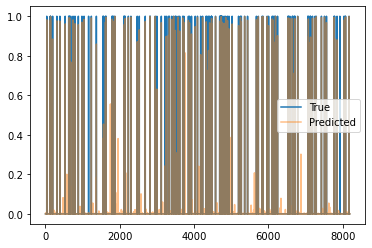

Train Epoch: 5 [1210/2220 (54%)]	Loss: 0.005884	Pres: 0.953488	F1 Score: 0.926554
Train Epoch: 5 [1220/2220 (54%)]	Loss: 0.006296	Pres: 0.978947	F1 Score: 0.920792
Train Epoch: 5 [1230/2220 (55%)]	Loss: 0.005671	Pres: 0.963964	F1 Score: 0.906780
Train Epoch: 5 [1240/2220 (55%)]	Loss: 0.007211	Pres: 0.933962	F1 Score: 0.916667
Train Epoch: 5 [1250/2220 (56%)]	Loss: 0.004485	Pres: 0.916667	F1 Score: 0.921466
Train Epoch: 5 [1260/2220 (56%)]	Loss: 0.004980	Pres: 0.938144	F1 Score: 0.933333
Train Epoch: 5 [1270/2220 (57%)]	Loss: 0.004315	Pres: 0.941748	F1 Score: 0.923810
Train Epoch: 5 [1280/2220 (57%)]	Loss: 0.006016	Pres: 0.911504	F1 Score: 0.911504
Train Epoch: 5 [1290/2220 (58%)]	Loss: 0.004459	Pres: 0.979798	F1 Score: 0.932692
Train Epoch: 5 [1300/2220 (58%)]	Loss: 0.007235	Pres: 0.896907	F1 Score: 0.892308
Train Epoch: 5 [1310/2220 (59%)]	Loss: 0.004530	Pres: 0.960784	F1 Score: 0.911628
Train Epoch: 5 [1320/2220 (59%)]	Loss: 0.007735	Pres: 0.853333	F1 Score: 0.864865
Train Epoch: 5 [

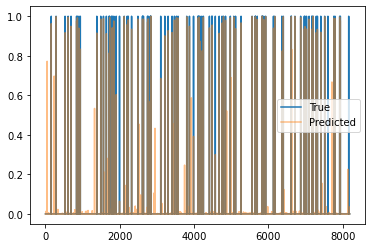

Train Epoch: 5 [1510/2220 (68%)]	Loss: 0.004933	Pres: 0.950980	F1 Score: 0.919431
Train Epoch: 5 [1520/2220 (68%)]	Loss: 0.005438	Pres: 0.948454	F1 Score: 0.924623
Train Epoch: 5 [1530/2220 (68%)]	Loss: 0.006575	Pres: 0.942308	F1 Score: 0.882883
Train Epoch: 5 [1540/2220 (69%)]	Loss: 0.004242	Pres: 0.961538	F1 Score: 0.930233
Train Epoch: 5 [1550/2220 (69%)]	Loss: 0.006891	Pres: 0.858333	F1 Score: 0.903509
Train Epoch: 5 [1560/2220 (70%)]	Loss: 0.004707	Pres: 0.976190	F1 Score: 0.916201
Train Epoch: 5 [1570/2220 (70%)]	Loss: 0.004117	Pres: 0.945652	F1 Score: 0.935484
Train Epoch: 5 [1580/2220 (71%)]	Loss: 0.002483	Pres: 0.989247	F1 Score: 0.958333
Train Epoch: 5 [1590/2220 (71%)]	Loss: 0.002754	Pres: 0.933333	F1 Score: 0.946860
Train Epoch: 5 [1600/2220 (72%)]	Loss: 0.007419	Pres: 0.918919	F1 Score: 0.902655
Train Epoch: 5 [1610/2220 (72%)]	Loss: 0.003936	Pres: 0.971154	F1 Score: 0.948357
Train Epoch: 5 [1620/2220 (72%)]	Loss: 0.004689	Pres: 0.880435	F1 Score: 0.915254
Train Epoch: 5 [

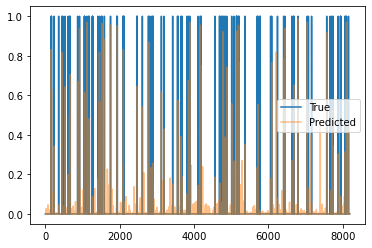

Train Epoch: 5 [1810/2220 (81%)]	Loss: 0.004096	Pres: 0.950000	F1 Score: 0.940594
Train Epoch: 5 [1820/2220 (81%)]	Loss: 0.005314	Pres: 0.964286	F1 Score: 0.931034
Train Epoch: 5 [1830/2220 (82%)]	Loss: 0.005302	Pres: 0.931034	F1 Score: 0.915254
Train Epoch: 5 [1840/2220 (82%)]	Loss: 0.005018	Pres: 1.000000	F1 Score: 0.924623
Train Epoch: 5 [1850/2220 (83%)]	Loss: 0.002790	Pres: 0.989796	F1 Score: 0.960396
Train Epoch: 5 [1860/2220 (83%)]	Loss: 0.007243	Pres: 0.920792	F1 Score: 0.902913
Train Epoch: 5 [1870/2220 (84%)]	Loss: 0.005273	Pres: 0.953271	F1 Score: 0.931507
Train Epoch: 5 [1880/2220 (84%)]	Loss: 0.003872	Pres: 0.934579	F1 Score: 0.943396
Train Epoch: 5 [1890/2220 (85%)]	Loss: 0.022915	Pres: 0.818182	F1 Score: 0.372414
Train Epoch: 5 [1900/2220 (85%)]	Loss: 0.006903	Pres: 0.938596	F1 Score: 0.906780
Train Epoch: 5 [1910/2220 (86%)]	Loss: 0.003284	Pres: 0.958333	F1 Score: 0.938776
Train Epoch: 5 [1920/2220 (86%)]	Loss: 0.005083	Pres: 0.868687	F1 Score: 0.910053
Train Epoch: 5 [

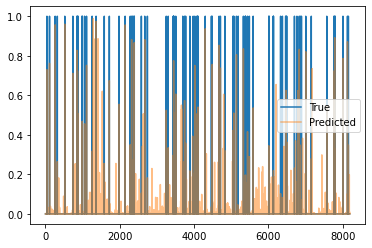

Train Epoch: 5 [2110/2220 (95%)]	Loss: 0.006240	Pres: 0.926316	F1 Score: 0.916667
Train Epoch: 5 [2120/2220 (95%)]	Loss: 0.006853	Pres: 0.958333	F1 Score: 0.929293
Train Epoch: 5 [2130/2220 (95%)]	Loss: 0.004305	Pres: 0.950000	F1 Score: 0.917874
Train Epoch: 5 [2140/2220 (96%)]	Loss: 0.005684	Pres: 0.962617	F1 Score: 0.944954
Train Epoch: 5 [2150/2220 (96%)]	Loss: 0.006100	Pres: 0.906250	F1 Score: 0.865672
Train Epoch: 5 [2160/2220 (97%)]	Loss: 0.005053	Pres: 0.979167	F1 Score: 0.903846
Train Epoch: 5 [2170/2220 (97%)]	Loss: 0.005498	Pres: 0.963303	F1 Score: 0.917031
Train Epoch: 5 [2180/2220 (98%)]	Loss: 0.005728	Pres: 0.897959	F1 Score: 0.897959
Train Epoch: 5 [2190/2220 (98%)]	Loss: 0.007226	Pres: 0.928571	F1 Score: 0.887805
Train Epoch: 5 [2200/2220 (99%)]	Loss: 0.005073	Pres: 0.931373	F1 Score: 0.913462
Train Epoch: 5 [2210/2220 (99%)]	Loss: 0.006062	Pres: 0.956044	F1 Score: 0.925532
Validation Epoch: 5 [0/582 (0%)]	Loss: 0.003986	Pres: 0.954955	F1 Score: 0.963636


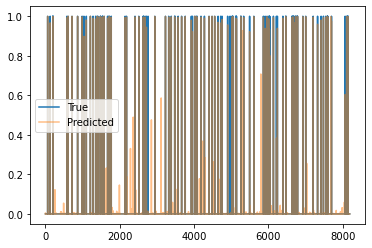

Validation Epoch: 5 [10/582 (1%)]	Loss: 0.002374	Pres: 0.947917	F1 Score: 0.968085
Validation Epoch: 5 [20/582 (3%)]	Loss: 0.003286	Pres: 0.924370	F1 Score: 0.952381
Validation Epoch: 5 [30/582 (5%)]	Loss: 0.003478	Pres: 0.952830	F1 Score: 0.952830
Validation Epoch: 5 [40/582 (6%)]	Loss: 0.002092	Pres: 0.941176	F1 Score: 0.964824
Validation Epoch: 5 [50/582 (8%)]	Loss: 0.004187	Pres: 0.907407	F1 Score: 0.933333
Validation Epoch: 5 [60/582 (10%)]	Loss: 0.004498	Pres: 0.907407	F1 Score: 0.933333
Validation Epoch: 5 [70/582 (12%)]	Loss: 0.003167	Pres: 0.963303	F1 Score: 0.963303
Validation Epoch: 5 [80/582 (13%)]	Loss: 0.004584	Pres: 0.929825	F1 Score: 0.938053
Validation Epoch: 5 [90/582 (15%)]	Loss: 0.005412	Pres: 0.886957	F1 Score: 0.931507
Validation Epoch: 5 [100/582 (17%)]	Loss: 0.005516	Pres: 0.876106	F1 Score: 0.920930
Validation Epoch: 5 [110/582 (18%)]	Loss: 0.003491	Pres: 0.959596	F1 Score: 0.959596
Validation Epoch: 5 [120/582 (20%)]	Loss: 0.004694	Pres: 0.932203	F1 Score: 0.9

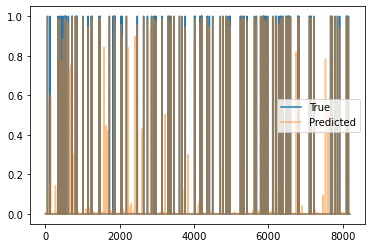

Validation Epoch: 5 [310/582 (53%)]	Loss: 0.003259	Pres: 0.954545	F1 Score: 0.958904
Validation Epoch: 5 [320/582 (54%)]	Loss: 0.004736	Pres: 0.936508	F1 Score: 0.955466
Validation Epoch: 5 [330/582 (56%)]	Loss: 0.003628	Pres: 0.956897	F1 Score: 0.961039
Validation Epoch: 5 [340/582 (58%)]	Loss: 0.004707	Pres: 0.922481	F1 Score: 0.948207
Validation Epoch: 5 [350/582 (60%)]	Loss: 0.004931	Pres: 0.913386	F1 Score: 0.939271
Validation Epoch: 5 [360/582 (61%)]	Loss: 0.004068	Pres: 0.931624	F1 Score: 0.951965
Validation Epoch: 5 [370/582 (63%)]	Loss: 0.004995	Pres: 0.940678	F1 Score: 0.948718
Validation Epoch: 5 [380/582 (65%)]	Loss: 0.002899	Pres: 0.925234	F1 Score: 0.947368
Validation Epoch: 5 [390/582 (67%)]	Loss: 0.004981	Pres: 0.904762	F1 Score: 0.931373
Validation Epoch: 5 [400/582 (68%)]	Loss: 0.004173	Pres: 0.904000	F1 Score: 0.941667
Validation Epoch: 5 [410/582 (70%)]	Loss: 0.003192	Pres: 0.943925	F1 Score: 0.961905
Validation Epoch: 5 [420/582 (72%)]	Loss: 0.003752	Pres: 0.900000

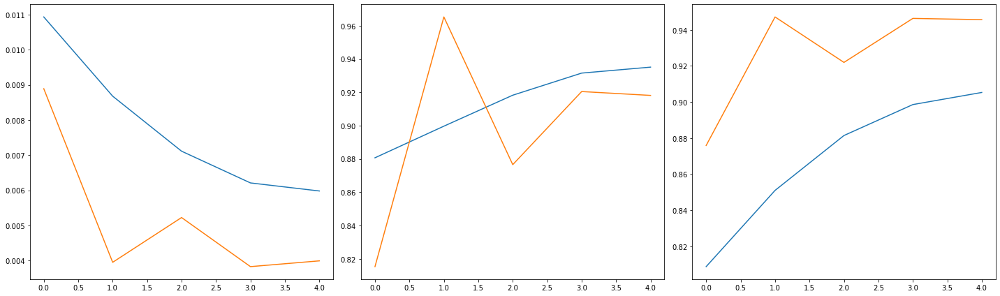

2220 582
Train Epoch: 6 [0/2220 (0%)]	Loss: 0.005461	Pres: 0.969697	F1 Score: 0.923077
109.0 -inf


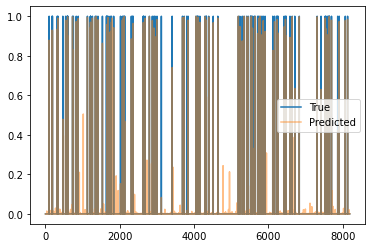

Train Epoch: 6 [10/2220 (0%)]	Loss: 0.026345	Pres: 0.717949	F1 Score: 0.380952
Train Epoch: 6 [20/2220 (0%)]	Loss: 0.006104	Pres: 0.810127	F1 Score: 0.853333
Train Epoch: 6 [30/2220 (1%)]	Loss: 0.006822	Pres: 0.967391	F1 Score: 0.908163
Train Epoch: 6 [40/2220 (1%)]	Loss: 0.007780	Pres: 0.909091	F1 Score: 0.891089
Train Epoch: 6 [50/2220 (2%)]	Loss: 0.007172	Pres: 0.978947	F1 Score: 0.894231
Train Epoch: 6 [60/2220 (2%)]	Loss: 0.004456	Pres: 0.982301	F1 Score: 0.940678
Train Epoch: 6 [70/2220 (3%)]	Loss: 0.007408	Pres: 0.943182	F1 Score: 0.878307
Train Epoch: 6 [80/2220 (3%)]	Loss: 0.006438	Pres: 0.880435	F1 Score: 0.866310
Train Epoch: 6 [90/2220 (4%)]	Loss: 0.006772	Pres: 0.894737	F1 Score: 0.871795
Train Epoch: 6 [100/2220 (4%)]	Loss: 0.005221	Pres: 0.919540	F1 Score: 0.903955
Train Epoch: 6 [110/2220 (4%)]	Loss: 0.004818	Pres: 0.946429	F1 Score: 0.933921
Train Epoch: 6 [120/2220 (5%)]	Loss: 0.007500	Pres: 0.871560	F1 Score: 0.871560
Train Epoch: 6 [130/2220 (5%)]	Loss: 0.005921	Pre

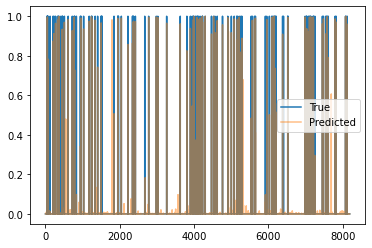

Train Epoch: 6 [310/2220 (13%)]	Loss: 0.004246	Pres: 0.959596	F1 Score: 0.931373
Train Epoch: 6 [320/2220 (14%)]	Loss: 0.008344	Pres: 0.921569	F1 Score: 0.890995
Train Epoch: 6 [330/2220 (14%)]	Loss: 0.005002	Pres: 0.956989	F1 Score: 0.931937
Train Epoch: 6 [340/2220 (15%)]	Loss: 0.006502	Pres: 0.917526	F1 Score: 0.912821
Train Epoch: 6 [350/2220 (15%)]	Loss: 0.004590	Pres: 0.909091	F1 Score: 0.923077
Train Epoch: 6 [360/2220 (16%)]	Loss: 0.008654	Pres: 0.882883	F1 Score: 0.886878
Train Epoch: 6 [370/2220 (16%)]	Loss: 0.006277	Pres: 0.976471	F1 Score: 0.873684
Train Epoch: 6 [380/2220 (17%)]	Loss: 0.006503	Pres: 0.933333	F1 Score: 0.897436
Train Epoch: 6 [390/2220 (17%)]	Loss: 0.003290	Pres: 0.965909	F1 Score: 0.939227
Train Epoch: 6 [400/2220 (18%)]	Loss: 0.005454	Pres: 0.949495	F1 Score: 0.921569
Train Epoch: 6 [410/2220 (18%)]	Loss: 0.004353	Pres: 0.933333	F1 Score: 0.913043
Train Epoch: 6 [420/2220 (18%)]	Loss: 0.006701	Pres: 0.873786	F1 Score: 0.909091
Train Epoch: 6 [430/2220 (19

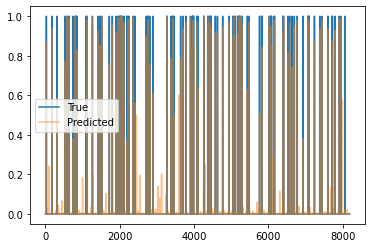

Train Epoch: 6 [610/2220 (27%)]	Loss: 0.007282	Pres: 0.953271	F1 Score: 0.918919
Train Epoch: 6 [620/2220 (27%)]	Loss: 0.006741	Pres: 0.890000	F1 Score: 0.894472
Train Epoch: 6 [630/2220 (28%)]	Loss: 0.004742	Pres: 0.944444	F1 Score: 0.904255
Train Epoch: 6 [640/2220 (28%)]	Loss: 0.004918	Pres: 0.887640	F1 Score: 0.897727
Train Epoch: 6 [650/2220 (29%)]	Loss: 0.004684	Pres: 0.956989	F1 Score: 0.931937
Train Epoch: 6 [660/2220 (29%)]	Loss: 0.007060	Pres: 0.948718	F1 Score: 0.909836
Train Epoch: 6 [670/2220 (30%)]	Loss: 0.006191	Pres: 0.836735	F1 Score: 0.886486
Train Epoch: 6 [680/2220 (30%)]	Loss: 0.005349	Pres: 0.953271	F1 Score: 0.935780
Train Epoch: 6 [690/2220 (31%)]	Loss: 0.004586	Pres: 0.950000	F1 Score: 0.946058
Train Epoch: 6 [700/2220 (31%)]	Loss: 0.006717	Pres: 0.926829	F1 Score: 0.904762
Train Epoch: 6 [710/2220 (31%)]	Loss: 0.004950	Pres: 0.965909	F1 Score: 0.939227
Train Epoch: 6 [720/2220 (32%)]	Loss: 0.005993	Pres: 0.933333	F1 Score: 0.908108
Train Epoch: 6 [730/2220 (32

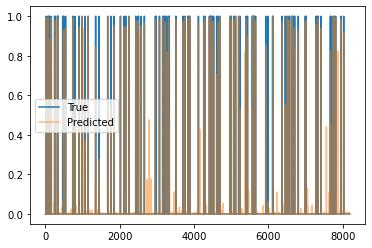

Train Epoch: 6 [910/2220 (40%)]	Loss: 0.004849	Pres: 0.940476	F1 Score: 0.918605
Train Epoch: 6 [920/2220 (41%)]	Loss: 0.005912	Pres: 0.910891	F1 Score: 0.906404
Train Epoch: 6 [930/2220 (41%)]	Loss: 0.005507	Pres: 0.957895	F1 Score: 0.943005
Train Epoch: 6 [940/2220 (42%)]	Loss: 0.004987	Pres: 0.897959	F1 Score: 0.907216
Train Epoch: 6 [950/2220 (42%)]	Loss: 0.004984	Pres: 0.923810	F1 Score: 0.919431
Train Epoch: 6 [960/2220 (43%)]	Loss: 0.006789	Pres: 0.908046	F1 Score: 0.882682
Train Epoch: 6 [970/2220 (43%)]	Loss: 0.008783	Pres: 0.888889	F1 Score: 0.876712
Train Epoch: 6 [980/2220 (44%)]	Loss: 0.005907	Pres: 0.932584	F1 Score: 0.912088
Train Epoch: 6 [990/2220 (44%)]	Loss: 0.006093	Pres: 0.880435	F1 Score: 0.900000
Train Epoch: 6 [1000/2220 (45%)]	Loss: 0.004645	Pres: 0.989796	F1 Score: 0.937198
Train Epoch: 6 [1010/2220 (45%)]	Loss: 0.006217	Pres: 0.941667	F1 Score: 0.937759
Train Epoch: 6 [1020/2220 (45%)]	Loss: 0.006256	Pres: 0.965217	F1 Score: 0.928870
Train Epoch: 6 [1030/2220

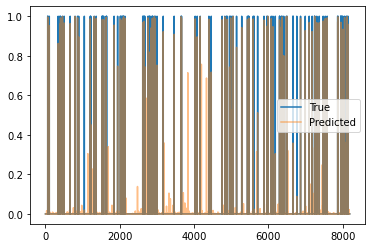

Train Epoch: 6 [1210/2220 (54%)]	Loss: 0.004540	Pres: 0.941176	F1 Score: 0.924855
Train Epoch: 6 [1220/2220 (54%)]	Loss: 0.006362	Pres: 0.978022	F1 Score: 0.903553
Train Epoch: 6 [1230/2220 (55%)]	Loss: 0.006889	Pres: 0.954955	F1 Score: 0.925764
Train Epoch: 6 [1240/2220 (55%)]	Loss: 0.022018	Pres: 0.692308	F1 Score: 0.496552
Train Epoch: 6 [1250/2220 (56%)]	Loss: 0.006398	Pres: 0.978947	F1 Score: 0.920792
Train Epoch: 6 [1260/2220 (56%)]	Loss: 0.004711	Pres: 0.913978	F1 Score: 0.909091
Train Epoch: 6 [1270/2220 (57%)]	Loss: 0.005703	Pres: 0.951456	F1 Score: 0.911628
Train Epoch: 6 [1280/2220 (57%)]	Loss: 0.005769	Pres: 0.910000	F1 Score: 0.896552
Train Epoch: 6 [1290/2220 (58%)]	Loss: 0.006682	Pres: 0.871560	F1 Score: 0.904762
Train Epoch: 6 [1300/2220 (58%)]	Loss: 0.007636	Pres: 0.968750	F1 Score: 0.902913
Train Epoch: 6 [1310/2220 (59%)]	Loss: 0.005216	Pres: 0.902439	F1 Score: 0.917355
Train Epoch: 6 [1320/2220 (59%)]	Loss: 0.006724	Pres: 0.925532	F1 Score: 0.887755
Train Epoch: 6 [

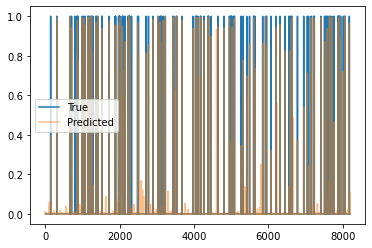

Train Epoch: 6 [1510/2220 (68%)]	Loss: 0.005634	Pres: 0.936842	F1 Score: 0.898990
Train Epoch: 6 [1520/2220 (68%)]	Loss: 0.007919	Pres: 0.932692	F1 Score: 0.877828
Train Epoch: 6 [1530/2220 (68%)]	Loss: 0.007178	Pres: 0.924528	F1 Score: 0.907407
Train Epoch: 6 [1540/2220 (69%)]	Loss: 0.006499	Pres: 0.943820	F1 Score: 0.898396
Train Epoch: 6 [1550/2220 (69%)]	Loss: 0.005207	Pres: 0.875000	F1 Score: 0.906475
Train Epoch: 6 [1560/2220 (70%)]	Loss: 0.005268	Pres: 0.947917	F1 Score: 0.914573
Train Epoch: 6 [1570/2220 (70%)]	Loss: 0.006556	Pres: 0.933962	F1 Score: 0.880000
Train Epoch: 6 [1580/2220 (71%)]	Loss: 0.006605	Pres: 0.979798	F1 Score: 0.898148
Train Epoch: 6 [1590/2220 (71%)]	Loss: 0.006851	Pres: 0.895833	F1 Score: 0.905263
Train Epoch: 6 [1600/2220 (72%)]	Loss: 0.020740	Pres: 0.738462	F1 Score: 0.539326
Train Epoch: 6 [1610/2220 (72%)]	Loss: 0.005585	Pres: 0.927835	F1 Score: 0.913706
Train Epoch: 6 [1620/2220 (72%)]	Loss: 0.007518	Pres: 0.940476	F1 Score: 0.887640
Train Epoch: 6 [

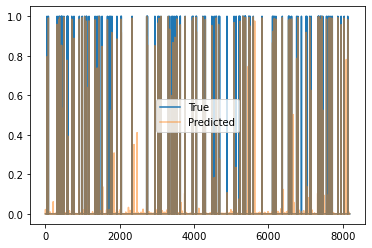

Train Epoch: 6 [1810/2220 (81%)]	Loss: 0.007241	Pres: 0.928571	F1 Score: 0.905473
Train Epoch: 6 [1820/2220 (81%)]	Loss: 0.005286	Pres: 0.908046	F1 Score: 0.913295
Train Epoch: 6 [1830/2220 (82%)]	Loss: 0.005653	Pres: 0.965517	F1 Score: 0.908108
Train Epoch: 6 [1840/2220 (82%)]	Loss: 0.007147	Pres: 0.865979	F1 Score: 0.903226
Train Epoch: 6 [1850/2220 (83%)]	Loss: 0.009111	Pres: 0.965116	F1 Score: 0.851282
Train Epoch: 6 [1860/2220 (83%)]	Loss: 0.005541	Pres: 0.928571	F1 Score: 0.919192
Train Epoch: 6 [1870/2220 (84%)]	Loss: 0.007380	Pres: 0.935484	F1 Score: 0.892308
Train Epoch: 6 [1880/2220 (84%)]	Loss: 0.004956	Pres: 0.907216	F1 Score: 0.921466
Train Epoch: 6 [1890/2220 (85%)]	Loss: 0.004441	Pres: 0.929293	F1 Score: 0.920000
Train Epoch: 6 [1900/2220 (85%)]	Loss: 0.006123	Pres: 0.946809	F1 Score: 0.912821
Train Epoch: 6 [1910/2220 (86%)]	Loss: 0.004296	Pres: 0.941176	F1 Score: 0.941176
Train Epoch: 6 [1920/2220 (86%)]	Loss: 0.006183	Pres: 0.949495	F1 Score: 0.921569
Train Epoch: 6 [

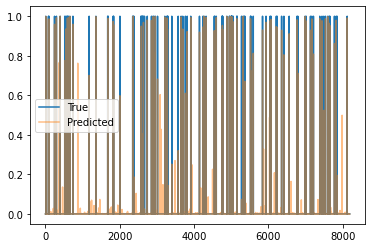

Train Epoch: 6 [2110/2220 (95%)]	Loss: 0.007491	Pres: 0.961538	F1 Score: 0.887574
Train Epoch: 6 [2120/2220 (95%)]	Loss: 0.004552	Pres: 0.949495	F1 Score: 0.917073
Train Epoch: 6 [2130/2220 (95%)]	Loss: 0.005342	Pres: 0.969072	F1 Score: 0.917073
Train Epoch: 6 [2140/2220 (96%)]	Loss: 0.006929	Pres: 0.947917	F1 Score: 0.905473
Train Epoch: 6 [2150/2220 (96%)]	Loss: 0.006278	Pres: 0.925234	F1 Score: 0.920930
Train Epoch: 6 [2160/2220 (97%)]	Loss: 0.004880	Pres: 0.883495	F1 Score: 0.910000
Train Epoch: 6 [2170/2220 (97%)]	Loss: 0.008114	Pres: 0.944444	F1 Score: 0.904255
Train Epoch: 6 [2180/2220 (98%)]	Loss: 0.006419	Pres: 0.940594	F1 Score: 0.922330
Train Epoch: 6 [2190/2220 (98%)]	Loss: 0.005935	Pres: 0.922330	F1 Score: 0.917874
Train Epoch: 6 [2200/2220 (99%)]	Loss: 0.004701	Pres: 0.943182	F1 Score: 0.922222
Train Epoch: 6 [2210/2220 (99%)]	Loss: 0.006711	Pres: 0.960784	F1 Score: 0.915888
Validation Epoch: 6 [0/582 (0%)]	Loss: 0.003784	Pres: 0.947368	F1 Score: 0.955752


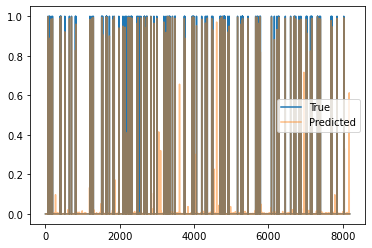

Validation Epoch: 6 [10/582 (1%)]	Loss: 0.005332	Pres: 0.959184	F1 Score: 0.944724
Validation Epoch: 6 [20/582 (3%)]	Loss: 0.002403	Pres: 0.962963	F1 Score: 0.967442
Validation Epoch: 6 [30/582 (5%)]	Loss: 0.002216	Pres: 0.982143	F1 Score: 0.977778
Validation Epoch: 6 [40/582 (6%)]	Loss: 0.004487	Pres: 0.949153	F1 Score: 0.961373
Validation Epoch: 6 [50/582 (8%)]	Loss: 0.002790	Pres: 0.957627	F1 Score: 0.965812
Validation Epoch: 6 [60/582 (10%)]	Loss: 0.003180	Pres: 0.947368	F1 Score: 0.964286
Validation Epoch: 6 [70/582 (12%)]	Loss: 0.002624	Pres: 0.979381	F1 Score: 0.974359
Validation Epoch: 6 [80/582 (13%)]	Loss: 0.004541	Pres: 0.925234	F1 Score: 0.942857
Validation Epoch: 6 [90/582 (15%)]	Loss: 0.002380	Pres: 0.962264	F1 Score: 0.966825
Validation Epoch: 6 [100/582 (17%)]	Loss: 0.002121	Pres: 0.956522	F1 Score: 0.967033
Validation Epoch: 6 [110/582 (18%)]	Loss: 0.003206	Pres: 0.989247	F1 Score: 0.968421
Validation Epoch: 6 [120/582 (20%)]	Loss: 0.004069	Pres: 0.935780	F1 Score: 0.9

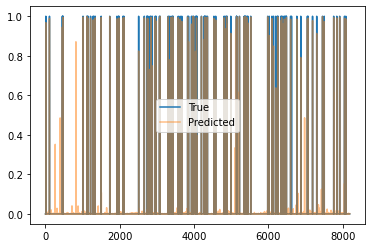

Validation Epoch: 6 [310/582 (53%)]	Loss: 0.001971	Pres: 0.930233	F1 Score: 0.963855
Validation Epoch: 6 [320/582 (54%)]	Loss: 0.002776	Pres: 0.961905	F1 Score: 0.961905
Validation Epoch: 6 [330/582 (56%)]	Loss: 0.004664	Pres: 0.972477	F1 Score: 0.963636
Validation Epoch: 6 [340/582 (58%)]	Loss: 0.002925	Pres: 0.972477	F1 Score: 0.976959
Validation Epoch: 6 [350/582 (60%)]	Loss: 0.004206	Pres: 0.919643	F1 Score: 0.944954
Validation Epoch: 6 [360/582 (61%)]	Loss: 0.002563	Pres: 0.946237	F1 Score: 0.967033
Validation Epoch: 6 [370/582 (63%)]	Loss: 0.003403	Pres: 0.947368	F1 Score: 0.967742
Validation Epoch: 6 [380/582 (65%)]	Loss: 0.001784	Pres: 0.971698	F1 Score: 0.980952
Validation Epoch: 6 [390/582 (67%)]	Loss: 0.002257	Pres: 0.980392	F1 Score: 0.975610
Validation Epoch: 6 [400/582 (68%)]	Loss: 0.002701	Pres: 0.941860	F1 Score: 0.952941
Validation Epoch: 6 [410/582 (70%)]	Loss: 0.004058	Pres: 0.980769	F1 Score: 0.962264
Validation Epoch: 6 [420/582 (72%)]	Loss: 0.002843	Pres: 0.925532

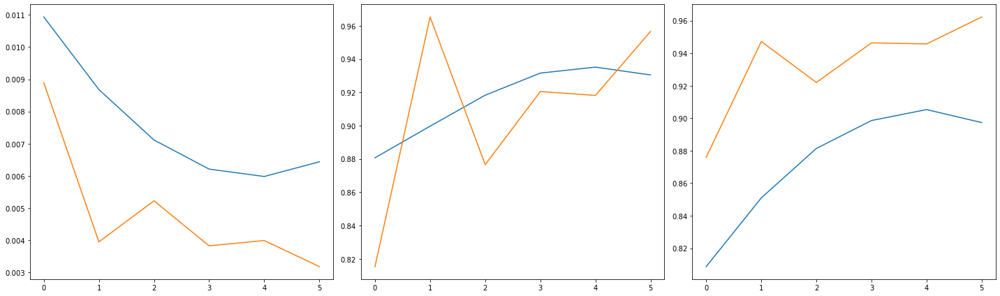

2220 582
Train Epoch: 7 [0/2220 (0%)]	Loss: 0.004405	Pres: 0.931034	F1 Score: 0.905028
92.0 -inf


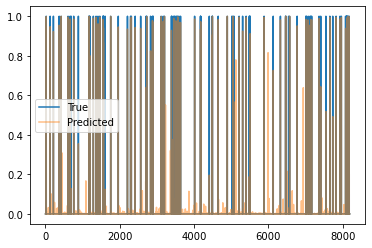

Train Epoch: 7 [10/2220 (0%)]	Loss: 0.007055	Pres: 0.920000	F1 Score: 0.831325
Train Epoch: 7 [20/2220 (0%)]	Loss: 0.005242	Pres: 0.950980	F1 Score: 0.910798
Train Epoch: 7 [30/2220 (1%)]	Loss: 0.007337	Pres: 0.963303	F1 Score: 0.913043
Train Epoch: 7 [40/2220 (1%)]	Loss: 0.006531	Pres: 0.927083	F1 Score: 0.927083
Train Epoch: 7 [50/2220 (2%)]	Loss: 0.017081	Pres: 0.833333	F1 Score: 0.628931
Train Epoch: 7 [60/2220 (2%)]	Loss: 0.003729	Pres: 0.946809	F1 Score: 0.951872
Train Epoch: 7 [70/2220 (3%)]	Loss: 0.004675	Pres: 0.952381	F1 Score: 0.909091
Train Epoch: 7 [80/2220 (3%)]	Loss: 0.008356	Pres: 0.897959	F1 Score: 0.884422
Train Epoch: 7 [90/2220 (4%)]	Loss: 0.007613	Pres: 0.862385	F1 Score: 0.866359
Train Epoch: 7 [100/2220 (4%)]	Loss: 0.003268	Pres: 0.949495	F1 Score: 0.969072
Train Epoch: 7 [110/2220 (4%)]	Loss: 0.004240	Pres: 0.928571	F1 Score: 0.928571
Train Epoch: 7 [120/2220 (5%)]	Loss: 0.003963	Pres: 0.965217	F1 Score: 0.944681
Train Epoch: 7 [130/2220 (5%)]	Loss: 0.005266	Pre

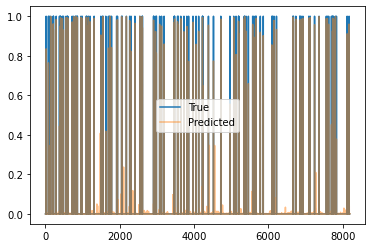

Train Epoch: 7 [310/2220 (13%)]	Loss: 0.005521	Pres: 0.945055	F1 Score: 0.905263
Train Epoch: 7 [320/2220 (14%)]	Loss: 0.004788	Pres: 0.924731	F1 Score: 0.924731
Train Epoch: 7 [330/2220 (14%)]	Loss: 0.006807	Pres: 0.881720	F1 Score: 0.886486
Train Epoch: 7 [340/2220 (15%)]	Loss: 0.007802	Pres: 0.908163	F1 Score: 0.894472
Train Epoch: 7 [350/2220 (15%)]	Loss: 0.006273	Pres: 0.961538	F1 Score: 0.896861
Train Epoch: 7 [360/2220 (16%)]	Loss: 0.004020	Pres: 0.950495	F1 Score: 0.936585
Train Epoch: 7 [370/2220 (16%)]	Loss: 0.005119	Pres: 0.931373	F1 Score: 0.935961
Train Epoch: 7 [380/2220 (17%)]	Loss: 0.002946	Pres: 0.948454	F1 Score: 0.948454
Train Epoch: 7 [390/2220 (17%)]	Loss: 0.008096	Pres: 0.978947	F1 Score: 0.898551
Train Epoch: 7 [400/2220 (18%)]	Loss: 0.007976	Pres: 0.940678	F1 Score: 0.902439
Train Epoch: 7 [410/2220 (18%)]	Loss: 0.004292	Pres: 0.931034	F1 Score: 0.900000
Train Epoch: 7 [420/2220 (18%)]	Loss: 0.003522	Pres: 0.958333	F1 Score: 0.943590
Train Epoch: 7 [430/2220 (19

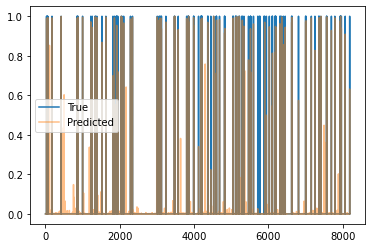

Train Epoch: 7 [610/2220 (27%)]	Loss: 0.008901	Pres: 0.923077	F1 Score: 0.884793
Train Epoch: 7 [620/2220 (27%)]	Loss: 0.005138	Pres: 0.903226	F1 Score: 0.898396
Train Epoch: 7 [630/2220 (28%)]	Loss: 0.005360	Pres: 0.961538	F1 Score: 0.925926
Train Epoch: 7 [640/2220 (28%)]	Loss: 0.005287	Pres: 0.924528	F1 Score: 0.937799
Train Epoch: 7 [650/2220 (29%)]	Loss: 0.005130	Pres: 0.990476	F1 Score: 0.932735
Train Epoch: 7 [660/2220 (29%)]	Loss: 0.005512	Pres: 0.959184	F1 Score: 0.917073
Train Epoch: 7 [670/2220 (30%)]	Loss: 0.005258	Pres: 0.943925	F1 Score: 0.943925
Train Epoch: 7 [680/2220 (30%)]	Loss: 0.008466	Pres: 0.956989	F1 Score: 0.885572
Train Epoch: 7 [690/2220 (31%)]	Loss: 0.005869	Pres: 0.950000	F1 Score: 0.926829
Train Epoch: 7 [700/2220 (31%)]	Loss: 0.007771	Pres: 0.877049	F1 Score: 0.910638
Train Epoch: 7 [710/2220 (31%)]	Loss: 0.003857	Pres: 0.962617	F1 Score: 0.953704
Train Epoch: 7 [720/2220 (32%)]	Loss: 0.004794	Pres: 0.958763	F1 Score: 0.930000
Train Epoch: 7 [730/2220 (32

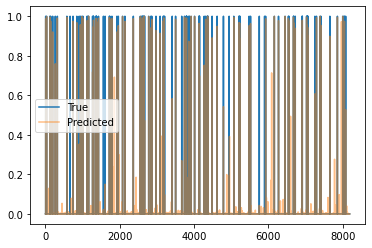

Train Epoch: 7 [910/2220 (40%)]	Loss: 0.004534	Pres: 0.963636	F1 Score: 0.938053
Train Epoch: 7 [920/2220 (41%)]	Loss: 0.004228	Pres: 0.941860	F1 Score: 0.931034
Train Epoch: 7 [930/2220 (41%)]	Loss: 0.006618	Pres: 0.956522	F1 Score: 0.907216
Train Epoch: 7 [940/2220 (42%)]	Loss: 0.003498	Pres: 0.958763	F1 Score: 0.948980
Train Epoch: 7 [950/2220 (42%)]	Loss: 0.004626	Pres: 0.959184	F1 Score: 0.944724
Train Epoch: 7 [960/2220 (43%)]	Loss: 0.007808	Pres: 0.919540	F1 Score: 0.874317
Train Epoch: 7 [970/2220 (43%)]	Loss: 0.005112	Pres: 0.970000	F1 Score: 0.941748
Train Epoch: 7 [980/2220 (44%)]	Loss: 0.004796	Pres: 0.979381	F1 Score: 0.926829
Train Epoch: 7 [990/2220 (44%)]	Loss: 0.007264	Pres: 0.926316	F1 Score: 0.893401
Train Epoch: 7 [1000/2220 (45%)]	Loss: 0.003434	Pres: 0.947917	F1 Score: 0.933333
Train Epoch: 7 [1010/2220 (45%)]	Loss: 0.005900	Pres: 0.948454	F1 Score: 0.915423
Train Epoch: 7 [1020/2220 (45%)]	Loss: 0.008626	Pres: 0.959184	F1 Score: 0.858447
Train Epoch: 7 [1030/2220

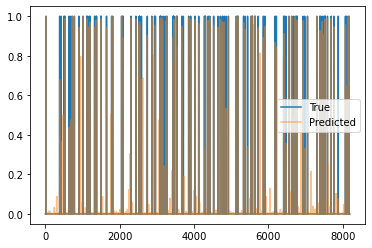

Train Epoch: 7 [1210/2220 (54%)]	Loss: 0.005548	Pres: 0.934783	F1 Score: 0.891192
Train Epoch: 7 [1220/2220 (54%)]	Loss: 0.004064	Pres: 0.965517	F1 Score: 0.943820
Train Epoch: 7 [1230/2220 (55%)]	Loss: 0.006991	Pres: 0.896907	F1 Score: 0.878788
Train Epoch: 7 [1240/2220 (55%)]	Loss: 0.003594	Pres: 0.936842	F1 Score: 0.936842
Train Epoch: 7 [1250/2220 (56%)]	Loss: 0.008166	Pres: 0.920792	F1 Score: 0.873239
Train Epoch: 7 [1260/2220 (56%)]	Loss: 0.004343	Pres: 0.978022	F1 Score: 0.946809
Train Epoch: 7 [1270/2220 (57%)]	Loss: 0.006581	Pres: 0.951456	F1 Score: 0.911628
Train Epoch: 7 [1280/2220 (57%)]	Loss: 0.005893	Pres: 0.933333	F1 Score: 0.888889
Train Epoch: 7 [1290/2220 (58%)]	Loss: 0.008800	Pres: 0.925926	F1 Score: 0.896861
Train Epoch: 7 [1300/2220 (58%)]	Loss: 0.005330	Pres: 0.912088	F1 Score: 0.922222
Train Epoch: 7 [1310/2220 (59%)]	Loss: 0.006494	Pres: 0.961905	F1 Score: 0.905830
Train Epoch: 7 [1320/2220 (59%)]	Loss: 0.004939	Pres: 0.941176	F1 Score: 0.936585
Train Epoch: 7 [

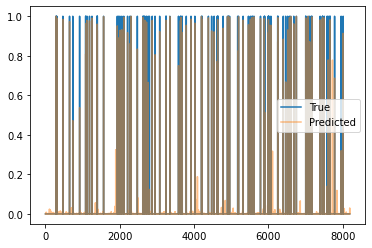

Train Epoch: 7 [1510/2220 (68%)]	Loss: 0.003979	Pres: 0.927835	F1 Score: 0.923077
Train Epoch: 7 [1520/2220 (68%)]	Loss: 0.004419	Pres: 0.956044	F1 Score: 0.935484
Train Epoch: 7 [1530/2220 (68%)]	Loss: 0.004678	Pres: 0.940171	F1 Score: 0.928270
Train Epoch: 7 [1540/2220 (69%)]	Loss: 0.005486	Pres: 0.990196	F1 Score: 0.943925
Train Epoch: 7 [1550/2220 (69%)]	Loss: 0.004492	Pres: 0.902174	F1 Score: 0.897297
Train Epoch: 7 [1560/2220 (70%)]	Loss: 0.006628	Pres: 0.968085	F1 Score: 0.919192
Train Epoch: 7 [1570/2220 (70%)]	Loss: 0.005463	Pres: 0.973214	F1 Score: 0.915966
Train Epoch: 7 [1580/2220 (71%)]	Loss: 0.006788	Pres: 0.968750	F1 Score: 0.902913
Train Epoch: 7 [1590/2220 (71%)]	Loss: 0.005086	Pres: 0.901961	F1 Score: 0.910891
Train Epoch: 7 [1600/2220 (72%)]	Loss: 0.004572	Pres: 0.980583	F1 Score: 0.943925
Train Epoch: 7 [1610/2220 (72%)]	Loss: 0.006965	Pres: 0.920792	F1 Score: 0.902913
Train Epoch: 7 [1620/2220 (72%)]	Loss: 0.004489	Pres: 0.978947	F1 Score: 0.930000
Train Epoch: 7 [

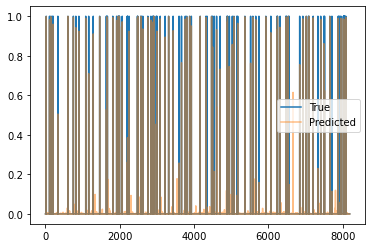

Train Epoch: 7 [1810/2220 (81%)]	Loss: 0.021406	Pres: 0.723077	F1 Score: 0.576687
Train Epoch: 7 [1820/2220 (81%)]	Loss: 0.007238	Pres: 0.988636	F1 Score: 0.910995
Train Epoch: 7 [1830/2220 (82%)]	Loss: 0.005745	Pres: 0.941748	F1 Score: 0.910798
Train Epoch: 7 [1840/2220 (82%)]	Loss: 0.008324	Pres: 0.904255	F1 Score: 0.880829
Train Epoch: 7 [1850/2220 (83%)]	Loss: 0.003825	Pres: 0.989583	F1 Score: 0.954774
Train Epoch: 7 [1860/2220 (83%)]	Loss: 0.004768	Pres: 0.958333	F1 Score: 0.924623
Train Epoch: 7 [1870/2220 (84%)]	Loss: 0.004805	Pres: 0.907216	F1 Score: 0.921466
Train Epoch: 7 [1880/2220 (84%)]	Loss: 0.004326	Pres: 0.946237	F1 Score: 0.941176
Train Epoch: 7 [1890/2220 (85%)]	Loss: 0.007196	Pres: 0.932692	F1 Score: 0.902326
Train Epoch: 7 [1900/2220 (85%)]	Loss: 0.007158	Pres: 0.959596	F1 Score: 0.900474
Train Epoch: 7 [1910/2220 (86%)]	Loss: 0.006616	Pres: 0.886364	F1 Score: 0.901734
Train Epoch: 7 [1920/2220 (86%)]	Loss: 0.004112	Pres: 0.971429	F1 Score: 0.944444
Train Epoch: 7 [

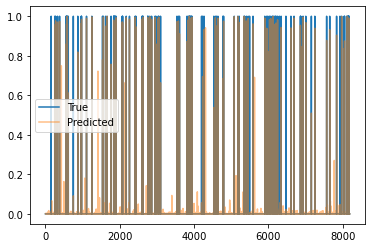

Train Epoch: 7 [2110/2220 (95%)]	Loss: 0.006100	Pres: 0.954023	F1 Score: 0.897297
Train Epoch: 7 [2120/2220 (95%)]	Loss: 0.008412	Pres: 0.891892	F1 Score: 0.895928
Train Epoch: 7 [2130/2220 (95%)]	Loss: 0.005222	Pres: 0.922330	F1 Score: 0.931373
Train Epoch: 7 [2140/2220 (96%)]	Loss: 0.006366	Pres: 0.910891	F1 Score: 0.897561
Train Epoch: 7 [2150/2220 (96%)]	Loss: 0.006303	Pres: 0.928571	F1 Score: 0.900990
Train Epoch: 7 [2160/2220 (97%)]	Loss: 0.006468	Pres: 0.920000	F1 Score: 0.876190
Train Epoch: 7 [2170/2220 (97%)]	Loss: 0.004516	Pres: 0.940000	F1 Score: 0.930693
Train Epoch: 7 [2180/2220 (98%)]	Loss: 0.005507	Pres: 0.979167	F1 Score: 0.912621
Train Epoch: 7 [2190/2220 (98%)]	Loss: 0.007782	Pres: 0.893204	F1 Score: 0.876190
Train Epoch: 7 [2200/2220 (99%)]	Loss: 0.007283	Pres: 0.956522	F1 Score: 0.911917
Train Epoch: 7 [2210/2220 (99%)]	Loss: 0.005163	Pres: 0.944444	F1 Score: 0.923077
Validation Epoch: 7 [0/582 (0%)]	Loss: 0.002301	Pres: 0.955752	F1 Score: 0.968610


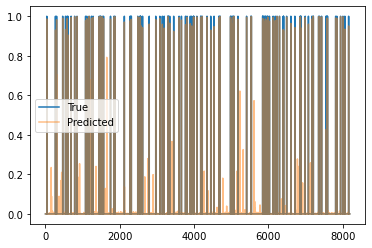

Validation Epoch: 7 [10/582 (1%)]	Loss: 0.002122	Pres: 0.979798	F1 Score: 0.979798
Validation Epoch: 7 [20/582 (3%)]	Loss: 0.001998	Pres: 0.960396	F1 Score: 0.974874
Validation Epoch: 7 [30/582 (5%)]	Loss: 0.004703	Pres: 0.941667	F1 Score: 0.941667
Validation Epoch: 7 [40/582 (6%)]	Loss: 0.003214	Pres: 0.964706	F1 Score: 0.959064
Validation Epoch: 7 [50/582 (8%)]	Loss: 0.002285	Pres: 0.967391	F1 Score: 0.978022
Validation Epoch: 7 [60/582 (10%)]	Loss: 0.002784	Pres: 0.935185	F1 Score: 0.961905
Validation Epoch: 7 [70/582 (12%)]	Loss: 0.003821	Pres: 0.933333	F1 Score: 0.954545
Validation Epoch: 7 [80/582 (13%)]	Loss: 0.003035	Pres: 0.961905	F1 Score: 0.957346
Validation Epoch: 7 [90/582 (15%)]	Loss: 0.002460	Pres: 0.957627	F1 Score: 0.969957
Validation Epoch: 7 [100/582 (17%)]	Loss: 0.003369	Pres: 0.919192	F1 Score: 0.947917
Validation Epoch: 7 [110/582 (18%)]	Loss: 0.003464	Pres: 0.955556	F1 Score: 0.960894
Validation Epoch: 7 [120/582 (20%)]	Loss: 0.004269	Pres: 0.974576	F1 Score: 0.9

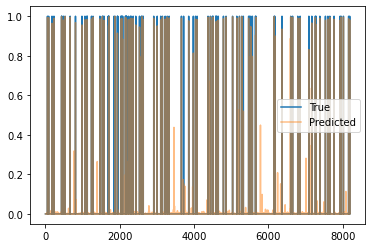

Validation Epoch: 7 [310/582 (53%)]	Loss: 0.001941	Pres: 0.990909	F1 Score: 0.990909
Validation Epoch: 7 [320/582 (54%)]	Loss: 0.002284	Pres: 0.942857	F1 Score: 0.970588
Validation Epoch: 7 [330/582 (56%)]	Loss: 0.004100	Pres: 0.940678	F1 Score: 0.952790
Validation Epoch: 7 [340/582 (58%)]	Loss: 0.002342	Pres: 0.970874	F1 Score: 0.980392
Validation Epoch: 7 [350/582 (60%)]	Loss: 0.002335	Pres: 0.980198	F1 Score: 0.985075
Validation Epoch: 7 [360/582 (61%)]	Loss: 0.003491	Pres: 0.927419	F1 Score: 0.954357
Validation Epoch: 7 [370/582 (63%)]	Loss: 0.002425	Pres: 0.960784	F1 Score: 0.970297
Validation Epoch: 7 [380/582 (65%)]	Loss: 0.003221	Pres: 0.979798	F1 Score: 0.965174
Validation Epoch: 7 [390/582 (67%)]	Loss: 0.002138	Pres: 0.974138	F1 Score: 0.978355
Validation Epoch: 7 [400/582 (68%)]	Loss: 0.004427	Pres: 0.953488	F1 Score: 0.968504
Validation Epoch: 7 [410/582 (70%)]	Loss: 0.005045	Pres: 0.938596	F1 Score: 0.955357
Validation Epoch: 7 [420/582 (72%)]	Loss: 0.004059	Pres: 0.946903

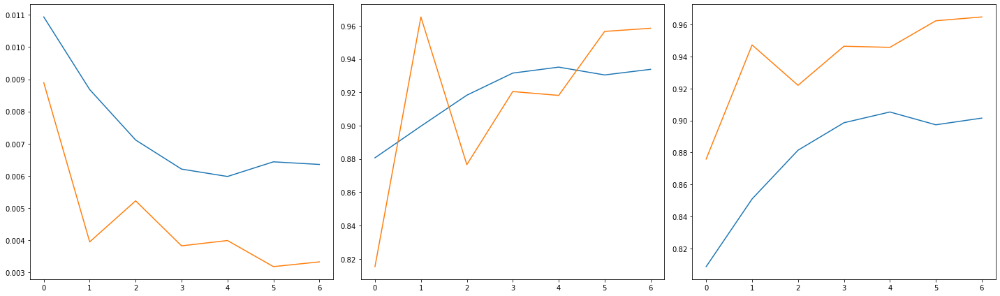

2220 582
Train Epoch: 8 [0/2220 (0%)]	Loss: 0.006467	Pres: 0.947917	F1 Score: 0.919192
102.0 -inf


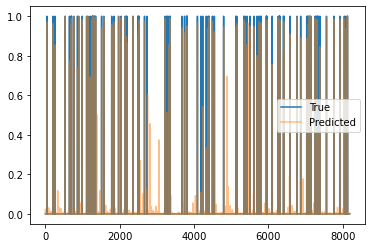

Train Epoch: 8 [10/2220 (0%)]	Loss: 0.006618	Pres: 0.920792	F1 Score: 0.902913
Train Epoch: 8 [20/2220 (0%)]	Loss: 0.004087	Pres: 0.969072	F1 Score: 0.940000
Train Epoch: 8 [30/2220 (1%)]	Loss: 0.004701	Pres: 0.955556	F1 Score: 0.919786
Train Epoch: 8 [40/2220 (1%)]	Loss: 0.003656	Pres: 0.970000	F1 Score: 0.941748
Train Epoch: 8 [50/2220 (2%)]	Loss: 0.005313	Pres: 0.930000	F1 Score: 0.925373
Train Epoch: 8 [60/2220 (2%)]	Loss: 0.006114	Pres: 0.933333	F1 Score: 0.913043
Train Epoch: 8 [70/2220 (3%)]	Loss: 0.004874	Pres: 0.975610	F1 Score: 0.903955
Train Epoch: 8 [80/2220 (3%)]	Loss: 0.006705	Pres: 0.968750	F1 Score: 0.898551


KeyboardInterrupt: 

In [12]:
# 0.2 ids, 160 dist, average='binary'
trainer.train(debug=False)

began training
2220 582
Train Epoch: 0 [0/2220 (0%)]	Loss: 0.676514	Pres: 0.988770	F1 Score: 0.988770
92.0 -281.25


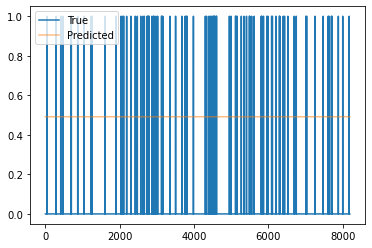

Train Epoch: 0 [10/2220 (0%)]	Loss: 0.451837	Pres: 0.360229	F1 Score: 0.360229
Train Epoch: 0 [20/2220 (0%)]	Loss: 0.349234	Pres: 0.146973	F1 Score: 0.146973
Train Epoch: 0 [30/2220 (1%)]	Loss: 0.266646	Pres: 0.026855	F1 Score: 0.026855
Train Epoch: 0 [40/2220 (1%)]	Loss: 0.205833	Pres: 0.004761	F1 Score: 0.004761
Train Epoch: 0 [50/2220 (2%)]	Loss: 0.173500	Pres: 0.000732	F1 Score: 0.000732
Train Epoch: 0 [60/2220 (2%)]	Loss: 0.138653	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [70/2220 (3%)]	Loss: 0.125301	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [80/2220 (3%)]	Loss: 0.114199	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [90/2220 (4%)]	Loss: 0.099274	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [100/2220 (4%)]	Loss: 0.093082	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [110/2220 (4%)]	Loss: 0.086883	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [120/2220 (5%)]	Loss: 0.075071	Pres: 0.000610	F1 Score: 0.000610
Train Epoch: 0 [130/2220 (5%)]	Loss: 0.073751	Pre

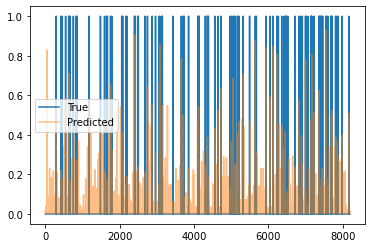

Train Epoch: 0 [310/2220 (13%)]	Loss: 0.041998	Pres: 0.005249	F1 Score: 0.005249
Train Epoch: 0 [320/2220 (14%)]	Loss: 0.039695	Pres: 0.004272	F1 Score: 0.004272
Train Epoch: 0 [330/2220 (14%)]	Loss: 0.034399	Pres: 0.003906	F1 Score: 0.003906
Train Epoch: 0 [340/2220 (15%)]	Loss: 0.033038	Pres: 0.003662	F1 Score: 0.003662
Train Epoch: 0 [350/2220 (15%)]	Loss: 0.040448	Pres: 0.004028	F1 Score: 0.004028
Train Epoch: 0 [360/2220 (16%)]	Loss: 0.038746	Pres: 0.004639	F1 Score: 0.004639
Train Epoch: 0 [370/2220 (16%)]	Loss: 0.030608	Pres: 0.005859	F1 Score: 0.005859
Train Epoch: 0 [380/2220 (17%)]	Loss: 0.032215	Pres: 0.003784	F1 Score: 0.003784
Train Epoch: 0 [390/2220 (17%)]	Loss: 0.033874	Pres: 0.004761	F1 Score: 0.004761
Train Epoch: 0 [400/2220 (18%)]	Loss: 0.031923	Pres: 0.003784	F1 Score: 0.003784
Train Epoch: 0 [410/2220 (18%)]	Loss: 0.033145	Pres: 0.004517	F1 Score: 0.004517
Train Epoch: 0 [420/2220 (18%)]	Loss: 0.031291	Pres: 0.003174	F1 Score: 0.003174
Train Epoch: 0 [430/2220 (19

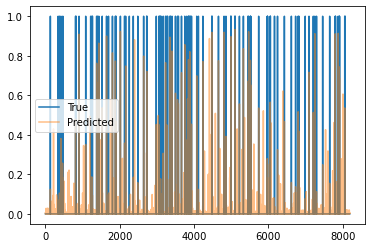

Train Epoch: 0 [610/2220 (27%)]	Loss: 0.022048	Pres: 0.004883	F1 Score: 0.004883
Train Epoch: 0 [620/2220 (27%)]	Loss: 0.023245	Pres: 0.006348	F1 Score: 0.006348
Train Epoch: 0 [630/2220 (28%)]	Loss: 0.024872	Pres: 0.004028	F1 Score: 0.004028
Train Epoch: 0 [640/2220 (28%)]	Loss: 0.021171	Pres: 0.004272	F1 Score: 0.004272
Train Epoch: 0 [650/2220 (29%)]	Loss: 0.022024	Pres: 0.005127	F1 Score: 0.005127
Train Epoch: 0 [660/2220 (29%)]	Loss: 0.023593	Pres: 0.005127	F1 Score: 0.005127
Train Epoch: 0 [670/2220 (30%)]	Loss: 0.025442	Pres: 0.006592	F1 Score: 0.006592
Train Epoch: 0 [680/2220 (30%)]	Loss: 0.027996	Pres: 0.004517	F1 Score: 0.004517
Train Epoch: 0 [690/2220 (31%)]	Loss: 0.022912	Pres: 0.005493	F1 Score: 0.005493
Train Epoch: 0 [700/2220 (31%)]	Loss: 0.024717	Pres: 0.006836	F1 Score: 0.006836
Train Epoch: 0 [710/2220 (31%)]	Loss: 0.027644	Pres: 0.005859	F1 Score: 0.005859
Train Epoch: 0 [720/2220 (32%)]	Loss: 0.018513	Pres: 0.004150	F1 Score: 0.004150
Train Epoch: 0 [730/2220 (32

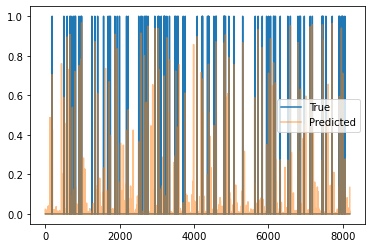

Train Epoch: 0 [910/2220 (40%)]	Loss: 0.017768	Pres: 0.005005	F1 Score: 0.005005
Train Epoch: 0 [920/2220 (41%)]	Loss: 0.020053	Pres: 0.005981	F1 Score: 0.005981
Train Epoch: 0 [930/2220 (41%)]	Loss: 0.017296	Pres: 0.004395	F1 Score: 0.004395
Train Epoch: 0 [940/2220 (42%)]	Loss: 0.024745	Pres: 0.006226	F1 Score: 0.006226
Train Epoch: 0 [950/2220 (42%)]	Loss: 0.020655	Pres: 0.004395	F1 Score: 0.004395
Train Epoch: 0 [960/2220 (43%)]	Loss: 0.017668	Pres: 0.004272	F1 Score: 0.004272
Train Epoch: 0 [970/2220 (43%)]	Loss: 0.020145	Pres: 0.004883	F1 Score: 0.004883
Train Epoch: 0 [980/2220 (44%)]	Loss: 0.022414	Pres: 0.003662	F1 Score: 0.003662
Train Epoch: 0 [990/2220 (44%)]	Loss: 0.022394	Pres: 0.005737	F1 Score: 0.005737
Train Epoch: 0 [1000/2220 (45%)]	Loss: 0.023975	Pres: 0.005371	F1 Score: 0.005371
Train Epoch: 0 [1010/2220 (45%)]	Loss: 0.025963	Pres: 0.003662	F1 Score: 0.003662
Train Epoch: 0 [1020/2220 (45%)]	Loss: 0.019318	Pres: 0.003052	F1 Score: 0.003052
Train Epoch: 0 [1030/2220

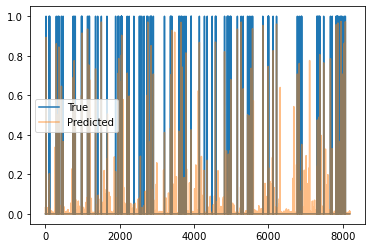

Train Epoch: 0 [1210/2220 (54%)]	Loss: 0.019176	Pres: 0.005005	F1 Score: 0.005005
Train Epoch: 0 [1220/2220 (54%)]	Loss: 0.016854	Pres: 0.003662	F1 Score: 0.003662
Train Epoch: 0 [1230/2220 (55%)]	Loss: 0.018999	Pres: 0.006226	F1 Score: 0.006226
Train Epoch: 0 [1240/2220 (55%)]	Loss: 0.021192	Pres: 0.005005	F1 Score: 0.005005
Train Epoch: 0 [1250/2220 (56%)]	Loss: 0.022023	Pres: 0.003662	F1 Score: 0.003662
Train Epoch: 0 [1260/2220 (56%)]	Loss: 0.016469	Pres: 0.004517	F1 Score: 0.004517
Train Epoch: 0 [1270/2220 (57%)]	Loss: 0.019737	Pres: 0.005127	F1 Score: 0.005127
Train Epoch: 0 [1280/2220 (57%)]	Loss: 0.015367	Pres: 0.003906	F1 Score: 0.003906
Train Epoch: 0 [1290/2220 (58%)]	Loss: 0.017803	Pres: 0.004395	F1 Score: 0.004395
Train Epoch: 0 [1300/2220 (58%)]	Loss: 0.017138	Pres: 0.003662	F1 Score: 0.003662
Train Epoch: 0 [1310/2220 (59%)]	Loss: 0.018385	Pres: 0.004150	F1 Score: 0.004150
Train Epoch: 0 [1320/2220 (59%)]	Loss: 0.017722	Pres: 0.003418	F1 Score: 0.003418
Train Epoch: 0 [

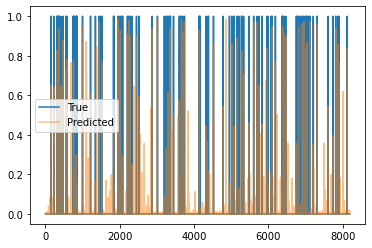

Train Epoch: 0 [1510/2220 (68%)]	Loss: 0.021274	Pres: 0.005737	F1 Score: 0.005737
Train Epoch: 0 [1520/2220 (68%)]	Loss: 0.016802	Pres: 0.004150	F1 Score: 0.004150
Train Epoch: 0 [1530/2220 (68%)]	Loss: 0.014211	Pres: 0.006348	F1 Score: 0.006348
Train Epoch: 0 [1540/2220 (69%)]	Loss: 0.017984	Pres: 0.004517	F1 Score: 0.004517
Train Epoch: 0 [1550/2220 (69%)]	Loss: 0.013719	Pres: 0.003052	F1 Score: 0.003052
Train Epoch: 0 [1560/2220 (70%)]	Loss: 0.014859	Pres: 0.004028	F1 Score: 0.004028
Train Epoch: 0 [1570/2220 (70%)]	Loss: 0.012217	Pres: 0.004395	F1 Score: 0.004395
Train Epoch: 0 [1580/2220 (71%)]	Loss: 0.019780	Pres: 0.004883	F1 Score: 0.004883
Train Epoch: 0 [1590/2220 (71%)]	Loss: 0.017641	Pres: 0.004272	F1 Score: 0.004272
Train Epoch: 0 [1600/2220 (72%)]	Loss: 0.016892	Pres: 0.004028	F1 Score: 0.004028
Train Epoch: 0 [1610/2220 (72%)]	Loss: 0.014260	Pres: 0.002686	F1 Score: 0.002686
Train Epoch: 0 [1620/2220 (72%)]	Loss: 0.012867	Pres: 0.004517	F1 Score: 0.004517
Train Epoch: 0 [

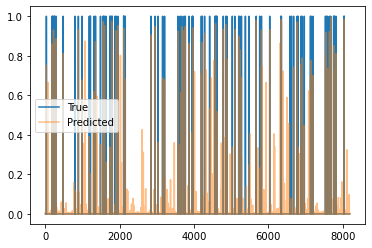

Train Epoch: 0 [1810/2220 (81%)]	Loss: 0.017406	Pres: 0.003540	F1 Score: 0.003540
Train Epoch: 0 [1820/2220 (81%)]	Loss: 0.014474	Pres: 0.003784	F1 Score: 0.003784
Train Epoch: 0 [1830/2220 (82%)]	Loss: 0.015941	Pres: 0.004150	F1 Score: 0.004150
Train Epoch: 0 [1840/2220 (82%)]	Loss: 0.017099	Pres: 0.004395	F1 Score: 0.004395
Train Epoch: 0 [1850/2220 (83%)]	Loss: 0.016849	Pres: 0.003418	F1 Score: 0.003418
Train Epoch: 0 [1860/2220 (83%)]	Loss: 0.020629	Pres: 0.004761	F1 Score: 0.004761
Train Epoch: 0 [1870/2220 (84%)]	Loss: 0.019618	Pres: 0.003784	F1 Score: 0.003784
Train Epoch: 0 [1880/2220 (84%)]	Loss: 0.013819	Pres: 0.005615	F1 Score: 0.005615
Train Epoch: 0 [1890/2220 (85%)]	Loss: 0.016836	Pres: 0.004395	F1 Score: 0.004395
Train Epoch: 0 [1900/2220 (85%)]	Loss: 0.015638	Pres: 0.004272	F1 Score: 0.004272
Train Epoch: 0 [1910/2220 (86%)]	Loss: 0.012890	Pres: 0.004517	F1 Score: 0.004517
Train Epoch: 0 [1920/2220 (86%)]	Loss: 0.014728	Pres: 0.004639	F1 Score: 0.004639
Train Epoch: 0 [

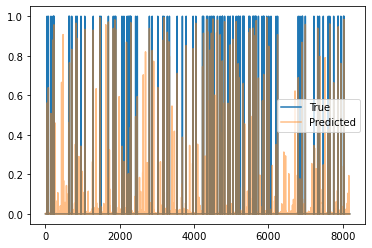

Train Epoch: 0 [2110/2220 (95%)]	Loss: 0.011926	Pres: 0.003052	F1 Score: 0.003052
Train Epoch: 0 [2120/2220 (95%)]	Loss: 0.015749	Pres: 0.004272	F1 Score: 0.004272
Train Epoch: 0 [2130/2220 (95%)]	Loss: 0.015498	Pres: 0.004150	F1 Score: 0.004150
Train Epoch: 0 [2140/2220 (96%)]	Loss: 0.013738	Pres: 0.003296	F1 Score: 0.003296
Train Epoch: 0 [2150/2220 (96%)]	Loss: 0.016813	Pres: 0.004272	F1 Score: 0.004272
Train Epoch: 0 [2160/2220 (97%)]	Loss: 0.016164	Pres: 0.004639	F1 Score: 0.004639
Train Epoch: 0 [2170/2220 (97%)]	Loss: 0.015094	Pres: 0.003296	F1 Score: 0.003296
Train Epoch: 0 [2180/2220 (98%)]	Loss: 0.013637	Pres: 0.005127	F1 Score: 0.005127
Train Epoch: 0 [2190/2220 (98%)]	Loss: 0.012743	Pres: 0.005005	F1 Score: 0.005005
Train Epoch: 0 [2200/2220 (99%)]	Loss: 0.015367	Pres: 0.003906	F1 Score: 0.003906
Train Epoch: 0 [2210/2220 (99%)]	Loss: 0.012634	Pres: 0.004272	F1 Score: 0.004272
Validation Epoch: 0 [0/582 (0%)]	Loss: 0.014873	Pres: 0.003418	F1 Score: 0.003418


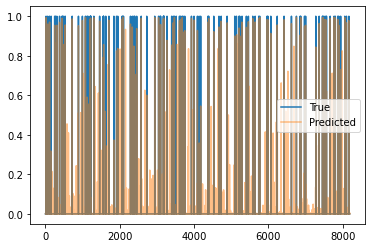

Validation Epoch: 0 [10/582 (1%)]	Loss: 0.014740	Pres: 0.005127	F1 Score: 0.005127
Validation Epoch: 0 [20/582 (3%)]	Loss: 0.013995	Pres: 0.005127	F1 Score: 0.005127
Validation Epoch: 0 [30/582 (5%)]	Loss: 0.014989	Pres: 0.003784	F1 Score: 0.003784
Validation Epoch: 0 [40/582 (6%)]	Loss: 0.016635	Pres: 0.004761	F1 Score: 0.004761
Validation Epoch: 0 [50/582 (8%)]	Loss: 0.011828	Pres: 0.004150	F1 Score: 0.004150
Validation Epoch: 0 [60/582 (10%)]	Loss: 0.012442	Pres: 0.004028	F1 Score: 0.004028
Validation Epoch: 0 [70/582 (12%)]	Loss: 0.015121	Pres: 0.004639	F1 Score: 0.004639
Validation Epoch: 0 [80/582 (13%)]	Loss: 0.014506	Pres: 0.004517	F1 Score: 0.004517
Validation Epoch: 0 [90/582 (15%)]	Loss: 0.014781	Pres: 0.005005	F1 Score: 0.005005
Validation Epoch: 0 [100/582 (17%)]	Loss: 0.018091	Pres: 0.004639	F1 Score: 0.004639
Validation Epoch: 0 [110/582 (18%)]	Loss: 0.014417	Pres: 0.006104	F1 Score: 0.006104
Validation Epoch: 0 [120/582 (20%)]	Loss: 0.014795	Pres: 0.005859	F1 Score: 0.0

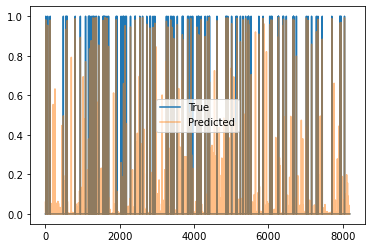

Validation Epoch: 0 [310/582 (53%)]	Loss: 0.015593	Pres: 0.004395	F1 Score: 0.004395
Validation Epoch: 0 [320/582 (54%)]	Loss: 0.016941	Pres: 0.005249	F1 Score: 0.005249
Validation Epoch: 0 [330/582 (56%)]	Loss: 0.016035	Pres: 0.006348	F1 Score: 0.006348
Validation Epoch: 0 [340/582 (58%)]	Loss: 0.013797	Pres: 0.004150	F1 Score: 0.004150
Validation Epoch: 0 [350/582 (60%)]	Loss: 0.015256	Pres: 0.005859	F1 Score: 0.005859
Validation Epoch: 0 [360/582 (61%)]	Loss: 0.016066	Pres: 0.005005	F1 Score: 0.005005
Validation Epoch: 0 [370/582 (63%)]	Loss: 0.015396	Pres: 0.003662	F1 Score: 0.003662
Validation Epoch: 0 [380/582 (65%)]	Loss: 0.013361	Pres: 0.004883	F1 Score: 0.004883
Validation Epoch: 0 [390/582 (67%)]	Loss: 0.015793	Pres: 0.004761	F1 Score: 0.004761
Validation Epoch: 0 [400/582 (68%)]	Loss: 0.013575	Pres: 0.004150	F1 Score: 0.004150
Validation Epoch: 0 [410/582 (70%)]	Loss: 0.015198	Pres: 0.004639	F1 Score: 0.004639
Validation Epoch: 0 [420/582 (72%)]	Loss: 0.016178	Pres: 0.004639

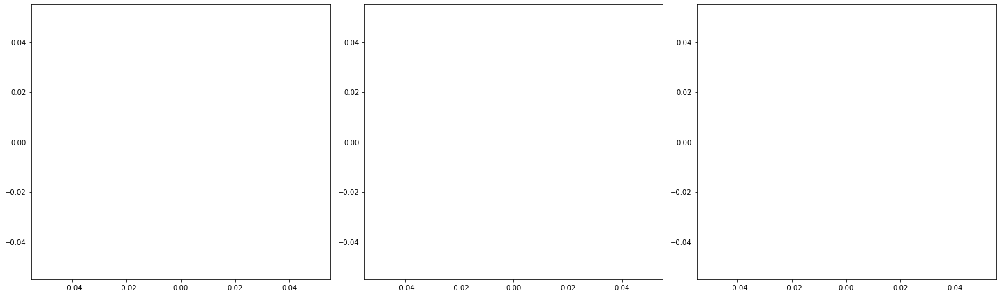

2220 582
Train Epoch: 1 [0/2220 (0%)]	Loss: 0.015514	Pres: 0.003906	F1 Score: 0.003906
91.0 -inf


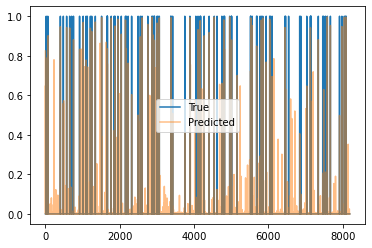

Train Epoch: 1 [10/2220 (0%)]	Loss: 0.015511	Pres: 0.004761	F1 Score: 0.004761
Train Epoch: 1 [20/2220 (0%)]	Loss: 0.013982	Pres: 0.003296	F1 Score: 0.003296
Train Epoch: 1 [30/2220 (1%)]	Loss: 0.013031	Pres: 0.002686	F1 Score: 0.002686
Train Epoch: 1 [40/2220 (1%)]	Loss: 0.013151	Pres: 0.003052	F1 Score: 0.003052
Train Epoch: 1 [50/2220 (2%)]	Loss: 0.013846	Pres: 0.003662	F1 Score: 0.003662
Train Epoch: 1 [60/2220 (2%)]	Loss: 0.016068	Pres: 0.004150	F1 Score: 0.004150
Train Epoch: 1 [70/2220 (3%)]	Loss: 0.009935	Pres: 0.003296	F1 Score: 0.003296
Train Epoch: 1 [80/2220 (3%)]	Loss: 0.014506	Pres: 0.004395	F1 Score: 0.004395
Train Epoch: 1 [90/2220 (4%)]	Loss: 0.015281	Pres: 0.002808	F1 Score: 0.002808
Train Epoch: 1 [100/2220 (4%)]	Loss: 0.013395	Pres: 0.004028	F1 Score: 0.004028
Train Epoch: 1 [110/2220 (4%)]	Loss: 0.014018	Pres: 0.003052	F1 Score: 0.003052
Train Epoch: 1 [120/2220 (5%)]	Loss: 0.015732	Pres: 0.002686	F1 Score: 0.002686
Train Epoch: 1 [130/2220 (5%)]	Loss: 0.015007	Pre

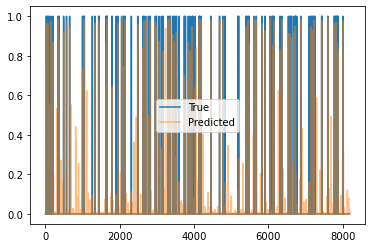

Train Epoch: 1 [310/2220 (13%)]	Loss: 0.014538	Pres: 0.003540	F1 Score: 0.003540
Train Epoch: 1 [320/2220 (14%)]	Loss: 0.013605	Pres: 0.003906	F1 Score: 0.003906
Train Epoch: 1 [330/2220 (14%)]	Loss: 0.014896	Pres: 0.003174	F1 Score: 0.003174
Train Epoch: 1 [340/2220 (15%)]	Loss: 0.015512	Pres: 0.003296	F1 Score: 0.003296
Train Epoch: 1 [350/2220 (15%)]	Loss: 0.017658	Pres: 0.004028	F1 Score: 0.004028
Train Epoch: 1 [360/2220 (16%)]	Loss: 0.017145	Pres: 0.003784	F1 Score: 0.003784
Train Epoch: 1 [370/2220 (16%)]	Loss: 0.014898	Pres: 0.003174	F1 Score: 0.003174
Train Epoch: 1 [380/2220 (17%)]	Loss: 0.016673	Pres: 0.002686	F1 Score: 0.002686
Train Epoch: 1 [390/2220 (17%)]	Loss: 0.012979	Pres: 0.004517	F1 Score: 0.004517
Train Epoch: 1 [400/2220 (18%)]	Loss: 0.018912	Pres: 0.004150	F1 Score: 0.004150
Train Epoch: 1 [410/2220 (18%)]	Loss: 0.013874	Pres: 0.003662	F1 Score: 0.003662
Train Epoch: 1 [420/2220 (18%)]	Loss: 0.014117	Pres: 0.003540	F1 Score: 0.003540
Train Epoch: 1 [430/2220 (19

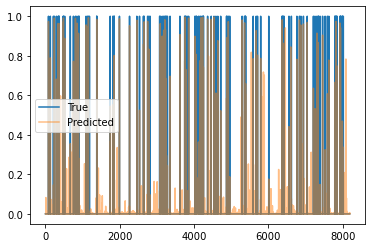

Train Epoch: 1 [610/2220 (27%)]	Loss: 0.019681	Pres: 0.002808	F1 Score: 0.002808
Train Epoch: 1 [620/2220 (27%)]	Loss: 0.010818	Pres: 0.002930	F1 Score: 0.002930
Train Epoch: 1 [630/2220 (28%)]	Loss: 0.014733	Pres: 0.004395	F1 Score: 0.004395
Train Epoch: 1 [640/2220 (28%)]	Loss: 0.012631	Pres: 0.005371	F1 Score: 0.005371
Train Epoch: 1 [650/2220 (29%)]	Loss: 0.010515	Pres: 0.003052	F1 Score: 0.003052
Train Epoch: 1 [660/2220 (29%)]	Loss: 0.011466	Pres: 0.002075	F1 Score: 0.002075
Train Epoch: 1 [670/2220 (30%)]	Loss: 0.014360	Pres: 0.003784	F1 Score: 0.003784
Train Epoch: 1 [680/2220 (30%)]	Loss: 0.013845	Pres: 0.003662	F1 Score: 0.003662
Train Epoch: 1 [690/2220 (31%)]	Loss: 0.013994	Pres: 0.003540	F1 Score: 0.003540
Train Epoch: 1 [700/2220 (31%)]	Loss: 0.017965	Pres: 0.004761	F1 Score: 0.004761
Train Epoch: 1 [710/2220 (31%)]	Loss: 0.015934	Pres: 0.004028	F1 Score: 0.004028
Train Epoch: 1 [720/2220 (32%)]	Loss: 0.012405	Pres: 0.003418	F1 Score: 0.003418
Train Epoch: 1 [730/2220 (32

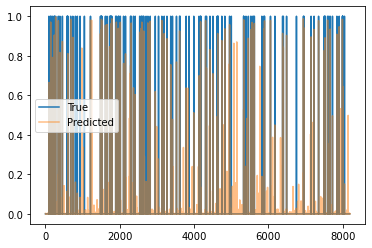

Train Epoch: 1 [910/2220 (40%)]	Loss: 0.012450	Pres: 0.002808	F1 Score: 0.002808
Train Epoch: 1 [920/2220 (41%)]	Loss: 0.017023	Pres: 0.004028	F1 Score: 0.004028
Train Epoch: 1 [930/2220 (41%)]	Loss: 0.013862	Pres: 0.002930	F1 Score: 0.002930
Train Epoch: 1 [940/2220 (42%)]	Loss: 0.013651	Pres: 0.003296	F1 Score: 0.003296
Train Epoch: 1 [950/2220 (42%)]	Loss: 0.012856	Pres: 0.002808	F1 Score: 0.002808
Train Epoch: 1 [960/2220 (43%)]	Loss: 0.015012	Pres: 0.003174	F1 Score: 0.003174
Train Epoch: 1 [970/2220 (43%)]	Loss: 0.016921	Pres: 0.004395	F1 Score: 0.004395
Train Epoch: 1 [980/2220 (44%)]	Loss: 0.015844	Pres: 0.003906	F1 Score: 0.003906
Train Epoch: 1 [990/2220 (44%)]	Loss: 0.010285	Pres: 0.002808	F1 Score: 0.002808
Train Epoch: 1 [1000/2220 (45%)]	Loss: 0.011613	Pres: 0.003296	F1 Score: 0.003296
Train Epoch: 1 [1010/2220 (45%)]	Loss: 0.015859	Pres: 0.003784	F1 Score: 0.003784
Train Epoch: 1 [1020/2220 (45%)]	Loss: 0.010612	Pres: 0.003418	F1 Score: 0.003418
Train Epoch: 1 [1030/2220

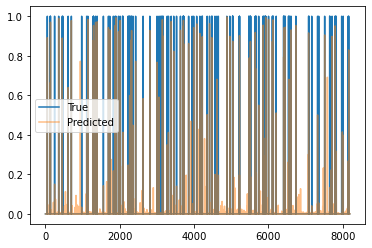

Train Epoch: 1 [1210/2220 (54%)]	Loss: 0.012141	Pres: 0.003418	F1 Score: 0.003418
Train Epoch: 1 [1220/2220 (54%)]	Loss: 0.014164	Pres: 0.004883	F1 Score: 0.004883
Train Epoch: 1 [1230/2220 (55%)]	Loss: 0.013483	Pres: 0.003418	F1 Score: 0.003418
Train Epoch: 1 [1240/2220 (55%)]	Loss: 0.015455	Pres: 0.003052	F1 Score: 0.003052
Train Epoch: 1 [1250/2220 (56%)]	Loss: 0.010245	Pres: 0.003296	F1 Score: 0.003296
Train Epoch: 1 [1260/2220 (56%)]	Loss: 0.013108	Pres: 0.002441	F1 Score: 0.002441
Train Epoch: 1 [1270/2220 (57%)]	Loss: 0.013589	Pres: 0.001953	F1 Score: 0.001953
Train Epoch: 1 [1280/2220 (57%)]	Loss: 0.012355	Pres: 0.002441	F1 Score: 0.002441
Train Epoch: 1 [1290/2220 (58%)]	Loss: 0.015707	Pres: 0.003052	F1 Score: 0.003052
Train Epoch: 1 [1300/2220 (58%)]	Loss: 0.012873	Pres: 0.003418	F1 Score: 0.003418
Train Epoch: 1 [1310/2220 (59%)]	Loss: 0.013977	Pres: 0.004150	F1 Score: 0.004150
Train Epoch: 1 [1320/2220 (59%)]	Loss: 0.011260	Pres: 0.003784	F1 Score: 0.003784
Train Epoch: 1 [

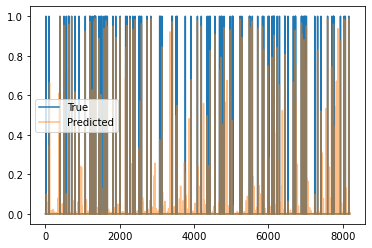

Train Epoch: 1 [1510/2220 (68%)]	Loss: 0.011802	Pres: 0.004028	F1 Score: 0.004028
Train Epoch: 1 [1520/2220 (68%)]	Loss: 0.014577	Pres: 0.003174	F1 Score: 0.003174
Train Epoch: 1 [1530/2220 (68%)]	Loss: 0.013450	Pres: 0.003052	F1 Score: 0.003052
Train Epoch: 1 [1540/2220 (69%)]	Loss: 0.012842	Pres: 0.004517	F1 Score: 0.004517
Train Epoch: 1 [1550/2220 (69%)]	Loss: 0.013931	Pres: 0.004028	F1 Score: 0.004028
Train Epoch: 1 [1560/2220 (70%)]	Loss: 0.013923	Pres: 0.002441	F1 Score: 0.002441
Train Epoch: 1 [1570/2220 (70%)]	Loss: 0.013486	Pres: 0.003418	F1 Score: 0.003418
Train Epoch: 1 [1580/2220 (71%)]	Loss: 0.011077	Pres: 0.003296	F1 Score: 0.003296
Train Epoch: 1 [1590/2220 (71%)]	Loss: 0.013812	Pres: 0.004150	F1 Score: 0.004150
Train Epoch: 1 [1600/2220 (72%)]	Loss: 0.014016	Pres: 0.002441	F1 Score: 0.002441
Train Epoch: 1 [1610/2220 (72%)]	Loss: 0.012454	Pres: 0.002441	F1 Score: 0.002441
Train Epoch: 1 [1620/2220 (72%)]	Loss: 0.012251	Pres: 0.002808	F1 Score: 0.002808
Train Epoch: 1 [

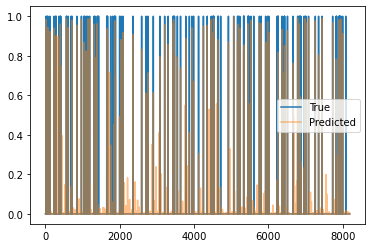

Train Epoch: 1 [1810/2220 (81%)]	Loss: 0.010495	Pres: 0.002075	F1 Score: 0.002075
Train Epoch: 1 [1820/2220 (81%)]	Loss: 0.013202	Pres: 0.003052	F1 Score: 0.003052
Train Epoch: 1 [1830/2220 (82%)]	Loss: 0.013309	Pres: 0.001709	F1 Score: 0.001709
Train Epoch: 1 [1840/2220 (82%)]	Loss: 0.012849	Pres: 0.001831	F1 Score: 0.001831
Train Epoch: 1 [1850/2220 (83%)]	Loss: 0.011361	Pres: 0.003540	F1 Score: 0.003540
Train Epoch: 1 [1860/2220 (83%)]	Loss: 0.010240	Pres: 0.001953	F1 Score: 0.001953
Train Epoch: 1 [1870/2220 (84%)]	Loss: 0.012361	Pres: 0.003418	F1 Score: 0.003418
Train Epoch: 1 [1880/2220 (84%)]	Loss: 0.012530	Pres: 0.002808	F1 Score: 0.002808
Train Epoch: 1 [1890/2220 (85%)]	Loss: 0.014279	Pres: 0.003418	F1 Score: 0.003418
Train Epoch: 1 [1900/2220 (85%)]	Loss: 0.010123	Pres: 0.003906	F1 Score: 0.003906
Train Epoch: 1 [1910/2220 (86%)]	Loss: 0.012533	Pres: 0.003662	F1 Score: 0.003662
Train Epoch: 1 [1920/2220 (86%)]	Loss: 0.011993	Pres: 0.003540	F1 Score: 0.003540
Train Epoch: 1 [

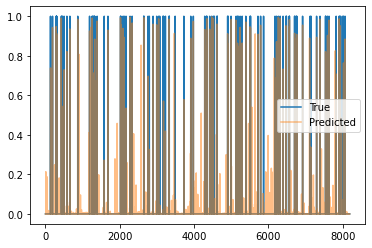

Train Epoch: 1 [2110/2220 (95%)]	Loss: 0.010119	Pres: 0.003052	F1 Score: 0.003052
Train Epoch: 1 [2120/2220 (95%)]	Loss: 0.012175	Pres: 0.002808	F1 Score: 0.002808
Train Epoch: 1 [2130/2220 (95%)]	Loss: 0.013971	Pres: 0.003418	F1 Score: 0.003418
Train Epoch: 1 [2140/2220 (96%)]	Loss: 0.010727	Pres: 0.002441	F1 Score: 0.002441
Train Epoch: 1 [2150/2220 (96%)]	Loss: 0.012695	Pres: 0.002930	F1 Score: 0.002930
Train Epoch: 1 [2160/2220 (97%)]	Loss: 0.011738	Pres: 0.002686	F1 Score: 0.002686
Train Epoch: 1 [2170/2220 (97%)]	Loss: 0.013055	Pres: 0.003906	F1 Score: 0.003906
Train Epoch: 1 [2180/2220 (98%)]	Loss: 0.013127	Pres: 0.002808	F1 Score: 0.002808
Train Epoch: 1 [2190/2220 (98%)]	Loss: 0.010863	Pres: 0.003052	F1 Score: 0.003052
Train Epoch: 1 [2200/2220 (99%)]	Loss: 0.010992	Pres: 0.003662	F1 Score: 0.003662
Train Epoch: 1 [2210/2220 (99%)]	Loss: 0.010872	Pres: 0.001953	F1 Score: 0.001953
Validation Epoch: 1 [0/582 (0%)]	Loss: 0.006536	Pres: 0.002075	F1 Score: 0.002075


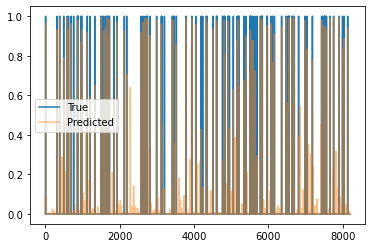

Validation Epoch: 1 [10/582 (1%)]	Loss: 0.004888	Pres: 0.002441	F1 Score: 0.002441
Validation Epoch: 1 [20/582 (3%)]	Loss: 0.007707	Pres: 0.002075	F1 Score: 0.002075
Validation Epoch: 1 [30/582 (5%)]	Loss: 0.007333	Pres: 0.001343	F1 Score: 0.001343
Validation Epoch: 1 [40/582 (6%)]	Loss: 0.005835	Pres: 0.001953	F1 Score: 0.001953
Validation Epoch: 1 [50/582 (8%)]	Loss: 0.006693	Pres: 0.002563	F1 Score: 0.002563
Validation Epoch: 1 [60/582 (10%)]	Loss: 0.007934	Pres: 0.001953	F1 Score: 0.001953
Validation Epoch: 1 [70/582 (12%)]	Loss: 0.005670	Pres: 0.001709	F1 Score: 0.001709
Validation Epoch: 1 [80/582 (13%)]	Loss: 0.005144	Pres: 0.002319	F1 Score: 0.002319
Validation Epoch: 1 [90/582 (15%)]	Loss: 0.004007	Pres: 0.002075	F1 Score: 0.002075
Validation Epoch: 1 [100/582 (17%)]	Loss: 0.006014	Pres: 0.001587	F1 Score: 0.001587
Validation Epoch: 1 [110/582 (18%)]	Loss: 0.006915	Pres: 0.001831	F1 Score: 0.001831
Validation Epoch: 1 [120/582 (20%)]	Loss: 0.007839	Pres: 0.002197	F1 Score: 0.0

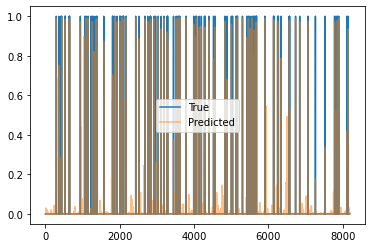

Validation Epoch: 1 [310/582 (53%)]	Loss: 0.005486	Pres: 0.003418	F1 Score: 0.003418
Validation Epoch: 1 [320/582 (54%)]	Loss: 0.007167	Pres: 0.001709	F1 Score: 0.001709
Validation Epoch: 1 [330/582 (56%)]	Loss: 0.004254	Pres: 0.002441	F1 Score: 0.002441
Validation Epoch: 1 [340/582 (58%)]	Loss: 0.006130	Pres: 0.002563	F1 Score: 0.002563
Validation Epoch: 1 [350/582 (60%)]	Loss: 0.005498	Pres: 0.002686	F1 Score: 0.002686
Validation Epoch: 1 [360/582 (61%)]	Loss: 0.005852	Pres: 0.002075	F1 Score: 0.002075
Validation Epoch: 1 [370/582 (63%)]	Loss: 0.008230	Pres: 0.003052	F1 Score: 0.003052
Validation Epoch: 1 [380/582 (65%)]	Loss: 0.006690	Pres: 0.001465	F1 Score: 0.001465
Validation Epoch: 1 [390/582 (67%)]	Loss: 0.005869	Pres: 0.002441	F1 Score: 0.002441
Validation Epoch: 1 [400/582 (68%)]	Loss: 0.005494	Pres: 0.001587	F1 Score: 0.001587
Validation Epoch: 1 [410/582 (70%)]	Loss: 0.008335	Pres: 0.002563	F1 Score: 0.002563
Validation Epoch: 1 [420/582 (72%)]	Loss: 0.005506	Pres: 0.002075

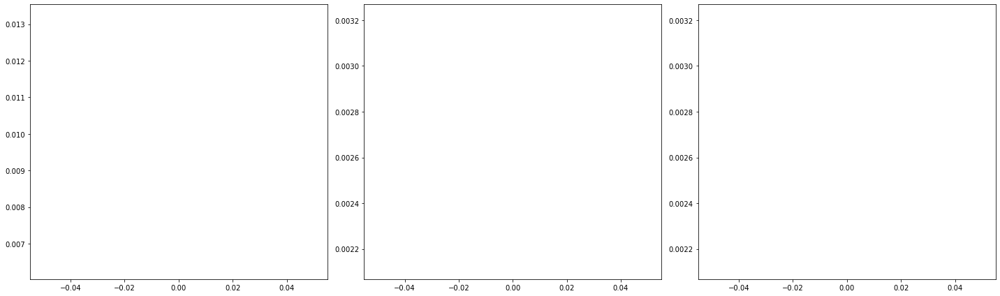

2220 582
Train Epoch: 2 [0/2220 (0%)]	Loss: 0.010533	Pres: 0.003052	F1 Score: 0.003052
95.0 -inf


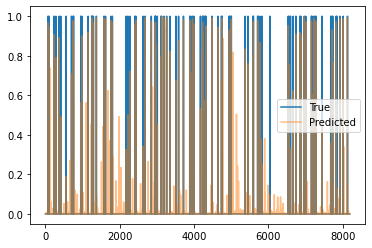

Train Epoch: 2 [10/2220 (0%)]	Loss: 0.012034	Pres: 0.002686	F1 Score: 0.002686
Train Epoch: 2 [20/2220 (0%)]	Loss: 0.012211	Pres: 0.002563	F1 Score: 0.002563
Train Epoch: 2 [30/2220 (1%)]	Loss: 0.015743	Pres: 0.003296	F1 Score: 0.003296
Train Epoch: 2 [40/2220 (1%)]	Loss: 0.009969	Pres: 0.001709	F1 Score: 0.001709
Train Epoch: 2 [50/2220 (2%)]	Loss: 0.012906	Pres: 0.001953	F1 Score: 0.001953
Train Epoch: 2 [60/2220 (2%)]	Loss: 0.013552	Pres: 0.002319	F1 Score: 0.002319
Train Epoch: 2 [70/2220 (3%)]	Loss: 0.011250	Pres: 0.002808	F1 Score: 0.002808
Train Epoch: 2 [80/2220 (3%)]	Loss: 0.013674	Pres: 0.002808	F1 Score: 0.002808
Train Epoch: 2 [90/2220 (4%)]	Loss: 0.012866	Pres: 0.003906	F1 Score: 0.003906
Train Epoch: 2 [100/2220 (4%)]	Loss: 0.011797	Pres: 0.003174	F1 Score: 0.003174
Train Epoch: 2 [110/2220 (4%)]	Loss: 0.011504	Pres: 0.002686	F1 Score: 0.002686
Train Epoch: 2 [120/2220 (5%)]	Loss: 0.012676	Pres: 0.002686	F1 Score: 0.002686
Train Epoch: 2 [130/2220 (5%)]	Loss: 0.011912	Pre

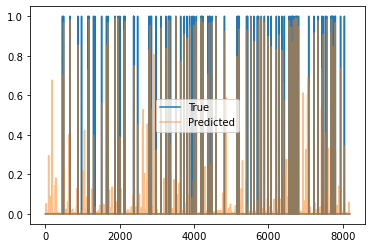

Train Epoch: 2 [310/2220 (13%)]	Loss: 0.009355	Pres: 0.003052	F1 Score: 0.003052
Train Epoch: 2 [320/2220 (14%)]	Loss: 0.011496	Pres: 0.003174	F1 Score: 0.003174
Train Epoch: 2 [330/2220 (14%)]	Loss: 0.011551	Pres: 0.001709	F1 Score: 0.001709
Train Epoch: 2 [340/2220 (15%)]	Loss: 0.011081	Pres: 0.003052	F1 Score: 0.003052
Train Epoch: 2 [350/2220 (15%)]	Loss: 0.013415	Pres: 0.003052	F1 Score: 0.003052
Train Epoch: 2 [360/2220 (16%)]	Loss: 0.012847	Pres: 0.002686	F1 Score: 0.002686
Train Epoch: 2 [370/2220 (16%)]	Loss: 0.013880	Pres: 0.003296	F1 Score: 0.003296
Train Epoch: 2 [380/2220 (17%)]	Loss: 0.011253	Pres: 0.002686	F1 Score: 0.002686
Train Epoch: 2 [390/2220 (17%)]	Loss: 0.011735	Pres: 0.002808	F1 Score: 0.002808
Train Epoch: 2 [400/2220 (18%)]	Loss: 0.013802	Pres: 0.002930	F1 Score: 0.002930
Train Epoch: 2 [410/2220 (18%)]	Loss: 0.011538	Pres: 0.003906	F1 Score: 0.003906
Train Epoch: 2 [420/2220 (18%)]	Loss: 0.013860	Pres: 0.003296	F1 Score: 0.003296
Train Epoch: 2 [430/2220 (19

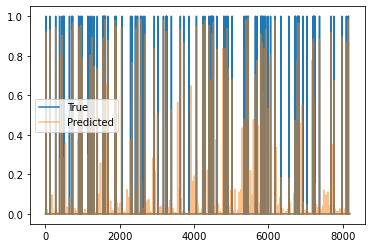

Train Epoch: 2 [610/2220 (27%)]	Loss: 0.010253	Pres: 0.002686	F1 Score: 0.002686
Train Epoch: 2 [620/2220 (27%)]	Loss: 0.011221	Pres: 0.003296	F1 Score: 0.003296
Train Epoch: 2 [630/2220 (28%)]	Loss: 0.013668	Pres: 0.002930	F1 Score: 0.002930
Train Epoch: 2 [640/2220 (28%)]	Loss: 0.013529	Pres: 0.003906	F1 Score: 0.003906
Train Epoch: 2 [650/2220 (29%)]	Loss: 0.014982	Pres: 0.004395	F1 Score: 0.004395
Train Epoch: 2 [660/2220 (29%)]	Loss: 0.010666	Pres: 0.004028	F1 Score: 0.004028
Train Epoch: 2 [670/2220 (30%)]	Loss: 0.010650	Pres: 0.004517	F1 Score: 0.004517
Train Epoch: 2 [680/2220 (30%)]	Loss: 0.012934	Pres: 0.003662	F1 Score: 0.003662
Train Epoch: 2 [690/2220 (31%)]	Loss: 0.010134	Pres: 0.002808	F1 Score: 0.002808
Train Epoch: 2 [700/2220 (31%)]	Loss: 0.013430	Pres: 0.003540	F1 Score: 0.003540
Train Epoch: 2 [710/2220 (31%)]	Loss: 0.011684	Pres: 0.003418	F1 Score: 0.003418
Train Epoch: 2 [720/2220 (32%)]	Loss: 0.009741	Pres: 0.003418	F1 Score: 0.003418
Train Epoch: 2 [730/2220 (32

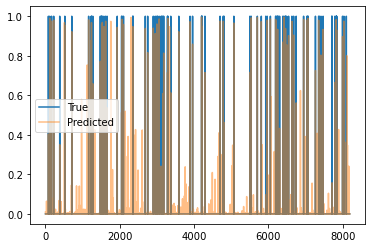

Train Epoch: 2 [910/2220 (40%)]	Loss: 0.010914	Pres: 0.002563	F1 Score: 0.002563
Train Epoch: 2 [920/2220 (41%)]	Loss: 0.008990	Pres: 0.002808	F1 Score: 0.002808
Train Epoch: 2 [930/2220 (41%)]	Loss: 0.010401	Pres: 0.002563	F1 Score: 0.002563
Train Epoch: 2 [940/2220 (42%)]	Loss: 0.011992	Pres: 0.003662	F1 Score: 0.003662
Train Epoch: 2 [950/2220 (42%)]	Loss: 0.011596	Pres: 0.002930	F1 Score: 0.002930
Train Epoch: 2 [960/2220 (43%)]	Loss: 0.015122	Pres: 0.002808	F1 Score: 0.002808
Train Epoch: 2 [970/2220 (43%)]	Loss: 0.012411	Pres: 0.003174	F1 Score: 0.003174
Train Epoch: 2 [980/2220 (44%)]	Loss: 0.012245	Pres: 0.002930	F1 Score: 0.002930
Train Epoch: 2 [990/2220 (44%)]	Loss: 0.014843	Pres: 0.003662	F1 Score: 0.003662
Train Epoch: 2 [1000/2220 (45%)]	Loss: 0.012228	Pres: 0.002075	F1 Score: 0.002075
Train Epoch: 2 [1010/2220 (45%)]	Loss: 0.010630	Pres: 0.003296	F1 Score: 0.003296
Train Epoch: 2 [1020/2220 (45%)]	Loss: 0.011286	Pres: 0.003662	F1 Score: 0.003662
Train Epoch: 2 [1030/2220

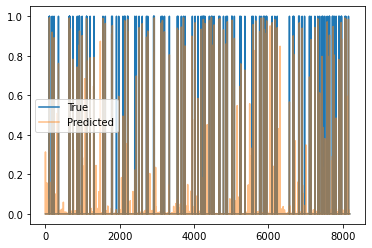

Train Epoch: 2 [1210/2220 (54%)]	Loss: 0.012237	Pres: 0.002441	F1 Score: 0.002441
Train Epoch: 2 [1220/2220 (54%)]	Loss: 0.012205	Pres: 0.002808	F1 Score: 0.002808
Train Epoch: 2 [1230/2220 (55%)]	Loss: 0.008247	Pres: 0.002441	F1 Score: 0.002441
Train Epoch: 2 [1240/2220 (55%)]	Loss: 0.011414	Pres: 0.002319	F1 Score: 0.002319
Train Epoch: 2 [1250/2220 (56%)]	Loss: 0.009804	Pres: 0.002563	F1 Score: 0.002563
Train Epoch: 2 [1260/2220 (56%)]	Loss: 0.008862	Pres: 0.002686	F1 Score: 0.002686
Train Epoch: 2 [1270/2220 (57%)]	Loss: 0.020118	Pres: 0.006470	F1 Score: 0.006470
Train Epoch: 2 [1280/2220 (57%)]	Loss: 0.011201	Pres: 0.003296	F1 Score: 0.003296
Train Epoch: 2 [1290/2220 (58%)]	Loss: 0.011765	Pres: 0.002319	F1 Score: 0.002319
Train Epoch: 2 [1300/2220 (58%)]	Loss: 0.015924	Pres: 0.003540	F1 Score: 0.003540
Train Epoch: 2 [1310/2220 (59%)]	Loss: 0.010298	Pres: 0.002808	F1 Score: 0.002808
Train Epoch: 2 [1320/2220 (59%)]	Loss: 0.012902	Pres: 0.003296	F1 Score: 0.003296
Train Epoch: 2 [

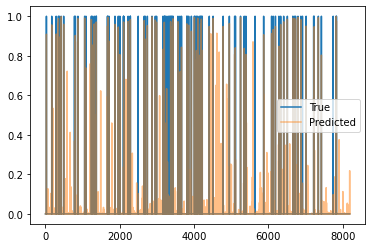

Train Epoch: 2 [1510/2220 (68%)]	Loss: 0.010903	Pres: 0.002197	F1 Score: 0.002197
Train Epoch: 2 [1520/2220 (68%)]	Loss: 0.014629	Pres: 0.003052	F1 Score: 0.003052
Train Epoch: 2 [1530/2220 (68%)]	Loss: 0.012098	Pres: 0.003296	F1 Score: 0.003296
Train Epoch: 2 [1540/2220 (69%)]	Loss: 0.013243	Pres: 0.003540	F1 Score: 0.003540
Train Epoch: 2 [1550/2220 (69%)]	Loss: 0.010018	Pres: 0.003540	F1 Score: 0.003540
Train Epoch: 2 [1560/2220 (70%)]	Loss: 0.013083	Pres: 0.003540	F1 Score: 0.003540
Train Epoch: 2 [1570/2220 (70%)]	Loss: 0.012006	Pres: 0.003296	F1 Score: 0.003296
Train Epoch: 2 [1580/2220 (71%)]	Loss: 0.012093	Pres: 0.004517	F1 Score: 0.004517
Train Epoch: 2 [1590/2220 (71%)]	Loss: 0.011023	Pres: 0.004028	F1 Score: 0.004028
Train Epoch: 2 [1600/2220 (72%)]	Loss: 0.010538	Pres: 0.003174	F1 Score: 0.003174
Train Epoch: 2 [1610/2220 (72%)]	Loss: 0.012744	Pres: 0.002441	F1 Score: 0.002441
Train Epoch: 2 [1620/2220 (72%)]	Loss: 0.009572	Pres: 0.004761	F1 Score: 0.004761
Train Epoch: 2 [

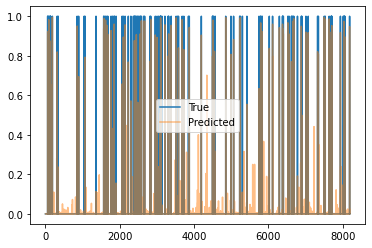

Train Epoch: 2 [1810/2220 (81%)]	Loss: 0.014154	Pres: 0.002441	F1 Score: 0.002441
Train Epoch: 2 [1820/2220 (81%)]	Loss: 0.009420	Pres: 0.002930	F1 Score: 0.002930
Train Epoch: 2 [1830/2220 (82%)]	Loss: 0.009973	Pres: 0.002808	F1 Score: 0.002808
Train Epoch: 2 [1840/2220 (82%)]	Loss: 0.008317	Pres: 0.002686	F1 Score: 0.002686
Train Epoch: 2 [1850/2220 (83%)]	Loss: 0.010087	Pres: 0.002075	F1 Score: 0.002075
Train Epoch: 2 [1860/2220 (83%)]	Loss: 0.012047	Pres: 0.003296	F1 Score: 0.003296
Train Epoch: 2 [1870/2220 (84%)]	Loss: 0.009720	Pres: 0.002930	F1 Score: 0.002930
Train Epoch: 2 [1880/2220 (84%)]	Loss: 0.010766	Pres: 0.002686	F1 Score: 0.002686
Train Epoch: 2 [1890/2220 (85%)]	Loss: 0.010869	Pres: 0.003418	F1 Score: 0.003418
Train Epoch: 2 [1900/2220 (85%)]	Loss: 0.008039	Pres: 0.002808	F1 Score: 0.002808
Train Epoch: 2 [1910/2220 (86%)]	Loss: 0.010611	Pres: 0.003174	F1 Score: 0.003174
Train Epoch: 2 [1920/2220 (86%)]	Loss: 0.010864	Pres: 0.003174	F1 Score: 0.003174
Train Epoch: 2 [

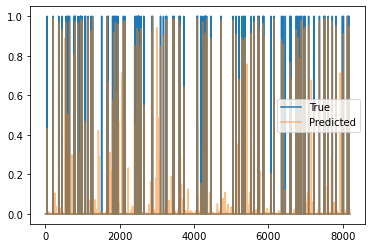

Train Epoch: 2 [2110/2220 (95%)]	Loss: 0.009811	Pres: 0.002441	F1 Score: 0.002441
Train Epoch: 2 [2120/2220 (95%)]	Loss: 0.009941	Pres: 0.002441	F1 Score: 0.002441
Train Epoch: 2 [2130/2220 (95%)]	Loss: 0.012099	Pres: 0.003052	F1 Score: 0.003052
Train Epoch: 2 [2140/2220 (96%)]	Loss: 0.009013	Pres: 0.003418	F1 Score: 0.003418
Train Epoch: 2 [2150/2220 (96%)]	Loss: 0.009655	Pres: 0.003296	F1 Score: 0.003296
Train Epoch: 2 [2160/2220 (97%)]	Loss: 0.008876	Pres: 0.002930	F1 Score: 0.002930
Train Epoch: 2 [2170/2220 (97%)]	Loss: 0.011744	Pres: 0.002563	F1 Score: 0.002563
Train Epoch: 2 [2180/2220 (98%)]	Loss: 0.007896	Pres: 0.002930	F1 Score: 0.002930
Train Epoch: 2 [2190/2220 (98%)]	Loss: 0.008332	Pres: 0.002930	F1 Score: 0.002930
Train Epoch: 2 [2200/2220 (99%)]	Loss: 0.012420	Pres: 0.003662	F1 Score: 0.003662
Train Epoch: 2 [2210/2220 (99%)]	Loss: 0.008458	Pres: 0.001953	F1 Score: 0.001953
Validation Epoch: 2 [0/582 (0%)]	Loss: 0.004917	Pres: 0.002319	F1 Score: 0.002319


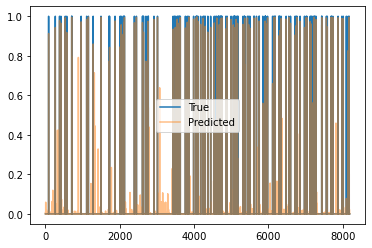

Validation Epoch: 2 [10/582 (1%)]	Loss: 0.005902	Pres: 0.001953	F1 Score: 0.001953
Validation Epoch: 2 [20/582 (3%)]	Loss: 0.005456	Pres: 0.001953	F1 Score: 0.001953
Validation Epoch: 2 [30/582 (5%)]	Loss: 0.006892	Pres: 0.002075	F1 Score: 0.002075
Validation Epoch: 2 [40/582 (6%)]	Loss: 0.006281	Pres: 0.001587	F1 Score: 0.001587
Validation Epoch: 2 [50/582 (8%)]	Loss: 0.005343	Pres: 0.002075	F1 Score: 0.002075
Validation Epoch: 2 [60/582 (10%)]	Loss: 0.005232	Pres: 0.002075	F1 Score: 0.002075
Validation Epoch: 2 [70/582 (12%)]	Loss: 0.006462	Pres: 0.002197	F1 Score: 0.002197
Validation Epoch: 2 [80/582 (13%)]	Loss: 0.008483	Pres: 0.002808	F1 Score: 0.002808
Validation Epoch: 2 [90/582 (15%)]	Loss: 0.006902	Pres: 0.002686	F1 Score: 0.002686
Validation Epoch: 2 [100/582 (17%)]	Loss: 0.004603	Pres: 0.001953	F1 Score: 0.001953
Validation Epoch: 2 [110/582 (18%)]	Loss: 0.005271	Pres: 0.001587	F1 Score: 0.001587
Validation Epoch: 2 [120/582 (20%)]	Loss: 0.004881	Pres: 0.001465	F1 Score: 0.0

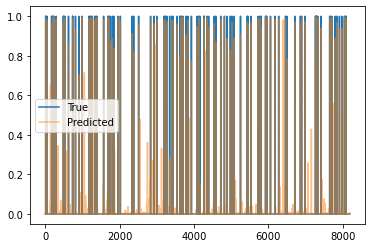

Validation Epoch: 2 [310/582 (53%)]	Loss: 0.004157	Pres: 0.002441	F1 Score: 0.002441
Validation Epoch: 2 [320/582 (54%)]	Loss: 0.005002	Pres: 0.002319	F1 Score: 0.002319
Validation Epoch: 2 [330/582 (56%)]	Loss: 0.006205	Pres: 0.001587	F1 Score: 0.001587
Validation Epoch: 2 [340/582 (58%)]	Loss: 0.005568	Pres: 0.001343	F1 Score: 0.001343
Validation Epoch: 2 [350/582 (60%)]	Loss: 0.005861	Pres: 0.002686	F1 Score: 0.002686
Validation Epoch: 2 [360/582 (61%)]	Loss: 0.004534	Pres: 0.002319	F1 Score: 0.002319
Validation Epoch: 2 [370/582 (63%)]	Loss: 0.005548	Pres: 0.002075	F1 Score: 0.002075
Validation Epoch: 2 [380/582 (65%)]	Loss: 0.006945	Pres: 0.003174	F1 Score: 0.003174
Validation Epoch: 2 [390/582 (67%)]	Loss: 0.006271	Pres: 0.001465	F1 Score: 0.001465
Validation Epoch: 2 [400/582 (68%)]	Loss: 0.005624	Pres: 0.002441	F1 Score: 0.002441
Validation Epoch: 2 [410/582 (70%)]	Loss: 0.006994	Pres: 0.001953	F1 Score: 0.001953
Validation Epoch: 2 [420/582 (72%)]	Loss: 0.005147	Pres: 0.001099

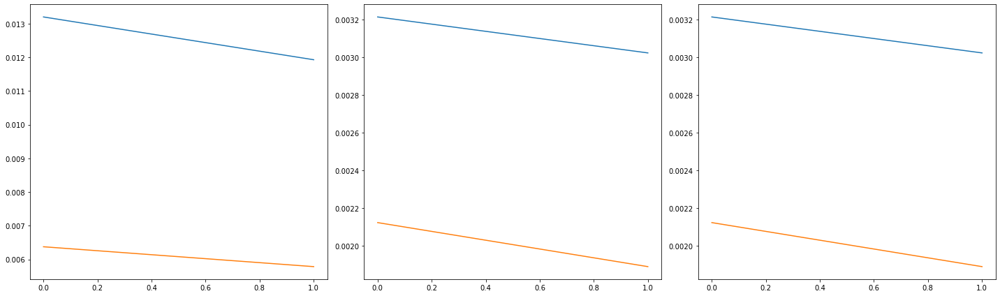

2220 582
Train Epoch: 3 [0/2220 (0%)]	Loss: 0.022716	Pres: 0.006226	F1 Score: 0.006226
117.0 -inf


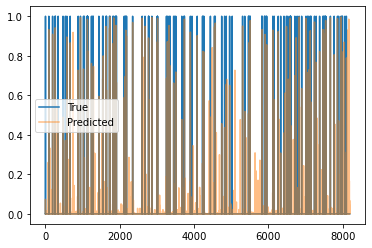

Train Epoch: 3 [10/2220 (0%)]	Loss: 0.008561	Pres: 0.002441	F1 Score: 0.002441
Train Epoch: 3 [20/2220 (0%)]	Loss: 0.010164	Pres: 0.002441	F1 Score: 0.002441
Train Epoch: 3 [30/2220 (1%)]	Loss: 0.007895	Pres: 0.003052	F1 Score: 0.003052
Train Epoch: 3 [40/2220 (1%)]	Loss: 0.009192	Pres: 0.002686	F1 Score: 0.002686
Train Epoch: 3 [50/2220 (2%)]	Loss: 0.009719	Pres: 0.001953	F1 Score: 0.001953
Train Epoch: 3 [60/2220 (2%)]	Loss: 0.010134	Pres: 0.002441	F1 Score: 0.002441
Train Epoch: 3 [70/2220 (3%)]	Loss: 0.011563	Pres: 0.002930	F1 Score: 0.002930
Train Epoch: 3 [80/2220 (3%)]	Loss: 0.009676	Pres: 0.003296	F1 Score: 0.003296
Train Epoch: 3 [90/2220 (4%)]	Loss: 0.011429	Pres: 0.003662	F1 Score: 0.003662
Train Epoch: 3 [100/2220 (4%)]	Loss: 0.014044	Pres: 0.003174	F1 Score: 0.003174
Train Epoch: 3 [110/2220 (4%)]	Loss: 0.010121	Pres: 0.002319	F1 Score: 0.002319
Train Epoch: 3 [120/2220 (5%)]	Loss: 0.010304	Pres: 0.002808	F1 Score: 0.002808
Train Epoch: 3 [130/2220 (5%)]	Loss: 0.010333	Pre

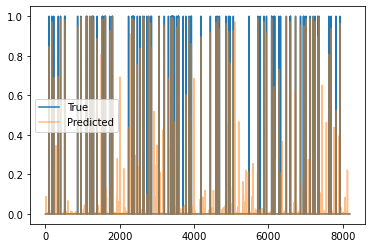

Train Epoch: 3 [310/2220 (13%)]	Loss: 0.010544	Pres: 0.002930	F1 Score: 0.002930
Train Epoch: 3 [320/2220 (14%)]	Loss: 0.007132	Pres: 0.002319	F1 Score: 0.002319
Train Epoch: 3 [330/2220 (14%)]	Loss: 0.007735	Pres: 0.002197	F1 Score: 0.002197
Train Epoch: 3 [340/2220 (15%)]	Loss: 0.009453	Pres: 0.002319	F1 Score: 0.002319
Train Epoch: 3 [350/2220 (15%)]	Loss: 0.006585	Pres: 0.002319	F1 Score: 0.002319
Train Epoch: 3 [360/2220 (16%)]	Loss: 0.009071	Pres: 0.002930	F1 Score: 0.002930
Train Epoch: 3 [370/2220 (16%)]	Loss: 0.009462	Pres: 0.002930	F1 Score: 0.002930
Train Epoch: 3 [380/2220 (17%)]	Loss: 0.007067	Pres: 0.002563	F1 Score: 0.002563
Train Epoch: 3 [390/2220 (17%)]	Loss: 0.009589	Pres: 0.002197	F1 Score: 0.002197
Train Epoch: 3 [400/2220 (18%)]	Loss: 0.013274	Pres: 0.002686	F1 Score: 0.002686
Train Epoch: 3 [410/2220 (18%)]	Loss: 0.009438	Pres: 0.002319	F1 Score: 0.002319
Train Epoch: 3 [420/2220 (18%)]	Loss: 0.011988	Pres: 0.002319	F1 Score: 0.002319
Train Epoch: 3 [430/2220 (19

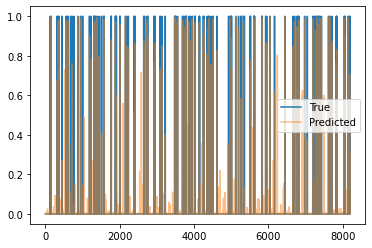

Train Epoch: 3 [610/2220 (27%)]	Loss: 0.013204	Pres: 0.003174	F1 Score: 0.003174
Train Epoch: 3 [620/2220 (27%)]	Loss: 0.013840	Pres: 0.001343	F1 Score: 0.001343
Train Epoch: 3 [630/2220 (28%)]	Loss: 0.011910	Pres: 0.003784	F1 Score: 0.003784
Train Epoch: 3 [640/2220 (28%)]	Loss: 0.015063	Pres: 0.002441	F1 Score: 0.002441
Train Epoch: 3 [650/2220 (29%)]	Loss: 0.012779	Pres: 0.004272	F1 Score: 0.004272
Train Epoch: 3 [660/2220 (29%)]	Loss: 0.017640	Pres: 0.003296	F1 Score: 0.003296
Train Epoch: 3 [670/2220 (30%)]	Loss: 0.012215	Pres: 0.004028	F1 Score: 0.004028
Train Epoch: 3 [680/2220 (30%)]	Loss: 0.013770	Pres: 0.003296	F1 Score: 0.003296
Train Epoch: 3 [690/2220 (31%)]	Loss: 0.012499	Pres: 0.002808	F1 Score: 0.002808
Train Epoch: 3 [700/2220 (31%)]	Loss: 0.012209	Pres: 0.003296	F1 Score: 0.003296
Train Epoch: 3 [710/2220 (31%)]	Loss: 0.012869	Pres: 0.003540	F1 Score: 0.003540
Train Epoch: 3 [720/2220 (32%)]	Loss: 0.010905	Pres: 0.002197	F1 Score: 0.002197
Train Epoch: 3 [730/2220 (32

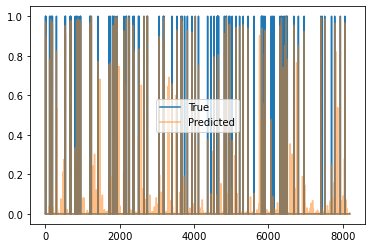

Train Epoch: 3 [910/2220 (40%)]	Loss: 0.015098	Pres: 0.002930	F1 Score: 0.002930
Train Epoch: 3 [920/2220 (41%)]	Loss: 0.010125	Pres: 0.002930	F1 Score: 0.002930
Train Epoch: 3 [930/2220 (41%)]	Loss: 0.008548	Pres: 0.003418	F1 Score: 0.003418
Train Epoch: 3 [940/2220 (42%)]	Loss: 0.009286	Pres: 0.002075	F1 Score: 0.002075
Train Epoch: 3 [950/2220 (42%)]	Loss: 0.008720	Pres: 0.003418	F1 Score: 0.003418
Train Epoch: 3 [960/2220 (43%)]	Loss: 0.012566	Pres: 0.003540	F1 Score: 0.003540
Train Epoch: 3 [970/2220 (43%)]	Loss: 0.010865	Pres: 0.002075	F1 Score: 0.002075
Train Epoch: 3 [980/2220 (44%)]	Loss: 0.009387	Pres: 0.002930	F1 Score: 0.002930
Train Epoch: 3 [990/2220 (44%)]	Loss: 0.008640	Pres: 0.001953	F1 Score: 0.001953
Train Epoch: 3 [1000/2220 (45%)]	Loss: 0.010995	Pres: 0.001831	F1 Score: 0.001831
Train Epoch: 3 [1010/2220 (45%)]	Loss: 0.010980	Pres: 0.003052	F1 Score: 0.003052
Train Epoch: 3 [1020/2220 (45%)]	Loss: 0.009328	Pres: 0.001953	F1 Score: 0.001953
Train Epoch: 3 [1030/2220

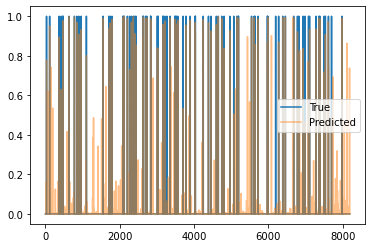

Train Epoch: 3 [1210/2220 (54%)]	Loss: 0.009142	Pres: 0.002319	F1 Score: 0.002319
Train Epoch: 3 [1220/2220 (54%)]	Loss: 0.010927	Pres: 0.002319	F1 Score: 0.002319
Train Epoch: 3 [1230/2220 (55%)]	Loss: 0.010249	Pres: 0.003052	F1 Score: 0.003052
Train Epoch: 3 [1240/2220 (55%)]	Loss: 0.010799	Pres: 0.002686	F1 Score: 0.002686
Train Epoch: 3 [1250/2220 (56%)]	Loss: 0.010600	Pres: 0.002197	F1 Score: 0.002197
Train Epoch: 3 [1260/2220 (56%)]	Loss: 0.010403	Pres: 0.002075	F1 Score: 0.002075
Train Epoch: 3 [1270/2220 (57%)]	Loss: 0.009585	Pres: 0.002808	F1 Score: 0.002808
Train Epoch: 3 [1280/2220 (57%)]	Loss: 0.028123	Pres: 0.003906	F1 Score: 0.003906
Train Epoch: 3 [1290/2220 (58%)]	Loss: 0.007893	Pres: 0.002808	F1 Score: 0.002808
Train Epoch: 3 [1300/2220 (58%)]	Loss: 0.009533	Pres: 0.002686	F1 Score: 0.002686
Train Epoch: 3 [1310/2220 (59%)]	Loss: 0.009338	Pres: 0.002319	F1 Score: 0.002319
Train Epoch: 3 [1320/2220 (59%)]	Loss: 0.010905	Pres: 0.003052	F1 Score: 0.003052
Train Epoch: 3 [

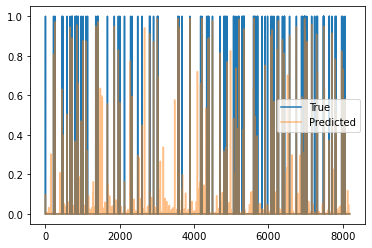

Train Epoch: 3 [1510/2220 (68%)]	Loss: 0.008452	Pres: 0.001465	F1 Score: 0.001465
Train Epoch: 3 [1520/2220 (68%)]	Loss: 0.009319	Pres: 0.001953	F1 Score: 0.001953
Train Epoch: 3 [1530/2220 (68%)]	Loss: 0.008009	Pres: 0.002075	F1 Score: 0.002075
Train Epoch: 3 [1540/2220 (69%)]	Loss: 0.009374	Pres: 0.001709	F1 Score: 0.001709
Train Epoch: 3 [1550/2220 (69%)]	Loss: 0.007519	Pres: 0.001587	F1 Score: 0.001587
Train Epoch: 3 [1560/2220 (70%)]	Loss: 0.013692	Pres: 0.002686	F1 Score: 0.002686
Train Epoch: 3 [1570/2220 (70%)]	Loss: 0.010123	Pres: 0.002197	F1 Score: 0.002197
Train Epoch: 3 [1580/2220 (71%)]	Loss: 0.004475	Pres: 0.001831	F1 Score: 0.001831
Train Epoch: 3 [1590/2220 (71%)]	Loss: 0.006521	Pres: 0.003174	F1 Score: 0.003174
Train Epoch: 3 [1600/2220 (72%)]	Loss: 0.007148	Pres: 0.001465	F1 Score: 0.001465
Train Epoch: 3 [1610/2220 (72%)]	Loss: 0.012852	Pres: 0.002197	F1 Score: 0.002197
Train Epoch: 3 [1620/2220 (72%)]	Loss: 0.010722	Pres: 0.003296	F1 Score: 0.003296
Train Epoch: 3 [

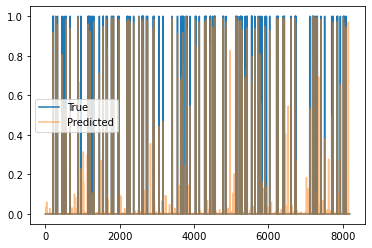

Train Epoch: 3 [1810/2220 (81%)]	Loss: 0.010454	Pres: 0.001343	F1 Score: 0.001343
Train Epoch: 3 [1820/2220 (81%)]	Loss: 0.007277	Pres: 0.002930	F1 Score: 0.002930
Train Epoch: 3 [1830/2220 (82%)]	Loss: 0.006648	Pres: 0.002808	F1 Score: 0.002808
Train Epoch: 3 [1840/2220 (82%)]	Loss: 0.008482	Pres: 0.002441	F1 Score: 0.002441
Train Epoch: 3 [1850/2220 (83%)]	Loss: 0.010674	Pres: 0.002441	F1 Score: 0.002441
Train Epoch: 3 [1860/2220 (83%)]	Loss: 0.008751	Pres: 0.002197	F1 Score: 0.002197
Train Epoch: 3 [1870/2220 (84%)]	Loss: 0.008745	Pres: 0.001831	F1 Score: 0.001831
Train Epoch: 3 [1880/2220 (84%)]	Loss: 0.007421	Pres: 0.002563	F1 Score: 0.002563
Train Epoch: 3 [1890/2220 (85%)]	Loss: 0.006803	Pres: 0.001587	F1 Score: 0.001587
Train Epoch: 3 [1900/2220 (85%)]	Loss: 0.008416	Pres: 0.001831	F1 Score: 0.001831
Train Epoch: 3 [1910/2220 (86%)]	Loss: 0.011340	Pres: 0.001709	F1 Score: 0.001709
Train Epoch: 3 [1920/2220 (86%)]	Loss: 0.008811	Pres: 0.001953	F1 Score: 0.001953
Train Epoch: 3 [

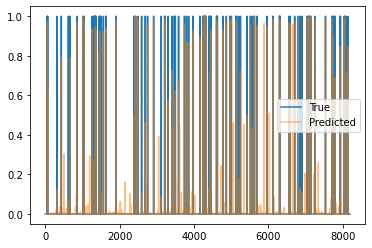

Train Epoch: 3 [2110/2220 (95%)]	Loss: 0.006279	Pres: 0.002197	F1 Score: 0.002197
Train Epoch: 3 [2120/2220 (95%)]	Loss: 0.009960	Pres: 0.003540	F1 Score: 0.003540
Train Epoch: 3 [2130/2220 (95%)]	Loss: 0.007933	Pres: 0.001465	F1 Score: 0.001465
Train Epoch: 3 [2140/2220 (96%)]	Loss: 0.007944	Pres: 0.001221	F1 Score: 0.001221
Train Epoch: 3 [2150/2220 (96%)]	Loss: 0.006375	Pres: 0.002075	F1 Score: 0.002075
Train Epoch: 3 [2160/2220 (97%)]	Loss: 0.009874	Pres: 0.001465	F1 Score: 0.001465
Train Epoch: 3 [2170/2220 (97%)]	Loss: 0.006203	Pres: 0.002197	F1 Score: 0.002197
Train Epoch: 3 [2180/2220 (98%)]	Loss: 0.008233	Pres: 0.002319	F1 Score: 0.002319
Train Epoch: 3 [2190/2220 (98%)]	Loss: 0.012067	Pres: 0.001099	F1 Score: 0.001099
Train Epoch: 3 [2200/2220 (99%)]	Loss: 0.006579	Pres: 0.002075	F1 Score: 0.002075
Train Epoch: 3 [2210/2220 (99%)]	Loss: 0.021255	Pres: 0.004150	F1 Score: 0.004150
Validation Epoch: 3 [0/582 (0%)]	Loss: 0.004387	Pres: 0.000732	F1 Score: 0.000732


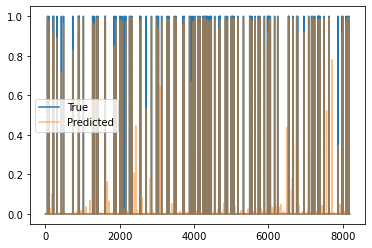

Validation Epoch: 3 [10/582 (1%)]	Loss: 0.004142	Pres: 0.001221	F1 Score: 0.001221
Validation Epoch: 3 [20/582 (3%)]	Loss: 0.002450	Pres: 0.000977	F1 Score: 0.000977
Validation Epoch: 3 [30/582 (5%)]	Loss: 0.005282	Pres: 0.001343	F1 Score: 0.001343
Validation Epoch: 3 [40/582 (6%)]	Loss: 0.006613	Pres: 0.001099	F1 Score: 0.001099
Validation Epoch: 3 [50/582 (8%)]	Loss: 0.007794	Pres: 0.000732	F1 Score: 0.000732
Validation Epoch: 3 [60/582 (10%)]	Loss: 0.004302	Pres: 0.001465	F1 Score: 0.001465
Validation Epoch: 3 [70/582 (12%)]	Loss: 0.001899	Pres: 0.000854	F1 Score: 0.000854
Validation Epoch: 3 [80/582 (13%)]	Loss: 0.006434	Pres: 0.001831	F1 Score: 0.001831
Validation Epoch: 3 [90/582 (15%)]	Loss: 0.004370	Pres: 0.000854	F1 Score: 0.000854
Validation Epoch: 3 [100/582 (17%)]	Loss: 0.004144	Pres: 0.001221	F1 Score: 0.001221
Validation Epoch: 3 [110/582 (18%)]	Loss: 0.003384	Pres: 0.001587	F1 Score: 0.001587
Validation Epoch: 3 [120/582 (20%)]	Loss: 0.006767	Pres: 0.001221	F1 Score: 0.0

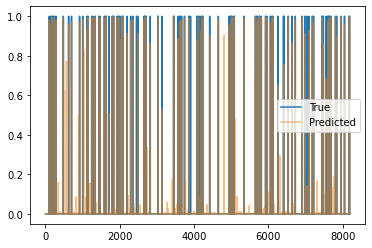

Validation Epoch: 3 [310/582 (53%)]	Loss: 0.004349	Pres: 0.001221	F1 Score: 0.001221
Validation Epoch: 3 [320/582 (54%)]	Loss: 0.005781	Pres: 0.001465	F1 Score: 0.001465
Validation Epoch: 3 [330/582 (56%)]	Loss: 0.004186	Pres: 0.001343	F1 Score: 0.001343
Validation Epoch: 3 [340/582 (58%)]	Loss: 0.002117	Pres: 0.001709	F1 Score: 0.001709
Validation Epoch: 3 [350/582 (60%)]	Loss: 0.004155	Pres: 0.001831	F1 Score: 0.001831
Validation Epoch: 3 [360/582 (61%)]	Loss: 0.002684	Pres: 0.000977	F1 Score: 0.000977
Validation Epoch: 3 [370/582 (63%)]	Loss: 0.005434	Pres: 0.000366	F1 Score: 0.000366
Validation Epoch: 3 [380/582 (65%)]	Loss: 0.002470	Pres: 0.001099	F1 Score: 0.001099
Validation Epoch: 3 [390/582 (67%)]	Loss: 0.003772	Pres: 0.001221	F1 Score: 0.001221
Validation Epoch: 3 [400/582 (68%)]	Loss: 0.003107	Pres: 0.001709	F1 Score: 0.001709
Validation Epoch: 3 [410/582 (70%)]	Loss: 0.003803	Pres: 0.001099	F1 Score: 0.001099
Validation Epoch: 3 [420/582 (72%)]	Loss: 0.003670	Pres: 0.000977

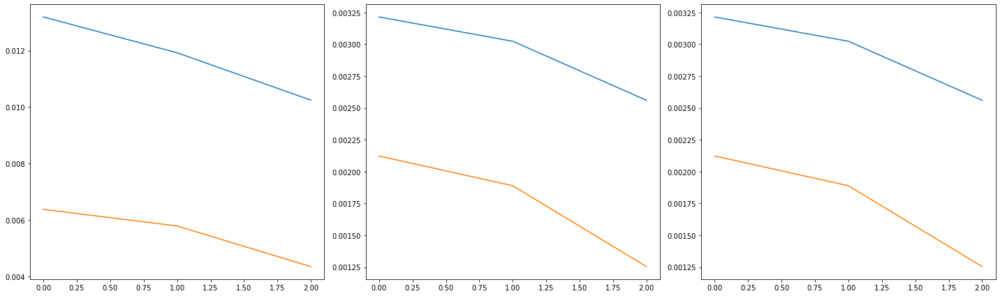

2220 582
Train Epoch: 4 [0/2220 (0%)]	Loss: 0.007901	Pres: 0.001709	F1 Score: 0.001709
108.0 -inf


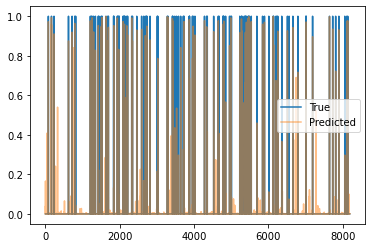

Train Epoch: 4 [10/2220 (0%)]	Loss: 0.006853	Pres: 0.000977	F1 Score: 0.000977
Train Epoch: 4 [20/2220 (0%)]	Loss: 0.009733	Pres: 0.001587	F1 Score: 0.001587
Train Epoch: 4 [30/2220 (1%)]	Loss: 0.008071	Pres: 0.002197	F1 Score: 0.002197
Train Epoch: 4 [40/2220 (1%)]	Loss: 0.011563	Pres: 0.002075	F1 Score: 0.002075
Train Epoch: 4 [50/2220 (2%)]	Loss: 0.005387	Pres: 0.002319	F1 Score: 0.002319
Train Epoch: 4 [60/2220 (2%)]	Loss: 0.007654	Pres: 0.002319	F1 Score: 0.002319
Train Epoch: 4 [70/2220 (3%)]	Loss: 0.009091	Pres: 0.002686	F1 Score: 0.002686
Train Epoch: 4 [80/2220 (3%)]	Loss: 0.008476	Pres: 0.002930	F1 Score: 0.002930
Train Epoch: 4 [90/2220 (4%)]	Loss: 0.009702	Pres: 0.002197	F1 Score: 0.002197
Train Epoch: 4 [100/2220 (4%)]	Loss: 0.007709	Pres: 0.002686	F1 Score: 0.002686
Train Epoch: 4 [110/2220 (4%)]	Loss: 0.007652	Pres: 0.002441	F1 Score: 0.002441
Train Epoch: 4 [120/2220 (5%)]	Loss: 0.007422	Pres: 0.001953	F1 Score: 0.001953
Train Epoch: 4 [130/2220 (5%)]	Loss: 0.009070	Pre

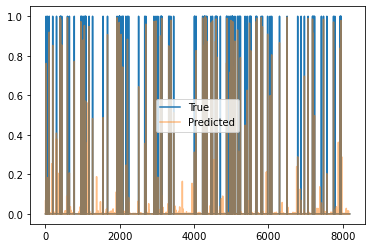

Train Epoch: 4 [310/2220 (13%)]	Loss: 0.008386	Pres: 0.002319	F1 Score: 0.002319
Train Epoch: 4 [320/2220 (14%)]	Loss: 0.008451	Pres: 0.001831	F1 Score: 0.001831
Train Epoch: 4 [330/2220 (14%)]	Loss: 0.008963	Pres: 0.001831	F1 Score: 0.001831
Train Epoch: 4 [340/2220 (15%)]	Loss: 0.007079	Pres: 0.001709	F1 Score: 0.001709
Train Epoch: 4 [350/2220 (15%)]	Loss: 0.008419	Pres: 0.000977	F1 Score: 0.000977
Train Epoch: 4 [360/2220 (16%)]	Loss: 0.010807	Pres: 0.001953	F1 Score: 0.001953
Train Epoch: 4 [370/2220 (16%)]	Loss: 0.004971	Pres: 0.001343	F1 Score: 0.001343
Train Epoch: 4 [380/2220 (17%)]	Loss: 0.007656	Pres: 0.001587	F1 Score: 0.001587
Train Epoch: 4 [390/2220 (17%)]	Loss: 0.007293	Pres: 0.002075	F1 Score: 0.002075
Train Epoch: 4 [400/2220 (18%)]	Loss: 0.008582	Pres: 0.001953	F1 Score: 0.001953
Train Epoch: 4 [410/2220 (18%)]	Loss: 0.010055	Pres: 0.002808	F1 Score: 0.002808
Train Epoch: 4 [420/2220 (18%)]	Loss: 0.009300	Pres: 0.001831	F1 Score: 0.001831
Train Epoch: 4 [430/2220 (19

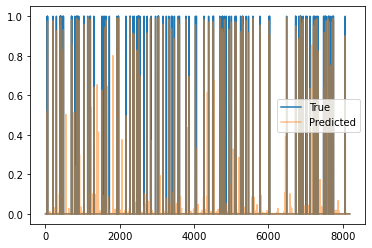

Train Epoch: 4 [610/2220 (27%)]	Loss: 0.007465	Pres: 0.002197	F1 Score: 0.002197
Train Epoch: 4 [620/2220 (27%)]	Loss: 0.010711	Pres: 0.001709	F1 Score: 0.001709
Train Epoch: 4 [630/2220 (28%)]	Loss: 0.006420	Pres: 0.001709	F1 Score: 0.001709
Train Epoch: 4 [640/2220 (28%)]	Loss: 0.006637	Pres: 0.001709	F1 Score: 0.001709
Train Epoch: 4 [650/2220 (29%)]	Loss: 0.006437	Pres: 0.002808	F1 Score: 0.002808
Train Epoch: 4 [660/2220 (29%)]	Loss: 0.008123	Pres: 0.001953	F1 Score: 0.001953
Train Epoch: 4 [670/2220 (30%)]	Loss: 0.006687	Pres: 0.002197	F1 Score: 0.002197
Train Epoch: 4 [680/2220 (30%)]	Loss: 0.010481	Pres: 0.002686	F1 Score: 0.002686
Train Epoch: 4 [690/2220 (31%)]	Loss: 0.005688	Pres: 0.002563	F1 Score: 0.002563
Train Epoch: 4 [700/2220 (31%)]	Loss: 0.010763	Pres: 0.001709	F1 Score: 0.001709
Train Epoch: 4 [710/2220 (31%)]	Loss: 0.007458	Pres: 0.002319	F1 Score: 0.002319
Train Epoch: 4 [720/2220 (32%)]	Loss: 0.008193	Pres: 0.003052	F1 Score: 0.003052
Train Epoch: 4 [730/2220 (32

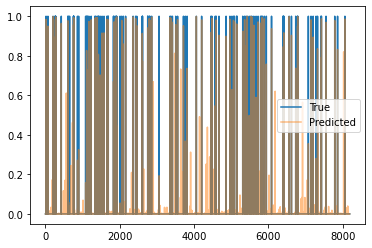

Train Epoch: 4 [910/2220 (40%)]	Loss: 0.008404	Pres: 0.002441	F1 Score: 0.002441
Train Epoch: 4 [920/2220 (41%)]	Loss: 0.006713	Pres: 0.001465	F1 Score: 0.001465
Train Epoch: 4 [930/2220 (41%)]	Loss: 0.007793	Pres: 0.001343	F1 Score: 0.001343
Train Epoch: 4 [940/2220 (42%)]	Loss: 0.006245	Pres: 0.002075	F1 Score: 0.002075
Train Epoch: 4 [950/2220 (42%)]	Loss: 0.009770	Pres: 0.001343	F1 Score: 0.001343
Train Epoch: 4 [960/2220 (43%)]	Loss: 0.007013	Pres: 0.001831	F1 Score: 0.001831
Train Epoch: 4 [970/2220 (43%)]	Loss: 0.007462	Pres: 0.002808	F1 Score: 0.002808
Train Epoch: 4 [980/2220 (44%)]	Loss: 0.008320	Pres: 0.001831	F1 Score: 0.001831
Train Epoch: 4 [990/2220 (44%)]	Loss: 0.007504	Pres: 0.001587	F1 Score: 0.001587
Train Epoch: 4 [1000/2220 (45%)]	Loss: 0.006632	Pres: 0.002075	F1 Score: 0.002075
Train Epoch: 4 [1010/2220 (45%)]	Loss: 0.009336	Pres: 0.000977	F1 Score: 0.000977
Train Epoch: 4 [1020/2220 (45%)]	Loss: 0.006525	Pres: 0.002075	F1 Score: 0.002075
Train Epoch: 4 [1030/2220

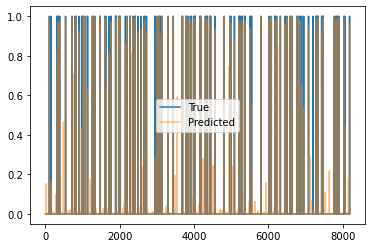

Train Epoch: 4 [1210/2220 (54%)]	Loss: 0.007450	Pres: 0.002197	F1 Score: 0.002197
Train Epoch: 4 [1220/2220 (54%)]	Loss: 0.007725	Pres: 0.001465	F1 Score: 0.001465
Train Epoch: 4 [1230/2220 (55%)]	Loss: 0.008623	Pres: 0.001221	F1 Score: 0.001221
Train Epoch: 4 [1240/2220 (55%)]	Loss: 0.030198	Pres: 0.004150	F1 Score: 0.004150
Train Epoch: 4 [1250/2220 (56%)]	Loss: 0.006731	Pres: 0.002197	F1 Score: 0.002197
Train Epoch: 4 [1260/2220 (56%)]	Loss: 0.006885	Pres: 0.001465	F1 Score: 0.001465
Train Epoch: 4 [1270/2220 (57%)]	Loss: 0.007984	Pres: 0.000854	F1 Score: 0.000854
Train Epoch: 4 [1280/2220 (57%)]	Loss: 0.005165	Pres: 0.001953	F1 Score: 0.001953
Train Epoch: 4 [1290/2220 (58%)]	Loss: 0.004558	Pres: 0.002197	F1 Score: 0.002197
Train Epoch: 4 [1300/2220 (58%)]	Loss: 0.008336	Pres: 0.002441	F1 Score: 0.002441
Train Epoch: 4 [1310/2220 (59%)]	Loss: 0.008183	Pres: 0.002197	F1 Score: 0.002197
Train Epoch: 4 [1320/2220 (59%)]	Loss: 0.007334	Pres: 0.001953	F1 Score: 0.001953
Train Epoch: 4 [

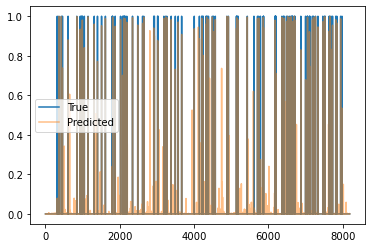

Train Epoch: 4 [1510/2220 (68%)]	Loss: 0.007815	Pres: 0.001343	F1 Score: 0.001343
Train Epoch: 4 [1520/2220 (68%)]	Loss: 0.006009	Pres: 0.002075	F1 Score: 0.002075
Train Epoch: 4 [1530/2220 (68%)]	Loss: 0.011340	Pres: 0.002075	F1 Score: 0.002075
Train Epoch: 4 [1540/2220 (69%)]	Loss: 0.008024	Pres: 0.002441	F1 Score: 0.002441
Train Epoch: 4 [1550/2220 (69%)]	Loss: 0.007681	Pres: 0.001587	F1 Score: 0.001587
Train Epoch: 4 [1560/2220 (70%)]	Loss: 0.007914	Pres: 0.001953	F1 Score: 0.001953
Train Epoch: 4 [1570/2220 (70%)]	Loss: 0.012927	Pres: 0.001831	F1 Score: 0.001831
Train Epoch: 4 [1580/2220 (71%)]	Loss: 0.011222	Pres: 0.001953	F1 Score: 0.001953
Train Epoch: 4 [1590/2220 (71%)]	Loss: 0.008154	Pres: 0.002441	F1 Score: 0.002441
Train Epoch: 4 [1600/2220 (72%)]	Loss: 0.007737	Pres: 0.002075	F1 Score: 0.002075
Train Epoch: 4 [1610/2220 (72%)]	Loss: 0.007603	Pres: 0.002686	F1 Score: 0.002686
Train Epoch: 4 [1620/2220 (72%)]	Loss: 0.006542	Pres: 0.002197	F1 Score: 0.002197
Train Epoch: 4 [

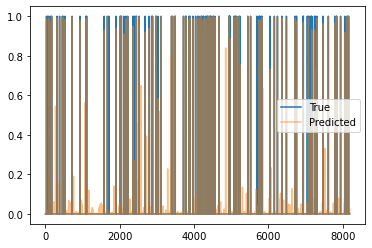

Train Epoch: 4 [1810/2220 (81%)]	Loss: 0.006202	Pres: 0.001221	F1 Score: 0.001221
Train Epoch: 4 [1820/2220 (81%)]	Loss: 0.008265	Pres: 0.002197	F1 Score: 0.002197
Train Epoch: 4 [1830/2220 (82%)]	Loss: 0.004434	Pres: 0.001465	F1 Score: 0.001465
Train Epoch: 4 [1840/2220 (82%)]	Loss: 0.005242	Pres: 0.001221	F1 Score: 0.001221
Train Epoch: 4 [1850/2220 (83%)]	Loss: 0.011715	Pres: 0.002319	F1 Score: 0.002319
Train Epoch: 4 [1860/2220 (83%)]	Loss: 0.007761	Pres: 0.001953	F1 Score: 0.001953
Train Epoch: 4 [1870/2220 (84%)]	Loss: 0.009175	Pres: 0.001587	F1 Score: 0.001587
Train Epoch: 4 [1880/2220 (84%)]	Loss: 0.010958	Pres: 0.001099	F1 Score: 0.001099
Train Epoch: 4 [1890/2220 (85%)]	Loss: 0.009119	Pres: 0.001343	F1 Score: 0.001343
Train Epoch: 4 [1900/2220 (85%)]	Loss: 0.006549	Pres: 0.001709	F1 Score: 0.001709
Train Epoch: 4 [1910/2220 (86%)]	Loss: 0.007072	Pres: 0.002075	F1 Score: 0.002075
Train Epoch: 4 [1920/2220 (86%)]	Loss: 0.034830	Pres: 0.002319	F1 Score: 0.002319
Train Epoch: 4 [

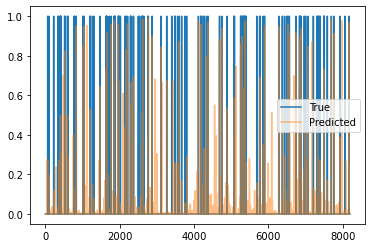

Train Epoch: 4 [2110/2220 (95%)]	Loss: 0.005202	Pres: 0.002197	F1 Score: 0.002197
Train Epoch: 4 [2120/2220 (95%)]	Loss: 0.005661	Pres: 0.002075	F1 Score: 0.002075
Train Epoch: 4 [2130/2220 (95%)]	Loss: 0.005201	Pres: 0.002563	F1 Score: 0.002563
Train Epoch: 4 [2140/2220 (96%)]	Loss: 0.006899	Pres: 0.002441	F1 Score: 0.002441
Train Epoch: 4 [2150/2220 (96%)]	Loss: 0.009717	Pres: 0.001831	F1 Score: 0.001831
Train Epoch: 4 [2160/2220 (97%)]	Loss: 0.006959	Pres: 0.001343	F1 Score: 0.001343
Train Epoch: 4 [2170/2220 (97%)]	Loss: 0.008016	Pres: 0.001465	F1 Score: 0.001465
Train Epoch: 4 [2180/2220 (98%)]	Loss: 0.007872	Pres: 0.001831	F1 Score: 0.001831
Train Epoch: 4 [2190/2220 (98%)]	Loss: 0.007145	Pres: 0.002319	F1 Score: 0.002319
Train Epoch: 4 [2200/2220 (99%)]	Loss: 0.010147	Pres: 0.001221	F1 Score: 0.001221
Train Epoch: 4 [2210/2220 (99%)]	Loss: 0.009210	Pres: 0.002563	F1 Score: 0.002563
Validation Epoch: 4 [0/582 (0%)]	Loss: 0.004529	Pres: 0.001343	F1 Score: 0.001343


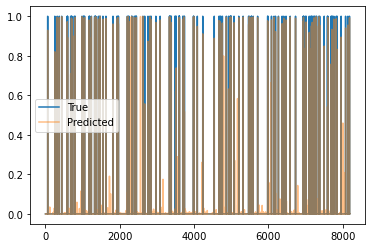

Validation Epoch: 4 [10/582 (1%)]	Loss: 0.004290	Pres: 0.001221	F1 Score: 0.001221
Validation Epoch: 4 [20/582 (3%)]	Loss: 0.003033	Pres: 0.001465	F1 Score: 0.001465
Validation Epoch: 4 [30/582 (5%)]	Loss: 0.005209	Pres: 0.001587	F1 Score: 0.001587
Validation Epoch: 4 [40/582 (6%)]	Loss: 0.004532	Pres: 0.002075	F1 Score: 0.002075
Validation Epoch: 4 [50/582 (8%)]	Loss: 0.003818	Pres: 0.002197	F1 Score: 0.002197
Validation Epoch: 4 [60/582 (10%)]	Loss: 0.003997	Pres: 0.001465	F1 Score: 0.001465
Validation Epoch: 4 [70/582 (12%)]	Loss: 0.005148	Pres: 0.001831	F1 Score: 0.001831
Validation Epoch: 4 [80/582 (13%)]	Loss: 0.004138	Pres: 0.001587	F1 Score: 0.001587
Validation Epoch: 4 [90/582 (15%)]	Loss: 0.002979	Pres: 0.002075	F1 Score: 0.002075
Validation Epoch: 4 [100/582 (17%)]	Loss: 0.003419	Pres: 0.001465	F1 Score: 0.001465
Validation Epoch: 4 [110/582 (18%)]	Loss: 0.002499	Pres: 0.001343	F1 Score: 0.001343
Validation Epoch: 4 [120/582 (20%)]	Loss: 0.004375	Pres: 0.001587	F1 Score: 0.0

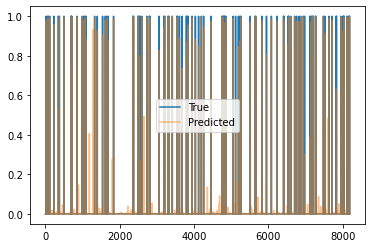

Validation Epoch: 4 [310/582 (53%)]	Loss: 0.003555	Pres: 0.002441	F1 Score: 0.002441
Validation Epoch: 4 [320/582 (54%)]	Loss: 0.004050	Pres: 0.001465	F1 Score: 0.001465
Validation Epoch: 4 [330/582 (56%)]	Loss: 0.003191	Pres: 0.001587	F1 Score: 0.001587
Validation Epoch: 4 [340/582 (58%)]	Loss: 0.003716	Pres: 0.001587	F1 Score: 0.001587
Validation Epoch: 4 [350/582 (60%)]	Loss: 0.004589	Pres: 0.001587	F1 Score: 0.001587
Validation Epoch: 4 [360/582 (61%)]	Loss: 0.004470	Pres: 0.001831	F1 Score: 0.001831
Validation Epoch: 4 [370/582 (63%)]	Loss: 0.004339	Pres: 0.001343	F1 Score: 0.001343
Validation Epoch: 4 [380/582 (65%)]	Loss: 0.004051	Pres: 0.001221	F1 Score: 0.001221
Validation Epoch: 4 [390/582 (67%)]	Loss: 0.003658	Pres: 0.002441	F1 Score: 0.002441
Validation Epoch: 4 [400/582 (68%)]	Loss: 0.003736	Pres: 0.001221	F1 Score: 0.001221
Validation Epoch: 4 [410/582 (70%)]	Loss: 0.004088	Pres: 0.002075	F1 Score: 0.002075
Validation Epoch: 4 [420/582 (72%)]	Loss: 0.003522	Pres: 0.000854

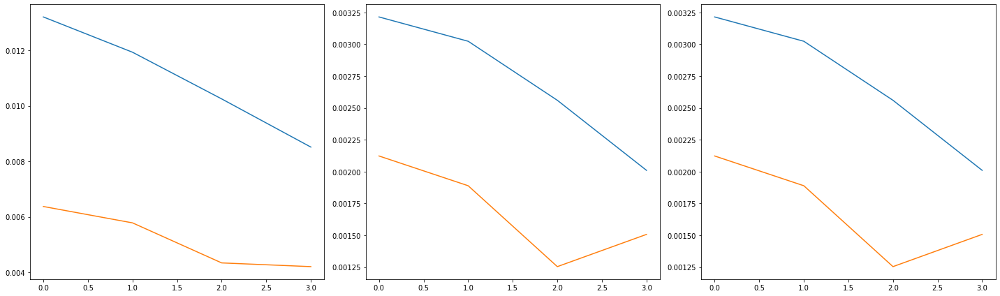

2220 582
Train Epoch: 5 [0/2220 (0%)]	Loss: 0.011363	Pres: 0.001831	F1 Score: 0.001831
98.0 -inf


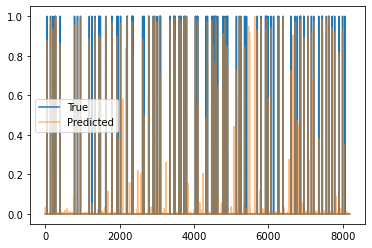

Train Epoch: 5 [10/2220 (0%)]	Loss: 0.006273	Pres: 0.002197	F1 Score: 0.002197
Train Epoch: 5 [20/2220 (0%)]	Loss: 0.007186	Pres: 0.001343	F1 Score: 0.001343
Train Epoch: 5 [30/2220 (1%)]	Loss: 0.007335	Pres: 0.001343	F1 Score: 0.001343
Train Epoch: 5 [40/2220 (1%)]	Loss: 0.006824	Pres: 0.001587	F1 Score: 0.001587
Train Epoch: 5 [50/2220 (2%)]	Loss: 0.005496	Pres: 0.001953	F1 Score: 0.001953
Train Epoch: 5 [60/2220 (2%)]	Loss: 0.008344	Pres: 0.001953	F1 Score: 0.001953
Train Epoch: 5 [70/2220 (3%)]	Loss: 0.011461	Pres: 0.002075	F1 Score: 0.002075
Train Epoch: 5 [80/2220 (3%)]	Loss: 0.007623	Pres: 0.002197	F1 Score: 0.002197
Train Epoch: 5 [90/2220 (4%)]	Loss: 0.009233	Pres: 0.001709	F1 Score: 0.001709
Train Epoch: 5 [100/2220 (4%)]	Loss: 0.006602	Pres: 0.001831	F1 Score: 0.001831
Train Epoch: 5 [110/2220 (4%)]	Loss: 0.004705	Pres: 0.002686	F1 Score: 0.002686
Train Epoch: 5 [120/2220 (5%)]	Loss: 0.006449	Pres: 0.001953	F1 Score: 0.001953
Train Epoch: 5 [130/2220 (5%)]	Loss: 0.007756	Pre

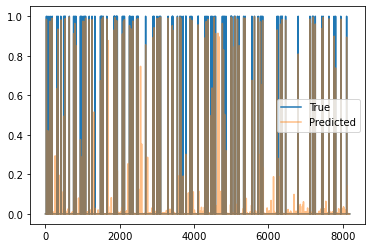

Train Epoch: 5 [310/2220 (13%)]	Loss: 0.007937	Pres: 0.001465	F1 Score: 0.001465
Train Epoch: 5 [320/2220 (14%)]	Loss: 0.008289	Pres: 0.001343	F1 Score: 0.001343
Train Epoch: 5 [330/2220 (14%)]	Loss: 0.004862	Pres: 0.001465	F1 Score: 0.001465
Train Epoch: 5 [340/2220 (15%)]	Loss: 0.007556	Pres: 0.001709	F1 Score: 0.001709
Train Epoch: 5 [350/2220 (15%)]	Loss: 0.008923	Pres: 0.000854	F1 Score: 0.000854
Train Epoch: 5 [360/2220 (16%)]	Loss: 0.006215	Pres: 0.001465	F1 Score: 0.001465
Train Epoch: 5 [370/2220 (16%)]	Loss: 0.006409	Pres: 0.002075	F1 Score: 0.002075
Train Epoch: 5 [380/2220 (17%)]	Loss: 0.007145	Pres: 0.002197	F1 Score: 0.002197
Train Epoch: 5 [390/2220 (17%)]	Loss: 0.009508	Pres: 0.001343	F1 Score: 0.001343
Train Epoch: 5 [400/2220 (18%)]	Loss: 0.008054	Pres: 0.001953	F1 Score: 0.001953
Train Epoch: 5 [410/2220 (18%)]	Loss: 0.007938	Pres: 0.002686	F1 Score: 0.002686
Train Epoch: 5 [420/2220 (18%)]	Loss: 0.005998	Pres: 0.001343	F1 Score: 0.001343
Train Epoch: 5 [430/2220 (19

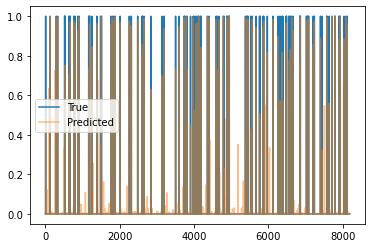

Train Epoch: 5 [610/2220 (27%)]	Loss: 0.006451	Pres: 0.001709	F1 Score: 0.001709
Train Epoch: 5 [620/2220 (27%)]	Loss: 0.007383	Pres: 0.000977	F1 Score: 0.000977
Train Epoch: 5 [630/2220 (28%)]	Loss: 0.005766	Pres: 0.001465	F1 Score: 0.001465
Train Epoch: 5 [640/2220 (28%)]	Loss: 0.006391	Pres: 0.001343	F1 Score: 0.001343
Train Epoch: 5 [650/2220 (29%)]	Loss: 0.005146	Pres: 0.001465	F1 Score: 0.001465
Train Epoch: 5 [660/2220 (29%)]	Loss: 0.004656	Pres: 0.001831	F1 Score: 0.001831
Train Epoch: 5 [670/2220 (30%)]	Loss: 0.009326	Pres: 0.001953	F1 Score: 0.001953
Train Epoch: 5 [680/2220 (30%)]	Loss: 0.008503	Pres: 0.001343	F1 Score: 0.001343
Train Epoch: 5 [690/2220 (31%)]	Loss: 0.005026	Pres: 0.000977	F1 Score: 0.000977
Train Epoch: 5 [700/2220 (31%)]	Loss: 0.006378	Pres: 0.001709	F1 Score: 0.001709
Train Epoch: 5 [710/2220 (31%)]	Loss: 0.007093	Pres: 0.001099	F1 Score: 0.001099
Train Epoch: 5 [720/2220 (32%)]	Loss: 0.004476	Pres: 0.000977	F1 Score: 0.000977
Train Epoch: 5 [730/2220 (32

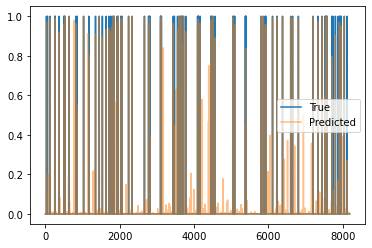

Train Epoch: 5 [910/2220 (40%)]	Loss: 0.006709	Pres: 0.001465	F1 Score: 0.001465
Train Epoch: 5 [920/2220 (41%)]	Loss: 0.005388	Pres: 0.001221	F1 Score: 0.001221
Train Epoch: 5 [930/2220 (41%)]	Loss: 0.005702	Pres: 0.000610	F1 Score: 0.000610
Train Epoch: 5 [940/2220 (42%)]	Loss: 0.007606	Pres: 0.001099	F1 Score: 0.001099
Train Epoch: 5 [950/2220 (42%)]	Loss: 0.006318	Pres: 0.001465	F1 Score: 0.001465
Train Epoch: 5 [960/2220 (43%)]	Loss: 0.008437	Pres: 0.002319	F1 Score: 0.002319
Train Epoch: 5 [970/2220 (43%)]	Loss: 0.031421	Pres: 0.008423	F1 Score: 0.008423
Train Epoch: 5 [980/2220 (44%)]	Loss: 0.006594	Pres: 0.001953	F1 Score: 0.001953
Train Epoch: 5 [990/2220 (44%)]	Loss: 0.008839	Pres: 0.000854	F1 Score: 0.000854
Train Epoch: 5 [1000/2220 (45%)]	Loss: 0.011704	Pres: 0.002075	F1 Score: 0.002075
Train Epoch: 5 [1010/2220 (45%)]	Loss: 0.005434	Pres: 0.000854	F1 Score: 0.000854
Train Epoch: 5 [1020/2220 (45%)]	Loss: 0.005909	Pres: 0.002075	F1 Score: 0.002075
Train Epoch: 5 [1030/2220

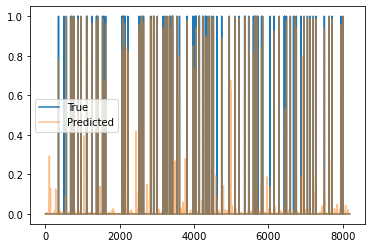

Train Epoch: 5 [1210/2220 (54%)]	Loss: 0.009259	Pres: 0.001343	F1 Score: 0.001343
Train Epoch: 5 [1220/2220 (54%)]	Loss: 0.005252	Pres: 0.001343	F1 Score: 0.001343
Train Epoch: 5 [1230/2220 (55%)]	Loss: 0.007041	Pres: 0.001709	F1 Score: 0.001709
Train Epoch: 5 [1240/2220 (55%)]	Loss: 0.008761	Pres: 0.001099	F1 Score: 0.001099
Train Epoch: 5 [1250/2220 (56%)]	Loss: 0.007431	Pres: 0.002441	F1 Score: 0.002441
Train Epoch: 5 [1260/2220 (56%)]	Loss: 0.007355	Pres: 0.001221	F1 Score: 0.001221
Train Epoch: 5 [1270/2220 (57%)]	Loss: 0.007309	Pres: 0.001831	F1 Score: 0.001831
Train Epoch: 5 [1280/2220 (57%)]	Loss: 0.007851	Pres: 0.002319	F1 Score: 0.002319
Train Epoch: 5 [1290/2220 (58%)]	Loss: 0.005159	Pres: 0.001099	F1 Score: 0.001099
Train Epoch: 5 [1300/2220 (58%)]	Loss: 0.027665	Pres: 0.008423	F1 Score: 0.008423
Train Epoch: 5 [1310/2220 (59%)]	Loss: 0.005707	Pres: 0.001465	F1 Score: 0.001465
Train Epoch: 5 [1320/2220 (59%)]	Loss: 0.005658	Pres: 0.001465	F1 Score: 0.001465
Train Epoch: 5 [

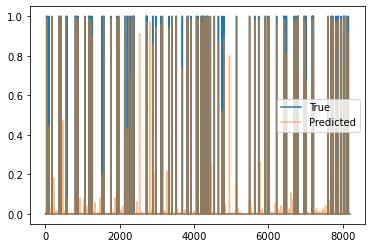

Train Epoch: 5 [1510/2220 (68%)]	Loss: 0.006987	Pres: 0.000854	F1 Score: 0.000854
Train Epoch: 5 [1520/2220 (68%)]	Loss: 0.007710	Pres: 0.001099	F1 Score: 0.001099
Train Epoch: 5 [1530/2220 (68%)]	Loss: 0.008580	Pres: 0.001099	F1 Score: 0.001099
Train Epoch: 5 [1540/2220 (69%)]	Loss: 0.007566	Pres: 0.001831	F1 Score: 0.001831
Train Epoch: 5 [1550/2220 (69%)]	Loss: 0.005069	Pres: 0.002808	F1 Score: 0.002808
Train Epoch: 5 [1560/2220 (70%)]	Loss: 0.007253	Pres: 0.001831	F1 Score: 0.001831
Train Epoch: 5 [1570/2220 (70%)]	Loss: 0.007337	Pres: 0.001709	F1 Score: 0.001709
Train Epoch: 5 [1580/2220 (71%)]	Loss: 0.004715	Pres: 0.002197	F1 Score: 0.002197
Train Epoch: 5 [1590/2220 (71%)]	Loss: 0.007967	Pres: 0.002808	F1 Score: 0.002808
Train Epoch: 5 [1600/2220 (72%)]	Loss: 0.010315	Pres: 0.002197	F1 Score: 0.002197
Train Epoch: 5 [1610/2220 (72%)]	Loss: 0.009808	Pres: 0.001831	F1 Score: 0.001831
Train Epoch: 5 [1620/2220 (72%)]	Loss: 0.006429	Pres: 0.002319	F1 Score: 0.002319
Train Epoch: 5 [

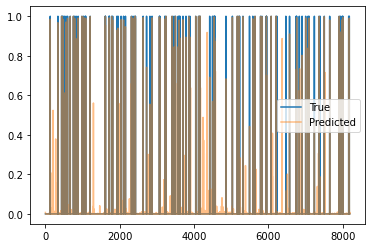

Train Epoch: 5 [1810/2220 (81%)]	Loss: 0.009100	Pres: 0.001831	F1 Score: 0.001831
Train Epoch: 5 [1820/2220 (81%)]	Loss: 0.007548	Pres: 0.001343	F1 Score: 0.001343
Train Epoch: 5 [1830/2220 (82%)]	Loss: 0.005449	Pres: 0.001343	F1 Score: 0.001343
Train Epoch: 5 [1840/2220 (82%)]	Loss: 0.008764	Pres: 0.001831	F1 Score: 0.001831
Train Epoch: 5 [1850/2220 (83%)]	Loss: 0.007241	Pres: 0.001099	F1 Score: 0.001099
Train Epoch: 5 [1860/2220 (83%)]	Loss: 0.007125	Pres: 0.002197	F1 Score: 0.002197
Train Epoch: 5 [1870/2220 (84%)]	Loss: 0.005374	Pres: 0.001709	F1 Score: 0.001709
Train Epoch: 5 [1880/2220 (84%)]	Loss: 0.007434	Pres: 0.001465	F1 Score: 0.001465
Train Epoch: 5 [1890/2220 (85%)]	Loss: 0.008293	Pres: 0.002319	F1 Score: 0.002319
Train Epoch: 5 [1900/2220 (85%)]	Loss: 0.008123	Pres: 0.002441	F1 Score: 0.002441
Train Epoch: 5 [1910/2220 (86%)]	Loss: 0.013100	Pres: 0.002808	F1 Score: 0.002808
Train Epoch: 5 [1920/2220 (86%)]	Loss: 0.006214	Pres: 0.001709	F1 Score: 0.001709
Train Epoch: 5 [

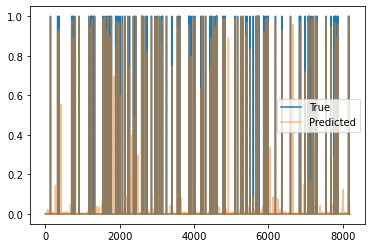

Train Epoch: 5 [2110/2220 (95%)]	Loss: 0.008462	Pres: 0.001831	F1 Score: 0.001831
Train Epoch: 5 [2120/2220 (95%)]	Loss: 0.006199	Pres: 0.001343	F1 Score: 0.001343
Train Epoch: 5 [2130/2220 (95%)]	Loss: 0.006974	Pres: 0.001709	F1 Score: 0.001709
Train Epoch: 5 [2140/2220 (96%)]	Loss: 0.009315	Pres: 0.000732	F1 Score: 0.000732
Train Epoch: 5 [2150/2220 (96%)]	Loss: 0.007130	Pres: 0.001465	F1 Score: 0.001465
Train Epoch: 5 [2160/2220 (97%)]	Loss: 0.006412	Pres: 0.001343	F1 Score: 0.001343
Train Epoch: 5 [2170/2220 (97%)]	Loss: 0.006492	Pres: 0.001221	F1 Score: 0.001221
Train Epoch: 5 [2180/2220 (98%)]	Loss: 0.007354	Pres: 0.001465	F1 Score: 0.001465
Train Epoch: 5 [2190/2220 (98%)]	Loss: 0.007632	Pres: 0.001343	F1 Score: 0.001343
Train Epoch: 5 [2200/2220 (99%)]	Loss: 0.003964	Pres: 0.001221	F1 Score: 0.001221
Train Epoch: 5 [2210/2220 (99%)]	Loss: 0.006188	Pres: 0.000854	F1 Score: 0.000854
Validation Epoch: 5 [0/582 (0%)]	Loss: 0.032599	Pres: 0.000122	F1 Score: 0.000122


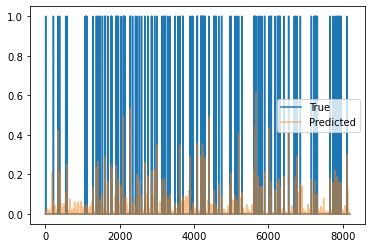

Validation Epoch: 5 [10/582 (1%)]	Loss: 0.027226	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 5 [20/582 (3%)]	Loss: 0.029959	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 5 [30/582 (5%)]	Loss: 0.027339	Pres: 0.000244	F1 Score: 0.000244
Validation Epoch: 5 [40/582 (6%)]	Loss: 0.028507	Pres: 0.000122	F1 Score: 0.000122
Validation Epoch: 5 [50/582 (8%)]	Loss: 0.030846	Pres: 0.000244	F1 Score: 0.000244
Validation Epoch: 5 [60/582 (10%)]	Loss: 0.028033	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 5 [70/582 (12%)]	Loss: 0.025212	Pres: 0.000366	F1 Score: 0.000366
Validation Epoch: 5 [80/582 (13%)]	Loss: 0.025892	Pres: 0.000244	F1 Score: 0.000244
Validation Epoch: 5 [90/582 (15%)]	Loss: 0.024987	Pres: 0.000122	F1 Score: 0.000122
Validation Epoch: 5 [100/582 (17%)]	Loss: 0.028964	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 5 [110/582 (18%)]	Loss: 0.027396	Pres: 0.000366	F1 Score: 0.000366
Validation Epoch: 5 [120/582 (20%)]	Loss: 0.029750	Pres: 0.000488	F1 Score: 0.0

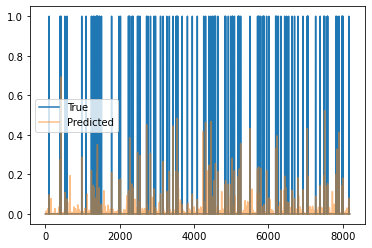

Validation Epoch: 5 [310/582 (53%)]	Loss: 0.030350	Pres: 0.000244	F1 Score: 0.000244
Validation Epoch: 5 [320/582 (54%)]	Loss: 0.027859	Pres: 0.000488	F1 Score: 0.000488
Validation Epoch: 5 [330/582 (56%)]	Loss: 0.024817	Pres: 0.000244	F1 Score: 0.000244
Validation Epoch: 5 [340/582 (58%)]	Loss: 0.031866	Pres: 0.000244	F1 Score: 0.000244
Validation Epoch: 5 [350/582 (60%)]	Loss: 0.023030	Pres: 0.000122	F1 Score: 0.000122
Validation Epoch: 5 [360/582 (61%)]	Loss: 0.028339	Pres: 0.000122	F1 Score: 0.000122
Validation Epoch: 5 [370/582 (63%)]	Loss: 0.031528	Pres: 0.000122	F1 Score: 0.000122
Validation Epoch: 5 [380/582 (65%)]	Loss: 0.029748	Pres: 0.000366	F1 Score: 0.000366
Validation Epoch: 5 [390/582 (67%)]	Loss: 0.026030	Pres: 0.000244	F1 Score: 0.000244
Validation Epoch: 5 [400/582 (68%)]	Loss: 0.025792	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 5 [410/582 (70%)]	Loss: 0.028362	Pres: 0.000366	F1 Score: 0.000366
Validation Epoch: 5 [420/582 (72%)]	Loss: 0.029693	Pres: 0.000000

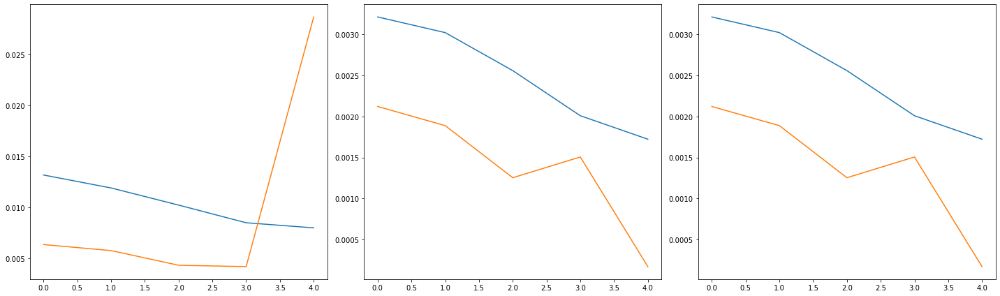

2220 582
Train Epoch: 6 [0/2220 (0%)]	Loss: 0.007448	Pres: 0.001587	F1 Score: 0.001587
113.0 -inf


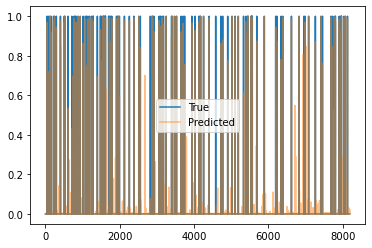

Train Epoch: 6 [10/2220 (0%)]	Loss: 0.005153	Pres: 0.001831	F1 Score: 0.001831
Train Epoch: 6 [20/2220 (0%)]	Loss: 0.009648	Pres: 0.002197	F1 Score: 0.002197
Train Epoch: 6 [30/2220 (1%)]	Loss: 0.008852	Pres: 0.001953	F1 Score: 0.001953
Train Epoch: 6 [40/2220 (1%)]	Loss: 0.006656	Pres: 0.002197	F1 Score: 0.002197
Train Epoch: 6 [50/2220 (2%)]	Loss: 0.005368	Pres: 0.001953	F1 Score: 0.001953
Train Epoch: 6 [60/2220 (2%)]	Loss: 0.006705	Pres: 0.001465	F1 Score: 0.001465
Train Epoch: 6 [70/2220 (3%)]	Loss: 0.009148	Pres: 0.000610	F1 Score: 0.000610
Train Epoch: 6 [80/2220 (3%)]	Loss: 0.006136	Pres: 0.002197	F1 Score: 0.002197
Train Epoch: 6 [90/2220 (4%)]	Loss: 0.008023	Pres: 0.001465	F1 Score: 0.001465
Train Epoch: 6 [100/2220 (4%)]	Loss: 0.007070	Pres: 0.001587	F1 Score: 0.001587
Train Epoch: 6 [110/2220 (4%)]	Loss: 0.006419	Pres: 0.001221	F1 Score: 0.001221
Train Epoch: 6 [120/2220 (5%)]	Loss: 0.011537	Pres: 0.001709	F1 Score: 0.001709
Train Epoch: 6 [130/2220 (5%)]	Loss: 0.011243	Pre

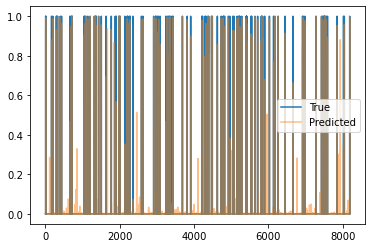

Train Epoch: 6 [310/2220 (13%)]	Loss: 0.010869	Pres: 0.001831	F1 Score: 0.001831
Train Epoch: 6 [320/2220 (14%)]	Loss: 0.005025	Pres: 0.001465	F1 Score: 0.001465
Train Epoch: 6 [330/2220 (14%)]	Loss: 0.009452	Pres: 0.001343	F1 Score: 0.001343
Train Epoch: 6 [340/2220 (15%)]	Loss: 0.006672	Pres: 0.001953	F1 Score: 0.001953
Train Epoch: 6 [350/2220 (15%)]	Loss: 0.007404	Pres: 0.001343	F1 Score: 0.001343
Train Epoch: 6 [360/2220 (16%)]	Loss: 0.005126	Pres: 0.001343	F1 Score: 0.001343
Train Epoch: 6 [370/2220 (16%)]	Loss: 0.007095	Pres: 0.001343	F1 Score: 0.001343
Train Epoch: 6 [380/2220 (17%)]	Loss: 0.005195	Pres: 0.001343	F1 Score: 0.001343
Train Epoch: 6 [390/2220 (17%)]	Loss: 0.007239	Pres: 0.001343	F1 Score: 0.001343
Train Epoch: 6 [400/2220 (18%)]	Loss: 0.007196	Pres: 0.001343	F1 Score: 0.001343
Train Epoch: 6 [410/2220 (18%)]	Loss: 0.007859	Pres: 0.001343	F1 Score: 0.001343
Train Epoch: 6 [420/2220 (18%)]	Loss: 0.005804	Pres: 0.001709	F1 Score: 0.001709
Train Epoch: 6 [430/2220 (19

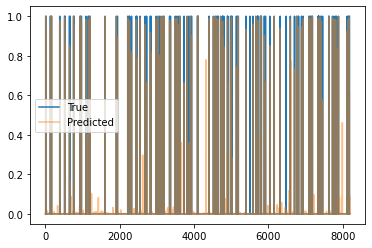

Train Epoch: 6 [610/2220 (27%)]	Loss: 0.008967	Pres: 0.001587	F1 Score: 0.001587
Train Epoch: 6 [620/2220 (27%)]	Loss: 0.007592	Pres: 0.002197	F1 Score: 0.002197
Train Epoch: 6 [630/2220 (28%)]	Loss: 0.006874	Pres: 0.002563	F1 Score: 0.002563
Train Epoch: 6 [640/2220 (28%)]	Loss: 0.016904	Pres: 0.003906	F1 Score: 0.003906
Train Epoch: 6 [650/2220 (29%)]	Loss: 0.004326	Pres: 0.002319	F1 Score: 0.002319
Train Epoch: 6 [660/2220 (29%)]	Loss: 0.008233	Pres: 0.002319	F1 Score: 0.002319
Train Epoch: 6 [670/2220 (30%)]	Loss: 0.050041	Pres: 0.001099	F1 Score: 0.001099
Train Epoch: 6 [680/2220 (30%)]	Loss: 0.008474	Pres: 0.001953	F1 Score: 0.001953
Train Epoch: 6 [690/2220 (31%)]	Loss: 0.007304	Pres: 0.001343	F1 Score: 0.001343
Train Epoch: 6 [700/2220 (31%)]	Loss: 0.007321	Pres: 0.001099	F1 Score: 0.001099
Train Epoch: 6 [710/2220 (31%)]	Loss: 0.006247	Pres: 0.001953	F1 Score: 0.001953
Train Epoch: 6 [720/2220 (32%)]	Loss: 0.006963	Pres: 0.002197	F1 Score: 0.002197
Train Epoch: 6 [730/2220 (32

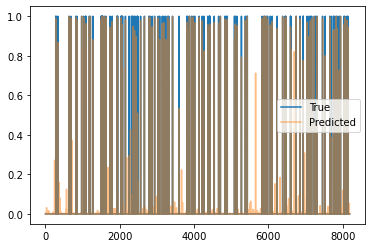

Train Epoch: 6 [910/2220 (40%)]	Loss: 0.011046	Pres: 0.001465	F1 Score: 0.001465
Train Epoch: 6 [920/2220 (41%)]	Loss: 0.006456	Pres: 0.001587	F1 Score: 0.001587
Train Epoch: 6 [930/2220 (41%)]	Loss: 0.007901	Pres: 0.000977	F1 Score: 0.000977
Train Epoch: 6 [940/2220 (42%)]	Loss: 0.007067	Pres: 0.001587	F1 Score: 0.001587
Train Epoch: 6 [950/2220 (42%)]	Loss: 0.006210	Pres: 0.001831	F1 Score: 0.001831
Train Epoch: 6 [960/2220 (43%)]	Loss: 0.008077	Pres: 0.001465	F1 Score: 0.001465
Train Epoch: 6 [970/2220 (43%)]	Loss: 0.009020	Pres: 0.001709	F1 Score: 0.001709
Train Epoch: 6 [980/2220 (44%)]	Loss: 0.007358	Pres: 0.002808	F1 Score: 0.002808
Train Epoch: 6 [990/2220 (44%)]	Loss: 0.007472	Pres: 0.001343	F1 Score: 0.001343
Train Epoch: 6 [1000/2220 (45%)]	Loss: 0.009338	Pres: 0.000977	F1 Score: 0.000977
Train Epoch: 6 [1010/2220 (45%)]	Loss: 0.007879	Pres: 0.001587	F1 Score: 0.001587
Train Epoch: 6 [1020/2220 (45%)]	Loss: 0.007455	Pres: 0.002075	F1 Score: 0.002075
Train Epoch: 6 [1030/2220

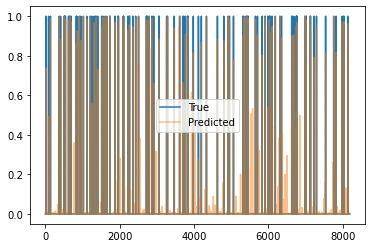

Train Epoch: 6 [1210/2220 (54%)]	Loss: 0.007724	Pres: 0.001709	F1 Score: 0.001709
Train Epoch: 6 [1220/2220 (54%)]	Loss: 0.006411	Pres: 0.001831	F1 Score: 0.001831
Train Epoch: 6 [1230/2220 (55%)]	Loss: 0.009364	Pres: 0.000977	F1 Score: 0.000977
Train Epoch: 6 [1240/2220 (55%)]	Loss: 0.009123	Pres: 0.001465	F1 Score: 0.001465
Train Epoch: 6 [1250/2220 (56%)]	Loss: 0.010586	Pres: 0.002075	F1 Score: 0.002075
Train Epoch: 6 [1260/2220 (56%)]	Loss: 0.008242	Pres: 0.002686	F1 Score: 0.002686
Train Epoch: 6 [1270/2220 (57%)]	Loss: 0.007325	Pres: 0.001709	F1 Score: 0.001709
Train Epoch: 6 [1280/2220 (57%)]	Loss: 0.006875	Pres: 0.002075	F1 Score: 0.002075
Train Epoch: 6 [1290/2220 (58%)]	Loss: 0.007100	Pres: 0.001709	F1 Score: 0.001709
Train Epoch: 6 [1300/2220 (58%)]	Loss: 0.007743	Pres: 0.002075	F1 Score: 0.002075
Train Epoch: 6 [1310/2220 (59%)]	Loss: 0.007964	Pres: 0.002319	F1 Score: 0.002319
Train Epoch: 6 [1320/2220 (59%)]	Loss: 0.006773	Pres: 0.002563	F1 Score: 0.002563
Train Epoch: 6 [

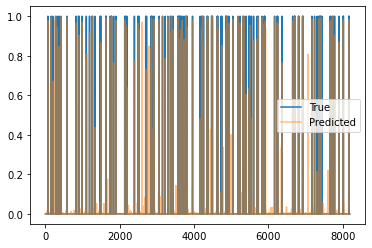

Train Epoch: 6 [1510/2220 (68%)]	Loss: 0.012352	Pres: 0.001709	F1 Score: 0.001709
Train Epoch: 6 [1520/2220 (68%)]	Loss: 0.005156	Pres: 0.001709	F1 Score: 0.001709
Train Epoch: 6 [1530/2220 (68%)]	Loss: 0.007065	Pres: 0.002075	F1 Score: 0.002075
Train Epoch: 6 [1540/2220 (69%)]	Loss: 0.007486	Pres: 0.002563	F1 Score: 0.002563
Train Epoch: 6 [1550/2220 (69%)]	Loss: 0.013066	Pres: 0.001343	F1 Score: 0.001343
Train Epoch: 6 [1560/2220 (70%)]	Loss: 0.006898	Pres: 0.001953	F1 Score: 0.001953
Train Epoch: 6 [1570/2220 (70%)]	Loss: 0.006817	Pres: 0.002319	F1 Score: 0.002319
Train Epoch: 6 [1580/2220 (71%)]	Loss: 0.010274	Pres: 0.002686	F1 Score: 0.002686
Train Epoch: 6 [1590/2220 (71%)]	Loss: 0.010199	Pres: 0.001953	F1 Score: 0.001953
Train Epoch: 6 [1600/2220 (72%)]	Loss: 0.009672	Pres: 0.003052	F1 Score: 0.003052
Train Epoch: 6 [1610/2220 (72%)]	Loss: 0.007726	Pres: 0.001831	F1 Score: 0.001831
Train Epoch: 6 [1620/2220 (72%)]	Loss: 0.007448	Pres: 0.001709	F1 Score: 0.001709
Train Epoch: 6 [

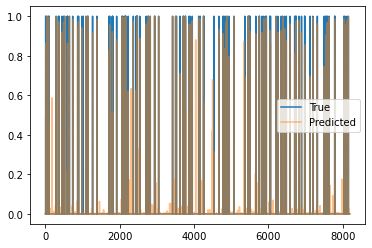

Train Epoch: 6 [1810/2220 (81%)]	Loss: 0.010612	Pres: 0.001953	F1 Score: 0.001953
Train Epoch: 6 [1820/2220 (81%)]	Loss: 0.013090	Pres: 0.002197	F1 Score: 0.002197
Train Epoch: 6 [1830/2220 (82%)]	Loss: 0.008042	Pres: 0.001953	F1 Score: 0.001953
Train Epoch: 6 [1840/2220 (82%)]	Loss: 0.009960	Pres: 0.001953	F1 Score: 0.001953
Train Epoch: 6 [1850/2220 (83%)]	Loss: 0.006347	Pres: 0.001465	F1 Score: 0.001465
Train Epoch: 6 [1860/2220 (83%)]	Loss: 0.011192	Pres: 0.002686	F1 Score: 0.002686
Train Epoch: 6 [1870/2220 (84%)]	Loss: 0.007908	Pres: 0.001099	F1 Score: 0.001099
Train Epoch: 6 [1880/2220 (84%)]	Loss: 0.008889	Pres: 0.001831	F1 Score: 0.001831
Train Epoch: 6 [1890/2220 (85%)]	Loss: 0.005865	Pres: 0.001831	F1 Score: 0.001831
Train Epoch: 6 [1900/2220 (85%)]	Loss: 0.008158	Pres: 0.002197	F1 Score: 0.002197
Train Epoch: 6 [1910/2220 (86%)]	Loss: 0.008741	Pres: 0.002075	F1 Score: 0.002075
Train Epoch: 6 [1920/2220 (86%)]	Loss: 0.086343	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 6 [

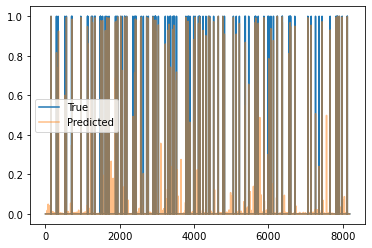

Train Epoch: 6 [2110/2220 (95%)]	Loss: 0.009339	Pres: 0.001953	F1 Score: 0.001953
Train Epoch: 6 [2120/2220 (95%)]	Loss: 0.005578	Pres: 0.001343	F1 Score: 0.001343
Train Epoch: 6 [2130/2220 (95%)]	Loss: 0.007372	Pres: 0.001709	F1 Score: 0.001709
Train Epoch: 6 [2140/2220 (96%)]	Loss: 0.007814	Pres: 0.002319	F1 Score: 0.002319
Train Epoch: 6 [2150/2220 (96%)]	Loss: 0.011410	Pres: 0.002441	F1 Score: 0.002441
Train Epoch: 6 [2160/2220 (97%)]	Loss: 0.008109	Pres: 0.001099	F1 Score: 0.001099
Train Epoch: 6 [2170/2220 (97%)]	Loss: 0.006276	Pres: 0.002319	F1 Score: 0.002319
Train Epoch: 6 [2180/2220 (98%)]	Loss: 0.010199	Pres: 0.001953	F1 Score: 0.001953
Train Epoch: 6 [2190/2220 (98%)]	Loss: 0.012567	Pres: 0.002075	F1 Score: 0.002075
Train Epoch: 6 [2200/2220 (99%)]	Loss: 0.008722	Pres: 0.003418	F1 Score: 0.003418
Train Epoch: 6 [2210/2220 (99%)]	Loss: 0.010374	Pres: 0.001343	F1 Score: 0.001343
Validation Epoch: 6 [0/582 (0%)]	Loss: 0.006726	Pres: 0.001465	F1 Score: 0.001465


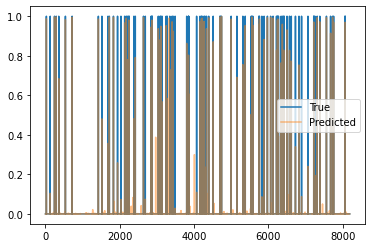

Validation Epoch: 6 [10/582 (1%)]	Loss: 0.006649	Pres: 0.001587	F1 Score: 0.001587
Validation Epoch: 6 [20/582 (3%)]	Loss: 0.005531	Pres: 0.001221	F1 Score: 0.001221
Validation Epoch: 6 [30/582 (5%)]	Loss: 0.006543	Pres: 0.001099	F1 Score: 0.001099
Validation Epoch: 6 [40/582 (6%)]	Loss: 0.004527	Pres: 0.001099	F1 Score: 0.001099
Validation Epoch: 6 [50/582 (8%)]	Loss: 0.005500	Pres: 0.001465	F1 Score: 0.001465
Validation Epoch: 6 [60/582 (10%)]	Loss: 0.006919	Pres: 0.001099	F1 Score: 0.001099
Validation Epoch: 6 [70/582 (12%)]	Loss: 0.006789	Pres: 0.001099	F1 Score: 0.001099
Validation Epoch: 6 [80/582 (13%)]	Loss: 0.004621	Pres: 0.001221	F1 Score: 0.001221
Validation Epoch: 6 [90/582 (15%)]	Loss: 0.004337	Pres: 0.001953	F1 Score: 0.001953
Validation Epoch: 6 [100/582 (17%)]	Loss: 0.004542	Pres: 0.001709	F1 Score: 0.001709
Validation Epoch: 6 [110/582 (18%)]	Loss: 0.005387	Pres: 0.001221	F1 Score: 0.001221
Validation Epoch: 6 [120/582 (20%)]	Loss: 0.004691	Pres: 0.000610	F1 Score: 0.0

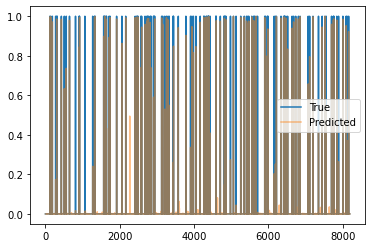

Validation Epoch: 6 [310/582 (53%)]	Loss: 0.006637	Pres: 0.001587	F1 Score: 0.001587
Validation Epoch: 6 [320/582 (54%)]	Loss: 0.005743	Pres: 0.000977	F1 Score: 0.000977
Validation Epoch: 6 [330/582 (56%)]	Loss: 0.005696	Pres: 0.001465	F1 Score: 0.001465
Validation Epoch: 6 [340/582 (58%)]	Loss: 0.008194	Pres: 0.001221	F1 Score: 0.001221
Validation Epoch: 6 [350/582 (60%)]	Loss: 0.006440	Pres: 0.000977	F1 Score: 0.000977
Validation Epoch: 6 [360/582 (61%)]	Loss: 0.005463	Pres: 0.001587	F1 Score: 0.001587
Validation Epoch: 6 [370/582 (63%)]	Loss: 0.007958	Pres: 0.001587	F1 Score: 0.001587
Validation Epoch: 6 [380/582 (65%)]	Loss: 0.006931	Pres: 0.001099	F1 Score: 0.001099
Validation Epoch: 6 [390/582 (67%)]	Loss: 0.004200	Pres: 0.001221	F1 Score: 0.001221
Validation Epoch: 6 [400/582 (68%)]	Loss: 0.007718	Pres: 0.001465	F1 Score: 0.001465
Validation Epoch: 6 [410/582 (70%)]	Loss: 0.007956	Pres: 0.000977	F1 Score: 0.000977
Validation Epoch: 6 [420/582 (72%)]	Loss: 0.004937	Pres: 0.001221

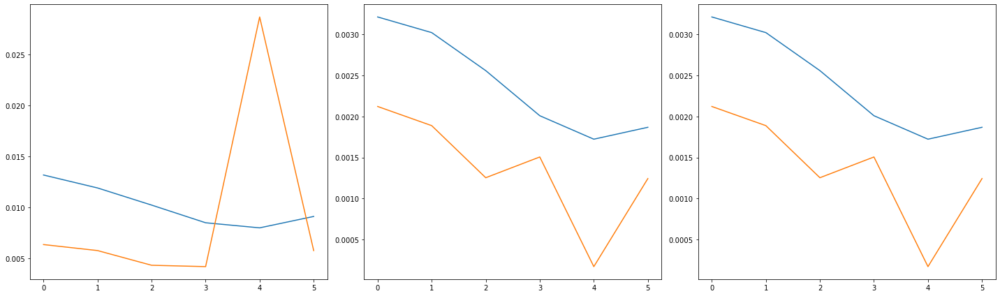

2220 582
Train Epoch: 7 [0/2220 (0%)]	Loss: 0.007459	Pres: 0.002197	F1 Score: 0.002197
92.0 -inf


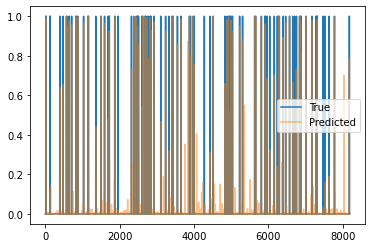

Train Epoch: 7 [10/2220 (0%)]	Loss: 0.007535	Pres: 0.001099	F1 Score: 0.001099
Train Epoch: 7 [20/2220 (0%)]	Loss: 0.011282	Pres: 0.001953	F1 Score: 0.001953
Train Epoch: 7 [30/2220 (1%)]	Loss: 0.007798	Pres: 0.003662	F1 Score: 0.003662
Train Epoch: 7 [40/2220 (1%)]	Loss: 0.008367	Pres: 0.001343	F1 Score: 0.001343
Train Epoch: 7 [50/2220 (2%)]	Loss: 0.005996	Pres: 0.001465	F1 Score: 0.001465
Train Epoch: 7 [60/2220 (2%)]	Loss: 0.011411	Pres: 0.002930	F1 Score: 0.002930
Train Epoch: 7 [70/2220 (3%)]	Loss: 0.008630	Pres: 0.002563	F1 Score: 0.002563
Train Epoch: 7 [80/2220 (3%)]	Loss: 0.009104	Pres: 0.002197	F1 Score: 0.002197
Train Epoch: 7 [90/2220 (4%)]	Loss: 0.008978	Pres: 0.002075	F1 Score: 0.002075
Train Epoch: 7 [100/2220 (4%)]	Loss: 0.007460	Pres: 0.001831	F1 Score: 0.001831
Train Epoch: 7 [110/2220 (4%)]	Loss: 0.009700	Pres: 0.002075	F1 Score: 0.002075
Train Epoch: 7 [120/2220 (5%)]	Loss: 0.008016	Pres: 0.001099	F1 Score: 0.001099
Train Epoch: 7 [130/2220 (5%)]	Loss: 0.009327	Pre

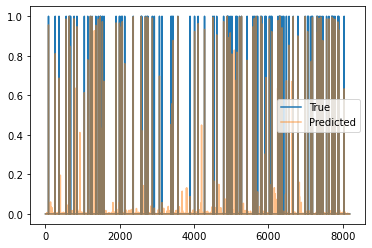

Train Epoch: 7 [310/2220 (13%)]	Loss: 0.007849	Pres: 0.002930	F1 Score: 0.002930
Train Epoch: 7 [320/2220 (14%)]	Loss: 0.008894	Pres: 0.001465	F1 Score: 0.001465
Train Epoch: 7 [330/2220 (14%)]	Loss: 0.008241	Pres: 0.002441	F1 Score: 0.002441
Train Epoch: 7 [340/2220 (15%)]	Loss: 0.010538	Pres: 0.002563	F1 Score: 0.002563
Train Epoch: 7 [350/2220 (15%)]	Loss: 0.010101	Pres: 0.001343	F1 Score: 0.001343
Train Epoch: 7 [360/2220 (16%)]	Loss: 0.009795	Pres: 0.001953	F1 Score: 0.001953
Train Epoch: 7 [370/2220 (16%)]	Loss: 0.006764	Pres: 0.002197	F1 Score: 0.002197
Train Epoch: 7 [380/2220 (17%)]	Loss: 0.007836	Pres: 0.002686	F1 Score: 0.002686
Train Epoch: 7 [390/2220 (17%)]	Loss: 0.006389	Pres: 0.001831	F1 Score: 0.001831
Train Epoch: 7 [400/2220 (18%)]	Loss: 0.008176	Pres: 0.002441	F1 Score: 0.002441
Train Epoch: 7 [410/2220 (18%)]	Loss: 0.008404	Pres: 0.002197	F1 Score: 0.002197
Train Epoch: 7 [420/2220 (18%)]	Loss: 0.011529	Pres: 0.003052	F1 Score: 0.003052
Train Epoch: 7 [430/2220 (19

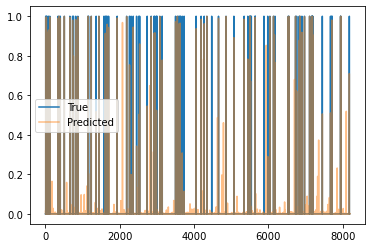

Train Epoch: 7 [610/2220 (27%)]	Loss: 0.027390	Pres: 0.001831	F1 Score: 0.001831
Train Epoch: 7 [620/2220 (27%)]	Loss: 0.005678	Pres: 0.001587	F1 Score: 0.001587
Train Epoch: 7 [630/2220 (28%)]	Loss: 0.007537	Pres: 0.001221	F1 Score: 0.001221
Train Epoch: 7 [640/2220 (28%)]	Loss: 0.005348	Pres: 0.001953	F1 Score: 0.001953
Train Epoch: 7 [650/2220 (29%)]	Loss: 0.006715	Pres: 0.001953	F1 Score: 0.001953
Train Epoch: 7 [660/2220 (29%)]	Loss: 0.008678	Pres: 0.001953	F1 Score: 0.001953
Train Epoch: 7 [670/2220 (30%)]	Loss: 0.008226	Pres: 0.002075	F1 Score: 0.002075
Train Epoch: 7 [680/2220 (30%)]	Loss: 0.007841	Pres: 0.002319	F1 Score: 0.002319
Train Epoch: 7 [690/2220 (31%)]	Loss: 0.008797	Pres: 0.001953	F1 Score: 0.001953
Train Epoch: 7 [700/2220 (31%)]	Loss: 0.005823	Pres: 0.001831	F1 Score: 0.001831
Train Epoch: 7 [710/2220 (31%)]	Loss: 0.007784	Pres: 0.001587	F1 Score: 0.001587
Train Epoch: 7 [720/2220 (32%)]	Loss: 0.010476	Pres: 0.001831	F1 Score: 0.001831
Train Epoch: 7 [730/2220 (32

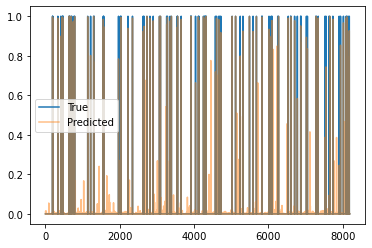

Train Epoch: 7 [910/2220 (40%)]	Loss: 0.009679	Pres: 0.001587	F1 Score: 0.001587
Train Epoch: 7 [920/2220 (41%)]	Loss: 0.008836	Pres: 0.001221	F1 Score: 0.001221
Train Epoch: 7 [930/2220 (41%)]	Loss: 0.009627	Pres: 0.002197	F1 Score: 0.002197
Train Epoch: 7 [940/2220 (42%)]	Loss: 0.006653	Pres: 0.002197	F1 Score: 0.002197
Train Epoch: 7 [950/2220 (42%)]	Loss: 0.006960	Pres: 0.002319	F1 Score: 0.002319
Train Epoch: 7 [960/2220 (43%)]	Loss: 0.009143	Pres: 0.002686	F1 Score: 0.002686
Train Epoch: 7 [970/2220 (43%)]	Loss: 0.008834	Pres: 0.002197	F1 Score: 0.002197
Train Epoch: 7 [980/2220 (44%)]	Loss: 0.006896	Pres: 0.001343	F1 Score: 0.001343
Train Epoch: 7 [990/2220 (44%)]	Loss: 0.008980	Pres: 0.002930	F1 Score: 0.002930
Train Epoch: 7 [1000/2220 (45%)]	Loss: 0.010107	Pres: 0.002930	F1 Score: 0.002930
Train Epoch: 7 [1010/2220 (45%)]	Loss: 0.008498	Pres: 0.001709	F1 Score: 0.001709
Train Epoch: 7 [1020/2220 (45%)]	Loss: 0.012039	Pres: 0.002441	F1 Score: 0.002441
Train Epoch: 7 [1030/2220

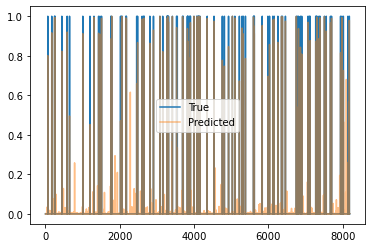

Train Epoch: 7 [1210/2220 (54%)]	Loss: 0.011975	Pres: 0.001709	F1 Score: 0.001709
Train Epoch: 7 [1220/2220 (54%)]	Loss: 0.011654	Pres: 0.002686	F1 Score: 0.002686
Train Epoch: 7 [1230/2220 (55%)]	Loss: 0.008128	Pres: 0.001709	F1 Score: 0.001709
Train Epoch: 7 [1240/2220 (55%)]	Loss: 0.007508	Pres: 0.002930	F1 Score: 0.002930
Train Epoch: 7 [1250/2220 (56%)]	Loss: 0.009829	Pres: 0.003662	F1 Score: 0.003662
Train Epoch: 7 [1260/2220 (56%)]	Loss: 0.008273	Pres: 0.001831	F1 Score: 0.001831
Train Epoch: 7 [1270/2220 (57%)]	Loss: 0.010602	Pres: 0.003052	F1 Score: 0.003052
Train Epoch: 7 [1280/2220 (57%)]	Loss: 0.010465	Pres: 0.002563	F1 Score: 0.002563
Train Epoch: 7 [1290/2220 (58%)]	Loss: 0.010600	Pres: 0.002808	F1 Score: 0.002808
Train Epoch: 7 [1300/2220 (58%)]	Loss: 0.009738	Pres: 0.002319	F1 Score: 0.002319
Train Epoch: 7 [1310/2220 (59%)]	Loss: 0.010920	Pres: 0.001953	F1 Score: 0.001953
Train Epoch: 7 [1320/2220 (59%)]	Loss: 0.008110	Pres: 0.002319	F1 Score: 0.002319
Train Epoch: 7 [

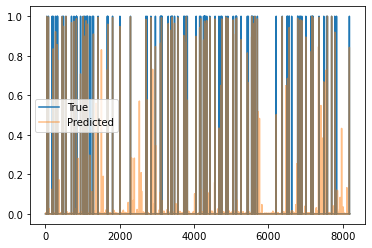

Train Epoch: 7 [1510/2220 (68%)]	Loss: 0.009543	Pres: 0.002075	F1 Score: 0.002075
Train Epoch: 7 [1520/2220 (68%)]	Loss: 0.009320	Pres: 0.002075	F1 Score: 0.002075
Train Epoch: 7 [1530/2220 (68%)]	Loss: 0.009163	Pres: 0.001587	F1 Score: 0.001587
Train Epoch: 7 [1540/2220 (69%)]	Loss: 0.042966	Pres: 0.002686	F1 Score: 0.002686
Train Epoch: 7 [1550/2220 (69%)]	Loss: 0.007519	Pres: 0.002686	F1 Score: 0.002686
Train Epoch: 7 [1560/2220 (70%)]	Loss: 0.010488	Pres: 0.002197	F1 Score: 0.002197
Train Epoch: 7 [1570/2220 (70%)]	Loss: 0.010706	Pres: 0.003174	F1 Score: 0.003174
Train Epoch: 7 [1580/2220 (71%)]	Loss: 0.009377	Pres: 0.001953	F1 Score: 0.001953
Train Epoch: 7 [1590/2220 (71%)]	Loss: 0.011812	Pres: 0.002319	F1 Score: 0.002319
Train Epoch: 7 [1600/2220 (72%)]	Loss: 0.005752	Pres: 0.002441	F1 Score: 0.002441
Train Epoch: 7 [1610/2220 (72%)]	Loss: 0.010981	Pres: 0.002075	F1 Score: 0.002075
Train Epoch: 7 [1620/2220 (72%)]	Loss: 0.007238	Pres: 0.001953	F1 Score: 0.001953
Train Epoch: 7 [

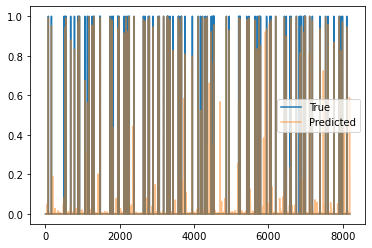

Train Epoch: 7 [1810/2220 (81%)]	Loss: 0.006329	Pres: 0.002808	F1 Score: 0.002808
Train Epoch: 7 [1820/2220 (81%)]	Loss: 0.010522	Pres: 0.002197	F1 Score: 0.002197
Train Epoch: 7 [1830/2220 (82%)]	Loss: 0.007190	Pres: 0.002197	F1 Score: 0.002197
Train Epoch: 7 [1840/2220 (82%)]	Loss: 0.011248	Pres: 0.002075	F1 Score: 0.002075
Train Epoch: 7 [1850/2220 (83%)]	Loss: 0.007888	Pres: 0.002075	F1 Score: 0.002075
Train Epoch: 7 [1860/2220 (83%)]	Loss: 0.006338	Pres: 0.001465	F1 Score: 0.001465
Train Epoch: 7 [1870/2220 (84%)]	Loss: 0.013312	Pres: 0.002686	F1 Score: 0.002686
Train Epoch: 7 [1880/2220 (84%)]	Loss: 0.009496	Pres: 0.001587	F1 Score: 0.001587
Train Epoch: 7 [1890/2220 (85%)]	Loss: 0.007812	Pres: 0.002075	F1 Score: 0.002075
Train Epoch: 7 [1900/2220 (85%)]	Loss: 0.007471	Pres: 0.002319	F1 Score: 0.002319
Train Epoch: 7 [1910/2220 (86%)]	Loss: 0.006428	Pres: 0.001953	F1 Score: 0.001953
Train Epoch: 7 [1920/2220 (86%)]	Loss: 0.008957	Pres: 0.001831	F1 Score: 0.001831
Train Epoch: 7 [

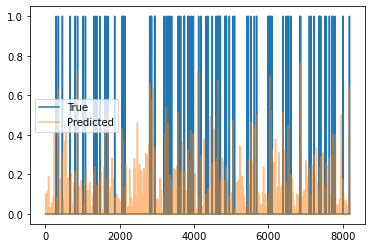

Train Epoch: 7 [2110/2220 (95%)]	Loss: 0.006872	Pres: 0.001343	F1 Score: 0.001343
Train Epoch: 7 [2120/2220 (95%)]	Loss: 0.009190	Pres: 0.002075	F1 Score: 0.002075
Train Epoch: 7 [2130/2220 (95%)]	Loss: 0.010785	Pres: 0.002808	F1 Score: 0.002808
Train Epoch: 7 [2140/2220 (96%)]	Loss: 0.011398	Pres: 0.002319	F1 Score: 0.002319
Train Epoch: 7 [2150/2220 (96%)]	Loss: 0.009728	Pres: 0.002441	F1 Score: 0.002441
Train Epoch: 7 [2160/2220 (97%)]	Loss: 0.009274	Pres: 0.002197	F1 Score: 0.002197
Train Epoch: 7 [2170/2220 (97%)]	Loss: 0.008886	Pres: 0.002686	F1 Score: 0.002686
Train Epoch: 7 [2180/2220 (98%)]	Loss: 0.009704	Pres: 0.001831	F1 Score: 0.001831
Train Epoch: 7 [2190/2220 (98%)]	Loss: 0.007982	Pres: 0.002197	F1 Score: 0.002197
Train Epoch: 7 [2200/2220 (99%)]	Loss: 0.008899	Pres: 0.001709	F1 Score: 0.001709
Train Epoch: 7 [2210/2220 (99%)]	Loss: 0.008087	Pres: 0.002563	F1 Score: 0.002563
Validation Epoch: 7 [0/582 (0%)]	Loss: 0.006956	Pres: 0.001587	F1 Score: 0.001587


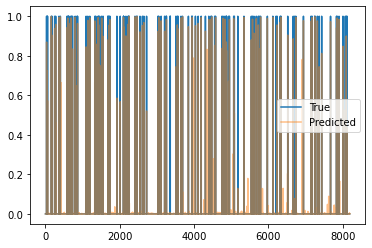

Validation Epoch: 7 [10/582 (1%)]	Loss: 0.004897	Pres: 0.001343	F1 Score: 0.001343
Validation Epoch: 7 [20/582 (3%)]	Loss: 0.003395	Pres: 0.001587	F1 Score: 0.001587
Validation Epoch: 7 [30/582 (5%)]	Loss: 0.003085	Pres: 0.001221	F1 Score: 0.001221
Validation Epoch: 7 [40/582 (6%)]	Loss: 0.004699	Pres: 0.001953	F1 Score: 0.001953
Validation Epoch: 7 [50/582 (8%)]	Loss: 0.005175	Pres: 0.001831	F1 Score: 0.001831
Validation Epoch: 7 [60/582 (10%)]	Loss: 0.003124	Pres: 0.001099	F1 Score: 0.001099
Validation Epoch: 7 [70/582 (12%)]	Loss: 0.005566	Pres: 0.002808	F1 Score: 0.002808
Validation Epoch: 7 [80/582 (13%)]	Loss: 0.003406	Pres: 0.001343	F1 Score: 0.001343
Validation Epoch: 7 [90/582 (15%)]	Loss: 0.003579	Pres: 0.001709	F1 Score: 0.001709
Validation Epoch: 7 [100/582 (17%)]	Loss: 0.003292	Pres: 0.001099	F1 Score: 0.001099
Validation Epoch: 7 [110/582 (18%)]	Loss: 0.003171	Pres: 0.001709	F1 Score: 0.001709
Validation Epoch: 7 [120/582 (20%)]	Loss: 0.004345	Pres: 0.001465	F1 Score: 0.0

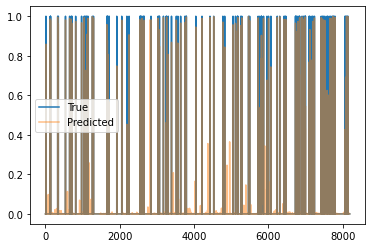

Validation Epoch: 7 [310/582 (53%)]	Loss: 0.003760	Pres: 0.001221	F1 Score: 0.001221
Validation Epoch: 7 [320/582 (54%)]	Loss: 0.004815	Pres: 0.001831	F1 Score: 0.001831
Validation Epoch: 7 [330/582 (56%)]	Loss: 0.003610	Pres: 0.001343	F1 Score: 0.001343
Validation Epoch: 7 [340/582 (58%)]	Loss: 0.003649	Pres: 0.001953	F1 Score: 0.001953
Validation Epoch: 7 [350/582 (60%)]	Loss: 0.004925	Pres: 0.002441	F1 Score: 0.002441
Validation Epoch: 7 [360/582 (61%)]	Loss: 0.003656	Pres: 0.001221	F1 Score: 0.001221
Validation Epoch: 7 [370/582 (63%)]	Loss: 0.003400	Pres: 0.001831	F1 Score: 0.001831
Validation Epoch: 7 [380/582 (65%)]	Loss: 0.003645	Pres: 0.001221	F1 Score: 0.001221
Validation Epoch: 7 [390/582 (67%)]	Loss: 0.003968	Pres: 0.001953	F1 Score: 0.001953
Validation Epoch: 7 [400/582 (68%)]	Loss: 0.004546	Pres: 0.001953	F1 Score: 0.001953
Validation Epoch: 7 [410/582 (70%)]	Loss: 0.005853	Pres: 0.001831	F1 Score: 0.001831
Validation Epoch: 7 [420/582 (72%)]	Loss: 0.002801	Pres: 0.000854

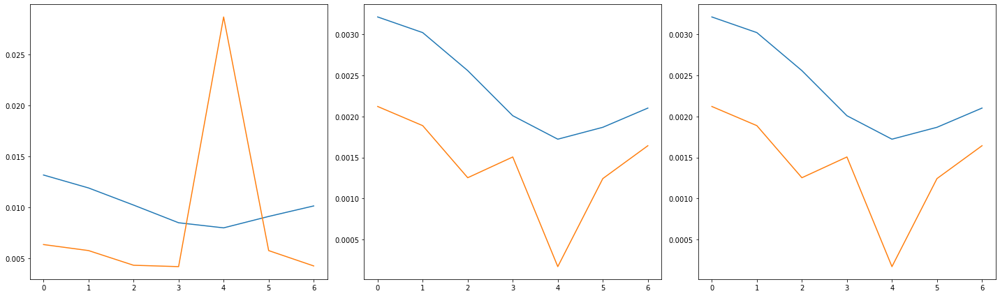

2220 582
Train Epoch: 8 [0/2220 (0%)]	Loss: 0.010467	Pres: 0.002197	F1 Score: 0.002197
100.0 -inf


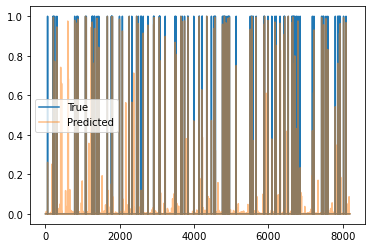

Train Epoch: 8 [10/2220 (0%)]	Loss: 0.008921	Pres: 0.002563	F1 Score: 0.002563
Train Epoch: 8 [20/2220 (0%)]	Loss: 0.006123	Pres: 0.002563	F1 Score: 0.002563
Train Epoch: 8 [30/2220 (1%)]	Loss: 0.009370	Pres: 0.001831	F1 Score: 0.001831
Train Epoch: 8 [40/2220 (1%)]	Loss: 0.010730	Pres: 0.002197	F1 Score: 0.002197
Train Epoch: 8 [50/2220 (2%)]	Loss: 0.013423	Pres: 0.001343	F1 Score: 0.001343
Train Epoch: 8 [60/2220 (2%)]	Loss: 0.009320	Pres: 0.002563	F1 Score: 0.002563
Train Epoch: 8 [70/2220 (3%)]	Loss: 0.009796	Pres: 0.002686	F1 Score: 0.002686
Train Epoch: 8 [80/2220 (3%)]	Loss: 0.009545	Pres: 0.002319	F1 Score: 0.002319
Train Epoch: 8 [90/2220 (4%)]	Loss: 0.007188	Pres: 0.001953	F1 Score: 0.001953
Train Epoch: 8 [100/2220 (4%)]	Loss: 0.010352	Pres: 0.001953	F1 Score: 0.001953
Train Epoch: 8 [110/2220 (4%)]	Loss: 0.010878	Pres: 0.000977	F1 Score: 0.000977
Train Epoch: 8 [120/2220 (5%)]	Loss: 0.010473	Pres: 0.002197	F1 Score: 0.002197
Train Epoch: 8 [130/2220 (5%)]	Loss: 0.009160	Pre

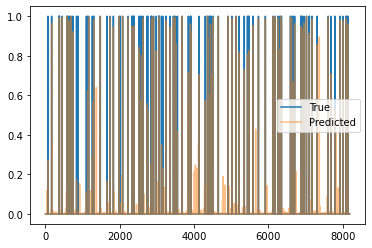

Train Epoch: 8 [310/2220 (13%)]	Loss: 0.007563	Pres: 0.001465	F1 Score: 0.001465
Train Epoch: 8 [320/2220 (14%)]	Loss: 0.008172	Pres: 0.001465	F1 Score: 0.001465
Train Epoch: 8 [330/2220 (14%)]	Loss: 0.008673	Pres: 0.003174	F1 Score: 0.003174
Train Epoch: 8 [340/2220 (15%)]	Loss: 0.012996	Pres: 0.002075	F1 Score: 0.002075
Train Epoch: 8 [350/2220 (15%)]	Loss: 0.007789	Pres: 0.003174	F1 Score: 0.003174
Train Epoch: 8 [360/2220 (16%)]	Loss: 0.010017	Pres: 0.002075	F1 Score: 0.002075
Train Epoch: 8 [370/2220 (16%)]	Loss: 0.009718	Pres: 0.001831	F1 Score: 0.001831
Train Epoch: 8 [380/2220 (17%)]	Loss: 0.007134	Pres: 0.001709	F1 Score: 0.001709
Train Epoch: 8 [390/2220 (17%)]	Loss: 0.006552	Pres: 0.001465	F1 Score: 0.001465
Train Epoch: 8 [400/2220 (18%)]	Loss: 0.010482	Pres: 0.000854	F1 Score: 0.000854
Train Epoch: 8 [410/2220 (18%)]	Loss: 0.007203	Pres: 0.002930	F1 Score: 0.002930
Train Epoch: 8 [420/2220 (18%)]	Loss: 0.014025	Pres: 0.002197	F1 Score: 0.002197
Train Epoch: 8 [430/2220 (19

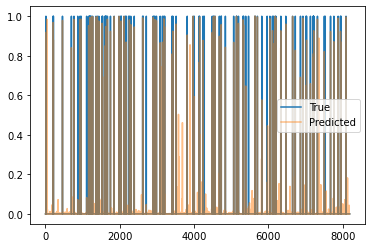

Train Epoch: 8 [610/2220 (27%)]	Loss: 0.009226	Pres: 0.002075	F1 Score: 0.002075
Train Epoch: 8 [620/2220 (27%)]	Loss: 0.007623	Pres: 0.001221	F1 Score: 0.001221
Train Epoch: 8 [630/2220 (28%)]	Loss: 0.009518	Pres: 0.001709	F1 Score: 0.001709
Train Epoch: 8 [640/2220 (28%)]	Loss: 0.010385	Pres: 0.002563	F1 Score: 0.002563
Train Epoch: 8 [650/2220 (29%)]	Loss: 0.008543	Pres: 0.002441	F1 Score: 0.002441
Train Epoch: 8 [660/2220 (29%)]	Loss: 0.010927	Pres: 0.001953	F1 Score: 0.001953
Train Epoch: 8 [670/2220 (30%)]	Loss: 0.011159	Pres: 0.002319	F1 Score: 0.002319
Train Epoch: 8 [680/2220 (30%)]	Loss: 0.010672	Pres: 0.002686	F1 Score: 0.002686
Train Epoch: 8 [690/2220 (31%)]	Loss: 0.013553	Pres: 0.003662	F1 Score: 0.003662
Train Epoch: 8 [700/2220 (31%)]	Loss: 0.008364	Pres: 0.002319	F1 Score: 0.002319
Train Epoch: 8 [710/2220 (31%)]	Loss: 0.009538	Pres: 0.001831	F1 Score: 0.001831
Train Epoch: 8 [720/2220 (32%)]	Loss: 0.009891	Pres: 0.002197	F1 Score: 0.002197
Train Epoch: 8 [730/2220 (32

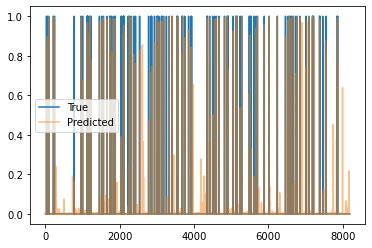

Train Epoch: 8 [910/2220 (40%)]	Loss: 0.011076	Pres: 0.002563	F1 Score: 0.002563
Train Epoch: 8 [920/2220 (41%)]	Loss: 0.006990	Pres: 0.002319	F1 Score: 0.002319
Train Epoch: 8 [930/2220 (41%)]	Loss: 0.007506	Pres: 0.002197	F1 Score: 0.002197
Train Epoch: 8 [940/2220 (42%)]	Loss: 0.011975	Pres: 0.001587	F1 Score: 0.001587
Train Epoch: 8 [950/2220 (42%)]	Loss: 0.010618	Pres: 0.002441	F1 Score: 0.002441
Train Epoch: 8 [960/2220 (43%)]	Loss: 0.006830	Pres: 0.001953	F1 Score: 0.001953
Train Epoch: 8 [970/2220 (43%)]	Loss: 0.010176	Pres: 0.003174	F1 Score: 0.003174
Train Epoch: 8 [980/2220 (44%)]	Loss: 0.013820	Pres: 0.002563	F1 Score: 0.002563
Train Epoch: 8 [990/2220 (44%)]	Loss: 0.008298	Pres: 0.003662	F1 Score: 0.003662
Train Epoch: 8 [1000/2220 (45%)]	Loss: 0.011895	Pres: 0.002441	F1 Score: 0.002441
Train Epoch: 8 [1010/2220 (45%)]	Loss: 0.010074	Pres: 0.001831	F1 Score: 0.001831
Train Epoch: 8 [1020/2220 (45%)]	Loss: 0.011066	Pres: 0.002441	F1 Score: 0.002441
Train Epoch: 8 [1030/2220

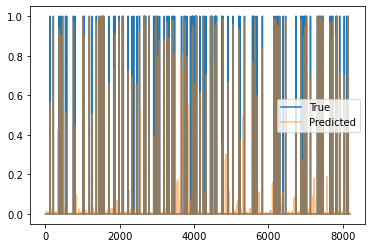

Train Epoch: 8 [1210/2220 (54%)]	Loss: 0.009407	Pres: 0.001831	F1 Score: 0.001831
Train Epoch: 8 [1220/2220 (54%)]	Loss: 0.009307	Pres: 0.002075	F1 Score: 0.002075
Train Epoch: 8 [1230/2220 (55%)]	Loss: 0.006738	Pres: 0.001953	F1 Score: 0.001953
Train Epoch: 8 [1240/2220 (55%)]	Loss: 0.007102	Pres: 0.001709	F1 Score: 0.001709
Train Epoch: 8 [1250/2220 (56%)]	Loss: 0.009233	Pres: 0.002686	F1 Score: 0.002686
Train Epoch: 8 [1260/2220 (56%)]	Loss: 0.008842	Pres: 0.002075	F1 Score: 0.002075
Train Epoch: 8 [1270/2220 (57%)]	Loss: 0.011774	Pres: 0.002075	F1 Score: 0.002075
Train Epoch: 8 [1280/2220 (57%)]	Loss: 0.010040	Pres: 0.002808	F1 Score: 0.002808
Train Epoch: 8 [1290/2220 (58%)]	Loss: 0.008660	Pres: 0.001831	F1 Score: 0.001831
Train Epoch: 8 [1300/2220 (58%)]	Loss: 0.009656	Pres: 0.002563	F1 Score: 0.002563
Train Epoch: 8 [1310/2220 (59%)]	Loss: 0.010054	Pres: 0.001953	F1 Score: 0.001953
Train Epoch: 8 [1320/2220 (59%)]	Loss: 0.010612	Pres: 0.002930	F1 Score: 0.002930
Train Epoch: 8 [

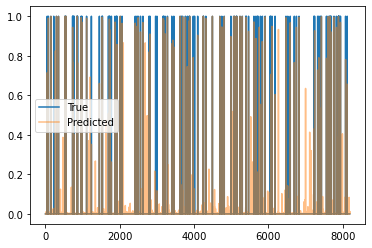

Train Epoch: 8 [1510/2220 (68%)]	Loss: 0.007383	Pres: 0.002075	F1 Score: 0.002075
Train Epoch: 8 [1520/2220 (68%)]	Loss: 0.008295	Pres: 0.002197	F1 Score: 0.002197
Train Epoch: 8 [1530/2220 (68%)]	Loss: 0.007960	Pres: 0.001709	F1 Score: 0.001709
Train Epoch: 8 [1540/2220 (69%)]	Loss: 0.009703	Pres: 0.001587	F1 Score: 0.001587
Train Epoch: 8 [1550/2220 (69%)]	Loss: 0.011277	Pres: 0.002563	F1 Score: 0.002563
Train Epoch: 8 [1560/2220 (70%)]	Loss: 0.012424	Pres: 0.001709	F1 Score: 0.001709
Train Epoch: 8 [1570/2220 (70%)]	Loss: 0.009045	Pres: 0.001465	F1 Score: 0.001465
Train Epoch: 8 [1580/2220 (71%)]	Loss: 0.010549	Pres: 0.002319	F1 Score: 0.002319
Train Epoch: 8 [1590/2220 (71%)]	Loss: 0.011397	Pres: 0.001221	F1 Score: 0.001221
Train Epoch: 8 [1600/2220 (72%)]	Loss: 0.009709	Pres: 0.002197	F1 Score: 0.002197
Train Epoch: 8 [1610/2220 (72%)]	Loss: 0.044540	Pres: 0.002686	F1 Score: 0.002686
Train Epoch: 8 [1620/2220 (72%)]	Loss: 0.010200	Pres: 0.001953	F1 Score: 0.001953
Train Epoch: 8 [

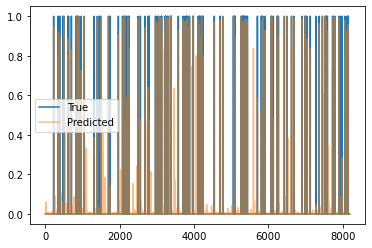

Train Epoch: 8 [1810/2220 (81%)]	Loss: 0.009215	Pres: 0.002441	F1 Score: 0.002441
Train Epoch: 8 [1820/2220 (81%)]	Loss: 0.008455	Pres: 0.001343	F1 Score: 0.001343
Train Epoch: 8 [1830/2220 (82%)]	Loss: 0.009299	Pres: 0.001709	F1 Score: 0.001709
Train Epoch: 8 [1840/2220 (82%)]	Loss: 0.010134	Pres: 0.002808	F1 Score: 0.002808
Train Epoch: 8 [1850/2220 (83%)]	Loss: 0.008636	Pres: 0.002808	F1 Score: 0.002808
Train Epoch: 8 [1860/2220 (83%)]	Loss: 0.010384	Pres: 0.002319	F1 Score: 0.002319
Train Epoch: 8 [1870/2220 (84%)]	Loss: 0.010597	Pres: 0.002808	F1 Score: 0.002808
Train Epoch: 8 [1880/2220 (84%)]	Loss: 0.012408	Pres: 0.003052	F1 Score: 0.003052
Train Epoch: 8 [1890/2220 (85%)]	Loss: 0.010457	Pres: 0.002808	F1 Score: 0.002808
Train Epoch: 8 [1900/2220 (85%)]	Loss: 0.009025	Pres: 0.002441	F1 Score: 0.002441
Train Epoch: 8 [1910/2220 (86%)]	Loss: 0.008175	Pres: 0.002686	F1 Score: 0.002686
Train Epoch: 8 [1920/2220 (86%)]	Loss: 0.010158	Pres: 0.003418	F1 Score: 0.003418
Train Epoch: 8 [

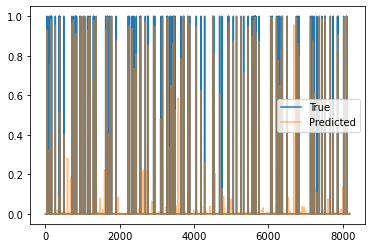

Train Epoch: 8 [2110/2220 (95%)]	Loss: 0.010582	Pres: 0.003174	F1 Score: 0.003174
Train Epoch: 8 [2120/2220 (95%)]	Loss: 0.009173	Pres: 0.001953	F1 Score: 0.001953
Train Epoch: 8 [2130/2220 (95%)]	Loss: 0.012160	Pres: 0.002808	F1 Score: 0.002808
Train Epoch: 8 [2140/2220 (96%)]	Loss: 0.007670	Pres: 0.001465	F1 Score: 0.001465
Train Epoch: 8 [2150/2220 (96%)]	Loss: 0.007381	Pres: 0.002808	F1 Score: 0.002808
Train Epoch: 8 [2160/2220 (97%)]	Loss: 0.013213	Pres: 0.003052	F1 Score: 0.003052
Train Epoch: 8 [2170/2220 (97%)]	Loss: 0.007569	Pres: 0.002075	F1 Score: 0.002075
Train Epoch: 8 [2180/2220 (98%)]	Loss: 0.008680	Pres: 0.002319	F1 Score: 0.002319
Train Epoch: 8 [2190/2220 (98%)]	Loss: 0.012231	Pres: 0.002563	F1 Score: 0.002563
Train Epoch: 8 [2200/2220 (99%)]	Loss: 0.007343	Pres: 0.002197	F1 Score: 0.002197
Train Epoch: 8 [2210/2220 (99%)]	Loss: 0.009530	Pres: 0.002319	F1 Score: 0.002319
Validation Epoch: 8 [0/582 (0%)]	Loss: 0.003649	Pres: 0.001831	F1 Score: 0.001831


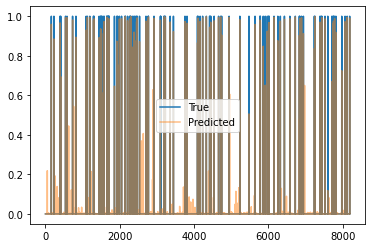

Validation Epoch: 8 [10/582 (1%)]	Loss: 0.006356	Pres: 0.002319	F1 Score: 0.002319
Validation Epoch: 8 [20/582 (3%)]	Loss: 0.006635	Pres: 0.002563	F1 Score: 0.002563
Validation Epoch: 8 [30/582 (5%)]	Loss: 0.004681	Pres: 0.002075	F1 Score: 0.002075
Validation Epoch: 8 [40/582 (6%)]	Loss: 0.004519	Pres: 0.001465	F1 Score: 0.001465
Validation Epoch: 8 [50/582 (8%)]	Loss: 0.005559	Pres: 0.001953	F1 Score: 0.001953
Validation Epoch: 8 [60/582 (10%)]	Loss: 0.003156	Pres: 0.001953	F1 Score: 0.001953
Validation Epoch: 8 [70/582 (12%)]	Loss: 0.005692	Pres: 0.001953	F1 Score: 0.001953
Validation Epoch: 8 [80/582 (13%)]	Loss: 0.005556	Pres: 0.001953	F1 Score: 0.001953
Validation Epoch: 8 [90/582 (15%)]	Loss: 0.004712	Pres: 0.002563	F1 Score: 0.002563
Validation Epoch: 8 [100/582 (17%)]	Loss: 0.006764	Pres: 0.001953	F1 Score: 0.001953
Validation Epoch: 8 [110/582 (18%)]	Loss: 0.005085	Pres: 0.002197	F1 Score: 0.002197
Validation Epoch: 8 [120/582 (20%)]	Loss: 0.003737	Pres: 0.002808	F1 Score: 0.0

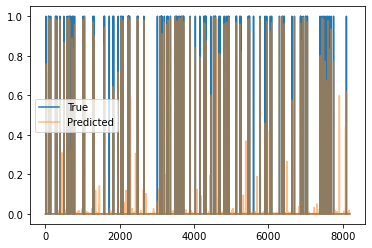

Validation Epoch: 8 [310/582 (53%)]	Loss: 0.003118	Pres: 0.002319	F1 Score: 0.002319
Validation Epoch: 8 [320/582 (54%)]	Loss: 0.003697	Pres: 0.002319	F1 Score: 0.002319
Validation Epoch: 8 [330/582 (56%)]	Loss: 0.004400	Pres: 0.002686	F1 Score: 0.002686
Validation Epoch: 8 [340/582 (58%)]	Loss: 0.002739	Pres: 0.002441	F1 Score: 0.002441
Validation Epoch: 8 [350/582 (60%)]	Loss: 0.004821	Pres: 0.002441	F1 Score: 0.002441
Validation Epoch: 8 [360/582 (61%)]	Loss: 0.004382	Pres: 0.001831	F1 Score: 0.001831
Validation Epoch: 8 [370/582 (63%)]	Loss: 0.005028	Pres: 0.002319	F1 Score: 0.002319
Validation Epoch: 8 [380/582 (65%)]	Loss: 0.004812	Pres: 0.003296	F1 Score: 0.003296
Validation Epoch: 8 [390/582 (67%)]	Loss: 0.003317	Pres: 0.002075	F1 Score: 0.002075
Validation Epoch: 8 [400/582 (68%)]	Loss: 0.005321	Pres: 0.002197	F1 Score: 0.002197
Validation Epoch: 8 [410/582 (70%)]	Loss: 0.003625	Pres: 0.002441	F1 Score: 0.002441
Validation Epoch: 8 [420/582 (72%)]	Loss: 0.003816	Pres: 0.000854

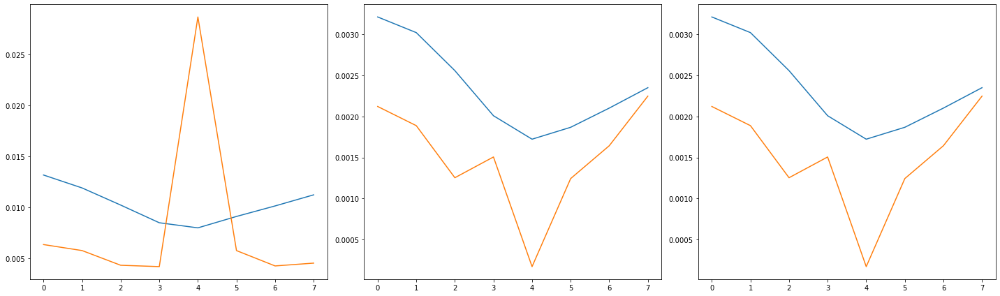

2220 582
Train Epoch: 9 [0/2220 (0%)]	Loss: 0.006581	Pres: 0.002441	F1 Score: 0.002441
89.0 -inf


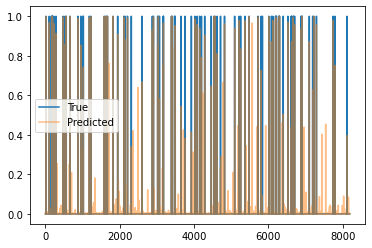

Train Epoch: 9 [10/2220 (0%)]	Loss: 0.008945	Pres: 0.002197	F1 Score: 0.002197
Train Epoch: 9 [20/2220 (0%)]	Loss: 0.007979	Pres: 0.002075	F1 Score: 0.002075
Train Epoch: 9 [30/2220 (1%)]	Loss: 0.010154	Pres: 0.001831	F1 Score: 0.001831
Train Epoch: 9 [40/2220 (1%)]	Loss: 0.007321	Pres: 0.002563	F1 Score: 0.002563
Train Epoch: 9 [50/2220 (2%)]	Loss: 0.007633	Pres: 0.002808	F1 Score: 0.002808
Train Epoch: 9 [60/2220 (2%)]	Loss: 0.009398	Pres: 0.001587	F1 Score: 0.001587
Train Epoch: 9 [70/2220 (3%)]	Loss: 0.008761	Pres: 0.002808	F1 Score: 0.002808
Train Epoch: 9 [80/2220 (3%)]	Loss: 0.011343	Pres: 0.003174	F1 Score: 0.003174
Train Epoch: 9 [90/2220 (4%)]	Loss: 0.010649	Pres: 0.001221	F1 Score: 0.001221
Train Epoch: 9 [100/2220 (4%)]	Loss: 0.011296	Pres: 0.001709	F1 Score: 0.001709
Train Epoch: 9 [110/2220 (4%)]	Loss: 0.011014	Pres: 0.002197	F1 Score: 0.002197
Train Epoch: 9 [120/2220 (5%)]	Loss: 0.009512	Pres: 0.002930	F1 Score: 0.002930
Train Epoch: 9 [130/2220 (5%)]	Loss: 0.007421	Pre

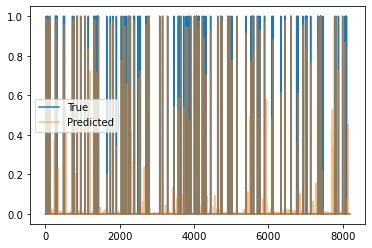

Train Epoch: 9 [310/2220 (13%)]	Loss: 0.009321	Pres: 0.002563	F1 Score: 0.002563
Train Epoch: 9 [320/2220 (14%)]	Loss: 0.036878	Pres: 0.003540	F1 Score: 0.003540
Train Epoch: 9 [330/2220 (14%)]	Loss: 0.009853	Pres: 0.001099	F1 Score: 0.001099
Train Epoch: 9 [340/2220 (15%)]	Loss: 0.009012	Pres: 0.003784	F1 Score: 0.003784
Train Epoch: 9 [350/2220 (15%)]	Loss: 0.008902	Pres: 0.001953	F1 Score: 0.001953
Train Epoch: 9 [360/2220 (16%)]	Loss: 0.010701	Pres: 0.002197	F1 Score: 0.002197
Train Epoch: 9 [370/2220 (16%)]	Loss: 0.009221	Pres: 0.003418	F1 Score: 0.003418
Train Epoch: 9 [380/2220 (17%)]	Loss: 0.009433	Pres: 0.001709	F1 Score: 0.001709
Train Epoch: 9 [390/2220 (17%)]	Loss: 0.009652	Pres: 0.001709	F1 Score: 0.001709
Train Epoch: 9 [400/2220 (18%)]	Loss: 0.008767	Pres: 0.001343	F1 Score: 0.001343
Train Epoch: 9 [410/2220 (18%)]	Loss: 0.007099	Pres: 0.002197	F1 Score: 0.002197
Train Epoch: 9 [420/2220 (18%)]	Loss: 0.009233	Pres: 0.001587	F1 Score: 0.001587
Train Epoch: 9 [430/2220 (19

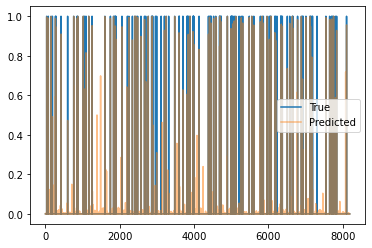

Train Epoch: 9 [610/2220 (27%)]	Loss: 0.011043	Pres: 0.002075	F1 Score: 0.002075
Train Epoch: 9 [620/2220 (27%)]	Loss: 0.007025	Pres: 0.002075	F1 Score: 0.002075
Train Epoch: 9 [630/2220 (28%)]	Loss: 0.011581	Pres: 0.002686	F1 Score: 0.002686
Train Epoch: 9 [640/2220 (28%)]	Loss: 0.009518	Pres: 0.002563	F1 Score: 0.002563
Train Epoch: 9 [650/2220 (29%)]	Loss: 0.009043	Pres: 0.002075	F1 Score: 0.002075
Train Epoch: 9 [660/2220 (29%)]	Loss: 0.009464	Pres: 0.002563	F1 Score: 0.002563
Train Epoch: 9 [670/2220 (30%)]	Loss: 0.009883	Pres: 0.002563	F1 Score: 0.002563
Train Epoch: 9 [680/2220 (30%)]	Loss: 0.008875	Pres: 0.001831	F1 Score: 0.001831
Train Epoch: 9 [690/2220 (31%)]	Loss: 0.007358	Pres: 0.001831	F1 Score: 0.001831
Train Epoch: 9 [700/2220 (31%)]	Loss: 0.008692	Pres: 0.001831	F1 Score: 0.001831
Train Epoch: 9 [710/2220 (31%)]	Loss: 0.011906	Pres: 0.002319	F1 Score: 0.002319
Train Epoch: 9 [720/2220 (32%)]	Loss: 0.008384	Pres: 0.002075	F1 Score: 0.002075
Train Epoch: 9 [730/2220 (32

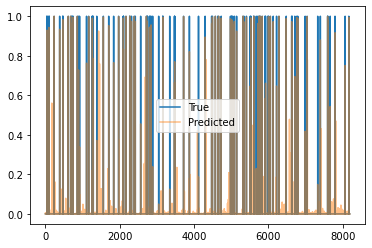

Train Epoch: 9 [910/2220 (40%)]	Loss: 0.014698	Pres: 0.001831	F1 Score: 0.001831
Train Epoch: 9 [920/2220 (41%)]	Loss: 0.010516	Pres: 0.002441	F1 Score: 0.002441
Train Epoch: 9 [930/2220 (41%)]	Loss: 0.009779	Pres: 0.002563	F1 Score: 0.002563
Train Epoch: 9 [940/2220 (42%)]	Loss: 0.013318	Pres: 0.003540	F1 Score: 0.003540
Train Epoch: 9 [950/2220 (42%)]	Loss: 0.007938	Pres: 0.001831	F1 Score: 0.001831
Train Epoch: 9 [960/2220 (43%)]	Loss: 0.033703	Pres: 0.003784	F1 Score: 0.003784
Train Epoch: 9 [970/2220 (43%)]	Loss: 0.009888	Pres: 0.001831	F1 Score: 0.001831
Train Epoch: 9 [980/2220 (44%)]	Loss: 0.044465	Pres: 0.001587	F1 Score: 0.001587
Train Epoch: 9 [990/2220 (44%)]	Loss: 0.010809	Pres: 0.002686	F1 Score: 0.002686
Train Epoch: 9 [1000/2220 (45%)]	Loss: 0.009612	Pres: 0.002075	F1 Score: 0.002075
Train Epoch: 9 [1010/2220 (45%)]	Loss: 0.008364	Pres: 0.002930	F1 Score: 0.002930
Train Epoch: 9 [1020/2220 (45%)]	Loss: 0.007151	Pres: 0.003418	F1 Score: 0.003418
Train Epoch: 9 [1030/2220

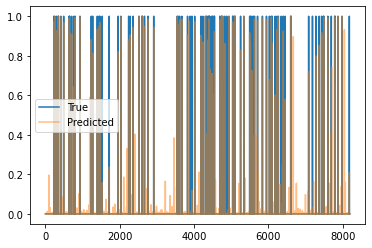

Train Epoch: 9 [1210/2220 (54%)]	Loss: 0.010269	Pres: 0.003906	F1 Score: 0.003906
Train Epoch: 9 [1220/2220 (54%)]	Loss: 0.011912	Pres: 0.001953	F1 Score: 0.001953
Train Epoch: 9 [1230/2220 (55%)]	Loss: 0.011362	Pres: 0.002686	F1 Score: 0.002686
Train Epoch: 9 [1240/2220 (55%)]	Loss: 0.013768	Pres: 0.001343	F1 Score: 0.001343
Train Epoch: 9 [1250/2220 (56%)]	Loss: 0.010966	Pres: 0.001831	F1 Score: 0.001831
Train Epoch: 9 [1260/2220 (56%)]	Loss: 0.010501	Pres: 0.002808	F1 Score: 0.002808
Train Epoch: 9 [1270/2220 (57%)]	Loss: 0.015936	Pres: 0.001587	F1 Score: 0.001587
Train Epoch: 9 [1280/2220 (57%)]	Loss: 0.013039	Pres: 0.001709	F1 Score: 0.001709
Train Epoch: 9 [1290/2220 (58%)]	Loss: 0.010428	Pres: 0.003052	F1 Score: 0.003052
Train Epoch: 9 [1300/2220 (58%)]	Loss: 0.012681	Pres: 0.002441	F1 Score: 0.002441
Train Epoch: 9 [1310/2220 (59%)]	Loss: 0.009871	Pres: 0.003174	F1 Score: 0.003174
Train Epoch: 9 [1320/2220 (59%)]	Loss: 0.009423	Pres: 0.001709	F1 Score: 0.001709
Train Epoch: 9 [

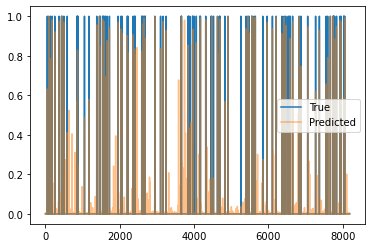

Train Epoch: 9 [1510/2220 (68%)]	Loss: 0.011382	Pres: 0.003174	F1 Score: 0.003174
Train Epoch: 9 [1520/2220 (68%)]	Loss: 0.012844	Pres: 0.001587	F1 Score: 0.001587
Train Epoch: 9 [1530/2220 (68%)]	Loss: 0.010061	Pres: 0.003174	F1 Score: 0.003174
Train Epoch: 9 [1540/2220 (69%)]	Loss: 0.013532	Pres: 0.003174	F1 Score: 0.003174
Train Epoch: 9 [1550/2220 (69%)]	Loss: 0.013336	Pres: 0.002441	F1 Score: 0.002441
Train Epoch: 9 [1560/2220 (70%)]	Loss: 0.011795	Pres: 0.002686	F1 Score: 0.002686
Train Epoch: 9 [1570/2220 (70%)]	Loss: 0.012638	Pres: 0.001709	F1 Score: 0.001709
Train Epoch: 9 [1580/2220 (71%)]	Loss: 0.011318	Pres: 0.003052	F1 Score: 0.003052
Train Epoch: 9 [1590/2220 (71%)]	Loss: 0.010309	Pres: 0.002563	F1 Score: 0.002563
Train Epoch: 9 [1600/2220 (72%)]	Loss: 0.010253	Pres: 0.002563	F1 Score: 0.002563
Train Epoch: 9 [1610/2220 (72%)]	Loss: 0.010979	Pres: 0.001587	F1 Score: 0.001587
Train Epoch: 9 [1620/2220 (72%)]	Loss: 0.010538	Pres: 0.004761	F1 Score: 0.004761
Train Epoch: 9 [

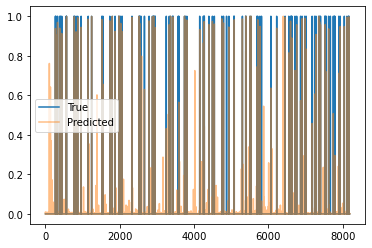

Train Epoch: 9 [1810/2220 (81%)]	Loss: 0.009129	Pres: 0.003784	F1 Score: 0.003784
Train Epoch: 9 [1820/2220 (81%)]	Loss: 0.015634	Pres: 0.002197	F1 Score: 0.002197
Train Epoch: 9 [1830/2220 (82%)]	Loss: 0.013772	Pres: 0.002319	F1 Score: 0.002319
Train Epoch: 9 [1840/2220 (82%)]	Loss: 0.011195	Pres: 0.002808	F1 Score: 0.002808
Train Epoch: 9 [1850/2220 (83%)]	Loss: 0.011633	Pres: 0.002563	F1 Score: 0.002563
Train Epoch: 9 [1860/2220 (83%)]	Loss: 0.009830	Pres: 0.002686	F1 Score: 0.002686
Train Epoch: 9 [1870/2220 (84%)]	Loss: 0.010728	Pres: 0.003418	F1 Score: 0.003418
Train Epoch: 9 [1880/2220 (84%)]	Loss: 0.007963	Pres: 0.002075	F1 Score: 0.002075
Train Epoch: 9 [1890/2220 (85%)]	Loss: 0.011290	Pres: 0.002686	F1 Score: 0.002686
Train Epoch: 9 [1900/2220 (85%)]	Loss: 0.041428	Pres: 0.000854	F1 Score: 0.000854
Train Epoch: 9 [1910/2220 (86%)]	Loss: 0.011028	Pres: 0.002075	F1 Score: 0.002075
Train Epoch: 9 [1920/2220 (86%)]	Loss: 0.011022	Pres: 0.003540	F1 Score: 0.003540
Train Epoch: 9 [

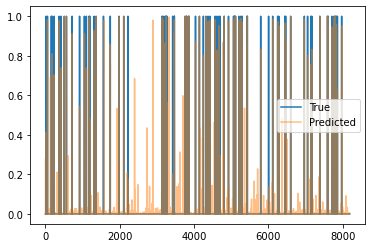

Train Epoch: 9 [2110/2220 (95%)]	Loss: 0.012010	Pres: 0.003418	F1 Score: 0.003418
Train Epoch: 9 [2120/2220 (95%)]	Loss: 0.012411	Pres: 0.001953	F1 Score: 0.001953
Train Epoch: 9 [2130/2220 (95%)]	Loss: 0.009648	Pres: 0.002563	F1 Score: 0.002563
Train Epoch: 9 [2140/2220 (96%)]	Loss: 0.013893	Pres: 0.003174	F1 Score: 0.003174
Train Epoch: 9 [2150/2220 (96%)]	Loss: 0.011883	Pres: 0.002441	F1 Score: 0.002441
Train Epoch: 9 [2160/2220 (97%)]	Loss: 0.068708	Pres: 0.000488	F1 Score: 0.000488
Train Epoch: 9 [2170/2220 (97%)]	Loss: 0.010885	Pres: 0.002686	F1 Score: 0.002686
Train Epoch: 9 [2180/2220 (98%)]	Loss: 0.010626	Pres: 0.003662	F1 Score: 0.003662
Train Epoch: 9 [2190/2220 (98%)]	Loss: 0.009197	Pres: 0.003906	F1 Score: 0.003906
Train Epoch: 9 [2200/2220 (99%)]	Loss: 0.011178	Pres: 0.002808	F1 Score: 0.002808
Train Epoch: 9 [2210/2220 (99%)]	Loss: 0.012008	Pres: 0.002563	F1 Score: 0.002563
Validation Epoch: 9 [0/582 (0%)]	Loss: 0.006049	Pres: 0.001587	F1 Score: 0.001587


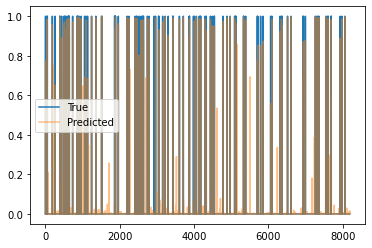

Validation Epoch: 9 [10/582 (1%)]	Loss: 0.004820	Pres: 0.001831	F1 Score: 0.001831
Validation Epoch: 9 [20/582 (3%)]	Loss: 0.004625	Pres: 0.001953	F1 Score: 0.001953
Validation Epoch: 9 [30/582 (5%)]	Loss: 0.004330	Pres: 0.001587	F1 Score: 0.001587
Validation Epoch: 9 [40/582 (6%)]	Loss: 0.003517	Pres: 0.001587	F1 Score: 0.001587
Validation Epoch: 9 [50/582 (8%)]	Loss: 0.005007	Pres: 0.001953	F1 Score: 0.001953
Validation Epoch: 9 [60/582 (10%)]	Loss: 0.006418	Pres: 0.002197	F1 Score: 0.002197
Validation Epoch: 9 [70/582 (12%)]	Loss: 0.006094	Pres: 0.001343	F1 Score: 0.001343
Validation Epoch: 9 [80/582 (13%)]	Loss: 0.003998	Pres: 0.001953	F1 Score: 0.001953
Validation Epoch: 9 [90/582 (15%)]	Loss: 0.003892	Pres: 0.002075	F1 Score: 0.002075
Validation Epoch: 9 [100/582 (17%)]	Loss: 0.006524	Pres: 0.001831	F1 Score: 0.001831
Validation Epoch: 9 [110/582 (18%)]	Loss: 0.003788	Pres: 0.001953	F1 Score: 0.001953
Validation Epoch: 9 [120/582 (20%)]	Loss: 0.003522	Pres: 0.001587	F1 Score: 0.0

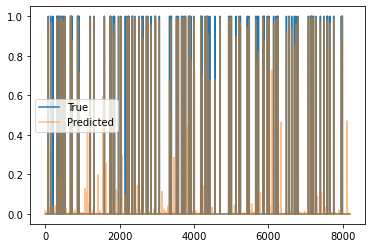

Validation Epoch: 9 [310/582 (53%)]	Loss: 0.005347	Pres: 0.001953	F1 Score: 0.001953
Validation Epoch: 9 [320/582 (54%)]	Loss: 0.005870	Pres: 0.002319	F1 Score: 0.002319
Validation Epoch: 9 [330/582 (56%)]	Loss: 0.003392	Pres: 0.001343	F1 Score: 0.001343
Validation Epoch: 9 [340/582 (58%)]	Loss: 0.005438	Pres: 0.002075	F1 Score: 0.002075
Validation Epoch: 9 [350/582 (60%)]	Loss: 0.004822	Pres: 0.001587	F1 Score: 0.001587
Validation Epoch: 9 [360/582 (61%)]	Loss: 0.003786	Pres: 0.001831	F1 Score: 0.001831
Validation Epoch: 9 [370/582 (63%)]	Loss: 0.003744	Pres: 0.001831	F1 Score: 0.001831
Validation Epoch: 9 [380/582 (65%)]	Loss: 0.003323	Pres: 0.001343	F1 Score: 0.001343
Validation Epoch: 9 [390/582 (67%)]	Loss: 0.004773	Pres: 0.001221	F1 Score: 0.001221
Validation Epoch: 9 [400/582 (68%)]	Loss: 0.004419	Pres: 0.001831	F1 Score: 0.001831
Validation Epoch: 9 [410/582 (70%)]	Loss: 0.002980	Pres: 0.001709	F1 Score: 0.001709
Validation Epoch: 9 [420/582 (72%)]	Loss: 0.003557	Pres: 0.001953

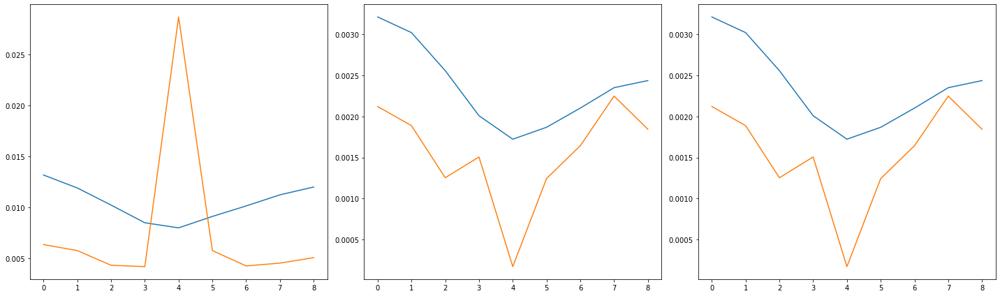

2220 582
Train Epoch: 10 [0/2220 (0%)]	Loss: 0.014565	Pres: 0.001953	F1 Score: 0.001953
117.0 -inf


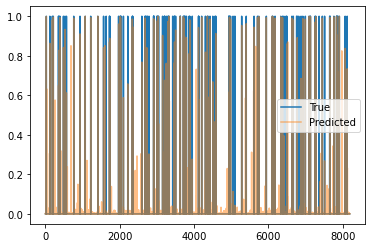

Train Epoch: 10 [10/2220 (0%)]	Loss: 0.012048	Pres: 0.002808	F1 Score: 0.002808
Train Epoch: 10 [20/2220 (0%)]	Loss: 0.011008	Pres: 0.002930	F1 Score: 0.002930
Train Epoch: 10 [30/2220 (1%)]	Loss: 0.010456	Pres: 0.001709	F1 Score: 0.001709
Train Epoch: 10 [40/2220 (1%)]	Loss: 0.051392	Pres: 0.001465	F1 Score: 0.001465
Train Epoch: 10 [50/2220 (2%)]	Loss: 0.010860	Pres: 0.002930	F1 Score: 0.002930
Train Epoch: 10 [60/2220 (2%)]	Loss: 0.016253	Pres: 0.001465	F1 Score: 0.001465
Train Epoch: 10 [70/2220 (3%)]	Loss: 0.010893	Pres: 0.003052	F1 Score: 0.003052
Train Epoch: 10 [80/2220 (3%)]	Loss: 0.012990	Pres: 0.003662	F1 Score: 0.003662
Train Epoch: 10 [90/2220 (4%)]	Loss: 0.016181	Pres: 0.003662	F1 Score: 0.003662
Train Epoch: 10 [100/2220 (4%)]	Loss: 0.009761	Pres: 0.003662	F1 Score: 0.003662
Train Epoch: 10 [110/2220 (4%)]	Loss: 0.009210	Pres: 0.002930	F1 Score: 0.002930
Train Epoch: 10 [120/2220 (5%)]	Loss: 0.011873	Pres: 0.001953	F1 Score: 0.001953
Train Epoch: 10 [130/2220 (5%)]	Loss:

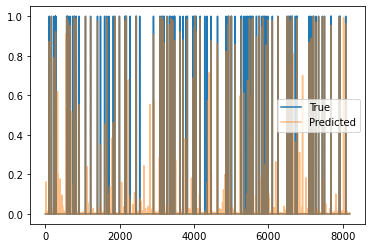

Train Epoch: 10 [310/2220 (13%)]	Loss: 0.015942	Pres: 0.002930	F1 Score: 0.002930
Train Epoch: 10 [320/2220 (14%)]	Loss: 0.012964	Pres: 0.002563	F1 Score: 0.002563
Train Epoch: 10 [330/2220 (14%)]	Loss: 0.010491	Pres: 0.001587	F1 Score: 0.001587
Train Epoch: 10 [340/2220 (15%)]	Loss: 0.011255	Pres: 0.002441	F1 Score: 0.002441
Train Epoch: 10 [350/2220 (15%)]	Loss: 0.016042	Pres: 0.002930	F1 Score: 0.002930
Train Epoch: 10 [360/2220 (16%)]	Loss: 0.010624	Pres: 0.003296	F1 Score: 0.003296
Train Epoch: 10 [370/2220 (16%)]	Loss: 0.011594	Pres: 0.003418	F1 Score: 0.003418
Train Epoch: 10 [380/2220 (17%)]	Loss: 0.015775	Pres: 0.002808	F1 Score: 0.002808
Train Epoch: 10 [390/2220 (17%)]	Loss: 0.012176	Pres: 0.003174	F1 Score: 0.003174
Train Epoch: 10 [400/2220 (18%)]	Loss: 0.042182	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [410/2220 (18%)]	Loss: 0.011385	Pres: 0.003418	F1 Score: 0.003418
Train Epoch: 10 [420/2220 (18%)]	Loss: 0.010351	Pres: 0.002686	F1 Score: 0.002686
Train Epoch: 10 

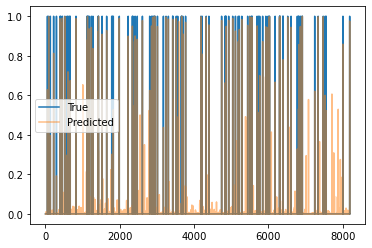

Train Epoch: 10 [610/2220 (27%)]	Loss: 0.012968	Pres: 0.002197	F1 Score: 0.002197
Train Epoch: 10 [620/2220 (27%)]	Loss: 0.011032	Pres: 0.001343	F1 Score: 0.001343
Train Epoch: 10 [630/2220 (28%)]	Loss: 0.011845	Pres: 0.003052	F1 Score: 0.003052
Train Epoch: 10 [640/2220 (28%)]	Loss: 0.010217	Pres: 0.002441	F1 Score: 0.002441
Train Epoch: 10 [650/2220 (29%)]	Loss: 0.009960	Pres: 0.003662	F1 Score: 0.003662
Train Epoch: 10 [660/2220 (29%)]	Loss: 0.010869	Pres: 0.002686	F1 Score: 0.002686
Train Epoch: 10 [670/2220 (30%)]	Loss: 0.009957	Pres: 0.000854	F1 Score: 0.000854
Train Epoch: 10 [680/2220 (30%)]	Loss: 0.012152	Pres: 0.002563	F1 Score: 0.002563
Train Epoch: 10 [690/2220 (31%)]	Loss: 0.011915	Pres: 0.003052	F1 Score: 0.003052
Train Epoch: 10 [700/2220 (31%)]	Loss: 0.010722	Pres: 0.002075	F1 Score: 0.002075
Train Epoch: 10 [710/2220 (31%)]	Loss: 0.011450	Pres: 0.002808	F1 Score: 0.002808
Train Epoch: 10 [720/2220 (32%)]	Loss: 0.011119	Pres: 0.002197	F1 Score: 0.002197
Train Epoch: 10 

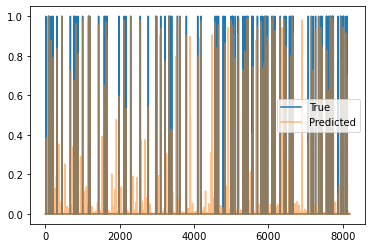

Train Epoch: 10 [910/2220 (40%)]	Loss: 0.011701	Pres: 0.001953	F1 Score: 0.001953
Train Epoch: 10 [920/2220 (41%)]	Loss: 0.011710	Pres: 0.001953	F1 Score: 0.001953
Train Epoch: 10 [930/2220 (41%)]	Loss: 0.011768	Pres: 0.002197	F1 Score: 0.002197
Train Epoch: 10 [940/2220 (42%)]	Loss: 0.017858	Pres: 0.003052	F1 Score: 0.003052
Train Epoch: 10 [950/2220 (42%)]	Loss: 0.013071	Pres: 0.003296	F1 Score: 0.003296
Train Epoch: 10 [960/2220 (43%)]	Loss: 0.012639	Pres: 0.003296	F1 Score: 0.003296
Train Epoch: 10 [970/2220 (43%)]	Loss: 0.011357	Pres: 0.002686	F1 Score: 0.002686
Train Epoch: 10 [980/2220 (44%)]	Loss: 0.008481	Pres: 0.003296	F1 Score: 0.003296
Train Epoch: 10 [990/2220 (44%)]	Loss: 0.010407	Pres: 0.003052	F1 Score: 0.003052
Train Epoch: 10 [1000/2220 (45%)]	Loss: 0.012962	Pres: 0.002197	F1 Score: 0.002197
Train Epoch: 10 [1010/2220 (45%)]	Loss: 0.008860	Pres: 0.002686	F1 Score: 0.002686
Train Epoch: 10 [1020/2220 (45%)]	Loss: 0.007497	Pres: 0.001831	F1 Score: 0.001831
Train Epoch: 

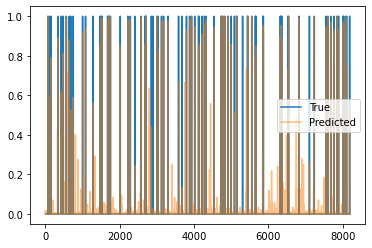

Train Epoch: 10 [1210/2220 (54%)]	Loss: 0.014861	Pres: 0.002075	F1 Score: 0.002075
Train Epoch: 10 [1220/2220 (54%)]	Loss: 0.008986	Pres: 0.003052	F1 Score: 0.003052
Train Epoch: 10 [1230/2220 (55%)]	Loss: 0.010065	Pres: 0.002563	F1 Score: 0.002563
Train Epoch: 10 [1240/2220 (55%)]	Loss: 0.010348	Pres: 0.003784	F1 Score: 0.003784
Train Epoch: 10 [1250/2220 (56%)]	Loss: 0.010967	Pres: 0.003662	F1 Score: 0.003662
Train Epoch: 10 [1260/2220 (56%)]	Loss: 0.011387	Pres: 0.001953	F1 Score: 0.001953
Train Epoch: 10 [1270/2220 (57%)]	Loss: 0.007943	Pres: 0.002563	F1 Score: 0.002563
Train Epoch: 10 [1280/2220 (57%)]	Loss: 0.009509	Pres: 0.002075	F1 Score: 0.002075
Train Epoch: 10 [1290/2220 (58%)]	Loss: 0.010404	Pres: 0.002075	F1 Score: 0.002075
Train Epoch: 10 [1300/2220 (58%)]	Loss: 0.012209	Pres: 0.002563	F1 Score: 0.002563
Train Epoch: 10 [1310/2220 (59%)]	Loss: 0.015741	Pres: 0.001587	F1 Score: 0.001587
Train Epoch: 10 [1320/2220 (59%)]	Loss: 0.010547	Pres: 0.002075	F1 Score: 0.002075
Trai

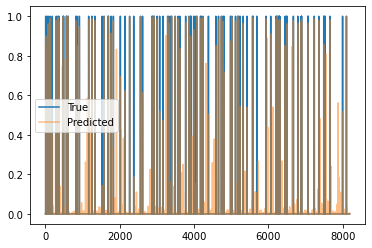

Train Epoch: 10 [1510/2220 (68%)]	Loss: 0.011943	Pres: 0.003052	F1 Score: 0.003052
Train Epoch: 10 [1520/2220 (68%)]	Loss: 0.011764	Pres: 0.002930	F1 Score: 0.002930
Train Epoch: 10 [1530/2220 (68%)]	Loss: 0.015527	Pres: 0.001221	F1 Score: 0.001221
Train Epoch: 10 [1540/2220 (69%)]	Loss: 0.011034	Pres: 0.003662	F1 Score: 0.003662
Train Epoch: 10 [1550/2220 (69%)]	Loss: 0.007839	Pres: 0.002563	F1 Score: 0.002563
Train Epoch: 10 [1560/2220 (70%)]	Loss: 0.011794	Pres: 0.002075	F1 Score: 0.002075
Train Epoch: 10 [1570/2220 (70%)]	Loss: 0.012507	Pres: 0.002319	F1 Score: 0.002319
Train Epoch: 10 [1580/2220 (71%)]	Loss: 0.007529	Pres: 0.001953	F1 Score: 0.001953
Train Epoch: 10 [1590/2220 (71%)]	Loss: 0.013557	Pres: 0.003052	F1 Score: 0.003052
Train Epoch: 10 [1600/2220 (72%)]	Loss: 0.044008	Pres: 0.000488	F1 Score: 0.000488
Train Epoch: 10 [1610/2220 (72%)]	Loss: 0.011231	Pres: 0.002686	F1 Score: 0.002686
Train Epoch: 10 [1620/2220 (72%)]	Loss: 0.010749	Pres: 0.002563	F1 Score: 0.002563
Trai

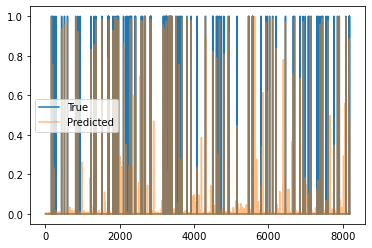

Train Epoch: 10 [1810/2220 (81%)]	Loss: 0.011259	Pres: 0.002808	F1 Score: 0.002808
Train Epoch: 10 [1820/2220 (81%)]	Loss: 0.013133	Pres: 0.002441	F1 Score: 0.002441
Train Epoch: 10 [1830/2220 (82%)]	Loss: 0.049967	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [1840/2220 (82%)]	Loss: 0.010064	Pres: 0.002441	F1 Score: 0.002441
Train Epoch: 10 [1850/2220 (83%)]	Loss: 0.014165	Pres: 0.003052	F1 Score: 0.003052
Train Epoch: 10 [1860/2220 (83%)]	Loss: 0.011885	Pres: 0.003418	F1 Score: 0.003418
Train Epoch: 10 [1870/2220 (84%)]	Loss: 0.010539	Pres: 0.003174	F1 Score: 0.003174
Train Epoch: 10 [1880/2220 (84%)]	Loss: 0.010216	Pres: 0.003052	F1 Score: 0.003052
Train Epoch: 10 [1890/2220 (85%)]	Loss: 0.011734	Pres: 0.002197	F1 Score: 0.002197
Train Epoch: 10 [1900/2220 (85%)]	Loss: 0.008205	Pres: 0.002075	F1 Score: 0.002075
Train Epoch: 10 [1910/2220 (86%)]	Loss: 0.010408	Pres: 0.002319	F1 Score: 0.002319
Train Epoch: 10 [1920/2220 (86%)]	Loss: 0.011628	Pres: 0.002441	F1 Score: 0.002441
Trai

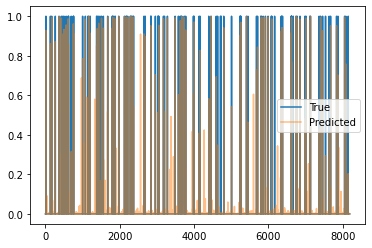

Train Epoch: 10 [2110/2220 (95%)]	Loss: 0.012959	Pres: 0.002075	F1 Score: 0.002075
Train Epoch: 10 [2120/2220 (95%)]	Loss: 0.009986	Pres: 0.001343	F1 Score: 0.001343
Train Epoch: 10 [2130/2220 (95%)]	Loss: 0.011257	Pres: 0.002686	F1 Score: 0.002686
Train Epoch: 10 [2140/2220 (96%)]	Loss: 0.014051	Pres: 0.003052	F1 Score: 0.003052
Train Epoch: 10 [2150/2220 (96%)]	Loss: 0.012066	Pres: 0.003174	F1 Score: 0.003174
Train Epoch: 10 [2160/2220 (97%)]	Loss: 0.007292	Pres: 0.002075	F1 Score: 0.002075
Train Epoch: 10 [2170/2220 (97%)]	Loss: 0.009395	Pres: 0.002197	F1 Score: 0.002197
Train Epoch: 10 [2180/2220 (98%)]	Loss: 0.010985	Pres: 0.002075	F1 Score: 0.002075
Train Epoch: 10 [2190/2220 (98%)]	Loss: 0.013334	Pres: 0.002930	F1 Score: 0.002930
Train Epoch: 10 [2200/2220 (99%)]	Loss: 0.007492	Pres: 0.002319	F1 Score: 0.002319
Train Epoch: 10 [2210/2220 (99%)]	Loss: 0.008345	Pres: 0.002075	F1 Score: 0.002075
Validation Epoch: 10 [0/582 (0%)]	Loss: 0.006841	Pres: 0.001953	F1 Score: 0.001953


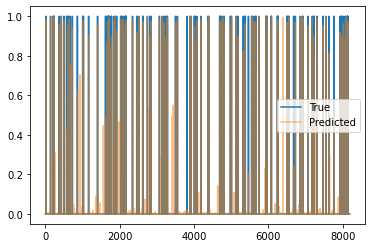

Validation Epoch: 10 [10/582 (1%)]	Loss: 0.008228	Pres: 0.002930	F1 Score: 0.002930
Validation Epoch: 10 [20/582 (3%)]	Loss: 0.004495	Pres: 0.001465	F1 Score: 0.001465
Validation Epoch: 10 [30/582 (5%)]	Loss: 0.007486	Pres: 0.001709	F1 Score: 0.001709
Validation Epoch: 10 [40/582 (6%)]	Loss: 0.006119	Pres: 0.001709	F1 Score: 0.001709
Validation Epoch: 10 [50/582 (8%)]	Loss: 0.005535	Pres: 0.002563	F1 Score: 0.002563
Validation Epoch: 10 [60/582 (10%)]	Loss: 0.002871	Pres: 0.002075	F1 Score: 0.002075
Validation Epoch: 10 [70/582 (12%)]	Loss: 0.005474	Pres: 0.002563	F1 Score: 0.002563
Validation Epoch: 10 [80/582 (13%)]	Loss: 0.006790	Pres: 0.001587	F1 Score: 0.001587
Validation Epoch: 10 [90/582 (15%)]	Loss: 0.004985	Pres: 0.002686	F1 Score: 0.002686
Validation Epoch: 10 [100/582 (17%)]	Loss: 0.007049	Pres: 0.002930	F1 Score: 0.002930
Validation Epoch: 10 [110/582 (18%)]	Loss: 0.005726	Pres: 0.001709	F1 Score: 0.001709
Validation Epoch: 10 [120/582 (20%)]	Loss: 0.004925	Pres: 0.002319	F

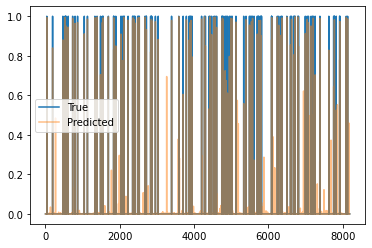

Validation Epoch: 10 [310/582 (53%)]	Loss: 0.004392	Pres: 0.001709	F1 Score: 0.001709
Validation Epoch: 10 [320/582 (54%)]	Loss: 0.003997	Pres: 0.002563	F1 Score: 0.002563
Validation Epoch: 10 [330/582 (56%)]	Loss: 0.005463	Pres: 0.002441	F1 Score: 0.002441
Validation Epoch: 10 [340/582 (58%)]	Loss: 0.003398	Pres: 0.002197	F1 Score: 0.002197
Validation Epoch: 10 [350/582 (60%)]	Loss: 0.004612	Pres: 0.002808	F1 Score: 0.002808
Validation Epoch: 10 [360/582 (61%)]	Loss: 0.004516	Pres: 0.001709	F1 Score: 0.001709
Validation Epoch: 10 [370/582 (63%)]	Loss: 0.006378	Pres: 0.002686	F1 Score: 0.002686
Validation Epoch: 10 [380/582 (65%)]	Loss: 0.006922	Pres: 0.003052	F1 Score: 0.003052
Validation Epoch: 10 [390/582 (67%)]	Loss: 0.005791	Pres: 0.001831	F1 Score: 0.001831
Validation Epoch: 10 [400/582 (68%)]	Loss: 0.004736	Pres: 0.001221	F1 Score: 0.001221
Validation Epoch: 10 [410/582 (70%)]	Loss: 0.004132	Pres: 0.001709	F1 Score: 0.001709
Validation Epoch: 10 [420/582 (72%)]	Loss: 0.004363	Pr

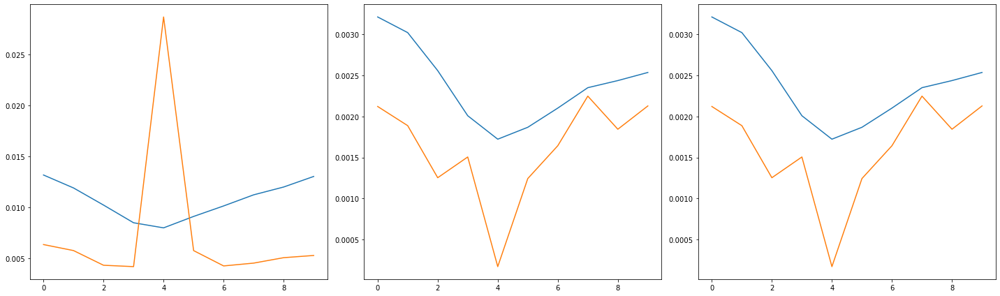

2220 582
Train Epoch: 11 [0/2220 (0%)]	Loss: 0.007683	Pres: 0.002808	F1 Score: 0.002808
96.0 -inf


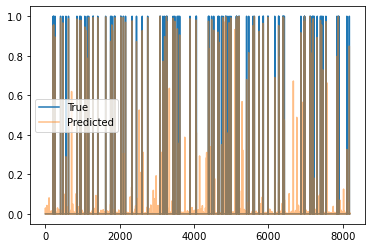

Train Epoch: 11 [10/2220 (0%)]	Loss: 0.010833	Pres: 0.002563	F1 Score: 0.002563
Train Epoch: 11 [20/2220 (0%)]	Loss: 0.009509	Pres: 0.001953	F1 Score: 0.001953
Train Epoch: 11 [30/2220 (1%)]	Loss: 0.010551	Pres: 0.001709	F1 Score: 0.001709
Train Epoch: 11 [40/2220 (1%)]	Loss: 0.072835	Pres: 0.001343	F1 Score: 0.001343
Train Epoch: 11 [50/2220 (2%)]	Loss: 0.011767	Pres: 0.002319	F1 Score: 0.002319
Train Epoch: 11 [60/2220 (2%)]	Loss: 0.008853	Pres: 0.002808	F1 Score: 0.002808
Train Epoch: 11 [70/2220 (3%)]	Loss: 0.009315	Pres: 0.002808	F1 Score: 0.002808
Train Epoch: 11 [80/2220 (3%)]	Loss: 0.013568	Pres: 0.002075	F1 Score: 0.002075
Train Epoch: 11 [90/2220 (4%)]	Loss: 0.011990	Pres: 0.002686	F1 Score: 0.002686
Train Epoch: 11 [100/2220 (4%)]	Loss: 0.011476	Pres: 0.003174	F1 Score: 0.003174
Train Epoch: 11 [110/2220 (4%)]	Loss: 0.011954	Pres: 0.002930	F1 Score: 0.002930
Train Epoch: 11 [120/2220 (5%)]	Loss: 0.008812	Pres: 0.003052	F1 Score: 0.003052
Train Epoch: 11 [130/2220 (5%)]	Loss:

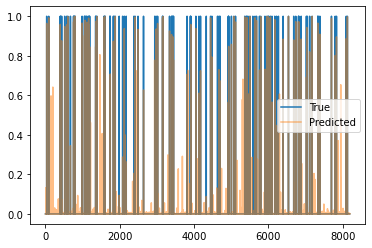

Train Epoch: 11 [310/2220 (13%)]	Loss: 0.011061	Pres: 0.002075	F1 Score: 0.002075
Train Epoch: 11 [320/2220 (14%)]	Loss: 0.012467	Pres: 0.003174	F1 Score: 0.003174
Train Epoch: 11 [330/2220 (14%)]	Loss: 0.008243	Pres: 0.002808	F1 Score: 0.002808
Train Epoch: 11 [340/2220 (15%)]	Loss: 0.013580	Pres: 0.002563	F1 Score: 0.002563
Train Epoch: 11 [350/2220 (15%)]	Loss: 0.050906	Pres: 0.000488	F1 Score: 0.000488
Train Epoch: 11 [360/2220 (16%)]	Loss: 0.011792	Pres: 0.002319	F1 Score: 0.002319
Train Epoch: 11 [370/2220 (16%)]	Loss: 0.016830	Pres: 0.002563	F1 Score: 0.002563
Train Epoch: 11 [380/2220 (17%)]	Loss: 0.010719	Pres: 0.001709	F1 Score: 0.001709
Train Epoch: 11 [390/2220 (17%)]	Loss: 0.010726	Pres: 0.003174	F1 Score: 0.003174
Train Epoch: 11 [400/2220 (18%)]	Loss: 0.011399	Pres: 0.003662	F1 Score: 0.003662
Train Epoch: 11 [410/2220 (18%)]	Loss: 0.011664	Pres: 0.002197	F1 Score: 0.002197
Train Epoch: 11 [420/2220 (18%)]	Loss: 0.013357	Pres: 0.003174	F1 Score: 0.003174
Train Epoch: 11 

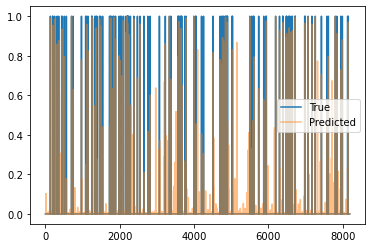

Train Epoch: 11 [610/2220 (27%)]	Loss: 0.013030	Pres: 0.003418	F1 Score: 0.003418
Train Epoch: 11 [620/2220 (27%)]	Loss: 0.012548	Pres: 0.002808	F1 Score: 0.002808
Train Epoch: 11 [630/2220 (28%)]	Loss: 0.014649	Pres: 0.002808	F1 Score: 0.002808
Train Epoch: 11 [640/2220 (28%)]	Loss: 0.011146	Pres: 0.003540	F1 Score: 0.003540
Train Epoch: 11 [650/2220 (29%)]	Loss: 0.010892	Pres: 0.002930	F1 Score: 0.002930
Train Epoch: 11 [660/2220 (29%)]	Loss: 0.008837	Pres: 0.003296	F1 Score: 0.003296
Train Epoch: 11 [670/2220 (30%)]	Loss: 0.013424	Pres: 0.001953	F1 Score: 0.001953
Train Epoch: 11 [680/2220 (30%)]	Loss: 0.010183	Pres: 0.002563	F1 Score: 0.002563
Train Epoch: 11 [690/2220 (31%)]	Loss: 0.011939	Pres: 0.002319	F1 Score: 0.002319
Train Epoch: 11 [700/2220 (31%)]	Loss: 0.011580	Pres: 0.001831	F1 Score: 0.001831
Train Epoch: 11 [710/2220 (31%)]	Loss: 0.011213	Pres: 0.002808	F1 Score: 0.002808
Train Epoch: 11 [720/2220 (32%)]	Loss: 0.012103	Pres: 0.002441	F1 Score: 0.002441
Train Epoch: 11 

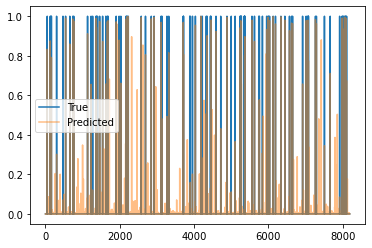

Train Epoch: 11 [910/2220 (40%)]	Loss: 0.013015	Pres: 0.002319	F1 Score: 0.002319
Train Epoch: 11 [920/2220 (41%)]	Loss: 0.014279	Pres: 0.003662	F1 Score: 0.003662
Train Epoch: 11 [930/2220 (41%)]	Loss: 0.012868	Pres: 0.003174	F1 Score: 0.003174
Train Epoch: 11 [940/2220 (42%)]	Loss: 0.012272	Pres: 0.003418	F1 Score: 0.003418
Train Epoch: 11 [950/2220 (42%)]	Loss: 0.011390	Pres: 0.003052	F1 Score: 0.003052
Train Epoch: 11 [960/2220 (43%)]	Loss: 0.014855	Pres: 0.003296	F1 Score: 0.003296
Train Epoch: 11 [970/2220 (43%)]	Loss: 0.014041	Pres: 0.003052	F1 Score: 0.003052
Train Epoch: 11 [980/2220 (44%)]	Loss: 0.015935	Pres: 0.003296	F1 Score: 0.003296
Train Epoch: 11 [990/2220 (44%)]	Loss: 0.012008	Pres: 0.002686	F1 Score: 0.002686
Train Epoch: 11 [1000/2220 (45%)]	Loss: 0.009817	Pres: 0.002197	F1 Score: 0.002197
Train Epoch: 11 [1010/2220 (45%)]	Loss: 0.014553	Pres: 0.003418	F1 Score: 0.003418
Train Epoch: 11 [1020/2220 (45%)]	Loss: 0.012548	Pres: 0.003174	F1 Score: 0.003174
Train Epoch: 

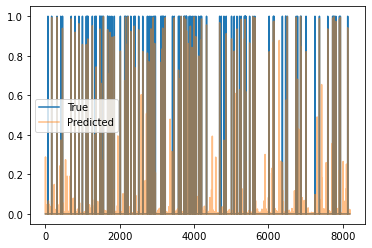

Train Epoch: 11 [1210/2220 (54%)]	Loss: 0.014648	Pres: 0.001587	F1 Score: 0.001587
Train Epoch: 11 [1220/2220 (54%)]	Loss: 0.010559	Pres: 0.002808	F1 Score: 0.002808
Train Epoch: 11 [1230/2220 (55%)]	Loss: 0.014234	Pres: 0.003418	F1 Score: 0.003418
Train Epoch: 11 [1240/2220 (55%)]	Loss: 0.012814	Pres: 0.003418	F1 Score: 0.003418
Train Epoch: 11 [1250/2220 (56%)]	Loss: 0.012936	Pres: 0.002930	F1 Score: 0.002930
Train Epoch: 11 [1260/2220 (56%)]	Loss: 0.014022	Pres: 0.003174	F1 Score: 0.003174
Train Epoch: 11 [1270/2220 (57%)]	Loss: 0.015844	Pres: 0.003662	F1 Score: 0.003662
Train Epoch: 11 [1280/2220 (57%)]	Loss: 0.016355	Pres: 0.003296	F1 Score: 0.003296
Train Epoch: 11 [1290/2220 (58%)]	Loss: 0.014731	Pres: 0.003906	F1 Score: 0.003906
Train Epoch: 11 [1300/2220 (58%)]	Loss: 0.011116	Pres: 0.003296	F1 Score: 0.003296
Train Epoch: 11 [1310/2220 (59%)]	Loss: 0.016293	Pres: 0.002686	F1 Score: 0.002686
Train Epoch: 11 [1320/2220 (59%)]	Loss: 0.014481	Pres: 0.003540	F1 Score: 0.003540
Trai

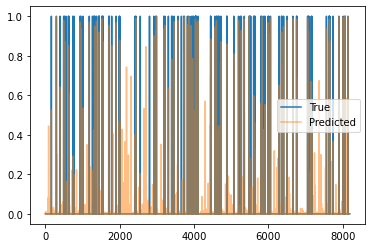

Train Epoch: 11 [1510/2220 (68%)]	Loss: 0.015461	Pres: 0.004272	F1 Score: 0.004272
Train Epoch: 11 [1520/2220 (68%)]	Loss: 0.010318	Pres: 0.002930	F1 Score: 0.002930
Train Epoch: 11 [1530/2220 (68%)]	Loss: 0.015309	Pres: 0.003784	F1 Score: 0.003784
Train Epoch: 11 [1540/2220 (69%)]	Loss: 0.014622	Pres: 0.003784	F1 Score: 0.003784
Train Epoch: 11 [1550/2220 (69%)]	Loss: 0.011633	Pres: 0.003052	F1 Score: 0.003052
Train Epoch: 11 [1560/2220 (70%)]	Loss: 0.011600	Pres: 0.003418	F1 Score: 0.003418
Train Epoch: 11 [1570/2220 (70%)]	Loss: 0.018296	Pres: 0.003052	F1 Score: 0.003052
Train Epoch: 11 [1580/2220 (71%)]	Loss: 0.014147	Pres: 0.003052	F1 Score: 0.003052
Train Epoch: 11 [1590/2220 (71%)]	Loss: 0.011119	Pres: 0.003296	F1 Score: 0.003296
Train Epoch: 11 [1600/2220 (72%)]	Loss: 0.012273	Pres: 0.003662	F1 Score: 0.003662
Train Epoch: 11 [1610/2220 (72%)]	Loss: 0.015608	Pres: 0.003418	F1 Score: 0.003418
Train Epoch: 11 [1620/2220 (72%)]	Loss: 0.010781	Pres: 0.004761	F1 Score: 0.004761
Trai

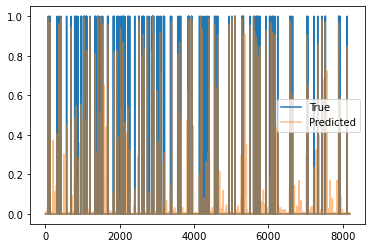

Train Epoch: 11 [1810/2220 (81%)]	Loss: 0.086888	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 11 [1820/2220 (81%)]	Loss: 0.011156	Pres: 0.004395	F1 Score: 0.004395
Train Epoch: 11 [1830/2220 (82%)]	Loss: 0.014354	Pres: 0.003296	F1 Score: 0.003296
Train Epoch: 11 [1840/2220 (82%)]	Loss: 0.016597	Pres: 0.003296	F1 Score: 0.003296
Train Epoch: 11 [1850/2220 (83%)]	Loss: 0.012501	Pres: 0.003418	F1 Score: 0.003418
Train Epoch: 11 [1860/2220 (83%)]	Loss: 0.011223	Pres: 0.002319	F1 Score: 0.002319
Train Epoch: 11 [1870/2220 (84%)]	Loss: 0.017358	Pres: 0.003296	F1 Score: 0.003296
Train Epoch: 11 [1880/2220 (84%)]	Loss: 0.016557	Pres: 0.004150	F1 Score: 0.004150
Train Epoch: 11 [1890/2220 (85%)]	Loss: 0.014386	Pres: 0.004028	F1 Score: 0.004028
Train Epoch: 11 [1900/2220 (85%)]	Loss: 0.015616	Pres: 0.004028	F1 Score: 0.004028
Train Epoch: 11 [1910/2220 (86%)]	Loss: 0.012762	Pres: 0.003174	F1 Score: 0.003174
Train Epoch: 11 [1920/2220 (86%)]	Loss: 0.013263	Pres: 0.003662	F1 Score: 0.003662
Trai

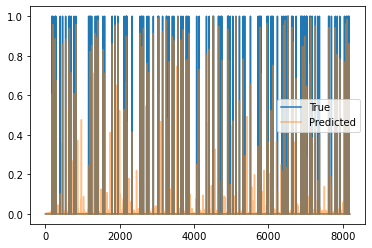

Train Epoch: 11 [2110/2220 (95%)]	Loss: 0.018449	Pres: 0.005005	F1 Score: 0.005005
Train Epoch: 11 [2120/2220 (95%)]	Loss: 0.073517	Pres: 0.000854	F1 Score: 0.000854
Train Epoch: 11 [2130/2220 (95%)]	Loss: 0.015987	Pres: 0.003296	F1 Score: 0.003296
Train Epoch: 11 [2140/2220 (96%)]	Loss: 0.018413	Pres: 0.004028	F1 Score: 0.004028
Train Epoch: 11 [2150/2220 (96%)]	Loss: 0.014169	Pres: 0.004395	F1 Score: 0.004395
Train Epoch: 11 [2160/2220 (97%)]	Loss: 0.015530	Pres: 0.003906	F1 Score: 0.003906
Train Epoch: 11 [2170/2220 (97%)]	Loss: 0.013856	Pres: 0.004395	F1 Score: 0.004395
Train Epoch: 11 [2180/2220 (98%)]	Loss: 0.014698	Pres: 0.003296	F1 Score: 0.003296
Train Epoch: 11 [2190/2220 (98%)]	Loss: 0.013804	Pres: 0.003418	F1 Score: 0.003418
Train Epoch: 11 [2200/2220 (99%)]	Loss: 0.014289	Pres: 0.004395	F1 Score: 0.004395
Train Epoch: 11 [2210/2220 (99%)]	Loss: 0.015772	Pres: 0.003296	F1 Score: 0.003296
Validation Epoch: 11 [0/582 (0%)]	Loss: 0.008422	Pres: 0.003540	F1 Score: 0.003540


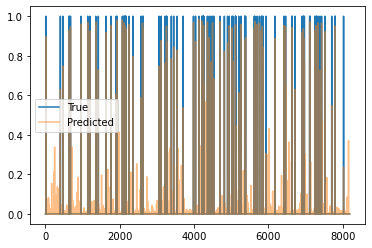

Validation Epoch: 11 [10/582 (1%)]	Loss: 0.008805	Pres: 0.004028	F1 Score: 0.004028
Validation Epoch: 11 [20/582 (3%)]	Loss: 0.007564	Pres: 0.003418	F1 Score: 0.003418
Validation Epoch: 11 [30/582 (5%)]	Loss: 0.008506	Pres: 0.004517	F1 Score: 0.004517
Validation Epoch: 11 [40/582 (6%)]	Loss: 0.009521	Pres: 0.004639	F1 Score: 0.004639
Validation Epoch: 11 [50/582 (8%)]	Loss: 0.009048	Pres: 0.004272	F1 Score: 0.004272
Validation Epoch: 11 [60/582 (10%)]	Loss: 0.008503	Pres: 0.005371	F1 Score: 0.005371
Validation Epoch: 11 [70/582 (12%)]	Loss: 0.009322	Pres: 0.005005	F1 Score: 0.005005
Validation Epoch: 11 [80/582 (13%)]	Loss: 0.008871	Pres: 0.003296	F1 Score: 0.003296
Validation Epoch: 11 [90/582 (15%)]	Loss: 0.009243	Pres: 0.003540	F1 Score: 0.003540
Validation Epoch: 11 [100/582 (17%)]	Loss: 0.008620	Pres: 0.004150	F1 Score: 0.004150
Validation Epoch: 11 [110/582 (18%)]	Loss: 0.008542	Pres: 0.003296	F1 Score: 0.003296
Validation Epoch: 11 [120/582 (20%)]	Loss: 0.008961	Pres: 0.004272	F

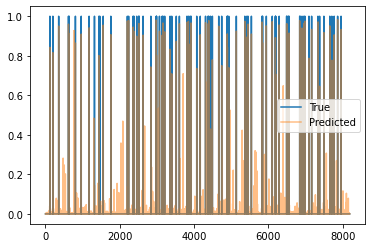

Validation Epoch: 11 [310/582 (53%)]	Loss: 0.010219	Pres: 0.004028	F1 Score: 0.004028
Validation Epoch: 11 [320/582 (54%)]	Loss: 0.011279	Pres: 0.005859	F1 Score: 0.005859
Validation Epoch: 11 [330/582 (56%)]	Loss: 0.009647	Pres: 0.003906	F1 Score: 0.003906
Validation Epoch: 11 [340/582 (58%)]	Loss: 0.009301	Pres: 0.003540	F1 Score: 0.003540
Validation Epoch: 11 [350/582 (60%)]	Loss: 0.009684	Pres: 0.003784	F1 Score: 0.003784
Validation Epoch: 11 [360/582 (61%)]	Loss: 0.008275	Pres: 0.003906	F1 Score: 0.003906
Validation Epoch: 11 [370/582 (63%)]	Loss: 0.010381	Pres: 0.004517	F1 Score: 0.004517
Validation Epoch: 11 [380/582 (65%)]	Loss: 0.009569	Pres: 0.005127	F1 Score: 0.005127
Validation Epoch: 11 [390/582 (67%)]	Loss: 0.008980	Pres: 0.003906	F1 Score: 0.003906
Validation Epoch: 11 [400/582 (68%)]	Loss: 0.007879	Pres: 0.004150	F1 Score: 0.004150
Validation Epoch: 11 [410/582 (70%)]	Loss: 0.010225	Pres: 0.003540	F1 Score: 0.003540
Validation Epoch: 11 [420/582 (72%)]	Loss: 0.009553	Pr

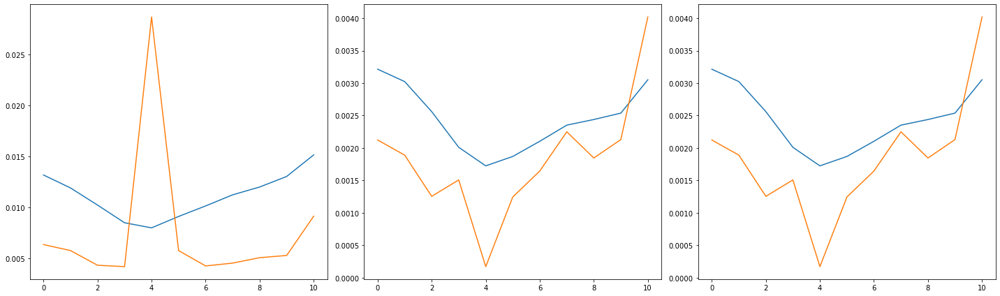

2220 582
Train Epoch: 12 [0/2220 (0%)]	Loss: 0.016481	Pres: 0.003540	F1 Score: 0.003540
107.0 -inf


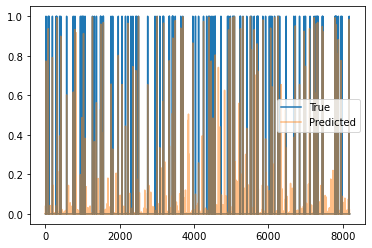

Train Epoch: 12 [10/2220 (0%)]	Loss: 0.015297	Pres: 0.003906	F1 Score: 0.003906
Train Epoch: 12 [20/2220 (0%)]	Loss: 0.015030	Pres: 0.002930	F1 Score: 0.002930
Train Epoch: 12 [30/2220 (1%)]	Loss: 0.015607	Pres: 0.003662	F1 Score: 0.003662
Train Epoch: 12 [40/2220 (1%)]	Loss: 0.013580	Pres: 0.002319	F1 Score: 0.002319
Train Epoch: 12 [50/2220 (2%)]	Loss: 0.015748	Pres: 0.002686	F1 Score: 0.002686
Train Epoch: 12 [60/2220 (2%)]	Loss: 0.015854	Pres: 0.002930	F1 Score: 0.002930
Train Epoch: 12 [70/2220 (3%)]	Loss: 0.016151	Pres: 0.002686	F1 Score: 0.002686
Train Epoch: 12 [80/2220 (3%)]	Loss: 0.016113	Pres: 0.003662	F1 Score: 0.003662
Train Epoch: 12 [90/2220 (4%)]	Loss: 0.012236	Pres: 0.004517	F1 Score: 0.004517
Train Epoch: 12 [100/2220 (4%)]	Loss: 0.012931	Pres: 0.004028	F1 Score: 0.004028
Train Epoch: 12 [110/2220 (4%)]	Loss: 0.011945	Pres: 0.002563	F1 Score: 0.002563
Train Epoch: 12 [120/2220 (5%)]	Loss: 0.013286	Pres: 0.003540	F1 Score: 0.003540
Train Epoch: 12 [130/2220 (5%)]	Loss:

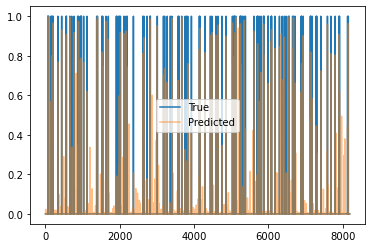

Train Epoch: 12 [310/2220 (13%)]	Loss: 0.012533	Pres: 0.004395	F1 Score: 0.004395
Train Epoch: 12 [320/2220 (14%)]	Loss: 0.016813	Pres: 0.003174	F1 Score: 0.003174
Train Epoch: 12 [330/2220 (14%)]	Loss: 0.012301	Pres: 0.003662	F1 Score: 0.003662
Train Epoch: 12 [340/2220 (15%)]	Loss: 0.014104	Pres: 0.003052	F1 Score: 0.003052
Train Epoch: 12 [350/2220 (15%)]	Loss: 0.016876	Pres: 0.005127	F1 Score: 0.005127
Train Epoch: 12 [360/2220 (16%)]	Loss: 0.012999	Pres: 0.003540	F1 Score: 0.003540
Train Epoch: 12 [370/2220 (16%)]	Loss: 0.015595	Pres: 0.003174	F1 Score: 0.003174
Train Epoch: 12 [380/2220 (17%)]	Loss: 0.011212	Pres: 0.003418	F1 Score: 0.003418
Train Epoch: 12 [390/2220 (17%)]	Loss: 0.015553	Pres: 0.005005	F1 Score: 0.005005
Train Epoch: 12 [400/2220 (18%)]	Loss: 0.014454	Pres: 0.003540	F1 Score: 0.003540
Train Epoch: 12 [410/2220 (18%)]	Loss: 0.020886	Pres: 0.003540	F1 Score: 0.003540
Train Epoch: 12 [420/2220 (18%)]	Loss: 0.015584	Pres: 0.004639	F1 Score: 0.004639
Train Epoch: 12 

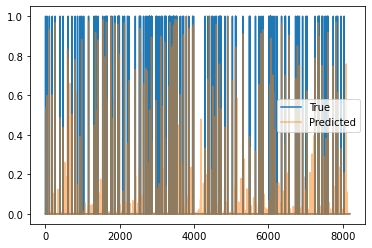

Train Epoch: 12 [610/2220 (27%)]	Loss: 0.015388	Pres: 0.003784	F1 Score: 0.003784
Train Epoch: 12 [620/2220 (27%)]	Loss: 0.015454	Pres: 0.003540	F1 Score: 0.003540
Train Epoch: 12 [630/2220 (28%)]	Loss: 0.014104	Pres: 0.004272	F1 Score: 0.004272
Train Epoch: 12 [640/2220 (28%)]	Loss: 0.015682	Pres: 0.004150	F1 Score: 0.004150
Train Epoch: 12 [650/2220 (29%)]	Loss: 0.018597	Pres: 0.003784	F1 Score: 0.003784
Train Epoch: 12 [660/2220 (29%)]	Loss: 0.020319	Pres: 0.004517	F1 Score: 0.004517
Train Epoch: 12 [670/2220 (30%)]	Loss: 0.033136	Pres: 0.001831	F1 Score: 0.001831
Train Epoch: 12 [680/2220 (30%)]	Loss: 0.014814	Pres: 0.004272	F1 Score: 0.004272
Train Epoch: 12 [690/2220 (31%)]	Loss: 0.013865	Pres: 0.004150	F1 Score: 0.004150
Train Epoch: 12 [700/2220 (31%)]	Loss: 0.017801	Pres: 0.003906	F1 Score: 0.003906
Train Epoch: 12 [710/2220 (31%)]	Loss: 0.016996	Pres: 0.004150	F1 Score: 0.004150
Train Epoch: 12 [720/2220 (32%)]	Loss: 0.014225	Pres: 0.004150	F1 Score: 0.004150
Train Epoch: 12 

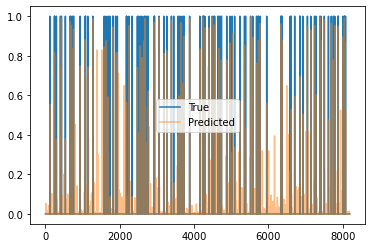

Train Epoch: 12 [910/2220 (40%)]	Loss: 0.017349	Pres: 0.006348	F1 Score: 0.006348
Train Epoch: 12 [920/2220 (41%)]	Loss: 0.016126	Pres: 0.004395	F1 Score: 0.004395
Train Epoch: 12 [930/2220 (41%)]	Loss: 0.017528	Pres: 0.004883	F1 Score: 0.004883
Train Epoch: 12 [940/2220 (42%)]	Loss: 0.017641	Pres: 0.004395	F1 Score: 0.004395
Train Epoch: 12 [950/2220 (42%)]	Loss: 0.074560	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [960/2220 (43%)]	Loss: 0.017566	Pres: 0.003662	F1 Score: 0.003662
Train Epoch: 12 [970/2220 (43%)]	Loss: 0.019325	Pres: 0.005249	F1 Score: 0.005249
Train Epoch: 12 [980/2220 (44%)]	Loss: 0.019243	Pres: 0.004028	F1 Score: 0.004028
Train Epoch: 12 [990/2220 (44%)]	Loss: 0.019125	Pres: 0.004639	F1 Score: 0.004639
Train Epoch: 12 [1000/2220 (45%)]	Loss: 0.017246	Pres: 0.005249	F1 Score: 0.005249
Train Epoch: 12 [1010/2220 (45%)]	Loss: 0.016969	Pres: 0.003296	F1 Score: 0.003296
Train Epoch: 12 [1020/2220 (45%)]	Loss: 0.021171	Pres: 0.004272	F1 Score: 0.004272
Train Epoch: 

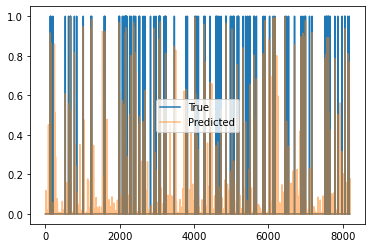

Train Epoch: 12 [1210/2220 (54%)]	Loss: 0.024466	Pres: 0.004395	F1 Score: 0.004395
Train Epoch: 12 [1220/2220 (54%)]	Loss: 0.017602	Pres: 0.004150	F1 Score: 0.004150
Train Epoch: 12 [1230/2220 (55%)]	Loss: 0.019213	Pres: 0.004272	F1 Score: 0.004272
Train Epoch: 12 [1240/2220 (55%)]	Loss: 0.024988	Pres: 0.005615	F1 Score: 0.005615
Train Epoch: 12 [1250/2220 (56%)]	Loss: 0.021813	Pres: 0.002808	F1 Score: 0.002808
Train Epoch: 12 [1260/2220 (56%)]	Loss: 0.022438	Pres: 0.005005	F1 Score: 0.005005
Train Epoch: 12 [1270/2220 (57%)]	Loss: 0.020700	Pres: 0.004517	F1 Score: 0.004517
Train Epoch: 12 [1280/2220 (57%)]	Loss: 0.020071	Pres: 0.004883	F1 Score: 0.004883
Train Epoch: 12 [1290/2220 (58%)]	Loss: 0.020647	Pres: 0.004761	F1 Score: 0.004761
Train Epoch: 12 [1300/2220 (58%)]	Loss: 0.021219	Pres: 0.004150	F1 Score: 0.004150
Train Epoch: 12 [1310/2220 (59%)]	Loss: 0.057941	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [1320/2220 (59%)]	Loss: 0.023713	Pres: 0.005493	F1 Score: 0.005493
Trai

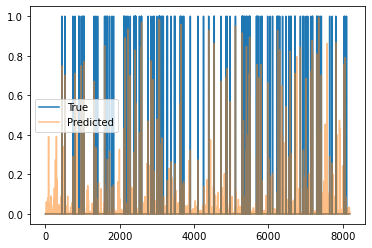

Train Epoch: 12 [1510/2220 (68%)]	Loss: 0.026807	Pres: 0.004517	F1 Score: 0.004517
Train Epoch: 12 [1520/2220 (68%)]	Loss: 0.024307	Pres: 0.003418	F1 Score: 0.003418
Train Epoch: 12 [1530/2220 (68%)]	Loss: 0.026702	Pres: 0.003418	F1 Score: 0.003418
Train Epoch: 12 [1540/2220 (69%)]	Loss: 0.026931	Pres: 0.004639	F1 Score: 0.004639
Train Epoch: 12 [1550/2220 (69%)]	Loss: 0.025393	Pres: 0.004761	F1 Score: 0.004761
Train Epoch: 12 [1560/2220 (70%)]	Loss: 0.027265	Pres: 0.003418	F1 Score: 0.003418
Train Epoch: 12 [1570/2220 (70%)]	Loss: 0.029437	Pres: 0.004150	F1 Score: 0.004150
Train Epoch: 12 [1580/2220 (71%)]	Loss: 0.027631	Pres: 0.004883	F1 Score: 0.004883
Train Epoch: 12 [1590/2220 (71%)]	Loss: 0.024310	Pres: 0.004150	F1 Score: 0.004150
Train Epoch: 12 [1600/2220 (72%)]	Loss: 0.024572	Pres: 0.004150	F1 Score: 0.004150
Train Epoch: 12 [1610/2220 (72%)]	Loss: 0.024071	Pres: 0.004517	F1 Score: 0.004517
Train Epoch: 12 [1620/2220 (72%)]	Loss: 0.025901	Pres: 0.005249	F1 Score: 0.005249
Trai

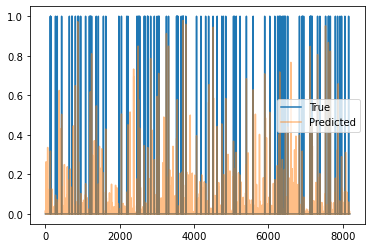

Train Epoch: 12 [1810/2220 (81%)]	Loss: 0.032754	Pres: 0.003784	F1 Score: 0.003784
Train Epoch: 12 [1820/2220 (81%)]	Loss: 0.035206	Pres: 0.003662	F1 Score: 0.003662
Train Epoch: 12 [1830/2220 (82%)]	Loss: 0.031965	Pres: 0.003296	F1 Score: 0.003296
Train Epoch: 12 [1840/2220 (82%)]	Loss: 0.040368	Pres: 0.005859	F1 Score: 0.005859
Train Epoch: 12 [1850/2220 (83%)]	Loss: 0.036109	Pres: 0.003052	F1 Score: 0.003052
Train Epoch: 12 [1860/2220 (83%)]	Loss: 0.043287	Pres: 0.003784	F1 Score: 0.003784
Train Epoch: 12 [1870/2220 (84%)]	Loss: 0.038027	Pres: 0.002563	F1 Score: 0.002563
Train Epoch: 12 [1880/2220 (84%)]	Loss: 0.042778	Pres: 0.003174	F1 Score: 0.003174
Train Epoch: 12 [1890/2220 (85%)]	Loss: 0.047640	Pres: 0.004272	F1 Score: 0.004272
Train Epoch: 12 [1900/2220 (85%)]	Loss: 0.041375	Pres: 0.002563	F1 Score: 0.002563
Train Epoch: 12 [1910/2220 (86%)]	Loss: 0.049287	Pres: 0.004639	F1 Score: 0.004639
Train Epoch: 12 [1920/2220 (86%)]	Loss: 0.040851	Pres: 0.001709	F1 Score: 0.001709
Trai

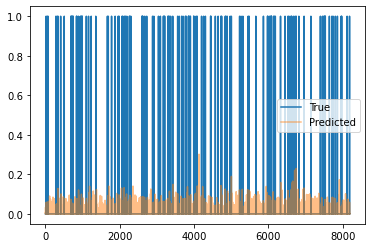

Train Epoch: 12 [2110/2220 (95%)]	Loss: 0.062290	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [2120/2220 (95%)]	Loss: 0.072059	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [2130/2220 (95%)]	Loss: 0.056035	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 12 [2140/2220 (96%)]	Loss: 0.065726	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 12 [2150/2220 (96%)]	Loss: 0.065969	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [2160/2220 (97%)]	Loss: 0.064617	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [2170/2220 (97%)]	Loss: 0.062877	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [2180/2220 (98%)]	Loss: 0.058569	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [2190/2220 (98%)]	Loss: 0.062840	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [2200/2220 (99%)]	Loss: 0.067735	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [2210/2220 (99%)]	Loss: 0.065140	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 12 [0/582 (0%)]	Loss: 0.065810	Pres: 0.000000	F1 Score: 0.000000


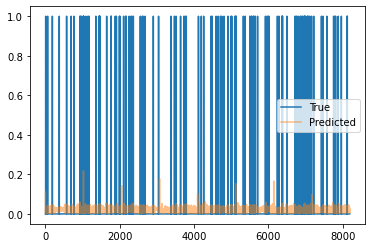

Validation Epoch: 12 [10/582 (1%)]	Loss: 0.060003	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 12 [20/582 (3%)]	Loss: 0.062474	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 12 [30/582 (5%)]	Loss: 0.056494	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 12 [40/582 (6%)]	Loss: 0.060279	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 12 [50/582 (8%)]	Loss: 0.063482	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 12 [60/582 (10%)]	Loss: 0.061720	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 12 [70/582 (12%)]	Loss: 0.063921	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 12 [80/582 (13%)]	Loss: 0.070455	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 12 [90/582 (15%)]	Loss: 0.057216	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 12 [100/582 (17%)]	Loss: 0.059728	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 12 [110/582 (18%)]	Loss: 0.061495	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 12 [120/582 (20%)]	Loss: 0.063260	Pres: 0.000000	F

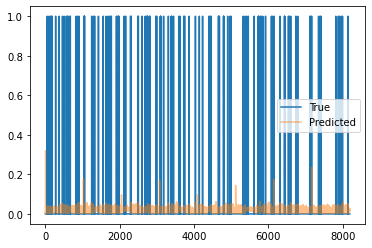

Validation Epoch: 12 [310/582 (53%)]	Loss: 0.059661	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 12 [320/582 (54%)]	Loss: 0.063026	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 12 [330/582 (56%)]	Loss: 0.065900	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 12 [340/582 (58%)]	Loss: 0.062712	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 12 [350/582 (60%)]	Loss: 0.067601	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 12 [360/582 (61%)]	Loss: 0.056659	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 12 [370/582 (63%)]	Loss: 0.065696	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 12 [380/582 (65%)]	Loss: 0.062754	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 12 [390/582 (67%)]	Loss: 0.061469	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 12 [400/582 (68%)]	Loss: 0.065145	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 12 [410/582 (70%)]	Loss: 0.062556	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 12 [420/582 (72%)]	Loss: 0.064241	Pr

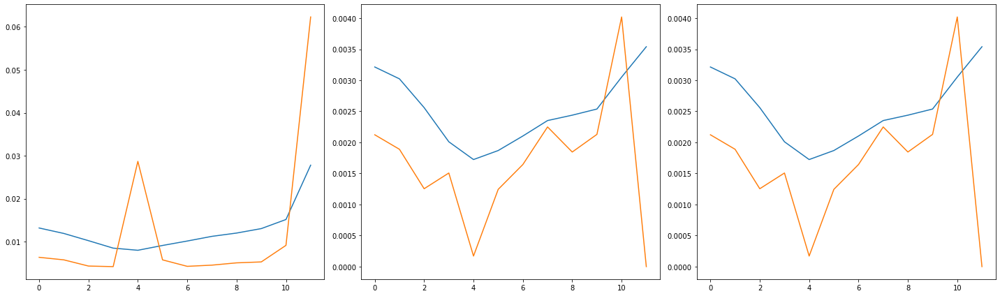

2220 582
Train Epoch: 13 [0/2220 (0%)]	Loss: 0.069420	Pres: 0.000000	F1 Score: 0.000000
106.0 -40256.0


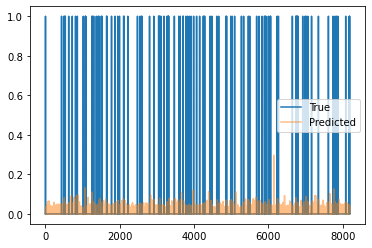

Train Epoch: 13 [10/2220 (0%)]	Loss: 0.057314	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 13 [20/2220 (0%)]	Loss: 0.065177	Pres: 0.000610	F1 Score: 0.000610
Train Epoch: 13 [30/2220 (1%)]	Loss: 0.059894	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [40/2220 (1%)]	Loss: 0.064577	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [50/2220 (2%)]	Loss: 0.063225	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [60/2220 (2%)]	Loss: 0.062272	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [70/2220 (3%)]	Loss: 0.072542	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [80/2220 (3%)]	Loss: 0.068754	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [90/2220 (4%)]	Loss: 0.072392	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [100/2220 (4%)]	Loss: 0.066884	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [110/2220 (4%)]	Loss: 0.070582	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [120/2220 (5%)]	Loss: 0.065463	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [130/2220 (5%)]	Loss:

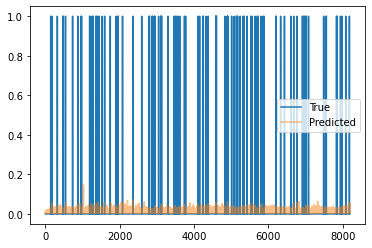

Train Epoch: 13 [310/2220 (13%)]	Loss: 0.071089	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [320/2220 (14%)]	Loss: 0.069324	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [330/2220 (14%)]	Loss: 0.069877	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [340/2220 (15%)]	Loss: 0.067430	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [350/2220 (15%)]	Loss: 0.062985	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [360/2220 (16%)]	Loss: 0.065926	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [370/2220 (16%)]	Loss: 0.069631	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [380/2220 (17%)]	Loss: 0.070442	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [390/2220 (17%)]	Loss: 0.065454	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [400/2220 (18%)]	Loss: 0.060099	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [410/2220 (18%)]	Loss: 0.079140	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [420/2220 (18%)]	Loss: 0.061271	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 

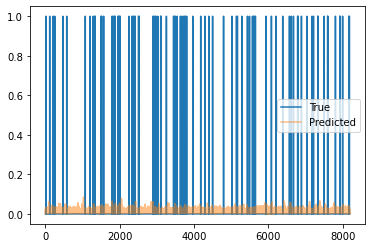

Train Epoch: 13 [610/2220 (27%)]	Loss: 0.049774	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 13 [620/2220 (27%)]	Loss: 0.068719	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [630/2220 (28%)]	Loss: 0.053951	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [640/2220 (28%)]	Loss: 0.074128	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [650/2220 (29%)]	Loss: 0.065336	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [660/2220 (29%)]	Loss: 0.060430	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [670/2220 (30%)]	Loss: 0.067168	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [680/2220 (30%)]	Loss: 0.071195	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [690/2220 (31%)]	Loss: 0.063718	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [700/2220 (31%)]	Loss: 0.062623	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [710/2220 (31%)]	Loss: 0.069345	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [720/2220 (32%)]	Loss: 0.065886	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 

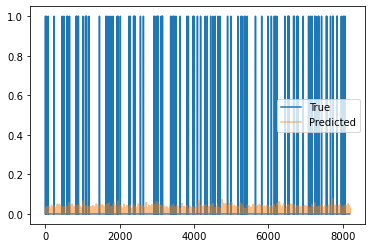

Train Epoch: 13 [910/2220 (40%)]	Loss: 0.058733	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [920/2220 (41%)]	Loss: 0.063580	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [930/2220 (41%)]	Loss: 0.068888	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [940/2220 (42%)]	Loss: 0.070042	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [950/2220 (42%)]	Loss: 0.063858	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [960/2220 (43%)]	Loss: 0.068595	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [970/2220 (43%)]	Loss: 0.065807	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [980/2220 (44%)]	Loss: 0.065923	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [990/2220 (44%)]	Loss: 0.066893	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1000/2220 (45%)]	Loss: 0.072116	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1010/2220 (45%)]	Loss: 0.071623	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1020/2220 (45%)]	Loss: 0.066546	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 

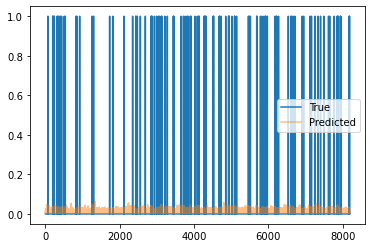

Train Epoch: 13 [1210/2220 (54%)]	Loss: 0.074585	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1220/2220 (54%)]	Loss: 0.076779	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1230/2220 (55%)]	Loss: 0.075284	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1240/2220 (55%)]	Loss: 0.066986	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1250/2220 (56%)]	Loss: 0.064063	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1260/2220 (56%)]	Loss: 0.065946	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1270/2220 (57%)]	Loss: 0.065168	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1280/2220 (57%)]	Loss: 0.064561	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1290/2220 (58%)]	Loss: 0.061349	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1300/2220 (58%)]	Loss: 0.069898	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1310/2220 (59%)]	Loss: 0.063894	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1320/2220 (59%)]	Loss: 0.068310	Pres: 0.000000	F1 Score: 0.000000
Trai

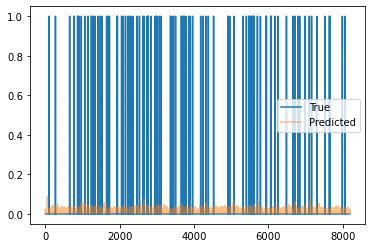

Train Epoch: 13 [1510/2220 (68%)]	Loss: 0.059577	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1520/2220 (68%)]	Loss: 0.069698	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1530/2220 (68%)]	Loss: 0.064068	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1540/2220 (69%)]	Loss: 0.078713	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1550/2220 (69%)]	Loss: 0.060498	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1560/2220 (70%)]	Loss: 0.066858	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1570/2220 (70%)]	Loss: 0.060252	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1580/2220 (71%)]	Loss: 0.062894	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1590/2220 (71%)]	Loss: 0.068263	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1600/2220 (72%)]	Loss: 0.069633	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1610/2220 (72%)]	Loss: 0.073325	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1620/2220 (72%)]	Loss: 0.068454	Pres: 0.000000	F1 Score: 0.000000
Trai

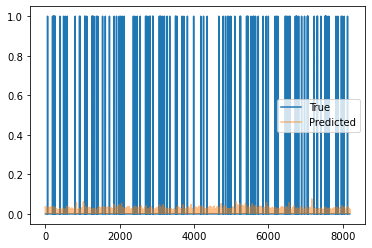

Train Epoch: 13 [1810/2220 (81%)]	Loss: 0.065841	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1820/2220 (81%)]	Loss: 0.073501	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1830/2220 (82%)]	Loss: 0.074333	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1840/2220 (82%)]	Loss: 0.072767	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1850/2220 (83%)]	Loss: 0.064764	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1860/2220 (83%)]	Loss: 0.061365	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1870/2220 (84%)]	Loss: 0.066388	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1880/2220 (84%)]	Loss: 0.068171	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1890/2220 (85%)]	Loss: 0.066092	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1900/2220 (85%)]	Loss: 0.070989	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1910/2220 (86%)]	Loss: 0.058482	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1920/2220 (86%)]	Loss: 0.062837	Pres: 0.000000	F1 Score: 0.000000
Trai

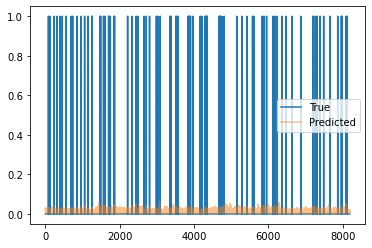

Train Epoch: 13 [2110/2220 (95%)]	Loss: 0.067077	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [2120/2220 (95%)]	Loss: 0.075633	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [2130/2220 (95%)]	Loss: 0.066736	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [2140/2220 (96%)]	Loss: 0.064048	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [2150/2220 (96%)]	Loss: 0.067658	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [2160/2220 (97%)]	Loss: 0.068756	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [2170/2220 (97%)]	Loss: 0.069244	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [2180/2220 (98%)]	Loss: 0.069286	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [2190/2220 (98%)]	Loss: 0.066652	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [2200/2220 (99%)]	Loss: 0.061242	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [2210/2220 (99%)]	Loss: 0.067881	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 13 [0/582 (0%)]	Loss: 0.057273	Pres: 0.000000	F1 Score: 0.000000


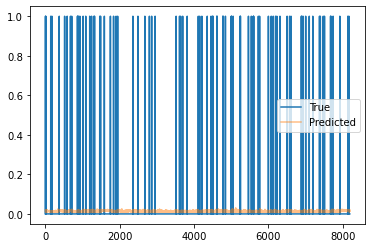

Validation Epoch: 13 [10/582 (1%)]	Loss: 0.058592	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 13 [20/582 (3%)]	Loss: 0.062638	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 13 [30/582 (5%)]	Loss: 0.075940	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 13 [40/582 (6%)]	Loss: 0.059544	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 13 [50/582 (8%)]	Loss: 0.071276	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 13 [60/582 (10%)]	Loss: 0.066792	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 13 [70/582 (12%)]	Loss: 0.063859	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 13 [80/582 (13%)]	Loss: 0.063882	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 13 [90/582 (15%)]	Loss: 0.070281	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 13 [100/582 (17%)]	Loss: 0.069952	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 13 [110/582 (18%)]	Loss: 0.064559	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 13 [120/582 (20%)]	Loss: 0.063395	Pres: 0.000000	F

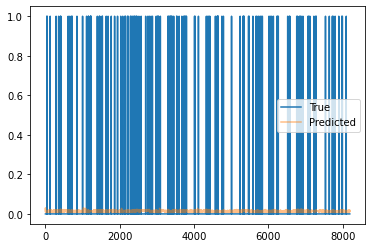

Validation Epoch: 13 [310/582 (53%)]	Loss: 0.062534	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 13 [320/582 (54%)]	Loss: 0.064176	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 13 [330/582 (56%)]	Loss: 0.061683	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 13 [340/582 (58%)]	Loss: 0.068690	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 13 [350/582 (60%)]	Loss: 0.061329	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 13 [360/582 (61%)]	Loss: 0.068343	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 13 [370/582 (63%)]	Loss: 0.071017	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 13 [380/582 (65%)]	Loss: 0.070717	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 13 [390/582 (67%)]	Loss: 0.065812	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 13 [400/582 (68%)]	Loss: 0.082596	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 13 [410/582 (70%)]	Loss: 0.072498	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 13 [420/582 (72%)]	Loss: 0.065350	Pr

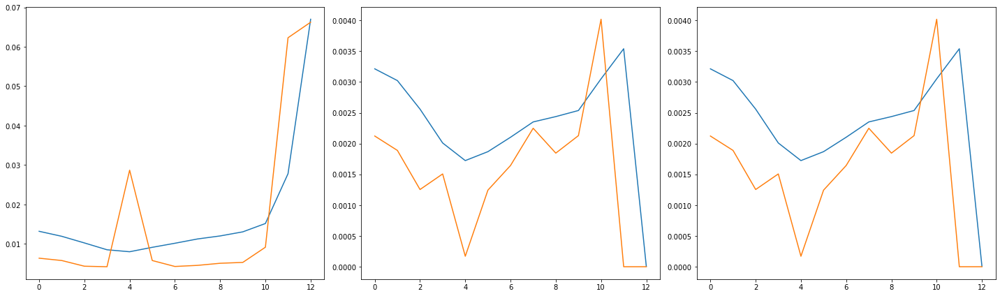

2220 582
Train Epoch: 14 [0/2220 (0%)]	Loss: 0.066218	Pres: 0.000000	F1 Score: 0.000000
100.0 -36128.0


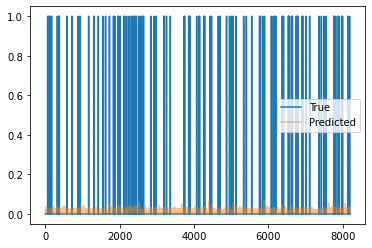

Train Epoch: 14 [10/2220 (0%)]	Loss: 0.072537	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [20/2220 (0%)]	Loss: 0.068432	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [30/2220 (1%)]	Loss: 0.074988	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [40/2220 (1%)]	Loss: 0.071857	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [50/2220 (2%)]	Loss: 0.068044	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [60/2220 (2%)]	Loss: 0.065304	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [70/2220 (3%)]	Loss: 0.064984	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [80/2220 (3%)]	Loss: 0.072500	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [90/2220 (4%)]	Loss: 0.055607	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [100/2220 (4%)]	Loss: 0.076934	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [110/2220 (4%)]	Loss: 0.067258	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [120/2220 (5%)]	Loss: 0.066916	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [130/2220 (5%)]	Loss:

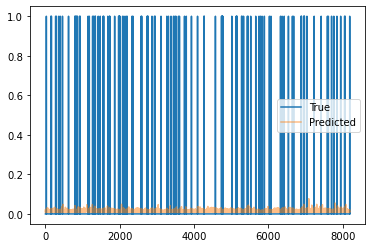

Train Epoch: 14 [310/2220 (13%)]	Loss: 0.065397	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [320/2220 (14%)]	Loss: 0.062415	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [330/2220 (14%)]	Loss: 0.067168	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [340/2220 (15%)]	Loss: 0.068070	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [350/2220 (15%)]	Loss: 0.069868	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [360/2220 (16%)]	Loss: 0.066290	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [370/2220 (16%)]	Loss: 0.066257	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [380/2220 (17%)]	Loss: 0.068909	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [390/2220 (17%)]	Loss: 0.065527	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [400/2220 (18%)]	Loss: 0.070346	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [410/2220 (18%)]	Loss: 0.073900	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [420/2220 (18%)]	Loss: 0.070383	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 

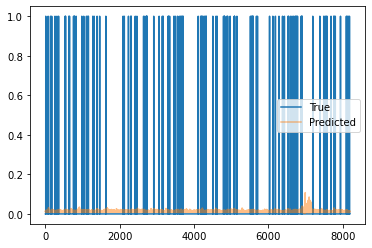

Train Epoch: 14 [610/2220 (27%)]	Loss: 0.060853	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [620/2220 (27%)]	Loss: 0.066925	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [630/2220 (28%)]	Loss: 0.065955	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [640/2220 (28%)]	Loss: 0.068919	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [650/2220 (29%)]	Loss: 0.072868	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [660/2220 (29%)]	Loss: 0.068500	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [670/2220 (30%)]	Loss: 0.072202	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [680/2220 (30%)]	Loss: 0.062372	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [690/2220 (31%)]	Loss: 0.072671	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [700/2220 (31%)]	Loss: 0.065115	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [710/2220 (31%)]	Loss: 0.072433	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [720/2220 (32%)]	Loss: 0.052145	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 

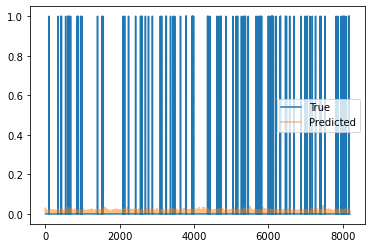

Train Epoch: 14 [910/2220 (40%)]	Loss: 0.073712	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [920/2220 (41%)]	Loss: 0.067115	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [930/2220 (41%)]	Loss: 0.076882	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [940/2220 (42%)]	Loss: 0.065750	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [950/2220 (42%)]	Loss: 0.060364	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [960/2220 (43%)]	Loss: 0.064459	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [970/2220 (43%)]	Loss: 0.073165	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [980/2220 (44%)]	Loss: 0.069174	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [990/2220 (44%)]	Loss: 0.072941	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1000/2220 (45%)]	Loss: 0.070077	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1010/2220 (45%)]	Loss: 0.064789	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1020/2220 (45%)]	Loss: 0.062956	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 

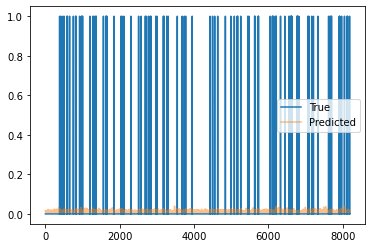

Train Epoch: 14 [1210/2220 (54%)]	Loss: 0.073631	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1220/2220 (54%)]	Loss: 0.075156	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1230/2220 (55%)]	Loss: 0.069194	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1240/2220 (55%)]	Loss: 0.063869	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1250/2220 (56%)]	Loss: 0.067551	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1260/2220 (56%)]	Loss: 0.064077	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1270/2220 (57%)]	Loss: 0.070864	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1280/2220 (57%)]	Loss: 0.067057	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1290/2220 (58%)]	Loss: 0.072868	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1300/2220 (58%)]	Loss: 0.071372	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1310/2220 (59%)]	Loss: 0.070304	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1320/2220 (59%)]	Loss: 0.066337	Pres: 0.000000	F1 Score: 0.000000
Trai

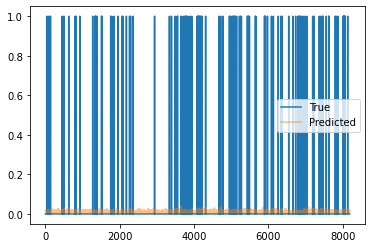

Train Epoch: 14 [1510/2220 (68%)]	Loss: 0.071402	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1520/2220 (68%)]	Loss: 0.072371	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1530/2220 (68%)]	Loss: 0.066660	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1540/2220 (69%)]	Loss: 0.068186	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1550/2220 (69%)]	Loss: 0.074585	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1560/2220 (70%)]	Loss: 0.070842	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1570/2220 (70%)]	Loss: 0.080934	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1580/2220 (71%)]	Loss: 0.077017	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1590/2220 (71%)]	Loss: 0.068213	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1600/2220 (72%)]	Loss: 0.073139	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1610/2220 (72%)]	Loss: 0.069421	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1620/2220 (72%)]	Loss: 0.073493	Pres: 0.000000	F1 Score: 0.000000
Trai

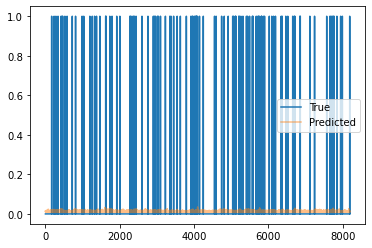

Train Epoch: 14 [1810/2220 (81%)]	Loss: 0.062550	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1820/2220 (81%)]	Loss: 0.072352	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1830/2220 (82%)]	Loss: 0.065736	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1840/2220 (82%)]	Loss: 0.072568	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1850/2220 (83%)]	Loss: 0.058510	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1860/2220 (83%)]	Loss: 0.070071	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1870/2220 (84%)]	Loss: 0.068453	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1880/2220 (84%)]	Loss: 0.067957	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1890/2220 (85%)]	Loss: 0.078602	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1900/2220 (85%)]	Loss: 0.066651	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1910/2220 (86%)]	Loss: 0.059711	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1920/2220 (86%)]	Loss: 0.066962	Pres: 0.000000	F1 Score: 0.000000
Trai

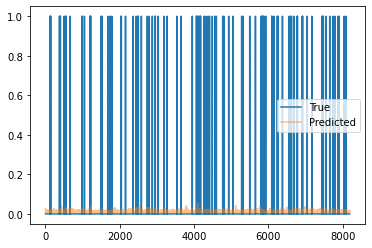

Train Epoch: 14 [2110/2220 (95%)]	Loss: 0.076518	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [2120/2220 (95%)]	Loss: 0.073976	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [2130/2220 (95%)]	Loss: 0.061891	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [2140/2220 (96%)]	Loss: 0.076608	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [2150/2220 (96%)]	Loss: 0.069190	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [2160/2220 (97%)]	Loss: 0.072804	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [2170/2220 (97%)]	Loss: 0.073837	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [2180/2220 (98%)]	Loss: 0.070180	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [2190/2220 (98%)]	Loss: 0.071057	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [2200/2220 (99%)]	Loss: 0.075590	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [2210/2220 (99%)]	Loss: 0.067551	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 14 [0/582 (0%)]	Loss: 0.067062	Pres: 0.000000	F1 Score: 0.000000


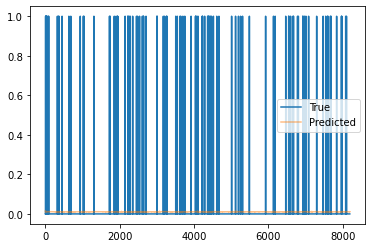

Validation Epoch: 14 [10/582 (1%)]	Loss: 0.061526	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 14 [20/582 (3%)]	Loss: 0.064379	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 14 [30/582 (5%)]	Loss: 0.061564	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 14 [40/582 (6%)]	Loss: 0.063729	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 14 [50/582 (8%)]	Loss: 0.067614	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 14 [60/582 (10%)]	Loss: 0.064890	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 14 [70/582 (12%)]	Loss: 0.059941	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 14 [80/582 (13%)]	Loss: 0.069875	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 14 [90/582 (15%)]	Loss: 0.071008	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 14 [100/582 (17%)]	Loss: 0.066531	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 14 [110/582 (18%)]	Loss: 0.067090	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 14 [120/582 (20%)]	Loss: 0.072502	Pres: 0.000000	F

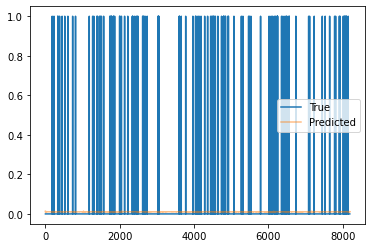

Validation Epoch: 14 [310/582 (53%)]	Loss: 0.063826	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 14 [320/582 (54%)]	Loss: 0.073103	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 14 [330/582 (56%)]	Loss: 0.062092	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 14 [340/582 (58%)]	Loss: 0.071472	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 14 [350/582 (60%)]	Loss: 0.061570	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 14 [360/582 (61%)]	Loss: 0.073720	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 14 [370/582 (63%)]	Loss: 0.067623	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 14 [380/582 (65%)]	Loss: 0.069859	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 14 [390/582 (67%)]	Loss: 0.073657	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 14 [400/582 (68%)]	Loss: 0.059361	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 14 [410/582 (70%)]	Loss: 0.068189	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 14 [420/582 (72%)]	Loss: 0.067056	Pr

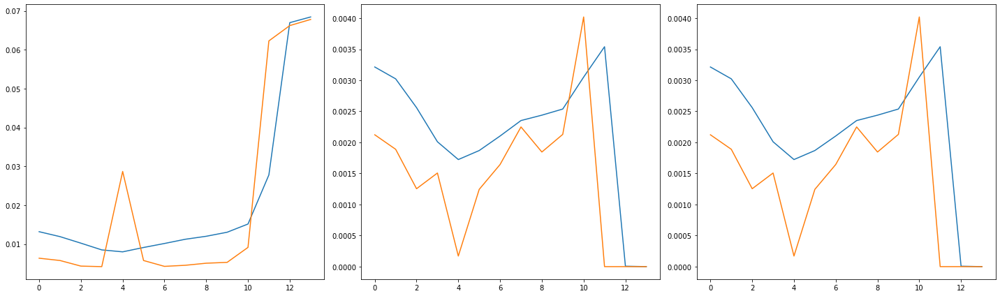

2220 582
Train Epoch: 15 [0/2220 (0%)]	Loss: 0.070008	Pres: 0.000000	F1 Score: 0.000000
108.0 -35968.0


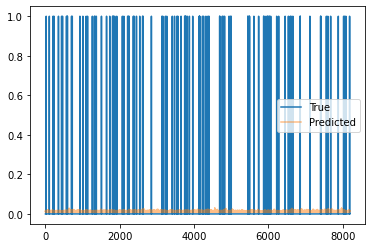

Train Epoch: 15 [10/2220 (0%)]	Loss: 0.062135	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [20/2220 (0%)]	Loss: 0.078286	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [30/2220 (1%)]	Loss: 0.058677	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [40/2220 (1%)]	Loss: 0.067165	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [50/2220 (2%)]	Loss: 0.067243	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [60/2220 (2%)]	Loss: 0.082008	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [70/2220 (3%)]	Loss: 0.056307	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [80/2220 (3%)]	Loss: 0.077412	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [90/2220 (4%)]	Loss: 0.061223	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [100/2220 (4%)]	Loss: 0.062109	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [110/2220 (4%)]	Loss: 0.062059	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [120/2220 (5%)]	Loss: 0.070361	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [130/2220 (5%)]	Loss:

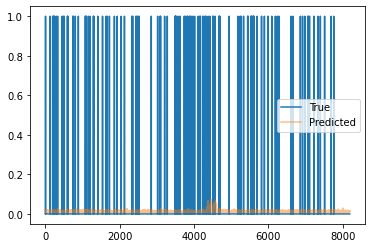

Train Epoch: 15 [310/2220 (13%)]	Loss: 0.073115	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [320/2220 (14%)]	Loss: 0.070812	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [330/2220 (14%)]	Loss: 0.067823	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [340/2220 (15%)]	Loss: 0.057187	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [350/2220 (15%)]	Loss: 0.071596	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [360/2220 (16%)]	Loss: 0.063372	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [370/2220 (16%)]	Loss: 0.064046	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [380/2220 (17%)]	Loss: 0.070032	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [390/2220 (17%)]	Loss: 0.070231	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [400/2220 (18%)]	Loss: 0.077386	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [410/2220 (18%)]	Loss: 0.071384	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [420/2220 (18%)]	Loss: 0.067160	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 

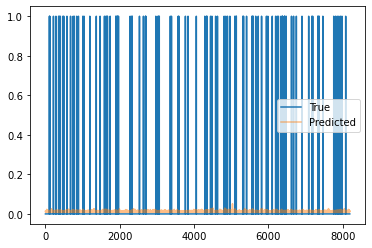

Train Epoch: 15 [610/2220 (27%)]	Loss: 0.065911	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [620/2220 (27%)]	Loss: 0.070754	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [630/2220 (28%)]	Loss: 0.067243	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [640/2220 (28%)]	Loss: 0.064506	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [650/2220 (29%)]	Loss: 0.069893	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [660/2220 (29%)]	Loss: 0.069332	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [670/2220 (30%)]	Loss: 0.071288	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [680/2220 (30%)]	Loss: 0.065157	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [690/2220 (31%)]	Loss: 0.074684	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [700/2220 (31%)]	Loss: 0.067977	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [710/2220 (31%)]	Loss: 0.070313	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [720/2220 (32%)]	Loss: 0.067962	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 

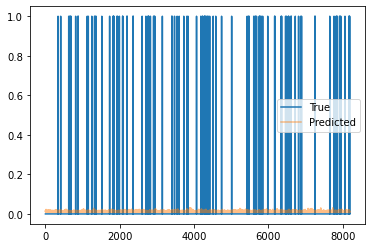

Train Epoch: 15 [910/2220 (40%)]	Loss: 0.081103	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [920/2220 (41%)]	Loss: 0.065142	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [930/2220 (41%)]	Loss: 0.071348	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [940/2220 (42%)]	Loss: 0.077267	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [950/2220 (42%)]	Loss: 0.071261	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [960/2220 (43%)]	Loss: 0.067899	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [970/2220 (43%)]	Loss: 0.065041	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [980/2220 (44%)]	Loss: 0.065481	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [990/2220 (44%)]	Loss: 0.064535	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1000/2220 (45%)]	Loss: 0.069928	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1010/2220 (45%)]	Loss: 0.066213	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1020/2220 (45%)]	Loss: 0.066789	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 

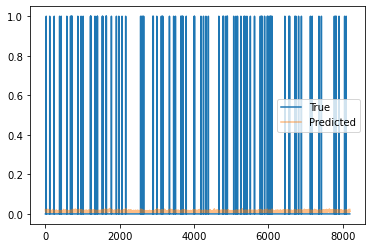

Train Epoch: 15 [1210/2220 (54%)]	Loss: 0.065540	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1220/2220 (54%)]	Loss: 0.066094	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1230/2220 (55%)]	Loss: 0.071574	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1240/2220 (55%)]	Loss: 0.065251	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1250/2220 (56%)]	Loss: 0.079918	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1260/2220 (56%)]	Loss: 0.070325	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1270/2220 (57%)]	Loss: 0.069981	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1280/2220 (57%)]	Loss: 0.065209	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1290/2220 (58%)]	Loss: 0.071462	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1300/2220 (58%)]	Loss: 0.062165	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1310/2220 (59%)]	Loss: 0.074262	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1320/2220 (59%)]	Loss: 0.069008	Pres: 0.000000	F1 Score: 0.000000
Trai

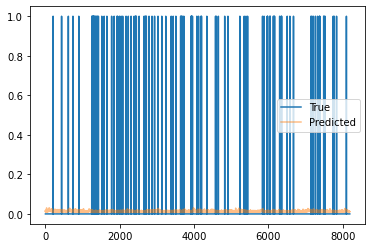

Train Epoch: 15 [1510/2220 (68%)]	Loss: 0.058005	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1520/2220 (68%)]	Loss: 0.074091	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1530/2220 (68%)]	Loss: 0.066968	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1540/2220 (69%)]	Loss: 0.067497	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1550/2220 (69%)]	Loss: 0.073343	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1560/2220 (70%)]	Loss: 0.063058	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1570/2220 (70%)]	Loss: 0.068359	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1580/2220 (71%)]	Loss: 0.071556	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1590/2220 (71%)]	Loss: 0.082093	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1600/2220 (72%)]	Loss: 0.070501	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1610/2220 (72%)]	Loss: 0.071778	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1620/2220 (72%)]	Loss: 0.062851	Pres: 0.000000	F1 Score: 0.000000
Trai

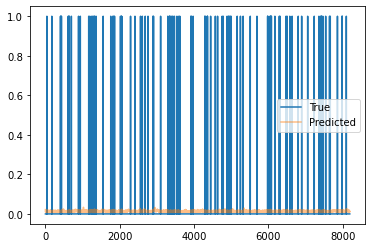

Train Epoch: 15 [1810/2220 (81%)]	Loss: 0.072880	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1820/2220 (81%)]	Loss: 0.071868	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1830/2220 (82%)]	Loss: 0.071183	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1840/2220 (82%)]	Loss: 0.065072	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1850/2220 (83%)]	Loss: 0.064421	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1860/2220 (83%)]	Loss: 0.068576	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1870/2220 (84%)]	Loss: 0.066647	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1880/2220 (84%)]	Loss: 0.071689	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1890/2220 (85%)]	Loss: 0.067197	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1900/2220 (85%)]	Loss: 0.067704	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1910/2220 (86%)]	Loss: 0.058596	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1920/2220 (86%)]	Loss: 0.066235	Pres: 0.000000	F1 Score: 0.000000
Trai

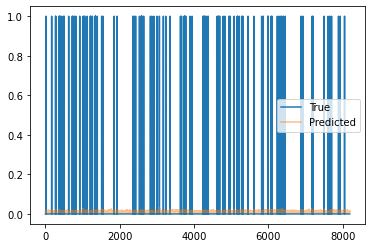

Train Epoch: 15 [2110/2220 (95%)]	Loss: 0.059642	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [2120/2220 (95%)]	Loss: 0.072433	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [2130/2220 (95%)]	Loss: 0.078253	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [2140/2220 (96%)]	Loss: 0.076203	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [2150/2220 (96%)]	Loss: 0.071790	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [2160/2220 (97%)]	Loss: 0.059036	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [2170/2220 (97%)]	Loss: 0.064854	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [2180/2220 (98%)]	Loss: 0.063577	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [2190/2220 (98%)]	Loss: 0.077642	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [2200/2220 (99%)]	Loss: 0.061489	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [2210/2220 (99%)]	Loss: 0.071208	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 15 [0/582 (0%)]	Loss: 0.067029	Pres: 0.000000	F1 Score: 0.000000


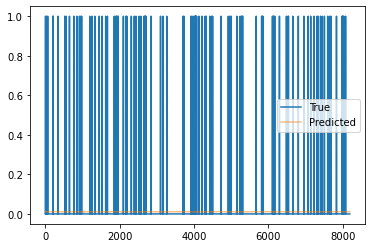

Validation Epoch: 15 [10/582 (1%)]	Loss: 0.072036	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 15 [20/582 (3%)]	Loss: 0.069284	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 15 [30/582 (5%)]	Loss: 0.057175	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 15 [40/582 (6%)]	Loss: 0.068707	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 15 [50/582 (8%)]	Loss: 0.072078	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 15 [60/582 (10%)]	Loss: 0.069235	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 15 [70/582 (12%)]	Loss: 0.083051	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 15 [80/582 (13%)]	Loss: 0.075863	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 15 [90/582 (15%)]	Loss: 0.073061	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 15 [100/582 (17%)]	Loss: 0.067045	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 15 [110/582 (18%)]	Loss: 0.067023	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 15 [120/582 (20%)]	Loss: 0.061544	Pres: 0.000000	F

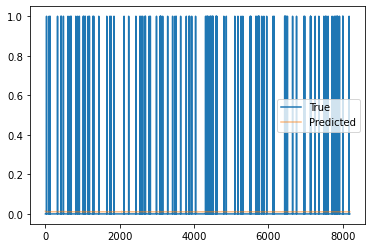

Validation Epoch: 15 [310/582 (53%)]	Loss: 0.076403	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 15 [320/582 (54%)]	Loss: 0.069279	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 15 [330/582 (56%)]	Loss: 0.068170	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 15 [340/582 (58%)]	Loss: 0.067110	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 15 [350/582 (60%)]	Loss: 0.068164	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 15 [360/582 (61%)]	Loss: 0.069269	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 15 [370/582 (63%)]	Loss: 0.067597	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 15 [380/582 (65%)]	Loss: 0.072552	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 15 [390/582 (67%)]	Loss: 0.064837	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 15 [400/582 (68%)]	Loss: 0.077491	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 15 [410/582 (70%)]	Loss: 0.069306	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 15 [420/582 (72%)]	Loss: 0.063776	Pr

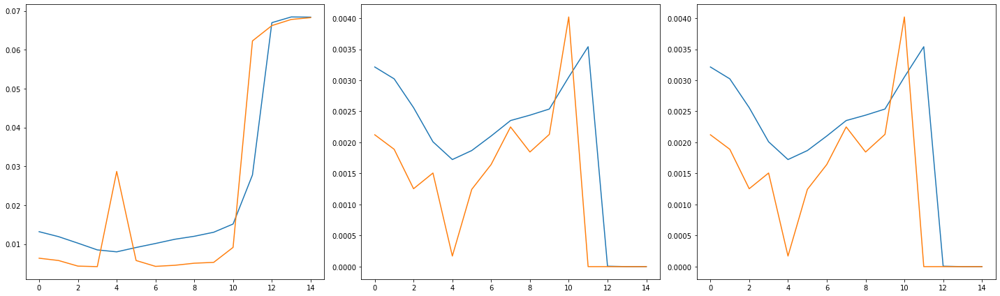

2220 582
Train Epoch: 16 [0/2220 (0%)]	Loss: 0.070797	Pres: 0.000000	F1 Score: 0.000000
109.0 -35488.0


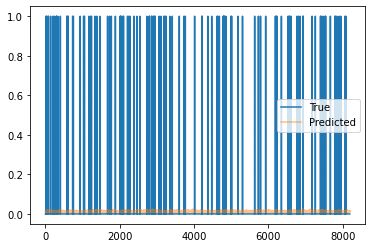

Train Epoch: 16 [10/2220 (0%)]	Loss: 0.062198	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [20/2220 (0%)]	Loss: 0.068215	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [30/2220 (1%)]	Loss: 0.081548	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [40/2220 (1%)]	Loss: 0.065768	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [50/2220 (2%)]	Loss: 0.074515	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [60/2220 (2%)]	Loss: 0.072141	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [70/2220 (3%)]	Loss: 0.062804	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [80/2220 (3%)]	Loss: 0.068922	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [90/2220 (4%)]	Loss: 0.070762	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [100/2220 (4%)]	Loss: 0.071118	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [110/2220 (4%)]	Loss: 0.067344	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [120/2220 (5%)]	Loss: 0.073127	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [130/2220 (5%)]	Loss:

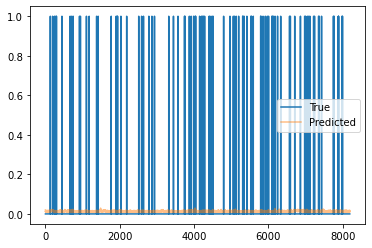

Train Epoch: 16 [310/2220 (13%)]	Loss: 0.064546	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [320/2220 (14%)]	Loss: 0.068336	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [330/2220 (14%)]	Loss: 0.063905	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [340/2220 (15%)]	Loss: 0.064560	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [350/2220 (15%)]	Loss: 0.074164	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [360/2220 (16%)]	Loss: 0.060128	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [370/2220 (16%)]	Loss: 0.064865	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [380/2220 (17%)]	Loss: 0.075223	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [390/2220 (17%)]	Loss: 0.058465	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [400/2220 (18%)]	Loss: 0.073425	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [410/2220 (18%)]	Loss: 0.074851	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [420/2220 (18%)]	Loss: 0.078829	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 

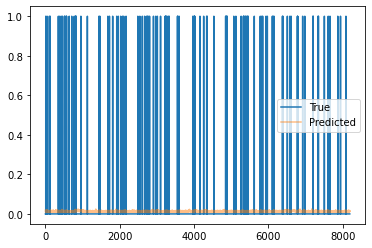

Train Epoch: 16 [610/2220 (27%)]	Loss: 0.075580	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [620/2220 (27%)]	Loss: 0.074254	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [630/2220 (28%)]	Loss: 0.057599	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [640/2220 (28%)]	Loss: 0.065666	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [650/2220 (29%)]	Loss: 0.059626	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [660/2220 (29%)]	Loss: 0.060598	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [670/2220 (30%)]	Loss: 0.073416	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [680/2220 (30%)]	Loss: 0.068406	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [690/2220 (31%)]	Loss: 0.064147	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [700/2220 (31%)]	Loss: 0.061357	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [710/2220 (31%)]	Loss: 0.065800	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [720/2220 (32%)]	Loss: 0.060386	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 

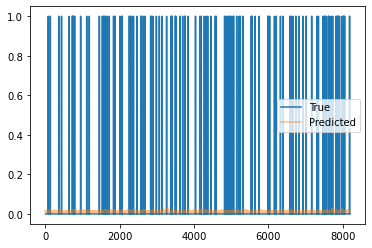

Train Epoch: 16 [910/2220 (40%)]	Loss: 0.068369	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [920/2220 (41%)]	Loss: 0.057521	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [930/2220 (41%)]	Loss: 0.076986	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [940/2220 (42%)]	Loss: 0.071802	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [950/2220 (42%)]	Loss: 0.077652	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [960/2220 (43%)]	Loss: 0.069290	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [970/2220 (43%)]	Loss: 0.066986	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [980/2220 (44%)]	Loss: 0.062290	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [990/2220 (44%)]	Loss: 0.071726	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1000/2220 (45%)]	Loss: 0.072201	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1010/2220 (45%)]	Loss: 0.061344	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1020/2220 (45%)]	Loss: 0.069891	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 

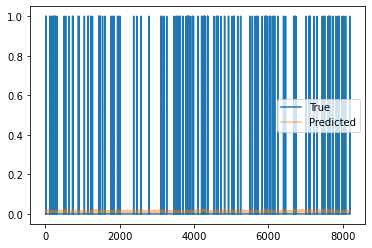

Train Epoch: 16 [1210/2220 (54%)]	Loss: 0.075161	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1220/2220 (54%)]	Loss: 0.078926	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1230/2220 (55%)]	Loss: 0.061825	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1240/2220 (55%)]	Loss: 0.066454	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1250/2220 (56%)]	Loss: 0.070484	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1260/2220 (56%)]	Loss: 0.069701	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1270/2220 (57%)]	Loss: 0.073190	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1280/2220 (57%)]	Loss: 0.069156	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1290/2220 (58%)]	Loss: 0.068724	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1300/2220 (58%)]	Loss: 0.070218	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1310/2220 (59%)]	Loss: 0.068504	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1320/2220 (59%)]	Loss: 0.067338	Pres: 0.000000	F1 Score: 0.000000
Trai

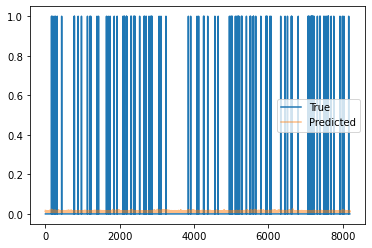

Train Epoch: 16 [1510/2220 (68%)]	Loss: 0.065135	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1520/2220 (68%)]	Loss: 0.060456	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1530/2220 (68%)]	Loss: 0.068047	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1540/2220 (69%)]	Loss: 0.071034	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1550/2220 (69%)]	Loss: 0.056819	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1560/2220 (70%)]	Loss: 0.065773	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1570/2220 (70%)]	Loss: 0.067764	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1580/2220 (71%)]	Loss: 0.068464	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1590/2220 (71%)]	Loss: 0.073925	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1600/2220 (72%)]	Loss: 0.074494	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1610/2220 (72%)]	Loss: 0.075547	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1620/2220 (72%)]	Loss: 0.062814	Pres: 0.000000	F1 Score: 0.000000
Trai

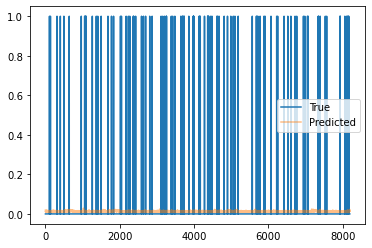

Train Epoch: 16 [1810/2220 (81%)]	Loss: 0.069205	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1820/2220 (81%)]	Loss: 0.070793	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1830/2220 (82%)]	Loss: 0.078247	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1840/2220 (82%)]	Loss: 0.078075	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1850/2220 (83%)]	Loss: 0.065935	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1860/2220 (83%)]	Loss: 0.065324	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1870/2220 (84%)]	Loss: 0.063702	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1880/2220 (84%)]	Loss: 0.065685	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1890/2220 (85%)]	Loss: 0.066532	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1900/2220 (85%)]	Loss: 0.066176	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1910/2220 (86%)]	Loss: 0.075009	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1920/2220 (86%)]	Loss: 0.068501	Pres: 0.000000	F1 Score: 0.000000
Trai

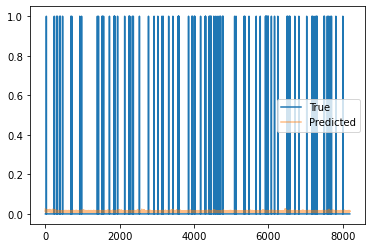

Train Epoch: 16 [2110/2220 (95%)]	Loss: 0.072035	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [2120/2220 (95%)]	Loss: 0.072942	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [2130/2220 (95%)]	Loss: 0.069072	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [2140/2220 (96%)]	Loss: 0.075253	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [2150/2220 (96%)]	Loss: 0.064866	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [2160/2220 (97%)]	Loss: 0.069130	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [2170/2220 (97%)]	Loss: 0.061905	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [2180/2220 (98%)]	Loss: 0.073178	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [2190/2220 (98%)]	Loss: 0.069529	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [2200/2220 (99%)]	Loss: 0.078921	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [2210/2220 (99%)]	Loss: 0.076525	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 16 [0/582 (0%)]	Loss: 0.067619	Pres: 0.000000	F1 Score: 0.000000


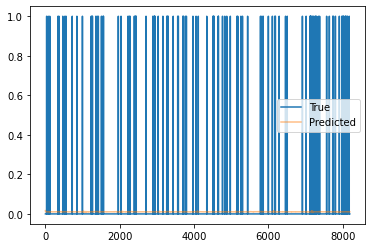

Validation Epoch: 16 [10/582 (1%)]	Loss: 0.073709	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 16 [20/582 (3%)]	Loss: 0.055493	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 16 [30/582 (5%)]	Loss: 0.069882	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 16 [40/582 (6%)]	Loss: 0.078112	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 16 [50/582 (8%)]	Loss: 0.062093	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 16 [60/582 (10%)]	Loss: 0.065433	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 16 [70/582 (12%)]	Loss: 0.074822	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 16 [80/582 (13%)]	Loss: 0.063175	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 16 [90/582 (15%)]	Loss: 0.081357	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 16 [100/582 (17%)]	Loss: 0.078211	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 16 [110/582 (18%)]	Loss: 0.062084	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 16 [120/582 (20%)]	Loss: 0.061102	Pres: 0.000000	F

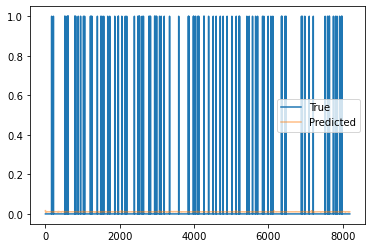

Validation Epoch: 16 [310/582 (53%)]	Loss: 0.070423	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 16 [320/582 (54%)]	Loss: 0.070976	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 16 [330/582 (56%)]	Loss: 0.066529	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 16 [340/582 (58%)]	Loss: 0.081974	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 16 [350/582 (60%)]	Loss: 0.063743	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 16 [360/582 (61%)]	Loss: 0.070366	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 16 [370/582 (63%)]	Loss: 0.069730	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 16 [380/582 (65%)]	Loss: 0.066025	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 16 [390/582 (67%)]	Loss: 0.063231	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 16 [400/582 (68%)]	Loss: 0.066998	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 16 [410/582 (70%)]	Loss: 0.069274	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 16 [420/582 (72%)]	Loss: 0.069297	Pr

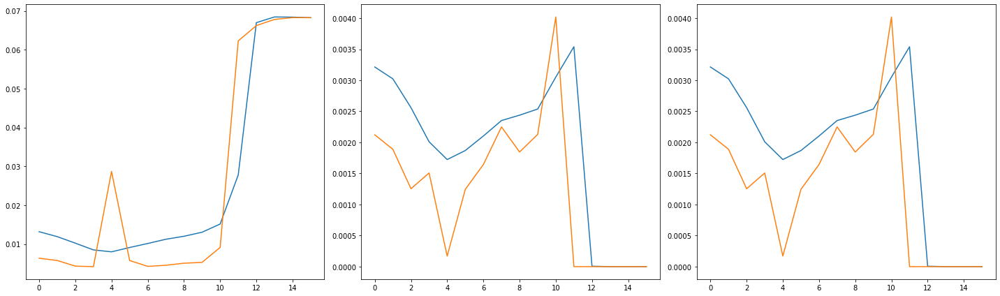

2220 582
Train Epoch: 17 [0/2220 (0%)]	Loss: 0.076026	Pres: 0.000000	F1 Score: 0.000000
119.0 -35360.0


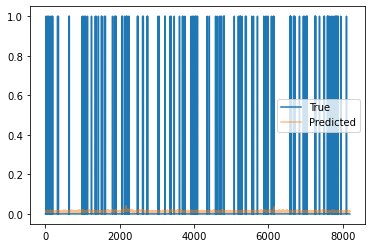

Train Epoch: 17 [10/2220 (0%)]	Loss: 0.061624	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [20/2220 (0%)]	Loss: 0.070586	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [30/2220 (1%)]	Loss: 0.068710	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [40/2220 (1%)]	Loss: 0.061026	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [50/2220 (2%)]	Loss: 0.066372	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [60/2220 (2%)]	Loss: 0.063550	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [70/2220 (3%)]	Loss: 0.073722	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [80/2220 (3%)]	Loss: 0.062001	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [90/2220 (4%)]	Loss: 0.066302	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [100/2220 (4%)]	Loss: 0.061894	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [110/2220 (4%)]	Loss: 0.065441	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [120/2220 (5%)]	Loss: 0.069689	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [130/2220 (5%)]	Loss:

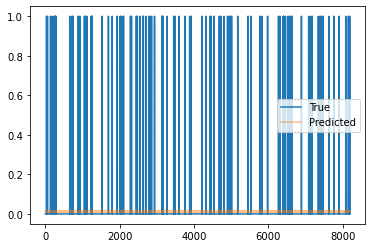

Train Epoch: 17 [310/2220 (13%)]	Loss: 0.067118	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [320/2220 (14%)]	Loss: 0.063719	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [330/2220 (14%)]	Loss: 0.068803	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [340/2220 (15%)]	Loss: 0.068045	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [350/2220 (15%)]	Loss: 0.071078	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [360/2220 (16%)]	Loss: 0.058553	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [370/2220 (16%)]	Loss: 0.066209	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [380/2220 (17%)]	Loss: 0.068227	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [390/2220 (17%)]	Loss: 0.060136	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [400/2220 (18%)]	Loss: 0.071694	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [410/2220 (18%)]	Loss: 0.059091	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [420/2220 (18%)]	Loss: 0.065069	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 

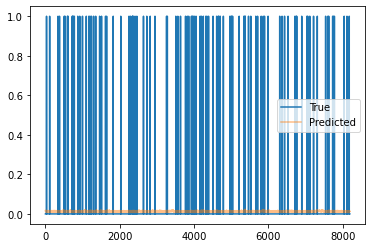

Train Epoch: 17 [610/2220 (27%)]	Loss: 0.063853	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [620/2220 (27%)]	Loss: 0.074487	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [630/2220 (28%)]	Loss: 0.062322	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [640/2220 (28%)]	Loss: 0.068851	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [650/2220 (29%)]	Loss: 0.077114	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [660/2220 (29%)]	Loss: 0.068087	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [670/2220 (30%)]	Loss: 0.072302	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [680/2220 (30%)]	Loss: 0.059882	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [690/2220 (31%)]	Loss: 0.060948	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [700/2220 (31%)]	Loss: 0.067251	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [710/2220 (31%)]	Loss: 0.072218	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [720/2220 (32%)]	Loss: 0.076498	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 

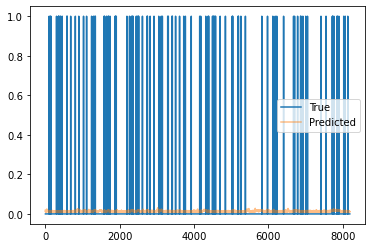

Train Epoch: 17 [910/2220 (40%)]	Loss: 0.070083	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [920/2220 (41%)]	Loss: 0.064374	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [930/2220 (41%)]	Loss: 0.067966	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [940/2220 (42%)]	Loss: 0.071163	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [950/2220 (42%)]	Loss: 0.075698	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [960/2220 (43%)]	Loss: 0.066923	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [970/2220 (43%)]	Loss: 0.074100	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [980/2220 (44%)]	Loss: 0.071286	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [990/2220 (44%)]	Loss: 0.063803	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1000/2220 (45%)]	Loss: 0.068547	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1010/2220 (45%)]	Loss: 0.067548	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1020/2220 (45%)]	Loss: 0.065981	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 

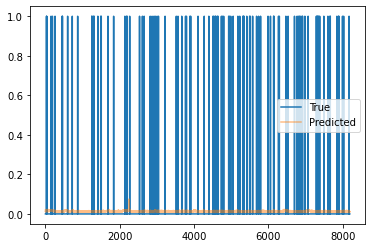

Train Epoch: 17 [1210/2220 (54%)]	Loss: 0.068157	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1220/2220 (54%)]	Loss: 0.077396	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1230/2220 (55%)]	Loss: 0.069280	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1240/2220 (55%)]	Loss: 0.068020	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1250/2220 (56%)]	Loss: 0.064322	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1260/2220 (56%)]	Loss: 0.061375	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1270/2220 (57%)]	Loss: 0.060791	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1280/2220 (57%)]	Loss: 0.070563	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1290/2220 (58%)]	Loss: 0.065686	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1300/2220 (58%)]	Loss: 0.074608	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1310/2220 (59%)]	Loss: 0.063873	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1320/2220 (59%)]	Loss: 0.063293	Pres: 0.000000	F1 Score: 0.000000
Trai

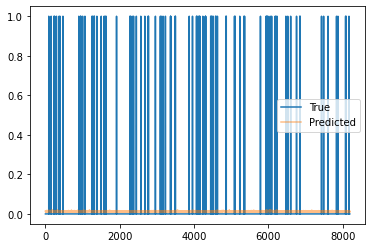

Train Epoch: 17 [1510/2220 (68%)]	Loss: 0.070852	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1520/2220 (68%)]	Loss: 0.068832	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1530/2220 (68%)]	Loss: 0.070163	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1540/2220 (69%)]	Loss: 0.074174	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1550/2220 (69%)]	Loss: 0.064250	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1560/2220 (70%)]	Loss: 0.069226	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1570/2220 (70%)]	Loss: 0.066879	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1580/2220 (71%)]	Loss: 0.068015	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1590/2220 (71%)]	Loss: 0.071150	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1600/2220 (72%)]	Loss: 0.073685	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1610/2220 (72%)]	Loss: 0.068727	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1620/2220 (72%)]	Loss: 0.068506	Pres: 0.000000	F1 Score: 0.000000
Trai

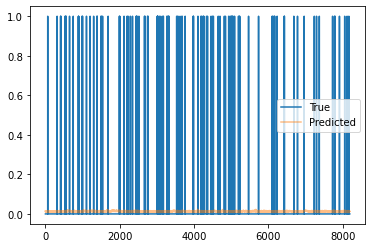

Train Epoch: 17 [1810/2220 (81%)]	Loss: 0.067212	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1820/2220 (81%)]	Loss: 0.061978	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1830/2220 (82%)]	Loss: 0.060707	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1840/2220 (82%)]	Loss: 0.067046	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1850/2220 (83%)]	Loss: 0.065370	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1860/2220 (83%)]	Loss: 0.056833	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1870/2220 (84%)]	Loss: 0.049813	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1880/2220 (84%)]	Loss: 0.060054	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1890/2220 (85%)]	Loss: 0.075548	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1900/2220 (85%)]	Loss: 0.067559	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1910/2220 (86%)]	Loss: 0.065850	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1920/2220 (86%)]	Loss: 0.069573	Pres: 0.000000	F1 Score: 0.000000
Trai

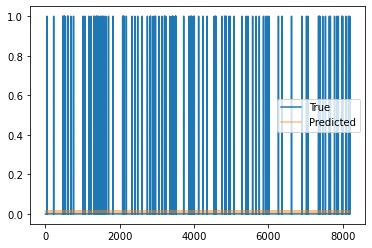

Train Epoch: 17 [2110/2220 (95%)]	Loss: 0.071915	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [2120/2220 (95%)]	Loss: 0.068876	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [2130/2220 (95%)]	Loss: 0.062723	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [2140/2220 (96%)]	Loss: 0.062892	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [2150/2220 (96%)]	Loss: 0.072997	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [2160/2220 (97%)]	Loss: 0.071132	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [2170/2220 (97%)]	Loss: 0.076049	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [2180/2220 (98%)]	Loss: 0.071271	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [2190/2220 (98%)]	Loss: 0.074635	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [2200/2220 (99%)]	Loss: 0.073825	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [2210/2220 (99%)]	Loss: 0.066935	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 17 [0/582 (0%)]	Loss: 0.068899	Pres: 0.000000	F1 Score: 0.000000


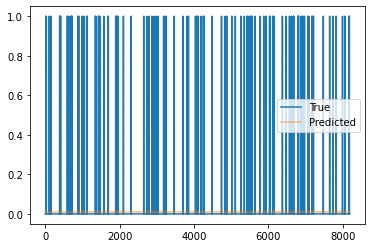

Validation Epoch: 17 [10/582 (1%)]	Loss: 0.059469	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 17 [20/582 (3%)]	Loss: 0.062119	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 17 [30/582 (5%)]	Loss: 0.065526	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 17 [40/582 (6%)]	Loss: 0.071099	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 17 [50/582 (8%)]	Loss: 0.065021	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 17 [60/582 (10%)]	Loss: 0.070019	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 17 [70/582 (12%)]	Loss: 0.077259	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 17 [80/582 (13%)]	Loss: 0.065503	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 17 [90/582 (15%)]	Loss: 0.067848	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 17 [100/582 (17%)]	Loss: 0.069939	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 17 [110/582 (18%)]	Loss: 0.068854	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 17 [120/582 (20%)]	Loss: 0.062186	Pres: 0.000000	F

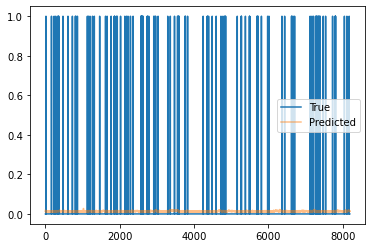

Train Epoch: 18 [910/2220 (40%)]	Loss: 0.060039	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [920/2220 (41%)]	Loss: 0.069803	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [930/2220 (41%)]	Loss: 0.068100	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [940/2220 (42%)]	Loss: 0.062271	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [950/2220 (42%)]	Loss: 0.068938	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [960/2220 (43%)]	Loss: 0.068087	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [970/2220 (43%)]	Loss: 0.065419	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [980/2220 (44%)]	Loss: 0.060113	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [990/2220 (44%)]	Loss: 0.069020	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1000/2220 (45%)]	Loss: 0.068132	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1010/2220 (45%)]	Loss: 0.074228	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1020/2220 (45%)]	Loss: 0.077781	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 

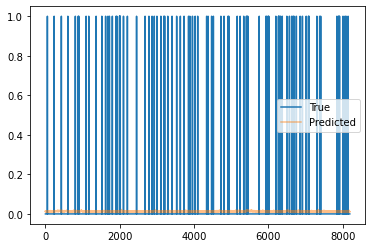

Train Epoch: 18 [1210/2220 (54%)]	Loss: 0.071740	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1220/2220 (54%)]	Loss: 0.053772	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1230/2220 (55%)]	Loss: 0.070775	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1240/2220 (55%)]	Loss: 0.072389	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1250/2220 (56%)]	Loss: 0.071986	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1260/2220 (56%)]	Loss: 0.069951	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1270/2220 (57%)]	Loss: 0.069297	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1280/2220 (57%)]	Loss: 0.074854	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1290/2220 (58%)]	Loss: 0.066207	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1300/2220 (58%)]	Loss: 0.067030	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1310/2220 (59%)]	Loss: 0.066032	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1320/2220 (59%)]	Loss: 0.072658	Pres: 0.000000	F1 Score: 0.000000
Trai

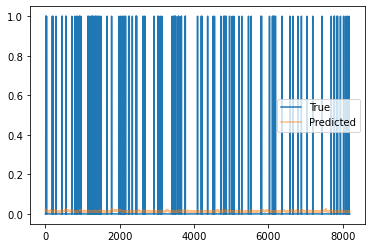

Train Epoch: 18 [1510/2220 (68%)]	Loss: 0.066861	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1520/2220 (68%)]	Loss: 0.058118	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1530/2220 (68%)]	Loss: 0.063303	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1540/2220 (69%)]	Loss: 0.076387	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1550/2220 (69%)]	Loss: 0.071180	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1560/2220 (70%)]	Loss: 0.069570	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1570/2220 (70%)]	Loss: 0.079106	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1580/2220 (71%)]	Loss: 0.066592	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1590/2220 (71%)]	Loss: 0.073162	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1600/2220 (72%)]	Loss: 0.067233	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1610/2220 (72%)]	Loss: 0.070773	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1620/2220 (72%)]	Loss: 0.064402	Pres: 0.000000	F1 Score: 0.000000
Trai

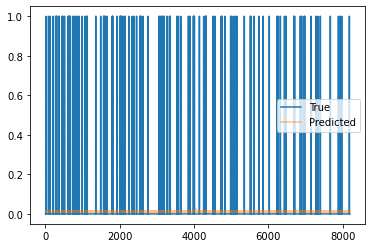

Train Epoch: 18 [1810/2220 (81%)]	Loss: 0.061937	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1820/2220 (81%)]	Loss: 0.073127	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1830/2220 (82%)]	Loss: 0.067790	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1840/2220 (82%)]	Loss: 0.069597	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1850/2220 (83%)]	Loss: 0.069806	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1860/2220 (83%)]	Loss: 0.067669	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1870/2220 (84%)]	Loss: 0.064900	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1880/2220 (84%)]	Loss: 0.080030	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1890/2220 (85%)]	Loss: 0.059654	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1900/2220 (85%)]	Loss: 0.059090	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1910/2220 (86%)]	Loss: 0.075176	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1920/2220 (86%)]	Loss: 0.077530	Pres: 0.000000	F1 Score: 0.000000
Trai

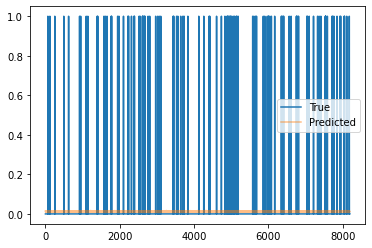

Train Epoch: 18 [2110/2220 (95%)]	Loss: 0.073156	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [2120/2220 (95%)]	Loss: 0.065895	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [2130/2220 (95%)]	Loss: 0.052608	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [2140/2220 (96%)]	Loss: 0.070164	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [2150/2220 (96%)]	Loss: 0.061223	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [2160/2220 (97%)]	Loss: 0.066869	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [2170/2220 (97%)]	Loss: 0.066323	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [2180/2220 (98%)]	Loss: 0.072191	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [2190/2220 (98%)]	Loss: 0.071335	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [2200/2220 (99%)]	Loss: 0.073450	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [2210/2220 (99%)]	Loss: 0.068479	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 18 [0/582 (0%)]	Loss: 0.063776	Pres: 0.000000	F1 Score: 0.000000


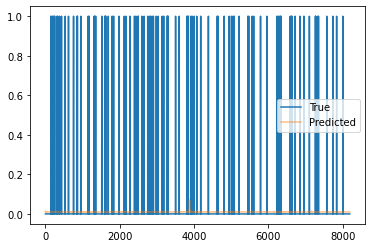

Validation Epoch: 18 [10/582 (1%)]	Loss: 0.068793	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 18 [20/582 (3%)]	Loss: 0.064926	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 18 [30/582 (5%)]	Loss: 0.073211	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 18 [40/582 (6%)]	Loss: 0.064940	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 18 [50/582 (8%)]	Loss: 0.067151	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 18 [60/582 (10%)]	Loss: 0.063325	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 18 [70/582 (12%)]	Loss: 0.071569	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 18 [80/582 (13%)]	Loss: 0.067216	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 18 [90/582 (15%)]	Loss: 0.067227	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 18 [100/582 (17%)]	Loss: 0.076625	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 18 [110/582 (18%)]	Loss: 0.064903	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 18 [120/582 (20%)]	Loss: 0.064310	Pres: 0.000000	F

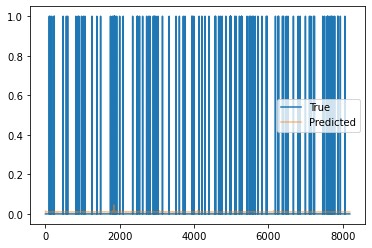

Validation Epoch: 18 [310/582 (53%)]	Loss: 0.056579	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 18 [320/582 (54%)]	Loss: 0.060387	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 18 [330/582 (56%)]	Loss: 0.057097	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 18 [340/582 (58%)]	Loss: 0.068810	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 18 [350/582 (60%)]	Loss: 0.073092	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 18 [360/582 (61%)]	Loss: 0.071119	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 18 [370/582 (63%)]	Loss: 0.064923	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 18 [380/582 (65%)]	Loss: 0.066555	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 18 [390/582 (67%)]	Loss: 0.074880	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 18 [400/582 (68%)]	Loss: 0.065349	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 18 [410/582 (70%)]	Loss: 0.068714	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 18 [420/582 (72%)]	Loss: 0.068823	Pr

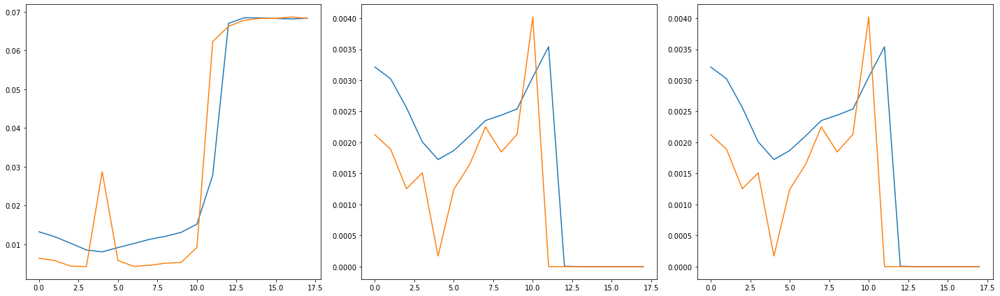

2220 582
Train Epoch: 19 [0/2220 (0%)]	Loss: 0.073835	Pres: 0.000000	F1 Score: 0.000000
115.0 -35520.0


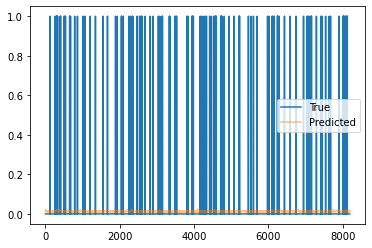

Train Epoch: 19 [10/2220 (0%)]	Loss: 0.063574	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [20/2220 (0%)]	Loss: 0.067804	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [30/2220 (1%)]	Loss: 0.067957	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [40/2220 (1%)]	Loss: 0.070660	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [50/2220 (2%)]	Loss: 0.057529	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [60/2220 (2%)]	Loss: 0.069850	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [70/2220 (3%)]	Loss: 0.069062	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [80/2220 (3%)]	Loss: 0.066822	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [90/2220 (4%)]	Loss: 0.060204	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [100/2220 (4%)]	Loss: 0.064880	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [110/2220 (4%)]	Loss: 0.067101	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [120/2220 (5%)]	Loss: 0.063873	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [130/2220 (5%)]	Loss:

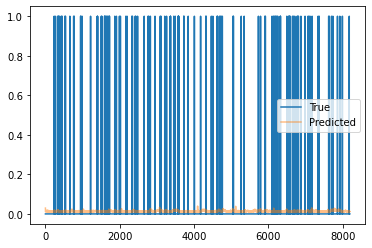

Train Epoch: 19 [310/2220 (13%)]	Loss: 0.065384	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [320/2220 (14%)]	Loss: 0.074644	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [330/2220 (14%)]	Loss: 0.068020	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [340/2220 (15%)]	Loss: 0.076150	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [350/2220 (15%)]	Loss: 0.056587	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [360/2220 (16%)]	Loss: 0.066533	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [370/2220 (16%)]	Loss: 0.066452	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [380/2220 (17%)]	Loss: 0.061148	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [390/2220 (17%)]	Loss: 0.070599	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [400/2220 (18%)]	Loss: 0.078921	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [410/2220 (18%)]	Loss: 0.063846	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [420/2220 (18%)]	Loss: 0.069496	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 

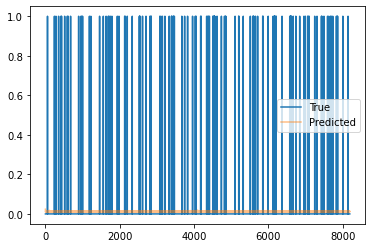

Train Epoch: 19 [610/2220 (27%)]	Loss: 0.070705	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [620/2220 (27%)]	Loss: 0.061047	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [630/2220 (28%)]	Loss: 0.069863	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [640/2220 (28%)]	Loss: 0.067523	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [650/2220 (29%)]	Loss: 0.067034	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [660/2220 (29%)]	Loss: 0.070110	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [670/2220 (30%)]	Loss: 0.064117	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [680/2220 (30%)]	Loss: 0.076441	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [690/2220 (31%)]	Loss: 0.068633	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [700/2220 (31%)]	Loss: 0.064880	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [710/2220 (31%)]	Loss: 0.069698	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [720/2220 (32%)]	Loss: 0.070330	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 

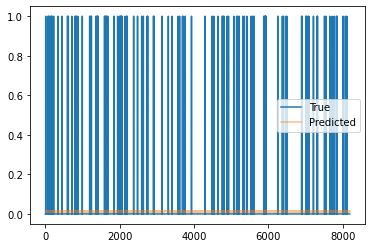

Train Epoch: 19 [910/2220 (40%)]	Loss: 0.064302	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [920/2220 (41%)]	Loss: 0.060362	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [930/2220 (41%)]	Loss: 0.069688	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [940/2220 (42%)]	Loss: 0.070239	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [950/2220 (42%)]	Loss: 0.070066	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [960/2220 (43%)]	Loss: 0.066923	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [970/2220 (43%)]	Loss: 0.075213	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [980/2220 (44%)]	Loss: 0.069163	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [990/2220 (44%)]	Loss: 0.068233	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1000/2220 (45%)]	Loss: 0.057457	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1010/2220 (45%)]	Loss: 0.068590	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1020/2220 (45%)]	Loss: 0.066463	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 

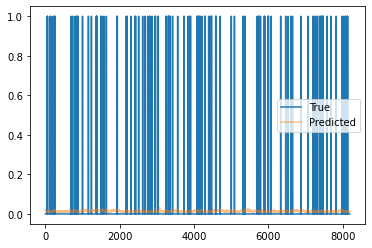

Train Epoch: 19 [1210/2220 (54%)]	Loss: 0.067587	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1220/2220 (54%)]	Loss: 0.082514	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1230/2220 (55%)]	Loss: 0.061238	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1240/2220 (55%)]	Loss: 0.070154	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1250/2220 (56%)]	Loss: 0.074379	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1260/2220 (56%)]	Loss: 0.064429	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1270/2220 (57%)]	Loss: 0.071704	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1280/2220 (57%)]	Loss: 0.078624	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1290/2220 (58%)]	Loss: 0.070602	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1300/2220 (58%)]	Loss: 0.063534	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1310/2220 (59%)]	Loss: 0.067889	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1320/2220 (59%)]	Loss: 0.073287	Pres: 0.000000	F1 Score: 0.000000
Trai

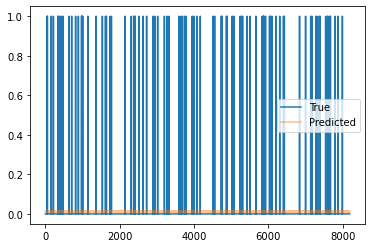

Train Epoch: 19 [1510/2220 (68%)]	Loss: 0.069706	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1520/2220 (68%)]	Loss: 0.068607	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1530/2220 (68%)]	Loss: 0.079988	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1540/2220 (69%)]	Loss: 0.070079	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1550/2220 (69%)]	Loss: 0.067037	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1560/2220 (70%)]	Loss: 0.057970	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1570/2220 (70%)]	Loss: 0.068530	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1580/2220 (71%)]	Loss: 0.070413	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1590/2220 (71%)]	Loss: 0.064416	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1600/2220 (72%)]	Loss: 0.070264	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1610/2220 (72%)]	Loss: 0.070740	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1620/2220 (72%)]	Loss: 0.074316	Pres: 0.000000	F1 Score: 0.000000
Trai

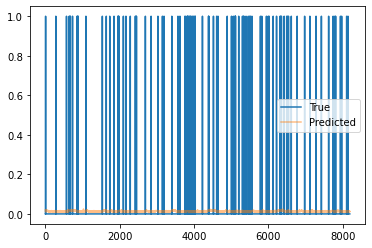

Train Epoch: 19 [1810/2220 (81%)]	Loss: 0.071897	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1820/2220 (81%)]	Loss: 0.063869	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1830/2220 (82%)]	Loss: 0.064627	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1840/2220 (82%)]	Loss: 0.064476	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1850/2220 (83%)]	Loss: 0.067548	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1860/2220 (83%)]	Loss: 0.076286	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1870/2220 (84%)]	Loss: 0.067405	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1880/2220 (84%)]	Loss: 0.064222	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1890/2220 (85%)]	Loss: 0.062647	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1900/2220 (85%)]	Loss: 0.074371	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1910/2220 (86%)]	Loss: 0.070833	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1920/2220 (86%)]	Loss: 0.075215	Pres: 0.000000	F1 Score: 0.000000
Trai

KeyboardInterrupt: 

In [11]:
# 0.2 ids, 160 dist, average='micro'
trainer.train(debug=False)

began training
2220 582
Train Epoch: 0 [0/2220 (0%)]	Loss: 0.661206	Pres: 0.992920	F1 Score: 0.496435
116.0 -548.0


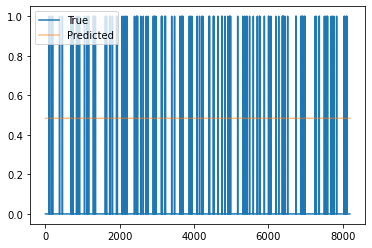

Train Epoch: 0 [10/2220 (0%)]	Loss: 0.455284	Pres: 0.197380	F1 Score: 0.102200
Train Epoch: 0 [20/2220 (0%)]	Loss: 0.441441	Pres: 0.201266	F1 Score: 0.103848
Train Epoch: 0 [30/2220 (1%)]	Loss: 0.429321	Pres: 0.164413	F1 Score: 0.081479
Train Epoch: 0 [40/2220 (1%)]	Loss: 0.411840	Pres: 0.196975	F1 Score: 0.085723
Train Epoch: 0 [50/2220 (2%)]	Loss: 0.397069	Pres: 0.163842	F1 Score: 0.063635
Train Epoch: 0 [60/2220 (2%)]	Loss: 0.387267	Pres: 0.196375	F1 Score: 0.073961
Train Epoch: 0 [70/2220 (3%)]	Loss: 0.377007	Pres: 0.185153	F1 Score: 0.055983
Train Epoch: 0 [80/2220 (3%)]	Loss: 0.361739	Pres: 0.197424	F1 Score: 0.052562
Train Epoch: 0 [90/2220 (4%)]	Loss: 0.354158	Pres: 0.197092	F1 Score: 0.052377
Train Epoch: 0 [100/2220 (4%)]	Loss: 0.343069	Pres: 0.197479	F1 Score: 0.041648
Train Epoch: 0 [110/2220 (4%)]	Loss: 0.334522	Pres: 0.196903	F1 Score: 0.039617
Train Epoch: 0 [120/2220 (5%)]	Loss: 0.323315	Pres: 0.330183	F1 Score: 0.021976
Train Epoch: 0 [130/2220 (5%)]	Loss: 0.312691	Pre

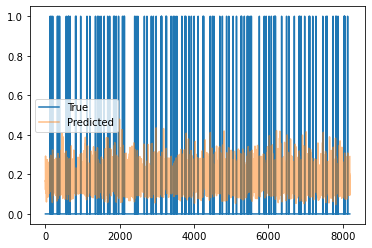

Train Epoch: 0 [310/2220 (13%)]	Loss: 0.215119	Pres: 0.400000	F1 Score: 0.000692
Train Epoch: 0 [320/2220 (14%)]	Loss: 0.208312	Pres: 0.400000	F1 Score: 0.000494
Train Epoch: 0 [330/2220 (14%)]	Loss: 0.206452	Pres: 0.333333	F1 Score: 0.000330
Train Epoch: 0 [340/2220 (15%)]	Loss: 0.200843	Pres: 0.400000	F1 Score: 0.000395
Train Epoch: 0 [350/2220 (15%)]	Loss: 0.199407	Pres: 0.400000	F1 Score: 0.000494
Train Epoch: 0 [360/2220 (16%)]	Loss: 0.194635	Pres: 0.400000	F1 Score: 0.000346
Train Epoch: 0 [370/2220 (16%)]	Loss: 0.190096	Pres: 0.400000	F1 Score: 0.000198
Train Epoch: 0 [380/2220 (17%)]	Loss: 0.187936	Pres: 0.400000	F1 Score: 0.000395
Train Epoch: 0 [390/2220 (17%)]	Loss: 0.186038	Pres: 0.333333	F1 Score: 0.000165
Train Epoch: 0 [400/2220 (18%)]	Loss: 0.182036	Pres: 0.400000	F1 Score: 0.000099
Train Epoch: 0 [410/2220 (18%)]	Loss: 0.178997	Pres: 0.400000	F1 Score: 0.000099
Train Epoch: 0 [420/2220 (18%)]	Loss: 0.174294	Pres: 0.350000	F1 Score: 0.000148
Train Epoch: 0 [430/2220 (19

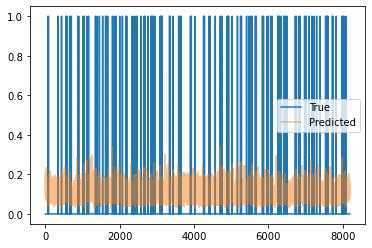

Train Epoch: 0 [610/2220 (27%)]	Loss: 0.134887	Pres: 0.333333	F1 Score: 0.000000
Train Epoch: 0 [620/2220 (27%)]	Loss: 0.133987	Pres: 0.333333	F1 Score: 0.000000
Train Epoch: 0 [630/2220 (28%)]	Loss: 0.134279	Pres: 0.333333	F1 Score: 0.000000
Train Epoch: 0 [640/2220 (28%)]	Loss: 0.129106	Pres: 0.333333	F1 Score: 0.000000
Train Epoch: 0 [650/2220 (29%)]	Loss: 0.126362	Pres: 0.333333	F1 Score: 0.000000
Train Epoch: 0 [660/2220 (29%)]	Loss: 0.128006	Pres: 0.333333	F1 Score: 0.000000
Train Epoch: 0 [670/2220 (30%)]	Loss: 0.128328	Pres: 0.333333	F1 Score: 0.000000
Train Epoch: 0 [680/2220 (30%)]	Loss: 0.127555	Pres: 0.333333	F1 Score: 0.000000
Train Epoch: 0 [690/2220 (31%)]	Loss: 0.124477	Pres: 0.333333	F1 Score: 0.000000
Train Epoch: 0 [700/2220 (31%)]	Loss: 0.124274	Pres: 0.333333	F1 Score: 0.000000
Train Epoch: 0 [710/2220 (31%)]	Loss: 0.122747	Pres: 0.333333	F1 Score: 0.000000
Train Epoch: 0 [720/2220 (32%)]	Loss: 0.119290	Pres: 0.333333	F1 Score: 0.000000
Train Epoch: 0 [730/2220 (32

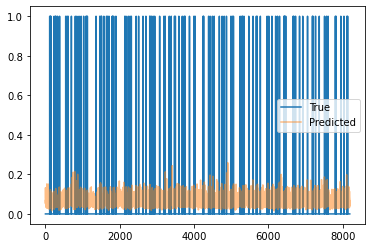

Train Epoch: 0 [910/2220 (40%)]	Loss: 0.103034	Pres: 0.333333	F1 Score: 0.000000
Train Epoch: 0 [920/2220 (41%)]	Loss: 0.102241	Pres: 0.333333	F1 Score: 0.000000
Train Epoch: 0 [930/2220 (41%)]	Loss: 0.101166	Pres: 0.285714	F1 Score: 0.000000
Train Epoch: 0 [940/2220 (42%)]	Loss: 0.103955	Pres: 0.285714	F1 Score: 0.000000
Train Epoch: 0 [950/2220 (42%)]	Loss: 0.102435	Pres: 0.333333	F1 Score: 0.000000
Train Epoch: 0 [960/2220 (43%)]	Loss: 0.098562	Pres: 0.333333	F1 Score: 0.000000
Train Epoch: 0 [970/2220 (43%)]	Loss: 0.098486	Pres: 0.333333	F1 Score: 0.000000
Train Epoch: 0 [980/2220 (44%)]	Loss: 0.099452	Pres: 0.333333	F1 Score: 0.000000
Train Epoch: 0 [990/2220 (44%)]	Loss: 0.095716	Pres: 0.333333	F1 Score: 0.000000
Train Epoch: 0 [1000/2220 (45%)]	Loss: 0.098055	Pres: 0.333333	F1 Score: 0.000000
Train Epoch: 0 [1010/2220 (45%)]	Loss: 0.095416	Pres: 0.333333	F1 Score: 0.000000
Train Epoch: 0 [1020/2220 (45%)]	Loss: 0.097068	Pres: 0.333333	F1 Score: 0.000000
Train Epoch: 0 [1030/2220

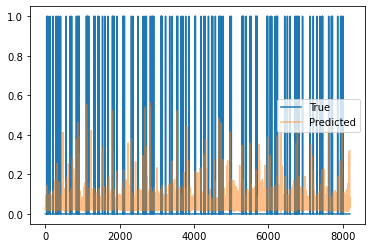

Train Epoch: 0 [1210/2220 (54%)]	Loss: 0.081669	Pres: 0.108696	F1 Score: 0.002593
Train Epoch: 0 [1220/2220 (54%)]	Loss: 0.079643	Pres: 0.216931	F1 Score: 0.008215
Train Epoch: 0 [1230/2220 (55%)]	Loss: 0.078086	Pres: 0.134259	F1 Score: 0.009743
Train Epoch: 0 [1240/2220 (55%)]	Loss: 0.079579	Pres: 0.191176	F1 Score: 0.008426
Train Epoch: 0 [1250/2220 (56%)]	Loss: 0.078924	Pres: 0.147222	F1 Score: 0.014891
Train Epoch: 0 [1260/2220 (56%)]	Loss: 0.081329	Pres: 0.176955	F1 Score: 0.008446
Train Epoch: 0 [1270/2220 (57%)]	Loss: 0.076026	Pres: 0.145833	F1 Score: 0.004834
Train Epoch: 0 [1280/2220 (57%)]	Loss: 0.072992	Pres: 0.119251	F1 Score: 0.016219
Train Epoch: 0 [1290/2220 (58%)]	Loss: 0.074443	Pres: 0.138542	F1 Score: 0.021432
Train Epoch: 0 [1300/2220 (58%)]	Loss: 0.072574	Pres: 0.106481	F1 Score: 0.009854
Train Epoch: 0 [1310/2220 (59%)]	Loss: 0.069490	Pres: 0.107937	F1 Score: 0.020946
Train Epoch: 0 [1320/2220 (59%)]	Loss: 0.075153	Pres: 0.134009	F1 Score: 0.013067
Train Epoch: 0 [

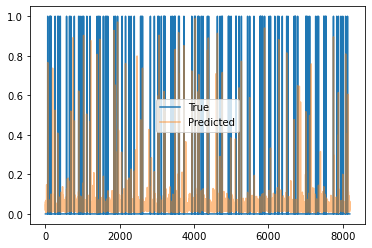

Train Epoch: 0 [1510/2220 (68%)]	Loss: 0.068143	Pres: 0.123457	F1 Score: 0.015034
Train Epoch: 0 [1520/2220 (68%)]	Loss: 0.059833	Pres: 0.105730	F1 Score: 0.030043
Train Epoch: 0 [1530/2220 (68%)]	Loss: 0.062112	Pres: 0.092478	F1 Score: 0.024686
Train Epoch: 0 [1540/2220 (69%)]	Loss: 0.062678	Pres: 0.120588	F1 Score: 0.018876
Train Epoch: 0 [1550/2220 (69%)]	Loss: 0.063118	Pres: 0.082716	F1 Score: 0.014857
Train Epoch: 0 [1560/2220 (70%)]	Loss: 0.065115	Pres: 0.098201	F1 Score: 0.011865
Train Epoch: 0 [1570/2220 (70%)]	Loss: 0.065538	Pres: 0.086561	F1 Score: 0.020796
Train Epoch: 0 [1580/2220 (71%)]	Loss: 0.062707	Pres: 0.123457	F1 Score: 0.029106
Train Epoch: 0 [1590/2220 (71%)]	Loss: 0.061649	Pres: 0.090152	F1 Score: 0.021225
Train Epoch: 0 [1600/2220 (72%)]	Loss: 0.064194	Pres: 0.083992	F1 Score: 0.017564
Train Epoch: 0 [1610/2220 (72%)]	Loss: 0.059966	Pres: 0.085315	F1 Score: 0.024855
Train Epoch: 0 [1620/2220 (72%)]	Loss: 0.059215	Pres: 0.118357	F1 Score: 0.023330
Train Epoch: 0 [

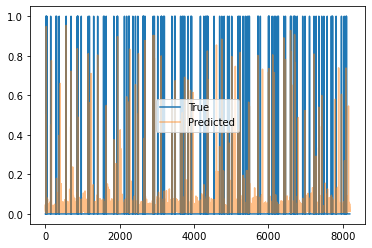

Train Epoch: 0 [1810/2220 (81%)]	Loss: 0.052588	Pres: 0.123545	F1 Score: 0.027667
Train Epoch: 0 [1820/2220 (81%)]	Loss: 0.051043	Pres: 0.112037	F1 Score: 0.033813
Train Epoch: 0 [1830/2220 (82%)]	Loss: 0.052841	Pres: 0.099246	F1 Score: 0.027452
Train Epoch: 0 [1840/2220 (82%)]	Loss: 0.053312	Pres: 0.091077	F1 Score: 0.024434
Train Epoch: 0 [1850/2220 (83%)]	Loss: 0.050389	Pres: 0.119811	F1 Score: 0.044427
Train Epoch: 0 [1860/2220 (83%)]	Loss: 0.051444	Pres: 0.123969	F1 Score: 0.039457
Train Epoch: 0 [1870/2220 (84%)]	Loss: 0.051334	Pres: 0.128571	F1 Score: 0.032913
Train Epoch: 0 [1880/2220 (84%)]	Loss: 0.050119	Pres: 0.126641	F1 Score: 0.042473
Train Epoch: 0 [1890/2220 (85%)]	Loss: 0.053697	Pres: 0.103922	F1 Score: 0.032035
Train Epoch: 0 [1900/2220 (85%)]	Loss: 0.052343	Pres: 0.136614	F1 Score: 0.038670
Train Epoch: 0 [1910/2220 (86%)]	Loss: 0.053023	Pres: 0.140253	F1 Score: 0.042371
Train Epoch: 0 [1920/2220 (86%)]	Loss: 0.053846	Pres: 0.119489	F1 Score: 0.034544
Train Epoch: 0 [

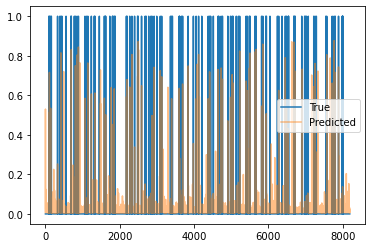

Train Epoch: 0 [2110/2220 (95%)]	Loss: 0.047134	Pres: 0.143875	F1 Score: 0.040011
Train Epoch: 0 [2120/2220 (95%)]	Loss: 0.046325	Pres: 0.114311	F1 Score: 0.035891
Train Epoch: 0 [2130/2220 (95%)]	Loss: 0.047029	Pres: 0.097812	F1 Score: 0.033198
Train Epoch: 0 [2140/2220 (96%)]	Loss: 0.045949	Pres: 0.105280	F1 Score: 0.039998
Train Epoch: 0 [2150/2220 (96%)]	Loss: 0.047261	Pres: 0.113100	F1 Score: 0.049493
Train Epoch: 0 [2160/2220 (97%)]	Loss: 0.047929	Pres: 0.106894	F1 Score: 0.034936
Train Epoch: 0 [2170/2220 (97%)]	Loss: 0.044074	Pres: 0.101126	F1 Score: 0.032253
Train Epoch: 0 [2180/2220 (98%)]	Loss: 0.042518	Pres: 0.141762	F1 Score: 0.059501
Train Epoch: 0 [2190/2220 (98%)]	Loss: 0.047939	Pres: 0.101687	F1 Score: 0.032275
Train Epoch: 0 [2200/2220 (99%)]	Loss: 0.044715	Pres: 0.109913	F1 Score: 0.044959
Train Epoch: 0 [2210/2220 (99%)]	Loss: 0.048293	Pres: 0.129217	F1 Score: 0.040663
Validation Epoch: 0 [0/582 (0%)]	Loss: 0.044256	Pres: 0.146429	F1 Score: 0.053985


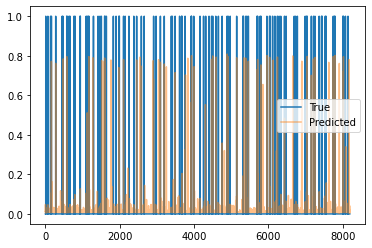

Validation Epoch: 0 [10/582 (1%)]	Loss: 0.038256	Pres: 0.143509	F1 Score: 0.079202
Validation Epoch: 0 [20/582 (3%)]	Loss: 0.037576	Pres: 0.167175	F1 Score: 0.072875
Validation Epoch: 0 [30/582 (5%)]	Loss: 0.041904	Pres: 0.146361	F1 Score: 0.069495
Validation Epoch: 0 [40/582 (6%)]	Loss: 0.039163	Pres: 0.129808	F1 Score: 0.072430
Validation Epoch: 0 [50/582 (8%)]	Loss: 0.038959	Pres: 0.133556	F1 Score: 0.077454
Validation Epoch: 0 [60/582 (10%)]	Loss: 0.038544	Pres: 0.172757	F1 Score: 0.088611
Validation Epoch: 0 [70/582 (12%)]	Loss: 0.039926	Pres: 0.185830	F1 Score: 0.079169
Validation Epoch: 0 [80/582 (13%)]	Loss: 0.045167	Pres: 0.181818	F1 Score: 0.065752
Validation Epoch: 0 [90/582 (15%)]	Loss: 0.039489	Pres: 0.159459	F1 Score: 0.082819
Validation Epoch: 0 [100/582 (17%)]	Loss: 0.042122	Pres: 0.193085	F1 Score: 0.078135
Validation Epoch: 0 [110/582 (18%)]	Loss: 0.041932	Pres: 0.208841	F1 Score: 0.070667
Validation Epoch: 0 [120/582 (20%)]	Loss: 0.037625	Pres: 0.186310	F1 Score: 0.0

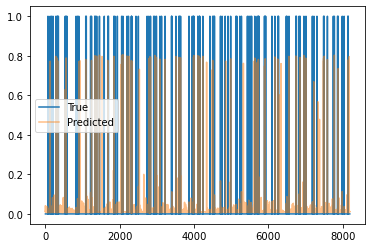

Validation Epoch: 0 [310/582 (53%)]	Loss: 0.043434	Pres: 0.136787	F1 Score: 0.061840
Validation Epoch: 0 [320/582 (54%)]	Loss: 0.037406	Pres: 0.128205	F1 Score: 0.073066
Validation Epoch: 0 [330/582 (56%)]	Loss: 0.039644	Pres: 0.121657	F1 Score: 0.077255
Validation Epoch: 0 [340/582 (58%)]	Loss: 0.040911	Pres: 0.167411	F1 Score: 0.068836
Validation Epoch: 0 [350/582 (60%)]	Loss: 0.038661	Pres: 0.160279	F1 Score: 0.079404
Validation Epoch: 0 [360/582 (61%)]	Loss: 0.043508	Pres: 0.184615	F1 Score: 0.063707
Validation Epoch: 0 [370/582 (63%)]	Loss: 0.040712	Pres: 0.107372	F1 Score: 0.063951
Validation Epoch: 0 [380/582 (65%)]	Loss: 0.040720	Pres: 0.117993	F1 Score: 0.069581
Validation Epoch: 0 [390/582 (67%)]	Loss: 0.041848	Pres: 0.191156	F1 Score: 0.076510
Validation Epoch: 0 [400/582 (68%)]	Loss: 0.033908	Pres: 0.155488	F1 Score: 0.082113
Validation Epoch: 0 [410/582 (70%)]	Loss: 0.039394	Pres: 0.137171	F1 Score: 0.072073
Validation Epoch: 0 [420/582 (72%)]	Loss: 0.040621	Pres: 0.125794

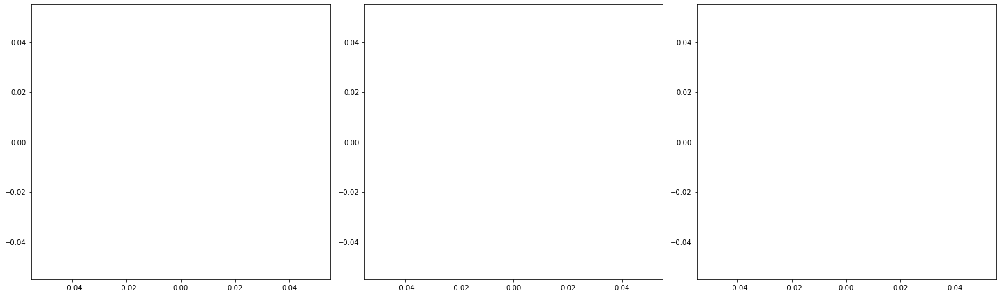

2220 582
Train Epoch: 1 [0/2220 (0%)]	Loss: 0.044621	Pres: 0.120517	F1 Score: 0.047412
116.0 -34336.0


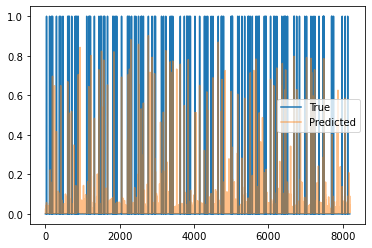

Train Epoch: 1 [10/2220 (0%)]	Loss: 0.046973	Pres: 0.100926	F1 Score: 0.035043
Train Epoch: 1 [20/2220 (0%)]	Loss: 0.047946	Pres: 0.126902	F1 Score: 0.042792
Train Epoch: 1 [30/2220 (1%)]	Loss: 0.044365	Pres: 0.107893	F1 Score: 0.040843
Train Epoch: 1 [40/2220 (1%)]	Loss: 0.046933	Pres: 0.129129	F1 Score: 0.037778
Train Epoch: 1 [50/2220 (2%)]	Loss: 0.047074	Pres: 0.113731	F1 Score: 0.029196
Train Epoch: 1 [60/2220 (2%)]	Loss: 0.046341	Pres: 0.133027	F1 Score: 0.047930
Train Epoch: 1 [70/2220 (3%)]	Loss: 0.045016	Pres: 0.112577	F1 Score: 0.034367
Train Epoch: 1 [80/2220 (3%)]	Loss: 0.043794	Pres: 0.142593	F1 Score: 0.047447
Train Epoch: 1 [90/2220 (4%)]	Loss: 0.046462	Pres: 0.126651	F1 Score: 0.039635
Train Epoch: 1 [100/2220 (4%)]	Loss: 0.045577	Pres: 0.108045	F1 Score: 0.032584
Train Epoch: 1 [110/2220 (4%)]	Loss: 0.043081	Pres: 0.117437	F1 Score: 0.044615
Train Epoch: 1 [120/2220 (5%)]	Loss: 0.044345	Pres: 0.108369	F1 Score: 0.039271
Train Epoch: 1 [130/2220 (5%)]	Loss: 0.041168	Pre

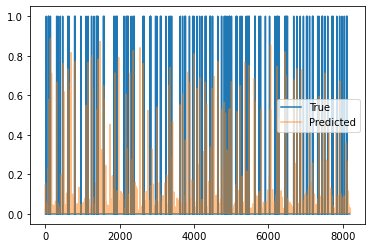

Train Epoch: 1 [310/2220 (13%)]	Loss: 0.045885	Pres: 0.096272	F1 Score: 0.030215
Train Epoch: 1 [320/2220 (14%)]	Loss: 0.041449	Pres: 0.107576	F1 Score: 0.037549
Train Epoch: 1 [330/2220 (14%)]	Loss: 0.040816	Pres: 0.105426	F1 Score: 0.039463
Train Epoch: 1 [340/2220 (15%)]	Loss: 0.041552	Pres: 0.099099	F1 Score: 0.040320
Train Epoch: 1 [350/2220 (15%)]	Loss: 0.040532	Pres: 0.107792	F1 Score: 0.039663
Train Epoch: 1 [360/2220 (16%)]	Loss: 0.040299	Pres: 0.112264	F1 Score: 0.041437
Train Epoch: 1 [370/2220 (16%)]	Loss: 0.041091	Pres: 0.103485	F1 Score: 0.035435
Train Epoch: 1 [380/2220 (17%)]	Loss: 0.039697	Pres: 0.092803	F1 Score: 0.037306
Train Epoch: 1 [390/2220 (17%)]	Loss: 0.039936	Pres: 0.103925	F1 Score: 0.043336
Train Epoch: 1 [400/2220 (18%)]	Loss: 0.040960	Pres: 0.100649	F1 Score: 0.033019
Train Epoch: 1 [410/2220 (18%)]	Loss: 0.040406	Pres: 0.106711	F1 Score: 0.034432
Train Epoch: 1 [420/2220 (18%)]	Loss: 0.039182	Pres: 0.108852	F1 Score: 0.036988
Train Epoch: 1 [430/2220 (19

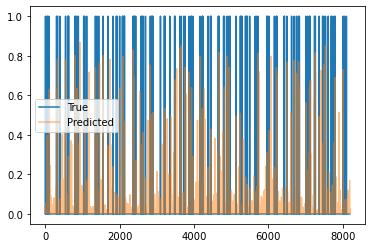

Train Epoch: 1 [610/2220 (27%)]	Loss: 0.039360	Pres: 0.108037	F1 Score: 0.034185
Train Epoch: 1 [620/2220 (27%)]	Loss: 0.035737	Pres: 0.131574	F1 Score: 0.049646
Train Epoch: 1 [630/2220 (28%)]	Loss: 0.037269	Pres: 0.097917	F1 Score: 0.039737
Train Epoch: 1 [640/2220 (28%)]	Loss: 0.041976	Pres: 0.092654	F1 Score: 0.027618
Train Epoch: 1 [650/2220 (29%)]	Loss: 0.038314	Pres: 0.104191	F1 Score: 0.042361
Train Epoch: 1 [660/2220 (29%)]	Loss: 0.035654	Pres: 0.131890	F1 Score: 0.050638
Train Epoch: 1 [670/2220 (30%)]	Loss: 0.035485	Pres: 0.130972	F1 Score: 0.047168
Train Epoch: 1 [680/2220 (30%)]	Loss: 0.034980	Pres: 0.106541	F1 Score: 0.038575
Train Epoch: 1 [690/2220 (31%)]	Loss: 0.037956	Pres: 0.134172	F1 Score: 0.046622
Train Epoch: 1 [700/2220 (31%)]	Loss: 0.037797	Pres: 0.094280	F1 Score: 0.039281
Train Epoch: 1 [710/2220 (31%)]	Loss: 0.038552	Pres: 0.108930	F1 Score: 0.034731
Train Epoch: 1 [720/2220 (32%)]	Loss: 0.035653	Pres: 0.110549	F1 Score: 0.044209
Train Epoch: 1 [730/2220 (32

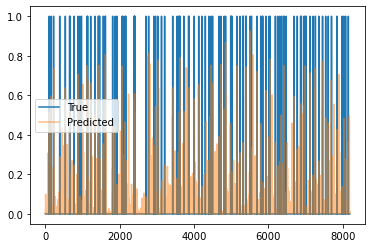

Train Epoch: 1 [910/2220 (40%)]	Loss: 0.032507	Pres: 0.105391	F1 Score: 0.040784
Train Epoch: 1 [920/2220 (41%)]	Loss: 0.034753	Pres: 0.112338	F1 Score: 0.039364
Train Epoch: 1 [930/2220 (41%)]	Loss: 0.038869	Pres: 0.111953	F1 Score: 0.039511
Train Epoch: 1 [940/2220 (42%)]	Loss: 0.037796	Pres: 0.109436	F1 Score: 0.034185
Train Epoch: 1 [950/2220 (42%)]	Loss: 0.035216	Pres: 0.101089	F1 Score: 0.036288
Train Epoch: 1 [960/2220 (43%)]	Loss: 0.033729	Pres: 0.104352	F1 Score: 0.045448
Train Epoch: 1 [970/2220 (43%)]	Loss: 0.033231	Pres: 0.107456	F1 Score: 0.045198
Train Epoch: 1 [980/2220 (44%)]	Loss: 0.037927	Pres: 0.093771	F1 Score: 0.035437
Train Epoch: 1 [990/2220 (44%)]	Loss: 0.034600	Pres: 0.075108	F1 Score: 0.038513
Train Epoch: 1 [1000/2220 (45%)]	Loss: 0.036731	Pres: 0.109816	F1 Score: 0.030831
Train Epoch: 1 [1010/2220 (45%)]	Loss: 0.039913	Pres: 0.108159	F1 Score: 0.027215
Train Epoch: 1 [1020/2220 (45%)]	Loss: 0.039051	Pres: 0.112010	F1 Score: 0.031704
Train Epoch: 1 [1030/2220

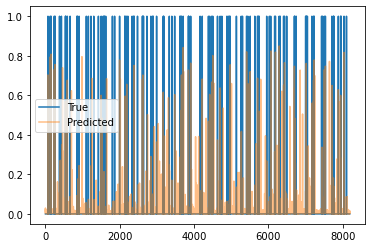

Train Epoch: 1 [1210/2220 (54%)]	Loss: 0.033219	Pres: 0.120442	F1 Score: 0.043112
Train Epoch: 1 [1220/2220 (54%)]	Loss: 0.033735	Pres: 0.097785	F1 Score: 0.038072
Train Epoch: 1 [1230/2220 (55%)]	Loss: 0.036895	Pres: 0.098856	F1 Score: 0.037504
Train Epoch: 1 [1240/2220 (55%)]	Loss: 0.031511	Pres: 0.088133	F1 Score: 0.034839
Train Epoch: 1 [1250/2220 (56%)]	Loss: 0.029280	Pres: 0.096639	F1 Score: 0.042294
Train Epoch: 1 [1260/2220 (56%)]	Loss: 0.035459	Pres: 0.115048	F1 Score: 0.037509
Train Epoch: 1 [1270/2220 (57%)]	Loss: 0.030402	Pres: 0.099924	F1 Score: 0.045220
Train Epoch: 1 [1280/2220 (57%)]	Loss: 0.033889	Pres: 0.094805	F1 Score: 0.038543
Train Epoch: 1 [1290/2220 (58%)]	Loss: 0.037277	Pres: 0.128386	F1 Score: 0.042825
Train Epoch: 1 [1300/2220 (58%)]	Loss: 0.035894	Pres: 0.090155	F1 Score: 0.033516
Train Epoch: 1 [1310/2220 (59%)]	Loss: 0.034386	Pres: 0.085470	F1 Score: 0.037726
Train Epoch: 1 [1320/2220 (59%)]	Loss: 0.034986	Pres: 0.115688	F1 Score: 0.037515
Train Epoch: 1 [

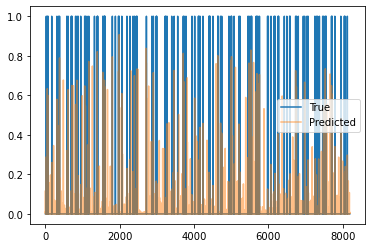

Train Epoch: 1 [1510/2220 (68%)]	Loss: 0.032967	Pres: 0.105332	F1 Score: 0.040804
Train Epoch: 1 [1520/2220 (68%)]	Loss: 0.034896	Pres: 0.091110	F1 Score: 0.030211
Train Epoch: 1 [1530/2220 (68%)]	Loss: 0.028452	Pres: 0.077459	F1 Score: 0.039481
Train Epoch: 1 [1540/2220 (69%)]	Loss: 0.033679	Pres: 0.117686	F1 Score: 0.039543
Train Epoch: 1 [1550/2220 (69%)]	Loss: 0.029808	Pres: 0.102940	F1 Score: 0.045063
Train Epoch: 1 [1560/2220 (70%)]	Loss: 0.033900	Pres: 0.092435	F1 Score: 0.040716
Train Epoch: 1 [1570/2220 (70%)]	Loss: 0.033421	Pres: 0.113971	F1 Score: 0.038893
Train Epoch: 1 [1580/2220 (71%)]	Loss: 0.030462	Pres: 0.095347	F1 Score: 0.041289
Train Epoch: 1 [1590/2220 (71%)]	Loss: 0.033712	Pres: 0.108690	F1 Score: 0.041065
Train Epoch: 1 [1600/2220 (72%)]	Loss: 0.032091	Pres: 0.110688	F1 Score: 0.040284
Train Epoch: 1 [1610/2220 (72%)]	Loss: 0.030753	Pres: 0.105655	F1 Score: 0.043243
Train Epoch: 1 [1620/2220 (72%)]	Loss: 0.033399	Pres: 0.107676	F1 Score: 0.035083
Train Epoch: 1 [

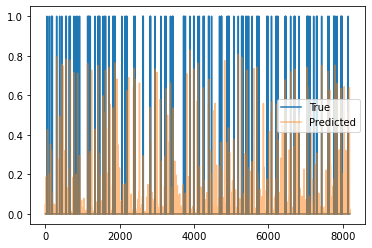

Train Epoch: 1 [1810/2220 (81%)]	Loss: 0.029866	Pres: 0.083954	F1 Score: 0.034145
Train Epoch: 1 [1820/2220 (81%)]	Loss: 0.030958	Pres: 0.096662	F1 Score: 0.036847
Train Epoch: 1 [1830/2220 (82%)]	Loss: 0.032474	Pres: 0.103002	F1 Score: 0.037412
Train Epoch: 1 [1840/2220 (82%)]	Loss: 0.033172	Pres: 0.090325	F1 Score: 0.029381
Train Epoch: 1 [1850/2220 (83%)]	Loss: 0.028818	Pres: 0.082452	F1 Score: 0.039409
Train Epoch: 1 [1860/2220 (83%)]	Loss: 0.031957	Pres: 0.102543	F1 Score: 0.033825
Train Epoch: 1 [1870/2220 (84%)]	Loss: 0.031494	Pres: 0.117028	F1 Score: 0.038331
Train Epoch: 1 [1880/2220 (84%)]	Loss: 0.034928	Pres: 0.120435	F1 Score: 0.036321
Train Epoch: 1 [1890/2220 (85%)]	Loss: 0.030616	Pres: 0.088014	F1 Score: 0.031575
Train Epoch: 1 [1900/2220 (85%)]	Loss: 0.029987	Pres: 0.101068	F1 Score: 0.037803
Train Epoch: 1 [1910/2220 (86%)]	Loss: 0.034123	Pres: 0.104114	F1 Score: 0.039232
Train Epoch: 1 [1920/2220 (86%)]	Loss: 0.030577	Pres: 0.091884	F1 Score: 0.029520
Train Epoch: 1 [

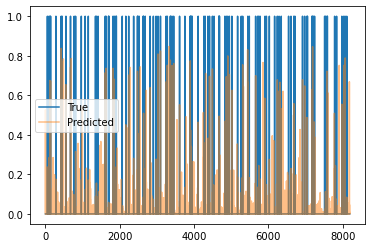

Train Epoch: 1 [2110/2220 (95%)]	Loss: 0.035785	Pres: 0.111416	F1 Score: 0.032279
Train Epoch: 1 [2120/2220 (95%)]	Loss: 0.032002	Pres: 0.080627	F1 Score: 0.035538
Train Epoch: 1 [2130/2220 (95%)]	Loss: 0.032236	Pres: 0.084639	F1 Score: 0.029052
Train Epoch: 1 [2140/2220 (96%)]	Loss: 0.031328	Pres: 0.093117	F1 Score: 0.037416
Train Epoch: 1 [2150/2220 (96%)]	Loss: 0.028174	Pres: 0.110606	F1 Score: 0.036388
Train Epoch: 1 [2160/2220 (97%)]	Loss: 0.029694	Pres: 0.094397	F1 Score: 0.039727
Train Epoch: 1 [2170/2220 (97%)]	Loss: 0.032129	Pres: 0.098523	F1 Score: 0.034023
Train Epoch: 1 [2180/2220 (98%)]	Loss: 0.031761	Pres: 0.105072	F1 Score: 0.035909
Train Epoch: 1 [2190/2220 (98%)]	Loss: 0.032558	Pres: 0.105791	F1 Score: 0.033987
Train Epoch: 1 [2200/2220 (99%)]	Loss: 0.030084	Pres: 0.098413	F1 Score: 0.031921
Train Epoch: 1 [2210/2220 (99%)]	Loss: 0.025865	Pres: 0.117997	F1 Score: 0.049171
Validation Epoch: 1 [0/582 (0%)]	Loss: 0.026206	Pres: 0.108824	F1 Score: 0.046758


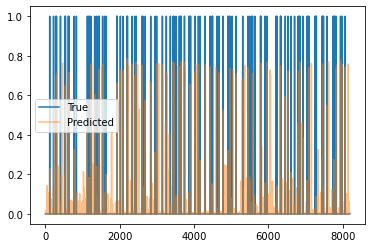

Validation Epoch: 1 [10/582 (1%)]	Loss: 0.026234	Pres: 0.104728	F1 Score: 0.053675
Validation Epoch: 1 [20/582 (3%)]	Loss: 0.024355	Pres: 0.113333	F1 Score: 0.055583
Validation Epoch: 1 [30/582 (5%)]	Loss: 0.024776	Pres: 0.108514	F1 Score: 0.056396
Validation Epoch: 1 [40/582 (6%)]	Loss: 0.022942	Pres: 0.106061	F1 Score: 0.058543
Validation Epoch: 1 [50/582 (8%)]	Loss: 0.025614	Pres: 0.128078	F1 Score: 0.053746
Validation Epoch: 1 [60/582 (10%)]	Loss: 0.025704	Pres: 0.114522	F1 Score: 0.050024
Validation Epoch: 1 [70/582 (12%)]	Loss: 0.022373	Pres: 0.132748	F1 Score: 0.063327
Validation Epoch: 1 [80/582 (13%)]	Loss: 0.025698	Pres: 0.135119	F1 Score: 0.057205
Validation Epoch: 1 [90/582 (15%)]	Loss: 0.022551	Pres: 0.114074	F1 Score: 0.062975
Validation Epoch: 1 [100/582 (17%)]	Loss: 0.027388	Pres: 0.103030	F1 Score: 0.052372
Validation Epoch: 1 [110/582 (18%)]	Loss: 0.026453	Pres: 0.104545	F1 Score: 0.047937
Validation Epoch: 1 [120/582 (20%)]	Loss: 0.024711	Pres: 0.094421	F1 Score: 0.0

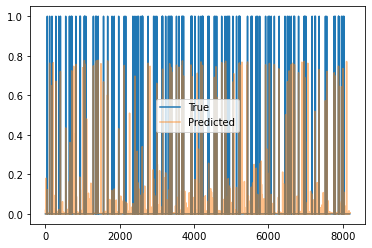

Validation Epoch: 1 [310/582 (53%)]	Loss: 0.027732	Pres: 0.121212	F1 Score: 0.046112
Validation Epoch: 1 [320/582 (54%)]	Loss: 0.023604	Pres: 0.128747	F1 Score: 0.054600
Validation Epoch: 1 [330/582 (56%)]	Loss: 0.027317	Pres: 0.108611	F1 Score: 0.045365
Validation Epoch: 1 [340/582 (58%)]	Loss: 0.023698	Pres: 0.118795	F1 Score: 0.058287
Validation Epoch: 1 [350/582 (60%)]	Loss: 0.027871	Pres: 0.109036	F1 Score: 0.046555
Validation Epoch: 1 [360/582 (61%)]	Loss: 0.026081	Pres: 0.108225	F1 Score: 0.048603
Validation Epoch: 1 [370/582 (63%)]	Loss: 0.024921	Pres: 0.128408	F1 Score: 0.053273
Validation Epoch: 1 [380/582 (65%)]	Loss: 0.023023	Pres: 0.108879	F1 Score: 0.056079
Validation Epoch: 1 [390/582 (67%)]	Loss: 0.023885	Pres: 0.119596	F1 Score: 0.056132
Validation Epoch: 1 [400/582 (68%)]	Loss: 0.026151	Pres: 0.120643	F1 Score: 0.051308
Validation Epoch: 1 [410/582 (70%)]	Loss: 0.027570	Pres: 0.131355	F1 Score: 0.049365
Validation Epoch: 1 [420/582 (72%)]	Loss: 0.023143	Pres: 0.084333

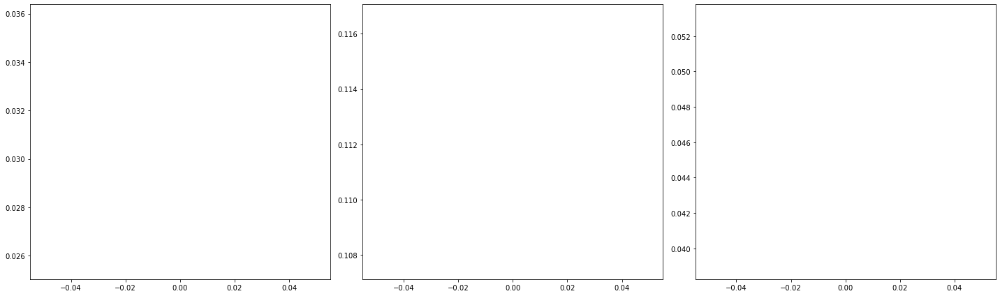

2220 582
Train Epoch: 2 [0/2220 (0%)]	Loss: 0.029198	Pres: 0.106173	F1 Score: 0.041143
110.0 -47744.0


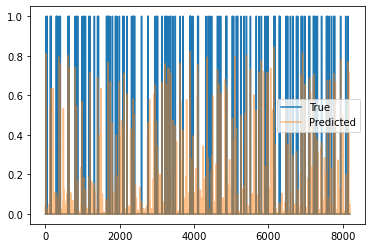

Train Epoch: 2 [10/2220 (0%)]	Loss: 0.031479	Pres: 0.098336	F1 Score: 0.030781
Train Epoch: 2 [20/2220 (0%)]	Loss: 0.031145	Pres: 0.097668	F1 Score: 0.034052
Train Epoch: 2 [30/2220 (1%)]	Loss: 0.030538	Pres: 0.104380	F1 Score: 0.041090
Train Epoch: 2 [40/2220 (1%)]	Loss: 0.029890	Pres: 0.082060	F1 Score: 0.034083
Train Epoch: 2 [50/2220 (2%)]	Loss: 0.031421	Pres: 0.096190	F1 Score: 0.035805
Train Epoch: 2 [60/2220 (2%)]	Loss: 0.035532	Pres: 0.102386	F1 Score: 0.026891
Train Epoch: 2 [70/2220 (3%)]	Loss: 0.030445	Pres: 0.108520	F1 Score: 0.042254
Train Epoch: 2 [80/2220 (3%)]	Loss: 0.027944	Pres: 0.093705	F1 Score: 0.035981
Train Epoch: 2 [90/2220 (4%)]	Loss: 0.034099	Pres: 0.098669	F1 Score: 0.029520
Train Epoch: 2 [100/2220 (4%)]	Loss: 0.035444	Pres: 0.100594	F1 Score: 0.031234
Train Epoch: 2 [110/2220 (4%)]	Loss: 0.030580	Pres: 0.086053	F1 Score: 0.034581
Train Epoch: 2 [120/2220 (5%)]	Loss: 0.030829	Pres: 0.085219	F1 Score: 0.029225
Train Epoch: 2 [130/2220 (5%)]	Loss: 0.028461	Pre

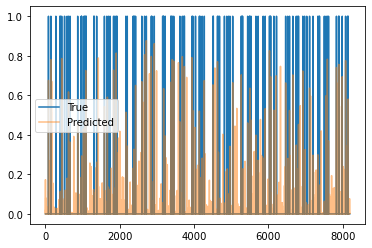

Train Epoch: 2 [310/2220 (13%)]	Loss: 0.031586	Pres: 0.087973	F1 Score: 0.030256
Train Epoch: 2 [320/2220 (14%)]	Loss: 0.031226	Pres: 0.097496	F1 Score: 0.033208
Train Epoch: 2 [330/2220 (14%)]	Loss: 0.028795	Pres: 0.072818	F1 Score: 0.030794
Train Epoch: 2 [340/2220 (15%)]	Loss: 0.034334	Pres: 0.098107	F1 Score: 0.036348
Train Epoch: 2 [350/2220 (15%)]	Loss: 0.029792	Pres: 0.092772	F1 Score: 0.037098
Train Epoch: 2 [360/2220 (16%)]	Loss: 0.029482	Pres: 0.094945	F1 Score: 0.033730
Train Epoch: 2 [370/2220 (16%)]	Loss: 0.033754	Pres: 0.113187	F1 Score: 0.033900
Train Epoch: 2 [380/2220 (17%)]	Loss: 0.032055	Pres: 0.100483	F1 Score: 0.033024
Train Epoch: 2 [390/2220 (17%)]	Loss: 0.027665	Pres: 0.086934	F1 Score: 0.035697
Train Epoch: 2 [400/2220 (18%)]	Loss: 0.027324	Pres: 0.095880	F1 Score: 0.038131
Train Epoch: 2 [410/2220 (18%)]	Loss: 0.030474	Pres: 0.091654	F1 Score: 0.037797
Train Epoch: 2 [420/2220 (18%)]	Loss: 0.029994	Pres: 0.100609	F1 Score: 0.038095
Train Epoch: 2 [430/2220 (19

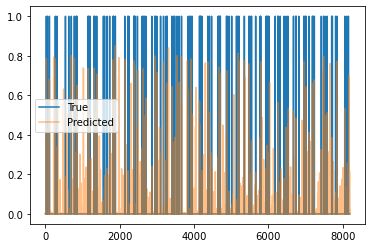

Train Epoch: 2 [610/2220 (27%)]	Loss: 0.029659	Pres: 0.078753	F1 Score: 0.032232
Train Epoch: 2 [620/2220 (27%)]	Loss: 0.032471	Pres: 0.105660	F1 Score: 0.033824
Train Epoch: 2 [630/2220 (28%)]	Loss: 0.032409	Pres: 0.081707	F1 Score: 0.025105
Train Epoch: 2 [640/2220 (28%)]	Loss: 0.029226	Pres: 0.100024	F1 Score: 0.036045
Train Epoch: 2 [650/2220 (29%)]	Loss: 0.028445	Pres: 0.099308	F1 Score: 0.039485
Train Epoch: 2 [660/2220 (29%)]	Loss: 0.029916	Pres: 0.083718	F1 Score: 0.033308
Train Epoch: 2 [670/2220 (30%)]	Loss: 0.028255	Pres: 0.085440	F1 Score: 0.037956
Train Epoch: 2 [680/2220 (30%)]	Loss: 0.029646	Pres: 0.101385	F1 Score: 0.040087
Train Epoch: 2 [690/2220 (31%)]	Loss: 0.030032	Pres: 0.088565	F1 Score: 0.032365
Train Epoch: 2 [700/2220 (31%)]	Loss: 0.028921	Pres: 0.101576	F1 Score: 0.033114
Train Epoch: 2 [710/2220 (31%)]	Loss: 0.028040	Pres: 0.082343	F1 Score: 0.031032
Train Epoch: 2 [720/2220 (32%)]	Loss: 0.029568	Pres: 0.091908	F1 Score: 0.036250
Train Epoch: 2 [730/2220 (32

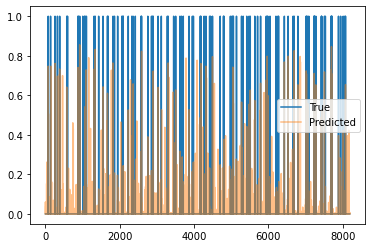

Train Epoch: 2 [910/2220 (40%)]	Loss: 0.030787	Pres: 0.086275	F1 Score: 0.028705
Train Epoch: 2 [920/2220 (41%)]	Loss: 0.031355	Pres: 0.080955	F1 Score: 0.027636
Train Epoch: 2 [930/2220 (41%)]	Loss: 0.028083	Pres: 0.088961	F1 Score: 0.035671
Train Epoch: 2 [940/2220 (42%)]	Loss: 0.027392	Pres: 0.082043	F1 Score: 0.032762
Train Epoch: 2 [950/2220 (42%)]	Loss: 0.029296	Pres: 0.083726	F1 Score: 0.032725
Train Epoch: 2 [960/2220 (43%)]	Loss: 0.029546	Pres: 0.096877	F1 Score: 0.032320
Train Epoch: 2 [970/2220 (43%)]	Loss: 0.031585	Pres: 0.094826	F1 Score: 0.033674
Train Epoch: 2 [980/2220 (44%)]	Loss: 0.030915	Pres: 0.082216	F1 Score: 0.024119
Train Epoch: 2 [990/2220 (44%)]	Loss: 0.028570	Pres: 0.071546	F1 Score: 0.031772
Train Epoch: 2 [1000/2220 (45%)]	Loss: 0.029264	Pres: 0.076649	F1 Score: 0.027991
Train Epoch: 2 [1010/2220 (45%)]	Loss: 0.033682	Pres: 0.082783	F1 Score: 0.025036
Train Epoch: 2 [1020/2220 (45%)]	Loss: 0.027173	Pres: 0.069033	F1 Score: 0.030262
Train Epoch: 2 [1030/2220

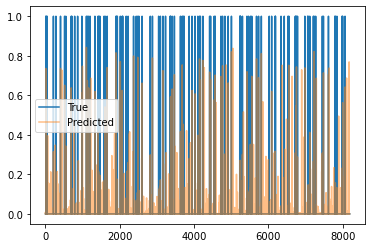

Train Epoch: 2 [1210/2220 (54%)]	Loss: 0.033643	Pres: 0.070526	F1 Score: 0.022308
Train Epoch: 2 [1220/2220 (54%)]	Loss: 0.027401	Pres: 0.077695	F1 Score: 0.032274
Train Epoch: 2 [1230/2220 (55%)]	Loss: 0.026562	Pres: 0.080274	F1 Score: 0.031318
Train Epoch: 2 [1240/2220 (55%)]	Loss: 0.030546	Pres: 0.070982	F1 Score: 0.026264
Train Epoch: 2 [1250/2220 (56%)]	Loss: 0.030947	Pres: 0.065132	F1 Score: 0.024025
Train Epoch: 2 [1260/2220 (56%)]	Loss: 0.034229	Pres: 0.072294	F1 Score: 0.023769
Train Epoch: 2 [1270/2220 (57%)]	Loss: 0.028156	Pres: 0.081004	F1 Score: 0.030121
Train Epoch: 2 [1280/2220 (57%)]	Loss: 0.028266	Pres: 0.070199	F1 Score: 0.026859
Train Epoch: 2 [1290/2220 (58%)]	Loss: 0.031430	Pres: 0.062602	F1 Score: 0.023618
Train Epoch: 2 [1300/2220 (58%)]	Loss: 0.030024	Pres: 0.068581	F1 Score: 0.022845
Train Epoch: 2 [1310/2220 (59%)]	Loss: 0.026601	Pres: 0.073264	F1 Score: 0.028009
Train Epoch: 2 [1320/2220 (59%)]	Loss: 0.028328	Pres: 0.077931	F1 Score: 0.030750
Train Epoch: 2 [

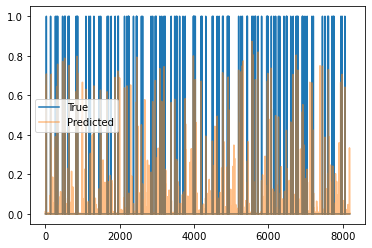

Train Epoch: 2 [1510/2220 (68%)]	Loss: 0.028827	Pres: 0.075157	F1 Score: 0.029407
Train Epoch: 2 [1520/2220 (68%)]	Loss: 0.027742	Pres: 0.074841	F1 Score: 0.030837
Train Epoch: 2 [1530/2220 (68%)]	Loss: 0.030949	Pres: 0.075878	F1 Score: 0.030076
Train Epoch: 2 [1540/2220 (69%)]	Loss: 0.028950	Pres: 0.074394	F1 Score: 0.028730
Train Epoch: 2 [1550/2220 (69%)]	Loss: 0.028617	Pres: 0.072016	F1 Score: 0.029243
Train Epoch: 2 [1560/2220 (70%)]	Loss: 0.026899	Pres: 0.065327	F1 Score: 0.025829
Train Epoch: 2 [1570/2220 (70%)]	Loss: 0.027164	Pres: 0.074777	F1 Score: 0.030324
Train Epoch: 2 [1580/2220 (71%)]	Loss: 0.025897	Pres: 0.074812	F1 Score: 0.030840
Train Epoch: 2 [1590/2220 (71%)]	Loss: 0.030073	Pres: 0.072884	F1 Score: 0.027478
Train Epoch: 2 [1600/2220 (72%)]	Loss: 0.026841	Pres: 0.082948	F1 Score: 0.031543
Train Epoch: 2 [1610/2220 (72%)]	Loss: 0.026460	Pres: 0.067329	F1 Score: 0.027943
Train Epoch: 2 [1620/2220 (72%)]	Loss: 0.026975	Pres: 0.075489	F1 Score: 0.029324
Train Epoch: 2 [

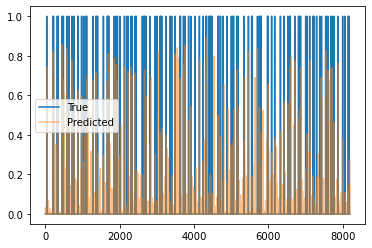

Train Epoch: 2 [1810/2220 (81%)]	Loss: 0.026073	Pres: 0.058483	F1 Score: 0.026659
Train Epoch: 2 [1820/2220 (81%)]	Loss: 0.029375	Pres: 0.068975	F1 Score: 0.022956
Train Epoch: 2 [1830/2220 (82%)]	Loss: 0.026812	Pres: 0.062748	F1 Score: 0.029076
Train Epoch: 2 [1840/2220 (82%)]	Loss: 0.027577	Pres: 0.072887	F1 Score: 0.028395
Train Epoch: 2 [1850/2220 (83%)]	Loss: 0.027560	Pres: 0.060196	F1 Score: 0.025522
Train Epoch: 2 [1860/2220 (83%)]	Loss: 0.027407	Pres: 0.059942	F1 Score: 0.028122
Train Epoch: 2 [1870/2220 (84%)]	Loss: 0.027767	Pres: 0.077591	F1 Score: 0.032295
Train Epoch: 2 [1880/2220 (84%)]	Loss: 0.026697	Pres: 0.067414	F1 Score: 0.031981
Train Epoch: 2 [1890/2220 (85%)]	Loss: 0.028274	Pres: 0.082024	F1 Score: 0.026637
Train Epoch: 2 [1900/2220 (85%)]	Loss: 0.030500	Pres: 0.072001	F1 Score: 0.026616
Train Epoch: 2 [1910/2220 (86%)]	Loss: 0.029287	Pres: 0.075925	F1 Score: 0.029347
Train Epoch: 2 [1920/2220 (86%)]	Loss: 0.027983	Pres: 0.070160	F1 Score: 0.023819
Train Epoch: 2 [

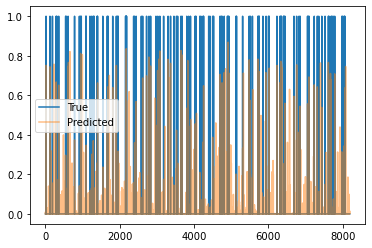

Train Epoch: 2 [2110/2220 (95%)]	Loss: 0.027270	Pres: 0.068440	F1 Score: 0.029729
Train Epoch: 2 [2120/2220 (95%)]	Loss: 0.036536	Pres: 0.082242	F1 Score: 0.023819
Train Epoch: 2 [2130/2220 (95%)]	Loss: 0.029137	Pres: 0.069079	F1 Score: 0.026601
Train Epoch: 2 [2140/2220 (96%)]	Loss: 0.027522	Pres: 0.073565	F1 Score: 0.030084
Train Epoch: 2 [2150/2220 (96%)]	Loss: 0.025372	Pres: 0.072305	F1 Score: 0.030341
Train Epoch: 2 [2160/2220 (97%)]	Loss: 0.029828	Pres: 0.066253	F1 Score: 0.026599
Train Epoch: 2 [2170/2220 (97%)]	Loss: 0.031356	Pres: 0.060729	F1 Score: 0.022563
Train Epoch: 2 [2180/2220 (98%)]	Loss: 0.026151	Pres: 0.068008	F1 Score: 0.031249
Train Epoch: 2 [2190/2220 (98%)]	Loss: 0.032103	Pres: 0.062039	F1 Score: 0.024512
Train Epoch: 2 [2200/2220 (99%)]	Loss: 0.024976	Pres: 0.066384	F1 Score: 0.028194
Train Epoch: 2 [2210/2220 (99%)]	Loss: 0.028363	Pres: 0.064693	F1 Score: 0.023564
Validation Epoch: 2 [0/582 (0%)]	Loss: 0.023688	Pres: 0.095664	F1 Score: 0.034980


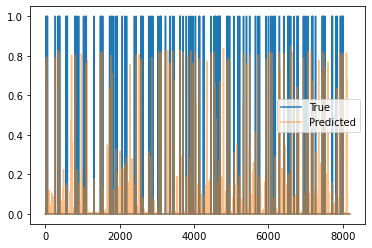

Validation Epoch: 2 [10/582 (1%)]	Loss: 0.025161	Pres: 0.070000	F1 Score: 0.033174
Validation Epoch: 2 [20/582 (3%)]	Loss: 0.023914	Pres: 0.086014	F1 Score: 0.028273
Validation Epoch: 2 [30/582 (5%)]	Loss: 0.021682	Pres: 0.097792	F1 Score: 0.035688
Validation Epoch: 2 [40/582 (6%)]	Loss: 0.020530	Pres: 0.060417	F1 Score: 0.031296
Validation Epoch: 2 [50/582 (8%)]	Loss: 0.021726	Pres: 0.081067	F1 Score: 0.029014
Validation Epoch: 2 [60/582 (10%)]	Loss: 0.023258	Pres: 0.062879	F1 Score: 0.027892
Validation Epoch: 2 [70/582 (12%)]	Loss: 0.021281	Pres: 0.075708	F1 Score: 0.035471
Validation Epoch: 2 [80/582 (13%)]	Loss: 0.022771	Pres: 0.085833	F1 Score: 0.034407
Validation Epoch: 2 [90/582 (15%)]	Loss: 0.018675	Pres: 0.058651	F1 Score: 0.031296
Validation Epoch: 2 [100/582 (17%)]	Loss: 0.021053	Pres: 0.084855	F1 Score: 0.032652
Validation Epoch: 2 [110/582 (18%)]	Loss: 0.021224	Pres: 0.063542	F1 Score: 0.033553
Validation Epoch: 2 [120/582 (20%)]	Loss: 0.023678	Pres: 0.094246	F1 Score: 0.0

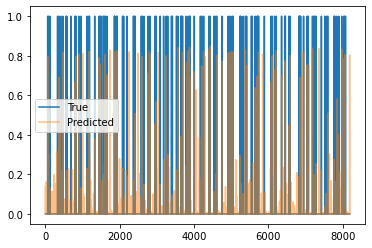

Validation Epoch: 2 [310/582 (53%)]	Loss: 0.021961	Pres: 0.071197	F1 Score: 0.032429
Validation Epoch: 2 [320/582 (54%)]	Loss: 0.024879	Pres: 0.095556	F1 Score: 0.034947
Validation Epoch: 2 [330/582 (56%)]	Loss: 0.021110	Pres: 0.094861	F1 Score: 0.035475
Validation Epoch: 2 [340/582 (58%)]	Loss: 0.023895	Pres: 0.063331	F1 Score: 0.024717
Validation Epoch: 2 [350/582 (60%)]	Loss: 0.024824	Pres: 0.083333	F1 Score: 0.030501
Validation Epoch: 2 [360/582 (61%)]	Loss: 0.023267	Pres: 0.090723	F1 Score: 0.031302
Validation Epoch: 2 [370/582 (63%)]	Loss: 0.020805	Pres: 0.086371	F1 Score: 0.033665
Validation Epoch: 2 [380/582 (65%)]	Loss: 0.022477	Pres: 0.079327	F1 Score: 0.030017
Validation Epoch: 2 [390/582 (67%)]	Loss: 0.024348	Pres: 0.081681	F1 Score: 0.030418
Validation Epoch: 2 [400/582 (68%)]	Loss: 0.021922	Pres: 0.097179	F1 Score: 0.035397
Validation Epoch: 2 [410/582 (70%)]	Loss: 0.020947	Pres: 0.085995	F1 Score: 0.035974
Validation Epoch: 2 [420/582 (72%)]	Loss: 0.023146	Pres: 0.083912

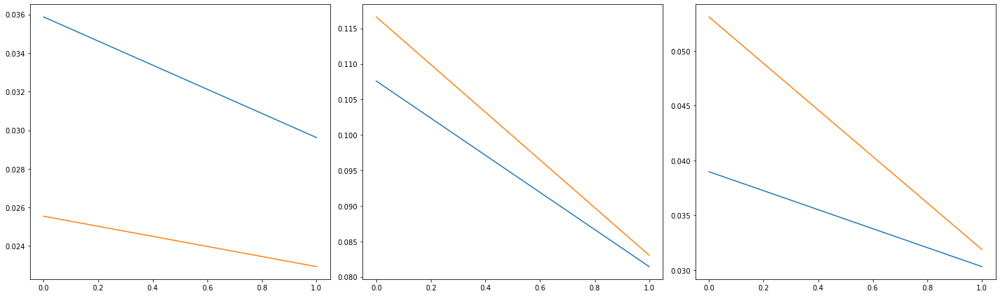

2220 582
Train Epoch: 3 [0/2220 (0%)]	Loss: 0.027388	Pres: 0.073398	F1 Score: 0.028857
108.0 -58080.0


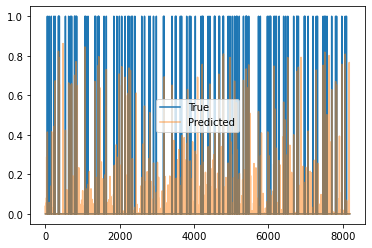

Train Epoch: 3 [10/2220 (0%)]	Loss: 0.028043	Pres: 0.066380	F1 Score: 0.025698
Train Epoch: 3 [20/2220 (0%)]	Loss: 0.030366	Pres: 0.061036	F1 Score: 0.019716
Train Epoch: 3 [30/2220 (1%)]	Loss: 0.029590	Pres: 0.067943	F1 Score: 0.020561
Train Epoch: 3 [40/2220 (1%)]	Loss: 0.027972	Pres: 0.065113	F1 Score: 0.027614
Train Epoch: 3 [50/2220 (2%)]	Loss: 0.024770	Pres: 0.077548	F1 Score: 0.030980
Train Epoch: 3 [60/2220 (2%)]	Loss: 0.030378	Pres: 0.074132	F1 Score: 0.028520
Train Epoch: 3 [70/2220 (3%)]	Loss: 0.028663	Pres: 0.073749	F1 Score: 0.027398
Train Epoch: 3 [80/2220 (3%)]	Loss: 0.029166	Pres: 0.066667	F1 Score: 0.026509
Train Epoch: 3 [90/2220 (4%)]	Loss: 0.031593	Pres: 0.062057	F1 Score: 0.019881
Train Epoch: 3 [100/2220 (4%)]	Loss: 0.029543	Pres: 0.064782	F1 Score: 0.023251
Train Epoch: 3 [110/2220 (4%)]	Loss: 0.029420	Pres: 0.067340	F1 Score: 0.021349
Train Epoch: 3 [120/2220 (5%)]	Loss: 0.028347	Pres: 0.059709	F1 Score: 0.023310
Train Epoch: 3 [130/2220 (5%)]	Loss: 0.034586	Pre

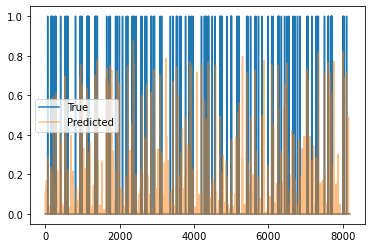

Train Epoch: 3 [310/2220 (13%)]	Loss: 0.028786	Pres: 0.070195	F1 Score: 0.024952
Train Epoch: 3 [320/2220 (14%)]	Loss: 0.029814	Pres: 0.059958	F1 Score: 0.022369
Train Epoch: 3 [330/2220 (14%)]	Loss: 0.027265	Pres: 0.065476	F1 Score: 0.026746
Train Epoch: 3 [340/2220 (15%)]	Loss: 0.029417	Pres: 0.059793	F1 Score: 0.023349
Train Epoch: 3 [350/2220 (15%)]	Loss: 0.028019	Pres: 0.076053	F1 Score: 0.027722
Train Epoch: 3 [360/2220 (16%)]	Loss: 0.027915	Pres: 0.053205	F1 Score: 0.018809
Train Epoch: 3 [370/2220 (16%)]	Loss: 0.028284	Pres: 0.071969	F1 Score: 0.027091
Train Epoch: 3 [380/2220 (17%)]	Loss: 0.029579	Pres: 0.059690	F1 Score: 0.020085
Train Epoch: 3 [390/2220 (17%)]	Loss: 0.031577	Pres: 0.053329	F1 Score: 0.017884
Train Epoch: 3 [400/2220 (18%)]	Loss: 0.031188	Pres: 0.061701	F1 Score: 0.016734
Train Epoch: 3 [410/2220 (18%)]	Loss: 0.028992	Pres: 0.062208	F1 Score: 0.027828
Train Epoch: 3 [420/2220 (18%)]	Loss: 0.026909	Pres: 0.062880	F1 Score: 0.025416
Train Epoch: 3 [430/2220 (19

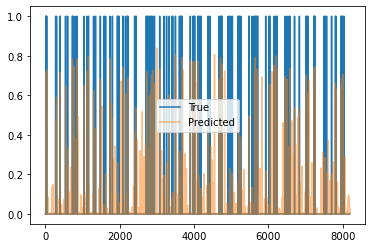

Train Epoch: 3 [610/2220 (27%)]	Loss: 0.031335	Pres: 0.062573	F1 Score: 0.023508
Train Epoch: 3 [620/2220 (27%)]	Loss: 0.027558	Pres: 0.059111	F1 Score: 0.024262
Train Epoch: 3 [630/2220 (28%)]	Loss: 0.031068	Pres: 0.066362	F1 Score: 0.021656
Train Epoch: 3 [640/2220 (28%)]	Loss: 0.034010	Pres: 0.073282	F1 Score: 0.023245
Train Epoch: 3 [650/2220 (29%)]	Loss: 0.031481	Pres: 0.070570	F1 Score: 0.025191
Train Epoch: 3 [660/2220 (29%)]	Loss: 0.027924	Pres: 0.058242	F1 Score: 0.025257
Train Epoch: 3 [670/2220 (30%)]	Loss: 0.026724	Pres: 0.060012	F1 Score: 0.025556
Train Epoch: 3 [680/2220 (30%)]	Loss: 0.029101	Pres: 0.067851	F1 Score: 0.027983
Train Epoch: 3 [690/2220 (31%)]	Loss: 0.032371	Pres: 0.059177	F1 Score: 0.016844
Train Epoch: 3 [700/2220 (31%)]	Loss: 0.028671	Pres: 0.077617	F1 Score: 0.030286
Train Epoch: 3 [710/2220 (31%)]	Loss: 0.026461	Pres: 0.073235	F1 Score: 0.029472
Train Epoch: 3 [720/2220 (32%)]	Loss: 0.025483	Pres: 0.060361	F1 Score: 0.024028
Train Epoch: 3 [730/2220 (32

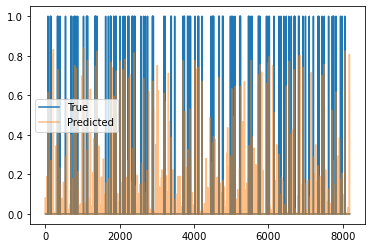

Train Epoch: 3 [910/2220 (40%)]	Loss: 0.029933	Pres: 0.068713	F1 Score: 0.022735
Train Epoch: 3 [920/2220 (41%)]	Loss: 0.029377	Pres: 0.061308	F1 Score: 0.022364
Train Epoch: 3 [930/2220 (41%)]	Loss: 0.028096	Pres: 0.069610	F1 Score: 0.024607
Train Epoch: 3 [940/2220 (42%)]	Loss: 0.027594	Pres: 0.062554	F1 Score: 0.026629
Train Epoch: 3 [950/2220 (42%)]	Loss: 0.028773	Pres: 0.060211	F1 Score: 0.024622
Train Epoch: 3 [960/2220 (43%)]	Loss: 0.024913	Pres: 0.057540	F1 Score: 0.027915
Train Epoch: 3 [970/2220 (43%)]	Loss: 0.027052	Pres: 0.057682	F1 Score: 0.021518
Train Epoch: 3 [980/2220 (44%)]	Loss: 0.027040	Pres: 0.061432	F1 Score: 0.026193
Train Epoch: 3 [990/2220 (44%)]	Loss: 0.027625	Pres: 0.071250	F1 Score: 0.027360
Train Epoch: 3 [1000/2220 (45%)]	Loss: 0.029262	Pres: 0.070767	F1 Score: 0.027365
Train Epoch: 3 [1010/2220 (45%)]	Loss: 0.028433	Pres: 0.069061	F1 Score: 0.026901
Train Epoch: 3 [1020/2220 (45%)]	Loss: 0.033168	Pres: 0.060020	F1 Score: 0.020667
Train Epoch: 3 [1030/2220

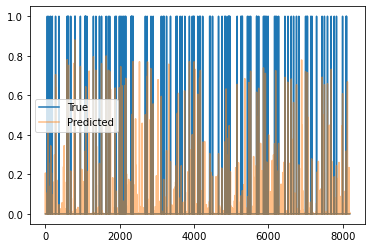

Train Epoch: 3 [1210/2220 (54%)]	Loss: 0.028172	Pres: 0.061084	F1 Score: 0.027579
Train Epoch: 3 [1220/2220 (54%)]	Loss: 0.027553	Pres: 0.063596	F1 Score: 0.024605
Train Epoch: 3 [1230/2220 (55%)]	Loss: 0.027836	Pres: 0.060914	F1 Score: 0.022807
Train Epoch: 3 [1240/2220 (55%)]	Loss: 0.027066	Pres: 0.059256	F1 Score: 0.025310
Train Epoch: 3 [1250/2220 (56%)]	Loss: 0.030255	Pres: 0.056334	F1 Score: 0.023561
Train Epoch: 3 [1260/2220 (56%)]	Loss: 0.031428	Pres: 0.059340	F1 Score: 0.020976
Train Epoch: 3 [1270/2220 (57%)]	Loss: 0.023271	Pres: 0.077031	F1 Score: 0.032570
Train Epoch: 3 [1280/2220 (57%)]	Loss: 0.027932	Pres: 0.075674	F1 Score: 0.024895
Train Epoch: 3 [1290/2220 (58%)]	Loss: 0.026561	Pres: 0.071130	F1 Score: 0.026242
Train Epoch: 3 [1300/2220 (58%)]	Loss: 0.033270	Pres: 0.069462	F1 Score: 0.021848
Train Epoch: 3 [1310/2220 (59%)]	Loss: 0.028535	Pres: 0.069739	F1 Score: 0.025524
Train Epoch: 3 [1320/2220 (59%)]	Loss: 0.028223	Pres: 0.071514	F1 Score: 0.027885
Train Epoch: 3 [

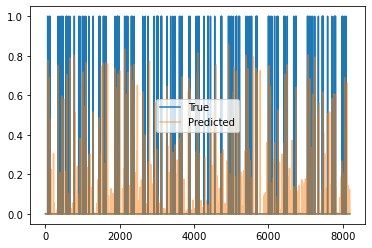

Train Epoch: 3 [1510/2220 (68%)]	Loss: 0.031571	Pres: 0.060000	F1 Score: 0.019903
Train Epoch: 3 [1520/2220 (68%)]	Loss: 0.028911	Pres: 0.052244	F1 Score: 0.020694
Train Epoch: 3 [1530/2220 (68%)]	Loss: 0.028722	Pres: 0.056134	F1 Score: 0.023883
Train Epoch: 3 [1540/2220 (69%)]	Loss: 0.026697	Pres: 0.064340	F1 Score: 0.023533
Train Epoch: 3 [1550/2220 (69%)]	Loss: 0.025552	Pres: 0.070738	F1 Score: 0.027065
Train Epoch: 3 [1560/2220 (70%)]	Loss: 0.029422	Pres: 0.062613	F1 Score: 0.024202
Train Epoch: 3 [1570/2220 (70%)]	Loss: 0.029466	Pres: 0.065556	F1 Score: 0.021698
Train Epoch: 3 [1580/2220 (71%)]	Loss: 0.025727	Pres: 0.054531	F1 Score: 0.026889
Train Epoch: 3 [1590/2220 (71%)]	Loss: 0.025122	Pres: 0.054690	F1 Score: 0.022697
Train Epoch: 3 [1600/2220 (72%)]	Loss: 0.027473	Pres: 0.064179	F1 Score: 0.026542
Train Epoch: 3 [1610/2220 (72%)]	Loss: 0.027588	Pres: 0.061450	F1 Score: 0.021304
Train Epoch: 3 [1620/2220 (72%)]	Loss: 0.025890	Pres: 0.074637	F1 Score: 0.029254
Train Epoch: 3 [

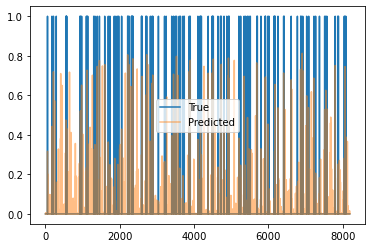

Train Epoch: 3 [1810/2220 (81%)]	Loss: 0.028101	Pres: 0.065711	F1 Score: 0.027507
Train Epoch: 3 [1820/2220 (81%)]	Loss: 0.023791	Pres: 0.060337	F1 Score: 0.028262
Train Epoch: 3 [1830/2220 (82%)]	Loss: 0.026559	Pres: 0.053612	F1 Score: 0.022243
Train Epoch: 3 [1840/2220 (82%)]	Loss: 0.030704	Pres: 0.058744	F1 Score: 0.019502
Train Epoch: 3 [1850/2220 (83%)]	Loss: 0.029707	Pres: 0.065571	F1 Score: 0.023114
Train Epoch: 3 [1860/2220 (83%)]	Loss: 0.027276	Pres: 0.058162	F1 Score: 0.020918
Train Epoch: 3 [1870/2220 (84%)]	Loss: 0.027090	Pres: 0.063318	F1 Score: 0.023369
Train Epoch: 3 [1880/2220 (84%)]	Loss: 0.024411	Pres: 0.064928	F1 Score: 0.025993
Train Epoch: 3 [1890/2220 (85%)]	Loss: 0.028211	Pres: 0.062372	F1 Score: 0.022660
Train Epoch: 3 [1900/2220 (85%)]	Loss: 0.029019	Pres: 0.061927	F1 Score: 0.021554
Train Epoch: 3 [1910/2220 (86%)]	Loss: 0.026414	Pres: 0.067593	F1 Score: 0.028504
Train Epoch: 3 [1920/2220 (86%)]	Loss: 0.024556	Pres: 0.064233	F1 Score: 0.026162
Train Epoch: 3 [

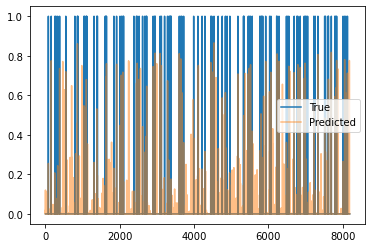

Train Epoch: 3 [2110/2220 (95%)]	Loss: 0.027330	Pres: 0.056397	F1 Score: 0.023183
Train Epoch: 3 [2120/2220 (95%)]	Loss: 0.027442	Pres: 0.056711	F1 Score: 0.022809
Train Epoch: 3 [2130/2220 (95%)]	Loss: 0.022944	Pres: 0.056847	F1 Score: 0.027323
Train Epoch: 3 [2140/2220 (96%)]	Loss: 0.025204	Pres: 0.058594	F1 Score: 0.024805
Train Epoch: 3 [2150/2220 (96%)]	Loss: 0.023504	Pres: 0.058147	F1 Score: 0.027159
Train Epoch: 3 [2160/2220 (97%)]	Loss: 0.028766	Pres: 0.056956	F1 Score: 0.021806
Train Epoch: 3 [2170/2220 (97%)]	Loss: 0.024722	Pres: 0.052479	F1 Score: 0.020551
Train Epoch: 3 [2180/2220 (98%)]	Loss: 0.027618	Pres: 0.067925	F1 Score: 0.024234
Train Epoch: 3 [2190/2220 (98%)]	Loss: 0.026107	Pres: 0.052267	F1 Score: 0.019854
Train Epoch: 3 [2200/2220 (99%)]	Loss: 0.028296	Pres: 0.055826	F1 Score: 0.023559
Train Epoch: 3 [2210/2220 (99%)]	Loss: 0.026765	Pres: 0.059986	F1 Score: 0.022973
Validation Epoch: 3 [0/582 (0%)]	Loss: 0.019700	Pres: 0.073774	F1 Score: 0.032193


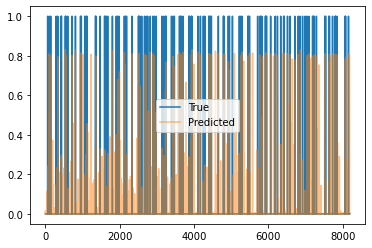

Validation Epoch: 3 [10/582 (1%)]	Loss: 0.020157	Pres: 0.069728	F1 Score: 0.026929
Validation Epoch: 3 [20/582 (3%)]	Loss: 0.018586	Pres: 0.068651	F1 Score: 0.030712
Validation Epoch: 3 [30/582 (5%)]	Loss: 0.023068	Pres: 0.069643	F1 Score: 0.024817
Validation Epoch: 3 [40/582 (6%)]	Loss: 0.021622	Pres: 0.066112	F1 Score: 0.023974
Validation Epoch: 3 [50/582 (8%)]	Loss: 0.021360	Pres: 0.070215	F1 Score: 0.028800
Validation Epoch: 3 [60/582 (10%)]	Loss: 0.017042	Pres: 0.069903	F1 Score: 0.031753
Validation Epoch: 3 [70/582 (12%)]	Loss: 0.023373	Pres: 0.057913	F1 Score: 0.021123
Validation Epoch: 3 [80/582 (13%)]	Loss: 0.021018	Pres: 0.061348	F1 Score: 0.026990
Validation Epoch: 3 [90/582 (15%)]	Loss: 0.021494	Pres: 0.070919	F1 Score: 0.029051
Validation Epoch: 3 [100/582 (17%)]	Loss: 0.021388	Pres: 0.067283	F1 Score: 0.026767
Validation Epoch: 3 [110/582 (18%)]	Loss: 0.021706	Pres: 0.066286	F1 Score: 0.028655
Validation Epoch: 3 [120/582 (20%)]	Loss: 0.021935	Pres: 0.059788	F1 Score: 0.0

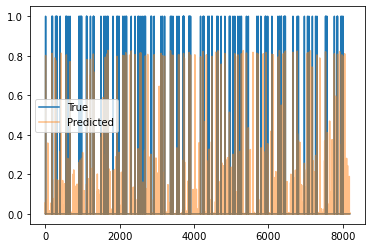

Validation Epoch: 3 [310/582 (53%)]	Loss: 0.020951	Pres: 0.071525	F1 Score: 0.029794
Validation Epoch: 3 [320/582 (54%)]	Loss: 0.020792	Pres: 0.069826	F1 Score: 0.021740
Validation Epoch: 3 [330/582 (56%)]	Loss: 0.021422	Pres: 0.061224	F1 Score: 0.025881
Validation Epoch: 3 [340/582 (58%)]	Loss: 0.019372	Pres: 0.068927	F1 Score: 0.027955
Validation Epoch: 3 [350/582 (60%)]	Loss: 0.021279	Pres: 0.063686	F1 Score: 0.027399
Validation Epoch: 3 [360/582 (61%)]	Loss: 0.020505	Pres: 0.063839	F1 Score: 0.029523
Validation Epoch: 3 [370/582 (63%)]	Loss: 0.023592	Pres: 0.072539	F1 Score: 0.024516
Validation Epoch: 3 [380/582 (65%)]	Loss: 0.022428	Pres: 0.059667	F1 Score: 0.025704
Validation Epoch: 3 [390/582 (67%)]	Loss: 0.018805	Pres: 0.053299	F1 Score: 0.027844
Validation Epoch: 3 [400/582 (68%)]	Loss: 0.020922	Pres: 0.060808	F1 Score: 0.026924
Validation Epoch: 3 [410/582 (70%)]	Loss: 0.022064	Pres: 0.056948	F1 Score: 0.025649
Validation Epoch: 3 [420/582 (72%)]	Loss: 0.019850	Pres: 0.062771

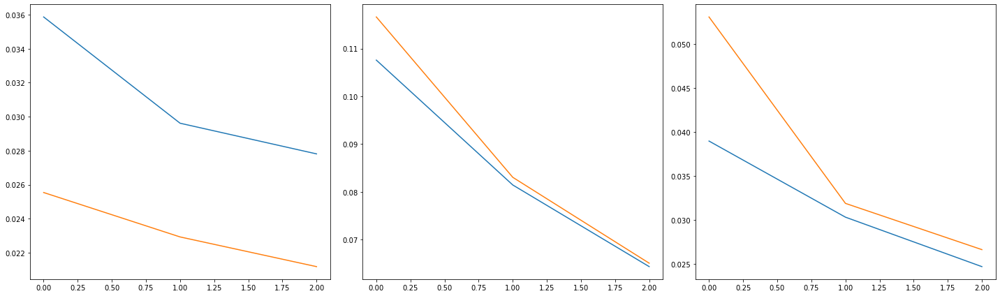

2220 582
Train Epoch: 4 [0/2220 (0%)]	Loss: 0.025830	Pres: 0.054129	F1 Score: 0.024504
105.0 -inf


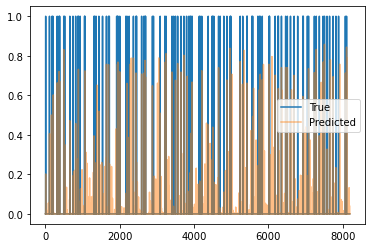

Train Epoch: 4 [10/2220 (0%)]	Loss: 0.027701	Pres: 0.067595	F1 Score: 0.022941
Train Epoch: 4 [20/2220 (0%)]	Loss: 0.029219	Pres: 0.055705	F1 Score: 0.019982
Train Epoch: 4 [30/2220 (1%)]	Loss: 0.026875	Pres: 0.058791	F1 Score: 0.021375
Train Epoch: 4 [40/2220 (1%)]	Loss: 0.027366	Pres: 0.070952	F1 Score: 0.023546
Train Epoch: 4 [50/2220 (2%)]	Loss: 0.026857	Pres: 0.054402	F1 Score: 0.020600
Train Epoch: 4 [60/2220 (2%)]	Loss: 0.025599	Pres: 0.064133	F1 Score: 0.028341
Train Epoch: 4 [70/2220 (3%)]	Loss: 0.024715	Pres: 0.063883	F1 Score: 0.028112
Train Epoch: 4 [80/2220 (3%)]	Loss: 0.027007	Pres: 0.060112	F1 Score: 0.021585
Train Epoch: 4 [90/2220 (4%)]	Loss: 0.025978	Pres: 0.064460	F1 Score: 0.025471
Train Epoch: 4 [100/2220 (4%)]	Loss: 0.027957	Pres: 0.053563	F1 Score: 0.016976
Train Epoch: 4 [110/2220 (4%)]	Loss: 0.026500	Pres: 0.055988	F1 Score: 0.024116
Train Epoch: 4 [120/2220 (5%)]	Loss: 0.028366	Pres: 0.061147	F1 Score: 0.022554
Train Epoch: 4 [130/2220 (5%)]	Loss: 0.027479	Pre

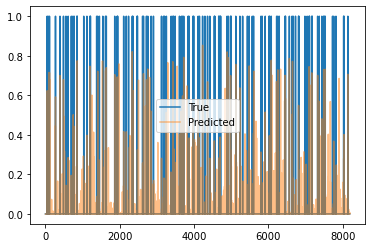

Train Epoch: 4 [310/2220 (13%)]	Loss: 0.025487	Pres: 0.059833	F1 Score: 0.023161
Train Epoch: 4 [320/2220 (14%)]	Loss: 0.026539	Pres: 0.059630	F1 Score: 0.023409
Train Epoch: 4 [330/2220 (14%)]	Loss: 0.028500	Pres: 0.062713	F1 Score: 0.022551
Train Epoch: 4 [340/2220 (15%)]	Loss: 0.027781	Pres: 0.060585	F1 Score: 0.025548
Train Epoch: 4 [350/2220 (15%)]	Loss: 0.026567	Pres: 0.058318	F1 Score: 0.024477
Train Epoch: 4 [360/2220 (16%)]	Loss: 0.023805	Pres: 0.052407	F1 Score: 0.022466
Train Epoch: 4 [370/2220 (16%)]	Loss: 0.024301	Pres: 0.053081	F1 Score: 0.022872
Train Epoch: 4 [380/2220 (17%)]	Loss: 0.029315	Pres: 0.059758	F1 Score: 0.022174
Train Epoch: 4 [390/2220 (17%)]	Loss: 0.030508	Pres: 0.058877	F1 Score: 0.021474
Train Epoch: 4 [400/2220 (18%)]	Loss: 0.028620	Pres: 0.057957	F1 Score: 0.019136
Train Epoch: 4 [410/2220 (18%)]	Loss: 0.028124	Pres: 0.054902	F1 Score: 0.022668
Train Epoch: 4 [420/2220 (18%)]	Loss: 0.035955	Pres: 0.055937	F1 Score: 0.016103
Train Epoch: 4 [430/2220 (19

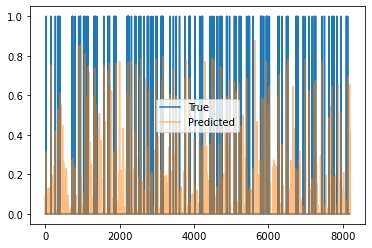

Train Epoch: 4 [610/2220 (27%)]	Loss: 0.023529	Pres: 0.060759	F1 Score: 0.022722
Train Epoch: 4 [620/2220 (27%)]	Loss: 0.028489	Pres: 0.053700	F1 Score: 0.021872
Train Epoch: 4 [630/2220 (28%)]	Loss: 0.028060	Pres: 0.049716	F1 Score: 0.018779
Train Epoch: 4 [640/2220 (28%)]	Loss: 0.023754	Pres: 0.061765	F1 Score: 0.028643
Train Epoch: 4 [650/2220 (29%)]	Loss: 0.025671	Pres: 0.056324	F1 Score: 0.023162
Train Epoch: 4 [660/2220 (29%)]	Loss: 0.027709	Pres: 0.064076	F1 Score: 0.022271
Train Epoch: 4 [670/2220 (30%)]	Loss: 0.024643	Pres: 0.062075	F1 Score: 0.025862
Train Epoch: 4 [680/2220 (30%)]	Loss: 0.025963	Pres: 0.055682	F1 Score: 0.018671
Train Epoch: 4 [690/2220 (31%)]	Loss: 0.026921	Pres: 0.052858	F1 Score: 0.019786
Train Epoch: 4 [700/2220 (31%)]	Loss: 0.026857	Pres: 0.047336	F1 Score: 0.021345
Train Epoch: 4 [710/2220 (31%)]	Loss: 0.025264	Pres: 0.055813	F1 Score: 0.022283
Train Epoch: 4 [720/2220 (32%)]	Loss: 0.028707	Pres: 0.050498	F1 Score: 0.019128
Train Epoch: 4 [730/2220 (32

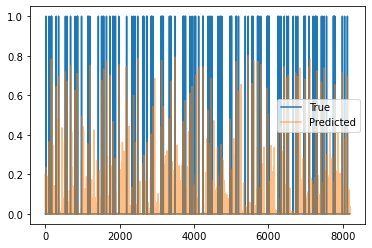

Train Epoch: 4 [910/2220 (40%)]	Loss: 0.029128	Pres: 0.051248	F1 Score: 0.020001
Train Epoch: 4 [920/2220 (41%)]	Loss: 0.029478	Pres: 0.060359	F1 Score: 0.018093
Train Epoch: 4 [930/2220 (41%)]	Loss: 0.026601	Pres: 0.060698	F1 Score: 0.024064
Train Epoch: 4 [940/2220 (42%)]	Loss: 0.028529	Pres: 0.059043	F1 Score: 0.022941
Train Epoch: 4 [950/2220 (42%)]	Loss: 0.028460	Pres: 0.057490	F1 Score: 0.021384
Train Epoch: 4 [960/2220 (43%)]	Loss: 0.027613	Pres: 0.054595	F1 Score: 0.020286
Train Epoch: 4 [970/2220 (43%)]	Loss: 0.028766	Pres: 0.051743	F1 Score: 0.017008
Train Epoch: 4 [980/2220 (44%)]	Loss: 0.024906	Pres: 0.049523	F1 Score: 0.024265
Train Epoch: 4 [990/2220 (44%)]	Loss: 0.025037	Pres: 0.058291	F1 Score: 0.022511
Train Epoch: 4 [1000/2220 (45%)]	Loss: 0.026364	Pres: 0.061553	F1 Score: 0.021231
Train Epoch: 4 [1010/2220 (45%)]	Loss: 0.023643	Pres: 0.057835	F1 Score: 0.026295
Train Epoch: 4 [1020/2220 (45%)]	Loss: 0.028880	Pres: 0.064742	F1 Score: 0.023882
Train Epoch: 4 [1030/2220

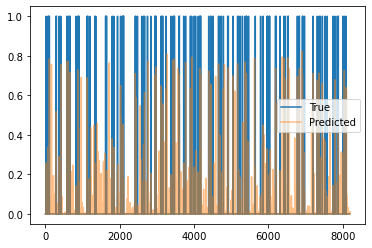

Train Epoch: 4 [1210/2220 (54%)]	Loss: 0.024654	Pres: 0.051251	F1 Score: 0.019874
Train Epoch: 4 [1220/2220 (54%)]	Loss: 0.025319	Pres: 0.054593	F1 Score: 0.023321
Train Epoch: 4 [1230/2220 (55%)]	Loss: 0.030147	Pres: 0.056438	F1 Score: 0.018610
Train Epoch: 4 [1240/2220 (55%)]	Loss: 0.025582	Pres: 0.049179	F1 Score: 0.019546
Train Epoch: 4 [1250/2220 (56%)]	Loss: 0.025054	Pres: 0.041800	F1 Score: 0.020164
Train Epoch: 4 [1260/2220 (56%)]	Loss: 0.029300	Pres: 0.055281	F1 Score: 0.021267
Train Epoch: 4 [1270/2220 (57%)]	Loss: 0.025225	Pres: 0.058606	F1 Score: 0.020983
Train Epoch: 4 [1280/2220 (57%)]	Loss: 0.028092	Pres: 0.058177	F1 Score: 0.021752
Train Epoch: 4 [1290/2220 (58%)]	Loss: 0.025739	Pres: 0.053615	F1 Score: 0.020183
Train Epoch: 4 [1300/2220 (58%)]	Loss: 0.025715	Pres: 0.046468	F1 Score: 0.022969
Train Epoch: 4 [1310/2220 (59%)]	Loss: 0.026078	Pres: 0.056633	F1 Score: 0.021380
Train Epoch: 4 [1320/2220 (59%)]	Loss: 0.028031	Pres: 0.056818	F1 Score: 0.020191
Train Epoch: 4 [

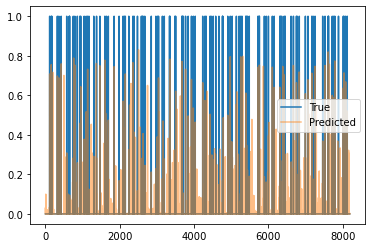

Train Epoch: 4 [1510/2220 (68%)]	Loss: 0.030356	Pres: 0.052197	F1 Score: 0.018403
Train Epoch: 4 [1520/2220 (68%)]	Loss: 0.025432	Pres: 0.055199	F1 Score: 0.022610
Train Epoch: 4 [1530/2220 (68%)]	Loss: 0.029633	Pres: 0.057091	F1 Score: 0.018834
Train Epoch: 4 [1540/2220 (69%)]	Loss: 0.026484	Pres: 0.066363	F1 Score: 0.023250
Train Epoch: 4 [1550/2220 (69%)]	Loss: 0.025850	Pres: 0.047786	F1 Score: 0.018904
Train Epoch: 4 [1560/2220 (70%)]	Loss: 0.026577	Pres: 0.044320	F1 Score: 0.019405
Train Epoch: 4 [1570/2220 (70%)]	Loss: 0.025139	Pres: 0.047435	F1 Score: 0.019963
Train Epoch: 4 [1580/2220 (71%)]	Loss: 0.023559	Pres: 0.047701	F1 Score: 0.021403
Train Epoch: 4 [1590/2220 (71%)]	Loss: 0.025562	Pres: 0.051157	F1 Score: 0.021028
Train Epoch: 4 [1600/2220 (72%)]	Loss: 0.025675	Pres: 0.054555	F1 Score: 0.022358
Train Epoch: 4 [1610/2220 (72%)]	Loss: 0.029125	Pres: 0.055773	F1 Score: 0.022697
Train Epoch: 4 [1620/2220 (72%)]	Loss: 0.025520	Pres: 0.058205	F1 Score: 0.022339
Train Epoch: 4 [

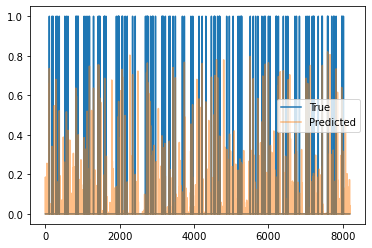

Train Epoch: 4 [1810/2220 (81%)]	Loss: 0.025279	Pres: 0.057753	F1 Score: 0.020392
Train Epoch: 4 [1820/2220 (81%)]	Loss: 0.027016	Pres: 0.053258	F1 Score: 0.020838
Train Epoch: 4 [1830/2220 (82%)]	Loss: 0.023491	Pres: 0.056903	F1 Score: 0.022151
Train Epoch: 4 [1840/2220 (82%)]	Loss: 0.025462	Pres: 0.060367	F1 Score: 0.025477
Train Epoch: 4 [1850/2220 (83%)]	Loss: 0.027444	Pres: 0.050901	F1 Score: 0.017937
Train Epoch: 4 [1860/2220 (83%)]	Loss: 0.026856	Pres: 0.054746	F1 Score: 0.021117
Train Epoch: 4 [1870/2220 (84%)]	Loss: 0.028135	Pres: 0.061422	F1 Score: 0.021821
Train Epoch: 4 [1880/2220 (84%)]	Loss: 0.025008	Pres: 0.049853	F1 Score: 0.021492
Train Epoch: 4 [1890/2220 (85%)]	Loss: 0.027664	Pres: 0.052124	F1 Score: 0.019643
Train Epoch: 4 [1900/2220 (85%)]	Loss: 0.023302	Pres: 0.056043	F1 Score: 0.024937
Train Epoch: 4 [1910/2220 (86%)]	Loss: 0.025751	Pres: 0.055708	F1 Score: 0.021818
Train Epoch: 4 [1920/2220 (86%)]	Loss: 0.029197	Pres: 0.054162	F1 Score: 0.018048
Train Epoch: 4 [

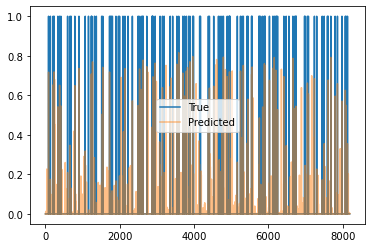

Train Epoch: 4 [2110/2220 (95%)]	Loss: 0.024940	Pres: 0.052476	F1 Score: 0.023515
Train Epoch: 4 [2120/2220 (95%)]	Loss: 0.022130	Pres: 0.050972	F1 Score: 0.023501
Train Epoch: 4 [2130/2220 (95%)]	Loss: 0.026840	Pres: 0.059028	F1 Score: 0.021433
Train Epoch: 4 [2140/2220 (96%)]	Loss: 0.027354	Pres: 0.059239	F1 Score: 0.021628
Train Epoch: 4 [2150/2220 (96%)]	Loss: 0.027253	Pres: 0.046425	F1 Score: 0.018085
Train Epoch: 4 [2160/2220 (97%)]	Loss: 0.023076	Pres: 0.051773	F1 Score: 0.023804
Train Epoch: 4 [2170/2220 (97%)]	Loss: 0.025885	Pres: 0.059750	F1 Score: 0.023788
Train Epoch: 4 [2180/2220 (98%)]	Loss: 0.022905	Pres: 0.041718	F1 Score: 0.021078
Train Epoch: 4 [2190/2220 (98%)]	Loss: 0.021115	Pres: 0.054107	F1 Score: 0.024400
Train Epoch: 4 [2200/2220 (99%)]	Loss: 0.025399	Pres: 0.053654	F1 Score: 0.021559
Train Epoch: 4 [2210/2220 (99%)]	Loss: 0.024895	Pres: 0.051943	F1 Score: 0.023306
Validation Epoch: 4 [0/582 (0%)]	Loss: 0.020814	Pres: 0.050214	F1 Score: 0.021591


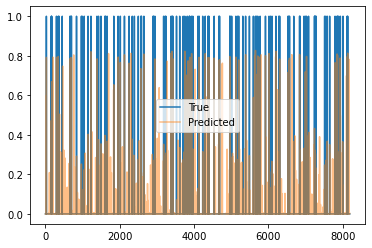

Validation Epoch: 4 [10/582 (1%)]	Loss: 0.022515	Pres: 0.050519	F1 Score: 0.018637
Validation Epoch: 4 [20/582 (3%)]	Loss: 0.022518	Pres: 0.044534	F1 Score: 0.019735
Validation Epoch: 4 [30/582 (5%)]	Loss: 0.023767	Pres: 0.046419	F1 Score: 0.018567
Validation Epoch: 4 [40/582 (6%)]	Loss: 0.020971	Pres: 0.051669	F1 Score: 0.022854
Validation Epoch: 4 [50/582 (8%)]	Loss: 0.021078	Pres: 0.049162	F1 Score: 0.021556
Validation Epoch: 4 [60/582 (10%)]	Loss: 0.019487	Pres: 0.048861	F1 Score: 0.022384
Validation Epoch: 4 [70/582 (12%)]	Loss: 0.020987	Pres: 0.049061	F1 Score: 0.022486
Validation Epoch: 4 [80/582 (13%)]	Loss: 0.018922	Pres: 0.055174	F1 Score: 0.023786
Validation Epoch: 4 [90/582 (15%)]	Loss: 0.021221	Pres: 0.051981	F1 Score: 0.020781
Validation Epoch: 4 [100/582 (17%)]	Loss: 0.022130	Pres: 0.053486	F1 Score: 0.019170
Validation Epoch: 4 [110/582 (18%)]	Loss: 0.021898	Pres: 0.050055	F1 Score: 0.019569
Validation Epoch: 4 [120/582 (20%)]	Loss: 0.022352	Pres: 0.053846	F1 Score: 0.0

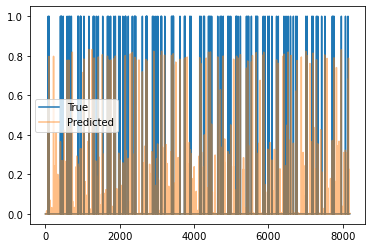

Validation Epoch: 4 [310/582 (53%)]	Loss: 0.023153	Pres: 0.051072	F1 Score: 0.018533
Validation Epoch: 4 [320/582 (54%)]	Loss: 0.019644	Pres: 0.052360	F1 Score: 0.022929
Validation Epoch: 4 [330/582 (56%)]	Loss: 0.020377	Pres: 0.058495	F1 Score: 0.021391
Validation Epoch: 4 [340/582 (58%)]	Loss: 0.019739	Pres: 0.046075	F1 Score: 0.021536
Validation Epoch: 4 [350/582 (60%)]	Loss: 0.021765	Pres: 0.051430	F1 Score: 0.021428
Validation Epoch: 4 [360/582 (61%)]	Loss: 0.020757	Pres: 0.044797	F1 Score: 0.020708
Validation Epoch: 4 [370/582 (63%)]	Loss: 0.022644	Pres: 0.051106	F1 Score: 0.021301
Validation Epoch: 4 [380/582 (65%)]	Loss: 0.020730	Pres: 0.059219	F1 Score: 0.023951
Validation Epoch: 4 [390/582 (67%)]	Loss: 0.022001	Pres: 0.040327	F1 Score: 0.016552
Validation Epoch: 4 [400/582 (68%)]	Loss: 0.021011	Pres: 0.051045	F1 Score: 0.019836
Validation Epoch: 4 [410/582 (70%)]	Loss: 0.023237	Pres: 0.056813	F1 Score: 0.019650
Validation Epoch: 4 [420/582 (72%)]	Loss: 0.019605	Pres: 0.043061

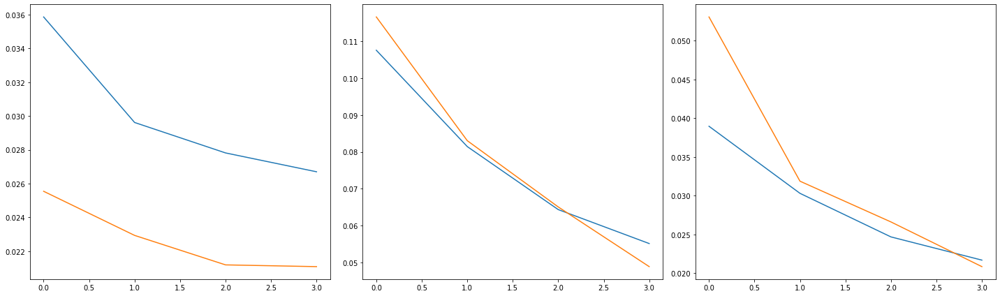

2220 582
Train Epoch: 5 [0/2220 (0%)]	Loss: 0.024426	Pres: 0.054217	F1 Score: 0.022176
112.0 -inf


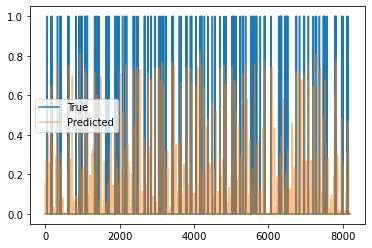

Train Epoch: 5 [10/2220 (0%)]	Loss: 0.026606	Pres: 0.048384	F1 Score: 0.019782
Train Epoch: 5 [20/2220 (0%)]	Loss: 0.031366	Pres: 0.057819	F1 Score: 0.017563
Train Epoch: 5 [30/2220 (1%)]	Loss: 0.026270	Pres: 0.054091	F1 Score: 0.021060
Train Epoch: 5 [40/2220 (1%)]	Loss: 0.024054	Pres: 0.052788	F1 Score: 0.023676
Train Epoch: 5 [50/2220 (2%)]	Loss: 0.026074	Pres: 0.047535	F1 Score: 0.016684
Train Epoch: 5 [60/2220 (2%)]	Loss: 0.029151	Pres: 0.056713	F1 Score: 0.018209
Train Epoch: 5 [70/2220 (3%)]	Loss: 0.024461	Pres: 0.048332	F1 Score: 0.021210
Train Epoch: 5 [80/2220 (3%)]	Loss: 0.025254	Pres: 0.052404	F1 Score: 0.018783
Train Epoch: 5 [90/2220 (4%)]	Loss: 0.028423	Pres: 0.055238	F1 Score: 0.022801
Train Epoch: 5 [100/2220 (4%)]	Loss: 0.025905	Pres: 0.055472	F1 Score: 0.023491
Train Epoch: 5 [110/2220 (4%)]	Loss: 0.023577	Pres: 0.049423	F1 Score: 0.023401
Train Epoch: 5 [120/2220 (5%)]	Loss: 0.026616	Pres: 0.053278	F1 Score: 0.017420
Train Epoch: 5 [130/2220 (5%)]	Loss: 0.025982	Pre

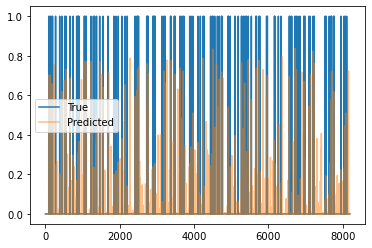

Train Epoch: 5 [310/2220 (13%)]	Loss: 0.026819	Pres: 0.050692	F1 Score: 0.020377
Train Epoch: 5 [320/2220 (14%)]	Loss: 0.028007	Pres: 0.058689	F1 Score: 0.022079
Train Epoch: 5 [330/2220 (14%)]	Loss: 0.025879	Pres: 0.056802	F1 Score: 0.023671
Train Epoch: 5 [340/2220 (15%)]	Loss: 0.022832	Pres: 0.047499	F1 Score: 0.023261
Train Epoch: 5 [350/2220 (15%)]	Loss: 0.029307	Pres: 0.044041	F1 Score: 0.014827
Train Epoch: 5 [360/2220 (16%)]	Loss: 0.026103	Pres: 0.049654	F1 Score: 0.018755
Train Epoch: 5 [370/2220 (16%)]	Loss: 0.027383	Pres: 0.058493	F1 Score: 0.024163
Train Epoch: 5 [380/2220 (17%)]	Loss: 0.025806	Pres: 0.048800	F1 Score: 0.021468
Train Epoch: 5 [390/2220 (17%)]	Loss: 0.028062	Pres: 0.062452	F1 Score: 0.024614
Train Epoch: 5 [400/2220 (18%)]	Loss: 0.025534	Pres: 0.058975	F1 Score: 0.022369
Train Epoch: 5 [410/2220 (18%)]	Loss: 0.028867	Pres: 0.043810	F1 Score: 0.019570
Train Epoch: 5 [420/2220 (18%)]	Loss: 0.025565	Pres: 0.061318	F1 Score: 0.024753
Train Epoch: 5 [430/2220 (19

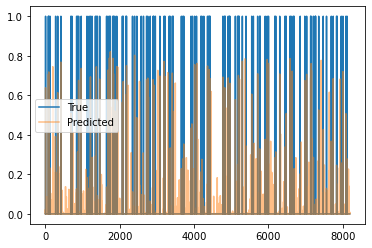

Train Epoch: 5 [610/2220 (27%)]	Loss: 0.027029	Pres: 0.041654	F1 Score: 0.019358
Train Epoch: 5 [620/2220 (27%)]	Loss: 0.025951	Pres: 0.047235	F1 Score: 0.020324
Train Epoch: 5 [630/2220 (28%)]	Loss: 0.023454	Pres: 0.054194	F1 Score: 0.021683
Train Epoch: 5 [640/2220 (28%)]	Loss: 0.026490	Pres: 0.054221	F1 Score: 0.023854
Train Epoch: 5 [650/2220 (29%)]	Loss: 0.029523	Pres: 0.051746	F1 Score: 0.020217
Train Epoch: 5 [660/2220 (29%)]	Loss: 0.024233	Pres: 0.058649	F1 Score: 0.025335
Train Epoch: 5 [670/2220 (30%)]	Loss: 0.032224	Pres: 0.050512	F1 Score: 0.017454
Train Epoch: 5 [680/2220 (30%)]	Loss: 0.025289	Pres: 0.045968	F1 Score: 0.020493
Train Epoch: 5 [690/2220 (31%)]	Loss: 0.028871	Pres: 0.057847	F1 Score: 0.021455
Train Epoch: 5 [700/2220 (31%)]	Loss: 0.026297	Pres: 0.047319	F1 Score: 0.020472
Train Epoch: 5 [710/2220 (31%)]	Loss: 0.028916	Pres: 0.051468	F1 Score: 0.018538
Train Epoch: 5 [720/2220 (32%)]	Loss: 0.025534	Pres: 0.062967	F1 Score: 0.026114
Train Epoch: 5 [730/2220 (32

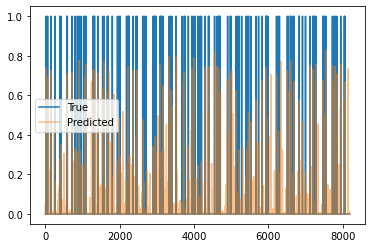

Train Epoch: 5 [910/2220 (40%)]	Loss: 0.023510	Pres: 0.047205	F1 Score: 0.023157
Train Epoch: 5 [920/2220 (41%)]	Loss: 0.023078	Pres: 0.056781	F1 Score: 0.025674
Train Epoch: 5 [930/2220 (41%)]	Loss: 0.027241	Pres: 0.048653	F1 Score: 0.017110
Train Epoch: 5 [940/2220 (42%)]	Loss: 0.025930	Pres: 0.040191	F1 Score: 0.018738
Train Epoch: 5 [950/2220 (42%)]	Loss: 0.023963	Pres: 0.053482	F1 Score: 0.021453
Train Epoch: 5 [960/2220 (43%)]	Loss: 0.026610	Pres: 0.050640	F1 Score: 0.021764
Train Epoch: 5 [970/2220 (43%)]	Loss: 0.026901	Pres: 0.057073	F1 Score: 0.021341
Train Epoch: 5 [980/2220 (44%)]	Loss: 0.026759	Pres: 0.045953	F1 Score: 0.015700
Train Epoch: 5 [990/2220 (44%)]	Loss: 0.025793	Pres: 0.048311	F1 Score: 0.021109
Train Epoch: 5 [1000/2220 (45%)]	Loss: 0.027692	Pres: 0.045991	F1 Score: 0.016862
Train Epoch: 5 [1010/2220 (45%)]	Loss: 0.023128	Pres: 0.064263	F1 Score: 0.025484
Train Epoch: 5 [1020/2220 (45%)]	Loss: 0.029413	Pres: 0.053878	F1 Score: 0.016412
Train Epoch: 5 [1030/2220

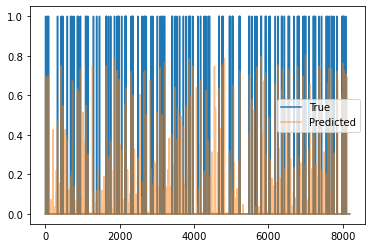

Train Epoch: 5 [1210/2220 (54%)]	Loss: 0.027082	Pres: 0.052899	F1 Score: 0.019686
Train Epoch: 5 [1220/2220 (54%)]	Loss: 0.024428	Pres: 0.046822	F1 Score: 0.021337
Train Epoch: 5 [1230/2220 (55%)]	Loss: 0.026923	Pres: 0.051409	F1 Score: 0.017090
Train Epoch: 5 [1240/2220 (55%)]	Loss: 0.026501	Pres: 0.054257	F1 Score: 0.022395
Train Epoch: 5 [1250/2220 (56%)]	Loss: 0.029126	Pres: 0.048169	F1 Score: 0.018435
Train Epoch: 5 [1260/2220 (56%)]	Loss: 0.027276	Pres: 0.048331	F1 Score: 0.018427
Train Epoch: 5 [1270/2220 (57%)]	Loss: 0.023062	Pres: 0.051339	F1 Score: 0.020861
Train Epoch: 5 [1280/2220 (57%)]	Loss: 0.026810	Pres: 0.050379	F1 Score: 0.019395
Train Epoch: 5 [1290/2220 (58%)]	Loss: 0.024929	Pres: 0.050235	F1 Score: 0.020339
Train Epoch: 5 [1300/2220 (58%)]	Loss: 0.026132	Pres: 0.049162	F1 Score: 0.022746
Train Epoch: 5 [1310/2220 (59%)]	Loss: 0.024294	Pres: 0.039002	F1 Score: 0.019326
Train Epoch: 5 [1320/2220 (59%)]	Loss: 0.027039	Pres: 0.046923	F1 Score: 0.017865
Train Epoch: 5 [

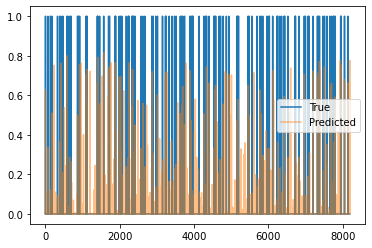

Train Epoch: 5 [1510/2220 (68%)]	Loss: 0.027392	Pres: 0.044399	F1 Score: 0.019589
Train Epoch: 5 [1520/2220 (68%)]	Loss: 0.024551	Pres: 0.047556	F1 Score: 0.019954
Train Epoch: 5 [1530/2220 (68%)]	Loss: 0.028810	Pres: 0.051729	F1 Score: 0.018398
Train Epoch: 5 [1540/2220 (69%)]	Loss: 0.025773	Pres: 0.052619	F1 Score: 0.018641
Train Epoch: 5 [1550/2220 (69%)]	Loss: 0.027315	Pres: 0.048691	F1 Score: 0.019453
Train Epoch: 5 [1560/2220 (70%)]	Loss: 0.027688	Pres: 0.048643	F1 Score: 0.018935
Train Epoch: 5 [1570/2220 (70%)]	Loss: 0.025362	Pres: 0.059750	F1 Score: 0.023765
Train Epoch: 5 [1580/2220 (71%)]	Loss: 0.027143	Pres: 0.054091	F1 Score: 0.020122
Train Epoch: 5 [1590/2220 (71%)]	Loss: 0.030058	Pres: 0.050430	F1 Score: 0.018580
Train Epoch: 5 [1600/2220 (72%)]	Loss: 0.028393	Pres: 0.053355	F1 Score: 0.017296
Train Epoch: 5 [1610/2220 (72%)]	Loss: 0.025299	Pres: 0.051432	F1 Score: 0.022784
Train Epoch: 5 [1620/2220 (72%)]	Loss: 0.027368	Pres: 0.052646	F1 Score: 0.020270
Train Epoch: 5 [

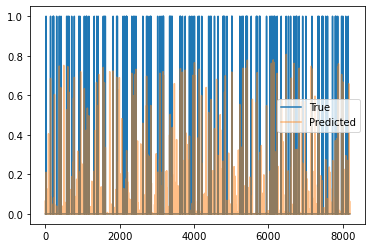

Train Epoch: 5 [1810/2220 (81%)]	Loss: 0.027746	Pres: 0.050175	F1 Score: 0.019728
Train Epoch: 5 [1820/2220 (81%)]	Loss: 0.025274	Pres: 0.048281	F1 Score: 0.020996
Train Epoch: 5 [1830/2220 (82%)]	Loss: 0.025036	Pres: 0.047705	F1 Score: 0.022636
Train Epoch: 5 [1840/2220 (82%)]	Loss: 0.028804	Pres: 0.060333	F1 Score: 0.020105
Train Epoch: 5 [1850/2220 (83%)]	Loss: 0.026374	Pres: 0.061777	F1 Score: 0.021752
Train Epoch: 5 [1860/2220 (83%)]	Loss: 0.025408	Pres: 0.048364	F1 Score: 0.019318
Train Epoch: 5 [1870/2220 (84%)]	Loss: 0.026282	Pres: 0.053475	F1 Score: 0.020132
Train Epoch: 5 [1880/2220 (84%)]	Loss: 0.026038	Pres: 0.044947	F1 Score: 0.018639
Train Epoch: 5 [1890/2220 (85%)]	Loss: 0.027674	Pres: 0.056613	F1 Score: 0.022146
Train Epoch: 5 [1900/2220 (85%)]	Loss: 0.024251	Pres: 0.054296	F1 Score: 0.023129
Train Epoch: 5 [1910/2220 (86%)]	Loss: 0.024812	Pres: 0.061180	F1 Score: 0.025601
Train Epoch: 5 [1920/2220 (86%)]	Loss: 0.030943	Pres: 0.055911	F1 Score: 0.018448
Train Epoch: 5 [

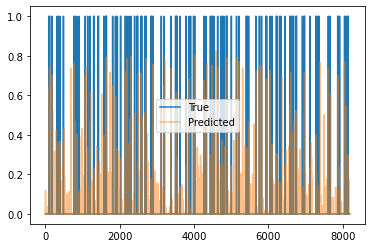

Train Epoch: 5 [2110/2220 (95%)]	Loss: 0.026098	Pres: 0.053333	F1 Score: 0.022597
Train Epoch: 5 [2120/2220 (95%)]	Loss: 0.025905	Pres: 0.054195	F1 Score: 0.020845
Train Epoch: 5 [2130/2220 (95%)]	Loss: 0.023189	Pres: 0.055400	F1 Score: 0.024880
Train Epoch: 5 [2140/2220 (96%)]	Loss: 0.027624	Pres: 0.051024	F1 Score: 0.021627
Train Epoch: 5 [2150/2220 (96%)]	Loss: 0.024541	Pres: 0.057550	F1 Score: 0.022811
Train Epoch: 5 [2160/2220 (97%)]	Loss: 0.027295	Pres: 0.053562	F1 Score: 0.020352
Train Epoch: 5 [2170/2220 (97%)]	Loss: 0.023947	Pres: 0.053681	F1 Score: 0.022076
Train Epoch: 5 [2180/2220 (98%)]	Loss: 0.025002	Pres: 0.064089	F1 Score: 0.023733
Train Epoch: 5 [2190/2220 (98%)]	Loss: 0.026022	Pres: 0.052421	F1 Score: 0.018600
Train Epoch: 5 [2200/2220 (99%)]	Loss: 0.026022	Pres: 0.047428	F1 Score: 0.019602
Train Epoch: 5 [2210/2220 (99%)]	Loss: 0.026321	Pres: 0.050190	F1 Score: 0.021106
Validation Epoch: 5 [0/582 (0%)]	Loss: 0.022645	Pres: 0.055876	F1 Score: 0.019406


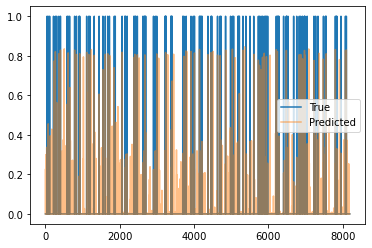

Validation Epoch: 5 [10/582 (1%)]	Loss: 0.020778	Pres: 0.053977	F1 Score: 0.019111
Validation Epoch: 5 [20/582 (3%)]	Loss: 0.021565	Pres: 0.055354	F1 Score: 0.019001
Validation Epoch: 5 [30/582 (5%)]	Loss: 0.021095	Pres: 0.063342	F1 Score: 0.022748
Validation Epoch: 5 [40/582 (6%)]	Loss: 0.019459	Pres: 0.055966	F1 Score: 0.021218
Validation Epoch: 5 [50/582 (8%)]	Loss: 0.022211	Pres: 0.051551	F1 Score: 0.021454
Validation Epoch: 5 [60/582 (10%)]	Loss: 0.021722	Pres: 0.046111	F1 Score: 0.018712
Validation Epoch: 5 [70/582 (12%)]	Loss: 0.019166	Pres: 0.044537	F1 Score: 0.018792
Validation Epoch: 5 [80/582 (13%)]	Loss: 0.020378	Pres: 0.054555	F1 Score: 0.021021
Validation Epoch: 5 [90/582 (15%)]	Loss: 0.022995	Pres: 0.057955	F1 Score: 0.017451
Validation Epoch: 5 [100/582 (17%)]	Loss: 0.022233	Pres: 0.063262	F1 Score: 0.021553
Validation Epoch: 5 [110/582 (18%)]	Loss: 0.022469	Pres: 0.061041	F1 Score: 0.021168
Validation Epoch: 5 [120/582 (20%)]	Loss: 0.020982	Pres: 0.056301	F1 Score: 0.0

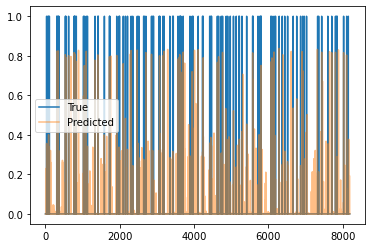

Validation Epoch: 5 [310/582 (53%)]	Loss: 0.021800	Pres: 0.045006	F1 Score: 0.019166
Validation Epoch: 5 [320/582 (54%)]	Loss: 0.022119	Pres: 0.055083	F1 Score: 0.019156
Validation Epoch: 5 [330/582 (56%)]	Loss: 0.019784	Pres: 0.068720	F1 Score: 0.024023
Validation Epoch: 5 [340/582 (58%)]	Loss: 0.022363	Pres: 0.054193	F1 Score: 0.018766
Validation Epoch: 5 [350/582 (60%)]	Loss: 0.021987	Pres: 0.051396	F1 Score: 0.018190
Validation Epoch: 5 [360/582 (61%)]	Loss: 0.017142	Pres: 0.056023	F1 Score: 0.022263
Validation Epoch: 5 [370/582 (63%)]	Loss: 0.021175	Pres: 0.060529	F1 Score: 0.020396
Validation Epoch: 5 [380/582 (65%)]	Loss: 0.022548	Pres: 0.057213	F1 Score: 0.020241
Validation Epoch: 5 [390/582 (67%)]	Loss: 0.022408	Pres: 0.056337	F1 Score: 0.016566
Validation Epoch: 5 [400/582 (68%)]	Loss: 0.021055	Pres: 0.047114	F1 Score: 0.018508
Validation Epoch: 5 [410/582 (70%)]	Loss: 0.021616	Pres: 0.057330	F1 Score: 0.019633
Validation Epoch: 5 [420/582 (72%)]	Loss: 0.020731	Pres: 0.051812

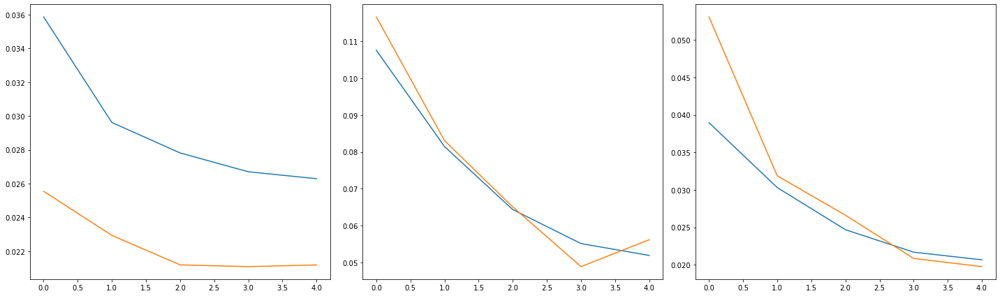

2220 582
Train Epoch: 6 [0/2220 (0%)]	Loss: 0.028876	Pres: 0.050725	F1 Score: 0.018041
108.0 -inf


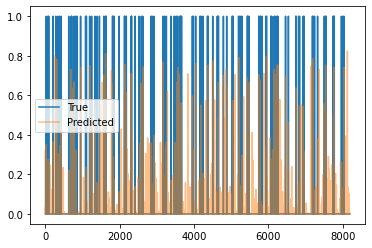

Train Epoch: 6 [10/2220 (0%)]	Loss: 0.027490	Pres: 0.057014	F1 Score: 0.019548
Train Epoch: 6 [20/2220 (0%)]	Loss: 0.029145	Pres: 0.056138	F1 Score: 0.020366
Train Epoch: 6 [30/2220 (1%)]	Loss: 0.025327	Pres: 0.049517	F1 Score: 0.021540
Train Epoch: 6 [40/2220 (1%)]	Loss: 0.030011	Pres: 0.051875	F1 Score: 0.018734
Train Epoch: 6 [50/2220 (2%)]	Loss: 0.023426	Pres: 0.056569	F1 Score: 0.023816
Train Epoch: 6 [60/2220 (2%)]	Loss: 0.026262	Pres: 0.053160	F1 Score: 0.022769
Train Epoch: 6 [70/2220 (3%)]	Loss: 0.026023	Pres: 0.049758	F1 Score: 0.019387
Train Epoch: 6 [80/2220 (3%)]	Loss: 0.022355	Pres: 0.053157	F1 Score: 0.020707
Train Epoch: 6 [90/2220 (4%)]	Loss: 0.025228	Pres: 0.052141	F1 Score: 0.023012
Train Epoch: 6 [100/2220 (4%)]	Loss: 0.024906	Pres: 0.051010	F1 Score: 0.021515
Train Epoch: 6 [110/2220 (4%)]	Loss: 0.029540	Pres: 0.042400	F1 Score: 0.016216
Train Epoch: 6 [120/2220 (5%)]	Loss: 0.026653	Pres: 0.056647	F1 Score: 0.019956
Train Epoch: 6 [130/2220 (5%)]	Loss: 0.025982	Pre

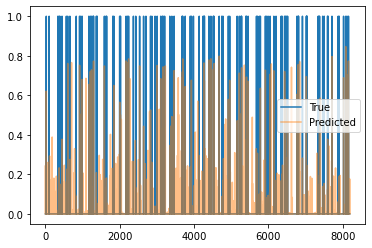

Train Epoch: 6 [310/2220 (13%)]	Loss: 0.027754	Pres: 0.051974	F1 Score: 0.015842
Train Epoch: 6 [320/2220 (14%)]	Loss: 0.025250	Pres: 0.049202	F1 Score: 0.020602
Train Epoch: 6 [330/2220 (14%)]	Loss: 0.024455	Pres: 0.061433	F1 Score: 0.024952
Train Epoch: 6 [340/2220 (15%)]	Loss: 0.027162	Pres: 0.054966	F1 Score: 0.020869
Train Epoch: 6 [350/2220 (15%)]	Loss: 0.024935	Pres: 0.051897	F1 Score: 0.021481
Train Epoch: 6 [360/2220 (16%)]	Loss: 0.024849	Pres: 0.058057	F1 Score: 0.023904
Train Epoch: 6 [370/2220 (16%)]	Loss: 0.027231	Pres: 0.051108	F1 Score: 0.019055
Train Epoch: 6 [380/2220 (17%)]	Loss: 0.028549	Pres: 0.050430	F1 Score: 0.019673
Train Epoch: 6 [390/2220 (17%)]	Loss: 0.031647	Pres: 0.045628	F1 Score: 0.016709
Train Epoch: 6 [400/2220 (18%)]	Loss: 0.025785	Pres: 0.060789	F1 Score: 0.019401
Train Epoch: 6 [410/2220 (18%)]	Loss: 0.027469	Pres: 0.042871	F1 Score: 0.018373
Train Epoch: 6 [420/2220 (18%)]	Loss: 0.027874	Pres: 0.047961	F1 Score: 0.018415
Train Epoch: 6 [430/2220 (19

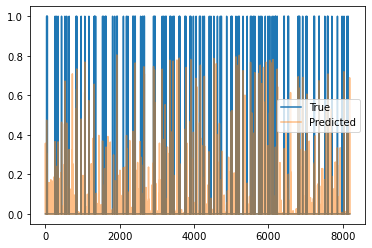

Train Epoch: 6 [610/2220 (27%)]	Loss: 0.027366	Pres: 0.053955	F1 Score: 0.020965
Train Epoch: 6 [620/2220 (27%)]	Loss: 0.030178	Pres: 0.051507	F1 Score: 0.017200
Train Epoch: 6 [630/2220 (28%)]	Loss: 0.027585	Pres: 0.051346	F1 Score: 0.018145
Train Epoch: 6 [640/2220 (28%)]	Loss: 0.021380	Pres: 0.058952	F1 Score: 0.023393
Train Epoch: 6 [650/2220 (29%)]	Loss: 0.027179	Pres: 0.050179	F1 Score: 0.018572
Train Epoch: 6 [660/2220 (29%)]	Loss: 0.023981	Pres: 0.050391	F1 Score: 0.021913
Train Epoch: 6 [670/2220 (30%)]	Loss: 0.021560	Pres: 0.050674	F1 Score: 0.023345
Train Epoch: 6 [680/2220 (30%)]	Loss: 0.028019	Pres: 0.062170	F1 Score: 0.024615
Train Epoch: 6 [690/2220 (31%)]	Loss: 0.024250	Pres: 0.053521	F1 Score: 0.021355
Train Epoch: 6 [700/2220 (31%)]	Loss: 0.025684	Pres: 0.059199	F1 Score: 0.020426
Train Epoch: 6 [710/2220 (31%)]	Loss: 0.027876	Pres: 0.049388	F1 Score: 0.017732
Train Epoch: 6 [720/2220 (32%)]	Loss: 0.028078	Pres: 0.047113	F1 Score: 0.018352
Train Epoch: 6 [730/2220 (32

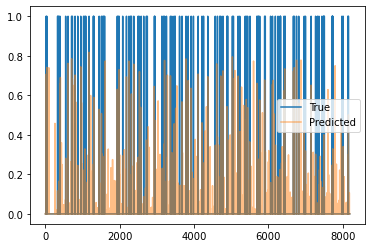

Train Epoch: 6 [910/2220 (40%)]	Loss: 0.030270	Pres: 0.049667	F1 Score: 0.015160
Train Epoch: 6 [920/2220 (41%)]	Loss: 0.030644	Pres: 0.049148	F1 Score: 0.018734
Train Epoch: 6 [930/2220 (41%)]	Loss: 0.025661	Pres: 0.052875	F1 Score: 0.019908
Train Epoch: 6 [940/2220 (42%)]	Loss: 0.025471	Pres: 0.047469	F1 Score: 0.016055
Train Epoch: 6 [950/2220 (42%)]	Loss: 0.028110	Pres: 0.049975	F1 Score: 0.019288
Train Epoch: 6 [960/2220 (43%)]	Loss: 0.030310	Pres: 0.053564	F1 Score: 0.017246
Train Epoch: 6 [970/2220 (43%)]	Loss: 0.024722	Pres: 0.048689	F1 Score: 0.019197
Train Epoch: 6 [980/2220 (44%)]	Loss: 0.027795	Pres: 0.056138	F1 Score: 0.022131
Train Epoch: 6 [990/2220 (44%)]	Loss: 0.023599	Pres: 0.052180	F1 Score: 0.021168
Train Epoch: 6 [1000/2220 (45%)]	Loss: 0.025619	Pres: 0.050476	F1 Score: 0.021537
Train Epoch: 6 [1010/2220 (45%)]	Loss: 0.031159	Pres: 0.044820	F1 Score: 0.015751
Train Epoch: 6 [1020/2220 (45%)]	Loss: 0.024487	Pres: 0.051341	F1 Score: 0.019823
Train Epoch: 6 [1030/2220

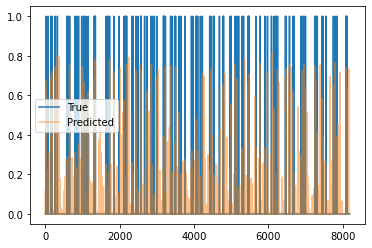

Train Epoch: 6 [1210/2220 (54%)]	Loss: 0.024862	Pres: 0.042632	F1 Score: 0.018197
Train Epoch: 6 [1220/2220 (54%)]	Loss: 0.023997	Pres: 0.048297	F1 Score: 0.021027
Train Epoch: 6 [1230/2220 (55%)]	Loss: 0.023344	Pres: 0.053977	F1 Score: 0.022912
Train Epoch: 6 [1240/2220 (55%)]	Loss: 0.024633	Pres: 0.052424	F1 Score: 0.019918
Train Epoch: 6 [1250/2220 (56%)]	Loss: 0.027589	Pres: 0.051396	F1 Score: 0.020120
Train Epoch: 6 [1260/2220 (56%)]	Loss: 0.033053	Pres: 0.046994	F1 Score: 0.016331
Train Epoch: 6 [1270/2220 (57%)]	Loss: 0.026018	Pres: 0.058333	F1 Score: 0.023266
Train Epoch: 6 [1280/2220 (57%)]	Loss: 0.028187	Pres: 0.046064	F1 Score: 0.015068
Train Epoch: 6 [1290/2220 (58%)]	Loss: 0.027004	Pres: 0.047557	F1 Score: 0.017094
Train Epoch: 6 [1300/2220 (58%)]	Loss: 0.025774	Pres: 0.049167	F1 Score: 0.018252
Train Epoch: 6 [1310/2220 (59%)]	Loss: 0.029075	Pres: 0.049517	F1 Score: 0.016905
Train Epoch: 6 [1320/2220 (59%)]	Loss: 0.029973	Pres: 0.054688	F1 Score: 0.021260
Train Epoch: 6 [

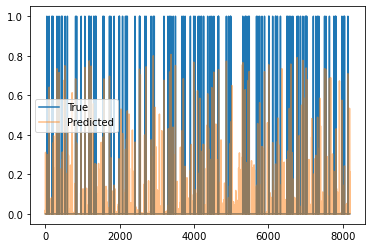

Train Epoch: 6 [1510/2220 (68%)]	Loss: 0.024966	Pres: 0.045411	F1 Score: 0.020062
Train Epoch: 6 [1520/2220 (68%)]	Loss: 0.027092	Pres: 0.045913	F1 Score: 0.017461
Train Epoch: 6 [1530/2220 (68%)]	Loss: 0.027055	Pres: 0.052000	F1 Score: 0.019280
Train Epoch: 6 [1540/2220 (69%)]	Loss: 0.025577	Pres: 0.052443	F1 Score: 0.021743
Train Epoch: 6 [1550/2220 (69%)]	Loss: 0.029228	Pres: 0.054145	F1 Score: 0.017512
Train Epoch: 6 [1560/2220 (70%)]	Loss: 0.026783	Pres: 0.041535	F1 Score: 0.016334
Train Epoch: 6 [1570/2220 (70%)]	Loss: 0.028505	Pres: 0.058407	F1 Score: 0.020428
Train Epoch: 6 [1580/2220 (71%)]	Loss: 0.025265	Pres: 0.045810	F1 Score: 0.021513
Train Epoch: 6 [1590/2220 (71%)]	Loss: 0.024905	Pres: 0.054691	F1 Score: 0.023065
Train Epoch: 6 [1600/2220 (72%)]	Loss: 0.026713	Pres: 0.047572	F1 Score: 0.019599
Train Epoch: 6 [1610/2220 (72%)]	Loss: 0.025875	Pres: 0.052359	F1 Score: 0.019679
Train Epoch: 6 [1620/2220 (72%)]	Loss: 0.025279	Pres: 0.047009	F1 Score: 0.018924
Train Epoch: 6 [

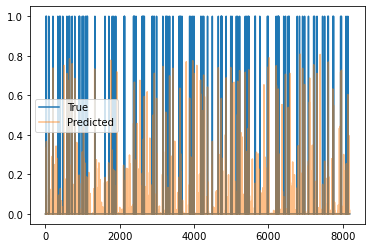

Train Epoch: 6 [1810/2220 (81%)]	Loss: 0.025531	Pres: 0.052734	F1 Score: 0.022935
Train Epoch: 6 [1820/2220 (81%)]	Loss: 0.025584	Pres: 0.051487	F1 Score: 0.021826
Train Epoch: 6 [1830/2220 (82%)]	Loss: 0.029756	Pres: 0.047028	F1 Score: 0.017495
Train Epoch: 6 [1840/2220 (82%)]	Loss: 0.025070	Pres: 0.043386	F1 Score: 0.017709
Train Epoch: 6 [1850/2220 (83%)]	Loss: 0.025514	Pres: 0.049429	F1 Score: 0.018506
Train Epoch: 6 [1860/2220 (83%)]	Loss: 0.028506	Pres: 0.051540	F1 Score: 0.018034
Train Epoch: 6 [1870/2220 (84%)]	Loss: 0.021840	Pres: 0.047210	F1 Score: 0.022491
Train Epoch: 6 [1880/2220 (84%)]	Loss: 0.027973	Pres: 0.044897	F1 Score: 0.017285
Train Epoch: 6 [1890/2220 (85%)]	Loss: 0.025534	Pres: 0.048750	F1 Score: 0.021047
Train Epoch: 6 [1900/2220 (85%)]	Loss: 0.025954	Pres: 0.043315	F1 Score: 0.019650
Train Epoch: 6 [1910/2220 (86%)]	Loss: 0.023759	Pres: 0.053170	F1 Score: 0.021996
Train Epoch: 6 [1920/2220 (86%)]	Loss: 0.024068	Pres: 0.040318	F1 Score: 0.020360
Train Epoch: 6 [

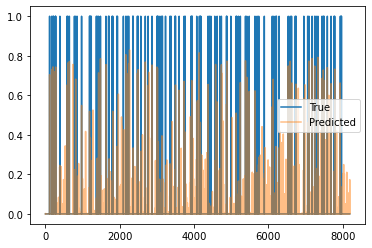

Train Epoch: 6 [2110/2220 (95%)]	Loss: 0.024359	Pres: 0.048966	F1 Score: 0.021557
Train Epoch: 6 [2120/2220 (95%)]	Loss: 0.023264	Pres: 0.047800	F1 Score: 0.018415
Train Epoch: 6 [2130/2220 (95%)]	Loss: 0.025570	Pres: 0.055928	F1 Score: 0.022156
Train Epoch: 6 [2140/2220 (96%)]	Loss: 0.023447	Pres: 0.054892	F1 Score: 0.021848
Train Epoch: 6 [2150/2220 (96%)]	Loss: 0.029107	Pres: 0.050880	F1 Score: 0.018194
Train Epoch: 6 [2160/2220 (97%)]	Loss: 0.026392	Pres: 0.047208	F1 Score: 0.019789
Train Epoch: 6 [2170/2220 (97%)]	Loss: 0.028239	Pres: 0.047718	F1 Score: 0.018058
Train Epoch: 6 [2180/2220 (98%)]	Loss: 0.028026	Pres: 0.050909	F1 Score: 0.018249
Train Epoch: 6 [2190/2220 (98%)]	Loss: 0.031407	Pres: 0.052049	F1 Score: 0.016307
Train Epoch: 6 [2200/2220 (99%)]	Loss: 0.027601	Pres: 0.045490	F1 Score: 0.016711
Train Epoch: 6 [2210/2220 (99%)]	Loss: 0.028736	Pres: 0.045547	F1 Score: 0.018271
Validation Epoch: 6 [0/582 (0%)]	Loss: 0.021213	Pres: 0.063113	F1 Score: 0.020771


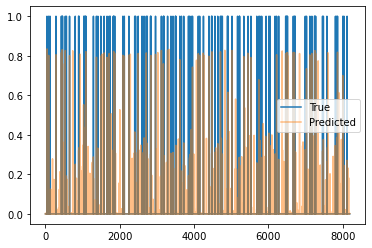

Validation Epoch: 6 [10/582 (1%)]	Loss: 0.020984	Pres: 0.055840	F1 Score: 0.024302
Validation Epoch: 6 [20/582 (3%)]	Loss: 0.021038	Pres: 0.052942	F1 Score: 0.019992
Validation Epoch: 6 [30/582 (5%)]	Loss: 0.021387	Pres: 0.064732	F1 Score: 0.023053
Validation Epoch: 6 [40/582 (6%)]	Loss: 0.020262	Pres: 0.054093	F1 Score: 0.021980
Validation Epoch: 6 [50/582 (8%)]	Loss: 0.019533	Pres: 0.056364	F1 Score: 0.022344
Validation Epoch: 6 [60/582 (10%)]	Loss: 0.022822	Pres: 0.042450	F1 Score: 0.018710
Validation Epoch: 6 [70/582 (12%)]	Loss: 0.021410	Pres: 0.050570	F1 Score: 0.020827
Validation Epoch: 6 [80/582 (13%)]	Loss: 0.020000	Pres: 0.047043	F1 Score: 0.019995
Validation Epoch: 6 [90/582 (15%)]	Loss: 0.020922	Pres: 0.064012	F1 Score: 0.023357
Validation Epoch: 6 [100/582 (17%)]	Loss: 0.022385	Pres: 0.052521	F1 Score: 0.022041
Validation Epoch: 6 [110/582 (18%)]	Loss: 0.021079	Pres: 0.053141	F1 Score: 0.020381
Validation Epoch: 6 [120/582 (20%)]	Loss: 0.022307	Pres: 0.059201	F1 Score: 0.0

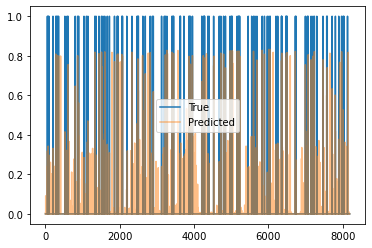

Validation Epoch: 6 [310/582 (53%)]	Loss: 0.021390	Pres: 0.060662	F1 Score: 0.023989
Validation Epoch: 6 [320/582 (54%)]	Loss: 0.021440	Pres: 0.050167	F1 Score: 0.018607
Validation Epoch: 6 [330/582 (56%)]	Loss: 0.020901	Pres: 0.065335	F1 Score: 0.021857
Validation Epoch: 6 [340/582 (58%)]	Loss: 0.021131	Pres: 0.047348	F1 Score: 0.020238
Validation Epoch: 6 [350/582 (60%)]	Loss: 0.021062	Pres: 0.049960	F1 Score: 0.019495
Validation Epoch: 6 [360/582 (61%)]	Loss: 0.022368	Pres: 0.052934	F1 Score: 0.019520
Validation Epoch: 6 [370/582 (63%)]	Loss: 0.021720	Pres: 0.053846	F1 Score: 0.023866
Validation Epoch: 6 [380/582 (65%)]	Loss: 0.021659	Pres: 0.056641	F1 Score: 0.022158
Validation Epoch: 6 [390/582 (67%)]	Loss: 0.020864	Pres: 0.051775	F1 Score: 0.020103
Validation Epoch: 6 [400/582 (68%)]	Loss: 0.020303	Pres: 0.056583	F1 Score: 0.020494
Validation Epoch: 6 [410/582 (70%)]	Loss: 0.023109	Pres: 0.054416	F1 Score: 0.016404
Validation Epoch: 6 [420/582 (72%)]	Loss: 0.020839	Pres: 0.056217

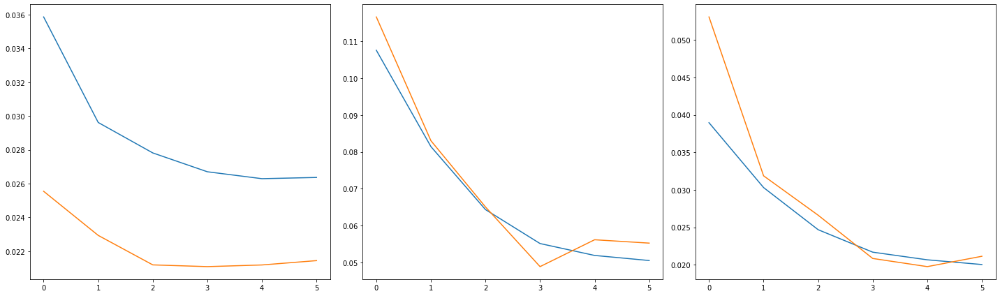

2220 582
Train Epoch: 7 [0/2220 (0%)]	Loss: 0.029332	Pres: 0.046500	F1 Score: 0.018281
108.0 -inf


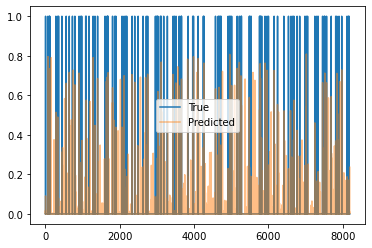

Train Epoch: 7 [10/2220 (0%)]	Loss: 0.029795	Pres: 0.046096	F1 Score: 0.017499
Train Epoch: 7 [20/2220 (0%)]	Loss: 0.026528	Pres: 0.051681	F1 Score: 0.017457
Train Epoch: 7 [30/2220 (1%)]	Loss: 0.026531	Pres: 0.051680	F1 Score: 0.018974
Train Epoch: 7 [40/2220 (1%)]	Loss: 0.028176	Pres: 0.056900	F1 Score: 0.020860
Train Epoch: 7 [50/2220 (2%)]	Loss: 0.026983	Pres: 0.052919	F1 Score: 0.018224
Train Epoch: 7 [60/2220 (2%)]	Loss: 0.027721	Pres: 0.057857	F1 Score: 0.020554
Train Epoch: 7 [70/2220 (3%)]	Loss: 0.027255	Pres: 0.054414	F1 Score: 0.021239
Train Epoch: 7 [80/2220 (3%)]	Loss: 0.024477	Pres: 0.055615	F1 Score: 0.021096
Train Epoch: 7 [90/2220 (4%)]	Loss: 0.028482	Pres: 0.054208	F1 Score: 0.018580
Train Epoch: 7 [100/2220 (4%)]	Loss: 0.026892	Pres: 0.051771	F1 Score: 0.019677
Train Epoch: 7 [110/2220 (4%)]	Loss: 0.027172	Pres: 0.053686	F1 Score: 0.020033
Train Epoch: 7 [120/2220 (5%)]	Loss: 0.030262	Pres: 0.047203	F1 Score: 0.016513
Train Epoch: 7 [130/2220 (5%)]	Loss: 0.028482	Pre

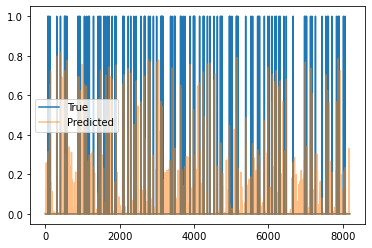

Train Epoch: 7 [310/2220 (13%)]	Loss: 0.027694	Pres: 0.048718	F1 Score: 0.018611
Train Epoch: 7 [320/2220 (14%)]	Loss: 0.025906	Pres: 0.055797	F1 Score: 0.023702
Train Epoch: 7 [330/2220 (14%)]	Loss: 0.024443	Pres: 0.044296	F1 Score: 0.019810
Train Epoch: 7 [340/2220 (15%)]	Loss: 0.027368	Pres: 0.055164	F1 Score: 0.021420
Train Epoch: 7 [350/2220 (15%)]	Loss: 0.024569	Pres: 0.057845	F1 Score: 0.022712
Train Epoch: 7 [360/2220 (16%)]	Loss: 0.028115	Pres: 0.051592	F1 Score: 0.019461
Train Epoch: 7 [370/2220 (16%)]	Loss: 0.025418	Pres: 0.053574	F1 Score: 0.021177
Train Epoch: 7 [380/2220 (17%)]	Loss: 0.025681	Pres: 0.047530	F1 Score: 0.020177
Train Epoch: 7 [390/2220 (17%)]	Loss: 0.026949	Pres: 0.050694	F1 Score: 0.018736
Train Epoch: 7 [400/2220 (18%)]	Loss: 0.027425	Pres: 0.057437	F1 Score: 0.019574
Train Epoch: 7 [410/2220 (18%)]	Loss: 0.023558	Pres: 0.045919	F1 Score: 0.019966
Train Epoch: 7 [420/2220 (18%)]	Loss: 0.024817	Pres: 0.049769	F1 Score: 0.020384
Train Epoch: 7 [430/2220 (19

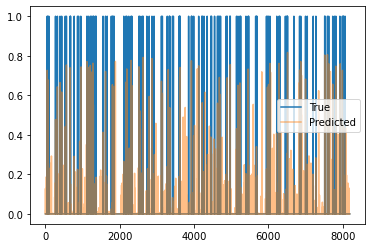

Train Epoch: 7 [610/2220 (27%)]	Loss: 0.025019	Pres: 0.053095	F1 Score: 0.021149
Train Epoch: 7 [620/2220 (27%)]	Loss: 0.027784	Pres: 0.055735	F1 Score: 0.021073
Train Epoch: 7 [630/2220 (28%)]	Loss: 0.023132	Pres: 0.050769	F1 Score: 0.022885
Train Epoch: 7 [640/2220 (28%)]	Loss: 0.025425	Pres: 0.055060	F1 Score: 0.020144
Train Epoch: 7 [650/2220 (29%)]	Loss: 0.025738	Pres: 0.052710	F1 Score: 0.019075
Train Epoch: 7 [660/2220 (29%)]	Loss: 0.026671	Pres: 0.062768	F1 Score: 0.025772
Train Epoch: 7 [670/2220 (30%)]	Loss: 0.028244	Pres: 0.048485	F1 Score: 0.017554
Train Epoch: 7 [680/2220 (30%)]	Loss: 0.029642	Pres: 0.043586	F1 Score: 0.019034
Train Epoch: 7 [690/2220 (31%)]	Loss: 0.026875	Pres: 0.056973	F1 Score: 0.020267
Train Epoch: 7 [700/2220 (31%)]	Loss: 0.028264	Pres: 0.056875	F1 Score: 0.022607
Train Epoch: 7 [710/2220 (31%)]	Loss: 0.024825	Pres: 0.051807	F1 Score: 0.019899
Train Epoch: 7 [720/2220 (32%)]	Loss: 0.029027	Pres: 0.050717	F1 Score: 0.019387
Train Epoch: 7 [730/2220 (32

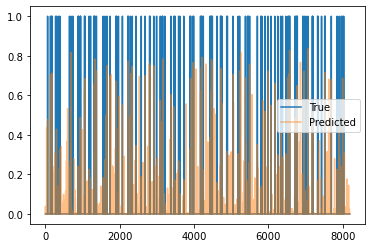

Train Epoch: 7 [910/2220 (40%)]	Loss: 0.029050	Pres: 0.051248	F1 Score: 0.016591
Train Epoch: 7 [920/2220 (41%)]	Loss: 0.026302	Pres: 0.053498	F1 Score: 0.018576
Train Epoch: 7 [930/2220 (41%)]	Loss: 0.028790	Pres: 0.043223	F1 Score: 0.015441
Train Epoch: 7 [940/2220 (42%)]	Loss: 0.026641	Pres: 0.041492	F1 Score: 0.017770
Train Epoch: 7 [950/2220 (42%)]	Loss: 0.026851	Pres: 0.041326	F1 Score: 0.016738
Train Epoch: 7 [960/2220 (43%)]	Loss: 0.027309	Pres: 0.048796	F1 Score: 0.019532
Train Epoch: 7 [970/2220 (43%)]	Loss: 0.026347	Pres: 0.049135	F1 Score: 0.018683
Train Epoch: 7 [980/2220 (44%)]	Loss: 0.023772	Pres: 0.046276	F1 Score: 0.019318
Train Epoch: 7 [990/2220 (44%)]	Loss: 0.026294	Pres: 0.046010	F1 Score: 0.021619
Train Epoch: 7 [1000/2220 (45%)]	Loss: 0.027680	Pres: 0.049610	F1 Score: 0.020636
Train Epoch: 7 [1010/2220 (45%)]	Loss: 0.024801	Pres: 0.050000	F1 Score: 0.019446
Train Epoch: 7 [1020/2220 (45%)]	Loss: 0.023730	Pres: 0.052758	F1 Score: 0.019631
Train Epoch: 7 [1030/2220

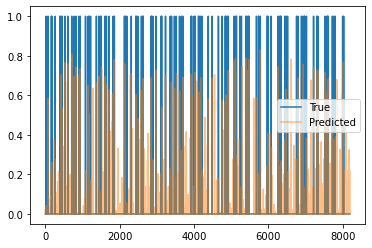

Train Epoch: 7 [1210/2220 (54%)]	Loss: 0.025076	Pres: 0.048128	F1 Score: 0.020727
Train Epoch: 7 [1220/2220 (54%)]	Loss: 0.028006	Pres: 0.046900	F1 Score: 0.017502
Train Epoch: 7 [1230/2220 (55%)]	Loss: 0.021245	Pres: 0.046634	F1 Score: 0.024952
Train Epoch: 7 [1240/2220 (55%)]	Loss: 0.025311	Pres: 0.050465	F1 Score: 0.020704
Train Epoch: 7 [1250/2220 (56%)]	Loss: 0.025682	Pres: 0.053935	F1 Score: 0.022612
Train Epoch: 7 [1260/2220 (56%)]	Loss: 0.026384	Pres: 0.047471	F1 Score: 0.018699
Train Epoch: 7 [1270/2220 (57%)]	Loss: 0.026614	Pres: 0.047727	F1 Score: 0.021078
Train Epoch: 7 [1280/2220 (57%)]	Loss: 0.029417	Pres: 0.048533	F1 Score: 0.016983
Train Epoch: 7 [1290/2220 (58%)]	Loss: 0.025785	Pres: 0.044057	F1 Score: 0.019262
Train Epoch: 7 [1300/2220 (58%)]	Loss: 0.026490	Pres: 0.052400	F1 Score: 0.021315
Train Epoch: 7 [1310/2220 (59%)]	Loss: 0.022391	Pres: 0.049254	F1 Score: 0.022421
Train Epoch: 7 [1320/2220 (59%)]	Loss: 0.028204	Pres: 0.047385	F1 Score: 0.019448
Train Epoch: 7 [

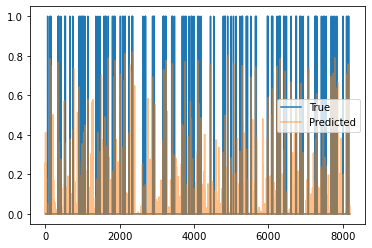

Train Epoch: 7 [1510/2220 (68%)]	Loss: 0.026693	Pres: 0.052673	F1 Score: 0.019012
Train Epoch: 7 [1520/2220 (68%)]	Loss: 0.025971	Pres: 0.049369	F1 Score: 0.018913
Train Epoch: 7 [1530/2220 (68%)]	Loss: 0.027579	Pres: 0.058837	F1 Score: 0.019889
Train Epoch: 7 [1540/2220 (69%)]	Loss: 0.029799	Pres: 0.042999	F1 Score: 0.015779
Train Epoch: 7 [1550/2220 (69%)]	Loss: 0.023294	Pres: 0.046474	F1 Score: 0.019626
Train Epoch: 7 [1560/2220 (70%)]	Loss: 0.026681	Pres: 0.042599	F1 Score: 0.016139
Train Epoch: 7 [1570/2220 (70%)]	Loss: 0.025116	Pres: 0.056417	F1 Score: 0.021862
Train Epoch: 7 [1580/2220 (71%)]	Loss: 0.026272	Pres: 0.044823	F1 Score: 0.023172
Train Epoch: 7 [1590/2220 (71%)]	Loss: 0.027571	Pres: 0.051214	F1 Score: 0.019388
Train Epoch: 7 [1600/2220 (72%)]	Loss: 0.030250	Pres: 0.047517	F1 Score: 0.016997
Train Epoch: 7 [1610/2220 (72%)]	Loss: 0.027141	Pres: 0.046162	F1 Score: 0.015752
Train Epoch: 7 [1620/2220 (72%)]	Loss: 0.024341	Pres: 0.048230	F1 Score: 0.020187
Train Epoch: 7 [

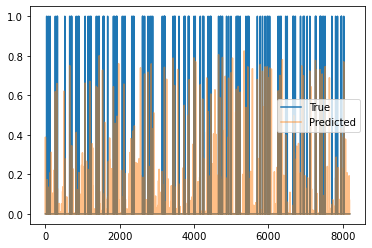

Train Epoch: 7 [1810/2220 (81%)]	Loss: 0.028640	Pres: 0.050363	F1 Score: 0.017763
Train Epoch: 7 [1820/2220 (81%)]	Loss: 0.027368	Pres: 0.042035	F1 Score: 0.017937
Train Epoch: 7 [1830/2220 (82%)]	Loss: 0.027350	Pres: 0.053877	F1 Score: 0.018253
Train Epoch: 7 [1840/2220 (82%)]	Loss: 0.026143	Pres: 0.050905	F1 Score: 0.019288
Train Epoch: 7 [1850/2220 (83%)]	Loss: 0.024433	Pres: 0.042353	F1 Score: 0.015472
Train Epoch: 7 [1860/2220 (83%)]	Loss: 0.027361	Pres: 0.048006	F1 Score: 0.020050
Train Epoch: 7 [1870/2220 (84%)]	Loss: 0.025959	Pres: 0.054762	F1 Score: 0.020376
Train Epoch: 7 [1880/2220 (84%)]	Loss: 0.027428	Pres: 0.051320	F1 Score: 0.018744
Train Epoch: 7 [1890/2220 (85%)]	Loss: 0.027179	Pres: 0.044815	F1 Score: 0.018106
Train Epoch: 7 [1900/2220 (85%)]	Loss: 0.025711	Pres: 0.052515	F1 Score: 0.023432
Train Epoch: 7 [1910/2220 (86%)]	Loss: 0.022814	Pres: 0.046266	F1 Score: 0.021544
Train Epoch: 7 [1920/2220 (86%)]	Loss: 0.022167	Pres: 0.044081	F1 Score: 0.022614
Train Epoch: 7 [

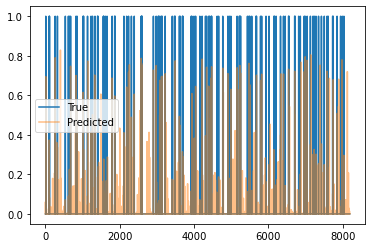

Train Epoch: 7 [2110/2220 (95%)]	Loss: 0.027837	Pres: 0.047019	F1 Score: 0.017179
Train Epoch: 7 [2120/2220 (95%)]	Loss: 0.026539	Pres: 0.039952	F1 Score: 0.016925
Train Epoch: 7 [2130/2220 (95%)]	Loss: 0.026945	Pres: 0.040317	F1 Score: 0.014064
Train Epoch: 7 [2140/2220 (96%)]	Loss: 0.025781	Pres: 0.045201	F1 Score: 0.018652
Train Epoch: 7 [2150/2220 (96%)]	Loss: 0.027983	Pres: 0.043309	F1 Score: 0.012753
Train Epoch: 7 [2160/2220 (97%)]	Loss: 0.025448	Pres: 0.047725	F1 Score: 0.019464
Train Epoch: 7 [2170/2220 (97%)]	Loss: 0.030052	Pres: 0.039625	F1 Score: 0.014140
Train Epoch: 7 [2180/2220 (98%)]	Loss: 0.025533	Pres: 0.049784	F1 Score: 0.021324
Train Epoch: 7 [2190/2220 (98%)]	Loss: 0.028071	Pres: 0.047558	F1 Score: 0.018352
Train Epoch: 7 [2200/2220 (99%)]	Loss: 0.025724	Pres: 0.048450	F1 Score: 0.020736
Train Epoch: 7 [2210/2220 (99%)]	Loss: 0.026693	Pres: 0.036571	F1 Score: 0.015839
Validation Epoch: 7 [0/582 (0%)]	Loss: 0.021883	Pres: 0.043067	F1 Score: 0.020862


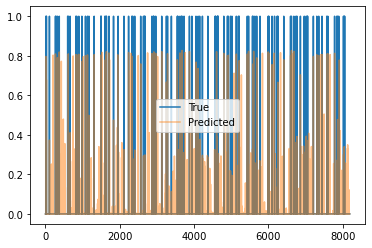

Validation Epoch: 7 [10/582 (1%)]	Loss: 0.022581	Pres: 0.056786	F1 Score: 0.021492
Validation Epoch: 7 [20/582 (3%)]	Loss: 0.024063	Pres: 0.048699	F1 Score: 0.019050
Validation Epoch: 7 [30/582 (5%)]	Loss: 0.021050	Pres: 0.050245	F1 Score: 0.022251
Validation Epoch: 7 [40/582 (6%)]	Loss: 0.024469	Pres: 0.049802	F1 Score: 0.019422
Validation Epoch: 7 [50/582 (8%)]	Loss: 0.019787	Pres: 0.056774	F1 Score: 0.022837
Validation Epoch: 7 [60/582 (10%)]	Loss: 0.021193	Pres: 0.046779	F1 Score: 0.024799
Validation Epoch: 7 [70/582 (12%)]	Loss: 0.022479	Pres: 0.046925	F1 Score: 0.019920
Validation Epoch: 7 [80/582 (13%)]	Loss: 0.020470	Pres: 0.058239	F1 Score: 0.023846
Validation Epoch: 7 [90/582 (15%)]	Loss: 0.021145	Pres: 0.050992	F1 Score: 0.022549
Validation Epoch: 7 [100/582 (17%)]	Loss: 0.022177	Pres: 0.052272	F1 Score: 0.019200
Validation Epoch: 7 [110/582 (18%)]	Loss: 0.024436	Pres: 0.052785	F1 Score: 0.019915
Validation Epoch: 7 [120/582 (20%)]	Loss: 0.019775	Pres: 0.053936	F1 Score: 0.0

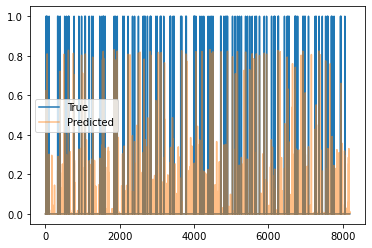

Validation Epoch: 7 [310/582 (53%)]	Loss: 0.020588	Pres: 0.052022	F1 Score: 0.024238
Validation Epoch: 7 [320/582 (54%)]	Loss: 0.023969	Pres: 0.054320	F1 Score: 0.021233
Validation Epoch: 7 [330/582 (56%)]	Loss: 0.020898	Pres: 0.052414	F1 Score: 0.023327
Validation Epoch: 7 [340/582 (58%)]	Loss: 0.018902	Pres: 0.054715	F1 Score: 0.026099
Validation Epoch: 7 [350/582 (60%)]	Loss: 0.020540	Pres: 0.050412	F1 Score: 0.022076
Validation Epoch: 7 [360/582 (61%)]	Loss: 0.020508	Pres: 0.046882	F1 Score: 0.022379
Validation Epoch: 7 [370/582 (63%)]	Loss: 0.020747	Pres: 0.047705	F1 Score: 0.022285
Validation Epoch: 7 [380/582 (65%)]	Loss: 0.022560	Pres: 0.058636	F1 Score: 0.022397
Validation Epoch: 7 [390/582 (67%)]	Loss: 0.021904	Pres: 0.057255	F1 Score: 0.021399
Validation Epoch: 7 [400/582 (68%)]	Loss: 0.020193	Pres: 0.057136	F1 Score: 0.025568
Validation Epoch: 7 [410/582 (70%)]	Loss: 0.020765	Pres: 0.050514	F1 Score: 0.023772
Validation Epoch: 7 [420/582 (72%)]	Loss: 0.023432	Pres: 0.048319

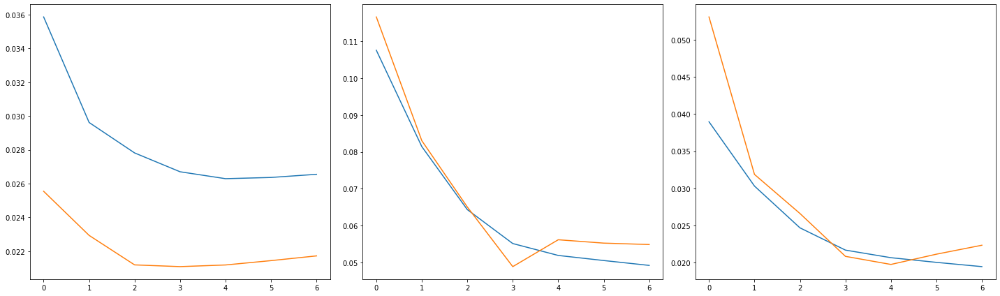

2220 582
Train Epoch: 8 [0/2220 (0%)]	Loss: 0.032320	Pres: 0.055788	F1 Score: 0.017844
111.0 -inf


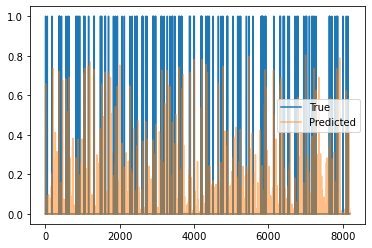

Train Epoch: 8 [10/2220 (0%)]	Loss: 0.028963	Pres: 0.046562	F1 Score: 0.016016
Train Epoch: 8 [20/2220 (0%)]	Loss: 0.031515	Pres: 0.054707	F1 Score: 0.020422
Train Epoch: 8 [30/2220 (1%)]	Loss: 0.030232	Pres: 0.057610	F1 Score: 0.020155
Train Epoch: 8 [40/2220 (1%)]	Loss: 0.027451	Pres: 0.052503	F1 Score: 0.021882
Train Epoch: 8 [50/2220 (2%)]	Loss: 0.029262	Pres: 0.049790	F1 Score: 0.017869
Train Epoch: 8 [60/2220 (2%)]	Loss: 0.027310	Pres: 0.045783	F1 Score: 0.019628
Train Epoch: 8 [70/2220 (3%)]	Loss: 0.027648	Pres: 0.051340	F1 Score: 0.021206
Train Epoch: 8 [80/2220 (3%)]	Loss: 0.024924	Pres: 0.054809	F1 Score: 0.022465
Train Epoch: 8 [90/2220 (4%)]	Loss: 0.025436	Pres: 0.055587	F1 Score: 0.021428
Train Epoch: 8 [100/2220 (4%)]	Loss: 0.026807	Pres: 0.050831	F1 Score: 0.020672
Train Epoch: 8 [110/2220 (4%)]	Loss: 0.027625	Pres: 0.049387	F1 Score: 0.016775
Train Epoch: 8 [120/2220 (5%)]	Loss: 0.022147	Pres: 0.050916	F1 Score: 0.021906
Train Epoch: 8 [130/2220 (5%)]	Loss: 0.030461	Pre

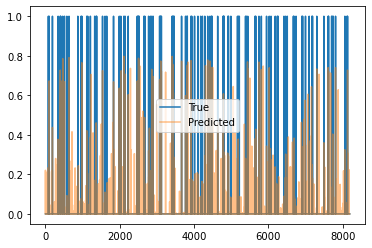

Train Epoch: 8 [310/2220 (13%)]	Loss: 0.026894	Pres: 0.047778	F1 Score: 0.019260
Train Epoch: 8 [320/2220 (14%)]	Loss: 0.022090	Pres: 0.055383	F1 Score: 0.023961
Train Epoch: 8 [330/2220 (14%)]	Loss: 0.027401	Pres: 0.051122	F1 Score: 0.021355
Train Epoch: 8 [340/2220 (15%)]	Loss: 0.028498	Pres: 0.043187	F1 Score: 0.016196
Train Epoch: 8 [350/2220 (15%)]	Loss: 0.022978	Pres: 0.052217	F1 Score: 0.022601
Train Epoch: 8 [360/2220 (16%)]	Loss: 0.029699	Pres: 0.048535	F1 Score: 0.016541
Train Epoch: 8 [370/2220 (16%)]	Loss: 0.024587	Pres: 0.050671	F1 Score: 0.021382
Train Epoch: 8 [380/2220 (17%)]	Loss: 0.021027	Pres: 0.053793	F1 Score: 0.024090
Train Epoch: 8 [390/2220 (17%)]	Loss: 0.025940	Pres: 0.053509	F1 Score: 0.019274
Train Epoch: 8 [400/2220 (18%)]	Loss: 0.023452	Pres: 0.046202	F1 Score: 0.021077
Train Epoch: 8 [410/2220 (18%)]	Loss: 0.024531	Pres: 0.051282	F1 Score: 0.020298
Train Epoch: 8 [420/2220 (18%)]	Loss: 0.027136	Pres: 0.054040	F1 Score: 0.021146
Train Epoch: 8 [430/2220 (19

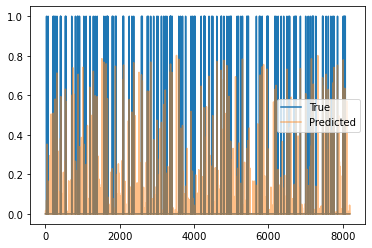

Train Epoch: 8 [610/2220 (27%)]	Loss: 0.023818	Pres: 0.050283	F1 Score: 0.019076
Train Epoch: 8 [620/2220 (27%)]	Loss: 0.025424	Pres: 0.046351	F1 Score: 0.020989
Train Epoch: 8 [630/2220 (28%)]	Loss: 0.027737	Pres: 0.043345	F1 Score: 0.016939
Train Epoch: 8 [640/2220 (28%)]	Loss: 0.024615	Pres: 0.046917	F1 Score: 0.018472
Train Epoch: 8 [650/2220 (29%)]	Loss: 0.030489	Pres: 0.038536	F1 Score: 0.016765
Train Epoch: 8 [660/2220 (29%)]	Loss: 0.024002	Pres: 0.050175	F1 Score: 0.021192
Train Epoch: 8 [670/2220 (30%)]	Loss: 0.023759	Pres: 0.038400	F1 Score: 0.018637
Train Epoch: 8 [680/2220 (30%)]	Loss: 0.025826	Pres: 0.041082	F1 Score: 0.015800
Train Epoch: 8 [690/2220 (31%)]	Loss: 0.027383	Pres: 0.047802	F1 Score: 0.018065
Train Epoch: 8 [700/2220 (31%)]	Loss: 0.029408	Pres: 0.050866	F1 Score: 0.017658
Train Epoch: 8 [710/2220 (31%)]	Loss: 0.023489	Pres: 0.051417	F1 Score: 0.020647
Train Epoch: 8 [720/2220 (32%)]	Loss: 0.022898	Pres: 0.047137	F1 Score: 0.019185
Train Epoch: 8 [730/2220 (32

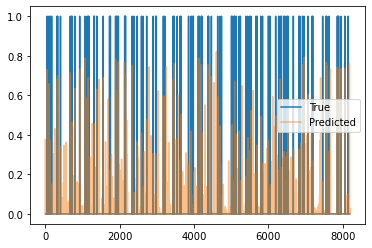

Train Epoch: 8 [910/2220 (40%)]	Loss: 0.026855	Pres: 0.046022	F1 Score: 0.018352
Train Epoch: 8 [920/2220 (41%)]	Loss: 0.025785	Pres: 0.049394	F1 Score: 0.021334
Train Epoch: 8 [930/2220 (41%)]	Loss: 0.028699	Pres: 0.047895	F1 Score: 0.020168
Train Epoch: 8 [940/2220 (42%)]	Loss: 0.028345	Pres: 0.050261	F1 Score: 0.016629
Train Epoch: 8 [950/2220 (42%)]	Loss: 0.027961	Pres: 0.052058	F1 Score: 0.019585
Train Epoch: 8 [960/2220 (43%)]	Loss: 0.026576	Pres: 0.047807	F1 Score: 0.019309
Train Epoch: 8 [970/2220 (43%)]	Loss: 0.025488	Pres: 0.047823	F1 Score: 0.021102
Train Epoch: 8 [980/2220 (44%)]	Loss: 0.023716	Pres: 0.051206	F1 Score: 0.021416
Train Epoch: 8 [990/2220 (44%)]	Loss: 0.029863	Pres: 0.051121	F1 Score: 0.017520
Train Epoch: 8 [1000/2220 (45%)]	Loss: 0.031862	Pres: 0.052517	F1 Score: 0.018690
Train Epoch: 8 [1010/2220 (45%)]	Loss: 0.025347	Pres: 0.042676	F1 Score: 0.015756
Train Epoch: 8 [1020/2220 (45%)]	Loss: 0.027999	Pres: 0.050541	F1 Score: 0.020467
Train Epoch: 8 [1030/2220

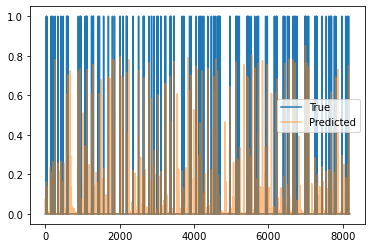

Train Epoch: 8 [1210/2220 (54%)]	Loss: 0.026592	Pres: 0.040453	F1 Score: 0.019032
Train Epoch: 8 [1220/2220 (54%)]	Loss: 0.024183	Pres: 0.050062	F1 Score: 0.020343
Train Epoch: 8 [1230/2220 (55%)]	Loss: 0.028986	Pres: 0.047487	F1 Score: 0.017131
Train Epoch: 8 [1240/2220 (55%)]	Loss: 0.029783	Pres: 0.050142	F1 Score: 0.018390
Train Epoch: 8 [1250/2220 (56%)]	Loss: 0.026921	Pres: 0.044163	F1 Score: 0.017699
Train Epoch: 8 [1260/2220 (56%)]	Loss: 0.028018	Pres: 0.048678	F1 Score: 0.017905
Train Epoch: 8 [1270/2220 (57%)]	Loss: 0.028955	Pres: 0.047592	F1 Score: 0.015240
Train Epoch: 8 [1280/2220 (57%)]	Loss: 0.027985	Pres: 0.045517	F1 Score: 0.017960
Train Epoch: 8 [1290/2220 (58%)]	Loss: 0.025468	Pres: 0.057639	F1 Score: 0.023745
Train Epoch: 8 [1300/2220 (58%)]	Loss: 0.026164	Pres: 0.051873	F1 Score: 0.016832
Train Epoch: 8 [1310/2220 (59%)]	Loss: 0.026497	Pres: 0.046909	F1 Score: 0.018429
Train Epoch: 8 [1320/2220 (59%)]	Loss: 0.023697	Pres: 0.043454	F1 Score: 0.018764
Train Epoch: 8 [

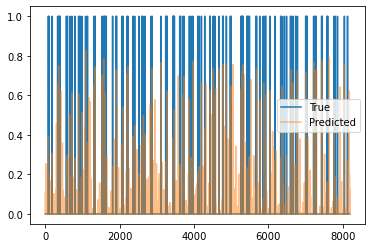

Train Epoch: 8 [1510/2220 (68%)]	Loss: 0.026491	Pres: 0.051020	F1 Score: 0.018569
Train Epoch: 8 [1520/2220 (68%)]	Loss: 0.029734	Pres: 0.043685	F1 Score: 0.016443
Train Epoch: 8 [1530/2220 (68%)]	Loss: 0.027475	Pres: 0.049537	F1 Score: 0.017758
Train Epoch: 8 [1540/2220 (69%)]	Loss: 0.028176	Pres: 0.051794	F1 Score: 0.020501
Train Epoch: 8 [1550/2220 (69%)]	Loss: 0.030104	Pres: 0.053252	F1 Score: 0.018952
Train Epoch: 8 [1560/2220 (70%)]	Loss: 0.028137	Pres: 0.048558	F1 Score: 0.018135
Train Epoch: 8 [1570/2220 (70%)]	Loss: 0.028376	Pres: 0.054789	F1 Score: 0.021154
Train Epoch: 8 [1580/2220 (71%)]	Loss: 0.026343	Pres: 0.044936	F1 Score: 0.017422
Train Epoch: 8 [1590/2220 (71%)]	Loss: 0.024896	Pres: 0.064583	F1 Score: 0.024413
Train Epoch: 8 [1600/2220 (72%)]	Loss: 0.030673	Pres: 0.049946	F1 Score: 0.017595
Train Epoch: 8 [1610/2220 (72%)]	Loss: 0.026738	Pres: 0.049135	F1 Score: 0.017110
Train Epoch: 8 [1620/2220 (72%)]	Loss: 0.026826	Pres: 0.060479	F1 Score: 0.024644
Train Epoch: 8 [

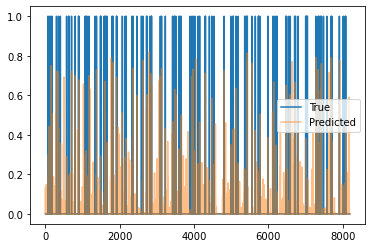

Train Epoch: 8 [1810/2220 (81%)]	Loss: 0.025593	Pres: 0.049968	F1 Score: 0.020217
Train Epoch: 8 [1820/2220 (81%)]	Loss: 0.027923	Pres: 0.049474	F1 Score: 0.018459
Train Epoch: 8 [1830/2220 (82%)]	Loss: 0.026091	Pres: 0.046905	F1 Score: 0.020766
Train Epoch: 8 [1840/2220 (82%)]	Loss: 0.027546	Pres: 0.053790	F1 Score: 0.021568
Train Epoch: 8 [1850/2220 (83%)]	Loss: 0.023756	Pres: 0.050301	F1 Score: 0.023264
Train Epoch: 8 [1860/2220 (83%)]	Loss: 0.028667	Pres: 0.051041	F1 Score: 0.017643
Train Epoch: 8 [1870/2220 (84%)]	Loss: 0.030207	Pres: 0.047172	F1 Score: 0.015359
Train Epoch: 8 [1880/2220 (84%)]	Loss: 0.026883	Pres: 0.049805	F1 Score: 0.020115
Train Epoch: 8 [1890/2220 (85%)]	Loss: 0.027647	Pres: 0.051007	F1 Score: 0.021323
Train Epoch: 8 [1900/2220 (85%)]	Loss: 0.030439	Pres: 0.048367	F1 Score: 0.015401
Train Epoch: 8 [1910/2220 (86%)]	Loss: 0.025721	Pres: 0.051267	F1 Score: 0.019104
Train Epoch: 8 [1920/2220 (86%)]	Loss: 0.026487	Pres: 0.050719	F1 Score: 0.018643
Train Epoch: 8 [

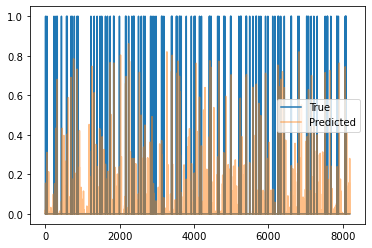

Train Epoch: 8 [2110/2220 (95%)]	Loss: 0.027159	Pres: 0.047318	F1 Score: 0.018097
Train Epoch: 8 [2120/2220 (95%)]	Loss: 0.026687	Pres: 0.051639	F1 Score: 0.020187
Train Epoch: 8 [2130/2220 (95%)]	Loss: 0.027279	Pres: 0.049745	F1 Score: 0.018735
Train Epoch: 8 [2140/2220 (96%)]	Loss: 0.027143	Pres: 0.052552	F1 Score: 0.019439
Train Epoch: 8 [2150/2220 (96%)]	Loss: 0.024801	Pres: 0.052444	F1 Score: 0.023338
Train Epoch: 8 [2160/2220 (97%)]	Loss: 0.025469	Pres: 0.048889	F1 Score: 0.019057
Train Epoch: 8 [2170/2220 (97%)]	Loss: 0.031207	Pres: 0.045586	F1 Score: 0.011856
Train Epoch: 8 [2180/2220 (98%)]	Loss: 0.024956	Pres: 0.049888	F1 Score: 0.020466
Train Epoch: 8 [2190/2220 (98%)]	Loss: 0.028319	Pres: 0.044688	F1 Score: 0.017433
Train Epoch: 8 [2200/2220 (99%)]	Loss: 0.024833	Pres: 0.055262	F1 Score: 0.022425
Train Epoch: 8 [2210/2220 (99%)]	Loss: 0.030719	Pres: 0.046305	F1 Score: 0.016516
Validation Epoch: 8 [0/582 (0%)]	Loss: 0.019712	Pres: 0.059846	F1 Score: 0.029877


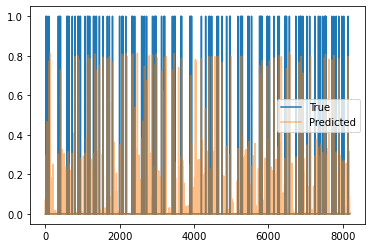

Validation Epoch: 8 [10/582 (1%)]	Loss: 0.024400	Pres: 0.060133	F1 Score: 0.022160
Validation Epoch: 8 [20/582 (3%)]	Loss: 0.022884	Pres: 0.059751	F1 Score: 0.025095
Validation Epoch: 8 [30/582 (5%)]	Loss: 0.022144	Pres: 0.054650	F1 Score: 0.026448
Validation Epoch: 8 [40/582 (6%)]	Loss: 0.022142	Pres: 0.056640	F1 Score: 0.023096
Validation Epoch: 8 [50/582 (8%)]	Loss: 0.021400	Pres: 0.060698	F1 Score: 0.028922
Validation Epoch: 8 [60/582 (10%)]	Loss: 0.022615	Pres: 0.056689	F1 Score: 0.026139
Validation Epoch: 8 [70/582 (12%)]	Loss: 0.021198	Pres: 0.073452	F1 Score: 0.028144
Validation Epoch: 8 [80/582 (13%)]	Loss: 0.022103	Pres: 0.067033	F1 Score: 0.027963
Validation Epoch: 8 [90/582 (15%)]	Loss: 0.022265	Pres: 0.052008	F1 Score: 0.025707
Validation Epoch: 8 [100/582 (17%)]	Loss: 0.020498	Pres: 0.068636	F1 Score: 0.033091
Validation Epoch: 8 [110/582 (18%)]	Loss: 0.023541	Pres: 0.061389	F1 Score: 0.028111
Validation Epoch: 8 [120/582 (20%)]	Loss: 0.021678	Pres: 0.071169	F1 Score: 0.0

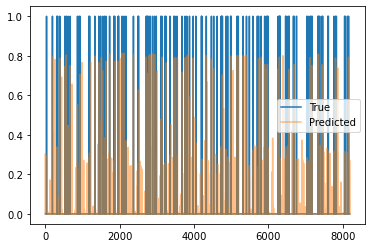

Validation Epoch: 8 [310/582 (53%)]	Loss: 0.022022	Pres: 0.053030	F1 Score: 0.024445
Validation Epoch: 8 [320/582 (54%)]	Loss: 0.021582	Pres: 0.066248	F1 Score: 0.030569
Validation Epoch: 8 [330/582 (56%)]	Loss: 0.021649	Pres: 0.050649	F1 Score: 0.027970
Validation Epoch: 8 [340/582 (58%)]	Loss: 0.022061	Pres: 0.043729	F1 Score: 0.026711
Validation Epoch: 8 [350/582 (60%)]	Loss: 0.021443	Pres: 0.048575	F1 Score: 0.028065
Validation Epoch: 8 [360/582 (61%)]	Loss: 0.022479	Pres: 0.060695	F1 Score: 0.024705
Validation Epoch: 8 [370/582 (63%)]	Loss: 0.020391	Pres: 0.061601	F1 Score: 0.028438
Validation Epoch: 8 [380/582 (65%)]	Loss: 0.022017	Pres: 0.052882	F1 Score: 0.027135
Validation Epoch: 8 [390/582 (67%)]	Loss: 0.020507	Pres: 0.051123	F1 Score: 0.029391
Validation Epoch: 8 [400/582 (68%)]	Loss: 0.021444	Pres: 0.058095	F1 Score: 0.026276
Validation Epoch: 8 [410/582 (70%)]	Loss: 0.021619	Pres: 0.052357	F1 Score: 0.027466
Validation Epoch: 8 [420/582 (72%)]	Loss: 0.020479	Pres: 0.058800

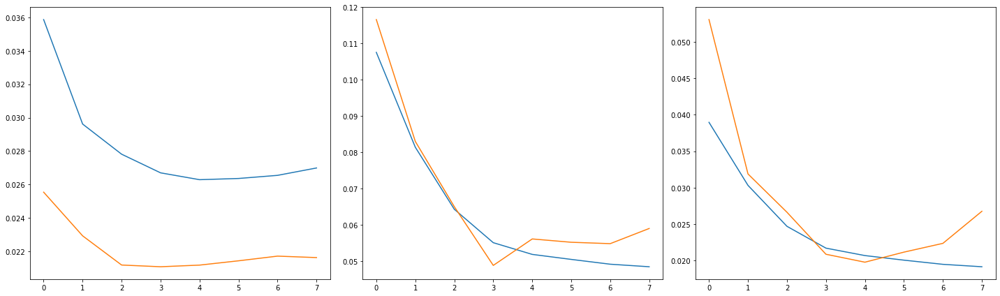

2220 582
Train Epoch: 9 [0/2220 (0%)]	Loss: 0.028610	Pres: 0.048718	F1 Score: 0.017141
114.0 -inf


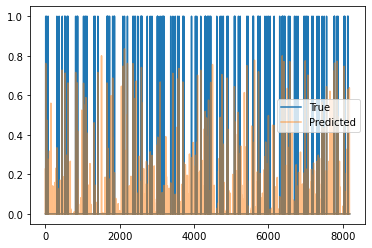

Train Epoch: 9 [10/2220 (0%)]	Loss: 0.025340	Pres: 0.060795	F1 Score: 0.024826
Train Epoch: 9 [20/2220 (0%)]	Loss: 0.028182	Pres: 0.052451	F1 Score: 0.018539
Train Epoch: 9 [30/2220 (1%)]	Loss: 0.023773	Pres: 0.042500	F1 Score: 0.022518
Train Epoch: 9 [40/2220 (1%)]	Loss: 0.027328	Pres: 0.045500	F1 Score: 0.016398
Train Epoch: 9 [50/2220 (2%)]	Loss: 0.023021	Pres: 0.045807	F1 Score: 0.019946
Train Epoch: 9 [60/2220 (2%)]	Loss: 0.027806	Pres: 0.055038	F1 Score: 0.022327
Train Epoch: 9 [70/2220 (3%)]	Loss: 0.027589	Pres: 0.048679	F1 Score: 0.017471
Train Epoch: 9 [80/2220 (3%)]	Loss: 0.025617	Pres: 0.042993	F1 Score: 0.023155
Train Epoch: 9 [90/2220 (4%)]	Loss: 0.028560	Pres: 0.046193	F1 Score: 0.017697
Train Epoch: 9 [100/2220 (4%)]	Loss: 0.027657	Pres: 0.048341	F1 Score: 0.017998
Train Epoch: 9 [110/2220 (4%)]	Loss: 0.027375	Pres: 0.047734	F1 Score: 0.020128
Train Epoch: 9 [120/2220 (5%)]	Loss: 0.026012	Pres: 0.049537	F1 Score: 0.021086
Train Epoch: 9 [130/2220 (5%)]	Loss: 0.028943	Pre

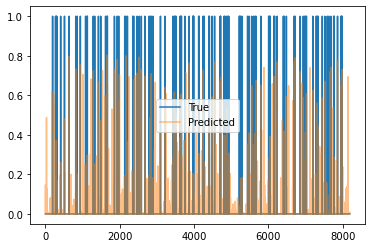

Train Epoch: 9 [310/2220 (13%)]	Loss: 0.029912	Pres: 0.057773	F1 Score: 0.021189
Train Epoch: 9 [320/2220 (14%)]	Loss: 0.024172	Pres: 0.054574	F1 Score: 0.024819
Train Epoch: 9 [330/2220 (14%)]	Loss: 0.029359	Pres: 0.049483	F1 Score: 0.016335
Train Epoch: 9 [340/2220 (15%)]	Loss: 0.022191	Pres: 0.046070	F1 Score: 0.022256
Train Epoch: 9 [350/2220 (15%)]	Loss: 0.028588	Pres: 0.045272	F1 Score: 0.016273
Train Epoch: 9 [360/2220 (16%)]	Loss: 0.028265	Pres: 0.049601	F1 Score: 0.017030
Train Epoch: 9 [370/2220 (16%)]	Loss: 0.026994	Pres: 0.052695	F1 Score: 0.021314
Train Epoch: 9 [380/2220 (17%)]	Loss: 0.023944	Pres: 0.043768	F1 Score: 0.019935
Train Epoch: 9 [390/2220 (17%)]	Loss: 0.029587	Pres: 0.047796	F1 Score: 0.019048
Train Epoch: 9 [400/2220 (18%)]	Loss: 0.024114	Pres: 0.043297	F1 Score: 0.017392
Train Epoch: 9 [410/2220 (18%)]	Loss: 0.029293	Pres: 0.050885	F1 Score: 0.016207
Train Epoch: 9 [420/2220 (18%)]	Loss: 0.024156	Pres: 0.051167	F1 Score: 0.020812
Train Epoch: 9 [430/2220 (19

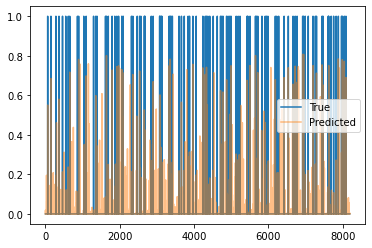

Train Epoch: 9 [610/2220 (27%)]	Loss: 0.028169	Pres: 0.044601	F1 Score: 0.018860
Train Epoch: 9 [620/2220 (27%)]	Loss: 0.025927	Pres: 0.051282	F1 Score: 0.019889
Train Epoch: 9 [630/2220 (28%)]	Loss: 0.024966	Pres: 0.045251	F1 Score: 0.019184
Train Epoch: 9 [640/2220 (28%)]	Loss: 0.029426	Pres: 0.045735	F1 Score: 0.017556
Train Epoch: 9 [650/2220 (29%)]	Loss: 0.025315	Pres: 0.055534	F1 Score: 0.023224
Train Epoch: 9 [660/2220 (29%)]	Loss: 0.026199	Pres: 0.042825	F1 Score: 0.017879
Train Epoch: 9 [670/2220 (30%)]	Loss: 0.023957	Pres: 0.047788	F1 Score: 0.020685
Train Epoch: 9 [680/2220 (30%)]	Loss: 0.026672	Pres: 0.050000	F1 Score: 0.020500
Train Epoch: 9 [690/2220 (31%)]	Loss: 0.029721	Pres: 0.045529	F1 Score: 0.015269
Train Epoch: 9 [700/2220 (31%)]	Loss: 0.026170	Pres: 0.045540	F1 Score: 0.021324
Train Epoch: 9 [710/2220 (31%)]	Loss: 0.030078	Pres: 0.042311	F1 Score: 0.016883
Train Epoch: 9 [720/2220 (32%)]	Loss: 0.022580	Pres: 0.053945	F1 Score: 0.026593
Train Epoch: 9 [730/2220 (32

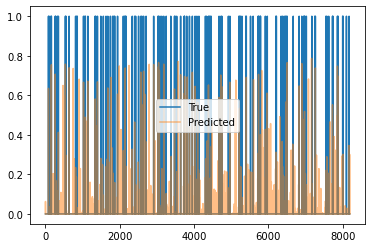

Train Epoch: 9 [910/2220 (40%)]	Loss: 0.030925	Pres: 0.044761	F1 Score: 0.014703
Train Epoch: 9 [920/2220 (41%)]	Loss: 0.028035	Pres: 0.049479	F1 Score: 0.021597
Train Epoch: 9 [930/2220 (41%)]	Loss: 0.028098	Pres: 0.049286	F1 Score: 0.020245
Train Epoch: 9 [940/2220 (42%)]	Loss: 0.026911	Pres: 0.038607	F1 Score: 0.015614
Train Epoch: 9 [950/2220 (42%)]	Loss: 0.024504	Pres: 0.050448	F1 Score: 0.021668
Train Epoch: 9 [960/2220 (43%)]	Loss: 0.026135	Pres: 0.045772	F1 Score: 0.017906
Train Epoch: 9 [970/2220 (43%)]	Loss: 0.024346	Pres: 0.046599	F1 Score: 0.022455
Train Epoch: 9 [980/2220 (44%)]	Loss: 0.025862	Pres: 0.044731	F1 Score: 0.018342
Train Epoch: 9 [990/2220 (44%)]	Loss: 0.024887	Pres: 0.054543	F1 Score: 0.021326
Train Epoch: 9 [1000/2220 (45%)]	Loss: 0.025979	Pres: 0.045822	F1 Score: 0.019388
Train Epoch: 9 [1010/2220 (45%)]	Loss: 0.028772	Pres: 0.048398	F1 Score: 0.016297
Train Epoch: 9 [1020/2220 (45%)]	Loss: 0.024593	Pres: 0.047571	F1 Score: 0.019581
Train Epoch: 9 [1030/2220

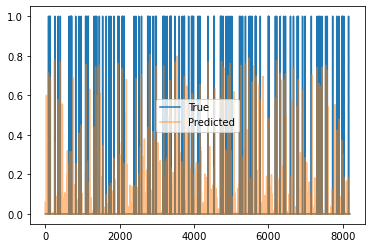

Train Epoch: 9 [1210/2220 (54%)]	Loss: 0.029382	Pres: 0.050828	F1 Score: 0.017925
Train Epoch: 9 [1220/2220 (54%)]	Loss: 0.028283	Pres: 0.054889	F1 Score: 0.019711
Train Epoch: 9 [1230/2220 (55%)]	Loss: 0.026237	Pres: 0.050370	F1 Score: 0.020310
Train Epoch: 9 [1240/2220 (55%)]	Loss: 0.028072	Pres: 0.048235	F1 Score: 0.017975
Train Epoch: 9 [1250/2220 (56%)]	Loss: 0.025507	Pres: 0.049212	F1 Score: 0.019798
Train Epoch: 9 [1260/2220 (56%)]	Loss: 0.028548	Pres: 0.046057	F1 Score: 0.018084
Train Epoch: 9 [1270/2220 (57%)]	Loss: 0.025100	Pres: 0.053387	F1 Score: 0.025208
Train Epoch: 9 [1280/2220 (57%)]	Loss: 0.027809	Pres: 0.047630	F1 Score: 0.017726
Train Epoch: 9 [1290/2220 (58%)]	Loss: 0.027529	Pres: 0.052803	F1 Score: 0.020621
Train Epoch: 9 [1300/2220 (58%)]	Loss: 0.030033	Pres: 0.042178	F1 Score: 0.014945
Train Epoch: 9 [1310/2220 (59%)]	Loss: 0.031853	Pres: 0.050177	F1 Score: 0.013512
Train Epoch: 9 [1320/2220 (59%)]	Loss: 0.028168	Pres: 0.056348	F1 Score: 0.020276
Train Epoch: 9 [

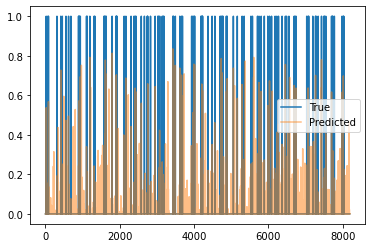

Train Epoch: 9 [1510/2220 (68%)]	Loss: 0.026220	Pres: 0.046903	F1 Score: 0.018928
Train Epoch: 9 [1520/2220 (68%)]	Loss: 0.025956	Pres: 0.046447	F1 Score: 0.018672
Train Epoch: 9 [1530/2220 (68%)]	Loss: 0.028238	Pres: 0.043009	F1 Score: 0.016909
Train Epoch: 9 [1540/2220 (69%)]	Loss: 0.031830	Pres: 0.045771	F1 Score: 0.016245
Train Epoch: 9 [1550/2220 (69%)]	Loss: 0.031308	Pres: 0.051379	F1 Score: 0.017649
Train Epoch: 9 [1560/2220 (70%)]	Loss: 0.027225	Pres: 0.052249	F1 Score: 0.021535
Train Epoch: 9 [1570/2220 (70%)]	Loss: 0.030203	Pres: 0.047813	F1 Score: 0.015692
Train Epoch: 9 [1580/2220 (71%)]	Loss: 0.023731	Pres: 0.051725	F1 Score: 0.023504
Train Epoch: 9 [1590/2220 (71%)]	Loss: 0.028861	Pres: 0.041017	F1 Score: 0.016403
Train Epoch: 9 [1600/2220 (72%)]	Loss: 0.027878	Pres: 0.045723	F1 Score: 0.019980
Train Epoch: 9 [1610/2220 (72%)]	Loss: 0.028020	Pres: 0.052172	F1 Score: 0.020423
Train Epoch: 9 [1620/2220 (72%)]	Loss: 0.027706	Pres: 0.055076	F1 Score: 0.018229
Train Epoch: 9 [

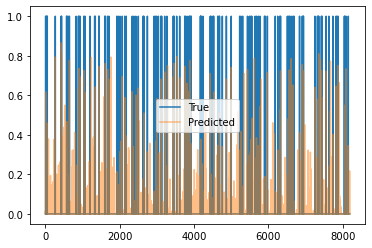

Train Epoch: 9 [1810/2220 (81%)]	Loss: 0.028634	Pres: 0.045918	F1 Score: 0.016610
Train Epoch: 9 [1820/2220 (81%)]	Loss: 0.024104	Pres: 0.052601	F1 Score: 0.021477
Train Epoch: 9 [1830/2220 (82%)]	Loss: 0.026830	Pres: 0.042353	F1 Score: 0.017808
Train Epoch: 9 [1840/2220 (82%)]	Loss: 0.027796	Pres: 0.044949	F1 Score: 0.015563
Train Epoch: 9 [1850/2220 (83%)]	Loss: 0.026322	Pres: 0.049508	F1 Score: 0.021459
Train Epoch: 9 [1860/2220 (83%)]	Loss: 0.027604	Pres: 0.049924	F1 Score: 0.017427
Train Epoch: 9 [1870/2220 (84%)]	Loss: 0.026778	Pres: 0.049468	F1 Score: 0.017229
Train Epoch: 9 [1880/2220 (84%)]	Loss: 0.027465	Pres: 0.048375	F1 Score: 0.016287
Train Epoch: 9 [1890/2220 (85%)]	Loss: 0.027029	Pres: 0.043367	F1 Score: 0.017678
Train Epoch: 9 [1900/2220 (85%)]	Loss: 0.025912	Pres: 0.055185	F1 Score: 0.020930
Train Epoch: 9 [1910/2220 (86%)]	Loss: 0.024912	Pres: 0.049311	F1 Score: 0.021144
Train Epoch: 9 [1920/2220 (86%)]	Loss: 0.025217	Pres: 0.048644	F1 Score: 0.019519
Train Epoch: 9 [

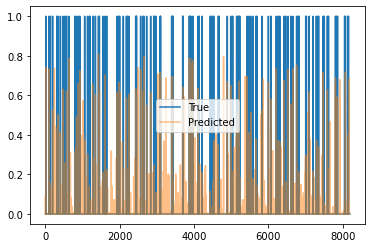

Train Epoch: 9 [2110/2220 (95%)]	Loss: 0.026607	Pres: 0.045712	F1 Score: 0.018748
Train Epoch: 9 [2120/2220 (95%)]	Loss: 0.027682	Pres: 0.047837	F1 Score: 0.016551
Train Epoch: 9 [2130/2220 (95%)]	Loss: 0.029257	Pres: 0.043845	F1 Score: 0.017450
Train Epoch: 9 [2140/2220 (96%)]	Loss: 0.028315	Pres: 0.051111	F1 Score: 0.017091
Train Epoch: 9 [2150/2220 (96%)]	Loss: 0.025196	Pres: 0.057416	F1 Score: 0.021988
Train Epoch: 9 [2160/2220 (97%)]	Loss: 0.027906	Pres: 0.052083	F1 Score: 0.020730
Train Epoch: 9 [2170/2220 (97%)]	Loss: 0.026815	Pres: 0.051225	F1 Score: 0.018961
Train Epoch: 9 [2180/2220 (98%)]	Loss: 0.025434	Pres: 0.050179	F1 Score: 0.021644
Train Epoch: 9 [2190/2220 (98%)]	Loss: 0.025031	Pres: 0.049343	F1 Score: 0.018668
Train Epoch: 9 [2200/2220 (99%)]	Loss: 0.026492	Pres: 0.041915	F1 Score: 0.016071
Train Epoch: 9 [2210/2220 (99%)]	Loss: 0.027587	Pres: 0.041530	F1 Score: 0.015353
Validation Epoch: 9 [0/582 (0%)]	Loss: 0.022940	Pres: 0.045661	F1 Score: 0.022142


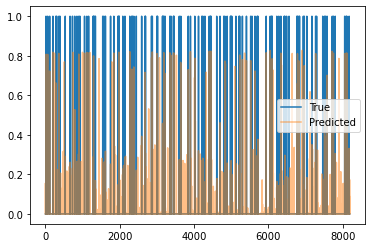

Validation Epoch: 9 [10/582 (1%)]	Loss: 0.020473	Pres: 0.048685	F1 Score: 0.022770
Validation Epoch: 9 [20/582 (3%)]	Loss: 0.020498	Pres: 0.053115	F1 Score: 0.022607
Validation Epoch: 9 [30/582 (5%)]	Loss: 0.020547	Pres: 0.055637	F1 Score: 0.024049
Validation Epoch: 9 [40/582 (6%)]	Loss: 0.021267	Pres: 0.052840	F1 Score: 0.024209
Validation Epoch: 9 [50/582 (8%)]	Loss: 0.018709	Pres: 0.047455	F1 Score: 0.026728
Validation Epoch: 9 [60/582 (10%)]	Loss: 0.021860	Pres: 0.058867	F1 Score: 0.022298
Validation Epoch: 9 [70/582 (12%)]	Loss: 0.021550	Pres: 0.051247	F1 Score: 0.021718
Validation Epoch: 9 [80/582 (13%)]	Loss: 0.023448	Pres: 0.052937	F1 Score: 0.019918
Validation Epoch: 9 [90/582 (15%)]	Loss: 0.021791	Pres: 0.062029	F1 Score: 0.021426
Validation Epoch: 9 [100/582 (17%)]	Loss: 0.022346	Pres: 0.057516	F1 Score: 0.019049
Validation Epoch: 9 [110/582 (18%)]	Loss: 0.022566	Pres: 0.045328	F1 Score: 0.020565
Validation Epoch: 9 [120/582 (20%)]	Loss: 0.022564	Pres: 0.052250	F1 Score: 0.0

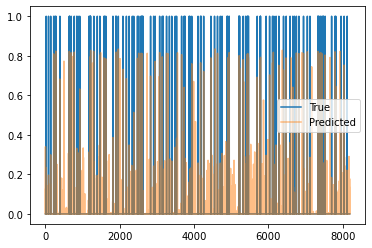

Validation Epoch: 9 [310/582 (53%)]	Loss: 0.022700	Pres: 0.055441	F1 Score: 0.020401
Validation Epoch: 9 [320/582 (54%)]	Loss: 0.021339	Pres: 0.057583	F1 Score: 0.023546
Validation Epoch: 9 [330/582 (56%)]	Loss: 0.020700	Pres: 0.042498	F1 Score: 0.021524
Validation Epoch: 9 [340/582 (58%)]	Loss: 0.022192	Pres: 0.053097	F1 Score: 0.021980
Validation Epoch: 9 [350/582 (60%)]	Loss: 0.022069	Pres: 0.058117	F1 Score: 0.022202
Validation Epoch: 9 [360/582 (61%)]	Loss: 0.020563	Pres: 0.062263	F1 Score: 0.024574
Validation Epoch: 9 [370/582 (63%)]	Loss: 0.020768	Pres: 0.062319	F1 Score: 0.023615
Validation Epoch: 9 [380/582 (65%)]	Loss: 0.020527	Pres: 0.059597	F1 Score: 0.023837
Validation Epoch: 9 [390/582 (67%)]	Loss: 0.021874	Pres: 0.044859	F1 Score: 0.020814
Validation Epoch: 9 [400/582 (68%)]	Loss: 0.022475	Pres: 0.054794	F1 Score: 0.022014
Validation Epoch: 9 [410/582 (70%)]	Loss: 0.020222	Pres: 0.048082	F1 Score: 0.023535
Validation Epoch: 9 [420/582 (72%)]	Loss: 0.021162	Pres: 0.061578

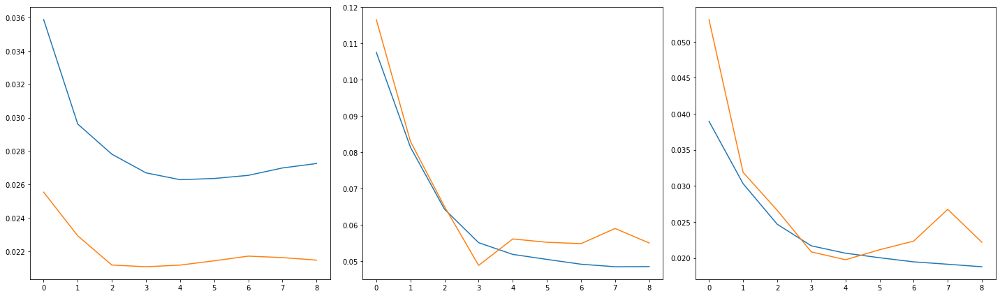

2220 582
Train Epoch: 10 [0/2220 (0%)]	Loss: 0.026392	Pres: 0.044872	F1 Score: 0.017456
107.0 -inf


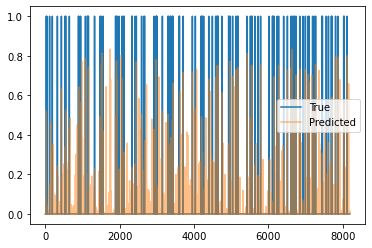

Train Epoch: 10 [10/2220 (0%)]	Loss: 0.026501	Pres: 0.046923	F1 Score: 0.020596
Train Epoch: 10 [20/2220 (0%)]	Loss: 0.032507	Pres: 0.049535	F1 Score: 0.012663
Train Epoch: 10 [30/2220 (1%)]	Loss: 0.025606	Pres: 0.046149	F1 Score: 0.020405
Train Epoch: 10 [40/2220 (1%)]	Loss: 0.032661	Pres: 0.048231	F1 Score: 0.016503
Train Epoch: 10 [50/2220 (2%)]	Loss: 0.031151	Pres: 0.043248	F1 Score: 0.013115
Train Epoch: 10 [60/2220 (2%)]	Loss: 0.026344	Pres: 0.048916	F1 Score: 0.021786
Train Epoch: 10 [70/2220 (3%)]	Loss: 0.025300	Pres: 0.054826	F1 Score: 0.021929
Train Epoch: 10 [80/2220 (3%)]	Loss: 0.027887	Pres: 0.047138	F1 Score: 0.015711
Train Epoch: 10 [90/2220 (4%)]	Loss: 0.024780	Pres: 0.045248	F1 Score: 0.018430
Train Epoch: 10 [100/2220 (4%)]	Loss: 0.026457	Pres: 0.049880	F1 Score: 0.018021
Train Epoch: 10 [110/2220 (4%)]	Loss: 0.025665	Pres: 0.044886	F1 Score: 0.020224
Train Epoch: 10 [120/2220 (5%)]	Loss: 0.026730	Pres: 0.042146	F1 Score: 0.014397
Train Epoch: 10 [130/2220 (5%)]	Loss:

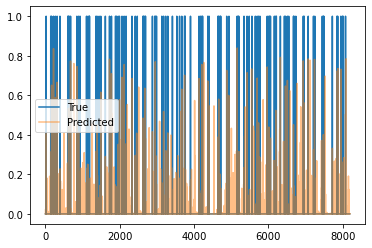

Train Epoch: 10 [310/2220 (13%)]	Loss: 0.029128	Pres: 0.050488	F1 Score: 0.019002
Train Epoch: 10 [320/2220 (14%)]	Loss: 0.024719	Pres: 0.046795	F1 Score: 0.020369
Train Epoch: 10 [330/2220 (14%)]	Loss: 0.029099	Pres: 0.050606	F1 Score: 0.016424
Train Epoch: 10 [340/2220 (15%)]	Loss: 0.024096	Pres: 0.048016	F1 Score: 0.020889
Train Epoch: 10 [350/2220 (15%)]	Loss: 0.027838	Pres: 0.043210	F1 Score: 0.018655
Train Epoch: 10 [360/2220 (16%)]	Loss: 0.026074	Pres: 0.044299	F1 Score: 0.016542
Train Epoch: 10 [370/2220 (16%)]	Loss: 0.023480	Pres: 0.044648	F1 Score: 0.021292
Train Epoch: 10 [380/2220 (17%)]	Loss: 0.029228	Pres: 0.041703	F1 Score: 0.015481
Train Epoch: 10 [390/2220 (17%)]	Loss: 0.028073	Pres: 0.042798	F1 Score: 0.015919
Train Epoch: 10 [400/2220 (18%)]	Loss: 0.031255	Pres: 0.048837	F1 Score: 0.016085
Train Epoch: 10 [410/2220 (18%)]	Loss: 0.030750	Pres: 0.035131	F1 Score: 0.012848
Train Epoch: 10 [420/2220 (18%)]	Loss: 0.026938	Pres: 0.054673	F1 Score: 0.018436
Train Epoch: 10 

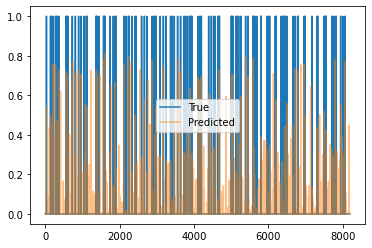

Train Epoch: 10 [610/2220 (27%)]	Loss: 0.025760	Pres: 0.045708	F1 Score: 0.017632
Train Epoch: 10 [620/2220 (27%)]	Loss: 0.025753	Pres: 0.044030	F1 Score: 0.018285
Train Epoch: 10 [630/2220 (28%)]	Loss: 0.024832	Pres: 0.048532	F1 Score: 0.020647
Train Epoch: 10 [640/2220 (28%)]	Loss: 0.023077	Pres: 0.048137	F1 Score: 0.019819
Train Epoch: 10 [650/2220 (29%)]	Loss: 0.026930	Pres: 0.052454	F1 Score: 0.016271
Train Epoch: 10 [660/2220 (29%)]	Loss: 0.024846	Pres: 0.042256	F1 Score: 0.018006
Train Epoch: 10 [670/2220 (30%)]	Loss: 0.026441	Pres: 0.049093	F1 Score: 0.020523
Train Epoch: 10 [680/2220 (30%)]	Loss: 0.025989	Pres: 0.048049	F1 Score: 0.019639
Train Epoch: 10 [690/2220 (31%)]	Loss: 0.031666	Pres: 0.056200	F1 Score: 0.017428
Train Epoch: 10 [700/2220 (31%)]	Loss: 0.025542	Pres: 0.045235	F1 Score: 0.018261
Train Epoch: 10 [710/2220 (31%)]	Loss: 0.026473	Pres: 0.045917	F1 Score: 0.017843
Train Epoch: 10 [720/2220 (32%)]	Loss: 0.027706	Pres: 0.049946	F1 Score: 0.018595
Train Epoch: 10 

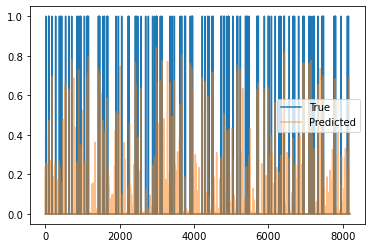

Train Epoch: 10 [910/2220 (40%)]	Loss: 0.026443	Pres: 0.046820	F1 Score: 0.018430
Train Epoch: 10 [920/2220 (41%)]	Loss: 0.024555	Pres: 0.047676	F1 Score: 0.020604
Train Epoch: 10 [930/2220 (41%)]	Loss: 0.028955	Pres: 0.055685	F1 Score: 0.017378
Train Epoch: 10 [940/2220 (42%)]	Loss: 0.025564	Pres: 0.051070	F1 Score: 0.023382
Train Epoch: 10 [950/2220 (42%)]	Loss: 0.026569	Pres: 0.048291	F1 Score: 0.016992
Train Epoch: 10 [960/2220 (43%)]	Loss: 0.026630	Pres: 0.043462	F1 Score: 0.019051
Train Epoch: 10 [970/2220 (43%)]	Loss: 0.029288	Pres: 0.046929	F1 Score: 0.015880
Train Epoch: 10 [980/2220 (44%)]	Loss: 0.029556	Pres: 0.050321	F1 Score: 0.017349
Train Epoch: 10 [990/2220 (44%)]	Loss: 0.031118	Pres: 0.050321	F1 Score: 0.016865
Train Epoch: 10 [1000/2220 (45%)]	Loss: 0.026473	Pres: 0.044443	F1 Score: 0.018963
Train Epoch: 10 [1010/2220 (45%)]	Loss: 0.028948	Pres: 0.044242	F1 Score: 0.017160
Train Epoch: 10 [1020/2220 (45%)]	Loss: 0.029006	Pres: 0.048542	F1 Score: 0.016263
Train Epoch: 

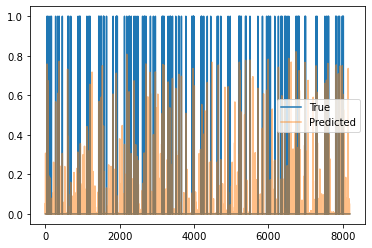

Train Epoch: 10 [1210/2220 (54%)]	Loss: 0.027809	Pres: 0.048282	F1 Score: 0.019758
Train Epoch: 10 [1220/2220 (54%)]	Loss: 0.028886	Pres: 0.040293	F1 Score: 0.017548
Train Epoch: 10 [1230/2220 (55%)]	Loss: 0.025837	Pres: 0.049804	F1 Score: 0.019277
Train Epoch: 10 [1240/2220 (55%)]	Loss: 0.026303	Pres: 0.051017	F1 Score: 0.022005
Train Epoch: 10 [1250/2220 (56%)]	Loss: 0.025827	Pres: 0.047246	F1 Score: 0.018706
Train Epoch: 10 [1260/2220 (56%)]	Loss: 0.025646	Pres: 0.047571	F1 Score: 0.019798
Train Epoch: 10 [1270/2220 (57%)]	Loss: 0.025547	Pres: 0.046851	F1 Score: 0.019066
Train Epoch: 10 [1280/2220 (57%)]	Loss: 0.024040	Pres: 0.048255	F1 Score: 0.020261
Train Epoch: 10 [1290/2220 (58%)]	Loss: 0.031282	Pres: 0.038936	F1 Score: 0.012410
Train Epoch: 10 [1300/2220 (58%)]	Loss: 0.028307	Pres: 0.039188	F1 Score: 0.013605
Train Epoch: 10 [1310/2220 (59%)]	Loss: 0.025654	Pres: 0.037892	F1 Score: 0.017575
Train Epoch: 10 [1320/2220 (59%)]	Loss: 0.023895	Pres: 0.047685	F1 Score: 0.017824
Trai

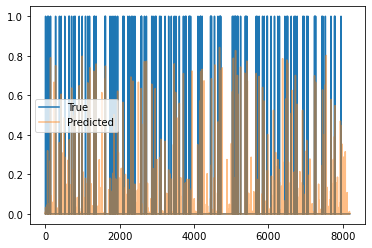

Train Epoch: 10 [1510/2220 (68%)]	Loss: 0.027259	Pres: 0.047853	F1 Score: 0.016681
Train Epoch: 10 [1520/2220 (68%)]	Loss: 0.026673	Pres: 0.045807	F1 Score: 0.017073
Train Epoch: 10 [1530/2220 (68%)]	Loss: 0.025863	Pres: 0.042708	F1 Score: 0.018576
Train Epoch: 10 [1540/2220 (69%)]	Loss: 0.028843	Pres: 0.045032	F1 Score: 0.019406
Train Epoch: 10 [1550/2220 (69%)]	Loss: 0.023874	Pres: 0.046128	F1 Score: 0.019028
Train Epoch: 10 [1560/2220 (70%)]	Loss: 0.026624	Pres: 0.044929	F1 Score: 0.018749
Train Epoch: 10 [1570/2220 (70%)]	Loss: 0.029209	Pres: 0.046714	F1 Score: 0.016948
Train Epoch: 10 [1580/2220 (71%)]	Loss: 0.029421	Pres: 0.047068	F1 Score: 0.017783
Train Epoch: 10 [1590/2220 (71%)]	Loss: 0.023825	Pres: 0.049763	F1 Score: 0.021958
Train Epoch: 10 [1600/2220 (72%)]	Loss: 0.028015	Pres: 0.047537	F1 Score: 0.019747
Train Epoch: 10 [1610/2220 (72%)]	Loss: 0.030006	Pres: 0.050881	F1 Score: 0.017113
Train Epoch: 10 [1620/2220 (72%)]	Loss: 0.027517	Pres: 0.046302	F1 Score: 0.016959
Trai

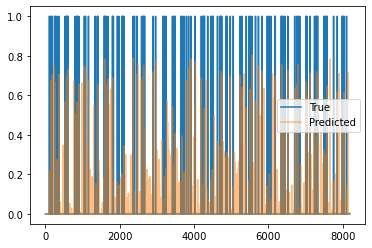

Train Epoch: 10 [1810/2220 (81%)]	Loss: 0.028198	Pres: 0.049684	F1 Score: 0.016562
Train Epoch: 10 [1820/2220 (81%)]	Loss: 0.031392	Pres: 0.040173	F1 Score: 0.014942
Train Epoch: 10 [1830/2220 (82%)]	Loss: 0.030169	Pres: 0.056256	F1 Score: 0.021127
Train Epoch: 10 [1840/2220 (82%)]	Loss: 0.028940	Pres: 0.050865	F1 Score: 0.018217
Train Epoch: 10 [1850/2220 (83%)]	Loss: 0.027246	Pres: 0.046052	F1 Score: 0.016698
Train Epoch: 10 [1860/2220 (83%)]	Loss: 0.026262	Pres: 0.048486	F1 Score: 0.020118
Train Epoch: 10 [1870/2220 (84%)]	Loss: 0.026646	Pres: 0.047608	F1 Score: 0.018099
Train Epoch: 10 [1880/2220 (84%)]	Loss: 0.031156	Pres: 0.048739	F1 Score: 0.016734
Train Epoch: 10 [1890/2220 (85%)]	Loss: 0.026500	Pres: 0.045100	F1 Score: 0.017838
Train Epoch: 10 [1900/2220 (85%)]	Loss: 0.027689	Pres: 0.054209	F1 Score: 0.019578
Train Epoch: 10 [1910/2220 (86%)]	Loss: 0.022859	Pres: 0.050130	F1 Score: 0.022126
Train Epoch: 10 [1920/2220 (86%)]	Loss: 0.032654	Pres: 0.046127	F1 Score: 0.015551
Trai

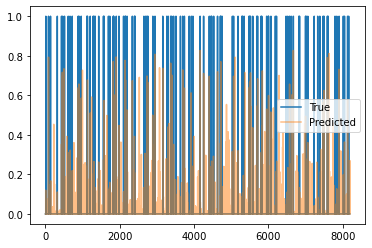

Train Epoch: 10 [2110/2220 (95%)]	Loss: 0.029629	Pres: 0.044030	F1 Score: 0.014957
Train Epoch: 10 [2120/2220 (95%)]	Loss: 0.032254	Pres: 0.035617	F1 Score: 0.012101
Train Epoch: 10 [2130/2220 (95%)]	Loss: 0.031300	Pres: 0.043101	F1 Score: 0.015298
Train Epoch: 10 [2140/2220 (96%)]	Loss: 0.026144	Pres: 0.052667	F1 Score: 0.020020
Train Epoch: 10 [2150/2220 (96%)]	Loss: 0.026351	Pres: 0.042366	F1 Score: 0.014655
Train Epoch: 10 [2160/2220 (97%)]	Loss: 0.029530	Pres: 0.047675	F1 Score: 0.017024
Train Epoch: 10 [2170/2220 (97%)]	Loss: 0.026167	Pres: 0.045486	F1 Score: 0.017283
Train Epoch: 10 [2180/2220 (98%)]	Loss: 0.029386	Pres: 0.045616	F1 Score: 0.015436
Train Epoch: 10 [2190/2220 (98%)]	Loss: 0.029331	Pres: 0.047651	F1 Score: 0.016497
Train Epoch: 10 [2200/2220 (99%)]	Loss: 0.026616	Pres: 0.053148	F1 Score: 0.019375
Train Epoch: 10 [2210/2220 (99%)]	Loss: 0.025358	Pres: 0.047460	F1 Score: 0.018944
Validation Epoch: 10 [0/582 (0%)]	Loss: 0.022306	Pres: 0.056624	F1 Score: 0.024399


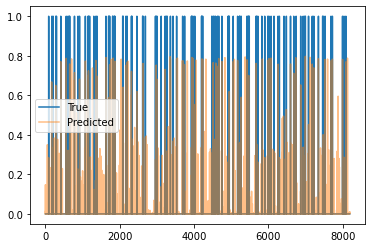

Validation Epoch: 10 [10/582 (1%)]	Loss: 0.024523	Pres: 0.049923	F1 Score: 0.019878
Validation Epoch: 10 [20/582 (3%)]	Loss: 0.023295	Pres: 0.048413	F1 Score: 0.020649
Validation Epoch: 10 [30/582 (5%)]	Loss: 0.020523	Pres: 0.061250	F1 Score: 0.026227
Validation Epoch: 10 [40/582 (6%)]	Loss: 0.021486	Pres: 0.055423	F1 Score: 0.023478
Validation Epoch: 10 [50/582 (8%)]	Loss: 0.022366	Pres: 0.057555	F1 Score: 0.025003
Validation Epoch: 10 [60/582 (10%)]	Loss: 0.019427	Pres: 0.054248	F1 Score: 0.028845
Validation Epoch: 10 [70/582 (12%)]	Loss: 0.022544	Pres: 0.057314	F1 Score: 0.024618
Validation Epoch: 10 [80/582 (13%)]	Loss: 0.021143	Pres: 0.060378	F1 Score: 0.025627
Validation Epoch: 10 [90/582 (15%)]	Loss: 0.020779	Pres: 0.056739	F1 Score: 0.023909
Validation Epoch: 10 [100/582 (17%)]	Loss: 0.021353	Pres: 0.053913	F1 Score: 0.024987
Validation Epoch: 10 [110/582 (18%)]	Loss: 0.022349	Pres: 0.058462	F1 Score: 0.022303
Validation Epoch: 10 [120/582 (20%)]	Loss: 0.021519	Pres: 0.051321	F

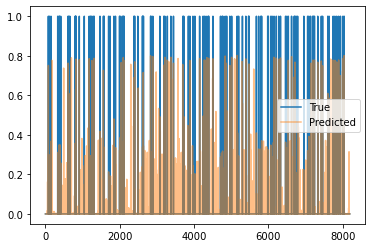

Validation Epoch: 10 [310/582 (53%)]	Loss: 0.022370	Pres: 0.050437	F1 Score: 0.024056
Validation Epoch: 10 [320/582 (54%)]	Loss: 0.020352	Pres: 0.053348	F1 Score: 0.024559
Validation Epoch: 10 [330/582 (56%)]	Loss: 0.021873	Pres: 0.060820	F1 Score: 0.027356
Validation Epoch: 10 [340/582 (58%)]	Loss: 0.022402	Pres: 0.061012	F1 Score: 0.027603
Validation Epoch: 10 [350/582 (60%)]	Loss: 0.019630	Pres: 0.059650	F1 Score: 0.029045
Validation Epoch: 10 [360/582 (61%)]	Loss: 0.024006	Pres: 0.051590	F1 Score: 0.022595
Validation Epoch: 10 [370/582 (63%)]	Loss: 0.020237	Pres: 0.058239	F1 Score: 0.026742
Validation Epoch: 10 [380/582 (65%)]	Loss: 0.023030	Pres: 0.053120	F1 Score: 0.022199
Validation Epoch: 10 [390/582 (67%)]	Loss: 0.020339	Pres: 0.047683	F1 Score: 0.026707
Validation Epoch: 10 [400/582 (68%)]	Loss: 0.020742	Pres: 0.057362	F1 Score: 0.025660
Validation Epoch: 10 [410/582 (70%)]	Loss: 0.022298	Pres: 0.056632	F1 Score: 0.023473
Validation Epoch: 10 [420/582 (72%)]	Loss: 0.020854	Pr

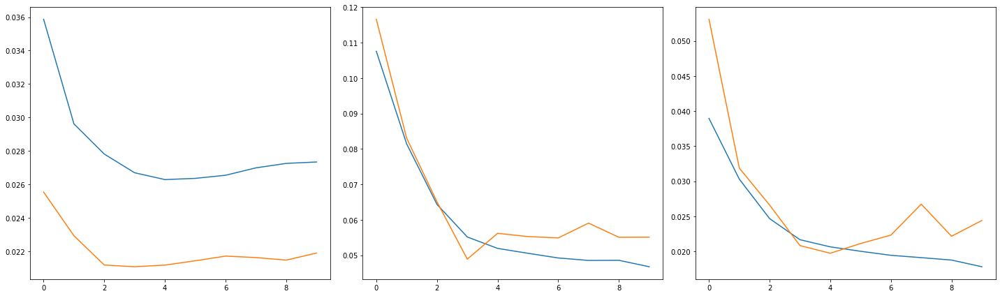

2220 582
Train Epoch: 11 [0/2220 (0%)]	Loss: 0.025074	Pres: 0.047851	F1 Score: 0.019592
109.0 -inf


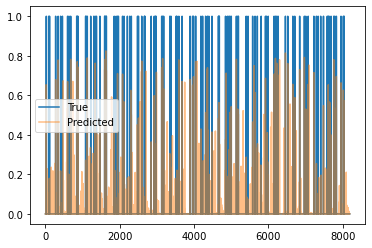

Train Epoch: 11 [10/2220 (0%)]	Loss: 0.027350	Pres: 0.050142	F1 Score: 0.018271
Train Epoch: 11 [20/2220 (0%)]	Loss: 0.025885	Pres: 0.042528	F1 Score: 0.016504
Train Epoch: 11 [30/2220 (1%)]	Loss: 0.022760	Pres: 0.048252	F1 Score: 0.022952
Train Epoch: 11 [40/2220 (1%)]	Loss: 0.024161	Pres: 0.047308	F1 Score: 0.020306
Train Epoch: 11 [50/2220 (2%)]	Loss: 0.025145	Pres: 0.041612	F1 Score: 0.015695
Train Epoch: 11 [60/2220 (2%)]	Loss: 0.031029	Pres: 0.044813	F1 Score: 0.014894
Train Epoch: 11 [70/2220 (3%)]	Loss: 0.025884	Pres: 0.049894	F1 Score: 0.020277
Train Epoch: 11 [80/2220 (3%)]	Loss: 0.025713	Pres: 0.056374	F1 Score: 0.019835
Train Epoch: 11 [90/2220 (4%)]	Loss: 0.024039	Pres: 0.052477	F1 Score: 0.018906
Train Epoch: 11 [100/2220 (4%)]	Loss: 0.028774	Pres: 0.045213	F1 Score: 0.012871
Train Epoch: 11 [110/2220 (4%)]	Loss: 0.021638	Pres: 0.047041	F1 Score: 0.020760
Train Epoch: 11 [120/2220 (5%)]	Loss: 0.027233	Pres: 0.049719	F1 Score: 0.016715
Train Epoch: 11 [130/2220 (5%)]	Loss:

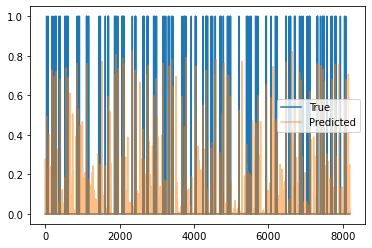

Train Epoch: 11 [310/2220 (13%)]	Loss: 0.030635	Pres: 0.052259	F1 Score: 0.017865
Train Epoch: 11 [320/2220 (14%)]	Loss: 0.026930	Pres: 0.047826	F1 Score: 0.016552
Train Epoch: 11 [330/2220 (14%)]	Loss: 0.029782	Pres: 0.049005	F1 Score: 0.013561
Train Epoch: 11 [340/2220 (15%)]	Loss: 0.032188	Pres: 0.045465	F1 Score: 0.015141
Train Epoch: 11 [350/2220 (15%)]	Loss: 0.025334	Pres: 0.037419	F1 Score: 0.016026
Train Epoch: 11 [360/2220 (16%)]	Loss: 0.024031	Pres: 0.041898	F1 Score: 0.018990
Train Epoch: 11 [370/2220 (16%)]	Loss: 0.030732	Pres: 0.054880	F1 Score: 0.018247
Train Epoch: 11 [380/2220 (17%)]	Loss: 0.028985	Pres: 0.043744	F1 Score: 0.015520
Train Epoch: 11 [390/2220 (17%)]	Loss: 0.025898	Pres: 0.044520	F1 Score: 0.016595
Train Epoch: 11 [400/2220 (18%)]	Loss: 0.025612	Pres: 0.052670	F1 Score: 0.020119
Train Epoch: 11 [410/2220 (18%)]	Loss: 0.029075	Pres: 0.050528	F1 Score: 0.017816
Train Epoch: 11 [420/2220 (18%)]	Loss: 0.023300	Pres: 0.046180	F1 Score: 0.021962
Train Epoch: 11 

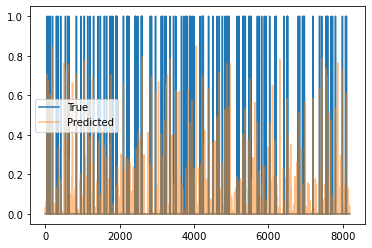

Train Epoch: 11 [610/2220 (27%)]	Loss: 0.025930	Pres: 0.043568	F1 Score: 0.017827
Train Epoch: 11 [620/2220 (27%)]	Loss: 0.024588	Pres: 0.042858	F1 Score: 0.019335
Train Epoch: 11 [630/2220 (28%)]	Loss: 0.026764	Pres: 0.046704	F1 Score: 0.017151
Train Epoch: 11 [640/2220 (28%)]	Loss: 0.027566	Pres: 0.041693	F1 Score: 0.017034
Train Epoch: 11 [650/2220 (29%)]	Loss: 0.025810	Pres: 0.044558	F1 Score: 0.018241
Train Epoch: 11 [660/2220 (29%)]	Loss: 0.023061	Pres: 0.043044	F1 Score: 0.019019
Train Epoch: 11 [670/2220 (30%)]	Loss: 0.025559	Pres: 0.046541	F1 Score: 0.014622
Train Epoch: 11 [680/2220 (30%)]	Loss: 0.025349	Pres: 0.044284	F1 Score: 0.017229
Train Epoch: 11 [690/2220 (31%)]	Loss: 0.027176	Pres: 0.047536	F1 Score: 0.016320
Train Epoch: 11 [700/2220 (31%)]	Loss: 0.025311	Pres: 0.057658	F1 Score: 0.021432
Train Epoch: 11 [710/2220 (31%)]	Loss: 0.029964	Pres: 0.052859	F1 Score: 0.016510
Train Epoch: 11 [720/2220 (32%)]	Loss: 0.026713	Pres: 0.050128	F1 Score: 0.018065
Train Epoch: 11 

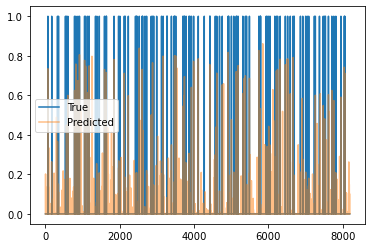

Train Epoch: 11 [910/2220 (40%)]	Loss: 0.024871	Pres: 0.045185	F1 Score: 0.017177
Train Epoch: 11 [920/2220 (41%)]	Loss: 0.027763	Pres: 0.046931	F1 Score: 0.017283
Train Epoch: 11 [930/2220 (41%)]	Loss: 0.028612	Pres: 0.054073	F1 Score: 0.020056
Train Epoch: 11 [940/2220 (42%)]	Loss: 0.028155	Pres: 0.049217	F1 Score: 0.019435
Train Epoch: 11 [950/2220 (42%)]	Loss: 0.027751	Pres: 0.047316	F1 Score: 0.016177
Train Epoch: 11 [960/2220 (43%)]	Loss: 0.027431	Pres: 0.043210	F1 Score: 0.016643
Train Epoch: 11 [970/2220 (43%)]	Loss: 0.023971	Pres: 0.043787	F1 Score: 0.020552
Train Epoch: 11 [980/2220 (44%)]	Loss: 0.029861	Pres: 0.043120	F1 Score: 0.015550
Train Epoch: 11 [990/2220 (44%)]	Loss: 0.026745	Pres: 0.043211	F1 Score: 0.018666
Train Epoch: 11 [1000/2220 (45%)]	Loss: 0.029086	Pres: 0.047078	F1 Score: 0.015330
Train Epoch: 11 [1010/2220 (45%)]	Loss: 0.027276	Pres: 0.046474	F1 Score: 0.017019
Train Epoch: 11 [1020/2220 (45%)]	Loss: 0.027829	Pres: 0.041314	F1 Score: 0.016840
Train Epoch: 

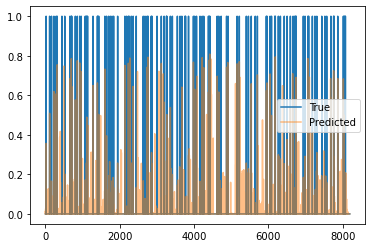

Train Epoch: 11 [1210/2220 (54%)]	Loss: 0.027027	Pres: 0.050098	F1 Score: 0.018208
Train Epoch: 11 [1220/2220 (54%)]	Loss: 0.028051	Pres: 0.048834	F1 Score: 0.020294
Train Epoch: 11 [1230/2220 (55%)]	Loss: 0.024700	Pres: 0.050303	F1 Score: 0.022895
Train Epoch: 11 [1240/2220 (55%)]	Loss: 0.024007	Pres: 0.054366	F1 Score: 0.021092
Train Epoch: 11 [1250/2220 (56%)]	Loss: 0.025712	Pres: 0.048631	F1 Score: 0.017712
Train Epoch: 11 [1260/2220 (56%)]	Loss: 0.027635	Pres: 0.036881	F1 Score: 0.015796
Train Epoch: 11 [1270/2220 (57%)]	Loss: 0.025074	Pres: 0.039765	F1 Score: 0.017170
Train Epoch: 11 [1280/2220 (57%)]	Loss: 0.025383	Pres: 0.053947	F1 Score: 0.019076
Train Epoch: 11 [1290/2220 (58%)]	Loss: 0.027677	Pres: 0.049261	F1 Score: 0.019142
Train Epoch: 11 [1300/2220 (58%)]	Loss: 0.024290	Pres: 0.041621	F1 Score: 0.013770
Train Epoch: 11 [1310/2220 (59%)]	Loss: 0.028677	Pres: 0.036735	F1 Score: 0.013833
Train Epoch: 11 [1320/2220 (59%)]	Loss: 0.024708	Pres: 0.054361	F1 Score: 0.020520
Trai

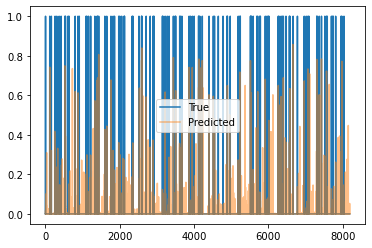

Train Epoch: 11 [1510/2220 (68%)]	Loss: 0.026289	Pres: 0.043078	F1 Score: 0.016490
Train Epoch: 11 [1520/2220 (68%)]	Loss: 0.028368	Pres: 0.045587	F1 Score: 0.016818
Train Epoch: 11 [1530/2220 (68%)]	Loss: 0.028700	Pres: 0.037083	F1 Score: 0.013969
Train Epoch: 11 [1540/2220 (69%)]	Loss: 0.024142	Pres: 0.052083	F1 Score: 0.019236
Train Epoch: 11 [1550/2220 (69%)]	Loss: 0.025129	Pres: 0.042709	F1 Score: 0.017540
Train Epoch: 11 [1560/2220 (70%)]	Loss: 0.027289	Pres: 0.048852	F1 Score: 0.020177
Train Epoch: 11 [1570/2220 (70%)]	Loss: 0.027050	Pres: 0.050214	F1 Score: 0.016720
Train Epoch: 11 [1580/2220 (71%)]	Loss: 0.028929	Pres: 0.036415	F1 Score: 0.014215
Train Epoch: 11 [1590/2220 (71%)]	Loss: 0.030632	Pres: 0.050645	F1 Score: 0.015841
Train Epoch: 11 [1600/2220 (72%)]	Loss: 0.026721	Pres: 0.045790	F1 Score: 0.020252
Train Epoch: 11 [1610/2220 (72%)]	Loss: 0.025788	Pres: 0.041593	F1 Score: 0.016838
Train Epoch: 11 [1620/2220 (72%)]	Loss: 0.025000	Pres: 0.042090	F1 Score: 0.015755
Trai

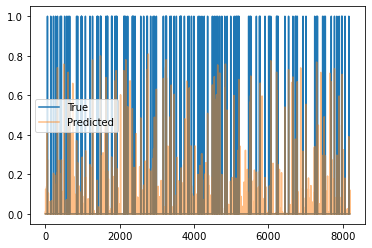

Train Epoch: 11 [1810/2220 (81%)]	Loss: 0.024448	Pres: 0.046955	F1 Score: 0.020588
Train Epoch: 11 [1820/2220 (81%)]	Loss: 0.038095	Pres: 0.046883	F1 Score: 0.010771
Train Epoch: 11 [1830/2220 (82%)]	Loss: 0.026252	Pres: 0.046421	F1 Score: 0.017082
Train Epoch: 11 [1840/2220 (82%)]	Loss: 0.027978	Pres: 0.050061	F1 Score: 0.016982
Train Epoch: 11 [1850/2220 (83%)]	Loss: 0.022913	Pres: 0.047423	F1 Score: 0.019759
Train Epoch: 11 [1860/2220 (83%)]	Loss: 0.028217	Pres: 0.049514	F1 Score: 0.018469
Train Epoch: 11 [1870/2220 (84%)]	Loss: 0.027681	Pres: 0.053721	F1 Score: 0.018224
Train Epoch: 11 [1880/2220 (84%)]	Loss: 0.027395	Pres: 0.048764	F1 Score: 0.015821
Train Epoch: 11 [1890/2220 (85%)]	Loss: 0.024988	Pres: 0.045564	F1 Score: 0.020689
Train Epoch: 11 [1900/2220 (85%)]	Loss: 0.029100	Pres: 0.041327	F1 Score: 0.015078
Train Epoch: 11 [1910/2220 (86%)]	Loss: 0.027081	Pres: 0.054463	F1 Score: 0.020888
Train Epoch: 11 [1920/2220 (86%)]	Loss: 0.024029	Pres: 0.041550	F1 Score: 0.017435
Trai

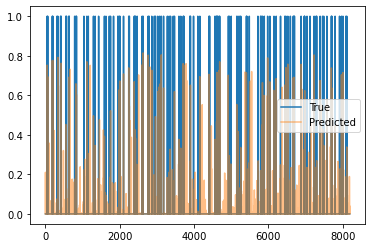

Train Epoch: 11 [2110/2220 (95%)]	Loss: 0.026711	Pres: 0.047907	F1 Score: 0.018315
Train Epoch: 11 [2120/2220 (95%)]	Loss: 0.024102	Pres: 0.044738	F1 Score: 0.018593
Train Epoch: 11 [2130/2220 (95%)]	Loss: 0.026292	Pres: 0.043899	F1 Score: 0.015312
Train Epoch: 11 [2140/2220 (96%)]	Loss: 0.025110	Pres: 0.049071	F1 Score: 0.018774
Train Epoch: 11 [2150/2220 (96%)]	Loss: 0.025255	Pres: 0.053143	F1 Score: 0.021075
Train Epoch: 11 [2160/2220 (97%)]	Loss: 0.025056	Pres: 0.042507	F1 Score: 0.019266
Train Epoch: 11 [2170/2220 (97%)]	Loss: 0.026206	Pres: 0.042815	F1 Score: 0.015390
Train Epoch: 11 [2180/2220 (98%)]	Loss: 0.025302	Pres: 0.041789	F1 Score: 0.018287
Train Epoch: 11 [2190/2220 (98%)]	Loss: 0.023845	Pres: 0.045558	F1 Score: 0.020493
Train Epoch: 11 [2200/2220 (99%)]	Loss: 0.027444	Pres: 0.043743	F1 Score: 0.015890
Train Epoch: 11 [2210/2220 (99%)]	Loss: 0.026287	Pres: 0.040223	F1 Score: 0.016022
Validation Epoch: 11 [0/582 (0%)]	Loss: 0.022963	Pres: 0.057446	F1 Score: 0.024191


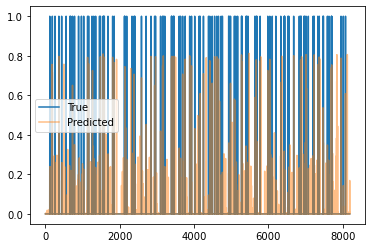

Validation Epoch: 11 [10/582 (1%)]	Loss: 0.019603	Pres: 0.049590	F1 Score: 0.027375
Validation Epoch: 11 [20/582 (3%)]	Loss: 0.022854	Pres: 0.058420	F1 Score: 0.022377
Validation Epoch: 11 [30/582 (5%)]	Loss: 0.020240	Pres: 0.054149	F1 Score: 0.025385
Validation Epoch: 11 [40/582 (6%)]	Loss: 0.018591	Pres: 0.055431	F1 Score: 0.027558
Validation Epoch: 11 [50/582 (8%)]	Loss: 0.022891	Pres: 0.042932	F1 Score: 0.020186
Validation Epoch: 11 [60/582 (10%)]	Loss: 0.019551	Pres: 0.061068	F1 Score: 0.026219
Validation Epoch: 11 [70/582 (12%)]	Loss: 0.022784	Pres: 0.055901	F1 Score: 0.023157
Validation Epoch: 11 [80/582 (13%)]	Loss: 0.022386	Pres: 0.054410	F1 Score: 0.023972
Validation Epoch: 11 [90/582 (15%)]	Loss: 0.023167	Pres: 0.054244	F1 Score: 0.021642
Validation Epoch: 11 [100/582 (17%)]	Loss: 0.020296	Pres: 0.054420	F1 Score: 0.025802
Validation Epoch: 11 [110/582 (18%)]	Loss: 0.021350	Pres: 0.058624	F1 Score: 0.025364
Validation Epoch: 11 [120/582 (20%)]	Loss: 0.021243	Pres: 0.050038	F

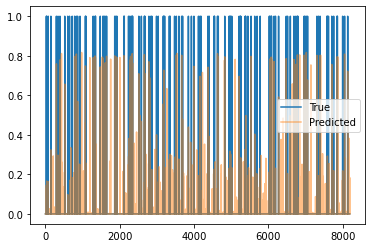

Validation Epoch: 11 [310/582 (53%)]	Loss: 0.020632	Pres: 0.057043	F1 Score: 0.025037
Validation Epoch: 11 [320/582 (54%)]	Loss: 0.021808	Pres: 0.051790	F1 Score: 0.024159
Validation Epoch: 11 [330/582 (56%)]	Loss: 0.021644	Pres: 0.048794	F1 Score: 0.023948
Validation Epoch: 11 [340/582 (58%)]	Loss: 0.021777	Pres: 0.061122	F1 Score: 0.024893
Validation Epoch: 11 [350/582 (60%)]	Loss: 0.021701	Pres: 0.053594	F1 Score: 0.025747
Validation Epoch: 11 [360/582 (61%)]	Loss: 0.022991	Pres: 0.050106	F1 Score: 0.021212
Validation Epoch: 11 [370/582 (63%)]	Loss: 0.021560	Pres: 0.051726	F1 Score: 0.026099
Validation Epoch: 11 [380/582 (65%)]	Loss: 0.020419	Pres: 0.059572	F1 Score: 0.025144
Validation Epoch: 11 [390/582 (67%)]	Loss: 0.020579	Pres: 0.049433	F1 Score: 0.023435
Validation Epoch: 11 [400/582 (68%)]	Loss: 0.021031	Pres: 0.048415	F1 Score: 0.022484
Validation Epoch: 11 [410/582 (70%)]	Loss: 0.020992	Pres: 0.053338	F1 Score: 0.025538
Validation Epoch: 11 [420/582 (72%)]	Loss: 0.020675	Pr

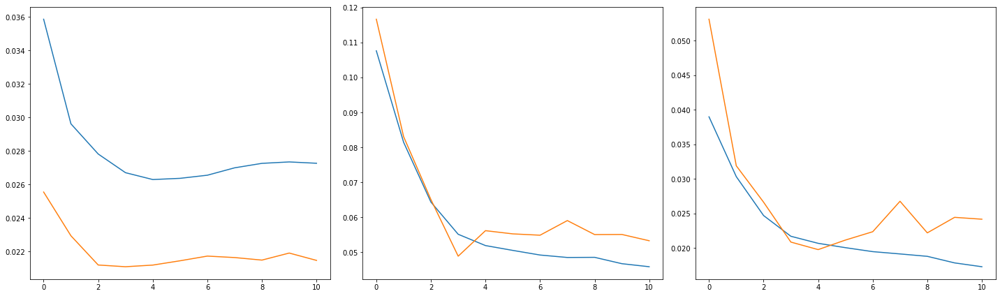

2220 582
Train Epoch: 12 [0/2220 (0%)]	Loss: 0.026000	Pres: 0.046885	F1 Score: 0.017961
108.0 -inf


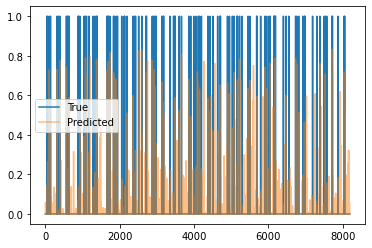

Train Epoch: 12 [10/2220 (0%)]	Loss: 0.025482	Pres: 0.047619	F1 Score: 0.015709
Train Epoch: 12 [20/2220 (0%)]	Loss: 0.023557	Pres: 0.043281	F1 Score: 0.019001
Train Epoch: 12 [30/2220 (1%)]	Loss: 0.024737	Pres: 0.040889	F1 Score: 0.016864
Train Epoch: 12 [40/2220 (1%)]	Loss: 0.032738	Pres: 0.046839	F1 Score: 0.012745
Train Epoch: 12 [50/2220 (2%)]	Loss: 0.029764	Pres: 0.041648	F1 Score: 0.012889
Train Epoch: 12 [60/2220 (2%)]	Loss: 0.031175	Pres: 0.047747	F1 Score: 0.016768
Train Epoch: 12 [70/2220 (3%)]	Loss: 0.033162	Pres: 0.052724	F1 Score: 0.018326
Train Epoch: 12 [80/2220 (3%)]	Loss: 0.025596	Pres: 0.049692	F1 Score: 0.019709
Train Epoch: 12 [90/2220 (4%)]	Loss: 0.025032	Pres: 0.046240	F1 Score: 0.018719
Train Epoch: 12 [100/2220 (4%)]	Loss: 0.026778	Pres: 0.045385	F1 Score: 0.017396
Train Epoch: 12 [110/2220 (4%)]	Loss: 0.024181	Pres: 0.040394	F1 Score: 0.017960
Train Epoch: 12 [120/2220 (5%)]	Loss: 0.027919	Pres: 0.043769	F1 Score: 0.014213
Train Epoch: 12 [130/2220 (5%)]	Loss:

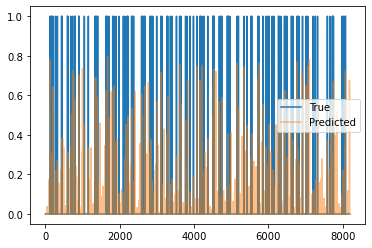

Train Epoch: 12 [310/2220 (13%)]	Loss: 0.025718	Pres: 0.050115	F1 Score: 0.018256
Train Epoch: 12 [320/2220 (14%)]	Loss: 0.027239	Pres: 0.042603	F1 Score: 0.017856
Train Epoch: 12 [330/2220 (14%)]	Loss: 0.025571	Pres: 0.041667	F1 Score: 0.017300
Train Epoch: 12 [340/2220 (15%)]	Loss: 0.027391	Pres: 0.047533	F1 Score: 0.017941
Train Epoch: 12 [350/2220 (15%)]	Loss: 0.021946	Pres: 0.045117	F1 Score: 0.020290
Train Epoch: 12 [360/2220 (16%)]	Loss: 0.028919	Pres: 0.054487	F1 Score: 0.017132
Train Epoch: 12 [370/2220 (16%)]	Loss: 0.026770	Pres: 0.047170	F1 Score: 0.018368
Train Epoch: 12 [380/2220 (17%)]	Loss: 0.028893	Pres: 0.052130	F1 Score: 0.017905
Train Epoch: 12 [390/2220 (17%)]	Loss: 0.025453	Pres: 0.051638	F1 Score: 0.022276
Train Epoch: 12 [400/2220 (18%)]	Loss: 0.025260	Pres: 0.038630	F1 Score: 0.018411
Train Epoch: 12 [410/2220 (18%)]	Loss: 0.024903	Pres: 0.046606	F1 Score: 0.020301
Train Epoch: 12 [420/2220 (18%)]	Loss: 0.026758	Pres: 0.049494	F1 Score: 0.019269
Train Epoch: 12 

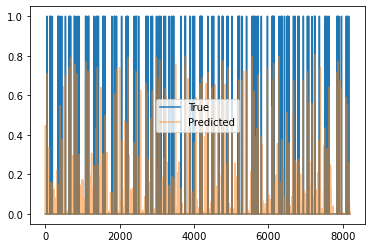

Train Epoch: 12 [610/2220 (27%)]	Loss: 0.026958	Pres: 0.052448	F1 Score: 0.019602
Train Epoch: 12 [620/2220 (27%)]	Loss: 0.027601	Pres: 0.048957	F1 Score: 0.016086
Train Epoch: 12 [630/2220 (28%)]	Loss: 0.040023	Pres: 0.041627	F1 Score: 0.009726
Train Epoch: 12 [640/2220 (28%)]	Loss: 0.026004	Pres: 0.045509	F1 Score: 0.019233
Train Epoch: 12 [650/2220 (29%)]	Loss: 0.026921	Pres: 0.044211	F1 Score: 0.017167
Train Epoch: 12 [660/2220 (29%)]	Loss: 0.027847	Pres: 0.048463	F1 Score: 0.016874
Train Epoch: 12 [670/2220 (30%)]	Loss: 0.035438	Pres: 0.036207	F1 Score: 0.010820
Train Epoch: 12 [680/2220 (30%)]	Loss: 0.030797	Pres: 0.048495	F1 Score: 0.017258
Train Epoch: 12 [690/2220 (31%)]	Loss: 0.028772	Pres: 0.046227	F1 Score: 0.017344
Train Epoch: 12 [700/2220 (31%)]	Loss: 0.028233	Pres: 0.052050	F1 Score: 0.019179
Train Epoch: 12 [710/2220 (31%)]	Loss: 0.029872	Pres: 0.038492	F1 Score: 0.011725
Train Epoch: 12 [720/2220 (32%)]	Loss: 0.026781	Pres: 0.046425	F1 Score: 0.016748
Train Epoch: 12 

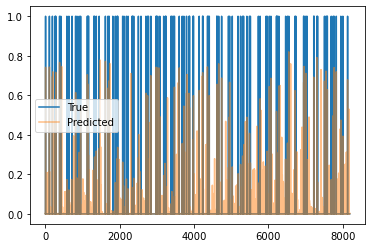

Train Epoch: 12 [910/2220 (40%)]	Loss: 0.029815	Pres: 0.045238	F1 Score: 0.014115
Train Epoch: 12 [920/2220 (41%)]	Loss: 0.025208	Pres: 0.046520	F1 Score: 0.016404
Train Epoch: 12 [930/2220 (41%)]	Loss: 0.034262	Pres: 0.043729	F1 Score: 0.013285
Train Epoch: 12 [940/2220 (42%)]	Loss: 0.026139	Pres: 0.044243	F1 Score: 0.017716
Train Epoch: 12 [950/2220 (42%)]	Loss: 0.026740	Pres: 0.042535	F1 Score: 0.015466
Train Epoch: 12 [960/2220 (43%)]	Loss: 0.025333	Pres: 0.040475	F1 Score: 0.015126
Train Epoch: 12 [970/2220 (43%)]	Loss: 0.030376	Pres: 0.045367	F1 Score: 0.014787
Train Epoch: 12 [980/2220 (44%)]	Loss: 0.027520	Pres: 0.043141	F1 Score: 0.017136
Train Epoch: 12 [990/2220 (44%)]	Loss: 0.024575	Pres: 0.045765	F1 Score: 0.019000
Train Epoch: 12 [1000/2220 (45%)]	Loss: 0.028629	Pres: 0.046288	F1 Score: 0.018367
Train Epoch: 12 [1010/2220 (45%)]	Loss: 0.032318	Pres: 0.046493	F1 Score: 0.011860
Train Epoch: 12 [1020/2220 (45%)]	Loss: 0.025251	Pres: 0.047859	F1 Score: 0.018592
Train Epoch: 

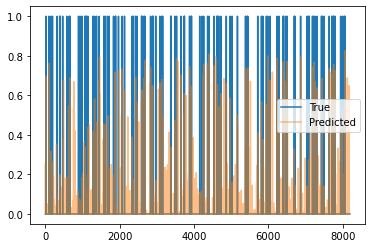

Train Epoch: 12 [1210/2220 (54%)]	Loss: 0.027330	Pres: 0.044260	F1 Score: 0.018723
Train Epoch: 12 [1220/2220 (54%)]	Loss: 0.027053	Pres: 0.051354	F1 Score: 0.019217
Train Epoch: 12 [1230/2220 (55%)]	Loss: 0.028298	Pres: 0.038211	F1 Score: 0.017034
Train Epoch: 12 [1240/2220 (55%)]	Loss: 0.028548	Pres: 0.048052	F1 Score: 0.016748
Train Epoch: 12 [1250/2220 (56%)]	Loss: 0.025846	Pres: 0.045286	F1 Score: 0.016936
Train Epoch: 12 [1260/2220 (56%)]	Loss: 0.028483	Pres: 0.037996	F1 Score: 0.012451
Train Epoch: 12 [1270/2220 (57%)]	Loss: 0.029752	Pres: 0.046627	F1 Score: 0.014549
Train Epoch: 12 [1280/2220 (57%)]	Loss: 0.021345	Pres: 0.043813	F1 Score: 0.019504
Train Epoch: 12 [1290/2220 (58%)]	Loss: 0.027848	Pres: 0.042032	F1 Score: 0.014750
Train Epoch: 12 [1300/2220 (58%)]	Loss: 0.026661	Pres: 0.054325	F1 Score: 0.019874
Train Epoch: 12 [1310/2220 (59%)]	Loss: 0.025646	Pres: 0.044038	F1 Score: 0.017078
Train Epoch: 12 [1320/2220 (59%)]	Loss: 0.026000	Pres: 0.042903	F1 Score: 0.014941
Trai

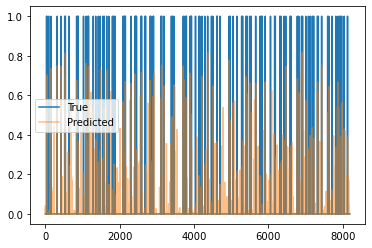

Train Epoch: 12 [1510/2220 (68%)]	Loss: 0.024158	Pres: 0.040964	F1 Score: 0.016974
Train Epoch: 12 [1520/2220 (68%)]	Loss: 0.029340	Pres: 0.047974	F1 Score: 0.016561
Train Epoch: 12 [1530/2220 (68%)]	Loss: 0.025246	Pres: 0.040360	F1 Score: 0.015106
Train Epoch: 12 [1540/2220 (69%)]	Loss: 0.026276	Pres: 0.043032	F1 Score: 0.016433
Train Epoch: 12 [1550/2220 (69%)]	Loss: 0.025919	Pres: 0.051613	F1 Score: 0.019610
Train Epoch: 12 [1560/2220 (70%)]	Loss: 0.025964	Pres: 0.050175	F1 Score: 0.020683
Train Epoch: 12 [1570/2220 (70%)]	Loss: 0.022749	Pres: 0.044251	F1 Score: 0.018241
Train Epoch: 12 [1580/2220 (71%)]	Loss: 0.026973	Pres: 0.041304	F1 Score: 0.014576
Train Epoch: 12 [1590/2220 (71%)]	Loss: 0.028322	Pres: 0.040980	F1 Score: 0.013116
Train Epoch: 12 [1600/2220 (72%)]	Loss: 0.027395	Pres: 0.043317	F1 Score: 0.015282
Train Epoch: 12 [1610/2220 (72%)]	Loss: 0.024302	Pres: 0.050431	F1 Score: 0.020121
Train Epoch: 12 [1620/2220 (72%)]	Loss: 0.031067	Pres: 0.050243	F1 Score: 0.018154
Trai

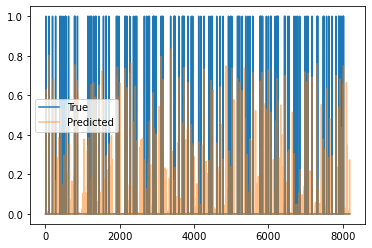

Train Epoch: 12 [1810/2220 (81%)]	Loss: 0.027102	Pres: 0.041666	F1 Score: 0.013815
Train Epoch: 12 [1820/2220 (81%)]	Loss: 0.024331	Pres: 0.045271	F1 Score: 0.017522
Train Epoch: 12 [1830/2220 (82%)]	Loss: 0.026962	Pres: 0.038443	F1 Score: 0.015553
Train Epoch: 12 [1840/2220 (82%)]	Loss: 0.026367	Pres: 0.043976	F1 Score: 0.016197
Train Epoch: 12 [1850/2220 (83%)]	Loss: 0.031181	Pres: 0.042327	F1 Score: 0.016070
Train Epoch: 12 [1860/2220 (83%)]	Loss: 0.028310	Pres: 0.047898	F1 Score: 0.018490
Train Epoch: 12 [1870/2220 (84%)]	Loss: 0.026008	Pres: 0.046574	F1 Score: 0.018090
Train Epoch: 12 [1880/2220 (84%)]	Loss: 0.030325	Pres: 0.048526	F1 Score: 0.015978
Train Epoch: 12 [1890/2220 (85%)]	Loss: 0.026239	Pres: 0.039352	F1 Score: 0.017121
Train Epoch: 12 [1900/2220 (85%)]	Loss: 0.029502	Pres: 0.045826	F1 Score: 0.015986
Train Epoch: 12 [1910/2220 (86%)]	Loss: 0.029986	Pres: 0.040393	F1 Score: 0.013407
Train Epoch: 12 [1920/2220 (86%)]	Loss: 0.026725	Pres: 0.049939	F1 Score: 0.015656
Trai

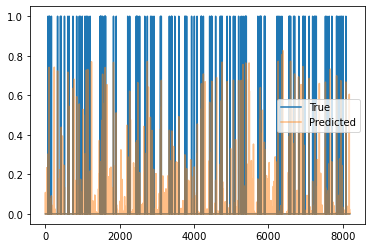

Train Epoch: 12 [2110/2220 (95%)]	Loss: 0.025849	Pres: 0.046797	F1 Score: 0.019180
Train Epoch: 12 [2120/2220 (95%)]	Loss: 0.027578	Pres: 0.041907	F1 Score: 0.012936
Train Epoch: 12 [2130/2220 (95%)]	Loss: 0.026287	Pres: 0.048405	F1 Score: 0.020002
Train Epoch: 12 [2140/2220 (96%)]	Loss: 0.026214	Pres: 0.045979	F1 Score: 0.013932
Train Epoch: 12 [2150/2220 (96%)]	Loss: 0.029532	Pres: 0.034355	F1 Score: 0.012511
Train Epoch: 12 [2160/2220 (97%)]	Loss: 0.025358	Pres: 0.047651	F1 Score: 0.017630
Train Epoch: 12 [2170/2220 (97%)]	Loss: 0.025514	Pres: 0.037202	F1 Score: 0.015665
Train Epoch: 12 [2180/2220 (98%)]	Loss: 0.023739	Pres: 0.044023	F1 Score: 0.018857
Train Epoch: 12 [2190/2220 (98%)]	Loss: 0.027965	Pres: 0.045411	F1 Score: 0.016134
Train Epoch: 12 [2200/2220 (99%)]	Loss: 0.027586	Pres: 0.042219	F1 Score: 0.014905
Train Epoch: 12 [2210/2220 (99%)]	Loss: 0.025215	Pres: 0.041693	F1 Score: 0.017047
Validation Epoch: 12 [0/582 (0%)]	Loss: 0.020401	Pres: 0.047771	F1 Score: 0.023656


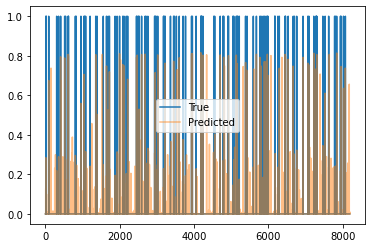

Validation Epoch: 12 [10/582 (1%)]	Loss: 0.022603	Pres: 0.052338	F1 Score: 0.023286
Validation Epoch: 12 [20/582 (3%)]	Loss: 0.020797	Pres: 0.051833	F1 Score: 0.024454
Validation Epoch: 12 [30/582 (5%)]	Loss: 0.021318	Pres: 0.048654	F1 Score: 0.022978
Validation Epoch: 12 [40/582 (6%)]	Loss: 0.020220	Pres: 0.057295	F1 Score: 0.026086
Validation Epoch: 12 [50/582 (8%)]	Loss: 0.023148	Pres: 0.053693	F1 Score: 0.022912
Validation Epoch: 12 [60/582 (10%)]	Loss: 0.021082	Pres: 0.056937	F1 Score: 0.023763
Validation Epoch: 12 [70/582 (12%)]	Loss: 0.020991	Pres: 0.059081	F1 Score: 0.023322
Validation Epoch: 12 [80/582 (13%)]	Loss: 0.022512	Pres: 0.041714	F1 Score: 0.020079
Validation Epoch: 12 [90/582 (15%)]	Loss: 0.022447	Pres: 0.049167	F1 Score: 0.021541
Validation Epoch: 12 [100/582 (17%)]	Loss: 0.020584	Pres: 0.057895	F1 Score: 0.024679
Validation Epoch: 12 [110/582 (18%)]	Loss: 0.021799	Pres: 0.055294	F1 Score: 0.022331
Validation Epoch: 12 [120/582 (20%)]	Loss: 0.023638	Pres: 0.039811	F

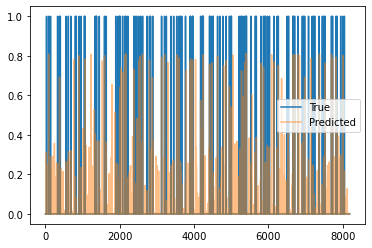

Validation Epoch: 12 [310/582 (53%)]	Loss: 0.021482	Pres: 0.060725	F1 Score: 0.023356
Validation Epoch: 12 [320/582 (54%)]	Loss: 0.020501	Pres: 0.052391	F1 Score: 0.024083
Validation Epoch: 12 [330/582 (56%)]	Loss: 0.019881	Pres: 0.043899	F1 Score: 0.025613
Validation Epoch: 12 [340/582 (58%)]	Loss: 0.020649	Pres: 0.058658	F1 Score: 0.025203
Validation Epoch: 12 [350/582 (60%)]	Loss: 0.022812	Pres: 0.049779	F1 Score: 0.019863
Validation Epoch: 12 [360/582 (61%)]	Loss: 0.021385	Pres: 0.051471	F1 Score: 0.023736
Validation Epoch: 12 [370/582 (63%)]	Loss: 0.020494	Pres: 0.054400	F1 Score: 0.025144
Validation Epoch: 12 [380/582 (65%)]	Loss: 0.019475	Pres: 0.047667	F1 Score: 0.023701
Validation Epoch: 12 [390/582 (67%)]	Loss: 0.022318	Pres: 0.053730	F1 Score: 0.020737
Validation Epoch: 12 [400/582 (68%)]	Loss: 0.022360	Pres: 0.055152	F1 Score: 0.021833
Validation Epoch: 12 [410/582 (70%)]	Loss: 0.022080	Pres: 0.054084	F1 Score: 0.022325
Validation Epoch: 12 [420/582 (72%)]	Loss: 0.021587	Pr

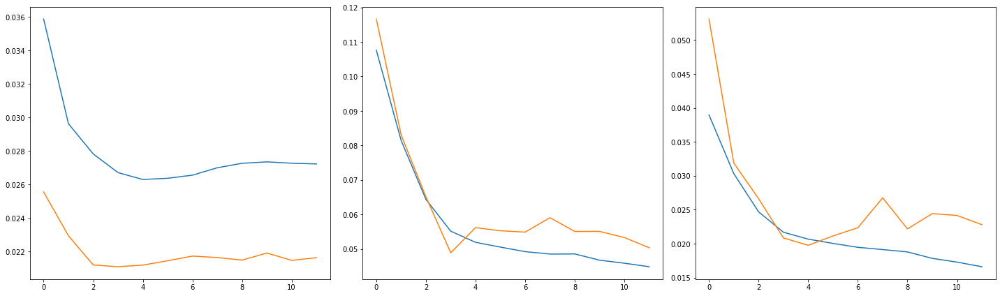

2220 582
Train Epoch: 13 [0/2220 (0%)]	Loss: 0.026560	Pres: 0.045868	F1 Score: 0.018616
111.0 -inf


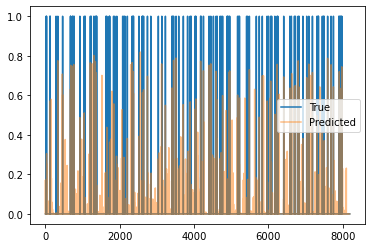

Train Epoch: 13 [10/2220 (0%)]	Loss: 0.028828	Pres: 0.040716	F1 Score: 0.014984
Train Epoch: 13 [20/2220 (0%)]	Loss: 0.025212	Pres: 0.044567	F1 Score: 0.017832
Train Epoch: 13 [30/2220 (1%)]	Loss: 0.025487	Pres: 0.047641	F1 Score: 0.017328
Train Epoch: 13 [40/2220 (1%)]	Loss: 0.025032	Pres: 0.042904	F1 Score: 0.015853
Train Epoch: 13 [50/2220 (2%)]	Loss: 0.026636	Pres: 0.040527	F1 Score: 0.016350
Train Epoch: 13 [60/2220 (2%)]	Loss: 0.030393	Pres: 0.052297	F1 Score: 0.016184
Train Epoch: 13 [70/2220 (3%)]	Loss: 0.027329	Pres: 0.044647	F1 Score: 0.015913
Train Epoch: 13 [80/2220 (3%)]	Loss: 0.027904	Pres: 0.033942	F1 Score: 0.011059
Train Epoch: 13 [90/2220 (4%)]	Loss: 0.028742	Pres: 0.044604	F1 Score: 0.015488
Train Epoch: 13 [100/2220 (4%)]	Loss: 0.026673	Pres: 0.047102	F1 Score: 0.017271
Train Epoch: 13 [110/2220 (4%)]	Loss: 0.027458	Pres: 0.048352	F1 Score: 0.015947
Train Epoch: 13 [120/2220 (5%)]	Loss: 0.028683	Pres: 0.037690	F1 Score: 0.013105
Train Epoch: 13 [130/2220 (5%)]	Loss:

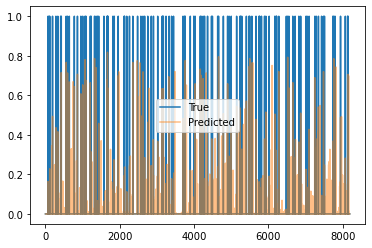

Train Epoch: 13 [310/2220 (13%)]	Loss: 0.027340	Pres: 0.044060	F1 Score: 0.017447
Train Epoch: 13 [320/2220 (14%)]	Loss: 0.025456	Pres: 0.042117	F1 Score: 0.016246
Train Epoch: 13 [330/2220 (14%)]	Loss: 0.026433	Pres: 0.044146	F1 Score: 0.017555
Train Epoch: 13 [340/2220 (15%)]	Loss: 0.028826	Pres: 0.044921	F1 Score: 0.015079
Train Epoch: 13 [350/2220 (15%)]	Loss: 0.024566	Pres: 0.042550	F1 Score: 0.017122
Train Epoch: 13 [360/2220 (16%)]	Loss: 0.025814	Pres: 0.039726	F1 Score: 0.015027
Train Epoch: 13 [370/2220 (16%)]	Loss: 0.027439	Pres: 0.037175	F1 Score: 0.013058
Train Epoch: 13 [380/2220 (17%)]	Loss: 0.028484	Pres: 0.041955	F1 Score: 0.013718
Train Epoch: 13 [390/2220 (17%)]	Loss: 0.027493	Pres: 0.043980	F1 Score: 0.016228
Train Epoch: 13 [400/2220 (18%)]	Loss: 0.026036	Pres: 0.043868	F1 Score: 0.013491
Train Epoch: 13 [410/2220 (18%)]	Loss: 0.031013	Pres: 0.039869	F1 Score: 0.011512
Train Epoch: 13 [420/2220 (18%)]	Loss: 0.026675	Pres: 0.042772	F1 Score: 0.015436
Train Epoch: 13 

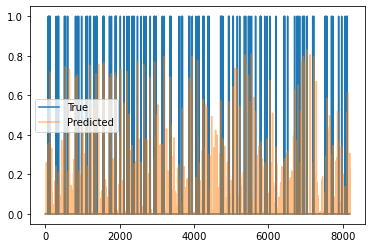

Train Epoch: 13 [610/2220 (27%)]	Loss: 0.027246	Pres: 0.040394	F1 Score: 0.015709
Train Epoch: 13 [620/2220 (27%)]	Loss: 0.026359	Pres: 0.035714	F1 Score: 0.013272
Train Epoch: 13 [630/2220 (28%)]	Loss: 0.031041	Pres: 0.042050	F1 Score: 0.017273
Train Epoch: 13 [640/2220 (28%)]	Loss: 0.025590	Pres: 0.042802	F1 Score: 0.016413
Train Epoch: 13 [650/2220 (29%)]	Loss: 0.029419	Pres: 0.049737	F1 Score: 0.017567
Train Epoch: 13 [660/2220 (29%)]	Loss: 0.026771	Pres: 0.043571	F1 Score: 0.016265
Train Epoch: 13 [670/2220 (30%)]	Loss: 0.029382	Pres: 0.048988	F1 Score: 0.017027
Train Epoch: 13 [680/2220 (30%)]	Loss: 0.032598	Pres: 0.035330	F1 Score: 0.012340
Train Epoch: 13 [690/2220 (31%)]	Loss: 0.025843	Pres: 0.047835	F1 Score: 0.015188
Train Epoch: 13 [700/2220 (31%)]	Loss: 0.026343	Pres: 0.044883	F1 Score: 0.015920
Train Epoch: 13 [710/2220 (31%)]	Loss: 0.026796	Pres: 0.041608	F1 Score: 0.016086
Train Epoch: 13 [720/2220 (32%)]	Loss: 0.026945	Pres: 0.043423	F1 Score: 0.016828
Train Epoch: 13 

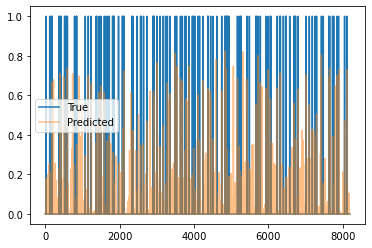

Train Epoch: 13 [910/2220 (40%)]	Loss: 0.026980	Pres: 0.043666	F1 Score: 0.016824
Train Epoch: 13 [920/2220 (41%)]	Loss: 0.027284	Pres: 0.033641	F1 Score: 0.014238
Train Epoch: 13 [930/2220 (41%)]	Loss: 0.025394	Pres: 0.040681	F1 Score: 0.017005
Train Epoch: 13 [940/2220 (42%)]	Loss: 0.026028	Pres: 0.041267	F1 Score: 0.017038
Train Epoch: 13 [950/2220 (42%)]	Loss: 0.023132	Pres: 0.041008	F1 Score: 0.018591
Train Epoch: 13 [960/2220 (43%)]	Loss: 0.024406	Pres: 0.036511	F1 Score: 0.014861
Train Epoch: 13 [970/2220 (43%)]	Loss: 0.029268	Pres: 0.044898	F1 Score: 0.016063
Train Epoch: 13 [980/2220 (44%)]	Loss: 0.026197	Pres: 0.041149	F1 Score: 0.015059
Train Epoch: 13 [990/2220 (44%)]	Loss: 0.025014	Pres: 0.043751	F1 Score: 0.018340
Train Epoch: 13 [1000/2220 (45%)]	Loss: 0.029404	Pres: 0.042248	F1 Score: 0.014568
Train Epoch: 13 [1010/2220 (45%)]	Loss: 0.032024	Pres: 0.039865	F1 Score: 0.009104
Train Epoch: 13 [1020/2220 (45%)]	Loss: 0.028407	Pres: 0.044444	F1 Score: 0.015086
Train Epoch: 

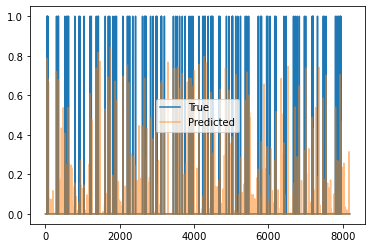

Train Epoch: 13 [1210/2220 (54%)]	Loss: 0.030863	Pres: 0.041204	F1 Score: 0.012335
Train Epoch: 13 [1220/2220 (54%)]	Loss: 0.026648	Pres: 0.048061	F1 Score: 0.017605
Train Epoch: 13 [1230/2220 (55%)]	Loss: 0.026735	Pres: 0.042180	F1 Score: 0.016110
Train Epoch: 13 [1240/2220 (55%)]	Loss: 0.024937	Pres: 0.041368	F1 Score: 0.017160
Train Epoch: 13 [1250/2220 (56%)]	Loss: 0.025287	Pres: 0.037474	F1 Score: 0.013353
Train Epoch: 13 [1260/2220 (56%)]	Loss: 0.027239	Pres: 0.041903	F1 Score: 0.017324
Train Epoch: 13 [1270/2220 (57%)]	Loss: 0.027126	Pres: 0.042234	F1 Score: 0.014194
Train Epoch: 13 [1280/2220 (57%)]	Loss: 0.031208	Pres: 0.040794	F1 Score: 0.012457
Train Epoch: 13 [1290/2220 (58%)]	Loss: 0.029602	Pres: 0.050964	F1 Score: 0.017962
Train Epoch: 13 [1300/2220 (58%)]	Loss: 0.028498	Pres: 0.039785	F1 Score: 0.013696
Train Epoch: 13 [1310/2220 (59%)]	Loss: 0.026119	Pres: 0.049253	F1 Score: 0.019167
Train Epoch: 13 [1320/2220 (59%)]	Loss: 0.024151	Pres: 0.036830	F1 Score: 0.015896
Trai

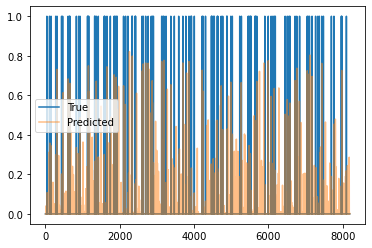

Train Epoch: 13 [1510/2220 (68%)]	Loss: 0.029890	Pres: 0.041137	F1 Score: 0.013265
Train Epoch: 13 [1520/2220 (68%)]	Loss: 0.026919	Pres: 0.041987	F1 Score: 0.015986
Train Epoch: 13 [1530/2220 (68%)]	Loss: 0.026395	Pres: 0.042762	F1 Score: 0.016689
Train Epoch: 13 [1540/2220 (69%)]	Loss: 0.028067	Pres: 0.039910	F1 Score: 0.012724
Train Epoch: 13 [1550/2220 (69%)]	Loss: 0.031828	Pres: 0.040410	F1 Score: 0.009037
Train Epoch: 13 [1560/2220 (70%)]	Loss: 0.029661	Pres: 0.037780	F1 Score: 0.016195
Train Epoch: 13 [1570/2220 (70%)]	Loss: 0.025813	Pres: 0.043707	F1 Score: 0.018051
Train Epoch: 13 [1580/2220 (71%)]	Loss: 0.025037	Pres: 0.039642	F1 Score: 0.015617
Train Epoch: 13 [1590/2220 (71%)]	Loss: 0.023161	Pres: 0.034822	F1 Score: 0.015727
Train Epoch: 13 [1600/2220 (72%)]	Loss: 0.023239	Pres: 0.041277	F1 Score: 0.017328
Train Epoch: 13 [1610/2220 (72%)]	Loss: 0.027020	Pres: 0.047815	F1 Score: 0.017263
Train Epoch: 13 [1620/2220 (72%)]	Loss: 0.027295	Pres: 0.041745	F1 Score: 0.014154
Trai

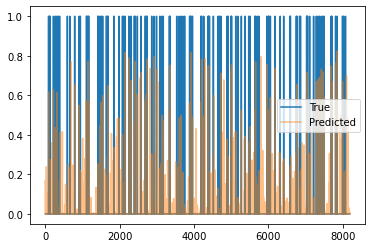

Train Epoch: 13 [1810/2220 (81%)]	Loss: 0.025582	Pres: 0.037890	F1 Score: 0.015637
Train Epoch: 13 [1820/2220 (81%)]	Loss: 0.028885	Pres: 0.036384	F1 Score: 0.011960
Train Epoch: 13 [1830/2220 (82%)]	Loss: 0.031117	Pres: 0.035668	F1 Score: 0.011671
Train Epoch: 13 [1840/2220 (82%)]	Loss: 0.024524	Pres: 0.044502	F1 Score: 0.017111
Train Epoch: 13 [1850/2220 (83%)]	Loss: 0.026795	Pres: 0.036547	F1 Score: 0.013394
Train Epoch: 13 [1860/2220 (83%)]	Loss: 0.029251	Pres: 0.038989	F1 Score: 0.013667
Train Epoch: 13 [1870/2220 (84%)]	Loss: 0.024719	Pres: 0.040527	F1 Score: 0.017567
Train Epoch: 13 [1880/2220 (84%)]	Loss: 0.027508	Pres: 0.043772	F1 Score: 0.015726
Train Epoch: 13 [1890/2220 (85%)]	Loss: 0.026879	Pres: 0.042882	F1 Score: 0.014050
Train Epoch: 13 [1900/2220 (85%)]	Loss: 0.027600	Pres: 0.044028	F1 Score: 0.015800
Train Epoch: 13 [1910/2220 (86%)]	Loss: 0.029475	Pres: 0.044468	F1 Score: 0.016837
Train Epoch: 13 [1920/2220 (86%)]	Loss: 0.023621	Pres: 0.041765	F1 Score: 0.017333
Trai

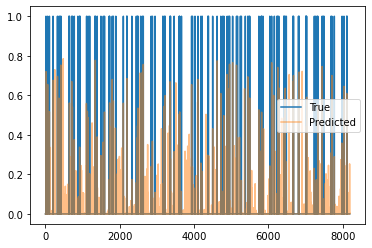

Train Epoch: 13 [2110/2220 (95%)]	Loss: 0.027878	Pres: 0.041863	F1 Score: 0.013929
Train Epoch: 13 [2120/2220 (95%)]	Loss: 0.027915	Pres: 0.043903	F1 Score: 0.016722
Train Epoch: 13 [2130/2220 (95%)]	Loss: 0.028310	Pres: 0.045575	F1 Score: 0.014481
Train Epoch: 13 [2140/2220 (96%)]	Loss: 0.029483	Pres: 0.045187	F1 Score: 0.014190
Train Epoch: 13 [2150/2220 (96%)]	Loss: 0.029670	Pres: 0.039821	F1 Score: 0.013769
Train Epoch: 13 [2160/2220 (97%)]	Loss: 0.024933	Pres: 0.044868	F1 Score: 0.016750
Train Epoch: 13 [2170/2220 (97%)]	Loss: 0.028113	Pres: 0.042659	F1 Score: 0.013246
Train Epoch: 13 [2180/2220 (98%)]	Loss: 0.025580	Pres: 0.047009	F1 Score: 0.016913
Train Epoch: 13 [2190/2220 (98%)]	Loss: 0.023184	Pres: 0.043191	F1 Score: 0.019039
Train Epoch: 13 [2200/2220 (99%)]	Loss: 0.030845	Pres: 0.039829	F1 Score: 0.012882
Train Epoch: 13 [2210/2220 (99%)]	Loss: 0.023779	Pres: 0.043872	F1 Score: 0.015439
Validation Epoch: 13 [0/582 (0%)]	Loss: 0.023240	Pres: 0.059311	F1 Score: 0.023053


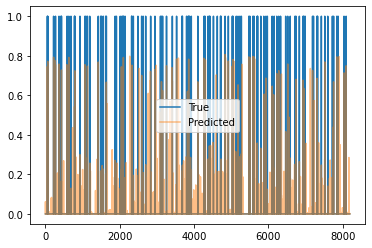

Validation Epoch: 13 [10/582 (1%)]	Loss: 0.021430	Pres: 0.043997	F1 Score: 0.024340
Validation Epoch: 13 [20/582 (3%)]	Loss: 0.022512	Pres: 0.048810	F1 Score: 0.023772
Validation Epoch: 13 [30/582 (5%)]	Loss: 0.022574	Pres: 0.038759	F1 Score: 0.020022
Validation Epoch: 13 [40/582 (6%)]	Loss: 0.023162	Pres: 0.049306	F1 Score: 0.020905
Validation Epoch: 13 [50/582 (8%)]	Loss: 0.021554	Pres: 0.050514	F1 Score: 0.023411
Validation Epoch: 13 [60/582 (10%)]	Loss: 0.022965	Pres: 0.047983	F1 Score: 0.021874
Validation Epoch: 13 [70/582 (12%)]	Loss: 0.022500	Pres: 0.049841	F1 Score: 0.020613
Validation Epoch: 13 [80/582 (13%)]	Loss: 0.018575	Pres: 0.049630	F1 Score: 0.025866
Validation Epoch: 13 [90/582 (15%)]	Loss: 0.018890	Pres: 0.045576	F1 Score: 0.024317
Validation Epoch: 13 [100/582 (17%)]	Loss: 0.022921	Pres: 0.054754	F1 Score: 0.022175
Validation Epoch: 13 [110/582 (18%)]	Loss: 0.021625	Pres: 0.047026	F1 Score: 0.024003
Validation Epoch: 13 [120/582 (20%)]	Loss: 0.018232	Pres: 0.048089	F

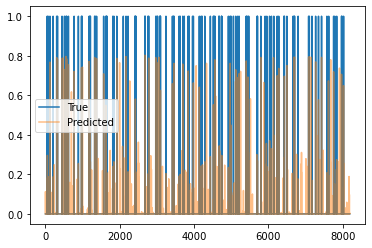

Validation Epoch: 13 [310/582 (53%)]	Loss: 0.020184	Pres: 0.046027	F1 Score: 0.024462
Validation Epoch: 13 [320/582 (54%)]	Loss: 0.020818	Pres: 0.054253	F1 Score: 0.023376
Validation Epoch: 13 [330/582 (56%)]	Loss: 0.021677	Pres: 0.049819	F1 Score: 0.026047
Validation Epoch: 13 [340/582 (58%)]	Loss: 0.018396	Pres: 0.038204	F1 Score: 0.026862
Validation Epoch: 13 [350/582 (60%)]	Loss: 0.019057	Pres: 0.052370	F1 Score: 0.025865
Validation Epoch: 13 [360/582 (61%)]	Loss: 0.020987	Pres: 0.045544	F1 Score: 0.023746
Validation Epoch: 13 [370/582 (63%)]	Loss: 0.020055	Pres: 0.050298	F1 Score: 0.024630
Validation Epoch: 13 [380/582 (65%)]	Loss: 0.022110	Pres: 0.042361	F1 Score: 0.021930
Validation Epoch: 13 [390/582 (67%)]	Loss: 0.021241	Pres: 0.055934	F1 Score: 0.023696
Validation Epoch: 13 [400/582 (68%)]	Loss: 0.023917	Pres: 0.050531	F1 Score: 0.020073
Validation Epoch: 13 [410/582 (70%)]	Loss: 0.023903	Pres: 0.044672	F1 Score: 0.020160
Validation Epoch: 13 [420/582 (72%)]	Loss: 0.021878	Pr

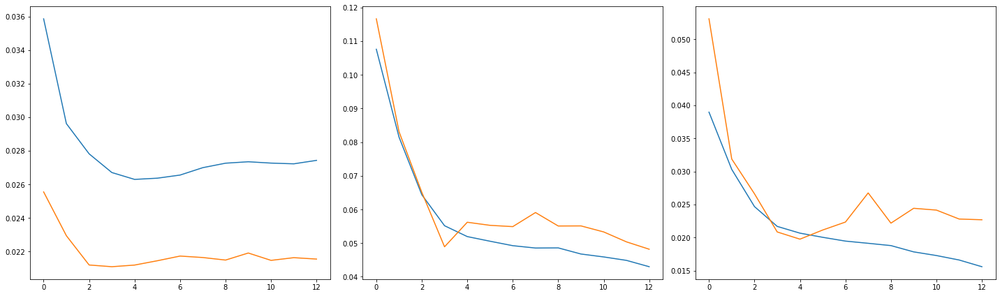

2220 582
Train Epoch: 14 [0/2220 (0%)]	Loss: 0.025872	Pres: 0.044893	F1 Score: 0.015242
105.0 -inf


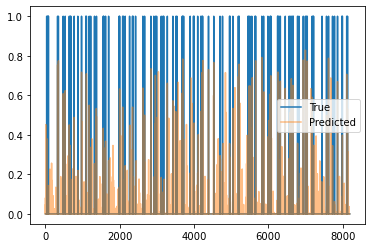

Train Epoch: 14 [10/2220 (0%)]	Loss: 0.030083	Pres: 0.038096	F1 Score: 0.011329
Train Epoch: 14 [20/2220 (0%)]	Loss: 0.027568	Pres: 0.043513	F1 Score: 0.017225
Train Epoch: 14 [30/2220 (1%)]	Loss: 0.027339	Pres: 0.048456	F1 Score: 0.016961
Train Epoch: 14 [40/2220 (1%)]	Loss: 0.024900	Pres: 0.040491	F1 Score: 0.018637
Train Epoch: 14 [50/2220 (2%)]	Loss: 0.028135	Pres: 0.035751	F1 Score: 0.014880
Train Epoch: 14 [60/2220 (2%)]	Loss: 0.031433	Pres: 0.039323	F1 Score: 0.011489
Train Epoch: 14 [70/2220 (3%)]	Loss: 0.026128	Pres: 0.048239	F1 Score: 0.017086
Train Epoch: 14 [80/2220 (3%)]	Loss: 0.032188	Pres: 0.033841	F1 Score: 0.011188
Train Epoch: 14 [90/2220 (4%)]	Loss: 0.025137	Pres: 0.045424	F1 Score: 0.015443
Train Epoch: 14 [100/2220 (4%)]	Loss: 0.028229	Pres: 0.047345	F1 Score: 0.014425
Train Epoch: 14 [110/2220 (4%)]	Loss: 0.025961	Pres: 0.045372	F1 Score: 0.016766
Train Epoch: 14 [120/2220 (5%)]	Loss: 0.028890	Pres: 0.043003	F1 Score: 0.014440
Train Epoch: 14 [130/2220 (5%)]	Loss:

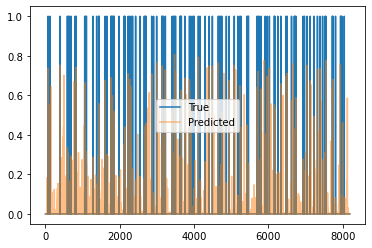

Train Epoch: 14 [310/2220 (13%)]	Loss: 0.028193	Pres: 0.041635	F1 Score: 0.014805
Train Epoch: 14 [320/2220 (14%)]	Loss: 0.030045	Pres: 0.042656	F1 Score: 0.015004
Train Epoch: 14 [330/2220 (14%)]	Loss: 0.028803	Pres: 0.046890	F1 Score: 0.016306
Train Epoch: 14 [340/2220 (15%)]	Loss: 0.027952	Pres: 0.045229	F1 Score: 0.017235
Train Epoch: 14 [350/2220 (15%)]	Loss: 0.032118	Pres: 0.043833	F1 Score: 0.011129
Train Epoch: 14 [360/2220 (16%)]	Loss: 0.026382	Pres: 0.040840	F1 Score: 0.013330
Train Epoch: 14 [370/2220 (16%)]	Loss: 0.026134	Pres: 0.042558	F1 Score: 0.016696
Train Epoch: 14 [380/2220 (17%)]	Loss: 0.027663	Pres: 0.038110	F1 Score: 0.013522
Train Epoch: 14 [390/2220 (17%)]	Loss: 0.029250	Pres: 0.042375	F1 Score: 0.015590
Train Epoch: 14 [400/2220 (18%)]	Loss: 0.025689	Pres: 0.037268	F1 Score: 0.014854
Train Epoch: 14 [410/2220 (18%)]	Loss: 0.029406	Pres: 0.044970	F1 Score: 0.016720
Train Epoch: 14 [420/2220 (18%)]	Loss: 0.027612	Pres: 0.044273	F1 Score: 0.016856
Train Epoch: 14 

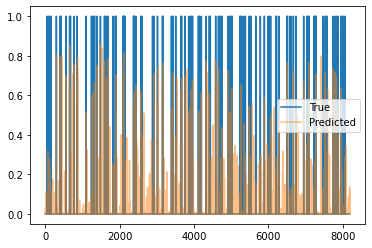

Train Epoch: 14 [610/2220 (27%)]	Loss: 0.031507	Pres: 0.046458	F1 Score: 0.012447
Train Epoch: 14 [620/2220 (27%)]	Loss: 0.025474	Pres: 0.043621	F1 Score: 0.014966
Train Epoch: 14 [630/2220 (28%)]	Loss: 0.031740	Pres: 0.048879	F1 Score: 0.015467
Train Epoch: 14 [640/2220 (28%)]	Loss: 0.025190	Pres: 0.045894	F1 Score: 0.014936
Train Epoch: 14 [650/2220 (29%)]	Loss: 0.029134	Pres: 0.042638	F1 Score: 0.015002
Train Epoch: 14 [660/2220 (29%)]	Loss: 0.025763	Pres: 0.046614	F1 Score: 0.017837
Train Epoch: 14 [670/2220 (30%)]	Loss: 0.027930	Pres: 0.044671	F1 Score: 0.013719
Train Epoch: 14 [680/2220 (30%)]	Loss: 0.026876	Pres: 0.043709	F1 Score: 0.016149
Train Epoch: 14 [690/2220 (31%)]	Loss: 0.025797	Pres: 0.042260	F1 Score: 0.015845
Train Epoch: 14 [700/2220 (31%)]	Loss: 0.021559	Pres: 0.045220	F1 Score: 0.019539
Train Epoch: 14 [710/2220 (31%)]	Loss: 0.024804	Pres: 0.042092	F1 Score: 0.014514
Train Epoch: 14 [720/2220 (32%)]	Loss: 0.024151	Pres: 0.050480	F1 Score: 0.020702
Train Epoch: 14 

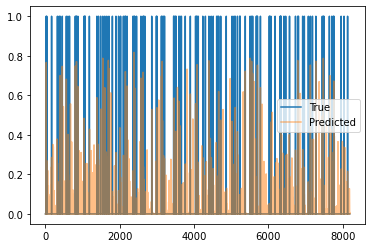

Train Epoch: 14 [910/2220 (40%)]	Loss: 0.023413	Pres: 0.043922	F1 Score: 0.018320
Train Epoch: 14 [920/2220 (41%)]	Loss: 0.026986	Pres: 0.040906	F1 Score: 0.015527
Train Epoch: 14 [930/2220 (41%)]	Loss: 0.028845	Pres: 0.045493	F1 Score: 0.015907
Train Epoch: 14 [940/2220 (42%)]	Loss: 0.025576	Pres: 0.046076	F1 Score: 0.018390
Train Epoch: 14 [950/2220 (42%)]	Loss: 0.027738	Pres: 0.039096	F1 Score: 0.013637
Train Epoch: 14 [960/2220 (43%)]	Loss: 0.028928	Pres: 0.048806	F1 Score: 0.015778
Train Epoch: 14 [970/2220 (43%)]	Loss: 0.025947	Pres: 0.047243	F1 Score: 0.016895
Train Epoch: 14 [980/2220 (44%)]	Loss: 0.029156	Pres: 0.042328	F1 Score: 0.015446
Train Epoch: 14 [990/2220 (44%)]	Loss: 0.028406	Pres: 0.045712	F1 Score: 0.013392
Train Epoch: 14 [1000/2220 (45%)]	Loss: 0.025549	Pres: 0.039850	F1 Score: 0.016481
Train Epoch: 14 [1010/2220 (45%)]	Loss: 0.031430	Pres: 0.047005	F1 Score: 0.014194
Train Epoch: 14 [1020/2220 (45%)]	Loss: 0.030593	Pres: 0.049006	F1 Score: 0.016235
Train Epoch: 

KeyboardInterrupt: 

In [11]:
# 0.01 ids, 1024 dist, average='macro'
trainer.train(debug=False)

began training
2220 582
Train Epoch: 0 [0/2220 (0%)]	Loss: 0.707822	Pres: 0.993225	F1 Score: 0.496589
111.0 245.25


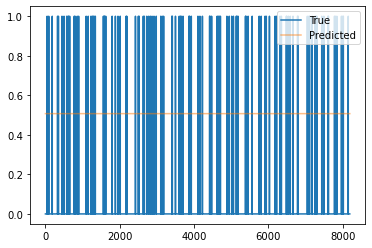

Train Epoch: 0 [10/2220 (0%)]	Loss: 0.606934	Pres: 0.168542	F1 Score: 0.132699
Train Epoch: 0 [20/2220 (0%)]	Loss: 0.449969	Pres: 0.142693	F1 Score: 0.075127
Train Epoch: 0 [30/2220 (1%)]	Loss: 0.345094	Pres: 0.201406	F1 Score: 0.040610
Train Epoch: 0 [40/2220 (1%)]	Loss: 0.271908	Pres: 0.198671	F1 Score: 0.014274
Train Epoch: 0 [50/2220 (2%)]	Loss: 0.220116	Pres: 0.196154	F1 Score: 0.007433
Train Epoch: 0 [60/2220 (2%)]	Loss: 0.181286	Pres: 0.164021	F1 Score: 0.002537
Train Epoch: 0 [70/2220 (3%)]	Loss: 0.153564	Pres: 0.333333	F1 Score: 0.000535
Train Epoch: 0 [80/2220 (3%)]	Loss: 0.138853	Pres: 0.333333	F1 Score: 0.000371
Train Epoch: 0 [90/2220 (4%)]	Loss: 0.119150	Pres: 0.250000	F1 Score: 0.000031
Train Epoch: 0 [100/2220 (4%)]	Loss: 0.110765	Pres: 0.333333	F1 Score: 0.000000
Train Epoch: 0 [110/2220 (4%)]	Loss: 0.105610	Pres: 0.285714	F1 Score: 0.000035
Train Epoch: 0 [120/2220 (5%)]	Loss: 0.096105	Pres: 0.250000	F1 Score: 0.000000
Train Epoch: 0 [130/2220 (5%)]	Loss: 0.094320	Pre

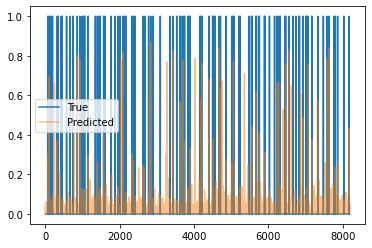

Train Epoch: 0 [310/2220 (13%)]	Loss: 0.058840	Pres: 0.101196	F1 Score: 0.020197
Train Epoch: 0 [320/2220 (14%)]	Loss: 0.053327	Pres: 0.127717	F1 Score: 0.023807
Train Epoch: 0 [330/2220 (14%)]	Loss: 0.052145	Pres: 0.108016	F1 Score: 0.016195
Train Epoch: 0 [340/2220 (15%)]	Loss: 0.047386	Pres: 0.114815	F1 Score: 0.035937
Train Epoch: 0 [350/2220 (15%)]	Loss: 0.053603	Pres: 0.112727	F1 Score: 0.033124
Train Epoch: 0 [360/2220 (16%)]	Loss: 0.047490	Pres: 0.131984	F1 Score: 0.033526
Train Epoch: 0 [370/2220 (16%)]	Loss: 0.048733	Pres: 0.110732	F1 Score: 0.038913
Train Epoch: 0 [380/2220 (17%)]	Loss: 0.049987	Pres: 0.107413	F1 Score: 0.035079
Train Epoch: 0 [390/2220 (17%)]	Loss: 0.051353	Pres: 0.109194	F1 Score: 0.032567
Train Epoch: 0 [400/2220 (18%)]	Loss: 0.048278	Pres: 0.095437	F1 Score: 0.024277
Train Epoch: 0 [410/2220 (18%)]	Loss: 0.046208	Pres: 0.088154	F1 Score: 0.027316
Train Epoch: 0 [420/2220 (18%)]	Loss: 0.048744	Pres: 0.102843	F1 Score: 0.032581
Train Epoch: 0 [430/2220 (19

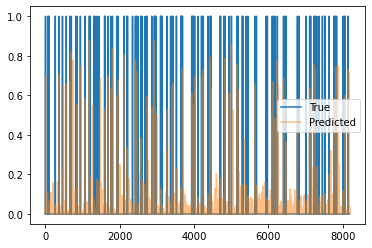

Train Epoch: 0 [610/2220 (27%)]	Loss: 0.037622	Pres: 0.089744	F1 Score: 0.029846
Train Epoch: 0 [620/2220 (27%)]	Loss: 0.038734	Pres: 0.079513	F1 Score: 0.027603
Train Epoch: 0 [630/2220 (28%)]	Loss: 0.036273	Pres: 0.099310	F1 Score: 0.034961
Train Epoch: 0 [640/2220 (28%)]	Loss: 0.033829	Pres: 0.112337	F1 Score: 0.042366
Train Epoch: 0 [650/2220 (29%)]	Loss: 0.036397	Pres: 0.112460	F1 Score: 0.037187
Train Epoch: 0 [660/2220 (29%)]	Loss: 0.037003	Pres: 0.097774	F1 Score: 0.032188
Train Epoch: 0 [670/2220 (30%)]	Loss: 0.034769	Pres: 0.104938	F1 Score: 0.041995
Train Epoch: 0 [680/2220 (30%)]	Loss: 0.033367	Pres: 0.098053	F1 Score: 0.041634
Train Epoch: 0 [690/2220 (31%)]	Loss: 0.035738	Pres: 0.114011	F1 Score: 0.034363
Train Epoch: 0 [700/2220 (31%)]	Loss: 0.035075	Pres: 0.087202	F1 Score: 0.030879
Train Epoch: 0 [710/2220 (31%)]	Loss: 0.036261	Pres: 0.097447	F1 Score: 0.029710
Train Epoch: 0 [720/2220 (32%)]	Loss: 0.033260	Pres: 0.101854	F1 Score: 0.037418
Train Epoch: 0 [730/2220 (32

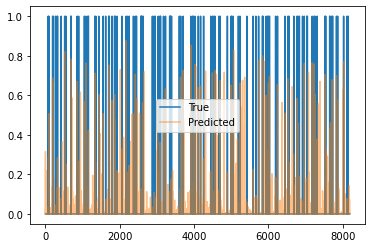

Train Epoch: 0 [910/2220 (40%)]	Loss: 0.039464	Pres: 0.079699	F1 Score: 0.023328
Train Epoch: 0 [920/2220 (41%)]	Loss: 0.034747	Pres: 0.087266	F1 Score: 0.026736
Train Epoch: 0 [930/2220 (41%)]	Loss: 0.036054	Pres: 0.098981	F1 Score: 0.032925
Train Epoch: 0 [940/2220 (42%)]	Loss: 0.030131	Pres: 0.088016	F1 Score: 0.034876
Train Epoch: 0 [950/2220 (42%)]	Loss: 0.033062	Pres: 0.077614	F1 Score: 0.027831
Train Epoch: 0 [960/2220 (43%)]	Loss: 0.032472	Pres: 0.094505	F1 Score: 0.035766
Train Epoch: 0 [970/2220 (43%)]	Loss: 0.035287	Pres: 0.084821	F1 Score: 0.021986
Train Epoch: 0 [980/2220 (44%)]	Loss: 0.032744	Pres: 0.094430	F1 Score: 0.034911
Train Epoch: 0 [990/2220 (44%)]	Loss: 0.034638	Pres: 0.079892	F1 Score: 0.026151
Train Epoch: 0 [1000/2220 (45%)]	Loss: 0.035436	Pres: 0.082549	F1 Score: 0.026221
Train Epoch: 0 [1010/2220 (45%)]	Loss: 0.032376	Pres: 0.080734	F1 Score: 0.034219
Train Epoch: 0 [1020/2220 (45%)]	Loss: 0.033908	Pres: 0.078304	F1 Score: 0.029081
Train Epoch: 0 [1030/2220

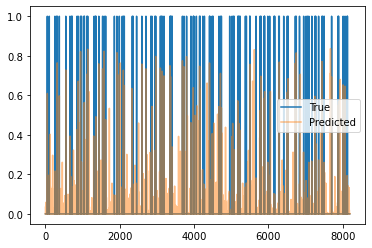

Train Epoch: 0 [1210/2220 (54%)]	Loss: 0.034571	Pres: 0.075358	F1 Score: 0.027746
Train Epoch: 0 [1220/2220 (54%)]	Loss: 0.032741	Pres: 0.057457	F1 Score: 0.020057
Train Epoch: 0 [1230/2220 (55%)]	Loss: 0.032234	Pres: 0.070933	F1 Score: 0.024860
Train Epoch: 0 [1240/2220 (55%)]	Loss: 0.031403	Pres: 0.078679	F1 Score: 0.026238
Train Epoch: 0 [1250/2220 (56%)]	Loss: 0.033396	Pres: 0.064699	F1 Score: 0.024422
Train Epoch: 0 [1260/2220 (56%)]	Loss: 0.036885	Pres: 0.074425	F1 Score: 0.024965
Train Epoch: 0 [1270/2220 (57%)]	Loss: 0.029282	Pres: 0.068364	F1 Score: 0.024476
Train Epoch: 0 [1280/2220 (57%)]	Loss: 0.029173	Pres: 0.072227	F1 Score: 0.027799
Train Epoch: 0 [1290/2220 (58%)]	Loss: 0.038166	Pres: 0.078648	F1 Score: 0.019451
Train Epoch: 0 [1300/2220 (58%)]	Loss: 0.031604	Pres: 0.083361	F1 Score: 0.028808
Train Epoch: 0 [1310/2220 (59%)]	Loss: 0.034029	Pres: 0.060924	F1 Score: 0.020081
Train Epoch: 0 [1320/2220 (59%)]	Loss: 0.031305	Pres: 0.060200	F1 Score: 0.018408
Train Epoch: 0 [

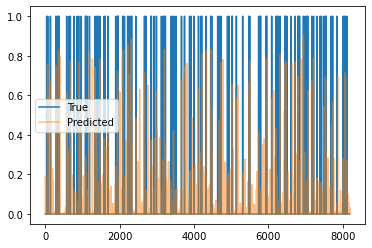

Train Epoch: 0 [1510/2220 (68%)]	Loss: 0.027761	Pres: 0.054067	F1 Score: 0.019481
Train Epoch: 0 [1520/2220 (68%)]	Loss: 0.030952	Pres: 0.052363	F1 Score: 0.017339
Train Epoch: 0 [1530/2220 (68%)]	Loss: 0.030747	Pres: 0.056351	F1 Score: 0.019155
Train Epoch: 0 [1540/2220 (69%)]	Loss: 0.034861	Pres: 0.043750	F1 Score: 0.013753
Train Epoch: 0 [1550/2220 (69%)]	Loss: 0.031941	Pres: 0.048920	F1 Score: 0.018993
Train Epoch: 0 [1560/2220 (70%)]	Loss: 0.033348	Pres: 0.066687	F1 Score: 0.019936
Train Epoch: 0 [1570/2220 (70%)]	Loss: 0.031102	Pres: 0.066964	F1 Score: 0.024173
Train Epoch: 0 [1580/2220 (71%)]	Loss: 0.033585	Pres: 0.052074	F1 Score: 0.016508
Train Epoch: 0 [1590/2220 (71%)]	Loss: 0.030802	Pres: 0.049832	F1 Score: 0.016747
Train Epoch: 0 [1600/2220 (72%)]	Loss: 0.029156	Pres: 0.055606	F1 Score: 0.020828
Train Epoch: 0 [1610/2220 (72%)]	Loss: 0.029561	Pres: 0.035344	F1 Score: 0.015036
Train Epoch: 0 [1620/2220 (72%)]	Loss: 0.029901	Pres: 0.051684	F1 Score: 0.020467
Train Epoch: 0 [

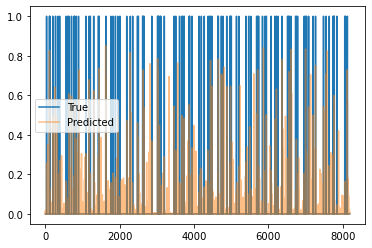

Train Epoch: 0 [1810/2220 (81%)]	Loss: 0.033256	Pres: 0.051610	F1 Score: 0.018359
Train Epoch: 0 [1820/2220 (81%)]	Loss: 0.036386	Pres: 0.046999	F1 Score: 0.016070
Train Epoch: 0 [1830/2220 (82%)]	Loss: 0.029965	Pres: 0.045777	F1 Score: 0.015734
Train Epoch: 0 [1840/2220 (82%)]	Loss: 0.029643	Pres: 0.040696	F1 Score: 0.017781
Train Epoch: 0 [1850/2220 (83%)]	Loss: 0.032825	Pres: 0.049424	F1 Score: 0.015151
Train Epoch: 0 [1860/2220 (83%)]	Loss: 0.032685	Pres: 0.048137	F1 Score: 0.015764
Train Epoch: 0 [1870/2220 (84%)]	Loss: 0.029556	Pres: 0.050963	F1 Score: 0.019032
Train Epoch: 0 [1880/2220 (84%)]	Loss: 0.035023	Pres: 0.040370	F1 Score: 0.012429
Train Epoch: 0 [1890/2220 (85%)]	Loss: 0.031071	Pres: 0.040186	F1 Score: 0.015936
Train Epoch: 0 [1900/2220 (85%)]	Loss: 0.032603	Pres: 0.044553	F1 Score: 0.018628
Train Epoch: 0 [1910/2220 (86%)]	Loss: 0.031511	Pres: 0.049457	F1 Score: 0.016933
Train Epoch: 0 [1920/2220 (86%)]	Loss: 0.032135	Pres: 0.046014	F1 Score: 0.013371
Train Epoch: 0 [

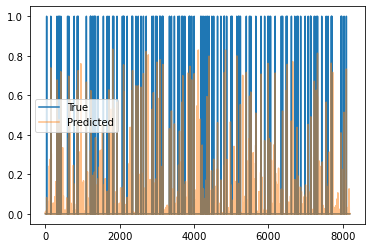

Train Epoch: 0 [2110/2220 (95%)]	Loss: 0.032209	Pres: 0.052882	F1 Score: 0.020194
Train Epoch: 0 [2120/2220 (95%)]	Loss: 0.036023	Pres: 0.049874	F1 Score: 0.014897
Train Epoch: 0 [2130/2220 (95%)]	Loss: 0.034178	Pres: 0.056380	F1 Score: 0.018161
Train Epoch: 0 [2140/2220 (96%)]	Loss: 0.029838	Pres: 0.044435	F1 Score: 0.016283
Train Epoch: 0 [2150/2220 (96%)]	Loss: 0.036512	Pres: 0.048685	F1 Score: 0.014140
Train Epoch: 0 [2160/2220 (97%)]	Loss: 0.030750	Pres: 0.058428	F1 Score: 0.021306
Train Epoch: 0 [2170/2220 (97%)]	Loss: 0.031690	Pres: 0.050577	F1 Score: 0.019817
Train Epoch: 0 [2180/2220 (98%)]	Loss: 0.031734	Pres: 0.049119	F1 Score: 0.015566
Train Epoch: 0 [2190/2220 (98%)]	Loss: 0.028175	Pres: 0.053061	F1 Score: 0.019387
Train Epoch: 0 [2200/2220 (99%)]	Loss: 0.029444	Pres: 0.052400	F1 Score: 0.019273
Train Epoch: 0 [2210/2220 (99%)]	Loss: 0.032017	Pres: 0.042572	F1 Score: 0.013842
Validation Epoch: 0 [0/582 (0%)]	Loss: 0.024501	Pres: 0.067937	F1 Score: 0.022098


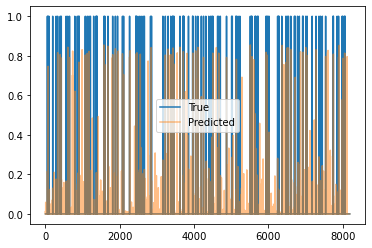

Validation Epoch: 0 [10/582 (1%)]	Loss: 0.024168	Pres: 0.068713	F1 Score: 0.022190
Validation Epoch: 0 [20/582 (3%)]	Loss: 0.022594	Pres: 0.064286	F1 Score: 0.022754
Validation Epoch: 0 [30/582 (5%)]	Loss: 0.024329	Pres: 0.071717	F1 Score: 0.020741
Validation Epoch: 0 [40/582 (6%)]	Loss: 0.024828	Pres: 0.068365	F1 Score: 0.018604
Validation Epoch: 0 [50/582 (8%)]	Loss: 0.023042	Pres: 0.066468	F1 Score: 0.021168
Validation Epoch: 0 [60/582 (10%)]	Loss: 0.024122	Pres: 0.068501	F1 Score: 0.023227
Validation Epoch: 0 [70/582 (12%)]	Loss: 0.021984	Pres: 0.060755	F1 Score: 0.025569
Validation Epoch: 0 [80/582 (13%)]	Loss: 0.023079	Pres: 0.069105	F1 Score: 0.019209
Validation Epoch: 0 [90/582 (15%)]	Loss: 0.024052	Pres: 0.064064	F1 Score: 0.018798
Validation Epoch: 0 [100/582 (17%)]	Loss: 0.025306	Pres: 0.077090	F1 Score: 0.020495
Validation Epoch: 0 [110/582 (18%)]	Loss: 0.022464	Pres: 0.049201	F1 Score: 0.019113
Validation Epoch: 0 [120/582 (20%)]	Loss: 0.023918	Pres: 0.051515	F1 Score: 0.0

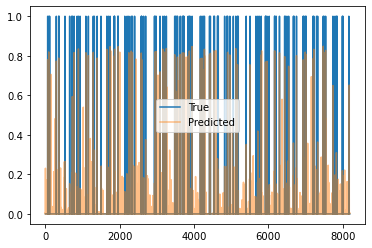

Validation Epoch: 0 [310/582 (53%)]	Loss: 0.023843	Pres: 0.063660	F1 Score: 0.022975
Validation Epoch: 0 [320/582 (54%)]	Loss: 0.025426	Pres: 0.083051	F1 Score: 0.022667
Validation Epoch: 0 [330/582 (56%)]	Loss: 0.023990	Pres: 0.049513	F1 Score: 0.019554
Validation Epoch: 0 [340/582 (58%)]	Loss: 0.022435	Pres: 0.069811	F1 Score: 0.021533
Validation Epoch: 0 [350/582 (60%)]	Loss: 0.022281	Pres: 0.066875	F1 Score: 0.025157
Validation Epoch: 0 [360/582 (61%)]	Loss: 0.023175	Pres: 0.060988	F1 Score: 0.019195
Validation Epoch: 0 [370/582 (63%)]	Loss: 0.021346	Pres: 0.070635	F1 Score: 0.027093
Validation Epoch: 0 [380/582 (65%)]	Loss: 0.024674	Pres: 0.075139	F1 Score: 0.022020
Validation Epoch: 0 [390/582 (67%)]	Loss: 0.025369	Pres: 0.073913	F1 Score: 0.018304
Validation Epoch: 0 [400/582 (68%)]	Loss: 0.021863	Pres: 0.052861	F1 Score: 0.019803
Validation Epoch: 0 [410/582 (70%)]	Loss: 0.025484	Pres: 0.060185	F1 Score: 0.020047
Validation Epoch: 0 [420/582 (72%)]	Loss: 0.025432	Pres: 0.043651

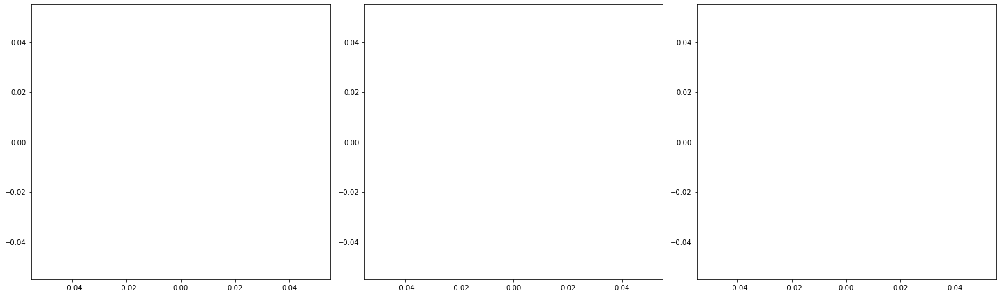

2220 582
Train Epoch: 1 [0/2220 (0%)]	Loss: 0.034397	Pres: 0.047495	F1 Score: 0.018176
113.0 -65088.0


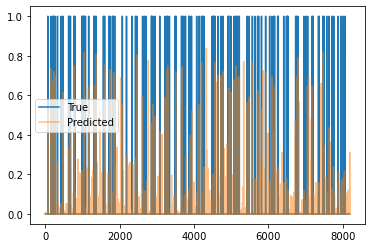

Train Epoch: 1 [10/2220 (0%)]	Loss: 0.030614	Pres: 0.055236	F1 Score: 0.020736
Train Epoch: 1 [20/2220 (0%)]	Loss: 0.035193	Pres: 0.051820	F1 Score: 0.015805
Train Epoch: 1 [30/2220 (1%)]	Loss: 0.029395	Pres: 0.044591	F1 Score: 0.019637
Train Epoch: 1 [40/2220 (1%)]	Loss: 0.032750	Pres: 0.048854	F1 Score: 0.017993
Train Epoch: 1 [50/2220 (2%)]	Loss: 0.033381	Pres: 0.051887	F1 Score: 0.016792
Train Epoch: 1 [60/2220 (2%)]	Loss: 0.032474	Pres: 0.052568	F1 Score: 0.017854
Train Epoch: 1 [70/2220 (3%)]	Loss: 0.036647	Pres: 0.050730	F1 Score: 0.015128
Train Epoch: 1 [80/2220 (3%)]	Loss: 0.031372	Pres: 0.052407	F1 Score: 0.017263
Train Epoch: 1 [90/2220 (4%)]	Loss: 0.037058	Pres: 0.040172	F1 Score: 0.012168
Train Epoch: 1 [100/2220 (4%)]	Loss: 0.028695	Pres: 0.048541	F1 Score: 0.020224
Train Epoch: 1 [110/2220 (4%)]	Loss: 0.029926	Pres: 0.050154	F1 Score: 0.019483
Train Epoch: 1 [120/2220 (5%)]	Loss: 0.034546	Pres: 0.050725	F1 Score: 0.017491
Train Epoch: 1 [130/2220 (5%)]	Loss: 0.033540	Pre

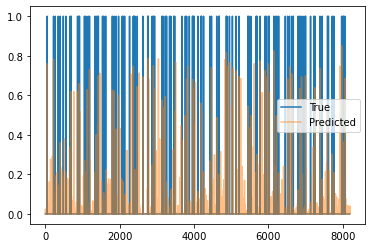

Train Epoch: 1 [310/2220 (13%)]	Loss: 0.031067	Pres: 0.049221	F1 Score: 0.018716
Train Epoch: 1 [320/2220 (14%)]	Loss: 0.033986	Pres: 0.046175	F1 Score: 0.014572
Train Epoch: 1 [330/2220 (14%)]	Loss: 0.033121	Pres: 0.047878	F1 Score: 0.013267
Train Epoch: 1 [340/2220 (15%)]	Loss: 0.033634	Pres: 0.053333	F1 Score: 0.016207
Train Epoch: 1 [350/2220 (15%)]	Loss: 0.031417	Pres: 0.049366	F1 Score: 0.015977
Train Epoch: 1 [360/2220 (16%)]	Loss: 0.029818	Pres: 0.044037	F1 Score: 0.016036
Train Epoch: 1 [370/2220 (16%)]	Loss: 0.033926	Pres: 0.048889	F1 Score: 0.014176
Train Epoch: 1 [380/2220 (17%)]	Loss: 0.034481	Pres: 0.038082	F1 Score: 0.013399
Train Epoch: 1 [390/2220 (17%)]	Loss: 0.029601	Pres: 0.036354	F1 Score: 0.014159
Train Epoch: 1 [400/2220 (18%)]	Loss: 0.027787	Pres: 0.046558	F1 Score: 0.018027
Train Epoch: 1 [410/2220 (18%)]	Loss: 0.032054	Pres: 0.039414	F1 Score: 0.013376
Train Epoch: 1 [420/2220 (18%)]	Loss: 0.031430	Pres: 0.045513	F1 Score: 0.016346
Train Epoch: 1 [430/2220 (19

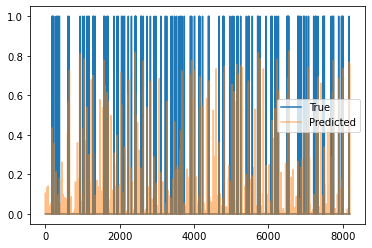

Train Epoch: 1 [610/2220 (27%)]	Loss: 0.031622	Pres: 0.034427	F1 Score: 0.013536
Train Epoch: 1 [620/2220 (27%)]	Loss: 0.031928	Pres: 0.038472	F1 Score: 0.013582
Train Epoch: 1 [630/2220 (28%)]	Loss: 0.032112	Pres: 0.044271	F1 Score: 0.014625
Train Epoch: 1 [640/2220 (28%)]	Loss: 0.035496	Pres: 0.045939	F1 Score: 0.015839
Train Epoch: 1 [650/2220 (29%)]	Loss: 0.028412	Pres: 0.033914	F1 Score: 0.014169
Train Epoch: 1 [660/2220 (29%)]	Loss: 0.031323	Pres: 0.047137	F1 Score: 0.016695
Train Epoch: 1 [670/2220 (30%)]	Loss: 0.030554	Pres: 0.043103	F1 Score: 0.014362
Train Epoch: 1 [680/2220 (30%)]	Loss: 0.034241	Pres: 0.032903	F1 Score: 0.012658
Train Epoch: 1 [690/2220 (31%)]	Loss: 0.033640	Pres: 0.036033	F1 Score: 0.013049
Train Epoch: 1 [700/2220 (31%)]	Loss: 0.029569	Pres: 0.044504	F1 Score: 0.014091
Train Epoch: 1 [710/2220 (31%)]	Loss: 0.030806	Pres: 0.040074	F1 Score: 0.015164
Train Epoch: 1 [720/2220 (32%)]	Loss: 0.035757	Pres: 0.039117	F1 Score: 0.012584
Train Epoch: 1 [730/2220 (32

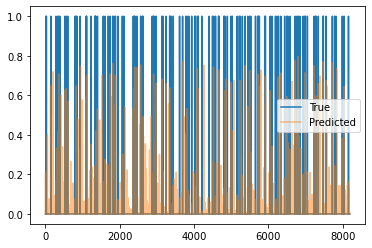

Train Epoch: 1 [910/2220 (40%)]	Loss: 0.033188	Pres: 0.040664	F1 Score: 0.011945
Train Epoch: 1 [920/2220 (41%)]	Loss: 0.033221	Pres: 0.036490	F1 Score: 0.014069
Train Epoch: 1 [930/2220 (41%)]	Loss: 0.031267	Pres: 0.045093	F1 Score: 0.016660
Train Epoch: 1 [940/2220 (42%)]	Loss: 0.033337	Pres: 0.035119	F1 Score: 0.012546
Train Epoch: 1 [950/2220 (42%)]	Loss: 0.032033	Pres: 0.037464	F1 Score: 0.013311
Train Epoch: 1 [960/2220 (43%)]	Loss: 0.034378	Pres: 0.041629	F1 Score: 0.014086
Train Epoch: 1 [970/2220 (43%)]	Loss: 0.037445	Pres: 0.036111	F1 Score: 0.009652
Train Epoch: 1 [980/2220 (44%)]	Loss: 0.034582	Pres: 0.035522	F1 Score: 0.012276
Train Epoch: 1 [990/2220 (44%)]	Loss: 0.029963	Pres: 0.036932	F1 Score: 0.014569
Train Epoch: 1 [1000/2220 (45%)]	Loss: 0.033918	Pres: 0.038372	F1 Score: 0.012256
Train Epoch: 1 [1010/2220 (45%)]	Loss: 0.036285	Pres: 0.039370	F1 Score: 0.012897
Train Epoch: 1 [1020/2220 (45%)]	Loss: 0.031796	Pres: 0.042424	F1 Score: 0.014091
Train Epoch: 1 [1030/2220

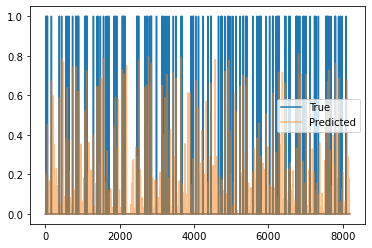

Train Epoch: 1 [1210/2220 (54%)]	Loss: 0.034742	Pres: 0.035590	F1 Score: 0.011777
Train Epoch: 1 [1220/2220 (54%)]	Loss: 0.030447	Pres: 0.039555	F1 Score: 0.015226
Train Epoch: 1 [1230/2220 (55%)]	Loss: 0.032085	Pres: 0.039352	F1 Score: 0.015875
Train Epoch: 1 [1240/2220 (55%)]	Loss: 0.029983	Pres: 0.038612	F1 Score: 0.013645
Train Epoch: 1 [1250/2220 (56%)]	Loss: 0.031796	Pres: 0.039712	F1 Score: 0.010856
Train Epoch: 1 [1260/2220 (56%)]	Loss: 0.034162	Pres: 0.034456	F1 Score: 0.010549
Train Epoch: 1 [1270/2220 (57%)]	Loss: 0.032058	Pres: 0.039258	F1 Score: 0.014447
Train Epoch: 1 [1280/2220 (57%)]	Loss: 0.032522	Pres: 0.037074	F1 Score: 0.012654
Train Epoch: 1 [1290/2220 (58%)]	Loss: 0.032202	Pres: 0.038017	F1 Score: 0.011836
Train Epoch: 1 [1300/2220 (58%)]	Loss: 0.028704	Pres: 0.032277	F1 Score: 0.012181
Train Epoch: 1 [1310/2220 (59%)]	Loss: 0.031353	Pres: 0.037796	F1 Score: 0.015177
Train Epoch: 1 [1320/2220 (59%)]	Loss: 0.032919	Pres: 0.040060	F1 Score: 0.012677
Train Epoch: 1 [

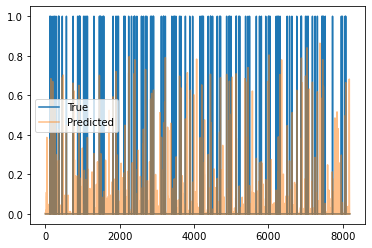

Train Epoch: 1 [1510/2220 (68%)]	Loss: 0.029385	Pres: 0.034409	F1 Score: 0.013936
Train Epoch: 1 [1520/2220 (68%)]	Loss: 0.027775	Pres: 0.039539	F1 Score: 0.014090
Train Epoch: 1 [1530/2220 (68%)]	Loss: 0.029484	Pres: 0.042593	F1 Score: 0.014567
Train Epoch: 1 [1540/2220 (69%)]	Loss: 0.031251	Pres: 0.036355	F1 Score: 0.011799
Train Epoch: 1 [1550/2220 (69%)]	Loss: 0.032859	Pres: 0.038368	F1 Score: 0.012202
Train Epoch: 1 [1560/2220 (70%)]	Loss: 0.030582	Pres: 0.043539	F1 Score: 0.013920
Train Epoch: 1 [1570/2220 (70%)]	Loss: 0.032418	Pres: 0.034522	F1 Score: 0.012115
Train Epoch: 1 [1580/2220 (71%)]	Loss: 0.027146	Pres: 0.034142	F1 Score: 0.013896
Train Epoch: 1 [1590/2220 (71%)]	Loss: 0.029511	Pres: 0.042812	F1 Score: 0.015768
Train Epoch: 1 [1600/2220 (72%)]	Loss: 0.032109	Pres: 0.033454	F1 Score: 0.011019
Train Epoch: 1 [1610/2220 (72%)]	Loss: 0.031392	Pres: 0.039075	F1 Score: 0.013735
Train Epoch: 1 [1620/2220 (72%)]	Loss: 0.029658	Pres: 0.041411	F1 Score: 0.013164
Train Epoch: 1 [

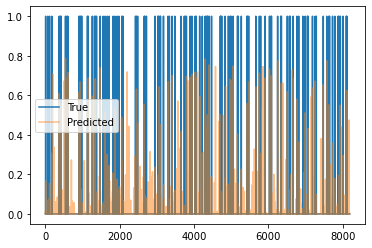

Train Epoch: 1 [1810/2220 (81%)]	Loss: 0.030098	Pres: 0.040518	F1 Score: 0.014189
Train Epoch: 1 [1820/2220 (81%)]	Loss: 0.031246	Pres: 0.043919	F1 Score: 0.013511
Train Epoch: 1 [1830/2220 (82%)]	Loss: 0.032988	Pres: 0.040895	F1 Score: 0.012433
Train Epoch: 1 [1840/2220 (82%)]	Loss: 0.031777	Pres: 0.028130	F1 Score: 0.011436
Train Epoch: 1 [1850/2220 (83%)]	Loss: 0.030181	Pres: 0.036296	F1 Score: 0.013309
Train Epoch: 1 [1860/2220 (83%)]	Loss: 0.029137	Pres: 0.043853	F1 Score: 0.014589
Train Epoch: 1 [1870/2220 (84%)]	Loss: 0.029151	Pres: 0.042624	F1 Score: 0.014747
Train Epoch: 1 [1880/2220 (84%)]	Loss: 0.031882	Pres: 0.036588	F1 Score: 0.012100
Train Epoch: 1 [1890/2220 (85%)]	Loss: 0.033039	Pres: 0.035105	F1 Score: 0.011896
Train Epoch: 1 [1900/2220 (85%)]	Loss: 0.031353	Pres: 0.041720	F1 Score: 0.013613
Train Epoch: 1 [1910/2220 (86%)]	Loss: 0.030853	Pres: 0.034462	F1 Score: 0.012998
Train Epoch: 1 [1920/2220 (86%)]	Loss: 0.032162	Pres: 0.032373	F1 Score: 0.013813
Train Epoch: 1 [

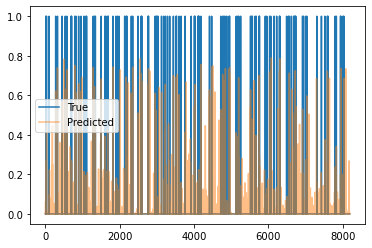

Train Epoch: 1 [2110/2220 (95%)]	Loss: 0.031883	Pres: 0.035062	F1 Score: 0.011958
Train Epoch: 1 [2120/2220 (95%)]	Loss: 0.030479	Pres: 0.030644	F1 Score: 0.010137
Train Epoch: 1 [2130/2220 (95%)]	Loss: 0.029302	Pres: 0.041767	F1 Score: 0.013937
Train Epoch: 1 [2140/2220 (96%)]	Loss: 0.031467	Pres: 0.042211	F1 Score: 0.012509
Train Epoch: 1 [2150/2220 (96%)]	Loss: 0.031967	Pres: 0.034050	F1 Score: 0.011783
Train Epoch: 1 [2160/2220 (97%)]	Loss: 0.035490	Pres: 0.028952	F1 Score: 0.009132
Train Epoch: 1 [2170/2220 (97%)]	Loss: 0.036207	Pres: 0.037542	F1 Score: 0.010059
Train Epoch: 1 [2180/2220 (98%)]	Loss: 0.033124	Pres: 0.029733	F1 Score: 0.011636
Train Epoch: 1 [2190/2220 (98%)]	Loss: 0.031499	Pres: 0.031441	F1 Score: 0.010549
Train Epoch: 1 [2200/2220 (99%)]	Loss: 0.031628	Pres: 0.031600	F1 Score: 0.010950
Train Epoch: 1 [2210/2220 (99%)]	Loss: 0.032068	Pres: 0.042626	F1 Score: 0.014106
Validation Epoch: 1 [0/582 (0%)]	Loss: 0.022664	Pres: 0.046484	F1 Score: 0.022021


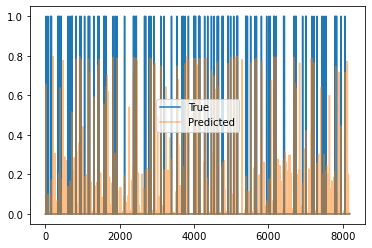

Validation Epoch: 1 [10/582 (1%)]	Loss: 0.022071	Pres: 0.050048	F1 Score: 0.021265
Validation Epoch: 1 [20/582 (3%)]	Loss: 0.023818	Pres: 0.044571	F1 Score: 0.019849
Validation Epoch: 1 [30/582 (5%)]	Loss: 0.020482	Pres: 0.045502	F1 Score: 0.022224
Validation Epoch: 1 [40/582 (6%)]	Loss: 0.020712	Pres: 0.057193	F1 Score: 0.025160
Validation Epoch: 1 [50/582 (8%)]	Loss: 0.021924	Pres: 0.056667	F1 Score: 0.024860
Validation Epoch: 1 [60/582 (10%)]	Loss: 0.023985	Pres: 0.056162	F1 Score: 0.020583
Validation Epoch: 1 [70/582 (12%)]	Loss: 0.025556	Pres: 0.045161	F1 Score: 0.017617
Validation Epoch: 1 [80/582 (13%)]	Loss: 0.022413	Pres: 0.036573	F1 Score: 0.022413
Validation Epoch: 1 [90/582 (15%)]	Loss: 0.021149	Pres: 0.055384	F1 Score: 0.023625
Validation Epoch: 1 [100/582 (17%)]	Loss: 0.021588	Pres: 0.048248	F1 Score: 0.021266
Validation Epoch: 1 [110/582 (18%)]	Loss: 0.022558	Pres: 0.050136	F1 Score: 0.022924
Validation Epoch: 1 [120/582 (20%)]	Loss: 0.023327	Pres: 0.042032	F1 Score: 0.0

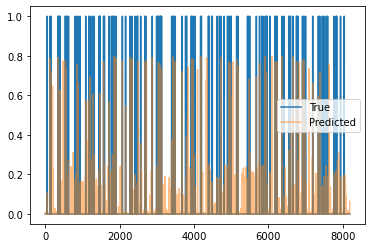

Validation Epoch: 1 [310/582 (53%)]	Loss: 0.022611	Pres: 0.051905	F1 Score: 0.022926
Validation Epoch: 1 [320/582 (54%)]	Loss: 0.023142	Pres: 0.052614	F1 Score: 0.022308
Validation Epoch: 1 [330/582 (56%)]	Loss: 0.020939	Pres: 0.050616	F1 Score: 0.023492
Validation Epoch: 1 [340/582 (58%)]	Loss: 0.021541	Pres: 0.046204	F1 Score: 0.022082
Validation Epoch: 1 [350/582 (60%)]	Loss: 0.022163	Pres: 0.053664	F1 Score: 0.023294
Validation Epoch: 1 [360/582 (61%)]	Loss: 0.026743	Pres: 0.048611	F1 Score: 0.019281
Validation Epoch: 1 [370/582 (63%)]	Loss: 0.023704	Pres: 0.050279	F1 Score: 0.020216
Validation Epoch: 1 [380/582 (65%)]	Loss: 0.020984	Pres: 0.051893	F1 Score: 0.023933
Validation Epoch: 1 [390/582 (67%)]	Loss: 0.020572	Pres: 0.055261	F1 Score: 0.025483
Validation Epoch: 1 [400/582 (68%)]	Loss: 0.024767	Pres: 0.047650	F1 Score: 0.020729
Validation Epoch: 1 [410/582 (70%)]	Loss: 0.021812	Pres: 0.038646	F1 Score: 0.022501
Validation Epoch: 1 [420/582 (72%)]	Loss: 0.021728	Pres: 0.052089

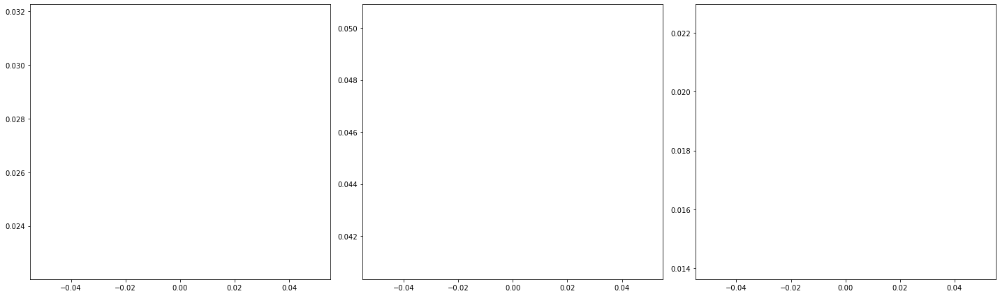

2220 582
Train Epoch: 2 [0/2220 (0%)]	Loss: 0.031365	Pres: 0.041444	F1 Score: 0.014417
105.0 -inf


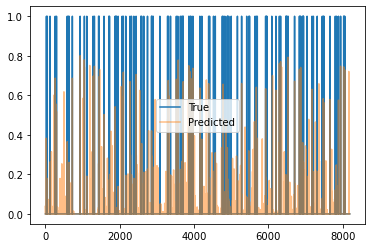

Train Epoch: 2 [10/2220 (0%)]	Loss: 0.031441	Pres: 0.037387	F1 Score: 0.010966
Train Epoch: 2 [20/2220 (0%)]	Loss: 0.030850	Pres: 0.034796	F1 Score: 0.009724
Train Epoch: 2 [30/2220 (1%)]	Loss: 0.034233	Pres: 0.030653	F1 Score: 0.010881
Train Epoch: 2 [40/2220 (1%)]	Loss: 0.031572	Pres: 0.033588	F1 Score: 0.012948
Train Epoch: 2 [50/2220 (2%)]	Loss: 0.031610	Pres: 0.039493	F1 Score: 0.012764
Train Epoch: 2 [60/2220 (2%)]	Loss: 0.031190	Pres: 0.036598	F1 Score: 0.013360
Train Epoch: 2 [70/2220 (3%)]	Loss: 0.029708	Pres: 0.038530	F1 Score: 0.015194
Train Epoch: 2 [80/2220 (3%)]	Loss: 0.030655	Pres: 0.032945	F1 Score: 0.011892
Train Epoch: 2 [90/2220 (4%)]	Loss: 0.032821	Pres: 0.038981	F1 Score: 0.012862
Train Epoch: 2 [100/2220 (4%)]	Loss: 0.027566	Pres: 0.042407	F1 Score: 0.016062
Train Epoch: 2 [110/2220 (4%)]	Loss: 0.031585	Pres: 0.039617	F1 Score: 0.014156
Train Epoch: 2 [120/2220 (5%)]	Loss: 0.031543	Pres: 0.029816	F1 Score: 0.010029
Train Epoch: 2 [130/2220 (5%)]	Loss: 0.031163	Pre

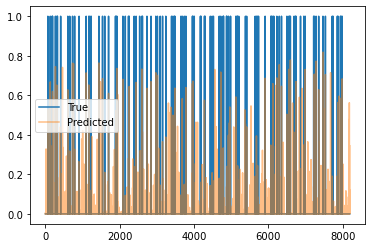

Train Epoch: 2 [310/2220 (13%)]	Loss: 0.034633	Pres: 0.037500	F1 Score: 0.011675
Train Epoch: 2 [320/2220 (14%)]	Loss: 0.030925	Pres: 0.041843	F1 Score: 0.015895
Train Epoch: 2 [330/2220 (14%)]	Loss: 0.028425	Pres: 0.034135	F1 Score: 0.014093
Train Epoch: 2 [340/2220 (15%)]	Loss: 0.030378	Pres: 0.034096	F1 Score: 0.013449
Train Epoch: 2 [350/2220 (15%)]	Loss: 0.029728	Pres: 0.031250	F1 Score: 0.012856
Train Epoch: 2 [360/2220 (16%)]	Loss: 0.031068	Pres: 0.029712	F1 Score: 0.010737
Train Epoch: 2 [370/2220 (16%)]	Loss: 0.038300	Pres: 0.036600	F1 Score: 0.012163
Train Epoch: 2 [380/2220 (17%)]	Loss: 0.031532	Pres: 0.038043	F1 Score: 0.013476
Train Epoch: 2 [390/2220 (17%)]	Loss: 0.036805	Pres: 0.039504	F1 Score: 0.009664
Train Epoch: 2 [400/2220 (18%)]	Loss: 0.031100	Pres: 0.036924	F1 Score: 0.011547
Train Epoch: 2 [410/2220 (18%)]	Loss: 0.032687	Pres: 0.031349	F1 Score: 0.008607
Train Epoch: 2 [420/2220 (18%)]	Loss: 0.028713	Pres: 0.033506	F1 Score: 0.012096
Train Epoch: 2 [430/2220 (19

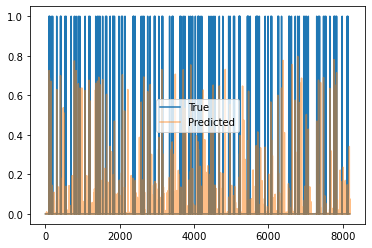

Train Epoch: 2 [610/2220 (27%)]	Loss: 0.026984	Pres: 0.034801	F1 Score: 0.013430
Train Epoch: 2 [620/2220 (27%)]	Loss: 0.028083	Pres: 0.037724	F1 Score: 0.013399
Train Epoch: 2 [630/2220 (28%)]	Loss: 0.032108	Pres: 0.038579	F1 Score: 0.013277
Train Epoch: 2 [640/2220 (28%)]	Loss: 0.032650	Pres: 0.045849	F1 Score: 0.017445
Train Epoch: 2 [650/2220 (29%)]	Loss: 0.028146	Pres: 0.039941	F1 Score: 0.014163
Train Epoch: 2 [660/2220 (29%)]	Loss: 0.032154	Pres: 0.036432	F1 Score: 0.011770
Train Epoch: 2 [670/2220 (30%)]	Loss: 0.030679	Pres: 0.043433	F1 Score: 0.012569
Train Epoch: 2 [680/2220 (30%)]	Loss: 0.033122	Pres: 0.040854	F1 Score: 0.013731
Train Epoch: 2 [690/2220 (31%)]	Loss: 0.028414	Pres: 0.041184	F1 Score: 0.015787
Train Epoch: 2 [700/2220 (31%)]	Loss: 0.030494	Pres: 0.043650	F1 Score: 0.015028
Train Epoch: 2 [710/2220 (31%)]	Loss: 0.030852	Pres: 0.039451	F1 Score: 0.012518
Train Epoch: 2 [720/2220 (32%)]	Loss: 0.032720	Pres: 0.034315	F1 Score: 0.012412
Train Epoch: 2 [730/2220 (32

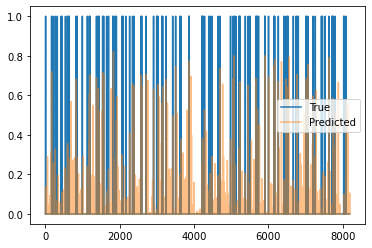

Train Epoch: 2 [910/2220 (40%)]	Loss: 0.030488	Pres: 0.039883	F1 Score: 0.013894
Train Epoch: 2 [920/2220 (41%)]	Loss: 0.028179	Pres: 0.039609	F1 Score: 0.014174
Train Epoch: 2 [930/2220 (41%)]	Loss: 0.031345	Pres: 0.038604	F1 Score: 0.012877
Train Epoch: 2 [940/2220 (42%)]	Loss: 0.030322	Pres: 0.032670	F1 Score: 0.011576
Train Epoch: 2 [950/2220 (42%)]	Loss: 0.028604	Pres: 0.031631	F1 Score: 0.011435
Train Epoch: 2 [960/2220 (43%)]	Loss: 0.027207	Pres: 0.038782	F1 Score: 0.016138
Train Epoch: 2 [970/2220 (43%)]	Loss: 0.029808	Pres: 0.035503	F1 Score: 0.011607
Train Epoch: 2 [980/2220 (44%)]	Loss: 0.036864	Pres: 0.039130	F1 Score: 0.013089
Train Epoch: 2 [990/2220 (44%)]	Loss: 0.033838	Pres: 0.037943	F1 Score: 0.013236
Train Epoch: 2 [1000/2220 (45%)]	Loss: 0.032946	Pres: 0.047270	F1 Score: 0.016068
Train Epoch: 2 [1010/2220 (45%)]	Loss: 0.033306	Pres: 0.040299	F1 Score: 0.013311
Train Epoch: 2 [1020/2220 (45%)]	Loss: 0.028550	Pres: 0.039388	F1 Score: 0.013537
Train Epoch: 2 [1030/2220

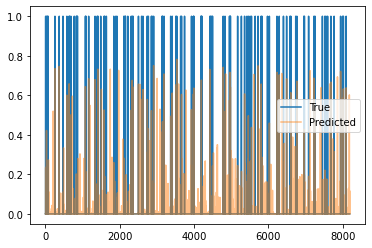

Train Epoch: 2 [1210/2220 (54%)]	Loss: 0.028030	Pres: 0.039282	F1 Score: 0.013818
Train Epoch: 2 [1220/2220 (54%)]	Loss: 0.033992	Pres: 0.032973	F1 Score: 0.010020
Train Epoch: 2 [1230/2220 (55%)]	Loss: 0.031227	Pres: 0.041103	F1 Score: 0.014242
Train Epoch: 2 [1240/2220 (55%)]	Loss: 0.032502	Pres: 0.040714	F1 Score: 0.014300
Train Epoch: 2 [1250/2220 (56%)]	Loss: 0.029723	Pres: 0.040416	F1 Score: 0.014977
Train Epoch: 2 [1260/2220 (56%)]	Loss: 0.032417	Pres: 0.046673	F1 Score: 0.014536
Train Epoch: 2 [1270/2220 (57%)]	Loss: 0.029999	Pres: 0.040136	F1 Score: 0.014050
Train Epoch: 2 [1280/2220 (57%)]	Loss: 0.029523	Pres: 0.039833	F1 Score: 0.013582
Train Epoch: 2 [1290/2220 (58%)]	Loss: 0.031420	Pres: 0.042204	F1 Score: 0.012950
Train Epoch: 2 [1300/2220 (58%)]	Loss: 0.030320	Pres: 0.044218	F1 Score: 0.015859
Train Epoch: 2 [1310/2220 (59%)]	Loss: 0.030474	Pres: 0.035975	F1 Score: 0.011622
Train Epoch: 2 [1320/2220 (59%)]	Loss: 0.032317	Pres: 0.045464	F1 Score: 0.016069
Train Epoch: 2 [

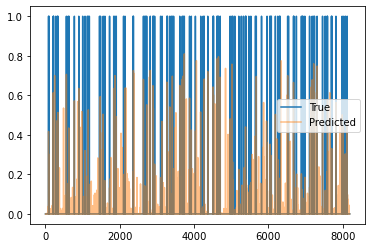

Train Epoch: 2 [1510/2220 (68%)]	Loss: 0.032981	Pres: 0.040540	F1 Score: 0.013986
Train Epoch: 2 [1520/2220 (68%)]	Loss: 0.032360	Pres: 0.041452	F1 Score: 0.013345
Train Epoch: 2 [1530/2220 (68%)]	Loss: 0.036324	Pres: 0.032887	F1 Score: 0.009590
Train Epoch: 2 [1540/2220 (69%)]	Loss: 0.030076	Pres: 0.040521	F1 Score: 0.014259
Train Epoch: 2 [1550/2220 (69%)]	Loss: 0.033161	Pres: 0.042337	F1 Score: 0.011847
Train Epoch: 2 [1560/2220 (70%)]	Loss: 0.030755	Pres: 0.038959	F1 Score: 0.012946
Train Epoch: 2 [1570/2220 (70%)]	Loss: 0.030570	Pres: 0.046542	F1 Score: 0.015308
Train Epoch: 2 [1580/2220 (71%)]	Loss: 0.034841	Pres: 0.037767	F1 Score: 0.011287
Train Epoch: 2 [1590/2220 (71%)]	Loss: 0.030958	Pres: 0.045084	F1 Score: 0.014725
Train Epoch: 2 [1600/2220 (72%)]	Loss: 0.031100	Pres: 0.047264	F1 Score: 0.015958
Train Epoch: 2 [1610/2220 (72%)]	Loss: 0.030296	Pres: 0.042206	F1 Score: 0.014535
Train Epoch: 2 [1620/2220 (72%)]	Loss: 0.032678	Pres: 0.044374	F1 Score: 0.011003
Train Epoch: 2 [

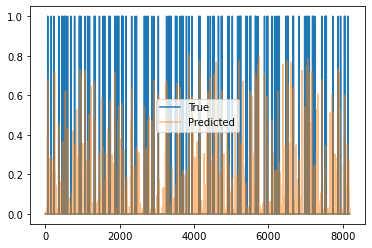

Train Epoch: 2 [1810/2220 (81%)]	Loss: 0.029005	Pres: 0.041734	F1 Score: 0.012992
Train Epoch: 2 [1820/2220 (81%)]	Loss: 0.042436	Pres: 0.057199	F1 Score: 0.017389
Train Epoch: 2 [1830/2220 (82%)]	Loss: 0.029144	Pres: 0.046791	F1 Score: 0.017731
Train Epoch: 2 [1840/2220 (82%)]	Loss: 0.030851	Pres: 0.050318	F1 Score: 0.014111
Train Epoch: 2 [1850/2220 (83%)]	Loss: 0.030674	Pres: 0.036109	F1 Score: 0.011923
Train Epoch: 2 [1860/2220 (83%)]	Loss: 0.033633	Pres: 0.044868	F1 Score: 0.015163
Train Epoch: 2 [1870/2220 (84%)]	Loss: 0.033631	Pres: 0.038333	F1 Score: 0.011660
Train Epoch: 2 [1880/2220 (84%)]	Loss: 0.027003	Pres: 0.043524	F1 Score: 0.016362
Train Epoch: 2 [1890/2220 (85%)]	Loss: 0.028797	Pres: 0.035396	F1 Score: 0.013046
Train Epoch: 2 [1900/2220 (85%)]	Loss: 0.035052	Pres: 0.038091	F1 Score: 0.009855
Train Epoch: 2 [1910/2220 (86%)]	Loss: 0.031015	Pres: 0.038690	F1 Score: 0.013627
Train Epoch: 2 [1920/2220 (86%)]	Loss: 0.031277	Pres: 0.041310	F1 Score: 0.013513
Train Epoch: 2 [

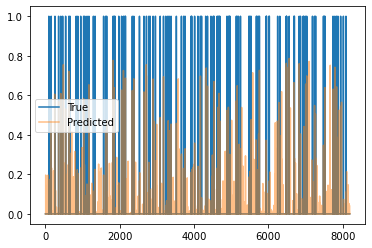

Train Epoch: 2 [2110/2220 (95%)]	Loss: 0.031329	Pres: 0.037015	F1 Score: 0.012547
Train Epoch: 2 [2120/2220 (95%)]	Loss: 0.034715	Pres: 0.044787	F1 Score: 0.014378
Train Epoch: 2 [2130/2220 (95%)]	Loss: 0.032249	Pres: 0.045345	F1 Score: 0.014603
Train Epoch: 2 [2140/2220 (96%)]	Loss: 0.041292	Pres: 0.044380	F1 Score: 0.011185
Train Epoch: 2 [2150/2220 (96%)]	Loss: 0.030475	Pres: 0.044611	F1 Score: 0.014907
Train Epoch: 2 [2160/2220 (97%)]	Loss: 0.031870	Pres: 0.043889	F1 Score: 0.012862
Train Epoch: 2 [2170/2220 (97%)]	Loss: 0.026472	Pres: 0.037202	F1 Score: 0.015753
Train Epoch: 2 [2180/2220 (98%)]	Loss: 0.031157	Pres: 0.044856	F1 Score: 0.014382
Train Epoch: 2 [2190/2220 (98%)]	Loss: 0.029544	Pres: 0.040853	F1 Score: 0.012560
Train Epoch: 2 [2200/2220 (99%)]	Loss: 0.029059	Pres: 0.040491	F1 Score: 0.014325
Train Epoch: 2 [2210/2220 (99%)]	Loss: 0.029927	Pres: 0.036397	F1 Score: 0.011272
Validation Epoch: 2 [0/582 (0%)]	Loss: 0.023722	Pres: 0.056517	F1 Score: 0.022252


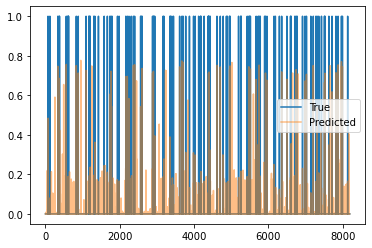

Validation Epoch: 2 [10/582 (1%)]	Loss: 0.023804	Pres: 0.045894	F1 Score: 0.020404
Validation Epoch: 2 [20/582 (3%)]	Loss: 0.024827	Pres: 0.054177	F1 Score: 0.019577
Validation Epoch: 2 [30/582 (5%)]	Loss: 0.025892	Pres: 0.039493	F1 Score: 0.015610
Validation Epoch: 2 [40/582 (6%)]	Loss: 0.024813	Pres: 0.039748	F1 Score: 0.017470
Validation Epoch: 2 [50/582 (8%)]	Loss: 0.024241	Pres: 0.045869	F1 Score: 0.018390
Validation Epoch: 2 [60/582 (10%)]	Loss: 0.023782	Pres: 0.047128	F1 Score: 0.018298
Validation Epoch: 2 [70/582 (12%)]	Loss: 0.024594	Pres: 0.048311	F1 Score: 0.016326
Validation Epoch: 2 [80/582 (13%)]	Loss: 0.022843	Pres: 0.044405	F1 Score: 0.022564
Validation Epoch: 2 [90/582 (15%)]	Loss: 0.025831	Pres: 0.047961	F1 Score: 0.017549
Validation Epoch: 2 [100/582 (17%)]	Loss: 0.020890	Pres: 0.052277	F1 Score: 0.024182
Validation Epoch: 2 [110/582 (18%)]	Loss: 0.021868	Pres: 0.054510	F1 Score: 0.022828
Validation Epoch: 2 [120/582 (20%)]	Loss: 0.021137	Pres: 0.043372	F1 Score: 0.0

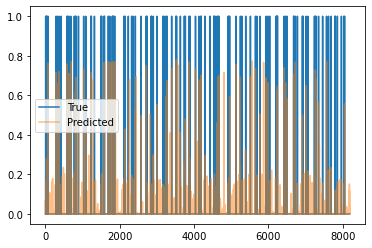

Validation Epoch: 2 [310/582 (53%)]	Loss: 0.022695	Pres: 0.051047	F1 Score: 0.021610
Validation Epoch: 2 [320/582 (54%)]	Loss: 0.022555	Pres: 0.046716	F1 Score: 0.020005
Validation Epoch: 2 [330/582 (56%)]	Loss: 0.026138	Pres: 0.044591	F1 Score: 0.015433
Validation Epoch: 2 [340/582 (58%)]	Loss: 0.021098	Pres: 0.049153	F1 Score: 0.023175
Validation Epoch: 2 [350/582 (60%)]	Loss: 0.026161	Pres: 0.054348	F1 Score: 0.015252
Validation Epoch: 2 [360/582 (61%)]	Loss: 0.023795	Pres: 0.036264	F1 Score: 0.015943
Validation Epoch: 2 [370/582 (63%)]	Loss: 0.020796	Pres: 0.038118	F1 Score: 0.020192
Validation Epoch: 2 [380/582 (65%)]	Loss: 0.022547	Pres: 0.041163	F1 Score: 0.022611
Validation Epoch: 2 [390/582 (67%)]	Loss: 0.025005	Pres: 0.051220	F1 Score: 0.018723
Validation Epoch: 2 [400/582 (68%)]	Loss: 0.024853	Pres: 0.044085	F1 Score: 0.016242
Validation Epoch: 2 [410/582 (70%)]	Loss: 0.023587	Pres: 0.052947	F1 Score: 0.022119
Validation Epoch: 2 [420/582 (72%)]	Loss: 0.021745	Pres: 0.046250

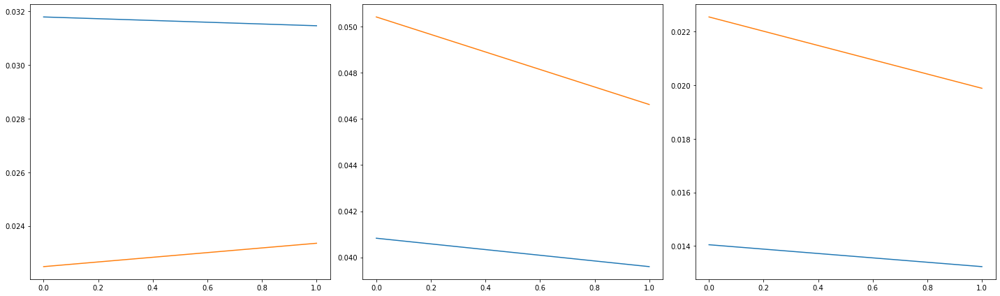

2220 582
Train Epoch: 3 [0/2220 (0%)]	Loss: 0.028942	Pres: 0.037038	F1 Score: 0.010716
113.0 -inf


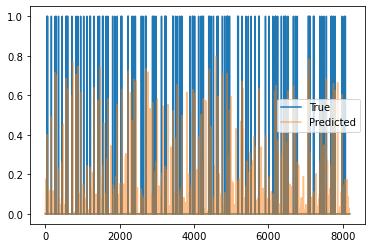

Train Epoch: 3 [10/2220 (0%)]	Loss: 0.039717	Pres: 0.047773	F1 Score: 0.012998
Train Epoch: 3 [20/2220 (0%)]	Loss: 0.027549	Pres: 0.039174	F1 Score: 0.016234
Train Epoch: 3 [30/2220 (1%)]	Loss: 0.036341	Pres: 0.042529	F1 Score: 0.011661
Train Epoch: 3 [40/2220 (1%)]	Loss: 0.034162	Pres: 0.039931	F1 Score: 0.014037
Train Epoch: 3 [50/2220 (2%)]	Loss: 0.030000	Pres: 0.039959	F1 Score: 0.012982
Train Epoch: 3 [60/2220 (2%)]	Loss: 0.030080	Pres: 0.040304	F1 Score: 0.013404
Train Epoch: 3 [70/2220 (3%)]	Loss: 0.032154	Pres: 0.035037	F1 Score: 0.012145
Train Epoch: 3 [80/2220 (3%)]	Loss: 0.029619	Pres: 0.037595	F1 Score: 0.011383
Train Epoch: 3 [90/2220 (4%)]	Loss: 0.032422	Pres: 0.026070	F1 Score: 0.004219
Train Epoch: 3 [100/2220 (4%)]	Loss: 0.027294	Pres: 0.035954	F1 Score: 0.011438
Train Epoch: 3 [110/2220 (4%)]	Loss: 0.031650	Pres: 0.034259	F1 Score: 0.008864
Train Epoch: 3 [120/2220 (5%)]	Loss: 0.029038	Pres: 0.043692	F1 Score: 0.014859
Train Epoch: 3 [130/2220 (5%)]	Loss: 0.029496	Pre

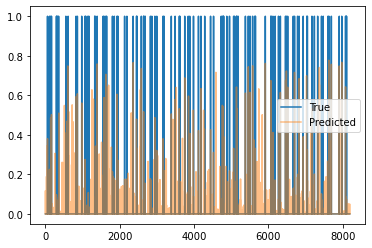

Train Epoch: 3 [310/2220 (13%)]	Loss: 0.028856	Pres: 0.038427	F1 Score: 0.010258
Train Epoch: 3 [320/2220 (14%)]	Loss: 0.030733	Pres: 0.038002	F1 Score: 0.010898
Train Epoch: 3 [330/2220 (14%)]	Loss: 0.029104	Pres: 0.040735	F1 Score: 0.012310
Train Epoch: 3 [340/2220 (15%)]	Loss: 0.029753	Pres: 0.045944	F1 Score: 0.014541
Train Epoch: 3 [350/2220 (15%)]	Loss: 0.029837	Pres: 0.042569	F1 Score: 0.012153
Train Epoch: 3 [360/2220 (16%)]	Loss: 0.035512	Pres: 0.036756	F1 Score: 0.006627
Train Epoch: 3 [370/2220 (16%)]	Loss: 0.035386	Pres: 0.038543	F1 Score: 0.010464
Train Epoch: 3 [380/2220 (17%)]	Loss: 0.031856	Pres: 0.041923	F1 Score: 0.011150
Train Epoch: 3 [390/2220 (17%)]	Loss: 0.031193	Pres: 0.035027	F1 Score: 0.012052
Train Epoch: 3 [400/2220 (18%)]	Loss: 0.031551	Pres: 0.039309	F1 Score: 0.013687
Train Epoch: 3 [410/2220 (18%)]	Loss: 0.031912	Pres: 0.040363	F1 Score: 0.012291
Train Epoch: 3 [420/2220 (18%)]	Loss: 0.030376	Pres: 0.037195	F1 Score: 0.010528
Train Epoch: 3 [430/2220 (19

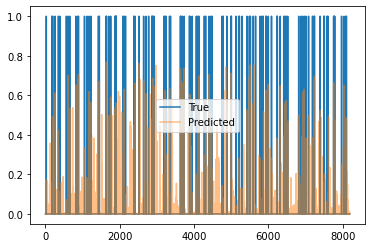

Train Epoch: 3 [610/2220 (27%)]	Loss: 0.033305	Pres: 0.038611	F1 Score: 0.009820
Train Epoch: 3 [620/2220 (27%)]	Loss: 0.028378	Pres: 0.040664	F1 Score: 0.011249
Train Epoch: 3 [630/2220 (28%)]	Loss: 0.034360	Pres: 0.043571	F1 Score: 0.010649
Train Epoch: 3 [640/2220 (28%)]	Loss: 0.028603	Pres: 0.044138	F1 Score: 0.010624
Train Epoch: 3 [650/2220 (29%)]	Loss: 0.031346	Pres: 0.042422	F1 Score: 0.009257
Train Epoch: 3 [660/2220 (29%)]	Loss: 0.025736	Pres: 0.028897	F1 Score: 0.008285
Train Epoch: 3 [670/2220 (30%)]	Loss: 0.028667	Pres: 0.041777	F1 Score: 0.012836
Train Epoch: 3 [680/2220 (30%)]	Loss: 0.036172	Pres: 0.043151	F1 Score: 0.011632
Train Epoch: 3 [690/2220 (31%)]	Loss: 0.028160	Pres: 0.046126	F1 Score: 0.009207
Train Epoch: 3 [700/2220 (31%)]	Loss: 0.033450	Pres: 0.041817	F1 Score: 0.009324
Train Epoch: 3 [710/2220 (31%)]	Loss: 0.031075	Pres: 0.043176	F1 Score: 0.012346
Train Epoch: 3 [720/2220 (32%)]	Loss: 0.039140	Pres: 0.042208	F1 Score: 0.007932
Train Epoch: 3 [730/2220 (32

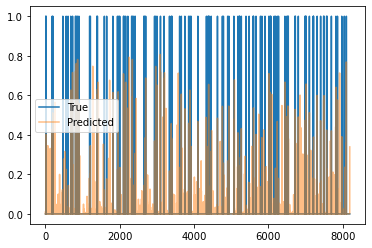

Train Epoch: 3 [910/2220 (40%)]	Loss: 0.031092	Pres: 0.047273	F1 Score: 0.009562
Train Epoch: 3 [920/2220 (41%)]	Loss: 0.031480	Pres: 0.047190	F1 Score: 0.013021
Train Epoch: 3 [930/2220 (41%)]	Loss: 0.031255	Pres: 0.043679	F1 Score: 0.011747
Train Epoch: 3 [940/2220 (42%)]	Loss: 0.034805	Pres: 0.053400	F1 Score: 0.013770
Train Epoch: 3 [950/2220 (42%)]	Loss: 0.029680	Pres: 0.045017	F1 Score: 0.012839
Train Epoch: 3 [960/2220 (43%)]	Loss: 0.032735	Pres: 0.041063	F1 Score: 0.008223
Train Epoch: 3 [970/2220 (43%)]	Loss: 0.027077	Pres: 0.044846	F1 Score: 0.013455
Train Epoch: 3 [980/2220 (44%)]	Loss: 0.035416	Pres: 0.048021	F1 Score: 0.008899
Train Epoch: 3 [990/2220 (44%)]	Loss: 0.029668	Pres: 0.037675	F1 Score: 0.009813
Train Epoch: 3 [1000/2220 (45%)]	Loss: 0.028517	Pres: 0.042379	F1 Score: 0.011636
Train Epoch: 3 [1010/2220 (45%)]	Loss: 0.029492	Pres: 0.046494	F1 Score: 0.010493
Train Epoch: 3 [1020/2220 (45%)]	Loss: 0.032079	Pres: 0.037667	F1 Score: 0.008223
Train Epoch: 3 [1030/2220

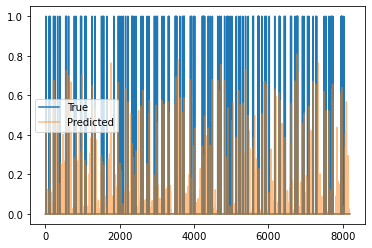

Train Epoch: 3 [1210/2220 (54%)]	Loss: 0.031586	Pres: 0.056806	F1 Score: 0.013817
Train Epoch: 3 [1220/2220 (54%)]	Loss: 0.029634	Pres: 0.048997	F1 Score: 0.012032
Train Epoch: 3 [1230/2220 (55%)]	Loss: 0.033921	Pres: 0.054545	F1 Score: 0.013922
Train Epoch: 3 [1240/2220 (55%)]	Loss: 0.026663	Pres: 0.048167	F1 Score: 0.015322
Train Epoch: 3 [1250/2220 (56%)]	Loss: 0.027448	Pres: 0.044941	F1 Score: 0.009378
Train Epoch: 3 [1260/2220 (56%)]	Loss: 0.029188	Pres: 0.051865	F1 Score: 0.014876
Train Epoch: 3 [1270/2220 (57%)]	Loss: 0.031577	Pres: 0.049429	F1 Score: 0.011243
Train Epoch: 3 [1280/2220 (57%)]	Loss: 0.034126	Pres: 0.048543	F1 Score: 0.008951
Train Epoch: 3 [1290/2220 (58%)]	Loss: 0.032030	Pres: 0.052937	F1 Score: 0.014534
Train Epoch: 3 [1300/2220 (58%)]	Loss: 0.027794	Pres: 0.041794	F1 Score: 0.009492
Train Epoch: 3 [1310/2220 (59%)]	Loss: 0.031887	Pres: 0.039487	F1 Score: 0.008485
Train Epoch: 3 [1320/2220 (59%)]	Loss: 0.030568	Pres: 0.046985	F1 Score: 0.010305
Train Epoch: 3 [

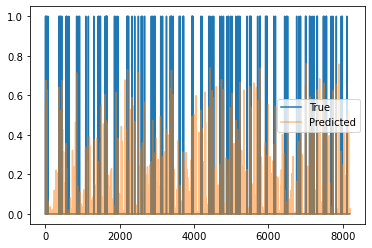

Train Epoch: 3 [1510/2220 (68%)]	Loss: 0.031004	Pres: 0.045525	F1 Score: 0.010247
Train Epoch: 3 [1520/2220 (68%)]	Loss: 0.029973	Pres: 0.036532	F1 Score: 0.009530
Train Epoch: 3 [1530/2220 (68%)]	Loss: 0.032167	Pres: 0.043547	F1 Score: 0.011052
Train Epoch: 3 [1540/2220 (69%)]	Loss: 0.028130	Pres: 0.049447	F1 Score: 0.013322
Train Epoch: 3 [1550/2220 (69%)]	Loss: 0.029512	Pres: 0.044522	F1 Score: 0.008725
Train Epoch: 3 [1560/2220 (70%)]	Loss: 0.029139	Pres: 0.048652	F1 Score: 0.010697
Train Epoch: 3 [1570/2220 (70%)]	Loss: 0.030105	Pres: 0.050467	F1 Score: 0.011129
Train Epoch: 3 [1580/2220 (71%)]	Loss: 0.029459	Pres: 0.047741	F1 Score: 0.012878
Train Epoch: 3 [1590/2220 (71%)]	Loss: 0.032503	Pres: 0.050541	F1 Score: 0.011748
Train Epoch: 3 [1600/2220 (72%)]	Loss: 0.031316	Pres: 0.044048	F1 Score: 0.010860
Train Epoch: 3 [1610/2220 (72%)]	Loss: 0.034511	Pres: 0.047235	F1 Score: 0.009960
Train Epoch: 3 [1620/2220 (72%)]	Loss: 0.031557	Pres: 0.036145	F1 Score: 0.010208
Train Epoch: 3 [

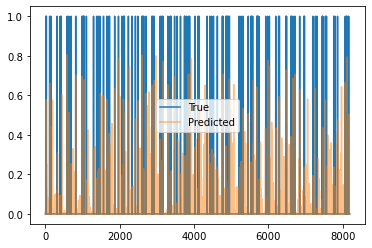

Train Epoch: 3 [1810/2220 (81%)]	Loss: 0.027849	Pres: 0.051336	F1 Score: 0.014837
Train Epoch: 3 [1820/2220 (81%)]	Loss: 0.032824	Pres: 0.045632	F1 Score: 0.013802
Train Epoch: 3 [1830/2220 (82%)]	Loss: 0.033272	Pres: 0.053102	F1 Score: 0.015063
Train Epoch: 3 [1840/2220 (82%)]	Loss: 0.032635	Pres: 0.048543	F1 Score: 0.010926
Train Epoch: 3 [1850/2220 (83%)]	Loss: 0.025207	Pres: 0.049665	F1 Score: 0.014368
Train Epoch: 3 [1860/2220 (83%)]	Loss: 0.030186	Pres: 0.039509	F1 Score: 0.009015
Train Epoch: 3 [1870/2220 (84%)]	Loss: 0.034338	Pres: 0.049161	F1 Score: 0.013835
Train Epoch: 3 [1880/2220 (84%)]	Loss: 0.027430	Pres: 0.046443	F1 Score: 0.009541
Train Epoch: 3 [1890/2220 (85%)]	Loss: 0.028266	Pres: 0.054861	F1 Score: 0.014366
Train Epoch: 3 [1900/2220 (85%)]	Loss: 0.028468	Pres: 0.039724	F1 Score: 0.010143
Train Epoch: 3 [1910/2220 (86%)]	Loss: 0.029611	Pres: 0.050500	F1 Score: 0.014732
Train Epoch: 3 [1920/2220 (86%)]	Loss: 0.029122	Pres: 0.041311	F1 Score: 0.010389
Train Epoch: 3 [

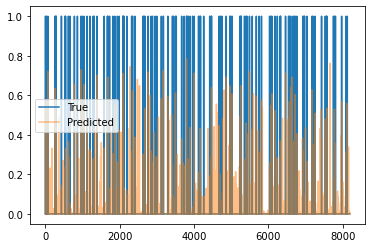

Train Epoch: 3 [2110/2220 (95%)]	Loss: 0.027238	Pres: 0.051515	F1 Score: 0.015115
Train Epoch: 3 [2120/2220 (95%)]	Loss: 0.033066	Pres: 0.049342	F1 Score: 0.014646
Train Epoch: 3 [2130/2220 (95%)]	Loss: 0.031971	Pres: 0.051666	F1 Score: 0.011116
Train Epoch: 3 [2140/2220 (96%)]	Loss: 0.029479	Pres: 0.047536	F1 Score: 0.011180
Train Epoch: 3 [2150/2220 (96%)]	Loss: 0.032762	Pres: 0.048218	F1 Score: 0.013253
Train Epoch: 3 [2160/2220 (97%)]	Loss: 0.027771	Pres: 0.052662	F1 Score: 0.013152
Train Epoch: 3 [2170/2220 (97%)]	Loss: 0.031283	Pres: 0.043741	F1 Score: 0.013118
Train Epoch: 3 [2180/2220 (98%)]	Loss: 0.031856	Pres: 0.045812	F1 Score: 0.012529
Train Epoch: 3 [2190/2220 (98%)]	Loss: 0.033354	Pres: 0.050170	F1 Score: 0.014515
Train Epoch: 3 [2200/2220 (99%)]	Loss: 0.026909	Pres: 0.056052	F1 Score: 0.014535
Train Epoch: 3 [2210/2220 (99%)]	Loss: 0.031197	Pres: 0.041311	F1 Score: 0.009464
Validation Epoch: 3 [0/582 (0%)]	Loss: 0.023358	Pres: 0.042443	F1 Score: 0.016079


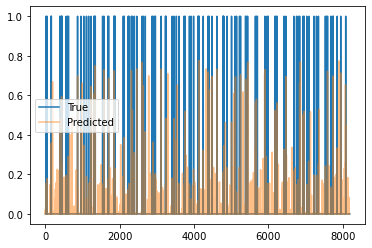

Validation Epoch: 3 [10/582 (1%)]	Loss: 0.023174	Pres: 0.057858	F1 Score: 0.018232
Validation Epoch: 3 [20/582 (3%)]	Loss: 0.021643	Pres: 0.039520	F1 Score: 0.018705
Validation Epoch: 3 [30/582 (5%)]	Loss: 0.022448	Pres: 0.051557	F1 Score: 0.023187
Validation Epoch: 3 [40/582 (6%)]	Loss: 0.024999	Pres: 0.045073	F1 Score: 0.015999
Validation Epoch: 3 [50/582 (8%)]	Loss: 0.021769	Pres: 0.044783	F1 Score: 0.020754
Validation Epoch: 3 [60/582 (10%)]	Loss: 0.021223	Pres: 0.044928	F1 Score: 0.021591
Validation Epoch: 3 [70/582 (12%)]	Loss: 0.021041	Pres: 0.049233	F1 Score: 0.023382
Validation Epoch: 3 [80/582 (13%)]	Loss: 0.021250	Pres: 0.045714	F1 Score: 0.021177
Validation Epoch: 3 [90/582 (15%)]	Loss: 0.021896	Pres: 0.070869	F1 Score: 0.025428
Validation Epoch: 3 [100/582 (17%)]	Loss: 0.022808	Pres: 0.050225	F1 Score: 0.021111
Validation Epoch: 3 [110/582 (18%)]	Loss: 0.022267	Pres: 0.052795	F1 Score: 0.020336
Validation Epoch: 3 [120/582 (20%)]	Loss: 0.020793	Pres: 0.057139	F1 Score: 0.0

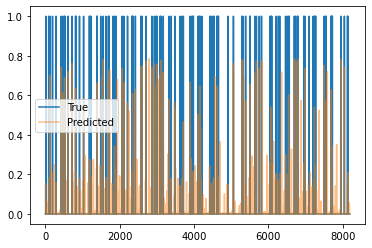

Validation Epoch: 3 [310/582 (53%)]	Loss: 0.023031	Pres: 0.043778	F1 Score: 0.018315
Validation Epoch: 3 [320/582 (54%)]	Loss: 0.021540	Pres: 0.049229	F1 Score: 0.021883
Validation Epoch: 3 [330/582 (56%)]	Loss: 0.021498	Pres: 0.042029	F1 Score: 0.019649
Validation Epoch: 3 [340/582 (58%)]	Loss: 0.023223	Pres: 0.049035	F1 Score: 0.017916
Validation Epoch: 3 [350/582 (60%)]	Loss: 0.023431	Pres: 0.050006	F1 Score: 0.017772
Validation Epoch: 3 [360/582 (61%)]	Loss: 0.022552	Pres: 0.045762	F1 Score: 0.017563
Validation Epoch: 3 [370/582 (63%)]	Loss: 0.022692	Pres: 0.043214	F1 Score: 0.016867
Validation Epoch: 3 [380/582 (65%)]	Loss: 0.022557	Pres: 0.049233	F1 Score: 0.019705
Validation Epoch: 3 [390/582 (67%)]	Loss: 0.021480	Pres: 0.051365	F1 Score: 0.023272
Validation Epoch: 3 [400/582 (68%)]	Loss: 0.024418	Pres: 0.048788	F1 Score: 0.018103
Validation Epoch: 3 [410/582 (70%)]	Loss: 0.023069	Pres: 0.051675	F1 Score: 0.021341
Validation Epoch: 3 [420/582 (72%)]	Loss: 0.021727	Pres: 0.049373

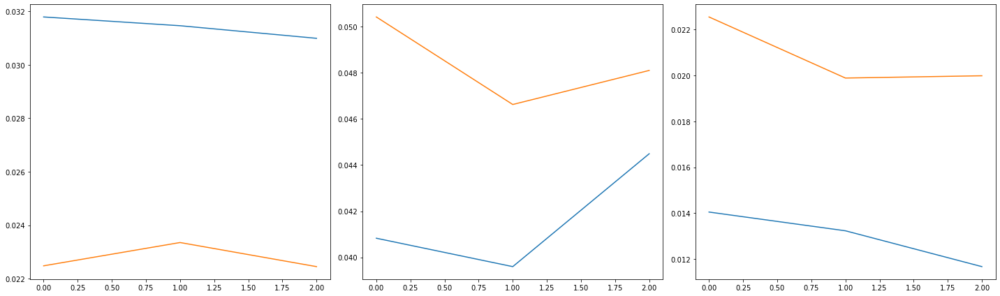

2220 582
Train Epoch: 4 [0/2220 (0%)]	Loss: 0.028118	Pres: 0.046296	F1 Score: 0.014446
117.0 -inf


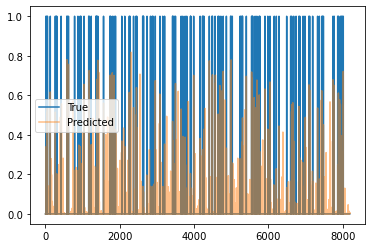

Train Epoch: 4 [10/2220 (0%)]	Loss: 0.029062	Pres: 0.044946	F1 Score: 0.013620
Train Epoch: 4 [20/2220 (0%)]	Loss: 0.028031	Pres: 0.043464	F1 Score: 0.013036
Train Epoch: 4 [30/2220 (1%)]	Loss: 0.031120	Pres: 0.045982	F1 Score: 0.012610
Train Epoch: 4 [40/2220 (1%)]	Loss: 0.028842	Pres: 0.039633	F1 Score: 0.009355
Train Epoch: 4 [50/2220 (2%)]	Loss: 0.027207	Pres: 0.046684	F1 Score: 0.014019
Train Epoch: 4 [60/2220 (2%)]	Loss: 0.034906	Pres: 0.047246	F1 Score: 0.009531
Train Epoch: 4 [70/2220 (3%)]	Loss: 0.030932	Pres: 0.040288	F1 Score: 0.012634
Train Epoch: 4 [80/2220 (3%)]	Loss: 0.032139	Pres: 0.041204	F1 Score: 0.007687
Train Epoch: 4 [90/2220 (4%)]	Loss: 0.032229	Pres: 0.039528	F1 Score: 0.010627
Train Epoch: 4 [100/2220 (4%)]	Loss: 0.031450	Pres: 0.049326	F1 Score: 0.014907
Train Epoch: 4 [110/2220 (4%)]	Loss: 0.028619	Pres: 0.048130	F1 Score: 0.011942
Train Epoch: 4 [120/2220 (5%)]	Loss: 0.027999	Pres: 0.059272	F1 Score: 0.014107
Train Epoch: 4 [130/2220 (5%)]	Loss: 0.027180	Pre

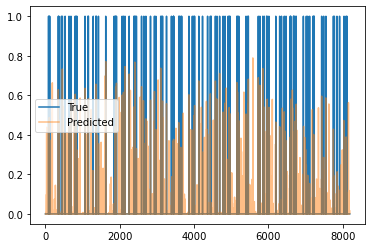

Train Epoch: 4 [310/2220 (13%)]	Loss: 0.030976	Pres: 0.047926	F1 Score: 0.010900
Train Epoch: 4 [320/2220 (14%)]	Loss: 0.031263	Pres: 0.045571	F1 Score: 0.009452
Train Epoch: 4 [330/2220 (14%)]	Loss: 0.031091	Pres: 0.050112	F1 Score: 0.013810
Train Epoch: 4 [340/2220 (15%)]	Loss: 0.030800	Pres: 0.052172	F1 Score: 0.012484
Train Epoch: 4 [350/2220 (15%)]	Loss: 0.031046	Pres: 0.041483	F1 Score: 0.012294
Train Epoch: 4 [360/2220 (16%)]	Loss: 0.029905	Pres: 0.046543	F1 Score: 0.012129
Train Epoch: 4 [370/2220 (16%)]	Loss: 0.029902	Pres: 0.052310	F1 Score: 0.010804
Train Epoch: 4 [380/2220 (17%)]	Loss: 0.032478	Pres: 0.054812	F1 Score: 0.011967
Train Epoch: 4 [390/2220 (17%)]	Loss: 0.030570	Pres: 0.044512	F1 Score: 0.009341
Train Epoch: 4 [400/2220 (18%)]	Loss: 0.027773	Pres: 0.046482	F1 Score: 0.010065
Train Epoch: 4 [410/2220 (18%)]	Loss: 0.028088	Pres: 0.051786	F1 Score: 0.013801
Train Epoch: 4 [420/2220 (18%)]	Loss: 0.046347	Pres: 0.050286	F1 Score: 0.004323
Train Epoch: 4 [430/2220 (19

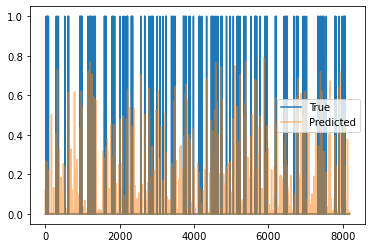

Train Epoch: 4 [610/2220 (27%)]	Loss: 0.029193	Pres: 0.037354	F1 Score: 0.008110
Train Epoch: 4 [620/2220 (27%)]	Loss: 0.028588	Pres: 0.038974	F1 Score: 0.009928
Train Epoch: 4 [630/2220 (28%)]	Loss: 0.029003	Pres: 0.043719	F1 Score: 0.011382
Train Epoch: 4 [640/2220 (28%)]	Loss: 0.031652	Pres: 0.036809	F1 Score: 0.009205
Train Epoch: 4 [650/2220 (29%)]	Loss: 0.030343	Pres: 0.050870	F1 Score: 0.013687
Train Epoch: 4 [660/2220 (29%)]	Loss: 0.031987	Pres: 0.046946	F1 Score: 0.012387
Train Epoch: 4 [670/2220 (30%)]	Loss: 0.031540	Pres: 0.046304	F1 Score: 0.010388
Train Epoch: 4 [680/2220 (30%)]	Loss: 0.031871	Pres: 0.040503	F1 Score: 0.012011
Train Epoch: 4 [690/2220 (31%)]	Loss: 0.027856	Pres: 0.052207	F1 Score: 0.013029
Train Epoch: 4 [700/2220 (31%)]	Loss: 0.030298	Pres: 0.041067	F1 Score: 0.008688
Train Epoch: 4 [710/2220 (31%)]	Loss: 0.027440	Pres: 0.044902	F1 Score: 0.007974
Train Epoch: 4 [720/2220 (32%)]	Loss: 0.027152	Pres: 0.043970	F1 Score: 0.013080
Train Epoch: 4 [730/2220 (32

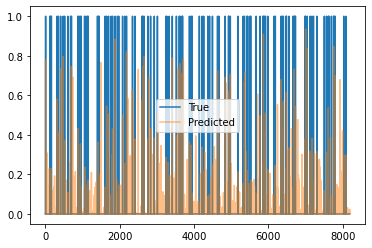

Train Epoch: 4 [910/2220 (40%)]	Loss: 0.029734	Pres: 0.042378	F1 Score: 0.010527
Train Epoch: 4 [920/2220 (41%)]	Loss: 0.029871	Pres: 0.040329	F1 Score: 0.010755
Train Epoch: 4 [930/2220 (41%)]	Loss: 0.027222	Pres: 0.046363	F1 Score: 0.012989
Train Epoch: 4 [940/2220 (42%)]	Loss: 0.027969	Pres: 0.040876	F1 Score: 0.008810
Train Epoch: 4 [950/2220 (42%)]	Loss: 0.029196	Pres: 0.039306	F1 Score: 0.010762
Train Epoch: 4 [960/2220 (43%)]	Loss: 0.031169	Pres: 0.045807	F1 Score: 0.011767
Train Epoch: 4 [970/2220 (43%)]	Loss: 0.035312	Pres: 0.049755	F1 Score: 0.010180
Train Epoch: 4 [980/2220 (44%)]	Loss: 0.028862	Pres: 0.042956	F1 Score: 0.012587
Train Epoch: 4 [990/2220 (44%)]	Loss: 0.031117	Pres: 0.048090	F1 Score: 0.007739
Train Epoch: 4 [1000/2220 (45%)]	Loss: 0.026722	Pres: 0.045267	F1 Score: 0.010714
Train Epoch: 4 [1010/2220 (45%)]	Loss: 0.028204	Pres: 0.040769	F1 Score: 0.011709
Train Epoch: 4 [1020/2220 (45%)]	Loss: 0.027642	Pres: 0.043651	F1 Score: 0.011984
Train Epoch: 4 [1030/2220

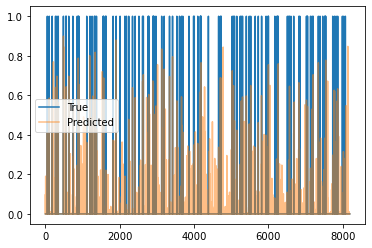

Train Epoch: 4 [1210/2220 (54%)]	Loss: 0.030505	Pres: 0.044087	F1 Score: 0.011913
Train Epoch: 4 [1220/2220 (54%)]	Loss: 0.027416	Pres: 0.048466	F1 Score: 0.014616
Train Epoch: 4 [1230/2220 (55%)]	Loss: 0.033700	Pres: 0.050278	F1 Score: 0.011749
Train Epoch: 4 [1240/2220 (55%)]	Loss: 0.029188	Pres: 0.045187	F1 Score: 0.013294
Train Epoch: 4 [1250/2220 (56%)]	Loss: 0.029930	Pres: 0.056088	F1 Score: 0.015368
Train Epoch: 4 [1260/2220 (56%)]	Loss: 0.025854	Pres: 0.053241	F1 Score: 0.009843
Train Epoch: 4 [1270/2220 (57%)]	Loss: 0.031135	Pres: 0.056071	F1 Score: 0.012515
Train Epoch: 4 [1280/2220 (57%)]	Loss: 0.033099	Pres: 0.049366	F1 Score: 0.013424
Train Epoch: 4 [1290/2220 (58%)]	Loss: 0.027091	Pres: 0.058654	F1 Score: 0.017507
Train Epoch: 4 [1300/2220 (58%)]	Loss: 0.030813	Pres: 0.057795	F1 Score: 0.011844
Train Epoch: 4 [1310/2220 (59%)]	Loss: 0.027639	Pres: 0.054411	F1 Score: 0.013148
Train Epoch: 4 [1320/2220 (59%)]	Loss: 0.029905	Pres: 0.054013	F1 Score: 0.013653
Train Epoch: 4 [

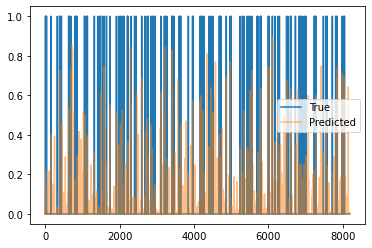

Train Epoch: 4 [1510/2220 (68%)]	Loss: 0.038853	Pres: 0.057272	F1 Score: 0.008650
Train Epoch: 4 [1520/2220 (68%)]	Loss: 0.032163	Pres: 0.057328	F1 Score: 0.011898
Train Epoch: 4 [1530/2220 (68%)]	Loss: 0.030809	Pres: 0.056622	F1 Score: 0.015164
Train Epoch: 4 [1540/2220 (69%)]	Loss: 0.032626	Pres: 0.055151	F1 Score: 0.014922
Train Epoch: 4 [1550/2220 (69%)]	Loss: 0.029089	Pres: 0.052357	F1 Score: 0.016539
Train Epoch: 4 [1560/2220 (70%)]	Loss: 0.030453	Pres: 0.043901	F1 Score: 0.010487
Train Epoch: 4 [1570/2220 (70%)]	Loss: 0.030306	Pres: 0.054215	F1 Score: 0.012594
Train Epoch: 4 [1580/2220 (71%)]	Loss: 0.030983	Pres: 0.047619	F1 Score: 0.010916
Train Epoch: 4 [1590/2220 (71%)]	Loss: 0.035247	Pres: 0.066468	F1 Score: 0.014451
Train Epoch: 4 [1600/2220 (72%)]	Loss: 0.029295	Pres: 0.056389	F1 Score: 0.017103
Train Epoch: 4 [1610/2220 (72%)]	Loss: 0.029359	Pres: 0.068625	F1 Score: 0.017637
Train Epoch: 4 [1620/2220 (72%)]	Loss: 0.030894	Pres: 0.052795	F1 Score: 0.011764
Train Epoch: 4 [

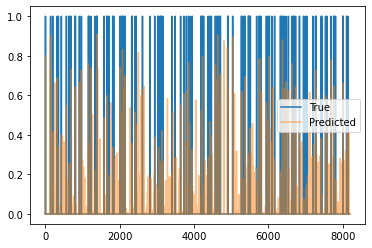

Train Epoch: 4 [1810/2220 (81%)]	Loss: 0.032937	Pres: 0.044274	F1 Score: 0.009122
Train Epoch: 4 [1820/2220 (81%)]	Loss: 0.026704	Pres: 0.056747	F1 Score: 0.013836
Train Epoch: 4 [1830/2220 (82%)]	Loss: 0.035334	Pres: 0.053267	F1 Score: 0.010710
Train Epoch: 4 [1840/2220 (82%)]	Loss: 0.030934	Pres: 0.051531	F1 Score: 0.011529
Train Epoch: 4 [1850/2220 (83%)]	Loss: 0.033794	Pres: 0.063360	F1 Score: 0.012980
Train Epoch: 4 [1860/2220 (83%)]	Loss: 0.029729	Pres: 0.045648	F1 Score: 0.009536
Train Epoch: 4 [1870/2220 (84%)]	Loss: 0.030078	Pres: 0.054855	F1 Score: 0.012047
Train Epoch: 4 [1880/2220 (84%)]	Loss: 0.027589	Pres: 0.048249	F1 Score: 0.012380
Train Epoch: 4 [1890/2220 (85%)]	Loss: 0.028011	Pres: 0.056472	F1 Score: 0.015178
Train Epoch: 4 [1900/2220 (85%)]	Loss: 0.029354	Pres: 0.046495	F1 Score: 0.009199
Train Epoch: 4 [1910/2220 (86%)]	Loss: 0.027696	Pres: 0.052056	F1 Score: 0.014693
Train Epoch: 4 [1920/2220 (86%)]	Loss: 0.025546	Pres: 0.048120	F1 Score: 0.012778
Train Epoch: 4 [

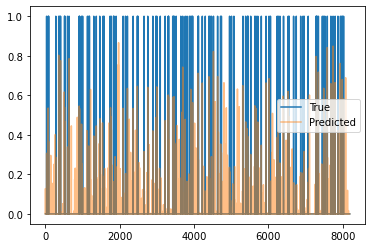

Train Epoch: 4 [2110/2220 (95%)]	Loss: 0.033697	Pres: 0.056548	F1 Score: 0.005485
Train Epoch: 4 [2120/2220 (95%)]	Loss: 0.027947	Pres: 0.052870	F1 Score: 0.011155
Train Epoch: 4 [2130/2220 (95%)]	Loss: 0.029721	Pres: 0.045502	F1 Score: 0.011179
Train Epoch: 4 [2140/2220 (96%)]	Loss: 0.032082	Pres: 0.049896	F1 Score: 0.010766
Train Epoch: 4 [2150/2220 (96%)]	Loss: 0.028605	Pres: 0.048077	F1 Score: 0.011357
Train Epoch: 4 [2160/2220 (97%)]	Loss: 0.027316	Pres: 0.050275	F1 Score: 0.014525
Train Epoch: 4 [2170/2220 (97%)]	Loss: 0.027571	Pres: 0.051358	F1 Score: 0.013141
Train Epoch: 4 [2180/2220 (98%)]	Loss: 0.028808	Pres: 0.049552	F1 Score: 0.012705
Train Epoch: 4 [2190/2220 (98%)]	Loss: 0.026020	Pres: 0.042885	F1 Score: 0.012939
Train Epoch: 4 [2200/2220 (99%)]	Loss: 0.031514	Pres: 0.057576	F1 Score: 0.015111
Train Epoch: 4 [2210/2220 (99%)]	Loss: 0.028030	Pres: 0.049866	F1 Score: 0.014153
Validation Epoch: 4 [0/582 (0%)]	Loss: 0.021720	Pres: 0.058845	F1 Score: 0.019385


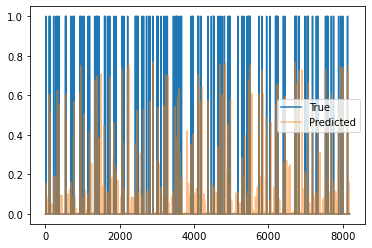

Validation Epoch: 4 [10/582 (1%)]	Loss: 0.023916	Pres: 0.048974	F1 Score: 0.017804
Validation Epoch: 4 [20/582 (3%)]	Loss: 0.022770	Pres: 0.047095	F1 Score: 0.019824
Validation Epoch: 4 [30/582 (5%)]	Loss: 0.022320	Pres: 0.056726	F1 Score: 0.023605
Validation Epoch: 4 [40/582 (6%)]	Loss: 0.023139	Pres: 0.053237	F1 Score: 0.021426
Validation Epoch: 4 [50/582 (8%)]	Loss: 0.020005	Pres: 0.058742	F1 Score: 0.022437
Validation Epoch: 4 [60/582 (10%)]	Loss: 0.023958	Pres: 0.051641	F1 Score: 0.017037
Validation Epoch: 4 [70/582 (12%)]	Loss: 0.025105	Pres: 0.055034	F1 Score: 0.018141
Validation Epoch: 4 [80/582 (13%)]	Loss: 0.022990	Pres: 0.048975	F1 Score: 0.016552
Validation Epoch: 4 [90/582 (15%)]	Loss: 0.024012	Pres: 0.054818	F1 Score: 0.014926
Validation Epoch: 4 [100/582 (17%)]	Loss: 0.022006	Pres: 0.058138	F1 Score: 0.024222
Validation Epoch: 4 [110/582 (18%)]	Loss: 0.022192	Pres: 0.059534	F1 Score: 0.024186
Validation Epoch: 4 [120/582 (20%)]	Loss: 0.025310	Pres: 0.052473	F1 Score: 0.0

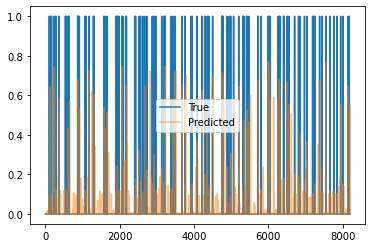

Validation Epoch: 4 [310/582 (53%)]	Loss: 0.021580	Pres: 0.049305	F1 Score: 0.020606
Validation Epoch: 4 [320/582 (54%)]	Loss: 0.023062	Pres: 0.057148	F1 Score: 0.019211
Validation Epoch: 4 [330/582 (56%)]	Loss: 0.023135	Pres: 0.044290	F1 Score: 0.021143
Validation Epoch: 4 [340/582 (58%)]	Loss: 0.022026	Pres: 0.054751	F1 Score: 0.020544
Validation Epoch: 4 [350/582 (60%)]	Loss: 0.022229	Pres: 0.062814	F1 Score: 0.022476
Validation Epoch: 4 [360/582 (61%)]	Loss: 0.021293	Pres: 0.059109	F1 Score: 0.024575
Validation Epoch: 4 [370/582 (63%)]	Loss: 0.024792	Pres: 0.048643	F1 Score: 0.018444
Validation Epoch: 4 [380/582 (65%)]	Loss: 0.022521	Pres: 0.054167	F1 Score: 0.020430
Validation Epoch: 4 [390/582 (67%)]	Loss: 0.021196	Pres: 0.056984	F1 Score: 0.021542
Validation Epoch: 4 [400/582 (68%)]	Loss: 0.022710	Pres: 0.036522	F1 Score: 0.018508
Validation Epoch: 4 [410/582 (70%)]	Loss: 0.022898	Pres: 0.056558	F1 Score: 0.024101
Validation Epoch: 4 [420/582 (72%)]	Loss: 0.022604	Pres: 0.054386

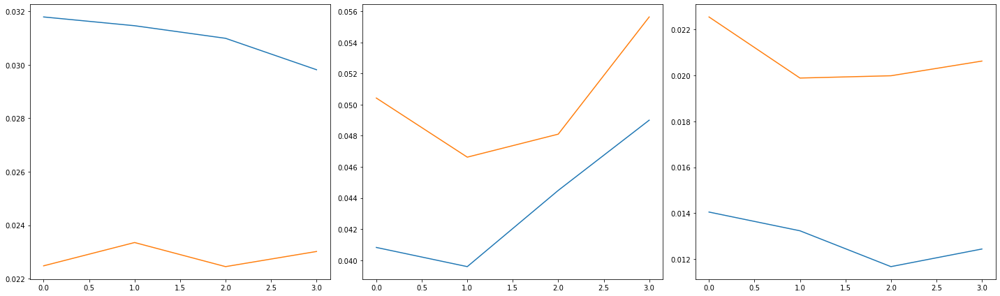

2220 582
Train Epoch: 5 [0/2220 (0%)]	Loss: 0.029126	Pres: 0.045635	F1 Score: 0.010766
102.0 -inf


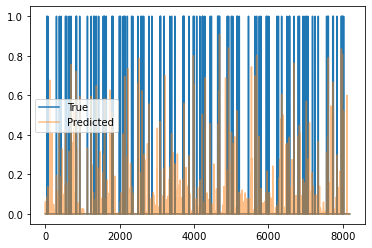

Train Epoch: 5 [10/2220 (0%)]	Loss: 0.031573	Pres: 0.057423	F1 Score: 0.016171
Train Epoch: 5 [20/2220 (0%)]	Loss: 0.029223	Pres: 0.056186	F1 Score: 0.012807
Train Epoch: 5 [30/2220 (1%)]	Loss: 0.029465	Pres: 0.051306	F1 Score: 0.011382
Train Epoch: 5 [40/2220 (1%)]	Loss: 0.029291	Pres: 0.059032	F1 Score: 0.016072
Train Epoch: 5 [50/2220 (2%)]	Loss: 0.028163	Pres: 0.057929	F1 Score: 0.016134
Train Epoch: 5 [60/2220 (2%)]	Loss: 0.029571	Pres: 0.055944	F1 Score: 0.012137
Train Epoch: 5 [70/2220 (3%)]	Loss: 0.028837	Pres: 0.053794	F1 Score: 0.014384
Train Epoch: 5 [80/2220 (3%)]	Loss: 0.029524	Pres: 0.050832	F1 Score: 0.013822
Train Epoch: 5 [90/2220 (4%)]	Loss: 0.029149	Pres: 0.048338	F1 Score: 0.012401
Train Epoch: 5 [100/2220 (4%)]	Loss: 0.028113	Pres: 0.053269	F1 Score: 0.012567
Train Epoch: 5 [110/2220 (4%)]	Loss: 0.029891	Pres: 0.039322	F1 Score: 0.008371
Train Epoch: 5 [120/2220 (5%)]	Loss: 0.030209	Pres: 0.046184	F1 Score: 0.008805
Train Epoch: 5 [130/2220 (5%)]	Loss: 0.027830	Pre

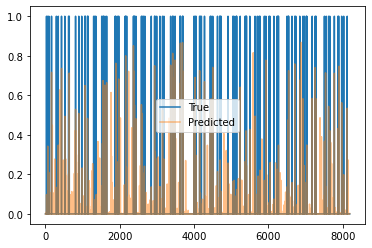

Train Epoch: 5 [310/2220 (13%)]	Loss: 0.029682	Pres: 0.051653	F1 Score: 0.014080
Train Epoch: 5 [320/2220 (14%)]	Loss: 0.028708	Pres: 0.060092	F1 Score: 0.015951
Train Epoch: 5 [330/2220 (14%)]	Loss: 0.030152	Pres: 0.046055	F1 Score: 0.012092
Train Epoch: 5 [340/2220 (15%)]	Loss: 0.033101	Pres: 0.061828	F1 Score: 0.014890
Train Epoch: 5 [350/2220 (15%)]	Loss: 0.026530	Pres: 0.069822	F1 Score: 0.019410
Train Epoch: 5 [360/2220 (16%)]	Loss: 0.027964	Pres: 0.062190	F1 Score: 0.018602
Train Epoch: 5 [370/2220 (16%)]	Loss: 0.028663	Pres: 0.053253	F1 Score: 0.014297
Train Epoch: 5 [380/2220 (17%)]	Loss: 0.028125	Pres: 0.049924	F1 Score: 0.010987
Train Epoch: 5 [390/2220 (17%)]	Loss: 0.025975	Pres: 0.056075	F1 Score: 0.015788
Train Epoch: 5 [400/2220 (18%)]	Loss: 0.026370	Pres: 0.059501	F1 Score: 0.015390
Train Epoch: 5 [410/2220 (18%)]	Loss: 0.028617	Pres: 0.063109	F1 Score: 0.016063
Train Epoch: 5 [420/2220 (18%)]	Loss: 0.025096	Pres: 0.067071	F1 Score: 0.017515
Train Epoch: 5 [430/2220 (19

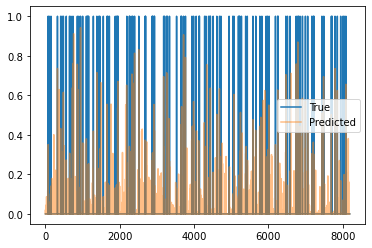

Train Epoch: 5 [610/2220 (27%)]	Loss: 0.028739	Pres: 0.056495	F1 Score: 0.011472
Train Epoch: 5 [620/2220 (27%)]	Loss: 0.027341	Pres: 0.051369	F1 Score: 0.012384
Train Epoch: 5 [630/2220 (28%)]	Loss: 0.025302	Pres: 0.050795	F1 Score: 0.011620
Train Epoch: 5 [640/2220 (28%)]	Loss: 0.031396	Pres: 0.055374	F1 Score: 0.011880
Train Epoch: 5 [650/2220 (29%)]	Loss: 0.031876	Pres: 0.064219	F1 Score: 0.010470
Train Epoch: 5 [660/2220 (29%)]	Loss: 0.027754	Pres: 0.052374	F1 Score: 0.012270
Train Epoch: 5 [670/2220 (30%)]	Loss: 0.025585	Pres: 0.048864	F1 Score: 0.014119
Train Epoch: 5 [680/2220 (30%)]	Loss: 0.026381	Pres: 0.045778	F1 Score: 0.010531
Train Epoch: 5 [690/2220 (31%)]	Loss: 0.026486	Pres: 0.050194	F1 Score: 0.013868
Train Epoch: 5 [700/2220 (31%)]	Loss: 0.025808	Pres: 0.044774	F1 Score: 0.014808
Train Epoch: 5 [710/2220 (31%)]	Loss: 0.032437	Pres: 0.053743	F1 Score: 0.012176
Train Epoch: 5 [720/2220 (32%)]	Loss: 0.029079	Pres: 0.058712	F1 Score: 0.013119
Train Epoch: 5 [730/2220 (32

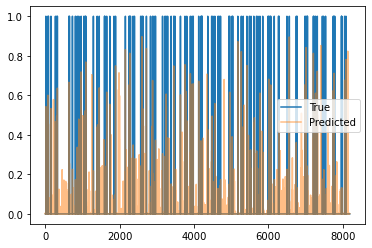

Train Epoch: 5 [910/2220 (40%)]	Loss: 0.026081	Pres: 0.050115	F1 Score: 0.011398
Train Epoch: 5 [920/2220 (41%)]	Loss: 0.030043	Pres: 0.045525	F1 Score: 0.011184
Train Epoch: 5 [930/2220 (41%)]	Loss: 0.030955	Pres: 0.054027	F1 Score: 0.013920
Train Epoch: 5 [940/2220 (42%)]	Loss: 0.027390	Pres: 0.055672	F1 Score: 0.015270
Train Epoch: 5 [950/2220 (42%)]	Loss: 0.027543	Pres: 0.042034	F1 Score: 0.007750
Train Epoch: 5 [960/2220 (43%)]	Loss: 0.029092	Pres: 0.052340	F1 Score: 0.011695
Train Epoch: 5 [970/2220 (43%)]	Loss: 0.028462	Pres: 0.041618	F1 Score: 0.011647
Train Epoch: 5 [980/2220 (44%)]	Loss: 0.040554	Pres: 0.044753	F1 Score: 0.001695
Train Epoch: 5 [990/2220 (44%)]	Loss: 0.033290	Pres: 0.049275	F1 Score: 0.009174
Train Epoch: 5 [1000/2220 (45%)]	Loss: 0.031449	Pres: 0.045461	F1 Score: 0.007877
Train Epoch: 5 [1010/2220 (45%)]	Loss: 0.026983	Pres: 0.047868	F1 Score: 0.014840
Train Epoch: 5 [1020/2220 (45%)]	Loss: 0.030858	Pres: 0.052618	F1 Score: 0.012222
Train Epoch: 5 [1030/2220

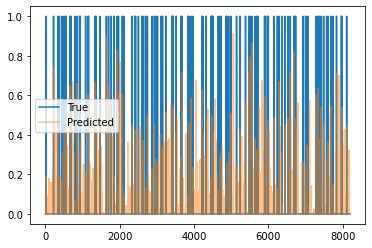

Train Epoch: 5 [1210/2220 (54%)]	Loss: 0.029952	Pres: 0.047292	F1 Score: 0.007766
Train Epoch: 5 [1220/2220 (54%)]	Loss: 0.032782	Pres: 0.046741	F1 Score: 0.009401
Train Epoch: 5 [1230/2220 (55%)]	Loss: 0.035318	Pres: 0.054819	F1 Score: 0.011810
Train Epoch: 5 [1240/2220 (55%)]	Loss: 0.025737	Pres: 0.035728	F1 Score: 0.009481
Train Epoch: 5 [1250/2220 (56%)]	Loss: 0.030917	Pres: 0.042665	F1 Score: 0.010006
Train Epoch: 5 [1260/2220 (56%)]	Loss: 0.029514	Pres: 0.046299	F1 Score: 0.009797
Train Epoch: 5 [1270/2220 (57%)]	Loss: 0.028194	Pres: 0.038648	F1 Score: 0.009971
Train Epoch: 5 [1280/2220 (57%)]	Loss: 0.034176	Pres: 0.046128	F1 Score: 0.009636
Train Epoch: 5 [1290/2220 (58%)]	Loss: 0.034783	Pres: 0.046777	F1 Score: 0.010989
Train Epoch: 5 [1300/2220 (58%)]	Loss: 0.029291	Pres: 0.057734	F1 Score: 0.015669
Train Epoch: 5 [1310/2220 (59%)]	Loss: 0.028727	Pres: 0.053478	F1 Score: 0.009768
Train Epoch: 5 [1320/2220 (59%)]	Loss: 0.031257	Pres: 0.043863	F1 Score: 0.010417
Train Epoch: 5 [

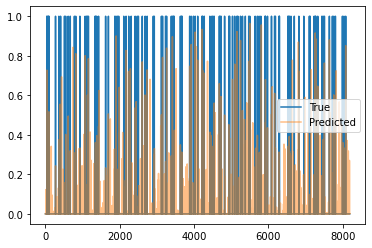

Train Epoch: 5 [1510/2220 (68%)]	Loss: 0.025691	Pres: 0.051223	F1 Score: 0.011800
Train Epoch: 5 [1520/2220 (68%)]	Loss: 0.031928	Pres: 0.058263	F1 Score: 0.010710
Train Epoch: 5 [1530/2220 (68%)]	Loss: 0.027548	Pres: 0.042277	F1 Score: 0.009398
Train Epoch: 5 [1540/2220 (69%)]	Loss: 0.028629	Pres: 0.041923	F1 Score: 0.010316
Train Epoch: 5 [1550/2220 (69%)]	Loss: 0.028127	Pres: 0.053926	F1 Score: 0.014041
Train Epoch: 5 [1560/2220 (70%)]	Loss: 0.030048	Pres: 0.051535	F1 Score: 0.010654
Train Epoch: 5 [1570/2220 (70%)]	Loss: 0.032109	Pres: 0.064563	F1 Score: 0.013476
Train Epoch: 5 [1580/2220 (71%)]	Loss: 0.026987	Pres: 0.059311	F1 Score: 0.015212
Train Epoch: 5 [1590/2220 (71%)]	Loss: 0.026927	Pres: 0.039683	F1 Score: 0.008617
Train Epoch: 5 [1600/2220 (72%)]	Loss: 0.033016	Pres: 0.047013	F1 Score: 0.007979
Train Epoch: 5 [1610/2220 (72%)]	Loss: 0.031244	Pres: 0.044125	F1 Score: 0.009630
Train Epoch: 5 [1620/2220 (72%)]	Loss: 0.030699	Pres: 0.054982	F1 Score: 0.013648
Train Epoch: 5 [

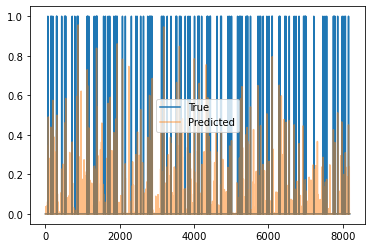

Train Epoch: 5 [1810/2220 (81%)]	Loss: 0.029006	Pres: 0.049131	F1 Score: 0.009721
Train Epoch: 5 [1820/2220 (81%)]	Loss: 0.027803	Pres: 0.055663	F1 Score: 0.011799
Train Epoch: 5 [1830/2220 (82%)]	Loss: 0.033567	Pres: 0.050031	F1 Score: 0.007676
Train Epoch: 5 [1840/2220 (82%)]	Loss: 0.032910	Pres: 0.054058	F1 Score: 0.010389
Train Epoch: 5 [1850/2220 (83%)]	Loss: 0.029947	Pres: 0.051062	F1 Score: 0.010531
Train Epoch: 5 [1860/2220 (83%)]	Loss: 0.032096	Pres: 0.051178	F1 Score: 0.008125
Train Epoch: 5 [1870/2220 (84%)]	Loss: 0.030437	Pres: 0.050084	F1 Score: 0.013550
Train Epoch: 5 [1880/2220 (84%)]	Loss: 0.028679	Pres: 0.041244	F1 Score: 0.005592
Train Epoch: 5 [1890/2220 (85%)]	Loss: 0.029939	Pres: 0.043855	F1 Score: 0.008754
Train Epoch: 5 [1900/2220 (85%)]	Loss: 0.031393	Pres: 0.052795	F1 Score: 0.010086
Train Epoch: 5 [1910/2220 (86%)]	Loss: 0.027452	Pres: 0.046009	F1 Score: 0.008813
Train Epoch: 5 [1920/2220 (86%)]	Loss: 0.029146	Pres: 0.033779	F1 Score: 0.006781
Train Epoch: 5 [

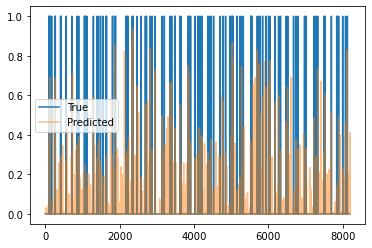

Train Epoch: 5 [2110/2220 (95%)]	Loss: 0.031696	Pres: 0.046055	F1 Score: 0.006099
Train Epoch: 5 [2120/2220 (95%)]	Loss: 0.035742	Pres: 0.036048	F1 Score: 0.004467
Train Epoch: 5 [2130/2220 (95%)]	Loss: 0.031478	Pres: 0.052288	F1 Score: 0.011256
Train Epoch: 5 [2140/2220 (96%)]	Loss: 0.034208	Pres: 0.053100	F1 Score: 0.010160
Train Epoch: 5 [2150/2220 (96%)]	Loss: 0.030796	Pres: 0.046911	F1 Score: 0.009910
Train Epoch: 5 [2160/2220 (97%)]	Loss: 0.028483	Pres: 0.050349	F1 Score: 0.010200
Train Epoch: 5 [2170/2220 (97%)]	Loss: 0.032812	Pres: 0.044439	F1 Score: 0.007211
Train Epoch: 5 [2180/2220 (98%)]	Loss: 0.030315	Pres: 0.049511	F1 Score: 0.008559
Train Epoch: 5 [2190/2220 (98%)]	Loss: 0.029677	Pres: 0.053071	F1 Score: 0.007566
Train Epoch: 5 [2200/2220 (99%)]	Loss: 0.030591	Pres: 0.045634	F1 Score: 0.007230
Train Epoch: 5 [2210/2220 (99%)]	Loss: 0.030204	Pres: 0.045862	F1 Score: 0.006579
Validation Epoch: 5 [0/582 (0%)]	Loss: 0.022854	Pres: 0.054483	F1 Score: 0.005104


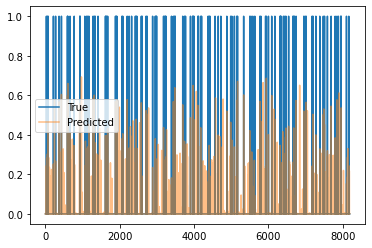

Validation Epoch: 5 [10/582 (1%)]	Loss: 0.022839	Pres: 0.064989	F1 Score: 0.007524
Validation Epoch: 5 [20/582 (3%)]	Loss: 0.021886	Pres: 0.054375	F1 Score: 0.006262
Validation Epoch: 5 [30/582 (5%)]	Loss: 0.023152	Pres: 0.060730	F1 Score: 0.002532
Validation Epoch: 5 [40/582 (6%)]	Loss: 0.022699	Pres: 0.063470	F1 Score: 0.004139
Validation Epoch: 5 [50/582 (8%)]	Loss: 0.022635	Pres: 0.075269	F1 Score: 0.004340
Validation Epoch: 5 [60/582 (10%)]	Loss: 0.022769	Pres: 0.052969	F1 Score: 0.006317
Validation Epoch: 5 [70/582 (12%)]	Loss: 0.022890	Pres: 0.065325	F1 Score: 0.007464
Validation Epoch: 5 [80/582 (13%)]	Loss: 0.023255	Pres: 0.067396	F1 Score: 0.004107
Validation Epoch: 5 [90/582 (15%)]	Loss: 0.023315	Pres: 0.050432	F1 Score: 0.005404
Validation Epoch: 5 [100/582 (17%)]	Loss: 0.022308	Pres: 0.075684	F1 Score: 0.011181
Validation Epoch: 5 [110/582 (18%)]	Loss: 0.020018	Pres: 0.073333	F1 Score: 0.007271
Validation Epoch: 5 [120/582 (20%)]	Loss: 0.022110	Pres: 0.055796	F1 Score: 0.0

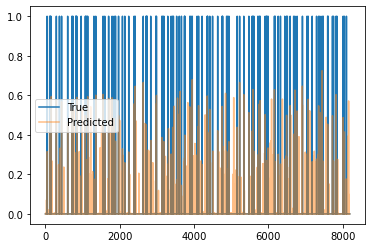

Validation Epoch: 5 [310/582 (53%)]	Loss: 0.024178	Pres: 0.075775	F1 Score: 0.006100
Validation Epoch: 5 [320/582 (54%)]	Loss: 0.023499	Pres: 0.059492	F1 Score: 0.008894
Validation Epoch: 5 [330/582 (56%)]	Loss: 0.023906	Pres: 0.041070	F1 Score: 0.001431
Validation Epoch: 5 [340/582 (58%)]	Loss: 0.022198	Pres: 0.064776	F1 Score: 0.006134
Validation Epoch: 5 [350/582 (60%)]	Loss: 0.021239	Pres: 0.064211	F1 Score: 0.008139
Validation Epoch: 5 [360/582 (61%)]	Loss: 0.020445	Pres: 0.053112	F1 Score: 0.005912
Validation Epoch: 5 [370/582 (63%)]	Loss: 0.023314	Pres: 0.059788	F1 Score: 0.004834
Validation Epoch: 5 [380/582 (65%)]	Loss: 0.021823	Pres: 0.078431	F1 Score: 0.007446
Validation Epoch: 5 [390/582 (67%)]	Loss: 0.022495	Pres: 0.057018	F1 Score: 0.005547
Validation Epoch: 5 [400/582 (68%)]	Loss: 0.021802	Pres: 0.059893	F1 Score: 0.007282
Validation Epoch: 5 [410/582 (70%)]	Loss: 0.021734	Pres: 0.059959	F1 Score: 0.006378
Validation Epoch: 5 [420/582 (72%)]	Loss: 0.021198	Pres: 0.059253

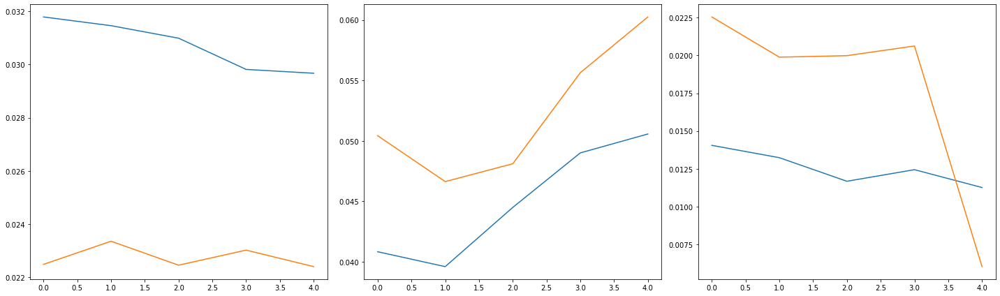

2220 582
Train Epoch: 6 [0/2220 (0%)]	Loss: 0.031243	Pres: 0.051879	F1 Score: 0.008590
107.0 -inf


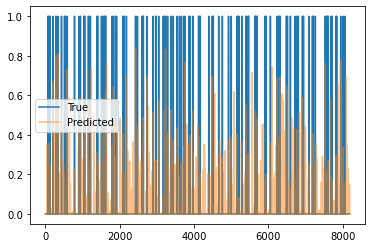

Train Epoch: 6 [10/2220 (0%)]	Loss: 0.032124	Pres: 0.048693	F1 Score: 0.008367
Train Epoch: 6 [20/2220 (0%)]	Loss: 0.033584	Pres: 0.061862	F1 Score: 0.012204
Train Epoch: 6 [30/2220 (1%)]	Loss: 0.032395	Pres: 0.047972	F1 Score: 0.007520
Train Epoch: 6 [40/2220 (1%)]	Loss: 0.030552	Pres: 0.046544	F1 Score: 0.004761
Train Epoch: 6 [50/2220 (2%)]	Loss: 0.033276	Pres: 0.051638	F1 Score: 0.010872
Train Epoch: 6 [60/2220 (2%)]	Loss: 0.033308	Pres: 0.045614	F1 Score: 0.006594
Train Epoch: 6 [70/2220 (3%)]	Loss: 0.031560	Pres: 0.048031	F1 Score: 0.010681
Train Epoch: 6 [80/2220 (3%)]	Loss: 0.032487	Pres: 0.043210	F1 Score: 0.006024
Train Epoch: 6 [90/2220 (4%)]	Loss: 0.032820	Pres: 0.047203	F1 Score: 0.008285
Train Epoch: 6 [100/2220 (4%)]	Loss: 0.030027	Pres: 0.042554	F1 Score: 0.008418
Train Epoch: 6 [110/2220 (4%)]	Loss: 0.029119	Pres: 0.041855	F1 Score: 0.006055
Train Epoch: 6 [120/2220 (5%)]	Loss: 0.034085	Pres: 0.043835	F1 Score: 0.004480
Train Epoch: 6 [130/2220 (5%)]	Loss: 0.031655	Pre

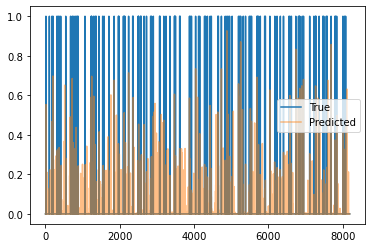

Train Epoch: 6 [310/2220 (13%)]	Loss: 0.029272	Pres: 0.044722	F1 Score: 0.008631
Train Epoch: 6 [320/2220 (14%)]	Loss: 0.032186	Pres: 0.045571	F1 Score: 0.009845
Train Epoch: 6 [330/2220 (14%)]	Loss: 0.032233	Pres: 0.044565	F1 Score: 0.004501
Train Epoch: 6 [340/2220 (15%)]	Loss: 0.033085	Pres: 0.056977	F1 Score: 0.010165
Train Epoch: 6 [350/2220 (15%)]	Loss: 0.030492	Pres: 0.045106	F1 Score: 0.008241
Train Epoch: 6 [360/2220 (16%)]	Loss: 0.027693	Pres: 0.046488	F1 Score: 0.010882
Train Epoch: 6 [370/2220 (16%)]	Loss: 0.027400	Pres: 0.052392	F1 Score: 0.010102
Train Epoch: 6 [380/2220 (17%)]	Loss: 0.028144	Pres: 0.044040	F1 Score: 0.006688
Train Epoch: 6 [390/2220 (17%)]	Loss: 0.029976	Pres: 0.049972	F1 Score: 0.009190
Train Epoch: 6 [400/2220 (18%)]	Loss: 0.031277	Pres: 0.036250	F1 Score: 0.003821
Train Epoch: 6 [410/2220 (18%)]	Loss: 0.035342	Pres: 0.046896	F1 Score: 0.007170
Train Epoch: 6 [420/2220 (18%)]	Loss: 0.028815	Pres: 0.051730	F1 Score: 0.011491
Train Epoch: 6 [430/2220 (19

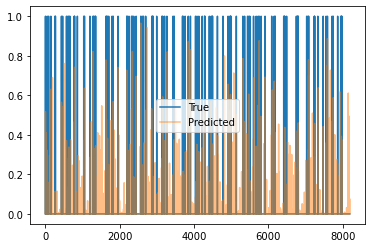

Train Epoch: 6 [610/2220 (27%)]	Loss: 0.031164	Pres: 0.046691	F1 Score: 0.008335
Train Epoch: 6 [620/2220 (27%)]	Loss: 0.028748	Pres: 0.041739	F1 Score: 0.008527
Train Epoch: 6 [630/2220 (28%)]	Loss: 0.033346	Pres: 0.046516	F1 Score: 0.008558
Train Epoch: 6 [640/2220 (28%)]	Loss: 0.031984	Pres: 0.061943	F1 Score: 0.010582
Train Epoch: 6 [650/2220 (29%)]	Loss: 0.028610	Pres: 0.053010	F1 Score: 0.010859
Train Epoch: 6 [660/2220 (29%)]	Loss: 0.030710	Pres: 0.053359	F1 Score: 0.008079
Train Epoch: 6 [670/2220 (30%)]	Loss: 0.031696	Pres: 0.042626	F1 Score: 0.006963
Train Epoch: 6 [680/2220 (30%)]	Loss: 0.031675	Pres: 0.050214	F1 Score: 0.009045
Train Epoch: 6 [690/2220 (31%)]	Loss: 0.032065	Pres: 0.045833	F1 Score: 0.006454
Train Epoch: 6 [700/2220 (31%)]	Loss: 0.032161	Pres: 0.047848	F1 Score: 0.007144
Train Epoch: 6 [710/2220 (31%)]	Loss: 0.036432	Pres: 0.044015	F1 Score: 0.007099
Train Epoch: 6 [720/2220 (32%)]	Loss: 0.027107	Pres: 0.040170	F1 Score: 0.006187
Train Epoch: 6 [730/2220 (32

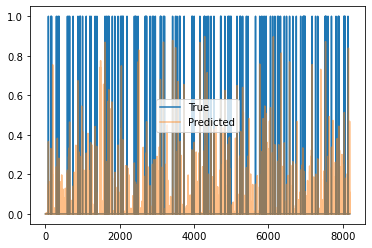

Train Epoch: 6 [910/2220 (40%)]	Loss: 0.029780	Pres: 0.046019	F1 Score: 0.010628
Train Epoch: 6 [920/2220 (41%)]	Loss: 0.033861	Pres: 0.041060	F1 Score: 0.003515
Train Epoch: 6 [930/2220 (41%)]	Loss: 0.029508	Pres: 0.063437	F1 Score: 0.004978
Train Epoch: 6 [940/2220 (42%)]	Loss: 0.031922	Pres: 0.044121	F1 Score: 0.004797
Train Epoch: 6 [950/2220 (42%)]	Loss: 0.032565	Pres: 0.047106	F1 Score: 0.008713
Train Epoch: 6 [960/2220 (43%)]	Loss: 0.036756	Pres: 0.052126	F1 Score: 0.009183
Train Epoch: 6 [970/2220 (43%)]	Loss: 0.036954	Pres: 0.045810	F1 Score: 0.007246
Train Epoch: 6 [980/2220 (44%)]	Loss: 0.031761	Pres: 0.041277	F1 Score: 0.005366
Train Epoch: 6 [990/2220 (44%)]	Loss: 0.038099	Pres: 0.042222	F1 Score: 0.004726
Train Epoch: 6 [1000/2220 (45%)]	Loss: 0.031356	Pres: 0.037212	F1 Score: 0.007168
Train Epoch: 6 [1010/2220 (45%)]	Loss: 0.038877	Pres: 0.046196	F1 Score: 0.004601
Train Epoch: 6 [1020/2220 (45%)]	Loss: 0.035591	Pres: 0.036059	F1 Score: 0.006974
Train Epoch: 6 [1030/2220

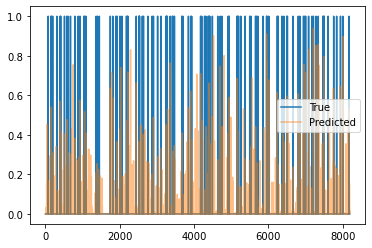

Train Epoch: 6 [1210/2220 (54%)]	Loss: 0.030085	Pres: 0.063384	F1 Score: 0.007684
Train Epoch: 6 [1220/2220 (54%)]	Loss: 0.032025	Pres: 0.045455	F1 Score: 0.006007
Train Epoch: 6 [1230/2220 (55%)]	Loss: 0.029969	Pres: 0.058213	F1 Score: 0.008249
Train Epoch: 6 [1240/2220 (55%)]	Loss: 0.034490	Pres: 0.051287	F1 Score: 0.008215
Train Epoch: 6 [1250/2220 (56%)]	Loss: 0.031443	Pres: 0.040357	F1 Score: 0.005246
Train Epoch: 6 [1260/2220 (56%)]	Loss: 0.032833	Pres: 0.052453	F1 Score: 0.009634
Train Epoch: 6 [1270/2220 (57%)]	Loss: 0.031583	Pres: 0.051961	F1 Score: 0.009299
Train Epoch: 6 [1280/2220 (57%)]	Loss: 0.036483	Pres: 0.047287	F1 Score: 0.004584
Train Epoch: 6 [1290/2220 (58%)]	Loss: 0.038582	Pres: 0.052493	F1 Score: 0.008495
Train Epoch: 6 [1300/2220 (58%)]	Loss: 0.038080	Pres: 0.045446	F1 Score: 0.006361
Train Epoch: 6 [1310/2220 (59%)]	Loss: 0.034128	Pres: 0.053252	F1 Score: 0.007158
Train Epoch: 6 [1320/2220 (59%)]	Loss: 0.040514	Pres: 0.063306	F1 Score: 0.002829
Train Epoch: 6 [

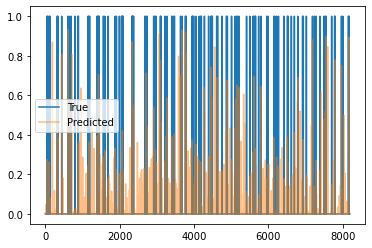

Train Epoch: 6 [1510/2220 (68%)]	Loss: 0.033644	Pres: 0.055820	F1 Score: 0.009960
Train Epoch: 6 [1520/2220 (68%)]	Loss: 0.035561	Pres: 0.065271	F1 Score: 0.010793
Train Epoch: 6 [1530/2220 (68%)]	Loss: 0.034707	Pres: 0.050396	F1 Score: 0.007980
Train Epoch: 6 [1540/2220 (69%)]	Loss: 0.033170	Pres: 0.058897	F1 Score: 0.010780
Train Epoch: 6 [1550/2220 (69%)]	Loss: 0.033385	Pres: 0.059091	F1 Score: 0.009977
Train Epoch: 6 [1560/2220 (70%)]	Loss: 0.035607	Pres: 0.058995	F1 Score: 0.007182
Train Epoch: 6 [1570/2220 (70%)]	Loss: 0.033452	Pres: 0.058929	F1 Score: 0.008903
Train Epoch: 6 [1580/2220 (71%)]	Loss: 0.034250	Pres: 0.062310	F1 Score: 0.011586
Train Epoch: 6 [1590/2220 (71%)]	Loss: 0.039000	Pres: 0.054855	F1 Score: 0.007024
Train Epoch: 6 [1600/2220 (72%)]	Loss: 0.033687	Pres: 0.049939	F1 Score: 0.008858
Train Epoch: 6 [1610/2220 (72%)]	Loss: 0.036800	Pres: 0.065079	F1 Score: 0.010838
Train Epoch: 6 [1620/2220 (72%)]	Loss: 0.032586	Pres: 0.054540	F1 Score: 0.007907
Train Epoch: 6 [

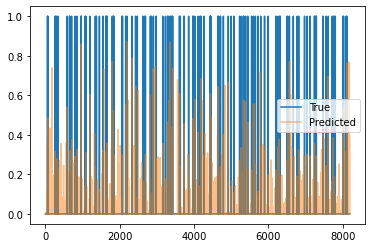

Train Epoch: 6 [1810/2220 (81%)]	Loss: 0.035118	Pres: 0.046819	F1 Score: 0.006211
Train Epoch: 6 [1820/2220 (81%)]	Loss: 0.032621	Pres: 0.060876	F1 Score: 0.009871
Train Epoch: 6 [1830/2220 (82%)]	Loss: 0.035232	Pres: 0.051190	F1 Score: 0.006601
Train Epoch: 6 [1840/2220 (82%)]	Loss: 0.034573	Pres: 0.049134	F1 Score: 0.007063
Train Epoch: 6 [1850/2220 (83%)]	Loss: 0.036882	Pres: 0.055935	F1 Score: 0.008967
Train Epoch: 6 [1860/2220 (83%)]	Loss: 0.034683	Pres: 0.065761	F1 Score: 0.009621
Train Epoch: 6 [1870/2220 (84%)]	Loss: 0.036397	Pres: 0.038393	F1 Score: 0.002700
Train Epoch: 6 [1880/2220 (84%)]	Loss: 0.031939	Pres: 0.056410	F1 Score: 0.012343
Train Epoch: 6 [1890/2220 (85%)]	Loss: 0.036205	Pres: 0.058777	F1 Score: 0.006940
Train Epoch: 6 [1900/2220 (85%)]	Loss: 0.038567	Pres: 0.070439	F1 Score: 0.009535
Train Epoch: 6 [1910/2220 (86%)]	Loss: 0.038870	Pres: 0.065185	F1 Score: 0.005234
Train Epoch: 6 [1920/2220 (86%)]	Loss: 0.038453	Pres: 0.046481	F1 Score: 0.005109
Train Epoch: 6 [

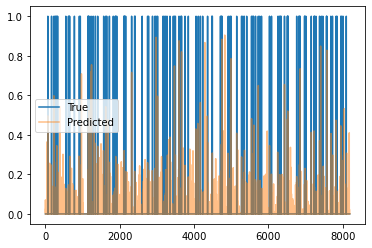

Train Epoch: 6 [2110/2220 (95%)]	Loss: 0.034938	Pres: 0.056920	F1 Score: 0.008130
Train Epoch: 6 [2120/2220 (95%)]	Loss: 0.039201	Pres: 0.070455	F1 Score: 0.008222
Train Epoch: 6 [2130/2220 (95%)]	Loss: 0.042668	Pres: 0.049524	F1 Score: 0.003311
Train Epoch: 6 [2140/2220 (96%)]	Loss: 0.036086	Pres: 0.056682	F1 Score: 0.004546
Train Epoch: 6 [2150/2220 (96%)]	Loss: 0.038086	Pres: 0.064403	F1 Score: 0.007782
Train Epoch: 6 [2160/2220 (97%)]	Loss: 0.035285	Pres: 0.050706	F1 Score: 0.007490
Train Epoch: 6 [2170/2220 (97%)]	Loss: 0.034880	Pres: 0.064394	F1 Score: 0.006863
Train Epoch: 6 [2180/2220 (98%)]	Loss: 0.039836	Pres: 0.072436	F1 Score: 0.004583
Train Epoch: 6 [2190/2220 (98%)]	Loss: 0.039250	Pres: 0.074242	F1 Score: 0.007849
Train Epoch: 6 [2200/2220 (99%)]	Loss: 0.042991	Pres: 0.055861	F1 Score: 0.008120
Train Epoch: 6 [2210/2220 (99%)]	Loss: 0.036763	Pres: 0.070175	F1 Score: 0.007124
Validation Epoch: 6 [0/582 (0%)]	Loss: 0.029998	Pres: 0.074920	F1 Score: 0.005774


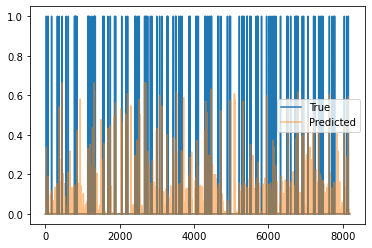

Validation Epoch: 6 [10/582 (1%)]	Loss: 0.027364	Pres: 0.078409	F1 Score: 0.009902
Validation Epoch: 6 [20/582 (3%)]	Loss: 0.032603	Pres: 0.081250	F1 Score: 0.003382
Validation Epoch: 6 [30/582 (5%)]	Loss: 0.028657	Pres: 0.050690	F1 Score: 0.005288
Validation Epoch: 6 [40/582 (6%)]	Loss: 0.033517	Pres: 0.063920	F1 Score: 0.006236
Validation Epoch: 6 [50/582 (8%)]	Loss: 0.029076	Pres: 0.085598	F1 Score: 0.004934
Validation Epoch: 6 [60/582 (10%)]	Loss: 0.032777	Pres: 0.067829	F1 Score: 0.006527
Validation Epoch: 6 [70/582 (12%)]	Loss: 0.032394	Pres: 0.062872	F1 Score: 0.005338
Validation Epoch: 6 [80/582 (13%)]	Loss: 0.029381	Pres: 0.059896	F1 Score: 0.006465
Validation Epoch: 6 [90/582 (15%)]	Loss: 0.026477	Pres: 0.051671	F1 Score: 0.005411
Validation Epoch: 6 [100/582 (17%)]	Loss: 0.031264	Pres: 0.058800	F1 Score: 0.006783
Validation Epoch: 6 [110/582 (18%)]	Loss: 0.030178	Pres: 0.058824	F1 Score: 0.004348
Validation Epoch: 6 [120/582 (20%)]	Loss: 0.029485	Pres: 0.072802	F1 Score: 0.0

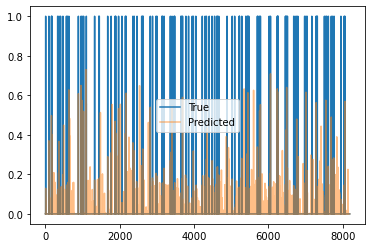

Validation Epoch: 6 [310/582 (53%)]	Loss: 0.029335	Pres: 0.050758	F1 Score: 0.006487
Validation Epoch: 6 [320/582 (54%)]	Loss: 0.027214	Pres: 0.043384	F1 Score: 0.003640
Validation Epoch: 6 [330/582 (56%)]	Loss: 0.032419	Pres: 0.073148	F1 Score: 0.004440
Validation Epoch: 6 [340/582 (58%)]	Loss: 0.029493	Pres: 0.055882	F1 Score: 0.003436
Validation Epoch: 6 [350/582 (60%)]	Loss: 0.031125	Pres: 0.061899	F1 Score: 0.008407
Validation Epoch: 6 [360/582 (61%)]	Loss: 0.030576	Pres: 0.047321	F1 Score: 0.004563
Validation Epoch: 6 [370/582 (63%)]	Loss: 0.029033	Pres: 0.056548	F1 Score: 0.004520
Validation Epoch: 6 [380/582 (65%)]	Loss: 0.031763	Pres: 0.066707	F1 Score: 0.005650
Validation Epoch: 6 [390/582 (67%)]	Loss: 0.027652	Pres: 0.064039	F1 Score: 0.005711
Validation Epoch: 6 [400/582 (68%)]	Loss: 0.031965	Pres: 0.050272	F1 Score: 0.001341
Validation Epoch: 6 [410/582 (70%)]	Loss: 0.028587	Pres: 0.058954	F1 Score: 0.004548
Validation Epoch: 6 [420/582 (72%)]	Loss: 0.031935	Pres: 0.054471

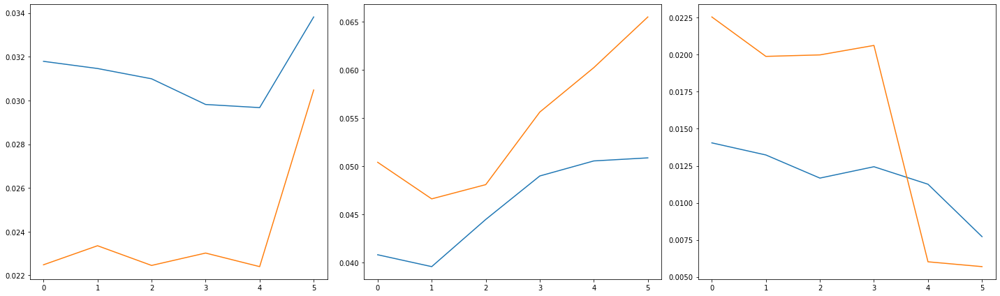

2220 582
Train Epoch: 7 [0/2220 (0%)]	Loss: 0.035190	Pres: 0.049126	F1 Score: 0.005896
110.0 -63872.0


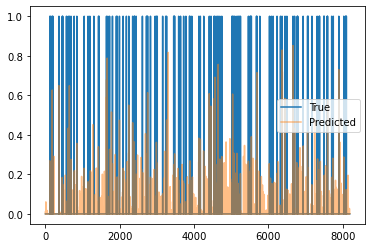

Train Epoch: 7 [10/2220 (0%)]	Loss: 0.040396	Pres: 0.055233	F1 Score: 0.002884
Train Epoch: 7 [20/2220 (0%)]	Loss: 0.038285	Pres: 0.053710	F1 Score: 0.007815
Train Epoch: 7 [30/2220 (1%)]	Loss: 0.043302	Pres: 0.062006	F1 Score: 0.008980
Train Epoch: 7 [40/2220 (1%)]	Loss: 0.043983	Pres: 0.057752	F1 Score: 0.006094
Train Epoch: 7 [50/2220 (2%)]	Loss: 0.037478	Pres: 0.037619	F1 Score: 0.002077
Train Epoch: 7 [60/2220 (2%)]	Loss: 0.038101	Pres: 0.045195	F1 Score: 0.003515
Train Epoch: 7 [70/2220 (3%)]	Loss: 0.039943	Pres: 0.058769	F1 Score: 0.002789
Train Epoch: 7 [80/2220 (3%)]	Loss: 0.039936	Pres: 0.049863	F1 Score: 0.005063
Train Epoch: 7 [90/2220 (4%)]	Loss: 0.037463	Pres: 0.069444	F1 Score: 0.006913
Train Epoch: 7 [100/2220 (4%)]	Loss: 0.040584	Pres: 0.072576	F1 Score: 0.003836
Train Epoch: 7 [110/2220 (4%)]	Loss: 0.039048	Pres: 0.060000	F1 Score: 0.006536
Train Epoch: 7 [120/2220 (5%)]	Loss: 0.043048	Pres: 0.075792	F1 Score: 0.010703
Train Epoch: 7 [130/2220 (5%)]	Loss: 0.040429	Pre

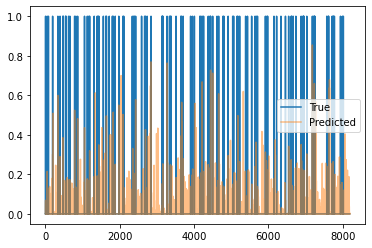

Train Epoch: 7 [310/2220 (13%)]	Loss: 0.037804	Pres: 0.066176	F1 Score: 0.011685
Train Epoch: 7 [320/2220 (14%)]	Loss: 0.043094	Pres: 0.052778	F1 Score: 0.007961
Train Epoch: 7 [330/2220 (14%)]	Loss: 0.037693	Pres: 0.057143	F1 Score: 0.007574
Train Epoch: 7 [340/2220 (15%)]	Loss: 0.038107	Pres: 0.068102	F1 Score: 0.007480
Train Epoch: 7 [350/2220 (15%)]	Loss: 0.037212	Pres: 0.073681	F1 Score: 0.010130
Train Epoch: 7 [360/2220 (16%)]	Loss: 0.041263	Pres: 0.055093	F1 Score: 0.005773
Train Epoch: 7 [370/2220 (16%)]	Loss: 0.045153	Pres: 0.047448	F1 Score: 0.003804
Train Epoch: 7 [380/2220 (17%)]	Loss: 0.042491	Pres: 0.058333	F1 Score: 0.004931
Train Epoch: 7 [390/2220 (17%)]	Loss: 0.042133	Pres: 0.059596	F1 Score: 0.004496
Train Epoch: 7 [400/2220 (18%)]	Loss: 0.038647	Pres: 0.067423	F1 Score: 0.010773
Train Epoch: 7 [410/2220 (18%)]	Loss: 0.040289	Pres: 0.062464	F1 Score: 0.007270
Train Epoch: 7 [420/2220 (18%)]	Loss: 0.041820	Pres: 0.070519	F1 Score: 0.010880
Train Epoch: 7 [430/2220 (19

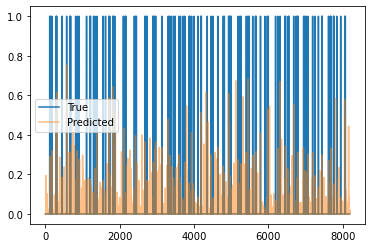

Train Epoch: 7 [610/2220 (27%)]	Loss: 0.040903	Pres: 0.051248	F1 Score: 0.004026
Train Epoch: 7 [620/2220 (27%)]	Loss: 0.041223	Pres: 0.048010	F1 Score: 0.003965
Train Epoch: 7 [630/2220 (28%)]	Loss: 0.042177	Pres: 0.075810	F1 Score: 0.004863
Train Epoch: 7 [640/2220 (28%)]	Loss: 0.040996	Pres: 0.072511	F1 Score: 0.005024
Train Epoch: 7 [650/2220 (29%)]	Loss: 0.037636	Pres: 0.069007	F1 Score: 0.006996
Train Epoch: 7 [660/2220 (29%)]	Loss: 0.039813	Pres: 0.073969	F1 Score: 0.007623
Train Epoch: 7 [670/2220 (30%)]	Loss: 0.042276	Pres: 0.052529	F1 Score: 0.006288
Train Epoch: 7 [680/2220 (30%)]	Loss: 0.040169	Pres: 0.084877	F1 Score: 0.002280
Train Epoch: 7 [690/2220 (31%)]	Loss: 0.041975	Pres: 0.050235	F1 Score: 0.006201
Train Epoch: 7 [700/2220 (31%)]	Loss: 0.040512	Pres: 0.066138	F1 Score: 0.008783
Train Epoch: 7 [710/2220 (31%)]	Loss: 0.060525	Pres: 0.058824	F1 Score: 0.001070
Train Epoch: 7 [720/2220 (32%)]	Loss: 0.040598	Pres: 0.076543	F1 Score: 0.006920
Train Epoch: 7 [730/2220 (32

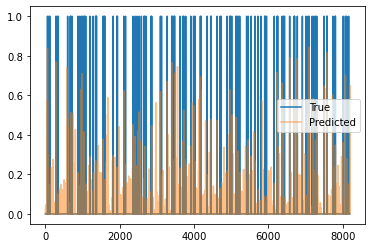

Train Epoch: 7 [910/2220 (40%)]	Loss: 0.042583	Pres: 0.042735	F1 Score: 0.003209
Train Epoch: 7 [920/2220 (41%)]	Loss: 0.037937	Pres: 0.060900	F1 Score: 0.007831
Train Epoch: 7 [930/2220 (41%)]	Loss: 0.046479	Pres: 0.070960	F1 Score: 0.007898
Train Epoch: 7 [940/2220 (42%)]	Loss: 0.041060	Pres: 0.050926	F1 Score: 0.004915
Train Epoch: 7 [950/2220 (42%)]	Loss: 0.044577	Pres: 0.067043	F1 Score: 0.005505
Train Epoch: 7 [960/2220 (43%)]	Loss: 0.038056	Pres: 0.063746	F1 Score: 0.012307
Train Epoch: 7 [970/2220 (43%)]	Loss: 0.042655	Pres: 0.063492	F1 Score: 0.010516
Train Epoch: 7 [980/2220 (44%)]	Loss: 0.044008	Pres: 0.058082	F1 Score: 0.003292
Train Epoch: 7 [990/2220 (44%)]	Loss: 0.041923	Pres: 0.061260	F1 Score: 0.007766
Train Epoch: 7 [1000/2220 (45%)]	Loss: 0.044504	Pres: 0.076865	F1 Score: 0.014493
Train Epoch: 7 [1010/2220 (45%)]	Loss: 0.038203	Pres: 0.066667	F1 Score: 0.009947
Train Epoch: 7 [1020/2220 (45%)]	Loss: 0.044888	Pres: 0.060858	F1 Score: 0.008474
Train Epoch: 7 [1030/2220

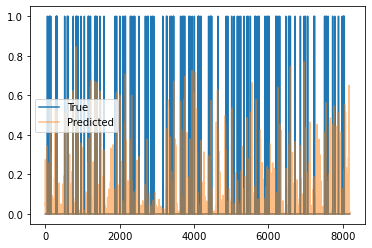

Train Epoch: 7 [1210/2220 (54%)]	Loss: 0.043994	Pres: 0.075817	F1 Score: 0.010696
Train Epoch: 7 [1220/2220 (54%)]	Loss: 0.041828	Pres: 0.056022	F1 Score: 0.004153
Train Epoch: 7 [1230/2220 (55%)]	Loss: 0.048599	Pres: 0.095109	F1 Score: 0.003630
Train Epoch: 7 [1240/2220 (55%)]	Loss: 0.039518	Pres: 0.058662	F1 Score: 0.005549
Train Epoch: 7 [1250/2220 (56%)]	Loss: 0.039923	Pres: 0.082270	F1 Score: 0.015117
Train Epoch: 7 [1260/2220 (56%)]	Loss: 0.037631	Pres: 0.070256	F1 Score: 0.013992
Train Epoch: 7 [1270/2220 (57%)]	Loss: 0.046382	Pres: 0.062216	F1 Score: 0.006512
Train Epoch: 7 [1280/2220 (57%)]	Loss: 0.042829	Pres: 0.070890	F1 Score: 0.009669
Train Epoch: 7 [1290/2220 (58%)]	Loss: 0.041698	Pres: 0.058894	F1 Score: 0.003427
Train Epoch: 7 [1300/2220 (58%)]	Loss: 0.041280	Pres: 0.056548	F1 Score: 0.003610
Train Epoch: 7 [1310/2220 (59%)]	Loss: 0.042050	Pres: 0.072917	F1 Score: 0.010495
Train Epoch: 7 [1320/2220 (59%)]	Loss: 0.040770	Pres: 0.081389	F1 Score: 0.012448
Train Epoch: 7 [

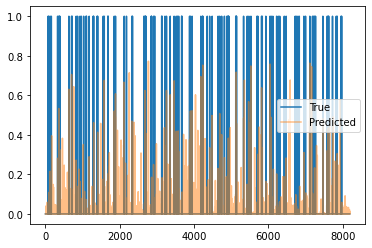

Train Epoch: 7 [1510/2220 (68%)]	Loss: 0.046711	Pres: 0.075900	F1 Score: 0.012957
Train Epoch: 7 [1520/2220 (68%)]	Loss: 0.040421	Pres: 0.063406	F1 Score: 0.010246
Train Epoch: 7 [1530/2220 (68%)]	Loss: 0.037368	Pres: 0.055382	F1 Score: 0.006112
Train Epoch: 7 [1540/2220 (69%)]	Loss: 0.040053	Pres: 0.065308	F1 Score: 0.007888
Train Epoch: 7 [1550/2220 (69%)]	Loss: 0.044060	Pres: 0.082619	F1 Score: 0.015270
Train Epoch: 7 [1560/2220 (70%)]	Loss: 0.044069	Pres: 0.058565	F1 Score: 0.007331
Train Epoch: 7 [1570/2220 (70%)]	Loss: 0.043417	Pres: 0.062024	F1 Score: 0.008708
Train Epoch: 7 [1580/2220 (71%)]	Loss: 0.043270	Pres: 0.074691	F1 Score: 0.012908
Train Epoch: 7 [1590/2220 (71%)]	Loss: 0.045313	Pres: 0.090833	F1 Score: 0.010893
Train Epoch: 7 [1600/2220 (72%)]	Loss: 0.054335	Pres: 0.073529	F1 Score: 0.004295
Train Epoch: 7 [1610/2220 (72%)]	Loss: 0.046525	Pres: 0.058480	F1 Score: 0.005479
Train Epoch: 7 [1620/2220 (72%)]	Loss: 0.043337	Pres: 0.079248	F1 Score: 0.008227
Train Epoch: 7 [

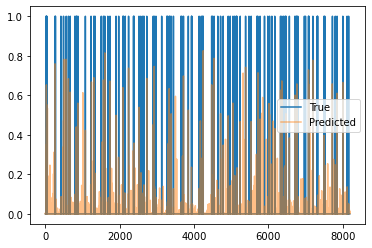

Train Epoch: 7 [1810/2220 (81%)]	Loss: 0.038878	Pres: 0.061380	F1 Score: 0.013171
Train Epoch: 7 [1820/2220 (81%)]	Loss: 0.050315	Pres: 0.041358	F1 Score: 0.002929
Train Epoch: 7 [1830/2220 (82%)]	Loss: 0.041373	Pres: 0.051300	F1 Score: 0.009204
Train Epoch: 7 [1840/2220 (82%)]	Loss: 0.044885	Pres: 0.065766	F1 Score: 0.013527
Train Epoch: 7 [1850/2220 (83%)]	Loss: 0.046588	Pres: 0.061111	F1 Score: 0.012179
Train Epoch: 7 [1860/2220 (83%)]	Loss: 0.049126	Pres: 0.073810	F1 Score: 0.014188
Train Epoch: 7 [1870/2220 (84%)]	Loss: 0.036678	Pres: 0.083951	F1 Score: 0.022153
Train Epoch: 7 [1880/2220 (84%)]	Loss: 0.047300	Pres: 0.082583	F1 Score: 0.006043
Train Epoch: 7 [1890/2220 (85%)]	Loss: 0.042839	Pres: 0.093537	F1 Score: 0.018664
Train Epoch: 7 [1900/2220 (85%)]	Loss: 0.048460	Pres: 0.076786	F1 Score: 0.020841
Train Epoch: 7 [1910/2220 (86%)]	Loss: 0.046853	Pres: 0.065833	F1 Score: 0.011870
Train Epoch: 7 [1920/2220 (86%)]	Loss: 0.041786	Pres: 0.072642	F1 Score: 0.013233
Train Epoch: 7 [

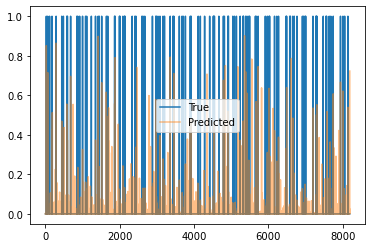

Train Epoch: 7 [2110/2220 (95%)]	Loss: 0.056809	Pres: 0.115385	F1 Score: 0.004462
Train Epoch: 7 [2120/2220 (95%)]	Loss: 0.048034	Pres: 0.065359	F1 Score: 0.012466
Train Epoch: 7 [2130/2220 (95%)]	Loss: 0.046505	Pres: 0.066667	F1 Score: 0.010927
Train Epoch: 7 [2140/2220 (96%)]	Loss: 0.046796	Pres: 0.052682	F1 Score: 0.007289
Train Epoch: 7 [2150/2220 (96%)]	Loss: 0.046627	Pres: 0.077980	F1 Score: 0.015736
Train Epoch: 7 [2160/2220 (97%)]	Loss: 0.046278	Pres: 0.059502	F1 Score: 0.009319
Train Epoch: 7 [2170/2220 (97%)]	Loss: 0.046236	Pres: 0.063627	F1 Score: 0.014018
Train Epoch: 7 [2180/2220 (98%)]	Loss: 0.048553	Pres: 0.072396	F1 Score: 0.007401
Train Epoch: 7 [2190/2220 (98%)]	Loss: 0.048595	Pres: 0.052916	F1 Score: 0.006777
Train Epoch: 7 [2200/2220 (99%)]	Loss: 0.045949	Pres: 0.060048	F1 Score: 0.010307
Train Epoch: 7 [2210/2220 (99%)]	Loss: 0.044847	Pres: 0.058712	F1 Score: 0.012602
Validation Epoch: 7 [0/582 (0%)]	Loss: 0.049693	Pres: 0.049451	F1 Score: 0.001789


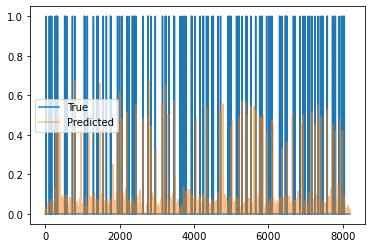

Validation Epoch: 7 [10/582 (1%)]	Loss: 0.041430	Pres: 0.095176	F1 Score: 0.000264
Validation Epoch: 7 [20/582 (3%)]	Loss: 0.046876	Pres: 0.100796	F1 Score: 0.001678
Validation Epoch: 7 [30/582 (5%)]	Loss: 0.046230	Pres: 0.097041	F1 Score: 0.001647
Validation Epoch: 7 [40/582 (6%)]	Loss: 0.043709	Pres: 0.105556	F1 Score: 0.001803
Validation Epoch: 7 [50/582 (8%)]	Loss: 0.042558	Pres: 0.096154	F1 Score: 0.001682
Validation Epoch: 7 [60/582 (10%)]	Loss: 0.045621	Pres: 0.102959	F1 Score: 0.003115
Validation Epoch: 7 [70/582 (12%)]	Loss: 0.042410	Pres: 0.106061	F1 Score: 0.000429
Validation Epoch: 7 [80/582 (13%)]	Loss: 0.044917	Pres: 0.113264	F1 Score: 0.000335
Validation Epoch: 7 [90/582 (15%)]	Loss: 0.042308	Pres: 0.091667	F1 Score: 0.004159
Validation Epoch: 7 [100/582 (17%)]	Loss: 0.044373	Pres: 0.109290	F1 Score: 0.001877
Validation Epoch: 7 [110/582 (18%)]	Loss: 0.041786	Pres: 0.087302	F1 Score: 0.003758
Validation Epoch: 7 [120/582 (20%)]	Loss: 0.045461	Pres: 0.119078	F1 Score: 0.0

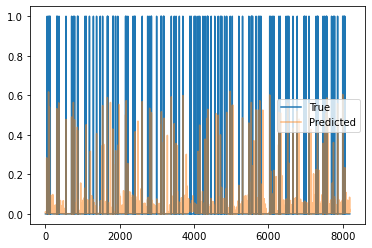

Validation Epoch: 7 [310/582 (53%)]	Loss: 0.044994	Pres: 0.100391	F1 Score: 0.000340
Validation Epoch: 7 [320/582 (54%)]	Loss: 0.042154	Pres: 0.106280	F1 Score: 0.001851
Validation Epoch: 7 [330/582 (56%)]	Loss: 0.044011	Pres: 0.109649	F1 Score: 0.001941
Validation Epoch: 7 [340/582 (58%)]	Loss: 0.043147	Pres: 0.097902	F1 Score: 0.001721
Validation Epoch: 7 [350/582 (60%)]	Loss: 0.045215	Pres: 0.022145	F1 Score: 0.000359
Validation Epoch: 7 [360/582 (61%)]	Loss: 0.039102	Pres: 0.098753	F1 Score: 0.004517
Validation Epoch: 7 [370/582 (63%)]	Loss: 0.046479	Pres: 0.096817	F1 Score: 0.000284
Validation Epoch: 7 [380/582 (65%)]	Loss: 0.040457	Pres: 0.100105	F1 Score: 0.001814
Validation Epoch: 7 [390/582 (67%)]	Loss: 0.043813	Pres: 0.106481	F1 Score: 0.001879
Validation Epoch: 7 [400/582 (68%)]	Loss: 0.046744	Pres: 0.105932	F1 Score: 0.000328
Validation Epoch: 7 [410/582 (70%)]	Loss: 0.038929	Pres: 0.080534	F1 Score: 0.003496
Validation Epoch: 7 [420/582 (72%)]	Loss: 0.044647	Pres: 0.108073

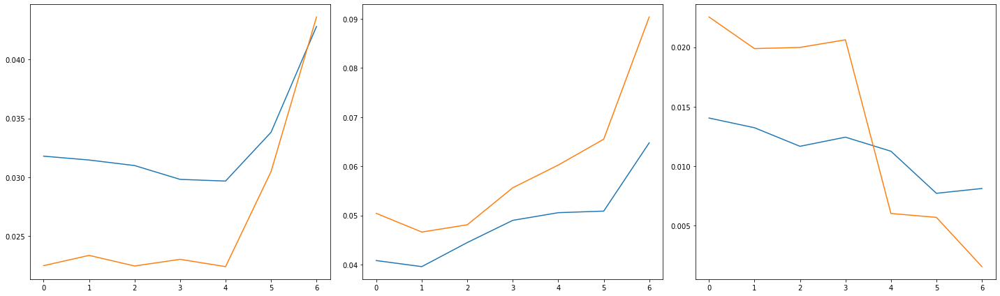

2220 582
Train Epoch: 8 [0/2220 (0%)]	Loss: 0.047397	Pres: 0.074561	F1 Score: 0.008652
109.0 -48800.0


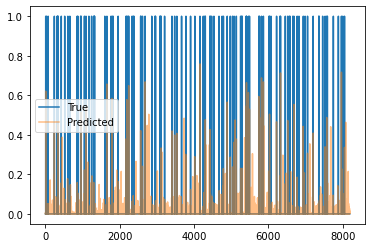

Train Epoch: 8 [10/2220 (0%)]	Loss: 0.046235	Pres: 0.069795	F1 Score: 0.020530
Train Epoch: 8 [20/2220 (0%)]	Loss: 0.046763	Pres: 0.064021	F1 Score: 0.015920
Train Epoch: 8 [30/2220 (1%)]	Loss: 0.040449	Pres: 0.065789	F1 Score: 0.013861
Train Epoch: 8 [40/2220 (1%)]	Loss: 0.039454	Pres: 0.071721	F1 Score: 0.017036
Train Epoch: 8 [50/2220 (2%)]	Loss: 0.046961	Pres: 0.065657	F1 Score: 0.006838
Train Epoch: 8 [60/2220 (2%)]	Loss: 0.045050	Pres: 0.051627	F1 Score: 0.009740
Train Epoch: 8 [70/2220 (3%)]	Loss: 0.045402	Pres: 0.069995	F1 Score: 0.014356
Train Epoch: 8 [80/2220 (3%)]	Loss: 0.041957	Pres: 0.064528	F1 Score: 0.010869
Train Epoch: 8 [90/2220 (4%)]	Loss: 0.042714	Pres: 0.058675	F1 Score: 0.012666
Train Epoch: 8 [100/2220 (4%)]	Loss: 0.048490	Pres: 0.051703	F1 Score: 0.009525
Train Epoch: 8 [110/2220 (4%)]	Loss: 0.040646	Pres: 0.065915	F1 Score: 0.013720
Train Epoch: 8 [120/2220 (5%)]	Loss: 0.042373	Pres: 0.060764	F1 Score: 0.009239
Train Epoch: 8 [130/2220 (5%)]	Loss: 0.041408	Pre

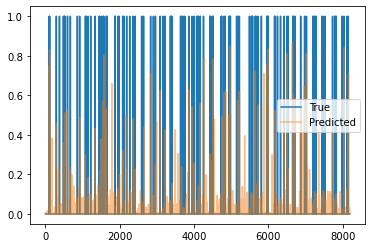

Train Epoch: 8 [310/2220 (13%)]	Loss: 0.046801	Pres: 0.064436	F1 Score: 0.014455
Train Epoch: 8 [320/2220 (14%)]	Loss: 0.052318	Pres: 0.072982	F1 Score: 0.011929
Train Epoch: 8 [330/2220 (14%)]	Loss: 0.048904	Pres: 0.067901	F1 Score: 0.011416
Train Epoch: 8 [340/2220 (15%)]	Loss: 0.047440	Pres: 0.050753	F1 Score: 0.005901
Train Epoch: 8 [350/2220 (15%)]	Loss: 0.046934	Pres: 0.061062	F1 Score: 0.013869
Train Epoch: 8 [360/2220 (16%)]	Loss: 0.041468	Pres: 0.065608	F1 Score: 0.014356
Train Epoch: 8 [370/2220 (16%)]	Loss: 0.055236	Pres: 0.066993	F1 Score: 0.010649
Train Epoch: 8 [380/2220 (17%)]	Loss: 0.046144	Pres: 0.062082	F1 Score: 0.013826
Train Epoch: 8 [390/2220 (17%)]	Loss: 0.041877	Pres: 0.062924	F1 Score: 0.016162
Train Epoch: 8 [400/2220 (18%)]	Loss: 0.047177	Pres: 0.066335	F1 Score: 0.014894
Train Epoch: 8 [410/2220 (18%)]	Loss: 0.050664	Pres: 0.069451	F1 Score: 0.007773
Train Epoch: 8 [420/2220 (18%)]	Loss: 0.049897	Pres: 0.054051	F1 Score: 0.007542
Train Epoch: 8 [430/2220 (19

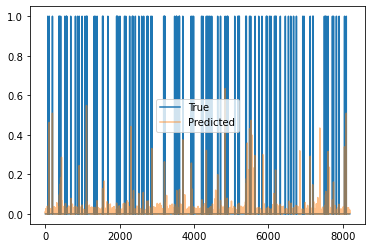

Train Epoch: 8 [610/2220 (27%)]	Loss: 0.058837	Pres: 0.109244	F1 Score: 0.007423
Train Epoch: 8 [620/2220 (27%)]	Loss: 0.055690	Pres: 0.077922	F1 Score: 0.009882
Train Epoch: 8 [630/2220 (28%)]	Loss: 0.052511	Pres: 0.048235	F1 Score: 0.003107
Train Epoch: 8 [640/2220 (28%)]	Loss: 0.051890	Pres: 0.061398	F1 Score: 0.007259
Train Epoch: 8 [650/2220 (29%)]	Loss: 0.054660	Pres: 0.034774	F1 Score: 0.005000
Train Epoch: 8 [660/2220 (29%)]	Loss: 0.053666	Pres: 0.043333	F1 Score: 0.006485
Train Epoch: 8 [670/2220 (30%)]	Loss: 0.057273	Pres: 0.047315	F1 Score: 0.003698
Train Epoch: 8 [680/2220 (30%)]	Loss: 0.053438	Pres: 0.081003	F1 Score: 0.007476
Train Epoch: 8 [690/2220 (31%)]	Loss: 0.054251	Pres: 0.068116	F1 Score: 0.008663
Train Epoch: 8 [700/2220 (31%)]	Loss: 0.051549	Pres: 0.071429	F1 Score: 0.010196
Train Epoch: 8 [710/2220 (31%)]	Loss: 0.056738	Pres: 0.093985	F1 Score: 0.007075
Train Epoch: 8 [720/2220 (32%)]	Loss: 0.051370	Pres: 0.064484	F1 Score: 0.009483
Train Epoch: 8 [730/2220 (32

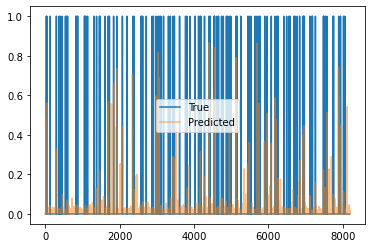

Train Epoch: 8 [910/2220 (40%)]	Loss: 0.048790	Pres: 0.074959	F1 Score: 0.013429
Train Epoch: 8 [920/2220 (41%)]	Loss: 0.056703	Pres: 0.070670	F1 Score: 0.007324
Train Epoch: 8 [930/2220 (41%)]	Loss: 0.050892	Pres: 0.068382	F1 Score: 0.009180
Train Epoch: 8 [940/2220 (42%)]	Loss: 0.052552	Pres: 0.062771	F1 Score: 0.013304
Train Epoch: 8 [950/2220 (42%)]	Loss: 0.050645	Pres: 0.075845	F1 Score: 0.011289
Train Epoch: 8 [960/2220 (43%)]	Loss: 0.043872	Pres: 0.062613	F1 Score: 0.015698
Train Epoch: 8 [970/2220 (43%)]	Loss: 0.049795	Pres: 0.052955	F1 Score: 0.010680
Train Epoch: 8 [980/2220 (44%)]	Loss: 0.049362	Pres: 0.038984	F1 Score: 0.010402
Train Epoch: 8 [990/2220 (44%)]	Loss: 0.053411	Pres: 0.059903	F1 Score: 0.007963
Train Epoch: 8 [1000/2220 (45%)]	Loss: 0.058916	Pres: 0.050000	F1 Score: 0.003489
Train Epoch: 8 [1010/2220 (45%)]	Loss: 0.052515	Pres: 0.040800	F1 Score: 0.006128
Train Epoch: 8 [1020/2220 (45%)]	Loss: 0.057021	Pres: 0.046100	F1 Score: 0.004676
Train Epoch: 8 [1030/2220

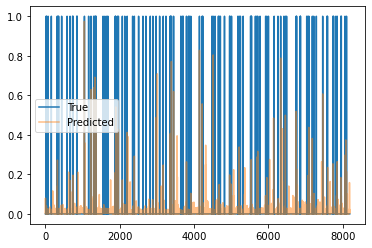

Train Epoch: 8 [1210/2220 (54%)]	Loss: 0.048944	Pres: 0.043746	F1 Score: 0.009661
Train Epoch: 8 [1220/2220 (54%)]	Loss: 0.061937	Pres: 0.055556	F1 Score: 0.002058
Train Epoch: 8 [1230/2220 (55%)]	Loss: 0.055006	Pres: 0.052561	F1 Score: 0.010746
Train Epoch: 8 [1240/2220 (55%)]	Loss: 0.061648	Pres: 0.016194	F1 Score: 0.000052
Train Epoch: 8 [1250/2220 (56%)]	Loss: 0.053659	Pres: 0.063736	F1 Score: 0.006733
Train Epoch: 8 [1260/2220 (56%)]	Loss: 0.051884	Pres: 0.062500	F1 Score: 0.009114
Train Epoch: 8 [1270/2220 (57%)]	Loss: 0.053963	Pres: 0.041667	F1 Score: 0.006862
Train Epoch: 8 [1280/2220 (57%)]	Loss: 0.050261	Pres: 0.057045	F1 Score: 0.014959
Train Epoch: 8 [1290/2220 (58%)]	Loss: 0.055428	Pres: 0.043210	F1 Score: 0.006717
Train Epoch: 8 [1300/2220 (58%)]	Loss: 0.044827	Pres: 0.053842	F1 Score: 0.012148
Train Epoch: 8 [1310/2220 (59%)]	Loss: 0.053840	Pres: 0.063275	F1 Score: 0.010682
Train Epoch: 8 [1320/2220 (59%)]	Loss: 0.054369	Pres: 0.038961	F1 Score: 0.004844
Train Epoch: 8 [

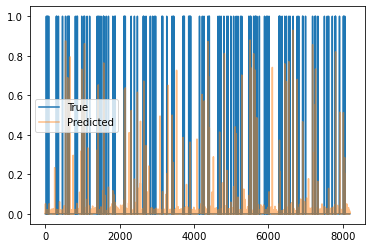

Train Epoch: 8 [1510/2220 (68%)]	Loss: 0.048317	Pres: 0.040994	F1 Score: 0.009141
Train Epoch: 8 [1520/2220 (68%)]	Loss: 0.050257	Pres: 0.074074	F1 Score: 0.009785
Train Epoch: 8 [1530/2220 (68%)]	Loss: 0.051363	Pres: 0.070850	F1 Score: 0.008967
Train Epoch: 8 [1540/2220 (69%)]	Loss: 0.054442	Pres: 0.043350	F1 Score: 0.004626
Train Epoch: 8 [1550/2220 (69%)]	Loss: 0.044586	Pres: 0.061704	F1 Score: 0.012184
Train Epoch: 8 [1560/2220 (70%)]	Loss: 0.050191	Pres: 0.064737	F1 Score: 0.012118
Train Epoch: 8 [1570/2220 (70%)]	Loss: 0.048109	Pres: 0.076018	F1 Score: 0.016464
Train Epoch: 8 [1580/2220 (71%)]	Loss: 0.049137	Pres: 0.055515	F1 Score: 0.008698
Train Epoch: 8 [1590/2220 (71%)]	Loss: 0.063584	Pres: 0.075000	F1 Score: 0.000015
Train Epoch: 8 [1600/2220 (72%)]	Loss: 0.049828	Pres: 0.072368	F1 Score: 0.014432
Train Epoch: 8 [1610/2220 (72%)]	Loss: 0.054405	Pres: 0.054118	F1 Score: 0.006048
Train Epoch: 8 [1620/2220 (72%)]	Loss: 0.048849	Pres: 0.061002	F1 Score: 0.013879
Train Epoch: 8 [

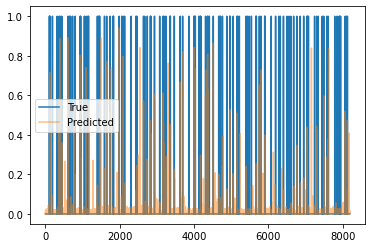

Train Epoch: 8 [1810/2220 (81%)]	Loss: 0.055074	Pres: 0.080392	F1 Score: 0.007621
Train Epoch: 8 [1820/2220 (81%)]	Loss: 0.043464	Pres: 0.068314	F1 Score: 0.010532
Train Epoch: 8 [1830/2220 (82%)]	Loss: 0.049616	Pres: 0.070085	F1 Score: 0.007511
Train Epoch: 8 [1840/2220 (82%)]	Loss: 0.053821	Pres: 0.057225	F1 Score: 0.005187
Train Epoch: 8 [1850/2220 (83%)]	Loss: 0.053671	Pres: 0.059211	F1 Score: 0.005427
Train Epoch: 8 [1860/2220 (83%)]	Loss: 0.050784	Pres: 0.094494	F1 Score: 0.010055
Train Epoch: 8 [1870/2220 (84%)]	Loss: 0.050479	Pres: 0.075556	F1 Score: 0.010099
Train Epoch: 8 [1880/2220 (84%)]	Loss: 0.053701	Pres: 0.072421	F1 Score: 0.011198
Train Epoch: 8 [1890/2220 (85%)]	Loss: 0.051547	Pres: 0.046222	F1 Score: 0.003657
Train Epoch: 8 [1900/2220 (85%)]	Loss: 0.051073	Pres: 0.058824	F1 Score: 0.014650
Train Epoch: 8 [1910/2220 (86%)]	Loss: 0.048053	Pres: 0.067647	F1 Score: 0.013573
Train Epoch: 8 [1920/2220 (86%)]	Loss: 0.054721	Pres: 0.071875	F1 Score: 0.011518
Train Epoch: 8 [

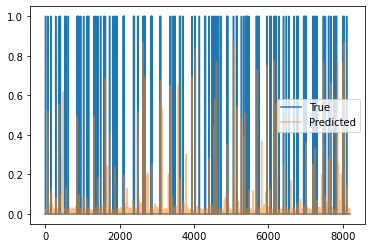

Train Epoch: 8 [2110/2220 (95%)]	Loss: 0.055798	Pres: 0.089506	F1 Score: 0.005067
Train Epoch: 8 [2120/2220 (95%)]	Loss: 0.048794	Pres: 0.041766	F1 Score: 0.007718
Train Epoch: 8 [2130/2220 (95%)]	Loss: 0.046943	Pres: 0.053947	F1 Score: 0.008688
Train Epoch: 8 [2140/2220 (96%)]	Loss: 0.049088	Pres: 0.051852	F1 Score: 0.006903
Train Epoch: 8 [2150/2220 (96%)]	Loss: 0.043406	Pres: 0.047426	F1 Score: 0.008332
Train Epoch: 8 [2160/2220 (97%)]	Loss: 0.057246	Pres: 0.052139	F1 Score: 0.004325
Train Epoch: 8 [2170/2220 (97%)]	Loss: 0.057975	Pres: 0.060784	F1 Score: 0.007718
Train Epoch: 8 [2180/2220 (98%)]	Loss: 0.050007	Pres: 0.074479	F1 Score: 0.011922
Train Epoch: 8 [2190/2220 (98%)]	Loss: 0.050820	Pres: 0.070945	F1 Score: 0.011319
Train Epoch: 8 [2200/2220 (99%)]	Loss: 0.053964	Pres: 0.068750	F1 Score: 0.007936
Train Epoch: 8 [2210/2220 (99%)]	Loss: 0.051888	Pres: 0.047415	F1 Score: 0.007383
Validation Epoch: 8 [0/582 (0%)]	Loss: 0.051514	Pres: 0.086364	F1 Score: 0.025348


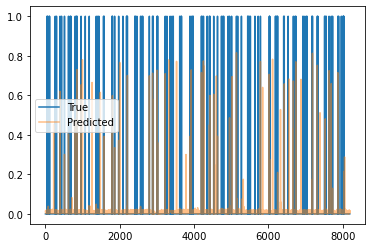

Validation Epoch: 8 [10/582 (1%)]	Loss: 0.047932	Pres: 0.085667	F1 Score: 0.031011
Validation Epoch: 8 [20/582 (3%)]	Loss: 0.051630	Pres: 0.079961	F1 Score: 0.024765
Validation Epoch: 8 [30/582 (5%)]	Loss: 0.041891	Pres: 0.093388	F1 Score: 0.042384
Validation Epoch: 8 [40/582 (6%)]	Loss: 0.046134	Pres: 0.106183	F1 Score: 0.030322
Validation Epoch: 8 [50/582 (8%)]	Loss: 0.046418	Pres: 0.107782	F1 Score: 0.037071
Validation Epoch: 8 [60/582 (10%)]	Loss: 0.044620	Pres: 0.093240	F1 Score: 0.032645
Validation Epoch: 8 [70/582 (12%)]	Loss: 0.047043	Pres: 0.103263	F1 Score: 0.034824
Validation Epoch: 8 [80/582 (13%)]	Loss: 0.046864	Pres: 0.085935	F1 Score: 0.034052
Validation Epoch: 8 [90/582 (15%)]	Loss: 0.046637	Pres: 0.107984	F1 Score: 0.028888
Validation Epoch: 8 [100/582 (17%)]	Loss: 0.044897	Pres: 0.107350	F1 Score: 0.037261
Validation Epoch: 8 [110/582 (18%)]	Loss: 0.046333	Pres: 0.098459	F1 Score: 0.032562
Validation Epoch: 8 [120/582 (20%)]	Loss: 0.044745	Pres: 0.102041	F1 Score: 0.0

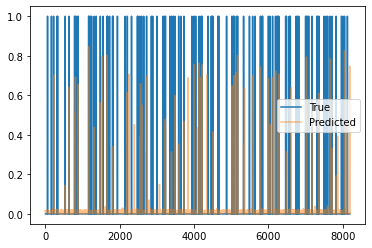

Validation Epoch: 8 [310/582 (53%)]	Loss: 0.052122	Pres: 0.096104	F1 Score: 0.021795
Validation Epoch: 8 [320/582 (54%)]	Loss: 0.051820	Pres: 0.082407	F1 Score: 0.021573
Validation Epoch: 8 [330/582 (56%)]	Loss: 0.053607	Pres: 0.104731	F1 Score: 0.025887
Validation Epoch: 8 [340/582 (58%)]	Loss: 0.049809	Pres: 0.091600	F1 Score: 0.024065
Validation Epoch: 8 [350/582 (60%)]	Loss: 0.049808	Pres: 0.082828	F1 Score: 0.028268
Validation Epoch: 8 [360/582 (61%)]	Loss: 0.055162	Pres: 0.104416	F1 Score: 0.024199
Validation Epoch: 8 [370/582 (63%)]	Loss: 0.048589	Pres: 0.085079	F1 Score: 0.030236
Validation Epoch: 8 [380/582 (65%)]	Loss: 0.042759	Pres: 0.085339	F1 Score: 0.037880
Validation Epoch: 8 [390/582 (67%)]	Loss: 0.040616	Pres: 0.103030	F1 Score: 0.039594
Validation Epoch: 8 [400/582 (68%)]	Loss: 0.046975	Pres: 0.089238	F1 Score: 0.029742
Validation Epoch: 8 [410/582 (70%)]	Loss: 0.043179	Pres: 0.089693	F1 Score: 0.036235
Validation Epoch: 8 [420/582 (72%)]	Loss: 0.048722	Pres: 0.089579

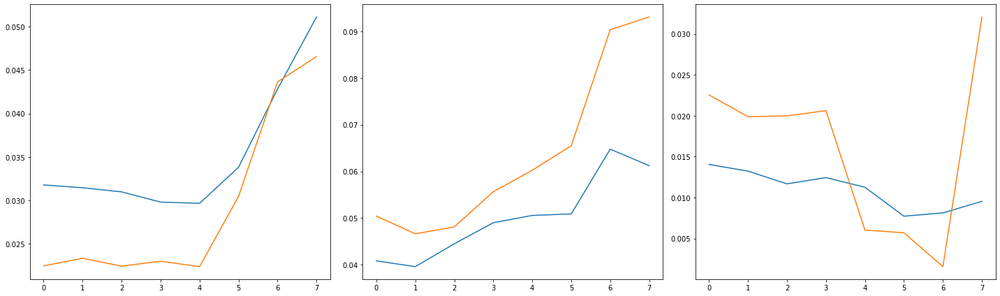

2220 582
Train Epoch: 9 [0/2220 (0%)]	Loss: 0.051742	Pres: 0.050265	F1 Score: 0.010731
115.0 -43168.0


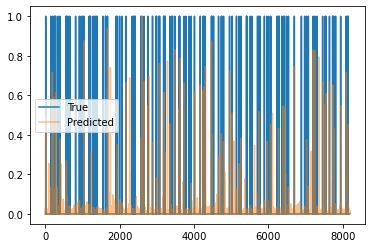

Train Epoch: 9 [10/2220 (0%)]	Loss: 0.053187	Pres: 0.066667	F1 Score: 0.007785
Train Epoch: 9 [20/2220 (0%)]	Loss: 0.056128	Pres: 0.075397	F1 Score: 0.006880
Train Epoch: 9 [30/2220 (1%)]	Loss: 0.048845	Pres: 0.077748	F1 Score: 0.013185
Train Epoch: 9 [40/2220 (1%)]	Loss: 0.061866	Pres: 0.068124	F1 Score: 0.006659
Train Epoch: 9 [50/2220 (2%)]	Loss: 0.052834	Pres: 0.062897	F1 Score: 0.009888
Train Epoch: 9 [60/2220 (2%)]	Loss: 0.051725	Pres: 0.066667	F1 Score: 0.009445
Train Epoch: 9 [70/2220 (3%)]	Loss: 0.055815	Pres: 0.062494	F1 Score: 0.009583
Train Epoch: 9 [80/2220 (3%)]	Loss: 0.054084	Pres: 0.082222	F1 Score: 0.012253
Train Epoch: 9 [90/2220 (4%)]	Loss: 0.050475	Pres: 0.068182	F1 Score: 0.010521
Train Epoch: 9 [100/2220 (4%)]	Loss: 0.051036	Pres: 0.059559	F1 Score: 0.007234
Train Epoch: 9 [110/2220 (4%)]	Loss: 0.054573	Pres: 0.075216	F1 Score: 0.008373
Train Epoch: 9 [120/2220 (5%)]	Loss: 0.054059	Pres: 0.060606	F1 Score: 0.005720
Train Epoch: 9 [130/2220 (5%)]	Loss: 0.054432	Pre

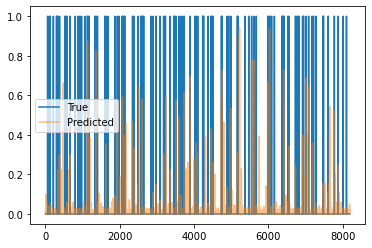

Train Epoch: 9 [310/2220 (13%)]	Loss: 0.057386	Pres: 0.052521	F1 Score: 0.007570
Train Epoch: 9 [320/2220 (14%)]	Loss: 0.052118	Pres: 0.050769	F1 Score: 0.006765
Train Epoch: 9 [330/2220 (14%)]	Loss: 0.052846	Pres: 0.067393	F1 Score: 0.009738
Train Epoch: 9 [340/2220 (15%)]	Loss: 0.052496	Pres: 0.066570	F1 Score: 0.011354
Train Epoch: 9 [350/2220 (15%)]	Loss: 0.056374	Pres: 0.064426	F1 Score: 0.005913
Train Epoch: 9 [360/2220 (16%)]	Loss: 0.048155	Pres: 0.061200	F1 Score: 0.009680
Train Epoch: 9 [370/2220 (16%)]	Loss: 0.056653	Pres: 0.062500	F1 Score: 0.005466
Train Epoch: 9 [380/2220 (17%)]	Loss: 0.050349	Pres: 0.048907	F1 Score: 0.009029
Train Epoch: 9 [390/2220 (17%)]	Loss: 0.052715	Pres: 0.080474	F1 Score: 0.012171
Train Epoch: 9 [400/2220 (18%)]	Loss: 0.048840	Pres: 0.073569	F1 Score: 0.008812
Train Epoch: 9 [410/2220 (18%)]	Loss: 0.053878	Pres: 0.060317	F1 Score: 0.005137
Train Epoch: 9 [420/2220 (18%)]	Loss: 0.057718	Pres: 0.055556	F1 Score: 0.002257
Train Epoch: 9 [430/2220 (19

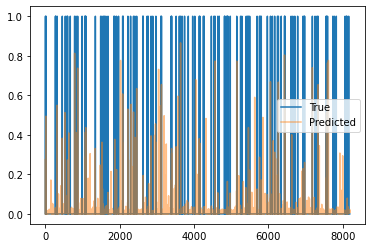

Train Epoch: 9 [610/2220 (27%)]	Loss: 0.049238	Pres: 0.049158	F1 Score: 0.010476
Train Epoch: 9 [620/2220 (27%)]	Loss: 0.055078	Pres: 0.035542	F1 Score: 0.003886
Train Epoch: 9 [630/2220 (28%)]	Loss: 0.053987	Pres: 0.042250	F1 Score: 0.004328
Train Epoch: 9 [640/2220 (28%)]	Loss: 0.051405	Pres: 0.062698	F1 Score: 0.008728
Train Epoch: 9 [650/2220 (29%)]	Loss: 0.046485	Pres: 0.058410	F1 Score: 0.011291
Train Epoch: 9 [660/2220 (29%)]	Loss: 0.053986	Pres: 0.050170	F1 Score: 0.004246
Train Epoch: 9 [670/2220 (30%)]	Loss: 0.048830	Pres: 0.063329	F1 Score: 0.010625
Train Epoch: 9 [680/2220 (30%)]	Loss: 0.047815	Pres: 0.040879	F1 Score: 0.005514
Train Epoch: 9 [690/2220 (31%)]	Loss: 0.049046	Pres: 0.052857	F1 Score: 0.009105
Train Epoch: 9 [700/2220 (31%)]	Loss: 0.059758	Pres: 0.072829	F1 Score: 0.002314
Train Epoch: 9 [710/2220 (31%)]	Loss: 0.048268	Pres: 0.063333	F1 Score: 0.008769
Train Epoch: 9 [720/2220 (32%)]	Loss: 0.047921	Pres: 0.049858	F1 Score: 0.008334
Train Epoch: 9 [730/2220 (32

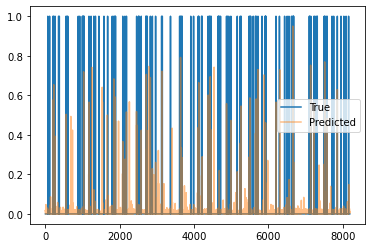

Train Epoch: 9 [910/2220 (40%)]	Loss: 0.053417	Pres: 0.063492	F1 Score: 0.009053
Train Epoch: 9 [920/2220 (41%)]	Loss: 0.052360	Pres: 0.051905	F1 Score: 0.006509
Train Epoch: 9 [930/2220 (41%)]	Loss: 0.044982	Pres: 0.063275	F1 Score: 0.015763
Train Epoch: 9 [940/2220 (42%)]	Loss: 0.050966	Pres: 0.053377	F1 Score: 0.012880
Train Epoch: 9 [950/2220 (42%)]	Loss: 0.049030	Pres: 0.054869	F1 Score: 0.009949
Train Epoch: 9 [960/2220 (43%)]	Loss: 0.048984	Pres: 0.061404	F1 Score: 0.010931
Train Epoch: 9 [970/2220 (43%)]	Loss: 0.050835	Pres: 0.055729	F1 Score: 0.010062
Train Epoch: 9 [980/2220 (44%)]	Loss: 0.051498	Pres: 0.051276	F1 Score: 0.009228
Train Epoch: 9 [990/2220 (44%)]	Loss: 0.051689	Pres: 0.047980	F1 Score: 0.009897
Train Epoch: 9 [1000/2220 (45%)]	Loss: 0.046830	Pres: 0.053261	F1 Score: 0.011630
Train Epoch: 9 [1010/2220 (45%)]	Loss: 0.052273	Pres: 0.075525	F1 Score: 0.013094
Train Epoch: 9 [1020/2220 (45%)]	Loss: 0.050119	Pres: 0.049090	F1 Score: 0.008187
Train Epoch: 9 [1030/2220

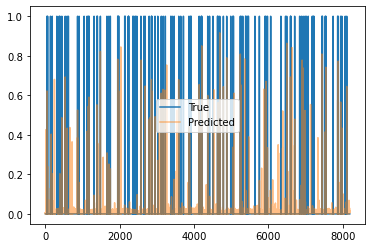

Train Epoch: 9 [1210/2220 (54%)]	Loss: 0.052205	Pres: 0.072321	F1 Score: 0.013210
Train Epoch: 9 [1220/2220 (54%)]	Loss: 0.047226	Pres: 0.066449	F1 Score: 0.011175
Train Epoch: 9 [1230/2220 (55%)]	Loss: 0.049305	Pres: 0.061877	F1 Score: 0.006987
Train Epoch: 9 [1240/2220 (55%)]	Loss: 0.050325	Pres: 0.060657	F1 Score: 0.011153
Train Epoch: 9 [1250/2220 (56%)]	Loss: 0.046913	Pres: 0.059288	F1 Score: 0.010433
Train Epoch: 9 [1260/2220 (56%)]	Loss: 0.050728	Pres: 0.061138	F1 Score: 0.010658
Train Epoch: 9 [1270/2220 (57%)]	Loss: 0.049765	Pres: 0.060238	F1 Score: 0.009584
Train Epoch: 9 [1280/2220 (57%)]	Loss: 0.044928	Pres: 0.072222	F1 Score: 0.009120
Train Epoch: 9 [1290/2220 (58%)]	Loss: 0.048157	Pres: 0.057481	F1 Score: 0.012753
Train Epoch: 9 [1300/2220 (58%)]	Loss: 0.049710	Pres: 0.051108	F1 Score: 0.010735
Train Epoch: 9 [1310/2220 (59%)]	Loss: 0.047387	Pres: 0.058897	F1 Score: 0.008220
Train Epoch: 9 [1320/2220 (59%)]	Loss: 0.047357	Pres: 0.056140	F1 Score: 0.012123
Train Epoch: 9 [

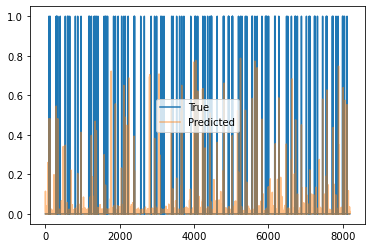

Train Epoch: 9 [1510/2220 (68%)]	Loss: 0.043619	Pres: 0.058151	F1 Score: 0.012985
Train Epoch: 9 [1520/2220 (68%)]	Loss: 0.046222	Pres: 0.066732	F1 Score: 0.015843
Train Epoch: 9 [1530/2220 (68%)]	Loss: 0.050575	Pres: 0.064044	F1 Score: 0.011580
Train Epoch: 9 [1540/2220 (69%)]	Loss: 0.048363	Pres: 0.062748	F1 Score: 0.011724
Train Epoch: 9 [1550/2220 (69%)]	Loss: 0.050841	Pres: 0.064919	F1 Score: 0.011142
Train Epoch: 9 [1560/2220 (70%)]	Loss: 0.050616	Pres: 0.059664	F1 Score: 0.012095
Train Epoch: 9 [1570/2220 (70%)]	Loss: 0.041162	Pres: 0.065302	F1 Score: 0.013839
Train Epoch: 9 [1580/2220 (71%)]	Loss: 0.052161	Pres: 0.056696	F1 Score: 0.008642
Train Epoch: 9 [1590/2220 (71%)]	Loss: 0.050415	Pres: 0.079832	F1 Score: 0.016226
Train Epoch: 9 [1600/2220 (72%)]	Loss: 0.049846	Pres: 0.076145	F1 Score: 0.014906
Train Epoch: 9 [1610/2220 (72%)]	Loss: 0.053965	Pres: 0.042908	F1 Score: 0.006420
Train Epoch: 9 [1620/2220 (72%)]	Loss: 0.042282	Pres: 0.061002	F1 Score: 0.016610
Train Epoch: 9 [

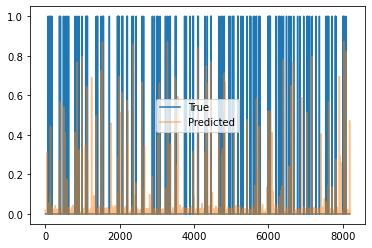

Train Epoch: 9 [1810/2220 (81%)]	Loss: 0.055549	Pres: 0.101293	F1 Score: 0.006914
Train Epoch: 9 [1820/2220 (81%)]	Loss: 0.053890	Pres: 0.049720	F1 Score: 0.008468
Train Epoch: 9 [1830/2220 (82%)]	Loss: 0.047062	Pres: 0.059602	F1 Score: 0.011997
Train Epoch: 9 [1840/2220 (82%)]	Loss: 0.052976	Pres: 0.081742	F1 Score: 0.015745
Train Epoch: 9 [1850/2220 (83%)]	Loss: 0.050219	Pres: 0.067267	F1 Score: 0.014342
Train Epoch: 9 [1860/2220 (83%)]	Loss: 0.050150	Pres: 0.065125	F1 Score: 0.011081
Train Epoch: 9 [1870/2220 (84%)]	Loss: 0.049243	Pres: 0.052205	F1 Score: 0.010240
Train Epoch: 9 [1880/2220 (84%)]	Loss: 0.046055	Pres: 0.060655	F1 Score: 0.014149
Train Epoch: 9 [1890/2220 (85%)]	Loss: 0.054191	Pres: 0.062931	F1 Score: 0.011303
Train Epoch: 9 [1900/2220 (85%)]	Loss: 0.049168	Pres: 0.072525	F1 Score: 0.012808
Train Epoch: 9 [1910/2220 (86%)]	Loss: 0.052710	Pres: 0.070774	F1 Score: 0.013237
Train Epoch: 9 [1920/2220 (86%)]	Loss: 0.049912	Pres: 0.060662	F1 Score: 0.006322
Train Epoch: 9 [

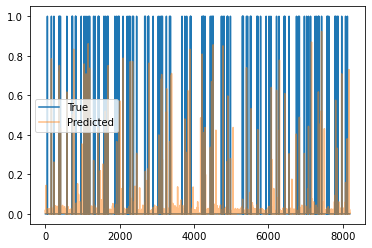

Train Epoch: 9 [2110/2220 (95%)]	Loss: 0.048676	Pres: 0.041642	F1 Score: 0.007109
Train Epoch: 9 [2120/2220 (95%)]	Loss: 0.052986	Pres: 0.039839	F1 Score: 0.005522
Train Epoch: 9 [2130/2220 (95%)]	Loss: 0.056085	Pres: 0.049107	F1 Score: 0.003502
Train Epoch: 9 [2140/2220 (96%)]	Loss: 0.053251	Pres: 0.067752	F1 Score: 0.013767
Train Epoch: 9 [2150/2220 (96%)]	Loss: 0.048084	Pres: 0.065922	F1 Score: 0.014461
Train Epoch: 9 [2160/2220 (97%)]	Loss: 0.057166	Pres: 0.050588	F1 Score: 0.006667
Train Epoch: 9 [2170/2220 (97%)]	Loss: 0.054103	Pres: 0.050000	F1 Score: 0.005354
Train Epoch: 9 [2180/2220 (98%)]	Loss: 0.053305	Pres: 0.054789	F1 Score: 0.011165
Train Epoch: 9 [2190/2220 (98%)]	Loss: 0.057347	Pres: 0.058704	F1 Score: 0.006825
Train Epoch: 9 [2200/2220 (99%)]	Loss: 0.044952	Pres: 0.047314	F1 Score: 0.010859
Train Epoch: 9 [2210/2220 (99%)]	Loss: 0.049616	Pres: 0.060153	F1 Score: 0.013333
Validation Epoch: 9 [0/582 (0%)]	Loss: 0.068300	Pres: 0.166667	F1 Score: 0.000000


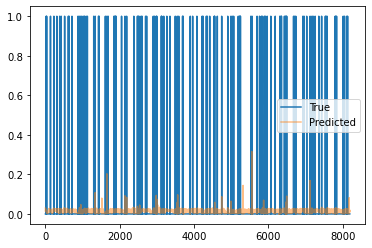

Validation Epoch: 9 [10/582 (1%)]	Loss: 0.064821	Pres: 0.090909	F1 Score: 0.000000
Validation Epoch: 9 [20/582 (3%)]	Loss: 0.060240	Pres: 0.090909	F1 Score: 0.000000
Validation Epoch: 9 [30/582 (5%)]	Loss: 0.066943	Pres: 0.200000	F1 Score: 0.000000
Validation Epoch: 9 [40/582 (6%)]	Loss: 0.059955	Pres: 0.166667	F1 Score: 0.001608
Validation Epoch: 9 [50/582 (8%)]	Loss: 0.058868	Pres: 0.181818	F1 Score: 0.000000
Validation Epoch: 9 [60/582 (10%)]	Loss: 0.064675	Pres: 0.166667	F1 Score: 0.000000
Validation Epoch: 9 [70/582 (12%)]	Loss: 0.066345	Pres: 0.166667	F1 Score: 0.001437
Validation Epoch: 9 [80/582 (13%)]	Loss: 0.059633	Pres: 0.166667	F1 Score: 0.001572
Validation Epoch: 9 [90/582 (15%)]	Loss: 0.065525	Pres: 0.181818	F1 Score: 0.000000
Validation Epoch: 9 [100/582 (17%)]	Loss: 0.064294	Pres: 0.200000	F1 Score: 0.000000
Validation Epoch: 9 [110/582 (18%)]	Loss: 0.059890	Pres: 0.166667	F1 Score: 0.001488
Validation Epoch: 9 [120/582 (20%)]	Loss: 0.062080	Pres: 0.090909	F1 Score: 0.0

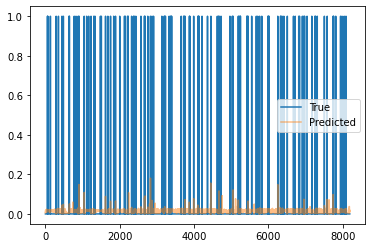

Validation Epoch: 9 [310/582 (53%)]	Loss: 0.061748	Pres: 0.181818	F1 Score: 0.000000
Validation Epoch: 9 [320/582 (54%)]	Loss: 0.060400	Pres: 0.181818	F1 Score: 0.000000
Validation Epoch: 9 [330/582 (56%)]	Loss: 0.063492	Pres: 0.090909	F1 Score: 0.001609
Validation Epoch: 9 [340/582 (58%)]	Loss: 0.064693	Pres: 0.181818	F1 Score: 0.000000
Validation Epoch: 9 [350/582 (60%)]	Loss: 0.064925	Pres: 0.200000	F1 Score: 0.000000
Validation Epoch: 9 [360/582 (61%)]	Loss: 0.066352	Pres: 0.181818	F1 Score: 0.000000
Validation Epoch: 9 [370/582 (63%)]	Loss: 0.060673	Pres: 0.166667	F1 Score: 0.000000
Validation Epoch: 9 [380/582 (65%)]	Loss: 0.062882	Pres: 0.166667	F1 Score: 0.000021
Validation Epoch: 9 [390/582 (67%)]	Loss: 0.063312	Pres: 0.090909	F1 Score: 0.000000
Validation Epoch: 9 [400/582 (68%)]	Loss: 0.064597	Pres: 0.181818	F1 Score: 0.001595
Validation Epoch: 9 [410/582 (70%)]	Loss: 0.061024	Pres: 0.166667	F1 Score: 0.000000
Validation Epoch: 9 [420/582 (72%)]	Loss: 0.062908	Pres: 0.090909

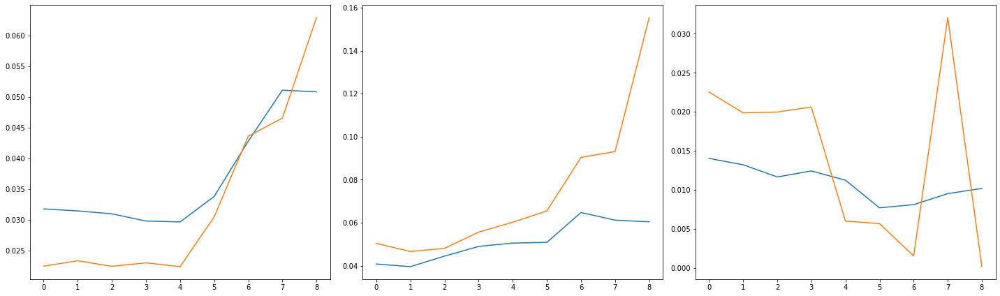

2220 582
Train Epoch: 10 [0/2220 (0%)]	Loss: 0.052081	Pres: 0.052199	F1 Score: 0.008361
109.0 -45664.0


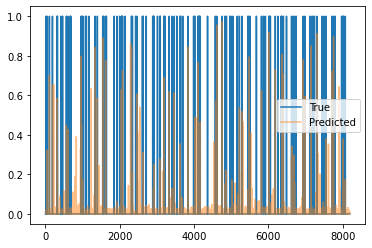

Train Epoch: 10 [10/2220 (0%)]	Loss: 0.048987	Pres: 0.059135	F1 Score: 0.009022
Train Epoch: 10 [20/2220 (0%)]	Loss: 0.051109	Pres: 0.064551	F1 Score: 0.014335
Train Epoch: 10 [30/2220 (1%)]	Loss: 0.048611	Pres: 0.050690	F1 Score: 0.011259
Train Epoch: 10 [40/2220 (1%)]	Loss: 0.047387	Pres: 0.071214	F1 Score: 0.013207
Train Epoch: 10 [50/2220 (2%)]	Loss: 0.047886	Pres: 0.044236	F1 Score: 0.010498
Train Epoch: 10 [60/2220 (2%)]	Loss: 0.052773	Pres: 0.056238	F1 Score: 0.009445
Train Epoch: 10 [70/2220 (3%)]	Loss: 0.050820	Pres: 0.059295	F1 Score: 0.008114
Train Epoch: 10 [80/2220 (3%)]	Loss: 0.049574	Pres: 0.067647	F1 Score: 0.012551
Train Epoch: 10 [90/2220 (4%)]	Loss: 0.055595	Pres: 0.062768	F1 Score: 0.007609
Train Epoch: 10 [100/2220 (4%)]	Loss: 0.056479	Pres: 0.069795	F1 Score: 0.009888
Train Epoch: 10 [110/2220 (4%)]	Loss: 0.049310	Pres: 0.044203	F1 Score: 0.009628
Train Epoch: 10 [120/2220 (5%)]	Loss: 0.047915	Pres: 0.067708	F1 Score: 0.012791
Train Epoch: 10 [130/2220 (5%)]	Loss:

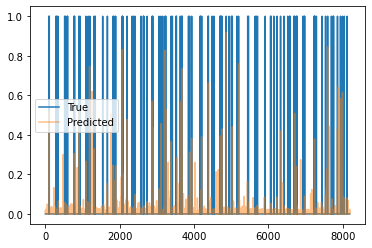

Train Epoch: 10 [310/2220 (13%)]	Loss: 0.053681	Pres: 0.063232	F1 Score: 0.008046
Train Epoch: 10 [320/2220 (14%)]	Loss: 0.048361	Pres: 0.049081	F1 Score: 0.009384
Train Epoch: 10 [330/2220 (14%)]	Loss: 0.052922	Pres: 0.057488	F1 Score: 0.005884
Train Epoch: 10 [340/2220 (15%)]	Loss: 0.047472	Pres: 0.053345	F1 Score: 0.007544
Train Epoch: 10 [350/2220 (15%)]	Loss: 0.054702	Pres: 0.073661	F1 Score: 0.010363
Train Epoch: 10 [360/2220 (16%)]	Loss: 0.046836	Pres: 0.074735	F1 Score: 0.010103
Train Epoch: 10 [370/2220 (16%)]	Loss: 0.054251	Pres: 0.065657	F1 Score: 0.012269
Train Epoch: 10 [380/2220 (17%)]	Loss: 0.058815	Pres: 0.082564	F1 Score: 0.007944
Train Epoch: 10 [390/2220 (17%)]	Loss: 0.056006	Pres: 0.067424	F1 Score: 0.007664
Train Epoch: 10 [400/2220 (18%)]	Loss: 0.051695	Pres: 0.060870	F1 Score: 0.006077
Train Epoch: 10 [410/2220 (18%)]	Loss: 0.054769	Pres: 0.059276	F1 Score: 0.006979
Train Epoch: 10 [420/2220 (18%)]	Loss: 0.049634	Pres: 0.062050	F1 Score: 0.010085
Train Epoch: 10 

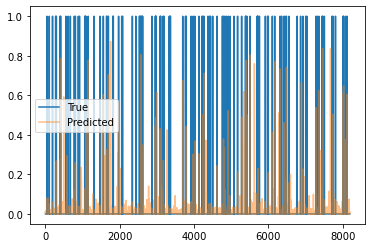

Train Epoch: 10 [610/2220 (27%)]	Loss: 0.049722	Pres: 0.069107	F1 Score: 0.007302
Train Epoch: 10 [620/2220 (27%)]	Loss: 0.045379	Pres: 0.057202	F1 Score: 0.011877
Train Epoch: 10 [630/2220 (28%)]	Loss: 0.047360	Pres: 0.049898	F1 Score: 0.008116
Train Epoch: 10 [640/2220 (28%)]	Loss: 0.051134	Pres: 0.069930	F1 Score: 0.008503
Train Epoch: 10 [650/2220 (29%)]	Loss: 0.049861	Pres: 0.057815	F1 Score: 0.010459
Train Epoch: 10 [660/2220 (29%)]	Loss: 0.051311	Pres: 0.074454	F1 Score: 0.007857
Train Epoch: 10 [670/2220 (30%)]	Loss: 0.048872	Pres: 0.057081	F1 Score: 0.009612
Train Epoch: 10 [680/2220 (30%)]	Loss: 0.062383	Pres: 0.082913	F1 Score: 0.005658
Train Epoch: 10 [690/2220 (31%)]	Loss: 0.057288	Pres: 0.058846	F1 Score: 0.006333
Train Epoch: 10 [700/2220 (31%)]	Loss: 0.049111	Pres: 0.056085	F1 Score: 0.008087
Train Epoch: 10 [710/2220 (31%)]	Loss: 0.050564	Pres: 0.074210	F1 Score: 0.011828
Train Epoch: 10 [720/2220 (32%)]	Loss: 0.052282	Pres: 0.060953	F1 Score: 0.011072
Train Epoch: 10 

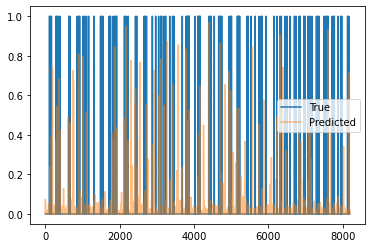

Train Epoch: 10 [910/2220 (40%)]	Loss: 0.050081	Pres: 0.068231	F1 Score: 0.013336
Train Epoch: 10 [920/2220 (41%)]	Loss: 0.049203	Pres: 0.059477	F1 Score: 0.010498
Train Epoch: 10 [930/2220 (41%)]	Loss: 0.049190	Pres: 0.056373	F1 Score: 0.005430
Train Epoch: 10 [940/2220 (42%)]	Loss: 0.050062	Pres: 0.058586	F1 Score: 0.008074
Train Epoch: 10 [950/2220 (42%)]	Loss: 0.055653	Pres: 0.082983	F1 Score: 0.009807
Train Epoch: 10 [960/2220 (43%)]	Loss: 0.060807	Pres: 0.068755	F1 Score: 0.009336
Train Epoch: 10 [970/2220 (43%)]	Loss: 0.052198	Pres: 0.081533	F1 Score: 0.007102
Train Epoch: 10 [980/2220 (44%)]	Loss: 0.054355	Pres: 0.085181	F1 Score: 0.009590
Train Epoch: 10 [990/2220 (44%)]	Loss: 0.052900	Pres: 0.061029	F1 Score: 0.009548
Train Epoch: 10 [1000/2220 (45%)]	Loss: 0.052351	Pres: 0.057454	F1 Score: 0.010205
Train Epoch: 10 [1010/2220 (45%)]	Loss: 0.053320	Pres: 0.048762	F1 Score: 0.002145
Train Epoch: 10 [1020/2220 (45%)]	Loss: 0.046958	Pres: 0.053736	F1 Score: 0.006170
Train Epoch: 

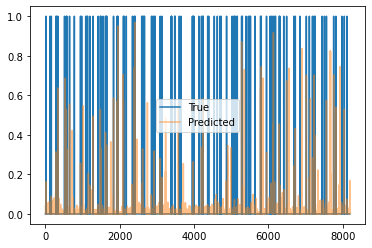

Train Epoch: 10 [1210/2220 (54%)]	Loss: 0.048762	Pres: 0.075436	F1 Score: 0.012829
Train Epoch: 10 [1220/2220 (54%)]	Loss: 0.055133	Pres: 0.049947	F1 Score: 0.009137
Train Epoch: 10 [1230/2220 (55%)]	Loss: 0.052760	Pres: 0.046958	F1 Score: 0.005470
Train Epoch: 10 [1240/2220 (55%)]	Loss: 0.048237	Pres: 0.063467	F1 Score: 0.011631
Train Epoch: 10 [1250/2220 (56%)]	Loss: 0.046914	Pres: 0.068627	F1 Score: 0.010710
Train Epoch: 10 [1260/2220 (56%)]	Loss: 0.049523	Pres: 0.061538	F1 Score: 0.012800
Train Epoch: 10 [1270/2220 (57%)]	Loss: 0.051262	Pres: 0.067007	F1 Score: 0.011067
Train Epoch: 10 [1280/2220 (57%)]	Loss: 0.058962	Pres: 0.072712	F1 Score: 0.009280
Train Epoch: 10 [1290/2220 (58%)]	Loss: 0.054209	Pres: 0.052469	F1 Score: 0.006975
Train Epoch: 10 [1300/2220 (58%)]	Loss: 0.056597	Pres: 0.057143	F1 Score: 0.002507
Train Epoch: 10 [1310/2220 (59%)]	Loss: 0.049350	Pres: 0.062745	F1 Score: 0.010581
Train Epoch: 10 [1320/2220 (59%)]	Loss: 0.050026	Pres: 0.043210	F1 Score: 0.012501
Trai

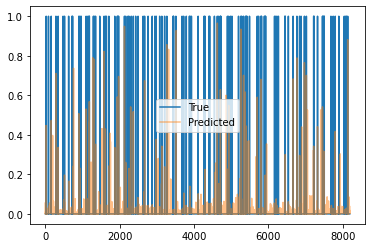

Train Epoch: 10 [1510/2220 (68%)]	Loss: 0.053049	Pres: 0.049603	F1 Score: 0.006275
Train Epoch: 10 [1520/2220 (68%)]	Loss: 0.048450	Pres: 0.057018	F1 Score: 0.007041
Train Epoch: 10 [1530/2220 (68%)]	Loss: 0.047638	Pres: 0.057117	F1 Score: 0.013385
Train Epoch: 10 [1540/2220 (69%)]	Loss: 0.050669	Pres: 0.064912	F1 Score: 0.008132
Train Epoch: 10 [1550/2220 (69%)]	Loss: 0.046619	Pres: 0.065472	F1 Score: 0.011362
Train Epoch: 10 [1560/2220 (70%)]	Loss: 0.058722	Pres: 0.074156	F1 Score: 0.012637
Train Epoch: 10 [1570/2220 (70%)]	Loss: 0.055915	Pres: 0.058803	F1 Score: 0.006302
Train Epoch: 10 [1580/2220 (71%)]	Loss: 0.053853	Pres: 0.082353	F1 Score: 0.013267
Train Epoch: 10 [1590/2220 (71%)]	Loss: 0.045465	Pres: 0.045000	F1 Score: 0.007369
Train Epoch: 10 [1600/2220 (72%)]	Loss: 0.050229	Pres: 0.055329	F1 Score: 0.008420
Train Epoch: 10 [1610/2220 (72%)]	Loss: 0.050476	Pres: 0.048152	F1 Score: 0.010686
Train Epoch: 10 [1620/2220 (72%)]	Loss: 0.050701	Pres: 0.047833	F1 Score: 0.007899
Trai

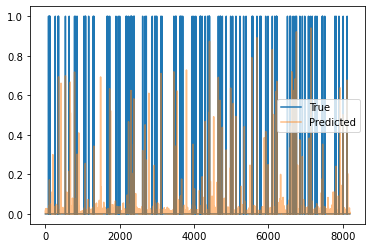

Train Epoch: 10 [1810/2220 (81%)]	Loss: 0.054236	Pres: 0.043750	F1 Score: 0.005051
Train Epoch: 10 [1820/2220 (81%)]	Loss: 0.052241	Pres: 0.047988	F1 Score: 0.006271
Train Epoch: 10 [1830/2220 (82%)]	Loss: 0.048564	Pres: 0.057453	F1 Score: 0.007997
Train Epoch: 10 [1840/2220 (82%)]	Loss: 0.048452	Pres: 0.071648	F1 Score: 0.009790
Train Epoch: 10 [1850/2220 (83%)]	Loss: 0.050247	Pres: 0.047348	F1 Score: 0.011936
Train Epoch: 10 [1860/2220 (83%)]	Loss: 0.046587	Pres: 0.058929	F1 Score: 0.009984
Train Epoch: 10 [1870/2220 (84%)]	Loss: 0.049203	Pres: 0.061574	F1 Score: 0.009684
Train Epoch: 10 [1880/2220 (84%)]	Loss: 0.049924	Pres: 0.057540	F1 Score: 0.008363
Train Epoch: 10 [1890/2220 (85%)]	Loss: 0.044578	Pres: 0.055007	F1 Score: 0.009624
Train Epoch: 10 [1900/2220 (85%)]	Loss: 0.048736	Pres: 0.049878	F1 Score: 0.009503
Train Epoch: 10 [1910/2220 (86%)]	Loss: 0.051666	Pres: 0.058421	F1 Score: 0.009228
Train Epoch: 10 [1920/2220 (86%)]	Loss: 0.050923	Pres: 0.059194	F1 Score: 0.006117
Trai

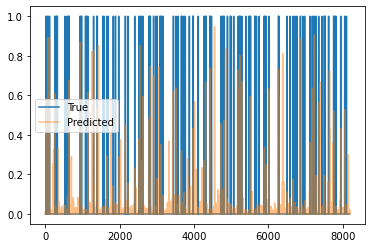

Train Epoch: 10 [2110/2220 (95%)]	Loss: 0.051031	Pres: 0.057572	F1 Score: 0.009158
Train Epoch: 10 [2120/2220 (95%)]	Loss: 0.042022	Pres: 0.059587	F1 Score: 0.011361
Train Epoch: 10 [2130/2220 (95%)]	Loss: 0.044437	Pres: 0.043750	F1 Score: 0.013200
Train Epoch: 10 [2140/2220 (96%)]	Loss: 0.046335	Pres: 0.053791	F1 Score: 0.010229
Train Epoch: 10 [2150/2220 (96%)]	Loss: 0.043787	Pres: 0.047787	F1 Score: 0.011490
Train Epoch: 10 [2160/2220 (97%)]	Loss: 0.045099	Pres: 0.043414	F1 Score: 0.009065
Train Epoch: 10 [2170/2220 (97%)]	Loss: 0.050077	Pres: 0.040584	F1 Score: 0.005019
Train Epoch: 10 [2180/2220 (98%)]	Loss: 0.048953	Pres: 0.042955	F1 Score: 0.008643
Train Epoch: 10 [2190/2220 (98%)]	Loss: 0.050027	Pres: 0.049216	F1 Score: 0.008747
Train Epoch: 10 [2200/2220 (99%)]	Loss: 0.052581	Pres: 0.044815	F1 Score: 0.007416
Train Epoch: 10 [2210/2220 (99%)]	Loss: 0.042350	Pres: 0.046216	F1 Score: 0.009597
Validation Epoch: 10 [0/582 (0%)]	Loss: 0.050799	Pres: 0.075397	F1 Score: 0.006075


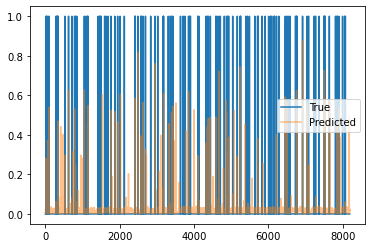

Validation Epoch: 10 [10/582 (1%)]	Loss: 0.051491	Pres: 0.047908	F1 Score: 0.002907
Validation Epoch: 10 [20/582 (3%)]	Loss: 0.048348	Pres: 0.071746	F1 Score: 0.006934
Validation Epoch: 10 [30/582 (5%)]	Loss: 0.049165	Pres: 0.093542	F1 Score: 0.016186
Validation Epoch: 10 [40/582 (6%)]	Loss: 0.048536	Pres: 0.090894	F1 Score: 0.009297
Validation Epoch: 10 [50/582 (8%)]	Loss: 0.048448	Pres: 0.070629	F1 Score: 0.008292
Validation Epoch: 10 [60/582 (10%)]	Loss: 0.047643	Pres: 0.071575	F1 Score: 0.009184
Validation Epoch: 10 [70/582 (12%)]	Loss: 0.049047	Pres: 0.084625	F1 Score: 0.008928
Validation Epoch: 10 [80/582 (13%)]	Loss: 0.048291	Pres: 0.039966	F1 Score: 0.002713
Validation Epoch: 10 [90/582 (15%)]	Loss: 0.048656	Pres: 0.042277	F1 Score: 0.003990
Validation Epoch: 10 [100/582 (17%)]	Loss: 0.051080	Pres: 0.092130	F1 Score: 0.008803
Validation Epoch: 10 [110/582 (18%)]	Loss: 0.050406	Pres: 0.077574	F1 Score: 0.009130
Validation Epoch: 10 [120/582 (20%)]	Loss: 0.050283	Pres: 0.090833	F

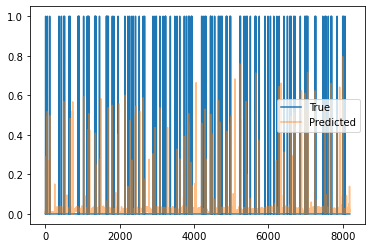

Validation Epoch: 10 [310/582 (53%)]	Loss: 0.052156	Pres: 0.057672	F1 Score: 0.007694
Validation Epoch: 10 [320/582 (54%)]	Loss: 0.045951	Pres: 0.088435	F1 Score: 0.014010
Validation Epoch: 10 [330/582 (56%)]	Loss: 0.050382	Pres: 0.088383	F1 Score: 0.009700
Validation Epoch: 10 [340/582 (58%)]	Loss: 0.050029	Pres: 0.057769	F1 Score: 0.008493
Validation Epoch: 10 [350/582 (60%)]	Loss: 0.042779	Pres: 0.069940	F1 Score: 0.007779
Validation Epoch: 10 [360/582 (61%)]	Loss: 0.046104	Pres: 0.072727	F1 Score: 0.009302
Validation Epoch: 10 [370/582 (63%)]	Loss: 0.047631	Pres: 0.071814	F1 Score: 0.005373
Validation Epoch: 10 [380/582 (65%)]	Loss: 0.055859	Pres: 0.078571	F1 Score: 0.006064
Validation Epoch: 10 [390/582 (67%)]	Loss: 0.048237	Pres: 0.050775	F1 Score: 0.003109
Validation Epoch: 10 [400/582 (68%)]	Loss: 0.049568	Pres: 0.085063	F1 Score: 0.009682
Validation Epoch: 10 [410/582 (70%)]	Loss: 0.048997	Pres: 0.089569	F1 Score: 0.006157
Validation Epoch: 10 [420/582 (72%)]	Loss: 0.046258	Pr

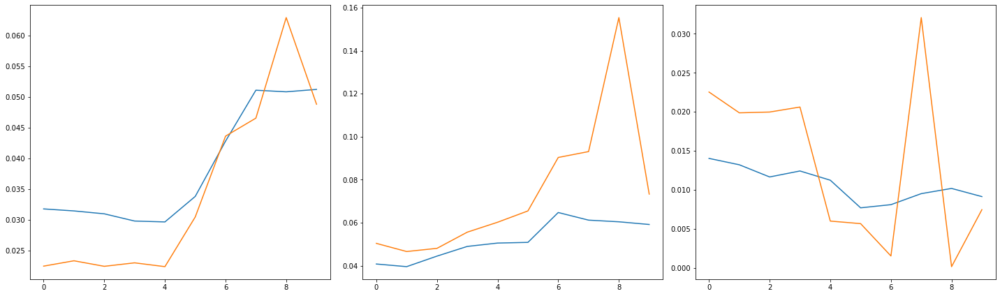

2220 582
Train Epoch: 11 [0/2220 (0%)]	Loss: 0.047410	Pres: 0.057498	F1 Score: 0.009660
104.0 -44096.0


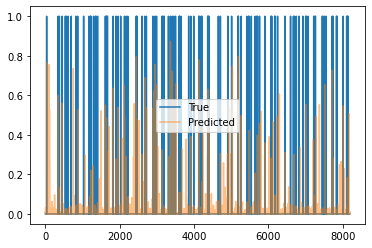

Train Epoch: 11 [10/2220 (0%)]	Loss: 0.048760	Pres: 0.059804	F1 Score: 0.013265
Train Epoch: 11 [20/2220 (0%)]	Loss: 0.048955	Pres: 0.061299	F1 Score: 0.009570
Train Epoch: 11 [30/2220 (1%)]	Loss: 0.049014	Pres: 0.045564	F1 Score: 0.008871
Train Epoch: 11 [40/2220 (1%)]	Loss: 0.052942	Pres: 0.043939	F1 Score: 0.005315
Train Epoch: 11 [50/2220 (2%)]	Loss: 0.049091	Pres: 0.055556	F1 Score: 0.009379
Train Epoch: 11 [60/2220 (2%)]	Loss: 0.054412	Pres: 0.057436	F1 Score: 0.010681
Train Epoch: 11 [70/2220 (3%)]	Loss: 0.047131	Pres: 0.057143	F1 Score: 0.007190
Train Epoch: 11 [80/2220 (3%)]	Loss: 0.047247	Pres: 0.065304	F1 Score: 0.015302
Train Epoch: 11 [90/2220 (4%)]	Loss: 0.050702	Pres: 0.043144	F1 Score: 0.008332
Train Epoch: 11 [100/2220 (4%)]	Loss: 0.047544	Pres: 0.044949	F1 Score: 0.006842
Train Epoch: 11 [110/2220 (4%)]	Loss: 0.050815	Pres: 0.046547	F1 Score: 0.006953
Train Epoch: 11 [120/2220 (5%)]	Loss: 0.049045	Pres: 0.053352	F1 Score: 0.010844
Train Epoch: 11 [130/2220 (5%)]	Loss:

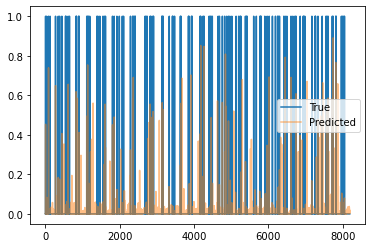

Train Epoch: 11 [310/2220 (13%)]	Loss: 0.050609	Pres: 0.052262	F1 Score: 0.013239
Train Epoch: 11 [320/2220 (14%)]	Loss: 0.043242	Pres: 0.054221	F1 Score: 0.011949
Train Epoch: 11 [330/2220 (14%)]	Loss: 0.046912	Pres: 0.054896	F1 Score: 0.014029
Train Epoch: 11 [340/2220 (15%)]	Loss: 0.047400	Pres: 0.060500	F1 Score: 0.011733
Train Epoch: 11 [350/2220 (15%)]	Loss: 0.043994	Pres: 0.064211	F1 Score: 0.015127
Train Epoch: 11 [360/2220 (16%)]	Loss: 0.052072	Pres: 0.053044	F1 Score: 0.009043
Train Epoch: 11 [370/2220 (16%)]	Loss: 0.048058	Pres: 0.063416	F1 Score: 0.014217
Train Epoch: 11 [380/2220 (17%)]	Loss: 0.051068	Pres: 0.067857	F1 Score: 0.012444
Train Epoch: 11 [390/2220 (17%)]	Loss: 0.043448	Pres: 0.055496	F1 Score: 0.010964
Train Epoch: 11 [400/2220 (18%)]	Loss: 0.048086	Pres: 0.046457	F1 Score: 0.008264
Train Epoch: 11 [410/2220 (18%)]	Loss: 0.046369	Pres: 0.061496	F1 Score: 0.013655
Train Epoch: 11 [420/2220 (18%)]	Loss: 0.049294	Pres: 0.053136	F1 Score: 0.010466
Train Epoch: 11 

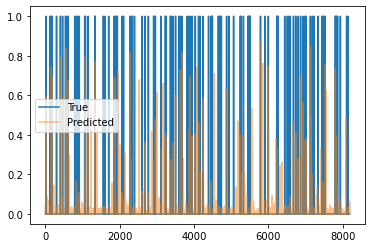

Train Epoch: 11 [610/2220 (27%)]	Loss: 0.043557	Pres: 0.073441	F1 Score: 0.018915
Train Epoch: 11 [620/2220 (27%)]	Loss: 0.045906	Pres: 0.064409	F1 Score: 0.008817
Train Epoch: 11 [630/2220 (28%)]	Loss: 0.048885	Pres: 0.046357	F1 Score: 0.012599
Train Epoch: 11 [640/2220 (28%)]	Loss: 0.049453	Pres: 0.060766	F1 Score: 0.006773
Train Epoch: 11 [650/2220 (29%)]	Loss: 0.042873	Pres: 0.053636	F1 Score: 0.011238
Train Epoch: 11 [660/2220 (29%)]	Loss: 0.050664	Pres: 0.053885	F1 Score: 0.009963
Train Epoch: 11 [670/2220 (30%)]	Loss: 0.046883	Pres: 0.058553	F1 Score: 0.009634
Train Epoch: 11 [680/2220 (30%)]	Loss: 0.046904	Pres: 0.062585	F1 Score: 0.016632
Train Epoch: 11 [690/2220 (31%)]	Loss: 0.047117	Pres: 0.057262	F1 Score: 0.011522
Train Epoch: 11 [700/2220 (31%)]	Loss: 0.041780	Pres: 0.051535	F1 Score: 0.009595
Train Epoch: 11 [710/2220 (31%)]	Loss: 0.051160	Pres: 0.052632	F1 Score: 0.005388
Train Epoch: 11 [720/2220 (32%)]	Loss: 0.050332	Pres: 0.059463	F1 Score: 0.012936
Train Epoch: 11 

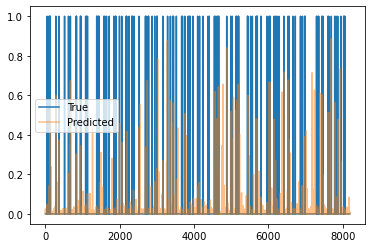

Train Epoch: 11 [910/2220 (40%)]	Loss: 0.044449	Pres: 0.055331	F1 Score: 0.014067
Train Epoch: 11 [920/2220 (41%)]	Loss: 0.058208	Pres: 0.039435	F1 Score: 0.005128
Train Epoch: 11 [930/2220 (41%)]	Loss: 0.042434	Pres: 0.052976	F1 Score: 0.009609
Train Epoch: 11 [940/2220 (42%)]	Loss: 0.052702	Pres: 0.061597	F1 Score: 0.008969
Train Epoch: 11 [950/2220 (42%)]	Loss: 0.042897	Pres: 0.065704	F1 Score: 0.014978
Train Epoch: 11 [960/2220 (43%)]	Loss: 0.049599	Pres: 0.046053	F1 Score: 0.003784
Train Epoch: 11 [970/2220 (43%)]	Loss: 0.043221	Pres: 0.065374	F1 Score: 0.017886
Train Epoch: 11 [980/2220 (44%)]	Loss: 0.051588	Pres: 0.058146	F1 Score: 0.011229
Train Epoch: 11 [990/2220 (44%)]	Loss: 0.044382	Pres: 0.062796	F1 Score: 0.006488
Train Epoch: 11 [1000/2220 (45%)]	Loss: 0.052846	Pres: 0.059150	F1 Score: 0.013692
Train Epoch: 11 [1010/2220 (45%)]	Loss: 0.044315	Pres: 0.054374	F1 Score: 0.010805
Train Epoch: 11 [1020/2220 (45%)]	Loss: 0.051656	Pres: 0.058953	F1 Score: 0.010666
Train Epoch: 

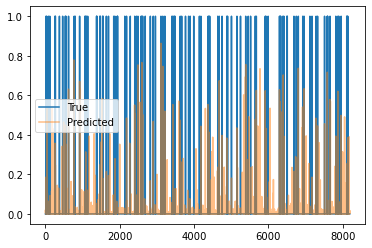

Train Epoch: 11 [1210/2220 (54%)]	Loss: 0.048919	Pres: 0.055728	F1 Score: 0.009158
Train Epoch: 11 [1220/2220 (54%)]	Loss: 0.045259	Pres: 0.058193	F1 Score: 0.009073
Train Epoch: 11 [1230/2220 (55%)]	Loss: 0.044464	Pres: 0.051295	F1 Score: 0.008709
Train Epoch: 11 [1240/2220 (55%)]	Loss: 0.051021	Pres: 0.061466	F1 Score: 0.009904
Train Epoch: 11 [1250/2220 (56%)]	Loss: 0.052089	Pres: 0.072049	F1 Score: 0.015696
Train Epoch: 11 [1260/2220 (56%)]	Loss: 0.053897	Pres: 0.060185	F1 Score: 0.007300
Train Epoch: 11 [1270/2220 (57%)]	Loss: 0.047432	Pres: 0.046956	F1 Score: 0.007934
Train Epoch: 11 [1280/2220 (57%)]	Loss: 0.052355	Pres: 0.056544	F1 Score: 0.008287
Train Epoch: 11 [1290/2220 (58%)]	Loss: 0.047726	Pres: 0.069010	F1 Score: 0.008387
Train Epoch: 11 [1300/2220 (58%)]	Loss: 0.048442	Pres: 0.052964	F1 Score: 0.010938
Train Epoch: 11 [1310/2220 (59%)]	Loss: 0.049771	Pres: 0.049383	F1 Score: 0.007303
Train Epoch: 11 [1320/2220 (59%)]	Loss: 0.048864	Pres: 0.070787	F1 Score: 0.010128
Trai

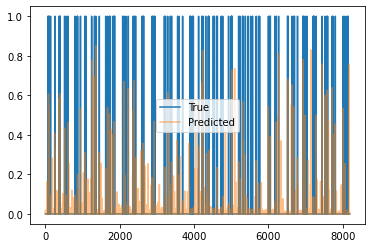

Train Epoch: 11 [1510/2220 (68%)]	Loss: 0.049381	Pres: 0.060734	F1 Score: 0.011427
Train Epoch: 11 [1520/2220 (68%)]	Loss: 0.046751	Pres: 0.062821	F1 Score: 0.008708
Train Epoch: 11 [1530/2220 (68%)]	Loss: 0.047061	Pres: 0.072884	F1 Score: 0.011465
Train Epoch: 11 [1540/2220 (69%)]	Loss: 0.052029	Pres: 0.082955	F1 Score: 0.008703
Train Epoch: 11 [1550/2220 (69%)]	Loss: 0.049397	Pres: 0.071429	F1 Score: 0.010056
Train Epoch: 11 [1560/2220 (70%)]	Loss: 0.046246	Pres: 0.053214	F1 Score: 0.008369
Train Epoch: 11 [1570/2220 (70%)]	Loss: 0.047259	Pres: 0.047772	F1 Score: 0.009520
Train Epoch: 11 [1580/2220 (71%)]	Loss: 0.054067	Pres: 0.068327	F1 Score: 0.010747
Train Epoch: 11 [1590/2220 (71%)]	Loss: 0.054417	Pres: 0.053330	F1 Score: 0.005342
Train Epoch: 11 [1600/2220 (72%)]	Loss: 0.050271	Pres: 0.073626	F1 Score: 0.008939
Train Epoch: 11 [1610/2220 (72%)]	Loss: 0.047124	Pres: 0.078632	F1 Score: 0.017037
Train Epoch: 11 [1620/2220 (72%)]	Loss: 0.049170	Pres: 0.064957	F1 Score: 0.009225
Trai

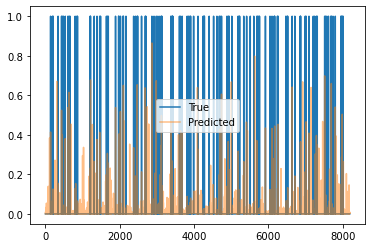

Train Epoch: 11 [1810/2220 (81%)]	Loss: 0.052468	Pres: 0.102679	F1 Score: 0.002844
Train Epoch: 11 [1820/2220 (81%)]	Loss: 0.044406	Pres: 0.066249	F1 Score: 0.010769
Train Epoch: 11 [1830/2220 (82%)]	Loss: 0.050540	Pres: 0.055317	F1 Score: 0.003829
Train Epoch: 11 [1840/2220 (82%)]	Loss: 0.049280	Pres: 0.058741	F1 Score: 0.010946
Train Epoch: 11 [1850/2220 (83%)]	Loss: 0.044121	Pres: 0.057435	F1 Score: 0.005889
Train Epoch: 11 [1860/2220 (83%)]	Loss: 0.049886	Pres: 0.063025	F1 Score: 0.008039
Train Epoch: 11 [1870/2220 (84%)]	Loss: 0.055054	Pres: 0.049412	F1 Score: 0.007924
Train Epoch: 11 [1880/2220 (84%)]	Loss: 0.050939	Pres: 0.080201	F1 Score: 0.016704
Train Epoch: 11 [1890/2220 (85%)]	Loss: 0.047964	Pres: 0.068723	F1 Score: 0.009348
Train Epoch: 11 [1900/2220 (85%)]	Loss: 0.041370	Pres: 0.055340	F1 Score: 0.006477
Train Epoch: 11 [1910/2220 (86%)]	Loss: 0.046857	Pres: 0.045351	F1 Score: 0.008881
Train Epoch: 11 [1920/2220 (86%)]	Loss: 0.052205	Pres: 0.093137	F1 Score: 0.006755
Trai

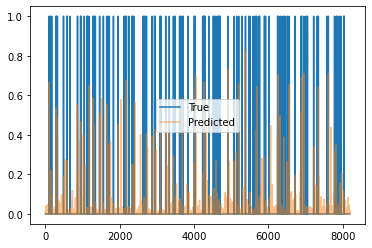

Train Epoch: 11 [2110/2220 (95%)]	Loss: 0.049599	Pres: 0.053050	F1 Score: 0.009333
Train Epoch: 11 [2120/2220 (95%)]	Loss: 0.045717	Pres: 0.068219	F1 Score: 0.011517
Train Epoch: 11 [2130/2220 (95%)]	Loss: 0.044461	Pres: 0.068309	F1 Score: 0.011936
Train Epoch: 11 [2140/2220 (96%)]	Loss: 0.041789	Pres: 0.062061	F1 Score: 0.013319
Train Epoch: 11 [2150/2220 (96%)]	Loss: 0.052568	Pres: 0.050245	F1 Score: 0.004251
Train Epoch: 11 [2160/2220 (97%)]	Loss: 0.053478	Pres: 0.051229	F1 Score: 0.009538
Train Epoch: 11 [2170/2220 (97%)]	Loss: 0.040096	Pres: 0.077489	F1 Score: 0.014058
Train Epoch: 11 [2180/2220 (98%)]	Loss: 0.051363	Pres: 0.064480	F1 Score: 0.007407
Train Epoch: 11 [2190/2220 (98%)]	Loss: 0.051077	Pres: 0.045635	F1 Score: 0.004325
Train Epoch: 11 [2200/2220 (99%)]	Loss: 0.046958	Pres: 0.073740	F1 Score: 0.013846
Train Epoch: 11 [2210/2220 (99%)]	Loss: 0.048538	Pres: 0.081863	F1 Score: 0.008174
Validation Epoch: 11 [0/582 (0%)]	Loss: 0.043032	Pres: 0.023377	F1 Score: 0.000402


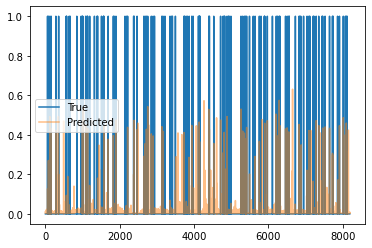

Validation Epoch: 11 [10/582 (1%)]	Loss: 0.039534	Pres: 0.108553	F1 Score: 0.000470
Validation Epoch: 11 [20/582 (3%)]	Loss: 0.043728	Pres: 0.106101	F1 Score: 0.000416
Validation Epoch: 11 [30/582 (5%)]	Loss: 0.046847	Pres: 0.113924	F1 Score: 0.002042
Validation Epoch: 11 [40/582 (6%)]	Loss: 0.045212	Pres: 0.113997	F1 Score: 0.000357
Validation Epoch: 11 [50/582 (8%)]	Loss: 0.042246	Pres: 0.110329	F1 Score: 0.001985
Validation Epoch: 11 [60/582 (10%)]	Loss: 0.044120	Pres: 0.031095	F1 Score: 0.000511
Validation Epoch: 11 [70/582 (12%)]	Loss: 0.043723	Pres: 0.111111	F1 Score: 0.000409
Validation Epoch: 11 [80/582 (13%)]	Loss: 0.045380	Pres: 0.022321	F1 Score: 0.000307
Validation Epoch: 11 [90/582 (15%)]	Loss: 0.044012	Pres: 0.108447	F1 Score: 0.000450
Validation Epoch: 11 [100/582 (17%)]	Loss: 0.047856	Pres: 0.101852	F1 Score: 0.000287
Validation Epoch: 11 [110/582 (18%)]	Loss: 0.041215	Pres: 0.075058	F1 Score: 0.003338
Validation Epoch: 11 [120/582 (20%)]	Loss: 0.045049	Pres: 0.107188	F

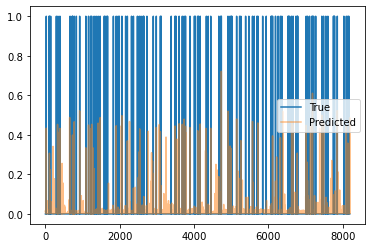

Validation Epoch: 11 [310/582 (53%)]	Loss: 0.044927	Pres: 0.113757	F1 Score: 0.000471
Validation Epoch: 11 [320/582 (54%)]	Loss: 0.043570	Pres: 0.118490	F1 Score: 0.002155
Validation Epoch: 11 [330/582 (56%)]	Loss: 0.044897	Pres: 0.123847	F1 Score: 0.000558
Validation Epoch: 11 [340/582 (58%)]	Loss: 0.041312	Pres: 0.068548	F1 Score: 0.001938
Validation Epoch: 11 [350/582 (60%)]	Loss: 0.041269	Pres: 0.025641	F1 Score: 0.000409
Validation Epoch: 11 [360/582 (61%)]	Loss: 0.042524	Pres: 0.104009	F1 Score: 0.003195
Validation Epoch: 11 [370/582 (63%)]	Loss: 0.045107	Pres: 0.102925	F1 Score: 0.000453
Validation Epoch: 11 [380/582 (65%)]	Loss: 0.045295	Pres: 0.022619	F1 Score: 0.000333
Validation Epoch: 11 [390/582 (67%)]	Loss: 0.042531	Pres: 0.108974	F1 Score: 0.000409
Validation Epoch: 11 [400/582 (68%)]	Loss: 0.046097	Pres: 0.126623	F1 Score: 0.000491
Validation Epoch: 11 [410/582 (70%)]	Loss: 0.045683	Pres: 0.116402	F1 Score: 0.002040
Validation Epoch: 11 [420/582 (72%)]	Loss: 0.047392	Pr

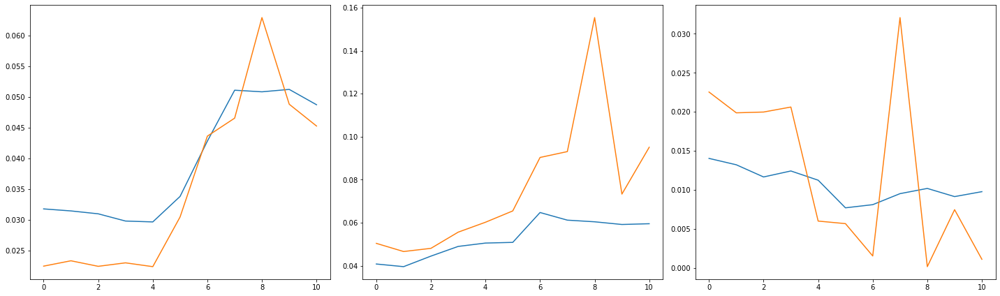

2220 582
Train Epoch: 12 [0/2220 (0%)]	Loss: 0.046446	Pres: 0.061498	F1 Score: 0.005846
103.0 -44512.0


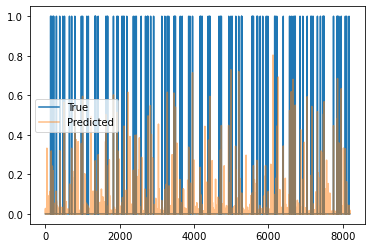

Train Epoch: 12 [10/2220 (0%)]	Loss: 0.050782	Pres: 0.054367	F1 Score: 0.008475
Train Epoch: 12 [20/2220 (0%)]	Loss: 0.048733	Pres: 0.082906	F1 Score: 0.009164
Train Epoch: 12 [30/2220 (1%)]	Loss: 0.052927	Pres: 0.064706	F1 Score: 0.008591
Train Epoch: 12 [40/2220 (1%)]	Loss: 0.048837	Pres: 0.067777	F1 Score: 0.009598
Train Epoch: 12 [50/2220 (2%)]	Loss: 0.056617	Pres: 0.088889	F1 Score: 0.001229
Train Epoch: 12 [60/2220 (2%)]	Loss: 0.049637	Pres: 0.070377	F1 Score: 0.007366
Train Epoch: 12 [70/2220 (3%)]	Loss: 0.054691	Pres: 0.053618	F1 Score: 0.006496
Train Epoch: 12 [80/2220 (3%)]	Loss: 0.045652	Pres: 0.083070	F1 Score: 0.009055
Train Epoch: 12 [90/2220 (4%)]	Loss: 0.051870	Pres: 0.074269	F1 Score: 0.007002
Train Epoch: 12 [100/2220 (4%)]	Loss: 0.053287	Pres: 0.052632	F1 Score: 0.007880
Train Epoch: 12 [110/2220 (4%)]	Loss: 0.050870	Pres: 0.060823	F1 Score: 0.007614
Train Epoch: 12 [120/2220 (5%)]	Loss: 0.047596	Pres: 0.073031	F1 Score: 0.009761
Train Epoch: 12 [130/2220 (5%)]	Loss:

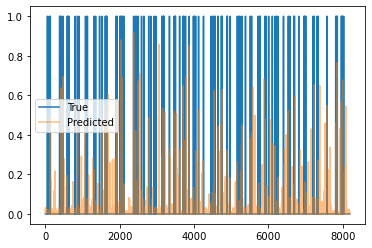

Train Epoch: 12 [310/2220 (13%)]	Loss: 0.045701	Pres: 0.077922	F1 Score: 0.007330
Train Epoch: 12 [320/2220 (14%)]	Loss: 0.049542	Pres: 0.088925	F1 Score: 0.017418
Train Epoch: 12 [330/2220 (14%)]	Loss: 0.052171	Pres: 0.090302	F1 Score: 0.013093
Train Epoch: 12 [340/2220 (15%)]	Loss: 0.046374	Pres: 0.078463	F1 Score: 0.007853
Train Epoch: 12 [350/2220 (15%)]	Loss: 0.047685	Pres: 0.094429	F1 Score: 0.012833
Train Epoch: 12 [360/2220 (16%)]	Loss: 0.047194	Pres: 0.057510	F1 Score: 0.006214
Train Epoch: 12 [370/2220 (16%)]	Loss: 0.048659	Pres: 0.055556	F1 Score: 0.005656
Train Epoch: 12 [380/2220 (17%)]	Loss: 0.049932	Pres: 0.058187	F1 Score: 0.007471
Train Epoch: 12 [390/2220 (17%)]	Loss: 0.053367	Pres: 0.082532	F1 Score: 0.007019
Train Epoch: 12 [400/2220 (18%)]	Loss: 0.046847	Pres: 0.068627	F1 Score: 0.011451
Train Epoch: 12 [410/2220 (18%)]	Loss: 0.051933	Pres: 0.087278	F1 Score: 0.004101
Train Epoch: 12 [420/2220 (18%)]	Loss: 0.050688	Pres: 0.054688	F1 Score: 0.003569
Train Epoch: 12 

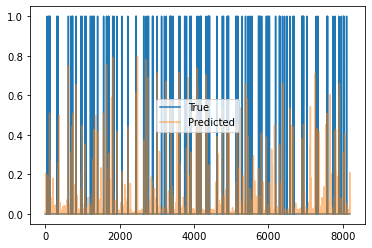

Train Epoch: 12 [610/2220 (27%)]	Loss: 0.049971	Pres: 0.075245	F1 Score: 0.011979
Train Epoch: 12 [620/2220 (27%)]	Loss: 0.047087	Pres: 0.054617	F1 Score: 0.003626
Train Epoch: 12 [630/2220 (28%)]	Loss: 0.053359	Pres: 0.021645	F1 Score: 0.001215
Train Epoch: 12 [640/2220 (28%)]	Loss: 0.050039	Pres: 0.077026	F1 Score: 0.008976
Train Epoch: 12 [650/2220 (29%)]	Loss: 0.050070	Pres: 0.080665	F1 Score: 0.009177
Train Epoch: 12 [660/2220 (29%)]	Loss: 0.044171	Pres: 0.065134	F1 Score: 0.007044
Train Epoch: 12 [670/2220 (30%)]	Loss: 0.053540	Pres: 0.076110	F1 Score: 0.006794
Train Epoch: 12 [680/2220 (30%)]	Loss: 0.049761	Pres: 0.063889	F1 Score: 0.007773
Train Epoch: 12 [690/2220 (31%)]	Loss: 0.051319	Pres: 0.053117	F1 Score: 0.003538
Train Epoch: 12 [700/2220 (31%)]	Loss: 0.047097	Pres: 0.067472	F1 Score: 0.005649
Train Epoch: 12 [710/2220 (31%)]	Loss: 0.049212	Pres: 0.066176	F1 Score: 0.008901
Train Epoch: 12 [720/2220 (32%)]	Loss: 0.052427	Pres: 0.060417	F1 Score: 0.003375
Train Epoch: 12 

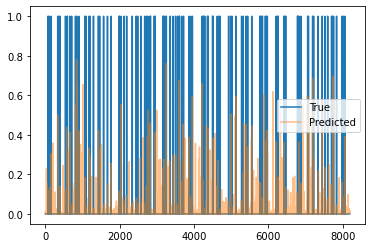

Train Epoch: 12 [910/2220 (40%)]	Loss: 0.049075	Pres: 0.046075	F1 Score: 0.002565
Train Epoch: 12 [920/2220 (41%)]	Loss: 0.050041	Pres: 0.083405	F1 Score: 0.009176
Train Epoch: 12 [930/2220 (41%)]	Loss: 0.049222	Pres: 0.090676	F1 Score: 0.011879
Train Epoch: 12 [940/2220 (42%)]	Loss: 0.051508	Pres: 0.063776	F1 Score: 0.004864
Train Epoch: 12 [950/2220 (42%)]	Loss: 0.052529	Pres: 0.071429	F1 Score: 0.001564
Train Epoch: 12 [960/2220 (43%)]	Loss: 0.049126	Pres: 0.075452	F1 Score: 0.002709
Train Epoch: 12 [970/2220 (43%)]	Loss: 0.048246	Pres: 0.065909	F1 Score: 0.005994
Train Epoch: 12 [980/2220 (44%)]	Loss: 0.049708	Pres: 0.092803	F1 Score: 0.003584
Train Epoch: 12 [990/2220 (44%)]	Loss: 0.051507	Pres: 0.074937	F1 Score: 0.004717
Train Epoch: 12 [1000/2220 (45%)]	Loss: 0.050310	Pres: 0.074269	F1 Score: 0.004615
Train Epoch: 12 [1010/2220 (45%)]	Loss: 0.045975	Pres: 0.074603	F1 Score: 0.005704
Train Epoch: 12 [1020/2220 (45%)]	Loss: 0.048479	Pres: 0.054899	F1 Score: 0.004601
Train Epoch: 

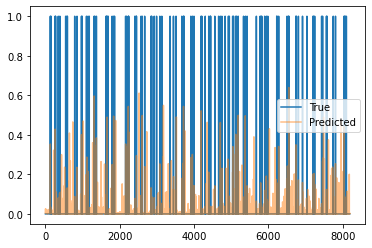

Train Epoch: 12 [1210/2220 (54%)]	Loss: 0.049497	Pres: 0.074269	F1 Score: 0.002771
Train Epoch: 12 [1220/2220 (54%)]	Loss: 0.048560	Pres: 0.080098	F1 Score: 0.006059
Train Epoch: 12 [1230/2220 (55%)]	Loss: 0.051876	Pres: 0.076923	F1 Score: 0.003671
Train Epoch: 12 [1240/2220 (55%)]	Loss: 0.050108	Pres: 0.093878	F1 Score: 0.005419
Train Epoch: 12 [1250/2220 (56%)]	Loss: 0.050024	Pres: 0.069549	F1 Score: 0.001538
Train Epoch: 12 [1260/2220 (56%)]	Loss: 0.053640	Pres: 0.048299	F1 Score: 0.001552
Train Epoch: 12 [1270/2220 (57%)]	Loss: 0.050194	Pres: 0.060000	F1 Score: 0.003613
Train Epoch: 12 [1280/2220 (57%)]	Loss: 0.055184	Pres: 0.079832	F1 Score: 0.003311
Train Epoch: 12 [1290/2220 (58%)]	Loss: 0.051276	Pres: 0.062271	F1 Score: 0.005131
Train Epoch: 12 [1300/2220 (58%)]	Loss: 0.049288	Pres: 0.076299	F1 Score: 0.004300
Train Epoch: 12 [1310/2220 (59%)]	Loss: 0.047154	Pres: 0.072261	F1 Score: 0.003228
Train Epoch: 12 [1320/2220 (59%)]	Loss: 0.050266	Pres: 0.093537	F1 Score: 0.002891
Trai

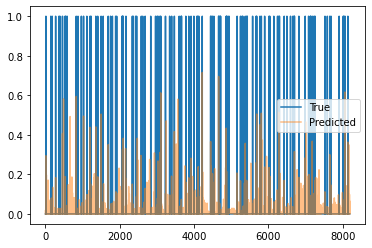

Train Epoch: 12 [1510/2220 (68%)]	Loss: 0.051025	Pres: 0.084559	F1 Score: 0.003471
Train Epoch: 12 [1520/2220 (68%)]	Loss: 0.049278	Pres: 0.104247	F1 Score: 0.004231
Train Epoch: 12 [1530/2220 (68%)]	Loss: 0.047793	Pres: 0.056576	F1 Score: 0.006864
Train Epoch: 12 [1540/2220 (69%)]	Loss: 0.049104	Pres: 0.051149	F1 Score: 0.001448
Train Epoch: 12 [1550/2220 (69%)]	Loss: 0.052781	Pres: 0.102381	F1 Score: 0.005219
Train Epoch: 12 [1560/2220 (70%)]	Loss: 0.047635	Pres: 0.077249	F1 Score: 0.005847
Train Epoch: 12 [1570/2220 (70%)]	Loss: 0.044348	Pres: 0.091071	F1 Score: 0.005729
Train Epoch: 12 [1580/2220 (71%)]	Loss: 0.055011	Pres: 0.038306	F1 Score: 0.000293
Train Epoch: 12 [1590/2220 (71%)]	Loss: 0.045808	Pres: 0.055000	F1 Score: 0.002703
Train Epoch: 12 [1600/2220 (72%)]	Loss: 0.052041	Pres: 0.103480	F1 Score: 0.005806
Train Epoch: 12 [1610/2220 (72%)]	Loss: 0.051406	Pres: 0.074735	F1 Score: 0.005588
Train Epoch: 12 [1620/2220 (72%)]	Loss: 0.047843	Pres: 0.077037	F1 Score: 0.004999
Trai

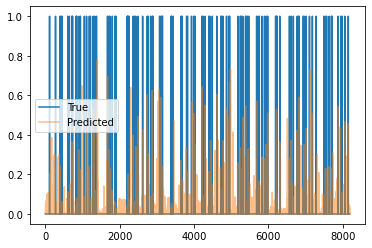

Train Epoch: 12 [1810/2220 (81%)]	Loss: 0.043258	Pres: 0.060317	F1 Score: 0.005172
Train Epoch: 12 [1820/2220 (81%)]	Loss: 0.046370	Pres: 0.092803	F1 Score: 0.002519
Train Epoch: 12 [1830/2220 (82%)]	Loss: 0.051555	Pres: 0.054080	F1 Score: 0.002117
Train Epoch: 12 [1840/2220 (82%)]	Loss: 0.045515	Pres: 0.050725	F1 Score: 0.001454
Train Epoch: 12 [1850/2220 (83%)]	Loss: 0.052143	Pres: 0.066026	F1 Score: 0.003872
Train Epoch: 12 [1860/2220 (83%)]	Loss: 0.051262	Pres: 0.072789	F1 Score: 0.002815
Train Epoch: 12 [1870/2220 (84%)]	Loss: 0.050593	Pres: 0.073333	F1 Score: 0.003801
Train Epoch: 12 [1880/2220 (84%)]	Loss: 0.050639	Pres: 0.063816	F1 Score: 0.003564
Train Epoch: 12 [1890/2220 (85%)]	Loss: 0.060091	Pres: 0.072650	F1 Score: 0.001065
Train Epoch: 12 [1900/2220 (85%)]	Loss: 0.053770	Pres: 0.054924	F1 Score: 0.001393
Train Epoch: 12 [1910/2220 (86%)]	Loss: 0.050655	Pres: 0.055444	F1 Score: 0.002322
Train Epoch: 12 [1920/2220 (86%)]	Loss: 0.052910	Pres: 0.098413	F1 Score: 0.001434
Trai

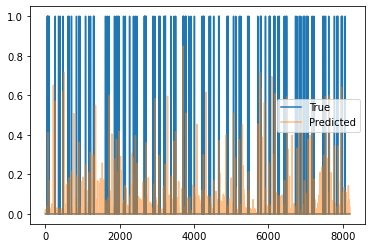

Train Epoch: 12 [2110/2220 (95%)]	Loss: 0.044483	Pres: 0.078024	F1 Score: 0.007740
Train Epoch: 12 [2120/2220 (95%)]	Loss: 0.047718	Pres: 0.049168	F1 Score: 0.004303
Train Epoch: 12 [2130/2220 (95%)]	Loss: 0.049677	Pres: 0.070890	F1 Score: 0.004225
Train Epoch: 12 [2140/2220 (96%)]	Loss: 0.046941	Pres: 0.055804	F1 Score: 0.004594
Train Epoch: 12 [2150/2220 (96%)]	Loss: 0.051336	Pres: 0.065162	F1 Score: 0.005025
Train Epoch: 12 [2160/2220 (97%)]	Loss: 0.051626	Pres: 0.058594	F1 Score: 0.002299
Train Epoch: 12 [2170/2220 (97%)]	Loss: 0.048732	Pres: 0.030449	F1 Score: 0.000292
Train Epoch: 12 [2180/2220 (98%)]	Loss: 0.047274	Pres: 0.078282	F1 Score: 0.012712
Train Epoch: 12 [2190/2220 (98%)]	Loss: 0.051812	Pres: 0.062857	F1 Score: 0.003223
Train Epoch: 12 [2200/2220 (99%)]	Loss: 0.042226	Pres: 0.077201	F1 Score: 0.008797
Train Epoch: 12 [2210/2220 (99%)]	Loss: 0.048715	Pres: 0.071579	F1 Score: 0.007228
Validation Epoch: 12 [0/582 (0%)]	Loss: 0.046941	Pres: 0.106061	F1 Score: 0.003677


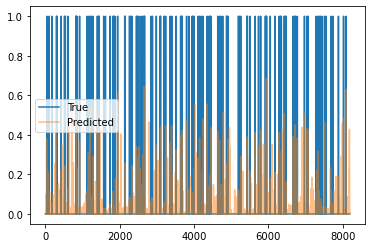

Validation Epoch: 12 [10/582 (1%)]	Loss: 0.043827	Pres: 0.084711	F1 Score: 0.002048
Validation Epoch: 12 [20/582 (3%)]	Loss: 0.048075	Pres: 0.129870	F1 Score: 0.000336
Validation Epoch: 12 [30/582 (5%)]	Loss: 0.042848	Pres: 0.026263	F1 Score: 0.000291
Validation Epoch: 12 [40/582 (6%)]	Loss: 0.049431	Pres: 0.035477	F1 Score: 0.000358
Validation Epoch: 12 [50/582 (8%)]	Loss: 0.049438	Pres: 0.131579	F1 Score: 0.001922
Validation Epoch: 12 [60/582 (10%)]	Loss: 0.049760	Pres: 0.034553	F1 Score: 0.000349
Validation Epoch: 12 [70/582 (12%)]	Loss: 0.050818	Pres: 0.129870	F1 Score: 0.000336
Validation Epoch: 12 [80/582 (13%)]	Loss: 0.043014	Pres: 0.075758	F1 Score: 0.002242
Validation Epoch: 12 [90/582 (15%)]	Loss: 0.050853	Pres: 0.071861	F1 Score: 0.001913
Validation Epoch: 12 [100/582 (17%)]	Loss: 0.049132	Pres: 0.081340	F1 Score: 0.002019
Validation Epoch: 12 [110/582 (18%)]	Loss: 0.046896	Pres: 0.042929	F1 Score: 0.000380
Validation Epoch: 12 [120/582 (20%)]	Loss: 0.046987	Pres: 0.122010	F

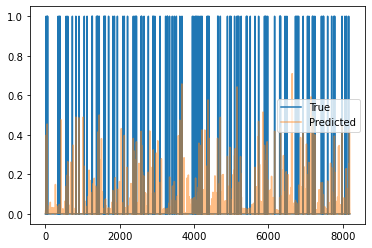

Validation Epoch: 12 [310/582 (53%)]	Loss: 0.047426	Pres: 0.127660	F1 Score: 0.000425
Validation Epoch: 12 [320/582 (54%)]	Loss: 0.046572	Pres: 0.117172	F1 Score: 0.000291
Validation Epoch: 12 [330/582 (56%)]	Loss: 0.052723	Pres: 0.078431	F1 Score: 0.001998
Validation Epoch: 12 [340/582 (58%)]	Loss: 0.049055	Pres: 0.034632	F1 Score: 0.000358
Validation Epoch: 12 [350/582 (60%)]	Loss: 0.046267	Pres: 0.128205	F1 Score: 0.000358
Validation Epoch: 12 [360/582 (61%)]	Loss: 0.044480	Pres: 0.073333	F1 Score: 0.001891
Validation Epoch: 12 [370/582 (63%)]	Loss: 0.041678	Pres: 0.026608	F1 Score: 0.000268
Validation Epoch: 12 [380/582 (65%)]	Loss: 0.044540	Pres: 0.062865	F1 Score: 0.001954
Validation Epoch: 12 [390/582 (67%)]	Loss: 0.043177	Pres: 0.126160	F1 Score: 0.003615
Validation Epoch: 12 [400/582 (68%)]	Loss: 0.045117	Pres: 0.130909	F1 Score: 0.003859
Validation Epoch: 12 [410/582 (70%)]	Loss: 0.046875	Pres: 0.131579	F1 Score: 0.002064
Validation Epoch: 12 [420/582 (72%)]	Loss: 0.045336	Pr

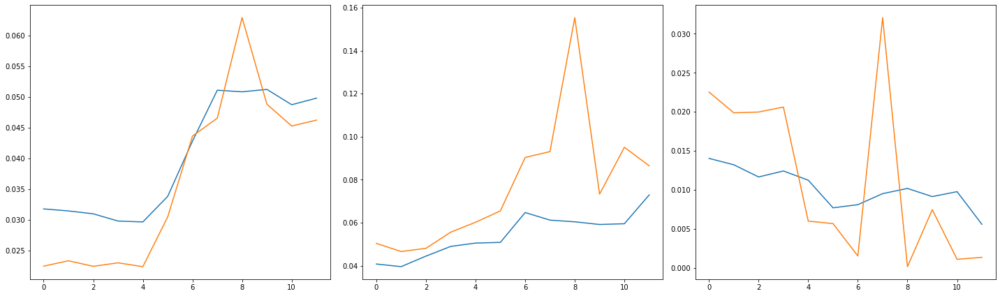

2220 582
Train Epoch: 13 [0/2220 (0%)]	Loss: 0.050150	Pres: 0.068948	F1 Score: 0.005836
105.0 -47744.0


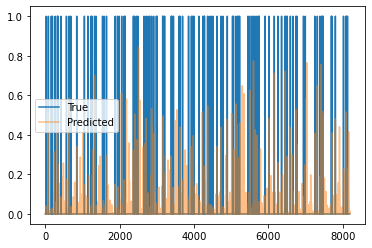

Train Epoch: 13 [10/2220 (0%)]	Loss: 0.052436	Pres: 0.066667	F1 Score: 0.002648
Train Epoch: 13 [20/2220 (0%)]	Loss: 0.046750	Pres: 0.095238	F1 Score: 0.008024
Train Epoch: 13 [30/2220 (1%)]	Loss: 0.047414	Pres: 0.067016	F1 Score: 0.007262
Train Epoch: 13 [40/2220 (1%)]	Loss: 0.046012	Pres: 0.084848	F1 Score: 0.010213
Train Epoch: 13 [50/2220 (2%)]	Loss: 0.049181	Pres: 0.085196	F1 Score: 0.007722
Train Epoch: 13 [60/2220 (2%)]	Loss: 0.051067	Pres: 0.088095	F1 Score: 0.006422
Train Epoch: 13 [70/2220 (3%)]	Loss: 0.042976	Pres: 0.060458	F1 Score: 0.003484
Train Epoch: 13 [80/2220 (3%)]	Loss: 0.052027	Pres: 0.065128	F1 Score: 0.005359
Train Epoch: 13 [90/2220 (4%)]	Loss: 0.048630	Pres: 0.074449	F1 Score: 0.006534
Train Epoch: 13 [100/2220 (4%)]	Loss: 0.046231	Pres: 0.067235	F1 Score: 0.004487
Train Epoch: 13 [110/2220 (4%)]	Loss: 0.052561	Pres: 0.087739	F1 Score: 0.005695
Train Epoch: 13 [120/2220 (5%)]	Loss: 0.049772	Pres: 0.053872	F1 Score: 0.005701
Train Epoch: 13 [130/2220 (5%)]	Loss:

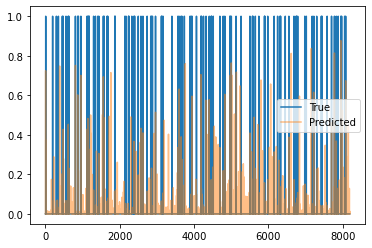

Train Epoch: 13 [310/2220 (13%)]	Loss: 0.047371	Pres: 0.060254	F1 Score: 0.006325
Train Epoch: 13 [320/2220 (14%)]	Loss: 0.048773	Pres: 0.075247	F1 Score: 0.010339
Train Epoch: 13 [330/2220 (14%)]	Loss: 0.049552	Pres: 0.083967	F1 Score: 0.009728
Train Epoch: 13 [340/2220 (15%)]	Loss: 0.046410	Pres: 0.069777	F1 Score: 0.006332
Train Epoch: 13 [350/2220 (15%)]	Loss: 0.046366	Pres: 0.060844	F1 Score: 0.006152
Train Epoch: 13 [360/2220 (16%)]	Loss: 0.046259	Pres: 0.073438	F1 Score: 0.003523
Train Epoch: 13 [370/2220 (16%)]	Loss: 0.044669	Pres: 0.063959	F1 Score: 0.004463
Train Epoch: 13 [380/2220 (17%)]	Loss: 0.049989	Pres: 0.052604	F1 Score: 0.003341
Train Epoch: 13 [390/2220 (17%)]	Loss: 0.041981	Pres: 0.065972	F1 Score: 0.003640
Train Epoch: 13 [400/2220 (18%)]	Loss: 0.049831	Pres: 0.062161	F1 Score: 0.005358
Train Epoch: 13 [410/2220 (18%)]	Loss: 0.048503	Pres: 0.040724	F1 Score: 0.001347
Train Epoch: 13 [420/2220 (18%)]	Loss: 0.044906	Pres: 0.069253	F1 Score: 0.004335
Train Epoch: 13 

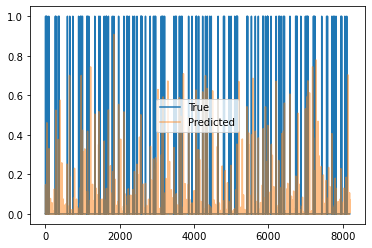

Train Epoch: 13 [610/2220 (27%)]	Loss: 0.047210	Pres: 0.089063	F1 Score: 0.009240
Train Epoch: 13 [620/2220 (27%)]	Loss: 0.051826	Pres: 0.062319	F1 Score: 0.005862
Train Epoch: 13 [630/2220 (28%)]	Loss: 0.057133	Pres: 0.041353	F1 Score: 0.002754
Train Epoch: 13 [640/2220 (28%)]	Loss: 0.046031	Pres: 0.067178	F1 Score: 0.008665
Train Epoch: 13 [650/2220 (29%)]	Loss: 0.050347	Pres: 0.066403	F1 Score: 0.006185
Train Epoch: 13 [660/2220 (29%)]	Loss: 0.045897	Pres: 0.068590	F1 Score: 0.008503
Train Epoch: 13 [670/2220 (30%)]	Loss: 0.047116	Pres: 0.053843	F1 Score: 0.005246
Train Epoch: 13 [680/2220 (30%)]	Loss: 0.050433	Pres: 0.069590	F1 Score: 0.005333
Train Epoch: 13 [690/2220 (31%)]	Loss: 0.050472	Pres: 0.065095	F1 Score: 0.006501
Train Epoch: 13 [700/2220 (31%)]	Loss: 0.048624	Pres: 0.071280	F1 Score: 0.007855
Train Epoch: 13 [710/2220 (31%)]	Loss: 0.049172	Pres: 0.084722	F1 Score: 0.008855
Train Epoch: 13 [720/2220 (32%)]	Loss: 0.043591	Pres: 0.048739	F1 Score: 0.004107
Train Epoch: 13 

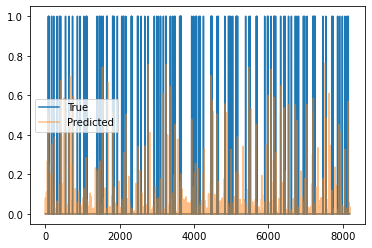

Train Epoch: 13 [910/2220 (40%)]	Loss: 0.045333	Pres: 0.064506	F1 Score: 0.007060
Train Epoch: 13 [920/2220 (41%)]	Loss: 0.051415	Pres: 0.053614	F1 Score: 0.004862
Train Epoch: 13 [930/2220 (41%)]	Loss: 0.045046	Pres: 0.069846	F1 Score: 0.013097
Train Epoch: 13 [940/2220 (42%)]	Loss: 0.048892	Pres: 0.059211	F1 Score: 0.008418
Train Epoch: 13 [950/2220 (42%)]	Loss: 0.049326	Pres: 0.053534	F1 Score: 0.011025
Train Epoch: 13 [960/2220 (43%)]	Loss: 0.044600	Pres: 0.050521	F1 Score: 0.006693
Train Epoch: 13 [970/2220 (43%)]	Loss: 0.044972	Pres: 0.063240	F1 Score: 0.010801
Train Epoch: 13 [980/2220 (44%)]	Loss: 0.051827	Pres: 0.062406	F1 Score: 0.005010
Train Epoch: 13 [990/2220 (44%)]	Loss: 0.042824	Pres: 0.066767	F1 Score: 0.017030
Train Epoch: 13 [1000/2220 (45%)]	Loss: 0.054450	Pres: 0.064815	F1 Score: 0.005661
Train Epoch: 13 [1010/2220 (45%)]	Loss: 0.045134	Pres: 0.065441	F1 Score: 0.007861
Train Epoch: 13 [1020/2220 (45%)]	Loss: 0.052042	Pres: 0.072223	F1 Score: 0.009763
Train Epoch: 

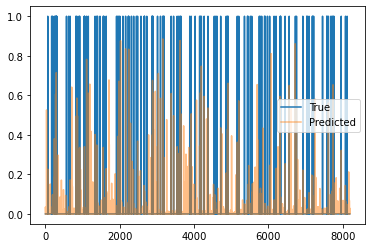

Train Epoch: 13 [1210/2220 (54%)]	Loss: 0.048330	Pres: 0.061966	F1 Score: 0.007775
Train Epoch: 13 [1220/2220 (54%)]	Loss: 0.045786	Pres: 0.044699	F1 Score: 0.004439
Train Epoch: 13 [1230/2220 (55%)]	Loss: 0.046205	Pres: 0.042929	F1 Score: 0.005138
Train Epoch: 13 [1240/2220 (55%)]	Loss: 0.043759	Pres: 0.063910	F1 Score: 0.014523
Train Epoch: 13 [1250/2220 (56%)]	Loss: 0.052971	Pres: 0.066667	F1 Score: 0.006701
Train Epoch: 13 [1260/2220 (56%)]	Loss: 0.048286	Pres: 0.070808	F1 Score: 0.011094
Train Epoch: 13 [1270/2220 (57%)]	Loss: 0.049078	Pres: 0.072531	F1 Score: 0.012996
Train Epoch: 13 [1280/2220 (57%)]	Loss: 0.043894	Pres: 0.056290	F1 Score: 0.010261
Train Epoch: 13 [1290/2220 (58%)]	Loss: 0.049560	Pres: 0.066449	F1 Score: 0.007593
Train Epoch: 13 [1300/2220 (58%)]	Loss: 0.055248	Pres: 0.060870	F1 Score: 0.005979
Train Epoch: 13 [1310/2220 (59%)]	Loss: 0.051620	Pres: 0.066106	F1 Score: 0.006114
Train Epoch: 13 [1320/2220 (59%)]	Loss: 0.051565	Pres: 0.049095	F1 Score: 0.004603
Trai

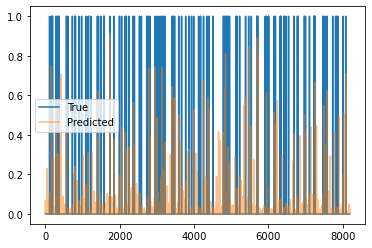

Train Epoch: 13 [1510/2220 (68%)]	Loss: 0.051769	Pres: 0.063363	F1 Score: 0.006071
Train Epoch: 13 [1520/2220 (68%)]	Loss: 0.045957	Pres: 0.069753	F1 Score: 0.006865
Train Epoch: 13 [1530/2220 (68%)]	Loss: 0.050027	Pres: 0.068752	F1 Score: 0.008581
Train Epoch: 13 [1540/2220 (69%)]	Loss: 0.055037	Pres: 0.074074	F1 Score: 0.007924
Train Epoch: 13 [1550/2220 (69%)]	Loss: 0.046237	Pres: 0.051376	F1 Score: 0.006103
Train Epoch: 13 [1560/2220 (70%)]	Loss: 0.047882	Pres: 0.061610	F1 Score: 0.010782
Train Epoch: 13 [1570/2220 (70%)]	Loss: 0.052335	Pres: 0.055683	F1 Score: 0.005129
Train Epoch: 13 [1580/2220 (71%)]	Loss: 0.041962	Pres: 0.065789	F1 Score: 0.013990
Train Epoch: 13 [1590/2220 (71%)]	Loss: 0.046335	Pres: 0.063607	F1 Score: 0.008098
Train Epoch: 13 [1600/2220 (72%)]	Loss: 0.045504	Pres: 0.058494	F1 Score: 0.009952
Train Epoch: 13 [1610/2220 (72%)]	Loss: 0.044293	Pres: 0.068627	F1 Score: 0.010007
Train Epoch: 13 [1620/2220 (72%)]	Loss: 0.052020	Pres: 0.054630	F1 Score: 0.007350
Trai

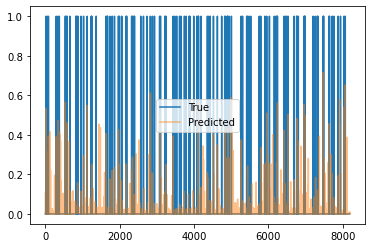

Train Epoch: 13 [1810/2220 (81%)]	Loss: 0.045221	Pres: 0.048517	F1 Score: 0.007225
Train Epoch: 13 [1820/2220 (81%)]	Loss: 0.049864	Pres: 0.069045	F1 Score: 0.010007
Train Epoch: 13 [1830/2220 (82%)]	Loss: 0.046518	Pres: 0.060140	F1 Score: 0.007502
Train Epoch: 13 [1840/2220 (82%)]	Loss: 0.051861	Pres: 0.052241	F1 Score: 0.005957
Train Epoch: 13 [1850/2220 (83%)]	Loss: 0.050086	Pres: 0.082353	F1 Score: 0.001200
Train Epoch: 13 [1860/2220 (83%)]	Loss: 0.049387	Pres: 0.051003	F1 Score: 0.007641
Train Epoch: 13 [1870/2220 (84%)]	Loss: 0.047742	Pres: 0.061851	F1 Score: 0.008322
Train Epoch: 13 [1880/2220 (84%)]	Loss: 0.050951	Pres: 0.079899	F1 Score: 0.008620
Train Epoch: 13 [1890/2220 (85%)]	Loss: 0.046750	Pres: 0.056373	F1 Score: 0.004325
Train Epoch: 13 [1900/2220 (85%)]	Loss: 0.050912	Pres: 0.063042	F1 Score: 0.008889
Train Epoch: 13 [1910/2220 (86%)]	Loss: 0.048998	Pres: 0.068056	F1 Score: 0.012624
Train Epoch: 13 [1920/2220 (86%)]	Loss: 0.047800	Pres: 0.076185	F1 Score: 0.012198
Trai

KeyboardInterrupt: 

In [11]:
# 0.01 ids, 1024 dist, average='macro'
trainer.train(debug=False)

began training
2220 582
Train Epoch: 0 [0/2220 (0%)]	Loss: 0.634465	Pres: 0.992981	F1 Score: 0.496466
115.0 -1022.0


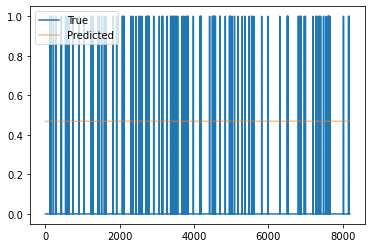

Train Epoch: 0 [10/2220 (0%)]	Loss: 0.643098	Pres: 0.143085	F1 Score: 0.112723
Train Epoch: 0 [20/2220 (0%)]	Loss: 0.502543	Pres: 0.169593	F1 Score: 0.115251
Train Epoch: 0 [30/2220 (1%)]	Loss: 0.391265	Pres: 0.141451	F1 Score: 0.047306
Train Epoch: 0 [40/2220 (1%)]	Loss: 0.305187	Pres: 0.192378	F1 Score: 0.021474
Train Epoch: 0 [50/2220 (2%)]	Loss: 0.239704	Pres: 0.198649	F1 Score: 0.007129
Train Epoch: 0 [60/2220 (2%)]	Loss: 0.199572	Pres: 0.166667	F1 Score: 0.001272
Train Epoch: 0 [70/2220 (3%)]	Loss: 0.175036	Pres: 0.333333	F1 Score: 0.000905
Train Epoch: 0 [80/2220 (3%)]	Loss: 0.149323	Pres: 0.316667	F1 Score: 0.000370
Train Epoch: 0 [90/2220 (4%)]	Loss: 0.139852	Pres: 0.333333	F1 Score: 0.000412
Train Epoch: 0 [100/2220 (4%)]	Loss: 0.127711	Pres: 0.333333	F1 Score: 0.000000
Train Epoch: 0 [110/2220 (4%)]	Loss: 0.124830	Pres: 0.285714	F1 Score: 0.000071
Train Epoch: 0 [120/2220 (5%)]	Loss: 0.104901	Pres: 0.285714	F1 Score: 0.000000
Train Epoch: 0 [130/2220 (5%)]	Loss: 0.104554	Pre

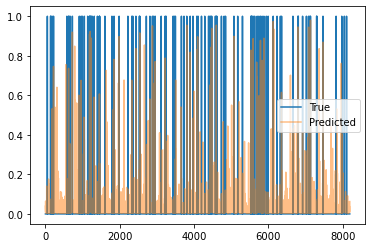

Train Epoch: 0 [310/2220 (13%)]	Loss: 0.045523	Pres: 0.116558	F1 Score: 0.017387
Train Epoch: 0 [320/2220 (14%)]	Loss: 0.048209	Pres: 0.110840	F1 Score: 0.018149
Train Epoch: 0 [330/2220 (14%)]	Loss: 0.042795	Pres: 0.112577	F1 Score: 0.020560
Train Epoch: 0 [340/2220 (15%)]	Loss: 0.044315	Pres: 0.106163	F1 Score: 0.026574
Train Epoch: 0 [350/2220 (15%)]	Loss: 0.045552	Pres: 0.104832	F1 Score: 0.021484
Train Epoch: 0 [360/2220 (16%)]	Loss: 0.042720	Pres: 0.097507	F1 Score: 0.020577
Train Epoch: 0 [370/2220 (16%)]	Loss: 0.042543	Pres: 0.116762	F1 Score: 0.016760
Train Epoch: 0 [380/2220 (17%)]	Loss: 0.040047	Pres: 0.110690	F1 Score: 0.023720
Train Epoch: 0 [390/2220 (17%)]	Loss: 0.040306	Pres: 0.108240	F1 Score: 0.024823
Train Epoch: 0 [400/2220 (18%)]	Loss: 0.034262	Pres: 0.111252	F1 Score: 0.018701
Train Epoch: 0 [410/2220 (18%)]	Loss: 0.039167	Pres: 0.101190	F1 Score: 0.008353
Train Epoch: 0 [420/2220 (18%)]	Loss: 0.040709	Pres: 0.115238	F1 Score: 0.026905
Train Epoch: 0 [430/2220 (19

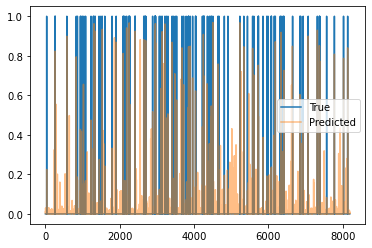

Train Epoch: 0 [610/2220 (27%)]	Loss: 0.029168	Pres: 0.105349	F1 Score: 0.031757
Train Epoch: 0 [620/2220 (27%)]	Loss: 0.024679	Pres: 0.091589	F1 Score: 0.023510
Train Epoch: 0 [630/2220 (28%)]	Loss: 0.030272	Pres: 0.100427	F1 Score: 0.029865
Train Epoch: 0 [640/2220 (28%)]	Loss: 0.027009	Pres: 0.095765	F1 Score: 0.017676
Train Epoch: 0 [650/2220 (29%)]	Loss: 0.025103	Pres: 0.096400	F1 Score: 0.023177
Train Epoch: 0 [660/2220 (29%)]	Loss: 0.025044	Pres: 0.106198	F1 Score: 0.021343
Train Epoch: 0 [670/2220 (30%)]	Loss: 0.026594	Pres: 0.087467	F1 Score: 0.027307
Train Epoch: 0 [680/2220 (30%)]	Loss: 0.024075	Pres: 0.105420	F1 Score: 0.032660
Train Epoch: 0 [690/2220 (31%)]	Loss: 0.023385	Pres: 0.086389	F1 Score: 0.023184
Train Epoch: 0 [700/2220 (31%)]	Loss: 0.024515	Pres: 0.106998	F1 Score: 0.030812
Train Epoch: 0 [710/2220 (31%)]	Loss: 0.024326	Pres: 0.085031	F1 Score: 0.020457
Train Epoch: 0 [720/2220 (32%)]	Loss: 0.025118	Pres: 0.077398	F1 Score: 0.021382
Train Epoch: 0 [730/2220 (32

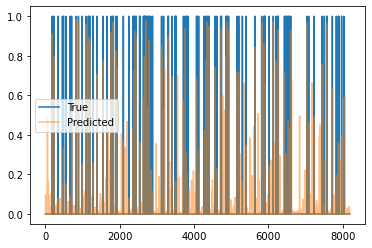

Train Epoch: 0 [910/2220 (40%)]	Loss: 0.020808	Pres: 0.097326	F1 Score: 0.028843
Train Epoch: 0 [920/2220 (41%)]	Loss: 0.021726	Pres: 0.074712	F1 Score: 0.016318
Train Epoch: 0 [930/2220 (41%)]	Loss: 0.021800	Pres: 0.083004	F1 Score: 0.023386
Train Epoch: 0 [940/2220 (42%)]	Loss: 0.025299	Pres: 0.087407	F1 Score: 0.026292
Train Epoch: 0 [950/2220 (42%)]	Loss: 0.021031	Pres: 0.094767	F1 Score: 0.021805
Train Epoch: 0 [960/2220 (43%)]	Loss: 0.024428	Pres: 0.081669	F1 Score: 0.017460
Train Epoch: 0 [970/2220 (43%)]	Loss: 0.020943	Pres: 0.077115	F1 Score: 0.018007
Train Epoch: 0 [980/2220 (44%)]	Loss: 0.021606	Pres: 0.066293	F1 Score: 0.017340
Train Epoch: 0 [990/2220 (44%)]	Loss: 0.021678	Pres: 0.079667	F1 Score: 0.016199
Train Epoch: 0 [1000/2220 (45%)]	Loss: 0.018908	Pres: 0.075769	F1 Score: 0.018583
Train Epoch: 0 [1010/2220 (45%)]	Loss: 0.021446	Pres: 0.072479	F1 Score: 0.012808
Train Epoch: 0 [1020/2220 (45%)]	Loss: 0.023130	Pres: 0.088254	F1 Score: 0.027538
Train Epoch: 0 [1030/2220

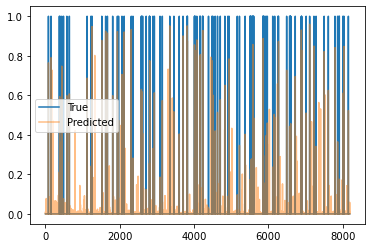

Train Epoch: 0 [1210/2220 (54%)]	Loss: 0.018548	Pres: 0.079108	F1 Score: 0.022485
Train Epoch: 0 [1220/2220 (54%)]	Loss: 0.023601	Pres: 0.072795	F1 Score: 0.016896
Train Epoch: 0 [1230/2220 (55%)]	Loss: 0.019978	Pres: 0.074892	F1 Score: 0.019937
Train Epoch: 0 [1240/2220 (55%)]	Loss: 0.020250	Pres: 0.072180	F1 Score: 0.015433
Train Epoch: 0 [1250/2220 (56%)]	Loss: 0.018159	Pres: 0.083566	F1 Score: 0.024624
Train Epoch: 0 [1260/2220 (56%)]	Loss: 0.017927	Pres: 0.068502	F1 Score: 0.015592
Train Epoch: 0 [1270/2220 (57%)]	Loss: 0.021884	Pres: 0.062814	F1 Score: 0.014112
Train Epoch: 0 [1280/2220 (57%)]	Loss: 0.023118	Pres: 0.074786	F1 Score: 0.016750
Train Epoch: 0 [1290/2220 (58%)]	Loss: 0.017923	Pres: 0.071709	F1 Score: 0.021403
Train Epoch: 0 [1300/2220 (58%)]	Loss: 0.020584	Pres: 0.068846	F1 Score: 0.016516
Train Epoch: 0 [1310/2220 (59%)]	Loss: 0.019641	Pres: 0.061497	F1 Score: 0.012670
Train Epoch: 0 [1320/2220 (59%)]	Loss: 0.016791	Pres: 0.058855	F1 Score: 0.011189
Train Epoch: 0 [

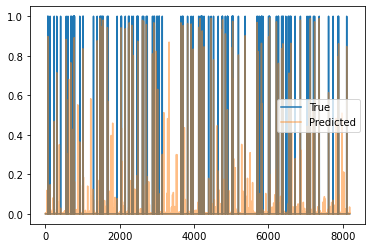

Train Epoch: 0 [1510/2220 (68%)]	Loss: 0.017841	Pres: 0.060420	F1 Score: 0.012435
Train Epoch: 0 [1520/2220 (68%)]	Loss: 0.016022	Pres: 0.062757	F1 Score: 0.009606
Train Epoch: 0 [1530/2220 (68%)]	Loss: 0.016868	Pres: 0.065357	F1 Score: 0.015496
Train Epoch: 0 [1540/2220 (69%)]	Loss: 0.015906	Pres: 0.054879	F1 Score: 0.014086
Train Epoch: 0 [1550/2220 (69%)]	Loss: 0.016483	Pres: 0.063492	F1 Score: 0.012547
Train Epoch: 0 [1560/2220 (70%)]	Loss: 0.017528	Pres: 0.061625	F1 Score: 0.016742
Train Epoch: 0 [1570/2220 (70%)]	Loss: 0.016335	Pres: 0.056667	F1 Score: 0.012823
Train Epoch: 0 [1580/2220 (71%)]	Loss: 0.015942	Pres: 0.050392	F1 Score: 0.011309
Train Epoch: 0 [1590/2220 (71%)]	Loss: 0.017535	Pres: 0.048351	F1 Score: 0.009649
Train Epoch: 0 [1600/2220 (72%)]	Loss: 0.015559	Pres: 0.063981	F1 Score: 0.009441
Train Epoch: 0 [1610/2220 (72%)]	Loss: 0.020829	Pres: 0.057255	F1 Score: 0.014930
Train Epoch: 0 [1620/2220 (72%)]	Loss: 0.018364	Pres: 0.057734	F1 Score: 0.012821
Train Epoch: 0 [

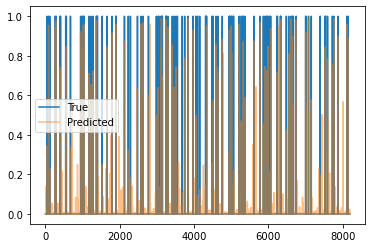

Train Epoch: 0 [1810/2220 (81%)]	Loss: 0.018201	Pres: 0.041182	F1 Score: 0.008795
Train Epoch: 0 [1820/2220 (81%)]	Loss: 0.020480	Pres: 0.031469	F1 Score: 0.004931
Train Epoch: 0 [1830/2220 (82%)]	Loss: 0.015230	Pres: 0.039606	F1 Score: 0.008892
Train Epoch: 0 [1840/2220 (82%)]	Loss: 0.015183	Pres: 0.039466	F1 Score: 0.007401
Train Epoch: 0 [1850/2220 (83%)]	Loss: 0.019881	Pres: 0.045573	F1 Score: 0.009733
Train Epoch: 0 [1860/2220 (83%)]	Loss: 0.019093	Pres: 0.034578	F1 Score: 0.007436
Train Epoch: 0 [1870/2220 (84%)]	Loss: 0.018189	Pres: 0.040850	F1 Score: 0.008222
Train Epoch: 0 [1880/2220 (84%)]	Loss: 0.017956	Pres: 0.043867	F1 Score: 0.012570
Train Epoch: 0 [1890/2220 (85%)]	Loss: 0.017460	Pres: 0.047836	F1 Score: 0.011786
Train Epoch: 0 [1900/2220 (85%)]	Loss: 0.014889	Pres: 0.037255	F1 Score: 0.008739
Train Epoch: 0 [1910/2220 (86%)]	Loss: 0.017885	Pres: 0.038500	F1 Score: 0.008408
Train Epoch: 0 [1920/2220 (86%)]	Loss: 0.014310	Pres: 0.042677	F1 Score: 0.007082
Train Epoch: 0 [

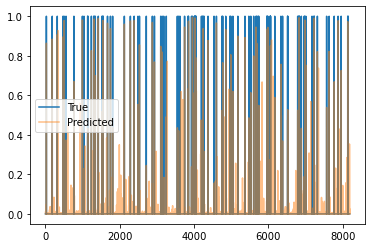

Train Epoch: 0 [2110/2220 (95%)]	Loss: 0.014094	Pres: 0.034722	F1 Score: 0.006445
Train Epoch: 0 [2120/2220 (95%)]	Loss: 0.016941	Pres: 0.033562	F1 Score: 0.006180
Train Epoch: 0 [2130/2220 (95%)]	Loss: 0.014922	Pres: 0.041228	F1 Score: 0.006587
Train Epoch: 0 [2140/2220 (96%)]	Loss: 0.013859	Pres: 0.033356	F1 Score: 0.007782
Train Epoch: 0 [2150/2220 (96%)]	Loss: 0.017478	Pres: 0.034040	F1 Score: 0.007088
Train Epoch: 0 [2160/2220 (97%)]	Loss: 0.017722	Pres: 0.032924	F1 Score: 0.008223
Train Epoch: 0 [2170/2220 (97%)]	Loss: 0.014088	Pres: 0.020057	F1 Score: 0.004188
Train Epoch: 0 [2180/2220 (98%)]	Loss: 0.014857	Pres: 0.033000	F1 Score: 0.006442
Train Epoch: 0 [2190/2220 (98%)]	Loss: 0.015193	Pres: 0.033399	F1 Score: 0.005333
Train Epoch: 0 [2200/2220 (99%)]	Loss: 0.014641	Pres: 0.033934	F1 Score: 0.006823
Train Epoch: 0 [2210/2220 (99%)]	Loss: 0.013376	Pres: 0.029250	F1 Score: 0.005936
Validation Epoch: 0 [0/582 (0%)]	Loss: 0.011645	Pres: 0.036905	F1 Score: 0.004932


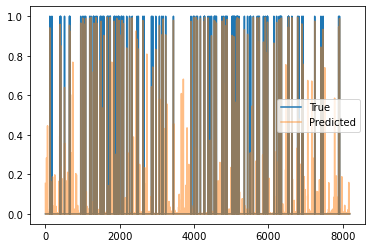

Validation Epoch: 0 [10/582 (1%)]	Loss: 0.011756	Pres: 0.033578	F1 Score: 0.004487
Validation Epoch: 0 [20/582 (3%)]	Loss: 0.015520	Pres: 0.032882	F1 Score: 0.005306
Validation Epoch: 0 [30/582 (5%)]	Loss: 0.011452	Pres: 0.033616	F1 Score: 0.004802
Validation Epoch: 0 [40/582 (6%)]	Loss: 0.011419	Pres: 0.039329	F1 Score: 0.008389
Validation Epoch: 0 [50/582 (8%)]	Loss: 0.011024	Pres: 0.037254	F1 Score: 0.006309
Validation Epoch: 0 [60/582 (10%)]	Loss: 0.013848	Pres: 0.030926	F1 Score: 0.003294
Validation Epoch: 0 [70/582 (12%)]	Loss: 0.010724	Pres: 0.030051	F1 Score: 0.005602
Validation Epoch: 0 [80/582 (13%)]	Loss: 0.012146	Pres: 0.032986	F1 Score: 0.003154
Validation Epoch: 0 [90/582 (15%)]	Loss: 0.011996	Pres: 0.039592	F1 Score: 0.005311
Validation Epoch: 0 [100/582 (17%)]	Loss: 0.011874	Pres: 0.040185	F1 Score: 0.005704
Validation Epoch: 0 [110/582 (18%)]	Loss: 0.012768	Pres: 0.038515	F1 Score: 0.004601
Validation Epoch: 0 [120/582 (20%)]	Loss: 0.013646	Pres: 0.032719	F1 Score: 0.0

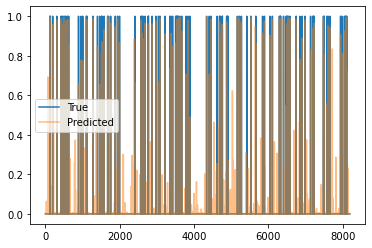

Validation Epoch: 0 [310/582 (53%)]	Loss: 0.013829	Pres: 0.035397	F1 Score: 0.006376
Validation Epoch: 0 [320/582 (54%)]	Loss: 0.009810	Pres: 0.040280	F1 Score: 0.006711
Validation Epoch: 0 [330/582 (56%)]	Loss: 0.012197	Pres: 0.035723	F1 Score: 0.005939
Validation Epoch: 0 [340/582 (58%)]	Loss: 0.012390	Pres: 0.037037	F1 Score: 0.004956
Validation Epoch: 0 [350/582 (60%)]	Loss: 0.011583	Pres: 0.031763	F1 Score: 0.004144
Validation Epoch: 0 [360/582 (61%)]	Loss: 0.012939	Pres: 0.039713	F1 Score: 0.005188
Validation Epoch: 0 [370/582 (63%)]	Loss: 0.011745	Pres: 0.033804	F1 Score: 0.005329
Validation Epoch: 0 [380/582 (65%)]	Loss: 0.013938	Pres: 0.035764	F1 Score: 0.007978
Validation Epoch: 0 [390/582 (67%)]	Loss: 0.011185	Pres: 0.033670	F1 Score: 0.003558
Validation Epoch: 0 [400/582 (68%)]	Loss: 0.013258	Pres: 0.030356	F1 Score: 0.003633
Validation Epoch: 0 [410/582 (70%)]	Loss: 0.012658	Pres: 0.033451	F1 Score: 0.004689
Validation Epoch: 0 [420/582 (72%)]	Loss: 0.014583	Pres: 0.029493

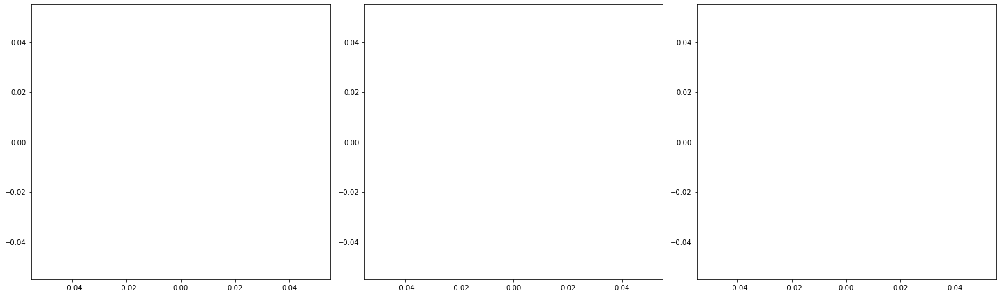

2220 582
Train Epoch: 1 [0/2220 (0%)]	Loss: 0.016308	Pres: 0.035417	F1 Score: 0.007020
94.0 -inf


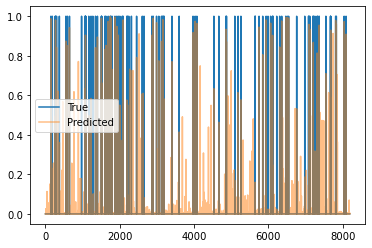

Train Epoch: 1 [10/2220 (0%)]	Loss: 0.013774	Pres: 0.031818	F1 Score: 0.007596
Train Epoch: 1 [20/2220 (0%)]	Loss: 0.013816	Pres: 0.037071	F1 Score: 0.006619
Train Epoch: 1 [30/2220 (1%)]	Loss: 0.015755	Pres: 0.028825	F1 Score: 0.005795
Train Epoch: 1 [40/2220 (1%)]	Loss: 0.014297	Pres: 0.037647	F1 Score: 0.005628
Train Epoch: 1 [50/2220 (2%)]	Loss: 0.014860	Pres: 0.038435	F1 Score: 0.008093
Train Epoch: 1 [60/2220 (2%)]	Loss: 0.013829	Pres: 0.030295	F1 Score: 0.007558
Train Epoch: 1 [70/2220 (3%)]	Loss: 0.018773	Pres: 0.028128	F1 Score: 0.006151
Train Epoch: 1 [80/2220 (3%)]	Loss: 0.016600	Pres: 0.023384	F1 Score: 0.004394
Train Epoch: 1 [90/2220 (4%)]	Loss: 0.017731	Pres: 0.033868	F1 Score: 0.007701
Train Epoch: 1 [100/2220 (4%)]	Loss: 0.018139	Pres: 0.032517	F1 Score: 0.006925
Train Epoch: 1 [110/2220 (4%)]	Loss: 0.013264	Pres: 0.028780	F1 Score: 0.008658
Train Epoch: 1 [120/2220 (5%)]	Loss: 0.015841	Pres: 0.022578	F1 Score: 0.002627
Train Epoch: 1 [130/2220 (5%)]	Loss: 0.016928	Pre

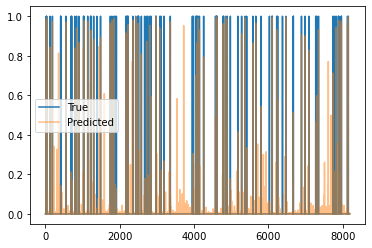

Train Epoch: 1 [310/2220 (13%)]	Loss: 0.013354	Pres: 0.024791	F1 Score: 0.003510
Train Epoch: 1 [320/2220 (14%)]	Loss: 0.013609	Pres: 0.027915	F1 Score: 0.006721
Train Epoch: 1 [330/2220 (14%)]	Loss: 0.012791	Pres: 0.023810	F1 Score: 0.003798
Train Epoch: 1 [340/2220 (15%)]	Loss: 0.015745	Pres: 0.030470	F1 Score: 0.004008
Train Epoch: 1 [350/2220 (15%)]	Loss: 0.014820	Pres: 0.026777	F1 Score: 0.006296
Train Epoch: 1 [360/2220 (16%)]	Loss: 0.018129	Pres: 0.024080	F1 Score: 0.004724
Train Epoch: 1 [370/2220 (16%)]	Loss: 0.013964	Pres: 0.019626	F1 Score: 0.004899
Train Epoch: 1 [380/2220 (17%)]	Loss: 0.016469	Pres: 0.027894	F1 Score: 0.005568
Train Epoch: 1 [390/2220 (17%)]	Loss: 0.016685	Pres: 0.030424	F1 Score: 0.004314
Train Epoch: 1 [400/2220 (18%)]	Loss: 0.014054	Pres: 0.030269	F1 Score: 0.006111
Train Epoch: 1 [410/2220 (18%)]	Loss: 0.015192	Pres: 0.027457	F1 Score: 0.007166
Train Epoch: 1 [420/2220 (18%)]	Loss: 0.013077	Pres: 0.027477	F1 Score: 0.005887
Train Epoch: 1 [430/2220 (19

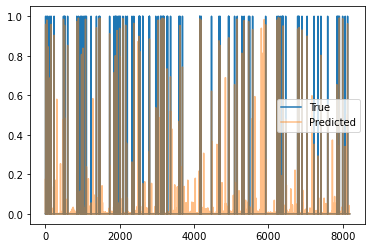

Train Epoch: 1 [610/2220 (27%)]	Loss: 0.011568	Pres: 0.027320	F1 Score: 0.005415
Train Epoch: 1 [620/2220 (27%)]	Loss: 0.015726	Pres: 0.023692	F1 Score: 0.004799
Train Epoch: 1 [630/2220 (28%)]	Loss: 0.015756	Pres: 0.019643	F1 Score: 0.003706
Train Epoch: 1 [640/2220 (28%)]	Loss: 0.015964	Pres: 0.020775	F1 Score: 0.002663
Train Epoch: 1 [650/2220 (29%)]	Loss: 0.016236	Pres: 0.025931	F1 Score: 0.005689
Train Epoch: 1 [660/2220 (29%)]	Loss: 0.012953	Pres: 0.027444	F1 Score: 0.005134
Train Epoch: 1 [670/2220 (30%)]	Loss: 0.013387	Pres: 0.026709	F1 Score: 0.004841
Train Epoch: 1 [680/2220 (30%)]	Loss: 0.014698	Pres: 0.028322	F1 Score: 0.004758
Train Epoch: 1 [690/2220 (31%)]	Loss: 0.013097	Pres: 0.018942	F1 Score: 0.002519
Train Epoch: 1 [700/2220 (31%)]	Loss: 0.014084	Pres: 0.026139	F1 Score: 0.003831
Train Epoch: 1 [710/2220 (31%)]	Loss: 0.011537	Pres: 0.021003	F1 Score: 0.002585
Train Epoch: 1 [720/2220 (32%)]	Loss: 0.014650	Pres: 0.024566	F1 Score: 0.003501
Train Epoch: 1 [730/2220 (32

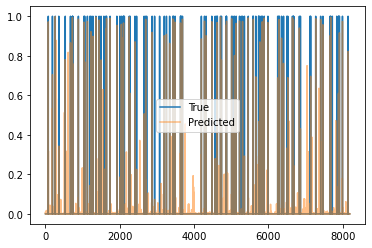

Train Epoch: 1 [910/2220 (40%)]	Loss: 0.013029	Pres: 0.025348	F1 Score: 0.004096
Train Epoch: 1 [920/2220 (41%)]	Loss: 0.012705	Pres: 0.019876	F1 Score: 0.002919
Train Epoch: 1 [930/2220 (41%)]	Loss: 0.012536	Pres: 0.019125	F1 Score: 0.003277
Train Epoch: 1 [940/2220 (42%)]	Loss: 0.012186	Pres: 0.019413	F1 Score: 0.002413
Train Epoch: 1 [950/2220 (42%)]	Loss: 0.013479	Pres: 0.024272	F1 Score: 0.004376
Train Epoch: 1 [960/2220 (43%)]	Loss: 0.011926	Pres: 0.019330	F1 Score: 0.003089
Train Epoch: 1 [970/2220 (43%)]	Loss: 0.011585	Pres: 0.022084	F1 Score: 0.003128
Train Epoch: 1 [980/2220 (44%)]	Loss: 0.016483	Pres: 0.020178	F1 Score: 0.003283
Train Epoch: 1 [990/2220 (44%)]	Loss: 0.010731	Pres: 0.019789	F1 Score: 0.003016
Train Epoch: 1 [1000/2220 (45%)]	Loss: 0.014211	Pres: 0.023268	F1 Score: 0.004030
Train Epoch: 1 [1010/2220 (45%)]	Loss: 0.014522	Pres: 0.020178	F1 Score: 0.004235
Train Epoch: 1 [1020/2220 (45%)]	Loss: 0.014508	Pres: 0.019617	F1 Score: 0.004599
Train Epoch: 1 [1030/2220

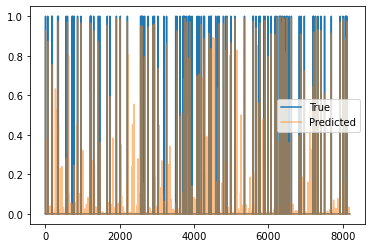

Train Epoch: 1 [1210/2220 (54%)]	Loss: 0.013827	Pres: 0.023179	F1 Score: 0.005143
Train Epoch: 1 [1220/2220 (54%)]	Loss: 0.014017	Pres: 0.017210	F1 Score: 0.002946
Train Epoch: 1 [1230/2220 (55%)]	Loss: 0.015328	Pres: 0.018675	F1 Score: 0.003542
Train Epoch: 1 [1240/2220 (55%)]	Loss: 0.013673	Pres: 0.019360	F1 Score: 0.003121
Train Epoch: 1 [1250/2220 (56%)]	Loss: 0.013029	Pres: 0.017433	F1 Score: 0.004005
Train Epoch: 1 [1260/2220 (56%)]	Loss: 0.013359	Pres: 0.019457	F1 Score: 0.003768
Train Epoch: 1 [1270/2220 (57%)]	Loss: 0.010610	Pres: 0.016368	F1 Score: 0.003749
Train Epoch: 1 [1280/2220 (57%)]	Loss: 0.013510	Pres: 0.018590	F1 Score: 0.002620
Train Epoch: 1 [1290/2220 (58%)]	Loss: 0.015963	Pres: 0.016335	F1 Score: 0.001578
Train Epoch: 1 [1300/2220 (58%)]	Loss: 0.013836	Pres: 0.016414	F1 Score: 0.002918
Train Epoch: 1 [1310/2220 (59%)]	Loss: 0.014241	Pres: 0.016648	F1 Score: 0.003714
Train Epoch: 1 [1320/2220 (59%)]	Loss: 0.011846	Pres: 0.017487	F1 Score: 0.002308
Train Epoch: 1 [

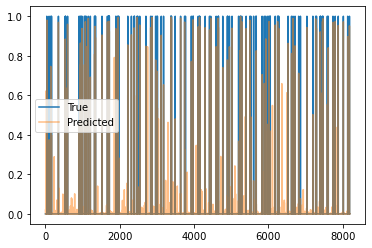

Train Epoch: 1 [1510/2220 (68%)]	Loss: 0.012609	Pres: 0.024101	F1 Score: 0.004257
Train Epoch: 1 [1520/2220 (68%)]	Loss: 0.015666	Pres: 0.015657	F1 Score: 0.002631
Train Epoch: 1 [1530/2220 (68%)]	Loss: 0.016506	Pres: 0.018279	F1 Score: 0.003051
Train Epoch: 1 [1540/2220 (69%)]	Loss: 0.011579	Pres: 0.019246	F1 Score: 0.003715
Train Epoch: 1 [1550/2220 (69%)]	Loss: 0.010658	Pres: 0.021444	F1 Score: 0.005006
Train Epoch: 1 [1560/2220 (70%)]	Loss: 0.011030	Pres: 0.016711	F1 Score: 0.003242
Train Epoch: 1 [1570/2220 (70%)]	Loss: 0.011615	Pres: 0.018701	F1 Score: 0.003742
Train Epoch: 1 [1580/2220 (71%)]	Loss: 0.012953	Pres: 0.018037	F1 Score: 0.002677
Train Epoch: 1 [1590/2220 (71%)]	Loss: 0.011685	Pres: 0.017943	F1 Score: 0.003184
Train Epoch: 1 [1600/2220 (72%)]	Loss: 0.011739	Pres: 0.017164	F1 Score: 0.003445
Train Epoch: 1 [1610/2220 (72%)]	Loss: 0.014030	Pres: 0.021154	F1 Score: 0.001757
Train Epoch: 1 [1620/2220 (72%)]	Loss: 0.012651	Pres: 0.018315	F1 Score: 0.003088
Train Epoch: 1 [

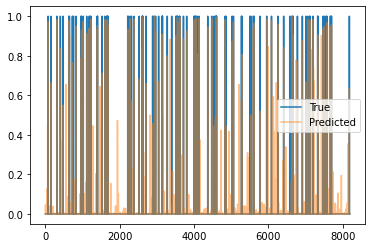

Train Epoch: 1 [1810/2220 (81%)]	Loss: 0.011580	Pres: 0.017413	F1 Score: 0.002140
Train Epoch: 1 [1820/2220 (81%)]	Loss: 0.010489	Pres: 0.016892	F1 Score: 0.003932
Train Epoch: 1 [1830/2220 (82%)]	Loss: 0.009922	Pres: 0.017859	F1 Score: 0.003453
Train Epoch: 1 [1840/2220 (82%)]	Loss: 0.015038	Pres: 0.017270	F1 Score: 0.002983
Train Epoch: 1 [1850/2220 (83%)]	Loss: 0.013550	Pres: 0.021856	F1 Score: 0.003357
Train Epoch: 1 [1860/2220 (83%)]	Loss: 0.014169	Pres: 0.020372	F1 Score: 0.003186
Train Epoch: 1 [1870/2220 (84%)]	Loss: 0.013554	Pres: 0.012803	F1 Score: 0.002093
Train Epoch: 1 [1880/2220 (84%)]	Loss: 0.010604	Pres: 0.020370	F1 Score: 0.003592
Train Epoch: 1 [1890/2220 (85%)]	Loss: 0.010716	Pres: 0.019338	F1 Score: 0.002317
Train Epoch: 1 [1900/2220 (85%)]	Loss: 0.015611	Pres: 0.013747	F1 Score: 0.002206
Train Epoch: 1 [1910/2220 (86%)]	Loss: 0.012654	Pres: 0.018983	F1 Score: 0.002197
Train Epoch: 1 [1920/2220 (86%)]	Loss: 0.014327	Pres: 0.016070	F1 Score: 0.002217
Train Epoch: 1 [

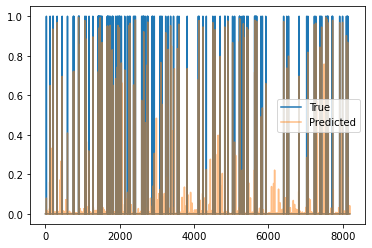

Train Epoch: 1 [2110/2220 (95%)]	Loss: 0.009541	Pres: 0.014145	F1 Score: 0.002121
Train Epoch: 1 [2120/2220 (95%)]	Loss: 0.014205	Pres: 0.018139	F1 Score: 0.002592
Train Epoch: 1 [2130/2220 (95%)]	Loss: 0.017015	Pres: 0.021813	F1 Score: 0.005546
Train Epoch: 1 [2140/2220 (96%)]	Loss: 0.012911	Pres: 0.018653	F1 Score: 0.003798
Train Epoch: 1 [2150/2220 (96%)]	Loss: 0.012682	Pres: 0.020202	F1 Score: 0.002347
Train Epoch: 1 [2160/2220 (97%)]	Loss: 0.010697	Pres: 0.022494	F1 Score: 0.005132
Train Epoch: 1 [2170/2220 (97%)]	Loss: 0.010908	Pres: 0.015427	F1 Score: 0.004294
Train Epoch: 1 [2180/2220 (98%)]	Loss: 0.010429	Pres: 0.019872	F1 Score: 0.002868
Train Epoch: 1 [2190/2220 (98%)]	Loss: 0.010319	Pres: 0.024162	F1 Score: 0.003199
Train Epoch: 1 [2200/2220 (99%)]	Loss: 0.014032	Pres: 0.020454	F1 Score: 0.003593
Train Epoch: 1 [2210/2220 (99%)]	Loss: 0.010750	Pres: 0.016887	F1 Score: 0.002323
Validation Epoch: 1 [0/582 (0%)]	Loss: 0.006175	Pres: 0.023977	F1 Score: 0.004140


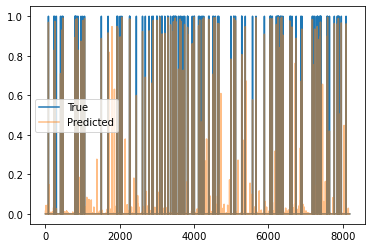

Validation Epoch: 1 [10/582 (1%)]	Loss: 0.007970	Pres: 0.021267	F1 Score: 0.003182
Validation Epoch: 1 [20/582 (3%)]	Loss: 0.007261	Pres: 0.023972	F1 Score: 0.003496
Validation Epoch: 1 [30/582 (5%)]	Loss: 0.005327	Pres: 0.026225	F1 Score: 0.003103
Validation Epoch: 1 [40/582 (6%)]	Loss: 0.007936	Pres: 0.023810	F1 Score: 0.003534
Validation Epoch: 1 [50/582 (8%)]	Loss: 0.008446	Pres: 0.025132	F1 Score: 0.004083
Validation Epoch: 1 [60/582 (10%)]	Loss: 0.009973	Pres: 0.017619	F1 Score: 0.002365
Validation Epoch: 1 [70/582 (12%)]	Loss: 0.008342	Pres: 0.028643	F1 Score: 0.005948
Validation Epoch: 1 [80/582 (13%)]	Loss: 0.007469	Pres: 0.025694	F1 Score: 0.004745
Validation Epoch: 1 [90/582 (15%)]	Loss: 0.008823	Pres: 0.026841	F1 Score: 0.003428
Validation Epoch: 1 [100/582 (17%)]	Loss: 0.007106	Pres: 0.028772	F1 Score: 0.003423
Validation Epoch: 1 [110/582 (18%)]	Loss: 0.007453	Pres: 0.021958	F1 Score: 0.004582
Validation Epoch: 1 [120/582 (20%)]	Loss: 0.007724	Pres: 0.029896	F1 Score: 0.0

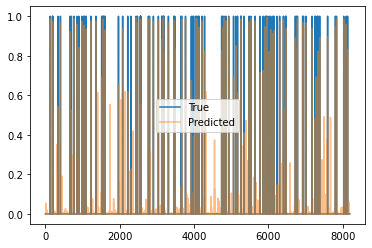

Validation Epoch: 1 [310/582 (53%)]	Loss: 0.008273	Pres: 0.032421	F1 Score: 0.004726
Validation Epoch: 1 [320/582 (54%)]	Loss: 0.007759	Pres: 0.020144	F1 Score: 0.002992
Validation Epoch: 1 [330/582 (56%)]	Loss: 0.007591	Pres: 0.025085	F1 Score: 0.003184
Validation Epoch: 1 [340/582 (58%)]	Loss: 0.007998	Pres: 0.027500	F1 Score: 0.004117
Validation Epoch: 1 [350/582 (60%)]	Loss: 0.008080	Pres: 0.029565	F1 Score: 0.005933
Validation Epoch: 1 [360/582 (61%)]	Loss: 0.007206	Pres: 0.029412	F1 Score: 0.003287
Validation Epoch: 1 [370/582 (63%)]	Loss: 0.007940	Pres: 0.030556	F1 Score: 0.004030
Validation Epoch: 1 [380/582 (65%)]	Loss: 0.008225	Pres: 0.025265	F1 Score: 0.003766
Validation Epoch: 1 [390/582 (67%)]	Loss: 0.009693	Pres: 0.029657	F1 Score: 0.004599
Validation Epoch: 1 [400/582 (68%)]	Loss: 0.005796	Pres: 0.028956	F1 Score: 0.005594
Validation Epoch: 1 [410/582 (70%)]	Loss: 0.007422	Pres: 0.029680	F1 Score: 0.002754
Validation Epoch: 1 [420/582 (72%)]	Loss: 0.007430	Pres: 0.031350

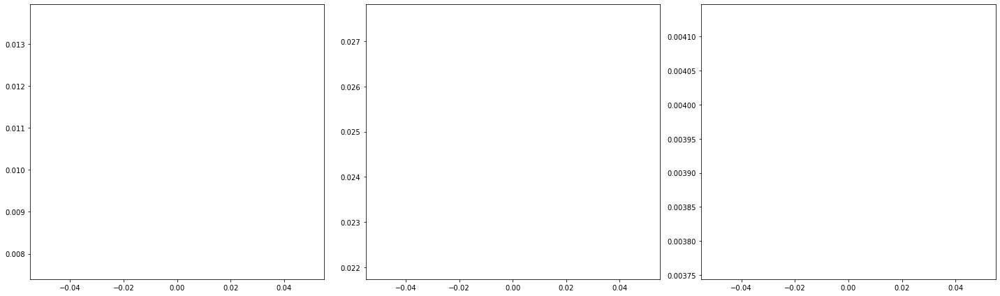

2220 582
Train Epoch: 2 [0/2220 (0%)]	Loss: 0.011454	Pres: 0.020052	F1 Score: 0.004361
117.0 -inf


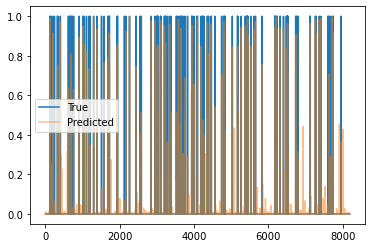

Train Epoch: 2 [10/2220 (0%)]	Loss: 0.013337	Pres: 0.017783	F1 Score: 0.002789
Train Epoch: 2 [20/2220 (0%)]	Loss: 0.013645	Pres: 0.016667	F1 Score: 0.001891
Train Epoch: 2 [30/2220 (1%)]	Loss: 0.012001	Pres: 0.018750	F1 Score: 0.004859
Train Epoch: 2 [40/2220 (1%)]	Loss: 0.011046	Pres: 0.021722	F1 Score: 0.002631
Train Epoch: 2 [50/2220 (2%)]	Loss: 0.016420	Pres: 0.019061	F1 Score: 0.003599
Train Epoch: 2 [60/2220 (2%)]	Loss: 0.013844	Pres: 0.021741	F1 Score: 0.003267
Train Epoch: 2 [70/2220 (3%)]	Loss: 0.013222	Pres: 0.022792	F1 Score: 0.003733
Train Epoch: 2 [80/2220 (3%)]	Loss: 0.009378	Pres: 0.021408	F1 Score: 0.005326
Train Epoch: 2 [90/2220 (4%)]	Loss: 0.013985	Pres: 0.019905	F1 Score: 0.002718
Train Epoch: 2 [100/2220 (4%)]	Loss: 0.012519	Pres: 0.021472	F1 Score: 0.003376
Train Epoch: 2 [110/2220 (4%)]	Loss: 0.010117	Pres: 0.016717	F1 Score: 0.003547
Train Epoch: 2 [120/2220 (5%)]	Loss: 0.010668	Pres: 0.021774	F1 Score: 0.004039
Train Epoch: 2 [130/2220 (5%)]	Loss: 0.010499	Pre

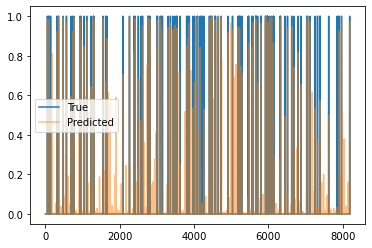

Train Epoch: 2 [310/2220 (13%)]	Loss: 0.012247	Pres: 0.016934	F1 Score: 0.001956
Train Epoch: 2 [320/2220 (14%)]	Loss: 0.011462	Pres: 0.023140	F1 Score: 0.004066
Train Epoch: 2 [330/2220 (14%)]	Loss: 0.012437	Pres: 0.022051	F1 Score: 0.005205
Train Epoch: 2 [340/2220 (15%)]	Loss: 0.015183	Pres: 0.019548	F1 Score: 0.003021
Train Epoch: 2 [350/2220 (15%)]	Loss: 0.012816	Pres: 0.020942	F1 Score: 0.003912
Train Epoch: 2 [360/2220 (16%)]	Loss: 0.012642	Pres: 0.021871	F1 Score: 0.004013
Train Epoch: 2 [370/2220 (16%)]	Loss: 0.008843	Pres: 0.026016	F1 Score: 0.004796
Train Epoch: 2 [380/2220 (17%)]	Loss: 0.011264	Pres: 0.011561	F1 Score: 0.002134
Train Epoch: 2 [390/2220 (17%)]	Loss: 0.013006	Pres: 0.021806	F1 Score: 0.006006
Train Epoch: 2 [400/2220 (18%)]	Loss: 0.010113	Pres: 0.014528	F1 Score: 0.003151
Train Epoch: 2 [410/2220 (18%)]	Loss: 0.011280	Pres: 0.020749	F1 Score: 0.004697
Train Epoch: 2 [420/2220 (18%)]	Loss: 0.011915	Pres: 0.018375	F1 Score: 0.002261
Train Epoch: 2 [430/2220 (19

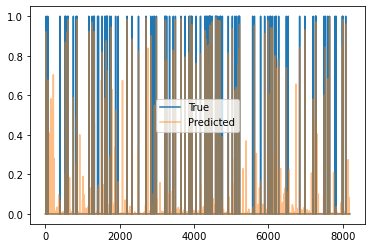

Train Epoch: 2 [610/2220 (27%)]	Loss: 0.012171	Pres: 0.014783	F1 Score: 0.002611
Train Epoch: 2 [620/2220 (27%)]	Loss: 0.014088	Pres: 0.017582	F1 Score: 0.002192
Train Epoch: 2 [630/2220 (28%)]	Loss: 0.013893	Pres: 0.016760	F1 Score: 0.003230
Train Epoch: 2 [640/2220 (28%)]	Loss: 0.017248	Pres: 0.020097	F1 Score: 0.005335
Train Epoch: 2 [650/2220 (29%)]	Loss: 0.012184	Pres: 0.016043	F1 Score: 0.002476
Train Epoch: 2 [660/2220 (29%)]	Loss: 0.016766	Pres: 0.020316	F1 Score: 0.004598
Train Epoch: 2 [670/2220 (30%)]	Loss: 0.013207	Pres: 0.020002	F1 Score: 0.004568
Train Epoch: 2 [680/2220 (30%)]	Loss: 0.011021	Pres: 0.015432	F1 Score: 0.002756
Train Epoch: 2 [690/2220 (31%)]	Loss: 0.012927	Pres: 0.019524	F1 Score: 0.002272
Train Epoch: 2 [700/2220 (31%)]	Loss: 0.010795	Pres: 0.018364	F1 Score: 0.003532
Train Epoch: 2 [710/2220 (31%)]	Loss: 0.012969	Pres: 0.017196	F1 Score: 0.001797
Train Epoch: 2 [720/2220 (32%)]	Loss: 0.012926	Pres: 0.022101	F1 Score: 0.004843
Train Epoch: 2 [730/2220 (32

KeyboardInterrupt: 

In [11]:
# 0.2 ids, 160 dist, average='macro'
trainer.train(debug=False)

began training
2220 582
Train Epoch: 0 [0/2220 (0%)]	Loss: 0.667825	Pres: 0.988299	F1 Score: 0.982274
97.0 -430.75


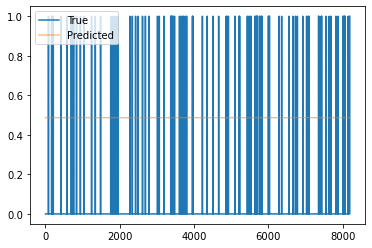

Train Epoch: 0 [10/2220 (0%)]	Loss: 0.628085	Pres: 0.973475	F1 Score: 0.708248
Train Epoch: 0 [20/2220 (0%)]	Loss: 0.481397	Pres: 0.974834	F1 Score: 0.581731
Train Epoch: 0 [30/2220 (1%)]	Loss: 0.369015	Pres: 0.974296	F1 Score: 0.294845
Train Epoch: 0 [40/2220 (1%)]	Loss: 0.285038	Pres: 0.978331	F1 Score: 0.085676
Train Epoch: 0 [50/2220 (2%)]	Loss: 0.230529	Pres: 0.993720	F1 Score: 0.037360
Train Epoch: 0 [60/2220 (2%)]	Loss: 0.188005	Pres: 1.000000	F1 Score: 0.012132
Train Epoch: 0 [70/2220 (3%)]	Loss: 0.161717	Pres: 1.000000	F1 Score: 0.008508
Train Epoch: 0 [80/2220 (3%)]	Loss: 0.141257	Pres: 1.000000	F1 Score: 0.003655
Train Epoch: 0 [90/2220 (4%)]	Loss: 0.123623	Pres: 1.000000	F1 Score: 0.000732
Train Epoch: 0 [100/2220 (4%)]	Loss: 0.111935	Pres: 1.000000	F1 Score: 0.000488
Train Epoch: 0 [110/2220 (4%)]	Loss: 0.113789	Pres: 1.000000	F1 Score: 0.000732
Train Epoch: 0 [120/2220 (5%)]	Loss: 0.094339	Pres: 1.000000	F1 Score: 0.000244
Train Epoch: 0 [130/2220 (5%)]	Loss: 0.096417	Pre

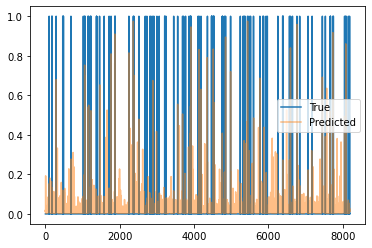

Train Epoch: 0 [310/2220 (13%)]	Loss: 0.043104	Pres: 0.484248	F1 Score: 0.004885
Train Epoch: 0 [320/2220 (14%)]	Loss: 0.050753	Pres: 0.656139	F1 Score: 0.007399
Train Epoch: 0 [330/2220 (14%)]	Loss: 0.041636	Pres: 0.640562	F1 Score: 0.008620
Train Epoch: 0 [340/2220 (15%)]	Loss: 0.046023	Pres: 0.440904	F1 Score: 0.006814
Train Epoch: 0 [350/2220 (15%)]	Loss: 0.046607	Pres: 0.557803	F1 Score: 0.007962
Train Epoch: 0 [360/2220 (16%)]	Loss: 0.044719	Pres: 0.582998	F1 Score: 0.005474
Train Epoch: 0 [370/2220 (16%)]	Loss: 0.042479	Pres: 0.298094	F1 Score: 0.003683
Train Epoch: 0 [380/2220 (17%)]	Loss: 0.038151	Pres: 0.586552	F1 Score: 0.006687
Train Epoch: 0 [390/2220 (17%)]	Loss: 0.039927	Pres: 0.522587	F1 Score: 0.007215
Train Epoch: 0 [400/2220 (18%)]	Loss: 0.041214	Pres: 0.615326	F1 Score: 0.009896
Train Epoch: 0 [410/2220 (18%)]	Loss: 0.036571	Pres: 0.383002	F1 Score: 0.006807
Train Epoch: 0 [420/2220 (18%)]	Loss: 0.037120	Pres: 0.676749	F1 Score: 0.009315
Train Epoch: 0 [430/2220 (19

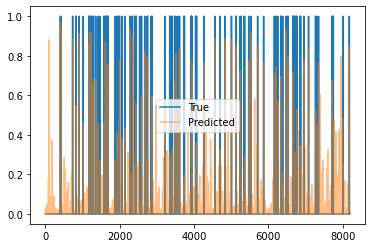

Train Epoch: 0 [610/2220 (27%)]	Loss: 0.029054	Pres: 0.668040	F1 Score: 0.009869
Train Epoch: 0 [620/2220 (27%)]	Loss: 0.029721	Pres: 0.502324	F1 Score: 0.008339
Train Epoch: 0 [630/2220 (28%)]	Loss: 0.027352	Pres: 0.616346	F1 Score: 0.011596
Train Epoch: 0 [640/2220 (28%)]	Loss: 0.026936	Pres: 0.593461	F1 Score: 0.010821
Train Epoch: 0 [650/2220 (29%)]	Loss: 0.029729	Pres: 0.320257	F1 Score: 0.007582
Train Epoch: 0 [660/2220 (29%)]	Loss: 0.028190	Pres: 0.695401	F1 Score: 0.011792
Train Epoch: 0 [670/2220 (30%)]	Loss: 0.029710	Pres: 0.564227	F1 Score: 0.010101
Train Epoch: 0 [680/2220 (30%)]	Loss: 0.026308	Pres: 0.461370	F1 Score: 0.008396
Train Epoch: 0 [690/2220 (31%)]	Loss: 0.030105	Pres: 0.397871	F1 Score: 0.008454
Train Epoch: 0 [700/2220 (31%)]	Loss: 0.024412	Pres: 0.381268	F1 Score: 0.006332
Train Epoch: 0 [710/2220 (31%)]	Loss: 0.022612	Pres: 0.274944	F1 Score: 0.006638
Train Epoch: 0 [720/2220 (32%)]	Loss: 0.024344	Pres: 0.559279	F1 Score: 0.008882
Train Epoch: 0 [730/2220 (32

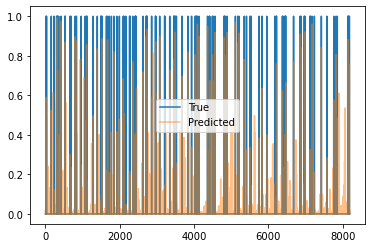

Train Epoch: 0 [910/2220 (40%)]	Loss: 0.026122	Pres: 0.296457	F1 Score: 0.005949
Train Epoch: 0 [920/2220 (41%)]	Loss: 0.021758	Pres: 0.556779	F1 Score: 0.008169
Train Epoch: 0 [930/2220 (41%)]	Loss: 0.018135	Pres: 0.658967	F1 Score: 0.009669
Train Epoch: 0 [940/2220 (42%)]	Loss: 0.022935	Pres: 0.589186	F1 Score: 0.010656
Train Epoch: 0 [950/2220 (42%)]	Loss: 0.024806	Pres: 0.489295	F1 Score: 0.009110
Train Epoch: 0 [960/2220 (43%)]	Loss: 0.022496	Pres: 0.413637	F1 Score: 0.006399
Train Epoch: 0 [970/2220 (43%)]	Loss: 0.024253	Pres: 0.480079	F1 Score: 0.008821
Train Epoch: 0 [980/2220 (44%)]	Loss: 0.019890	Pres: 0.399104	F1 Score: 0.007426
Train Epoch: 0 [990/2220 (44%)]	Loss: 0.025394	Pres: 0.222476	F1 Score: 0.006712
Train Epoch: 0 [1000/2220 (45%)]	Loss: 0.022952	Pres: 0.703021	F1 Score: 0.010787
Train Epoch: 0 [1010/2220 (45%)]	Loss: 0.023696	Pres: 0.314408	F1 Score: 0.007255
Train Epoch: 0 [1020/2220 (45%)]	Loss: 0.022279	Pres: 0.432259	F1 Score: 0.005783
Train Epoch: 0 [1030/2220

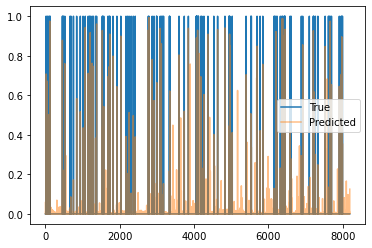

Train Epoch: 0 [1210/2220 (54%)]	Loss: 0.015364	Pres: 0.488635	F1 Score: 0.008063
Train Epoch: 0 [1220/2220 (54%)]	Loss: 0.017350	Pres: 0.385241	F1 Score: 0.006664
Train Epoch: 0 [1230/2220 (55%)]	Loss: 0.022404	Pres: 0.530726	F1 Score: 0.008358
Train Epoch: 0 [1240/2220 (55%)]	Loss: 0.018801	Pres: 0.609640	F1 Score: 0.008580
Train Epoch: 0 [1250/2220 (56%)]	Loss: 0.018216	Pres: 0.619641	F1 Score: 0.009159
Train Epoch: 0 [1260/2220 (56%)]	Loss: 0.019605	Pres: 0.564681	F1 Score: 0.009124
Train Epoch: 0 [1270/2220 (57%)]	Loss: 0.018314	Pres: 0.564083	F1 Score: 0.008690
Train Epoch: 0 [1280/2220 (57%)]	Loss: 0.020937	Pres: 0.551840	F1 Score: 0.006700
Train Epoch: 0 [1290/2220 (58%)]	Loss: 0.018764	Pres: 0.436048	F1 Score: 0.006932
Train Epoch: 0 [1300/2220 (58%)]	Loss: 0.017537	Pres: 0.447833	F1 Score: 0.007455
Train Epoch: 0 [1310/2220 (59%)]	Loss: 0.019002	Pres: 0.502955	F1 Score: 0.007933
Train Epoch: 0 [1320/2220 (59%)]	Loss: 0.015787	Pres: 0.533600	F1 Score: 0.007664
Train Epoch: 0 [

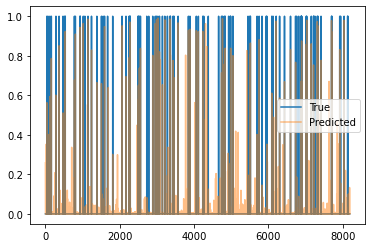

Train Epoch: 0 [1510/2220 (68%)]	Loss: 0.015274	Pres: 0.631703	F1 Score: 0.008884
Train Epoch: 0 [1520/2220 (68%)]	Loss: 0.015611	Pres: 0.650078	F1 Score: 0.009459
Train Epoch: 0 [1530/2220 (68%)]	Loss: 0.013900	Pres: 0.556100	F1 Score: 0.007544
Train Epoch: 0 [1540/2220 (69%)]	Loss: 0.017885	Pres: 0.521062	F1 Score: 0.005345
Train Epoch: 0 [1550/2220 (69%)]	Loss: 0.017453	Pres: 0.317736	F1 Score: 0.006556
Train Epoch: 0 [1560/2220 (70%)]	Loss: 0.017189	Pres: 0.330624	F1 Score: 0.005822
Train Epoch: 0 [1570/2220 (70%)]	Loss: 0.015351	Pres: 0.531919	F1 Score: 0.007244
Train Epoch: 0 [1580/2220 (71%)]	Loss: 0.014006	Pres: 0.626134	F1 Score: 0.007910
Train Epoch: 0 [1590/2220 (71%)]	Loss: 0.016018	Pres: 0.522298	F1 Score: 0.007385
Train Epoch: 0 [1600/2220 (72%)]	Loss: 0.013261	Pres: 0.648018	F1 Score: 0.008539
Train Epoch: 0 [1610/2220 (72%)]	Loss: 0.017173	Pres: 0.439357	F1 Score: 0.006210
Train Epoch: 0 [1620/2220 (72%)]	Loss: 0.019490	Pres: 0.550822	F1 Score: 0.008464
Train Epoch: 0 [

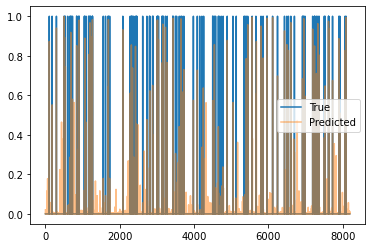

Train Epoch: 0 [1810/2220 (81%)]	Loss: 0.015707	Pres: 0.422316	F1 Score: 0.007028
Train Epoch: 0 [1820/2220 (81%)]	Loss: 0.015997	Pres: 0.353713	F1 Score: 0.005900
Train Epoch: 0 [1830/2220 (82%)]	Loss: 0.015274	Pres: 0.600822	F1 Score: 0.007535
Train Epoch: 0 [1840/2220 (82%)]	Loss: 0.015810	Pres: 0.534216	F1 Score: 0.006142
Train Epoch: 0 [1850/2220 (83%)]	Loss: 0.018162	Pres: 0.695697	F1 Score: 0.010246
Train Epoch: 0 [1860/2220 (83%)]	Loss: 0.016538	Pres: 0.473598	F1 Score: 0.007529
Train Epoch: 0 [1870/2220 (84%)]	Loss: 0.016826	Pres: 0.429725	F1 Score: 0.007278
Train Epoch: 0 [1880/2220 (84%)]	Loss: 0.016303	Pres: 0.450499	F1 Score: 0.006316
Train Epoch: 0 [1890/2220 (85%)]	Loss: 0.018445	Pres: 0.503319	F1 Score: 0.007532
Train Epoch: 0 [1900/2220 (85%)]	Loss: 0.015657	Pres: 0.551747	F1 Score: 0.008320
Train Epoch: 0 [1910/2220 (86%)]	Loss: 0.015561	Pres: 0.723485	F1 Score: 0.007897
Train Epoch: 0 [1920/2220 (86%)]	Loss: 0.017555	Pres: 0.621392	F1 Score: 0.006141
Train Epoch: 0 [

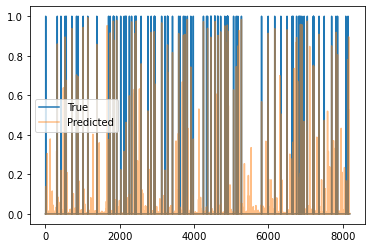

Train Epoch: 0 [2110/2220 (95%)]	Loss: 0.016697	Pres: 0.678915	F1 Score: 0.009993
Train Epoch: 0 [2120/2220 (95%)]	Loss: 0.017604	Pres: 0.539920	F1 Score: 0.007510
Train Epoch: 0 [2130/2220 (95%)]	Loss: 0.014165	Pres: 0.399155	F1 Score: 0.006864
Train Epoch: 0 [2140/2220 (96%)]	Loss: 0.013115	Pres: 0.486445	F1 Score: 0.005972
Train Epoch: 0 [2150/2220 (96%)]	Loss: 0.015673	Pres: 0.748153	F1 Score: 0.007175
Train Epoch: 0 [2160/2220 (97%)]	Loss: 0.013206	Pres: 0.338921	F1 Score: 0.006009
Train Epoch: 0 [2170/2220 (97%)]	Loss: 0.015313	Pres: 0.525115	F1 Score: 0.005851
Train Epoch: 0 [2180/2220 (98%)]	Loss: 0.015660	Pres: 0.531989	F1 Score: 0.007825
Train Epoch: 0 [2190/2220 (98%)]	Loss: 0.014526	Pres: 0.681497	F1 Score: 0.006903
Train Epoch: 0 [2200/2220 (99%)]	Loss: 0.017048	Pres: 0.320009	F1 Score: 0.005228
Train Epoch: 0 [2210/2220 (99%)]	Loss: 0.017460	Pres: 0.467003	F1 Score: 0.005681
Validation Epoch: 0 [0/582 (0%)]	Loss: 0.010618	Pres: 0.623125	F1 Score: 0.007129


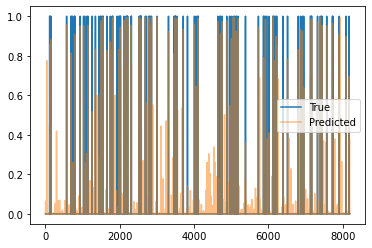

Validation Epoch: 0 [10/582 (1%)]	Loss: 0.009104	Pres: 0.559421	F1 Score: 0.006098
Validation Epoch: 0 [20/582 (3%)]	Loss: 0.009282	Pres: 0.592886	F1 Score: 0.006084


KeyboardInterrupt: 

In [11]:
# 0.2 ids, 160 dist, average='weighted'
trainer.train(debug=False)

began training
2220 582
Train Epoch: 0 [0/2220 (0%)]	Loss: 0.686887	Pres: 0.988892	F1 Score: 0.988892
91.0 -105.25


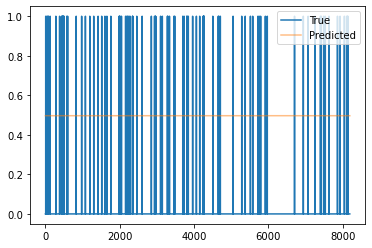

Train Epoch: 0 [10/2220 (0%)]	Loss: 0.699455	Pres: 0.615845	F1 Score: 0.615845
Train Epoch: 0 [20/2220 (0%)]	Loss: 0.531281	Pres: 0.481689	F1 Score: 0.481689
Train Epoch: 0 [30/2220 (1%)]	Loss: 0.398657	Pres: 0.209595	F1 Score: 0.209595
Train Epoch: 0 [40/2220 (1%)]	Loss: 0.309775	Pres: 0.075195	F1 Score: 0.075195
Train Epoch: 0 [50/2220 (2%)]	Loss: 0.250459	Pres: 0.029175	F1 Score: 0.029175
Train Epoch: 0 [60/2220 (2%)]	Loss: 0.207159	Pres: 0.016235	F1 Score: 0.016235
Train Epoch: 0 [70/2220 (3%)]	Loss: 0.171157	Pres: 0.008301	F1 Score: 0.008301
Train Epoch: 0 [80/2220 (3%)]	Loss: 0.148139	Pres: 0.000977	F1 Score: 0.000977
Train Epoch: 0 [90/2220 (4%)]	Loss: 0.134478	Pres: 0.001465	F1 Score: 0.001465
Train Epoch: 0 [100/2220 (4%)]	Loss: 0.113471	Pres: 0.000610	F1 Score: 0.000610
Train Epoch: 0 [110/2220 (4%)]	Loss: 0.106094	Pres: 0.000488	F1 Score: 0.000488
Train Epoch: 0 [120/2220 (5%)]	Loss: 0.102104	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 0 [130/2220 (5%)]	Loss: 0.098031	Pre

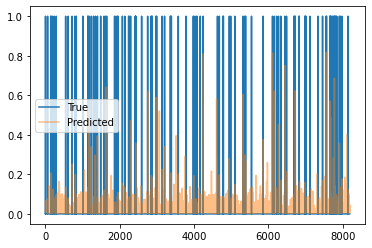

Train Epoch: 0 [310/2220 (13%)]	Loss: 0.051353	Pres: 0.003784	F1 Score: 0.003784
Train Epoch: 0 [320/2220 (14%)]	Loss: 0.052330	Pres: 0.005981	F1 Score: 0.005981
Train Epoch: 0 [330/2220 (14%)]	Loss: 0.045840	Pres: 0.005981	F1 Score: 0.005981
Train Epoch: 0 [340/2220 (15%)]	Loss: 0.045524	Pres: 0.005493	F1 Score: 0.005493
Train Epoch: 0 [350/2220 (15%)]	Loss: 0.050293	Pres: 0.002197	F1 Score: 0.002197
Train Epoch: 0 [360/2220 (16%)]	Loss: 0.044829	Pres: 0.004883	F1 Score: 0.004883
Train Epoch: 0 [370/2220 (16%)]	Loss: 0.041823	Pres: 0.005127	F1 Score: 0.005127
Train Epoch: 0 [380/2220 (17%)]	Loss: 0.038819	Pres: 0.003296	F1 Score: 0.003296
Train Epoch: 0 [390/2220 (17%)]	Loss: 0.043550	Pres: 0.006104	F1 Score: 0.006104
Train Epoch: 0 [400/2220 (18%)]	Loss: 0.038695	Pres: 0.004272	F1 Score: 0.004272
Train Epoch: 0 [410/2220 (18%)]	Loss: 0.036116	Pres: 0.005615	F1 Score: 0.005615
Train Epoch: 0 [420/2220 (18%)]	Loss: 0.035746	Pres: 0.003906	F1 Score: 0.003906
Train Epoch: 0 [430/2220 (19

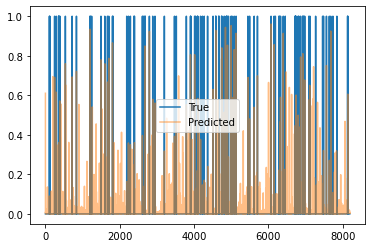

Train Epoch: 0 [610/2220 (27%)]	Loss: 0.031675	Pres: 0.005859	F1 Score: 0.005859
Train Epoch: 0 [620/2220 (27%)]	Loss: 0.026487	Pres: 0.005127	F1 Score: 0.005127
Train Epoch: 0 [630/2220 (28%)]	Loss: 0.029288	Pres: 0.006104	F1 Score: 0.006104
Train Epoch: 0 [640/2220 (28%)]	Loss: 0.025715	Pres: 0.004028	F1 Score: 0.004028
Train Epoch: 0 [650/2220 (29%)]	Loss: 0.031902	Pres: 0.004761	F1 Score: 0.004761
Train Epoch: 0 [660/2220 (29%)]	Loss: 0.028459	Pres: 0.006226	F1 Score: 0.006226
Train Epoch: 0 [670/2220 (30%)]	Loss: 0.026482	Pres: 0.004517	F1 Score: 0.004517
Train Epoch: 0 [680/2220 (30%)]	Loss: 0.027642	Pres: 0.005859	F1 Score: 0.005859
Train Epoch: 0 [690/2220 (31%)]	Loss: 0.032805	Pres: 0.004395	F1 Score: 0.004395
Train Epoch: 0 [700/2220 (31%)]	Loss: 0.028469	Pres: 0.004272	F1 Score: 0.004272
Train Epoch: 0 [710/2220 (31%)]	Loss: 0.026703	Pres: 0.006226	F1 Score: 0.006226
Train Epoch: 0 [720/2220 (32%)]	Loss: 0.027556	Pres: 0.005737	F1 Score: 0.005737
Train Epoch: 0 [730/2220 (32

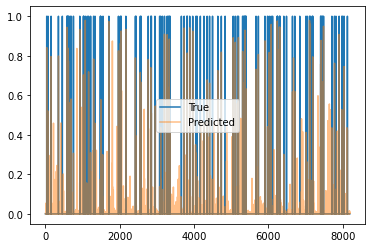

Train Epoch: 0 [910/2220 (40%)]	Loss: 0.025682	Pres: 0.004761	F1 Score: 0.004761
Train Epoch: 0 [920/2220 (41%)]	Loss: 0.023528	Pres: 0.003906	F1 Score: 0.003906
Train Epoch: 0 [930/2220 (41%)]	Loss: 0.021204	Pres: 0.005005	F1 Score: 0.005005
Train Epoch: 0 [940/2220 (42%)]	Loss: 0.026311	Pres: 0.005127	F1 Score: 0.005127
Train Epoch: 0 [950/2220 (42%)]	Loss: 0.024232	Pres: 0.006348	F1 Score: 0.006348
Train Epoch: 0 [960/2220 (43%)]	Loss: 0.022653	Pres: 0.005005	F1 Score: 0.005005
Train Epoch: 0 [970/2220 (43%)]	Loss: 0.022206	Pres: 0.005493	F1 Score: 0.005493
Train Epoch: 0 [980/2220 (44%)]	Loss: 0.024424	Pres: 0.005981	F1 Score: 0.005981
Train Epoch: 0 [990/2220 (44%)]	Loss: 0.023832	Pres: 0.004761	F1 Score: 0.004761
Train Epoch: 0 [1000/2220 (45%)]	Loss: 0.024400	Pres: 0.004395	F1 Score: 0.004395
Train Epoch: 0 [1010/2220 (45%)]	Loss: 0.024717	Pres: 0.005615	F1 Score: 0.005615
Train Epoch: 0 [1020/2220 (45%)]	Loss: 0.024432	Pres: 0.006226	F1 Score: 0.006226
Train Epoch: 0 [1030/2220

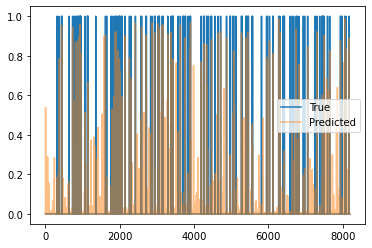

Train Epoch: 0 [1210/2220 (54%)]	Loss: 0.018700	Pres: 0.004272	F1 Score: 0.004272
Train Epoch: 0 [1220/2220 (54%)]	Loss: 0.020725	Pres: 0.004517	F1 Score: 0.004517
Train Epoch: 0 [1230/2220 (55%)]	Loss: 0.017356	Pres: 0.003418	F1 Score: 0.003418
Train Epoch: 0 [1240/2220 (55%)]	Loss: 0.018998	Pres: 0.003784	F1 Score: 0.003784
Train Epoch: 0 [1250/2220 (56%)]	Loss: 0.028749	Pres: 0.003296	F1 Score: 0.003296
Train Epoch: 0 [1260/2220 (56%)]	Loss: 0.018925	Pres: 0.004517	F1 Score: 0.004517
Train Epoch: 0 [1270/2220 (57%)]	Loss: 0.017451	Pres: 0.003540	F1 Score: 0.003540
Train Epoch: 0 [1280/2220 (57%)]	Loss: 0.018374	Pres: 0.003296	F1 Score: 0.003296
Train Epoch: 0 [1290/2220 (58%)]	Loss: 0.015603	Pres: 0.003174	F1 Score: 0.003174
Train Epoch: 0 [1300/2220 (58%)]	Loss: 0.016938	Pres: 0.005249	F1 Score: 0.005249
Train Epoch: 0 [1310/2220 (59%)]	Loss: 0.019108	Pres: 0.004639	F1 Score: 0.004639
Train Epoch: 0 [1320/2220 (59%)]	Loss: 0.020567	Pres: 0.005249	F1 Score: 0.005249
Train Epoch: 0 [

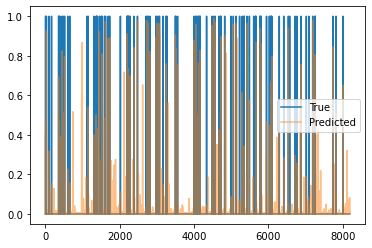

Train Epoch: 0 [1510/2220 (68%)]	Loss: 0.017800	Pres: 0.004639	F1 Score: 0.004639
Train Epoch: 0 [1520/2220 (68%)]	Loss: 0.022368	Pres: 0.004150	F1 Score: 0.004150
Train Epoch: 0 [1530/2220 (68%)]	Loss: 0.023014	Pres: 0.004883	F1 Score: 0.004883
Train Epoch: 0 [1540/2220 (69%)]	Loss: 0.017746	Pres: 0.004272	F1 Score: 0.004272
Train Epoch: 0 [1550/2220 (69%)]	Loss: 0.020678	Pres: 0.005737	F1 Score: 0.005737
Train Epoch: 0 [1560/2220 (70%)]	Loss: 0.017261	Pres: 0.003906	F1 Score: 0.003906
Train Epoch: 0 [1570/2220 (70%)]	Loss: 0.016767	Pres: 0.004395	F1 Score: 0.004395
Train Epoch: 0 [1580/2220 (71%)]	Loss: 0.017186	Pres: 0.003784	F1 Score: 0.003784
Train Epoch: 0 [1590/2220 (71%)]	Loss: 0.016953	Pres: 0.003906	F1 Score: 0.003906
Train Epoch: 0 [1600/2220 (72%)]	Loss: 0.022444	Pres: 0.005371	F1 Score: 0.005371
Train Epoch: 0 [1610/2220 (72%)]	Loss: 0.017401	Pres: 0.004517	F1 Score: 0.004517
Train Epoch: 0 [1620/2220 (72%)]	Loss: 0.014094	Pres: 0.004517	F1 Score: 0.004517
Train Epoch: 0 [

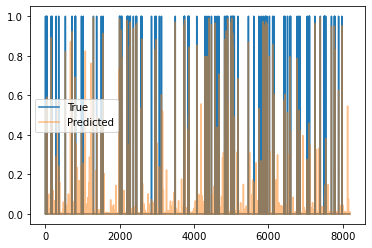

Train Epoch: 0 [1810/2220 (81%)]	Loss: 0.016422	Pres: 0.003784	F1 Score: 0.003784
Train Epoch: 0 [1820/2220 (81%)]	Loss: 0.014904	Pres: 0.005005	F1 Score: 0.005005
Train Epoch: 0 [1830/2220 (82%)]	Loss: 0.017443	Pres: 0.004150	F1 Score: 0.004150
Train Epoch: 0 [1840/2220 (82%)]	Loss: 0.016317	Pres: 0.005493	F1 Score: 0.005493
Train Epoch: 0 [1850/2220 (83%)]	Loss: 0.018628	Pres: 0.004639	F1 Score: 0.004639
Train Epoch: 0 [1860/2220 (83%)]	Loss: 0.016471	Pres: 0.004883	F1 Score: 0.004883
Train Epoch: 0 [1870/2220 (84%)]	Loss: 0.014403	Pres: 0.003662	F1 Score: 0.003662
Train Epoch: 0 [1880/2220 (84%)]	Loss: 0.017570	Pres: 0.003174	F1 Score: 0.003174
Train Epoch: 0 [1890/2220 (85%)]	Loss: 0.019761	Pres: 0.004272	F1 Score: 0.004272
Train Epoch: 0 [1900/2220 (85%)]	Loss: 0.014800	Pres: 0.004761	F1 Score: 0.004761
Train Epoch: 0 [1910/2220 (86%)]	Loss: 0.019075	Pres: 0.004028	F1 Score: 0.004028
Train Epoch: 0 [1920/2220 (86%)]	Loss: 0.017344	Pres: 0.003662	F1 Score: 0.003662
Train Epoch: 0 [

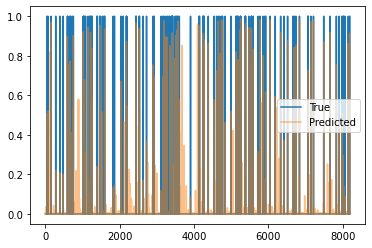

Train Epoch: 0 [2110/2220 (95%)]	Loss: 0.014176	Pres: 0.003906	F1 Score: 0.003906
Train Epoch: 0 [2120/2220 (95%)]	Loss: 0.013114	Pres: 0.002930	F1 Score: 0.002930
Train Epoch: 0 [2130/2220 (95%)]	Loss: 0.014474	Pres: 0.003174	F1 Score: 0.003174
Train Epoch: 0 [2140/2220 (96%)]	Loss: 0.017657	Pres: 0.003784	F1 Score: 0.003784
Train Epoch: 0 [2150/2220 (96%)]	Loss: 0.014475	Pres: 0.005005	F1 Score: 0.005005
Train Epoch: 0 [2160/2220 (97%)]	Loss: 0.016737	Pres: 0.003662	F1 Score: 0.003662
Train Epoch: 0 [2170/2220 (97%)]	Loss: 0.015802	Pres: 0.002808	F1 Score: 0.002808
Train Epoch: 0 [2180/2220 (98%)]	Loss: 0.012029	Pres: 0.003174	F1 Score: 0.003174
Train Epoch: 0 [2190/2220 (98%)]	Loss: 0.012702	Pres: 0.003662	F1 Score: 0.003662
Train Epoch: 0 [2200/2220 (99%)]	Loss: 0.016532	Pres: 0.003296	F1 Score: 0.003296
Train Epoch: 0 [2210/2220 (99%)]	Loss: 0.014451	Pres: 0.004150	F1 Score: 0.004150
Validation Epoch: 0 [0/582 (0%)]	Loss: 0.013432	Pres: 0.004395	F1 Score: 0.004395


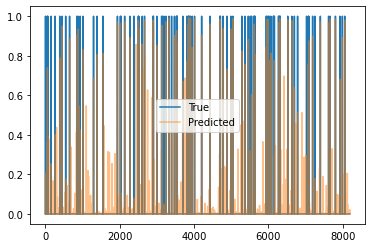

Validation Epoch: 0 [10/582 (1%)]	Loss: 0.009246	Pres: 0.004395	F1 Score: 0.004395
Validation Epoch: 0 [20/582 (3%)]	Loss: 0.010227	Pres: 0.005005	F1 Score: 0.005005
Validation Epoch: 0 [30/582 (5%)]	Loss: 0.008891	Pres: 0.004150	F1 Score: 0.004150
Validation Epoch: 0 [40/582 (6%)]	Loss: 0.011764	Pres: 0.003174	F1 Score: 0.003174
Validation Epoch: 0 [50/582 (8%)]	Loss: 0.011005	Pres: 0.004272	F1 Score: 0.004272
Validation Epoch: 0 [60/582 (10%)]	Loss: 0.008729	Pres: 0.004028	F1 Score: 0.004028
Validation Epoch: 0 [70/582 (12%)]	Loss: 0.009860	Pres: 0.003296	F1 Score: 0.003296
Validation Epoch: 0 [80/582 (13%)]	Loss: 0.011029	Pres: 0.003296	F1 Score: 0.003296
Validation Epoch: 0 [90/582 (15%)]	Loss: 0.012285	Pres: 0.004150	F1 Score: 0.004150
Validation Epoch: 0 [100/582 (17%)]	Loss: 0.009954	Pres: 0.004761	F1 Score: 0.004761
Validation Epoch: 0 [110/582 (18%)]	Loss: 0.010297	Pres: 0.004517	F1 Score: 0.004517
Validation Epoch: 0 [120/582 (20%)]	Loss: 0.009865	Pres: 0.003540	F1 Score: 0.0

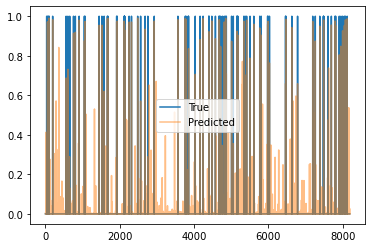

Validation Epoch: 0 [310/582 (53%)]	Loss: 0.009745	Pres: 0.002808	F1 Score: 0.002808
Validation Epoch: 0 [320/582 (54%)]	Loss: 0.009042	Pres: 0.003174	F1 Score: 0.003174
Validation Epoch: 0 [330/582 (56%)]	Loss: 0.010392	Pres: 0.004028	F1 Score: 0.004028
Validation Epoch: 0 [340/582 (58%)]	Loss: 0.011341	Pres: 0.004150	F1 Score: 0.004150
Validation Epoch: 0 [350/582 (60%)]	Loss: 0.009842	Pres: 0.003540	F1 Score: 0.003540
Validation Epoch: 0 [360/582 (61%)]	Loss: 0.010551	Pres: 0.003784	F1 Score: 0.003784
Validation Epoch: 0 [370/582 (63%)]	Loss: 0.011001	Pres: 0.003296	F1 Score: 0.003296
Validation Epoch: 0 [380/582 (65%)]	Loss: 0.013123	Pres: 0.004272	F1 Score: 0.004272
Validation Epoch: 0 [390/582 (67%)]	Loss: 0.011793	Pres: 0.003418	F1 Score: 0.003418
Validation Epoch: 0 [400/582 (68%)]	Loss: 0.011593	Pres: 0.004395	F1 Score: 0.004395
Validation Epoch: 0 [410/582 (70%)]	Loss: 0.011460	Pres: 0.003784	F1 Score: 0.003784
Validation Epoch: 0 [420/582 (72%)]	Loss: 0.009921	Pres: 0.004883

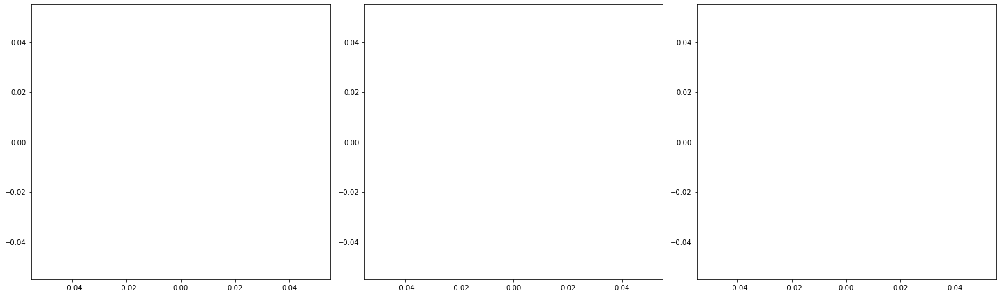

2220 582
Train Epoch: 1 [0/2220 (0%)]	Loss: 0.015061	Pres: 0.002441	F1 Score: 0.002441
105.0 -inf


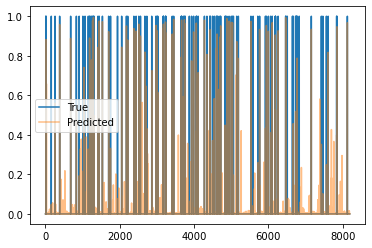

Train Epoch: 1 [10/2220 (0%)]	Loss: 0.013570	Pres: 0.003296	F1 Score: 0.003296
Train Epoch: 1 [20/2220 (0%)]	Loss: 0.012993	Pres: 0.002686	F1 Score: 0.002686
Train Epoch: 1 [30/2220 (1%)]	Loss: 0.012000	Pres: 0.004150	F1 Score: 0.004150
Train Epoch: 1 [40/2220 (1%)]	Loss: 0.013389	Pres: 0.004272	F1 Score: 0.004272
Train Epoch: 1 [50/2220 (2%)]	Loss: 0.013939	Pres: 0.004272	F1 Score: 0.004272
Train Epoch: 1 [60/2220 (2%)]	Loss: 0.013784	Pres: 0.004272	F1 Score: 0.004272
Train Epoch: 1 [70/2220 (3%)]	Loss: 0.011664	Pres: 0.004395	F1 Score: 0.004395
Train Epoch: 1 [80/2220 (3%)]	Loss: 0.013410	Pres: 0.002197	F1 Score: 0.002197
Train Epoch: 1 [90/2220 (4%)]	Loss: 0.014323	Pres: 0.003540	F1 Score: 0.003540
Train Epoch: 1 [100/2220 (4%)]	Loss: 0.015070	Pres: 0.003662	F1 Score: 0.003662
Train Epoch: 1 [110/2220 (4%)]	Loss: 0.013296	Pres: 0.002197	F1 Score: 0.002197
Train Epoch: 1 [120/2220 (5%)]	Loss: 0.014962	Pres: 0.003174	F1 Score: 0.003174
Train Epoch: 1 [130/2220 (5%)]	Loss: 0.015339	Pre

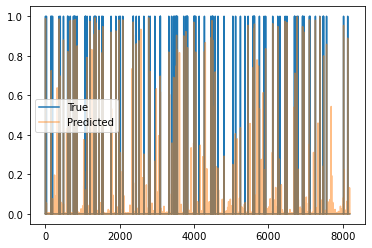

Train Epoch: 1 [310/2220 (13%)]	Loss: 0.013231	Pres: 0.003174	F1 Score: 0.003174
Train Epoch: 1 [320/2220 (14%)]	Loss: 0.014401	Pres: 0.003174	F1 Score: 0.003174
Train Epoch: 1 [330/2220 (14%)]	Loss: 0.012563	Pres: 0.002319	F1 Score: 0.002319
Train Epoch: 1 [340/2220 (15%)]	Loss: 0.014532	Pres: 0.001953	F1 Score: 0.001953
Train Epoch: 1 [350/2220 (15%)]	Loss: 0.013781	Pres: 0.004272	F1 Score: 0.004272
Train Epoch: 1 [360/2220 (16%)]	Loss: 0.014098	Pres: 0.003174	F1 Score: 0.003174
Train Epoch: 1 [370/2220 (16%)]	Loss: 0.015382	Pres: 0.004395	F1 Score: 0.004395
Train Epoch: 1 [380/2220 (17%)]	Loss: 0.012834	Pres: 0.003540	F1 Score: 0.003540
Train Epoch: 1 [390/2220 (17%)]	Loss: 0.012435	Pres: 0.004272	F1 Score: 0.004272
Train Epoch: 1 [400/2220 (18%)]	Loss: 0.011091	Pres: 0.002930	F1 Score: 0.002930
Train Epoch: 1 [410/2220 (18%)]	Loss: 0.012650	Pres: 0.004150	F1 Score: 0.004150
Train Epoch: 1 [420/2220 (18%)]	Loss: 0.015215	Pres: 0.004761	F1 Score: 0.004761
Train Epoch: 1 [430/2220 (19

KeyboardInterrupt: 

In [11]:
# 0.2 ids, 160 dist, average='micro'
trainer.train(debug=False)

began training
2220 582
Train Epoch: 0 [0/2220 (0%)]	Loss: 0.692383	Pres: 0.988770	F1 Score: 0.988770
92.0 -12.8125


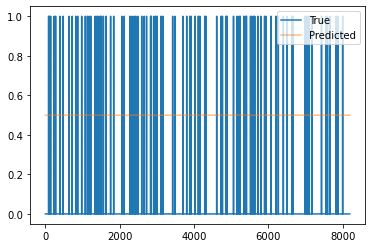

Train Epoch: 0 [10/2220 (0%)]	Loss: 0.556215	Pres: 0.496948	F1 Score: 0.496948
Train Epoch: 0 [20/2220 (0%)]	Loss: 0.531492	Pres: 0.474243	F1 Score: 0.474243
Train Epoch: 0 [30/2220 (1%)]	Loss: 0.507891	Pres: 0.466553	F1 Score: 0.466553
Train Epoch: 0 [40/2220 (1%)]	Loss: 0.490690	Pres: 0.436646	F1 Score: 0.436646
Train Epoch: 0 [50/2220 (2%)]	Loss: 0.473302	Pres: 0.399536	F1 Score: 0.399536
Train Epoch: 0 [60/2220 (2%)]	Loss: 0.455592	Pres: 0.367432	F1 Score: 0.367432
Train Epoch: 0 [70/2220 (3%)]	Loss: 0.438361	Pres: 0.332764	F1 Score: 0.332764
Train Epoch: 0 [80/2220 (3%)]	Loss: 0.424623	Pres: 0.302490	F1 Score: 0.302490
Train Epoch: 0 [90/2220 (4%)]	Loss: 0.415093	Pres: 0.274414	F1 Score: 0.274414
Train Epoch: 0 [100/2220 (4%)]	Loss: 0.410391	Pres: 0.280640	F1 Score: 0.280640
Train Epoch: 0 [110/2220 (4%)]	Loss: 0.388872	Pres: 0.217896	F1 Score: 0.217896
Train Epoch: 0 [120/2220 (5%)]	Loss: 0.376796	Pres: 0.181519	F1 Score: 0.181519
Train Epoch: 0 [130/2220 (5%)]	Loss: 0.368731	Pre

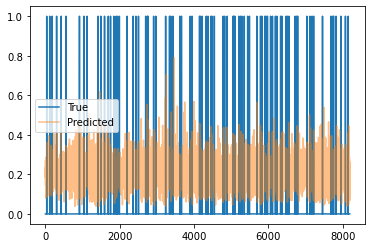

Train Epoch: 0 [310/2220 (13%)]	Loss: 0.239397	Pres: 0.017334	F1 Score: 0.017334
Train Epoch: 0 [320/2220 (14%)]	Loss: 0.232462	Pres: 0.016602	F1 Score: 0.016602
Train Epoch: 0 [330/2220 (14%)]	Loss: 0.227314	Pres: 0.013916	F1 Score: 0.013916
Train Epoch: 0 [340/2220 (15%)]	Loss: 0.222884	Pres: 0.010742	F1 Score: 0.010742
Train Epoch: 0 [350/2220 (15%)]	Loss: 0.218259	Pres: 0.010132	F1 Score: 0.010132
Train Epoch: 0 [360/2220 (16%)]	Loss: 0.214095	Pres: 0.009766	F1 Score: 0.009766
Train Epoch: 0 [370/2220 (16%)]	Loss: 0.210164	Pres: 0.010254	F1 Score: 0.010254
Train Epoch: 0 [380/2220 (17%)]	Loss: 0.207877	Pres: 0.007690	F1 Score: 0.007690
Train Epoch: 0 [390/2220 (17%)]	Loss: 0.202232	Pres: 0.010376	F1 Score: 0.010376
Train Epoch: 0 [400/2220 (18%)]	Loss: 0.198422	Pres: 0.006226	F1 Score: 0.006226
Train Epoch: 0 [410/2220 (18%)]	Loss: 0.195536	Pres: 0.008423	F1 Score: 0.008423
Train Epoch: 0 [420/2220 (18%)]	Loss: 0.190914	Pres: 0.007202	F1 Score: 0.007202
Train Epoch: 0 [430/2220 (19

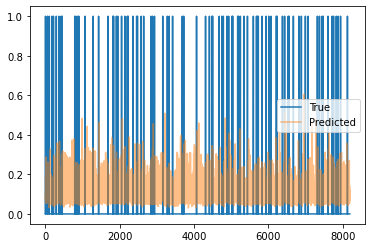

Train Epoch: 0 [610/2220 (27%)]	Loss: 0.140516	Pres: 0.000977	F1 Score: 0.000977
Train Epoch: 0 [620/2220 (27%)]	Loss: 0.144038	Pres: 0.000977	F1 Score: 0.000977
Train Epoch: 0 [630/2220 (28%)]	Loss: 0.143920	Pres: 0.001465	F1 Score: 0.001465
Train Epoch: 0 [640/2220 (28%)]	Loss: 0.141481	Pres: 0.000366	F1 Score: 0.000366
Train Epoch: 0 [650/2220 (29%)]	Loss: 0.143140	Pres: 0.001709	F1 Score: 0.001709
Train Epoch: 0 [660/2220 (29%)]	Loss: 0.136537	Pres: 0.000977	F1 Score: 0.000977
Train Epoch: 0 [670/2220 (30%)]	Loss: 0.133335	Pres: 0.002441	F1 Score: 0.002441
Train Epoch: 0 [680/2220 (30%)]	Loss: 0.135596	Pres: 0.000610	F1 Score: 0.000610
Train Epoch: 0 [690/2220 (31%)]	Loss: 0.135235	Pres: 0.000366	F1 Score: 0.000366
Train Epoch: 0 [700/2220 (31%)]	Loss: 0.134618	Pres: 0.001099	F1 Score: 0.001099
Train Epoch: 0 [710/2220 (31%)]	Loss: 0.123319	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 0 [720/2220 (32%)]	Loss: 0.126860	Pres: 0.000854	F1 Score: 0.000854
Train Epoch: 0 [730/2220 (32

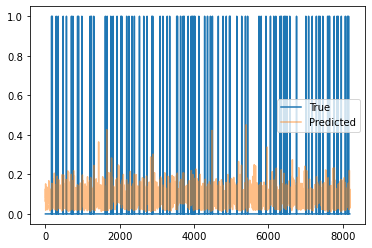

Train Epoch: 0 [910/2220 (40%)]	Loss: 0.106491	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 0 [920/2220 (41%)]	Loss: 0.110114	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [930/2220 (41%)]	Loss: 0.099875	Pres: 0.000366	F1 Score: 0.000366
Train Epoch: 0 [940/2220 (42%)]	Loss: 0.098869	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 0 [950/2220 (42%)]	Loss: 0.102388	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [960/2220 (43%)]	Loss: 0.096306	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [970/2220 (43%)]	Loss: 0.098331	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 0 [980/2220 (44%)]	Loss: 0.099593	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [990/2220 (44%)]	Loss: 0.103246	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [1000/2220 (45%)]	Loss: 0.097409	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 0 [1010/2220 (45%)]	Loss: 0.093682	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [1020/2220 (45%)]	Loss: 0.096169	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 0 [1030/2220

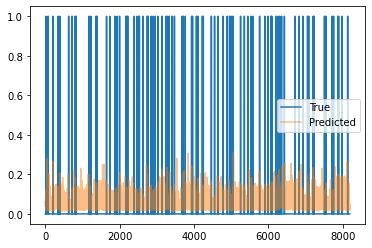

Train Epoch: 0 [1210/2220 (54%)]	Loss: 0.086183	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [1220/2220 (54%)]	Loss: 0.084334	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [1230/2220 (55%)]	Loss: 0.085013	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [1240/2220 (55%)]	Loss: 0.079492	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 0 [1250/2220 (56%)]	Loss: 0.080126	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [1260/2220 (56%)]	Loss: 0.080380	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [1270/2220 (57%)]	Loss: 0.087046	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [1280/2220 (57%)]	Loss: 0.084352	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 0 [1290/2220 (58%)]	Loss: 0.080832	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [1300/2220 (58%)]	Loss: 0.076568	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [1310/2220 (59%)]	Loss: 0.081833	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [1320/2220 (59%)]	Loss: 0.077617	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [

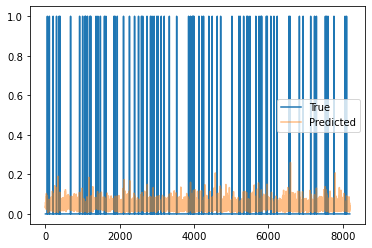

Train Epoch: 0 [1510/2220 (68%)]	Loss: 0.073120	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [1520/2220 (68%)]	Loss: 0.068770	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [1530/2220 (68%)]	Loss: 0.068563	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [1540/2220 (69%)]	Loss: 0.073685	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [1550/2220 (69%)]	Loss: 0.069642	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [1560/2220 (70%)]	Loss: 0.068606	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [1570/2220 (70%)]	Loss: 0.071515	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [1580/2220 (71%)]	Loss: 0.070836	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [1590/2220 (71%)]	Loss: 0.071969	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [1600/2220 (72%)]	Loss: 0.073148	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [1610/2220 (72%)]	Loss: 0.068560	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [1620/2220 (72%)]	Loss: 0.072007	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [

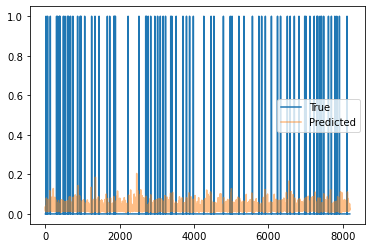

Train Epoch: 0 [1810/2220 (81%)]	Loss: 0.066034	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [1820/2220 (81%)]	Loss: 0.065343	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [1830/2220 (82%)]	Loss: 0.064042	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [1840/2220 (82%)]	Loss: 0.066143	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [1850/2220 (83%)]	Loss: 0.069372	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [1860/2220 (83%)]	Loss: 0.064009	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [1870/2220 (84%)]	Loss: 0.065736	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [1880/2220 (84%)]	Loss: 0.061147	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [1890/2220 (85%)]	Loss: 0.064378	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [1900/2220 (85%)]	Loss: 0.061895	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [1910/2220 (86%)]	Loss: 0.062249	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [1920/2220 (86%)]	Loss: 0.060861	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [

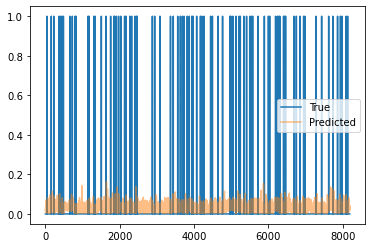

Train Epoch: 0 [2110/2220 (95%)]	Loss: 0.063589	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [2120/2220 (95%)]	Loss: 0.059200	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [2130/2220 (95%)]	Loss: 0.057324	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [2140/2220 (96%)]	Loss: 0.060542	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [2150/2220 (96%)]	Loss: 0.060958	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [2160/2220 (97%)]	Loss: 0.058163	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [2170/2220 (97%)]	Loss: 0.064816	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [2180/2220 (98%)]	Loss: 0.057206	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [2190/2220 (98%)]	Loss: 0.060054	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [2200/2220 (99%)]	Loss: 0.061309	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 0 [2210/2220 (99%)]	Loss: 0.062939	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 0 [0/582 (0%)]	Loss: 0.054809	Pres: 0.000000	F1 Score: 0.000000


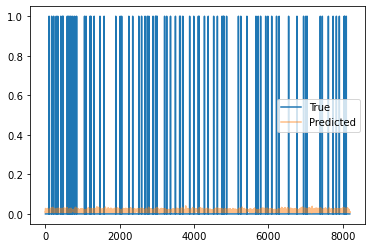

Validation Epoch: 0 [10/582 (1%)]	Loss: 0.056238	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 0 [20/582 (3%)]	Loss: 0.058927	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 0 [30/582 (5%)]	Loss: 0.058741	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 0 [40/582 (6%)]	Loss: 0.055859	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 0 [50/582 (8%)]	Loss: 0.054518	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 0 [60/582 (10%)]	Loss: 0.054574	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 0 [70/582 (12%)]	Loss: 0.057111	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 0 [80/582 (13%)]	Loss: 0.053910	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 0 [90/582 (15%)]	Loss: 0.053482	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 0 [100/582 (17%)]	Loss: 0.056363	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 0 [110/582 (18%)]	Loss: 0.052172	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 0 [120/582 (20%)]	Loss: 0.056475	Pres: 0.000000	F1 Score: 0.0

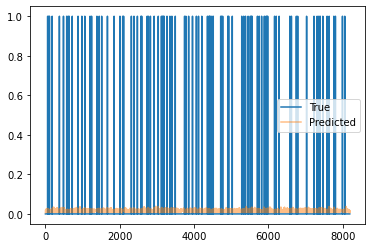

Validation Epoch: 0 [310/582 (53%)]	Loss: 0.056437	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 0 [320/582 (54%)]	Loss: 0.057554	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 0 [330/582 (56%)]	Loss: 0.050777	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 0 [340/582 (58%)]	Loss: 0.054147	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 0 [350/582 (60%)]	Loss: 0.055875	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 0 [360/582 (61%)]	Loss: 0.055144	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 0 [370/582 (63%)]	Loss: 0.055979	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 0 [380/582 (65%)]	Loss: 0.053843	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 0 [390/582 (67%)]	Loss: 0.053936	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 0 [400/582 (68%)]	Loss: 0.062174	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 0 [410/582 (70%)]	Loss: 0.058532	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 0 [420/582 (72%)]	Loss: 0.056605	Pres: 0.000000

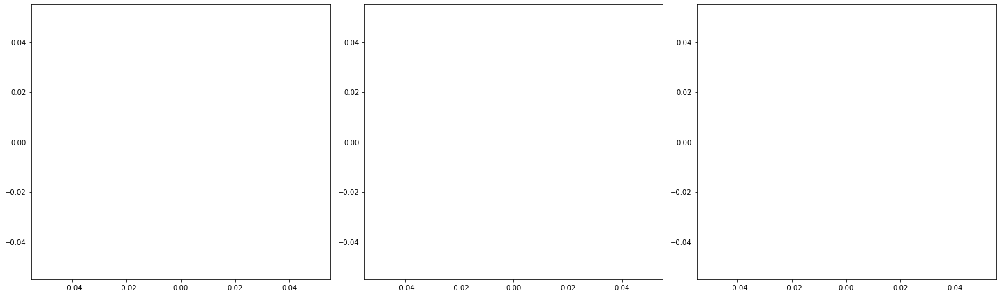

2220 582
Train Epoch: 1 [0/2220 (0%)]	Loss: 0.062362	Pres: 0.000000	F1 Score: 0.000000
86.0 -31888.0


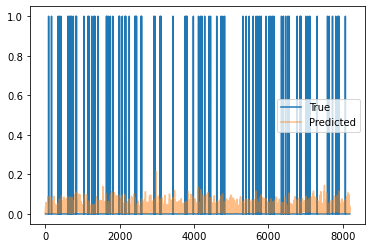

Train Epoch: 1 [10/2220 (0%)]	Loss: 0.060040	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [20/2220 (0%)]	Loss: 0.061540	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [30/2220 (1%)]	Loss: 0.059901	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [40/2220 (1%)]	Loss: 0.062220	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [50/2220 (2%)]	Loss: 0.061249	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [60/2220 (2%)]	Loss: 0.061238	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [70/2220 (3%)]	Loss: 0.065257	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [80/2220 (3%)]	Loss: 0.058958	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [90/2220 (4%)]	Loss: 0.057358	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [100/2220 (4%)]	Loss: 0.058956	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [110/2220 (4%)]	Loss: 0.058572	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [120/2220 (5%)]	Loss: 0.060692	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [130/2220 (5%)]	Loss: 0.058667	Pre

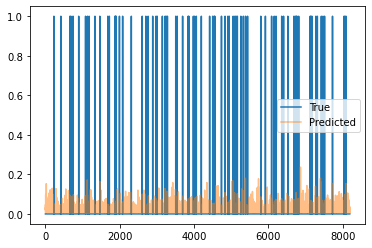

Train Epoch: 1 [310/2220 (13%)]	Loss: 0.051542	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [320/2220 (14%)]	Loss: 0.057682	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [330/2220 (14%)]	Loss: 0.059101	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [340/2220 (15%)]	Loss: 0.053030	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 1 [350/2220 (15%)]	Loss: 0.059076	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [360/2220 (16%)]	Loss: 0.051992	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [370/2220 (16%)]	Loss: 0.056942	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [380/2220 (17%)]	Loss: 0.056090	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [390/2220 (17%)]	Loss: 0.059801	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [400/2220 (18%)]	Loss: 0.056240	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [410/2220 (18%)]	Loss: 0.056541	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [420/2220 (18%)]	Loss: 0.050518	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [430/2220 (19

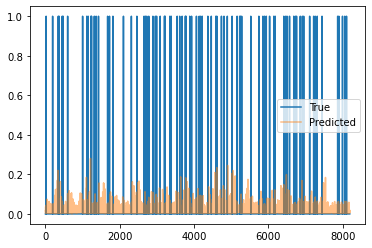

Train Epoch: 1 [610/2220 (27%)]	Loss: 0.053948	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [620/2220 (27%)]	Loss: 0.046234	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [630/2220 (28%)]	Loss: 0.054725	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [640/2220 (28%)]	Loss: 0.058377	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 1 [650/2220 (29%)]	Loss: 0.051403	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [660/2220 (29%)]	Loss: 0.054147	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [670/2220 (30%)]	Loss: 0.052068	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 1 [680/2220 (30%)]	Loss: 0.056070	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [690/2220 (31%)]	Loss: 0.051060	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [700/2220 (31%)]	Loss: 0.052927	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 1 [710/2220 (31%)]	Loss: 0.054204	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [720/2220 (32%)]	Loss: 0.048023	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [730/2220 (32

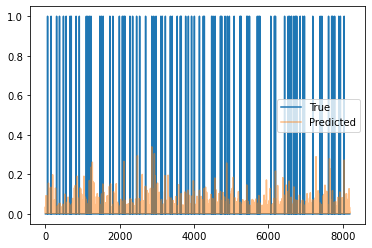

Train Epoch: 1 [910/2220 (40%)]	Loss: 0.052061	Pres: 0.000732	F1 Score: 0.000732
Train Epoch: 1 [920/2220 (41%)]	Loss: 0.048530	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [930/2220 (41%)]	Loss: 0.050465	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [940/2220 (42%)]	Loss: 0.053569	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 1 [950/2220 (42%)]	Loss: 0.050822	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [960/2220 (43%)]	Loss: 0.050786	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 1 [970/2220 (43%)]	Loss: 0.053814	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [980/2220 (44%)]	Loss: 0.052256	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 1 [990/2220 (44%)]	Loss: 0.048998	Pres: 0.000488	F1 Score: 0.000488
Train Epoch: 1 [1000/2220 (45%)]	Loss: 0.049371	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [1010/2220 (45%)]	Loss: 0.049886	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [1020/2220 (45%)]	Loss: 0.053849	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 1 [1030/2220

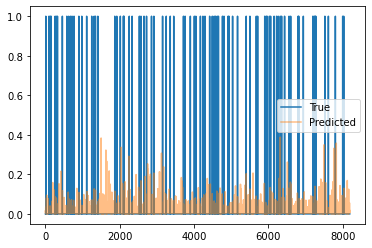

Train Epoch: 1 [1210/2220 (54%)]	Loss: 0.047334	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 1 [1220/2220 (54%)]	Loss: 0.052095	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 1 [1230/2220 (55%)]	Loss: 0.050840	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 1 [1240/2220 (55%)]	Loss: 0.048847	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 1 [1250/2220 (56%)]	Loss: 0.046852	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [1260/2220 (56%)]	Loss: 0.045584	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [1270/2220 (57%)]	Loss: 0.051911	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 1 [1280/2220 (57%)]	Loss: 0.047352	Pres: 0.000854	F1 Score: 0.000854
Train Epoch: 1 [1290/2220 (58%)]	Loss: 0.055413	Pres: 0.000610	F1 Score: 0.000610
Train Epoch: 1 [1300/2220 (58%)]	Loss: 0.048111	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [1310/2220 (59%)]	Loss: 0.052838	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [1320/2220 (59%)]	Loss: 0.052681	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [

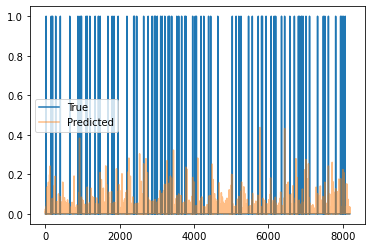

Train Epoch: 1 [1510/2220 (68%)]	Loss: 0.044889	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 1 [1520/2220 (68%)]	Loss: 0.050057	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [1530/2220 (68%)]	Loss: 0.044898	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 1 [1540/2220 (69%)]	Loss: 0.051196	Pres: 0.000366	F1 Score: 0.000366
Train Epoch: 1 [1550/2220 (69%)]	Loss: 0.046838	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 1 [1560/2220 (70%)]	Loss: 0.046236	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 1 [1570/2220 (70%)]	Loss: 0.048332	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 1 [1580/2220 (71%)]	Loss: 0.043766	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 1 [1590/2220 (71%)]	Loss: 0.042033	Pres: 0.000854	F1 Score: 0.000854
Train Epoch: 1 [1600/2220 (72%)]	Loss: 0.043773	Pres: 0.000366	F1 Score: 0.000366
Train Epoch: 1 [1610/2220 (72%)]	Loss: 0.047629	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [1620/2220 (72%)]	Loss: 0.048757	Pres: 0.000610	F1 Score: 0.000610
Train Epoch: 1 [

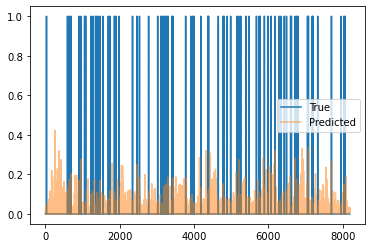

Train Epoch: 1 [1810/2220 (81%)]	Loss: 0.050107	Pres: 0.000488	F1 Score: 0.000488
Train Epoch: 1 [1820/2220 (81%)]	Loss: 0.047559	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [1830/2220 (82%)]	Loss: 0.048335	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 1 [1840/2220 (82%)]	Loss: 0.049809	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 1 [1850/2220 (83%)]	Loss: 0.048822	Pres: 0.000366	F1 Score: 0.000366
Train Epoch: 1 [1860/2220 (83%)]	Loss: 0.045423	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 1 [1870/2220 (84%)]	Loss: 0.045014	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 1 [1880/2220 (84%)]	Loss: 0.045345	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [1890/2220 (85%)]	Loss: 0.052538	Pres: 0.000854	F1 Score: 0.000854
Train Epoch: 1 [1900/2220 (85%)]	Loss: 0.044812	Pres: 0.000488	F1 Score: 0.000488
Train Epoch: 1 [1910/2220 (86%)]	Loss: 0.044850	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [1920/2220 (86%)]	Loss: 0.047616	Pres: 0.000366	F1 Score: 0.000366
Train Epoch: 1 [

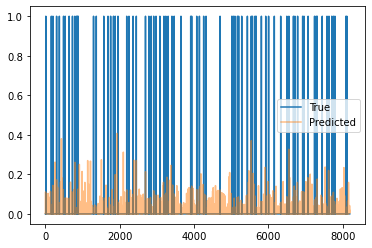

Train Epoch: 1 [2110/2220 (95%)]	Loss: 0.049486	Pres: 0.000732	F1 Score: 0.000732
Train Epoch: 1 [2120/2220 (95%)]	Loss: 0.051661	Pres: 0.000366	F1 Score: 0.000366
Train Epoch: 1 [2130/2220 (95%)]	Loss: 0.044894	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 1 [2140/2220 (96%)]	Loss: 0.048768	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [2150/2220 (96%)]	Loss: 0.047472	Pres: 0.000366	F1 Score: 0.000366
Train Epoch: 1 [2160/2220 (97%)]	Loss: 0.044292	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 1 [2170/2220 (97%)]	Loss: 0.044005	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [2180/2220 (98%)]	Loss: 0.045905	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 1 [2190/2220 (98%)]	Loss: 0.046960	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 1 [2200/2220 (99%)]	Loss: 0.039840	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 1 [2210/2220 (99%)]	Loss: 0.046249	Pres: 0.000488	F1 Score: 0.000488
Validation Epoch: 1 [0/582 (0%)]	Loss: 0.044007	Pres: 0.000000	F1 Score: 0.000000


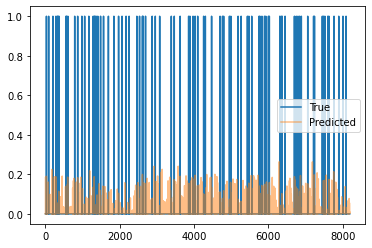

Validation Epoch: 1 [10/582 (1%)]	Loss: 0.044954	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 1 [20/582 (3%)]	Loss: 0.044008	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 1 [30/582 (5%)]	Loss: 0.043885	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 1 [40/582 (6%)]	Loss: 0.041426	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 1 [50/582 (8%)]	Loss: 0.043500	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 1 [60/582 (10%)]	Loss: 0.044563	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 1 [70/582 (12%)]	Loss: 0.037681	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 1 [80/582 (13%)]	Loss: 0.039049	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 1 [90/582 (15%)]	Loss: 0.046581	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 1 [100/582 (17%)]	Loss: 0.039369	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 1 [110/582 (18%)]	Loss: 0.047036	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 1 [120/582 (20%)]	Loss: 0.044101	Pres: 0.000000	F1 Score: 0.0

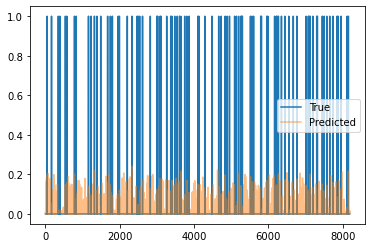

Validation Epoch: 1 [310/582 (53%)]	Loss: 0.046817	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 1 [320/582 (54%)]	Loss: 0.041739	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 1 [330/582 (56%)]	Loss: 0.038991	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 1 [340/582 (58%)]	Loss: 0.039324	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 1 [350/582 (60%)]	Loss: 0.037960	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 1 [360/582 (61%)]	Loss: 0.047064	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 1 [370/582 (63%)]	Loss: 0.044925	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 1 [380/582 (65%)]	Loss: 0.048345	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 1 [390/582 (67%)]	Loss: 0.042397	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 1 [400/582 (68%)]	Loss: 0.045148	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 1 [410/582 (70%)]	Loss: 0.039894	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 1 [420/582 (72%)]	Loss: 0.041192	Pres: 0.000000

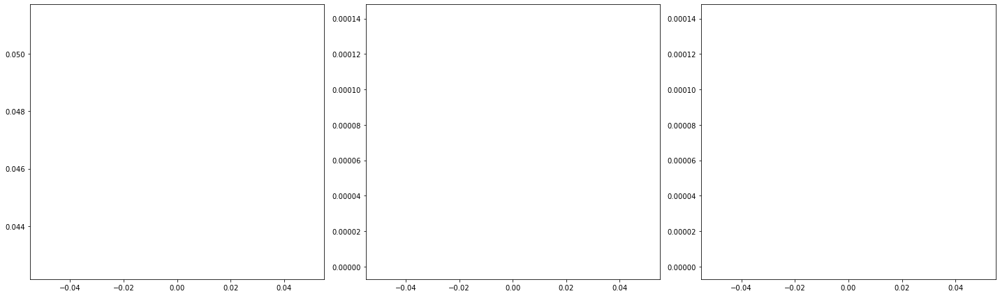

2220 582
Train Epoch: 2 [0/2220 (0%)]	Loss: 0.043571	Pres: 0.000366	F1 Score: 0.000366
80.0 -42656.0


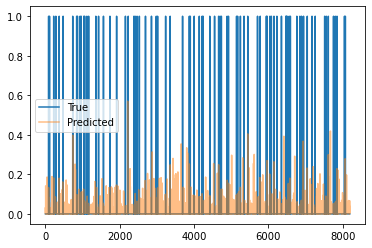

Train Epoch: 2 [10/2220 (0%)]	Loss: 0.045347	Pres: 0.000610	F1 Score: 0.000610
Train Epoch: 2 [20/2220 (0%)]	Loss: 0.043381	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 2 [30/2220 (1%)]	Loss: 0.045778	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [40/2220 (1%)]	Loss: 0.046587	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 2 [50/2220 (2%)]	Loss: 0.047031	Pres: 0.000366	F1 Score: 0.000366
Train Epoch: 2 [60/2220 (2%)]	Loss: 0.046370	Pres: 0.000366	F1 Score: 0.000366
Train Epoch: 2 [70/2220 (3%)]	Loss: 0.046749	Pres: 0.000366	F1 Score: 0.000366
Train Epoch: 2 [80/2220 (3%)]	Loss: 0.042696	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [90/2220 (4%)]	Loss: 0.043596	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 2 [100/2220 (4%)]	Loss: 0.043965	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 2 [110/2220 (4%)]	Loss: 0.040935	Pres: 0.000366	F1 Score: 0.000366
Train Epoch: 2 [120/2220 (5%)]	Loss: 0.045676	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [130/2220 (5%)]	Loss: 0.042526	Pre

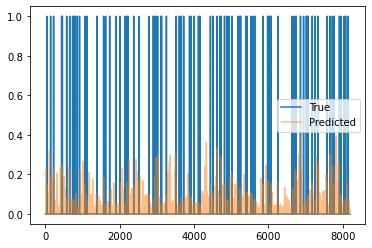

Train Epoch: 2 [310/2220 (13%)]	Loss: 0.048218	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [320/2220 (14%)]	Loss: 0.049109	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [330/2220 (14%)]	Loss: 0.044452	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 2 [340/2220 (15%)]	Loss: 0.047409	Pres: 0.000610	F1 Score: 0.000610
Train Epoch: 2 [350/2220 (15%)]	Loss: 0.042828	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 2 [360/2220 (16%)]	Loss: 0.044167	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 2 [370/2220 (16%)]	Loss: 0.045375	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [380/2220 (17%)]	Loss: 0.036010	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [390/2220 (17%)]	Loss: 0.048973	Pres: 0.000488	F1 Score: 0.000488
Train Epoch: 2 [400/2220 (18%)]	Loss: 0.045719	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [410/2220 (18%)]	Loss: 0.043564	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 2 [420/2220 (18%)]	Loss: 0.045559	Pres: 0.000488	F1 Score: 0.000488
Train Epoch: 2 [430/2220 (19

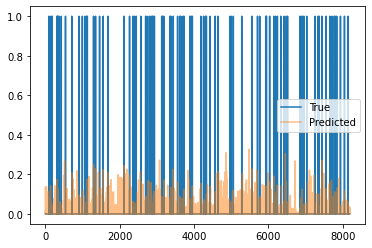

Train Epoch: 2 [610/2220 (27%)]	Loss: 0.049069	Pres: 0.000366	F1 Score: 0.000366
Train Epoch: 2 [620/2220 (27%)]	Loss: 0.044263	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [630/2220 (28%)]	Loss: 0.045801	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 2 [640/2220 (28%)]	Loss: 0.041856	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [650/2220 (29%)]	Loss: 0.045521	Pres: 0.000732	F1 Score: 0.000732
Train Epoch: 2 [660/2220 (29%)]	Loss: 0.045906	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [670/2220 (30%)]	Loss: 0.039457	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [680/2220 (30%)]	Loss: 0.043492	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 2 [690/2220 (31%)]	Loss: 0.041464	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [700/2220 (31%)]	Loss: 0.047415	Pres: 0.000366	F1 Score: 0.000366
Train Epoch: 2 [710/2220 (31%)]	Loss: 0.046742	Pres: 0.000366	F1 Score: 0.000366
Train Epoch: 2 [720/2220 (32%)]	Loss: 0.042984	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [730/2220 (32

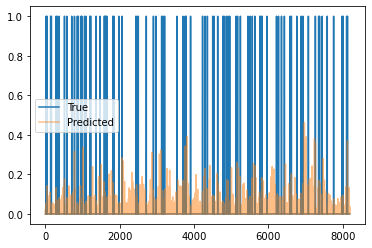

Train Epoch: 2 [910/2220 (40%)]	Loss: 0.038980	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [920/2220 (41%)]	Loss: 0.043613	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [930/2220 (41%)]	Loss: 0.044119	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 2 [940/2220 (42%)]	Loss: 0.047547	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 2 [950/2220 (42%)]	Loss: 0.042340	Pres: 0.000366	F1 Score: 0.000366
Train Epoch: 2 [960/2220 (43%)]	Loss: 0.040266	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 2 [970/2220 (43%)]	Loss: 0.044019	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 2 [980/2220 (44%)]	Loss: 0.043734	Pres: 0.000366	F1 Score: 0.000366
Train Epoch: 2 [990/2220 (44%)]	Loss: 0.046698	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [1000/2220 (45%)]	Loss: 0.042563	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 2 [1010/2220 (45%)]	Loss: 0.045983	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 2 [1020/2220 (45%)]	Loss: 0.040386	Pres: 0.000366	F1 Score: 0.000366
Train Epoch: 2 [1030/2220

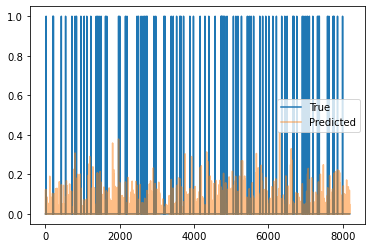

Train Epoch: 2 [1210/2220 (54%)]	Loss: 0.042910	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 2 [1220/2220 (54%)]	Loss: 0.039909	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [1230/2220 (55%)]	Loss: 0.044758	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 2 [1240/2220 (55%)]	Loss: 0.040759	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 2 [1250/2220 (56%)]	Loss: 0.040485	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 2 [1260/2220 (56%)]	Loss: 0.040149	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 2 [1270/2220 (57%)]	Loss: 0.040488	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 2 [1280/2220 (57%)]	Loss: 0.045472	Pres: 0.000366	F1 Score: 0.000366
Train Epoch: 2 [1290/2220 (58%)]	Loss: 0.039622	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 2 [1300/2220 (58%)]	Loss: 0.040816	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 2 [1310/2220 (59%)]	Loss: 0.040493	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 2 [1320/2220 (59%)]	Loss: 0.038587	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 2 [

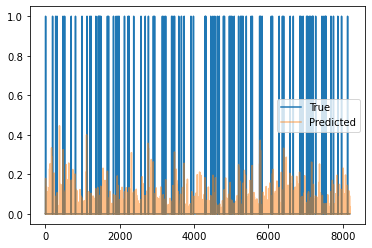

Train Epoch: 2 [1510/2220 (68%)]	Loss: 0.039479	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [1520/2220 (68%)]	Loss: 0.045067	Pres: 0.000732	F1 Score: 0.000732
Train Epoch: 2 [1530/2220 (68%)]	Loss: 0.044509	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [1540/2220 (69%)]	Loss: 0.040798	Pres: 0.000732	F1 Score: 0.000732
Train Epoch: 2 [1550/2220 (69%)]	Loss: 0.042030	Pres: 0.000610	F1 Score: 0.000610
Train Epoch: 2 [1560/2220 (70%)]	Loss: 0.043057	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [1570/2220 (70%)]	Loss: 0.044474	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 2 [1580/2220 (71%)]	Loss: 0.039510	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 2 [1590/2220 (71%)]	Loss: 0.039065	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [1600/2220 (72%)]	Loss: 0.043265	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 2 [1610/2220 (72%)]	Loss: 0.042724	Pres: 0.000488	F1 Score: 0.000488
Train Epoch: 2 [1620/2220 (72%)]	Loss: 0.041723	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [

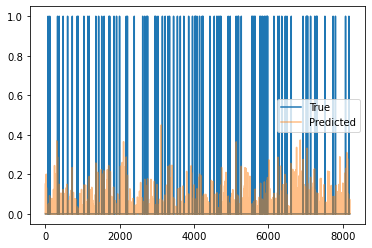

Train Epoch: 2 [1810/2220 (81%)]	Loss: 0.042877	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 2 [1820/2220 (81%)]	Loss: 0.041055	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 2 [1830/2220 (82%)]	Loss: 0.040576	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 2 [1840/2220 (82%)]	Loss: 0.037696	Pres: 0.000366	F1 Score: 0.000366
Train Epoch: 2 [1850/2220 (83%)]	Loss: 0.040139	Pres: 0.000488	F1 Score: 0.000488
Train Epoch: 2 [1860/2220 (83%)]	Loss: 0.040233	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [1870/2220 (84%)]	Loss: 0.044384	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 2 [1880/2220 (84%)]	Loss: 0.043495	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [1890/2220 (85%)]	Loss: 0.043628	Pres: 0.000488	F1 Score: 0.000488
Train Epoch: 2 [1900/2220 (85%)]	Loss: 0.041318	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [1910/2220 (86%)]	Loss: 0.044079	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 2 [1920/2220 (86%)]	Loss: 0.039943	Pres: 0.000366	F1 Score: 0.000366
Train Epoch: 2 [

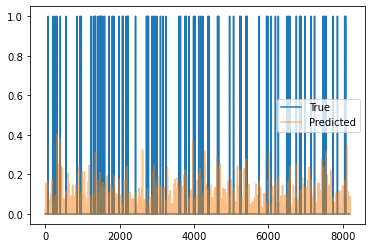

Train Epoch: 2 [2110/2220 (95%)]	Loss: 0.043484	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [2120/2220 (95%)]	Loss: 0.042034	Pres: 0.000366	F1 Score: 0.000366
Train Epoch: 2 [2130/2220 (95%)]	Loss: 0.048795	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [2140/2220 (96%)]	Loss: 0.042737	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 2 [2150/2220 (96%)]	Loss: 0.047628	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 2 [2160/2220 (97%)]	Loss: 0.040436	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [2170/2220 (97%)]	Loss: 0.039740	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 2 [2180/2220 (98%)]	Loss: 0.041876	Pres: 0.000366	F1 Score: 0.000366
Train Epoch: 2 [2190/2220 (98%)]	Loss: 0.043868	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 2 [2200/2220 (99%)]	Loss: 0.040711	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 2 [2210/2220 (99%)]	Loss: 0.040106	Pres: 0.000122	F1 Score: 0.000122
Validation Epoch: 2 [0/582 (0%)]	Loss: 0.042117	Pres: 0.000000	F1 Score: 0.000000


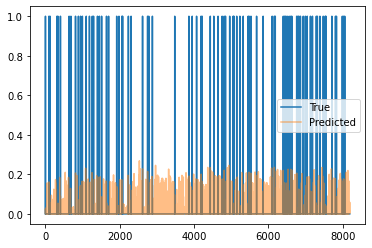

Validation Epoch: 2 [10/582 (1%)]	Loss: 0.041084	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 2 [20/582 (3%)]	Loss: 0.038623	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 2 [30/582 (5%)]	Loss: 0.044099	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 2 [40/582 (6%)]	Loss: 0.035277	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 2 [50/582 (8%)]	Loss: 0.037434	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 2 [60/582 (10%)]	Loss: 0.041854	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 2 [70/582 (12%)]	Loss: 0.039506	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 2 [80/582 (13%)]	Loss: 0.041872	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 2 [90/582 (15%)]	Loss: 0.041384	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 2 [100/582 (17%)]	Loss: 0.039207	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 2 [110/582 (18%)]	Loss: 0.033736	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 2 [120/582 (20%)]	Loss: 0.039228	Pres: 0.000000	F1 Score: 0.0

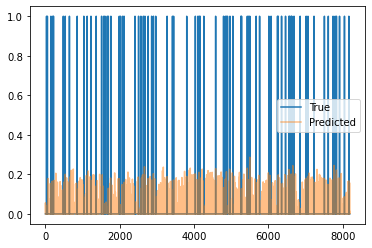

Validation Epoch: 2 [310/582 (53%)]	Loss: 0.040359	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 2 [320/582 (54%)]	Loss: 0.039814	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 2 [330/582 (56%)]	Loss: 0.038124	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 2 [340/582 (58%)]	Loss: 0.038708	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 2 [350/582 (60%)]	Loss: 0.036241	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 2 [360/582 (61%)]	Loss: 0.042078	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 2 [370/582 (63%)]	Loss: 0.039055	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 2 [380/582 (65%)]	Loss: 0.038387	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 2 [390/582 (67%)]	Loss: 0.037518	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 2 [400/582 (68%)]	Loss: 0.036671	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 2 [410/582 (70%)]	Loss: 0.040242	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 2 [420/582 (72%)]	Loss: 0.036159	Pres: 0.000000

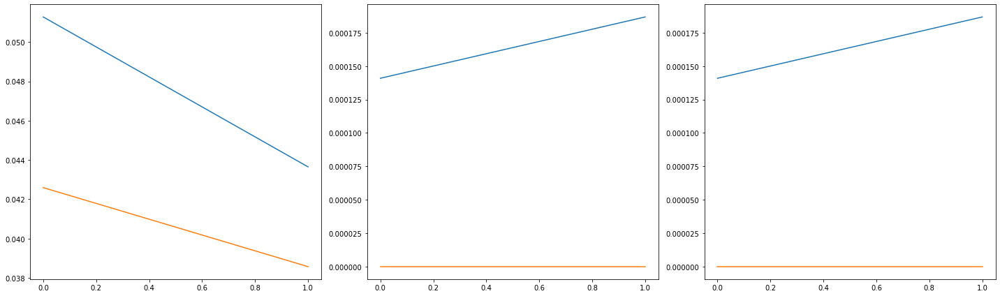

2220 582
Train Epoch: 3 [0/2220 (0%)]	Loss: 0.040578	Pres: 0.000122	F1 Score: 0.000122
77.0 -51264.0


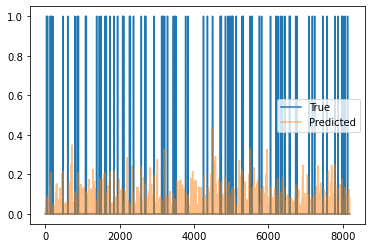

Train Epoch: 3 [10/2220 (0%)]	Loss: 0.042796	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 3 [20/2220 (0%)]	Loss: 0.045981	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 3 [30/2220 (1%)]	Loss: 0.042713	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [40/2220 (1%)]	Loss: 0.045247	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [50/2220 (2%)]	Loss: 0.040633	Pres: 0.000488	F1 Score: 0.000488
Train Epoch: 3 [60/2220 (2%)]	Loss: 0.041546	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 3 [70/2220 (3%)]	Loss: 0.041404	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 3 [80/2220 (3%)]	Loss: 0.041864	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [90/2220 (4%)]	Loss: 0.044468	Pres: 0.000366	F1 Score: 0.000366
Train Epoch: 3 [100/2220 (4%)]	Loss: 0.041385	Pres: 0.000488	F1 Score: 0.000488
Train Epoch: 3 [110/2220 (4%)]	Loss: 0.040825	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 3 [120/2220 (5%)]	Loss: 0.042458	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [130/2220 (5%)]	Loss: 0.045385	Pre

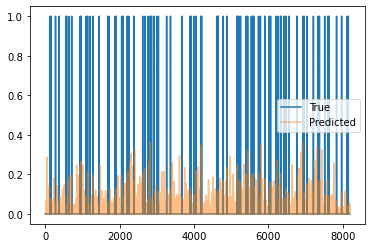

Train Epoch: 3 [310/2220 (13%)]	Loss: 0.044552	Pres: 0.000366	F1 Score: 0.000366
Train Epoch: 3 [320/2220 (14%)]	Loss: 0.040392	Pres: 0.000366	F1 Score: 0.000366
Train Epoch: 3 [330/2220 (14%)]	Loss: 0.042424	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 3 [340/2220 (15%)]	Loss: 0.044586	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 3 [350/2220 (15%)]	Loss: 0.043870	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 3 [360/2220 (16%)]	Loss: 0.041934	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 3 [370/2220 (16%)]	Loss: 0.043473	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 3 [380/2220 (17%)]	Loss: 0.043253	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 3 [390/2220 (17%)]	Loss: 0.041815	Pres: 0.000366	F1 Score: 0.000366
Train Epoch: 3 [400/2220 (18%)]	Loss: 0.043894	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 3 [410/2220 (18%)]	Loss: 0.042786	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 3 [420/2220 (18%)]	Loss: 0.041639	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [430/2220 (19

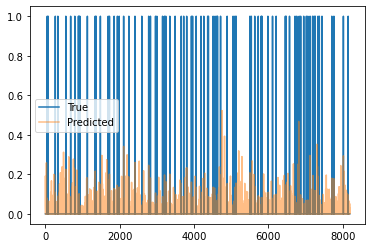

Train Epoch: 3 [610/2220 (27%)]	Loss: 0.045523	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 3 [620/2220 (27%)]	Loss: 0.043119	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [630/2220 (28%)]	Loss: 0.038410	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 3 [640/2220 (28%)]	Loss: 0.043808	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [650/2220 (29%)]	Loss: 0.044161	Pres: 0.000488	F1 Score: 0.000488
Train Epoch: 3 [660/2220 (29%)]	Loss: 0.042437	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [670/2220 (30%)]	Loss: 0.036405	Pres: 0.000488	F1 Score: 0.000488
Train Epoch: 3 [680/2220 (30%)]	Loss: 0.038157	Pres: 0.000610	F1 Score: 0.000610
Train Epoch: 3 [690/2220 (31%)]	Loss: 0.047097	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [700/2220 (31%)]	Loss: 0.044578	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 3 [710/2220 (31%)]	Loss: 0.043191	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 3 [720/2220 (32%)]	Loss: 0.044876	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [730/2220 (32

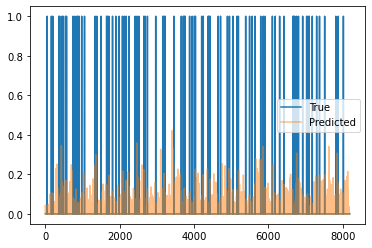

Train Epoch: 3 [910/2220 (40%)]	Loss: 0.043767	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 3 [920/2220 (41%)]	Loss: 0.039826	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 3 [930/2220 (41%)]	Loss: 0.037732	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [940/2220 (42%)]	Loss: 0.043345	Pres: 0.000366	F1 Score: 0.000366
Train Epoch: 3 [950/2220 (42%)]	Loss: 0.037947	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 3 [960/2220 (43%)]	Loss: 0.044507	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 3 [970/2220 (43%)]	Loss: 0.038367	Pres: 0.000488	F1 Score: 0.000488
Train Epoch: 3 [980/2220 (44%)]	Loss: 0.043910	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 3 [990/2220 (44%)]	Loss: 0.041705	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 3 [1000/2220 (45%)]	Loss: 0.042781	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [1010/2220 (45%)]	Loss: 0.034643	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 3 [1020/2220 (45%)]	Loss: 0.042362	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 3 [1030/2220

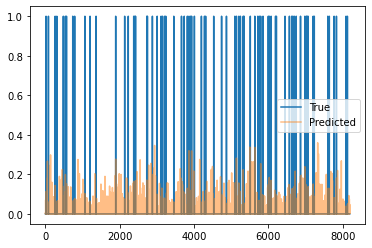

Train Epoch: 3 [1210/2220 (54%)]	Loss: 0.044472	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 3 [1220/2220 (54%)]	Loss: 0.037597	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 3 [1230/2220 (55%)]	Loss: 0.042372	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 3 [1240/2220 (55%)]	Loss: 0.042953	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 3 [1250/2220 (56%)]	Loss: 0.039021	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [1260/2220 (56%)]	Loss: 0.044479	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [1270/2220 (57%)]	Loss: 0.040695	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 3 [1280/2220 (57%)]	Loss: 0.038312	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [1290/2220 (58%)]	Loss: 0.041635	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [1300/2220 (58%)]	Loss: 0.037753	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [1310/2220 (59%)]	Loss: 0.042518	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 3 [1320/2220 (59%)]	Loss: 0.040244	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 3 [

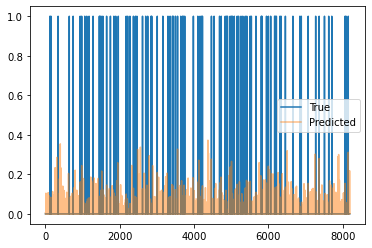

Train Epoch: 3 [1510/2220 (68%)]	Loss: 0.039840	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [1520/2220 (68%)]	Loss: 0.036566	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 3 [1530/2220 (68%)]	Loss: 0.037656	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [1540/2220 (69%)]	Loss: 0.041577	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [1550/2220 (69%)]	Loss: 0.041836	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 3 [1560/2220 (70%)]	Loss: 0.045729	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 3 [1570/2220 (70%)]	Loss: 0.034247	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 3 [1580/2220 (71%)]	Loss: 0.042033	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 3 [1590/2220 (71%)]	Loss: 0.036984	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 3 [1600/2220 (72%)]	Loss: 0.041246	Pres: 0.000488	F1 Score: 0.000488
Train Epoch: 3 [1610/2220 (72%)]	Loss: 0.039627	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [1620/2220 (72%)]	Loss: 0.040126	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 3 [

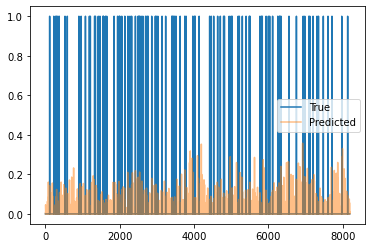

Train Epoch: 3 [1810/2220 (81%)]	Loss: 0.041049	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 3 [1820/2220 (81%)]	Loss: 0.038979	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 3 [1830/2220 (82%)]	Loss: 0.034667	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 3 [1840/2220 (82%)]	Loss: 0.040279	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 3 [1850/2220 (83%)]	Loss: 0.040343	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [1860/2220 (83%)]	Loss: 0.041027	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 3 [1870/2220 (84%)]	Loss: 0.041210	Pres: 0.000854	F1 Score: 0.000854
Train Epoch: 3 [1880/2220 (84%)]	Loss: 0.041977	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [1890/2220 (85%)]	Loss: 0.036579	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 3 [1900/2220 (85%)]	Loss: 0.037556	Pres: 0.000366	F1 Score: 0.000366
Train Epoch: 3 [1910/2220 (86%)]	Loss: 0.042560	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 3 [1920/2220 (86%)]	Loss: 0.038535	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 3 [

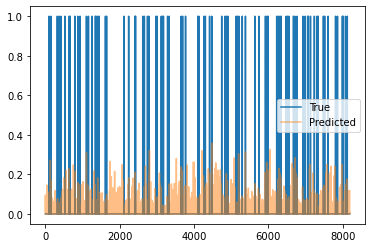

Train Epoch: 3 [2110/2220 (95%)]	Loss: 0.040464	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 3 [2120/2220 (95%)]	Loss: 0.041868	Pres: 0.000610	F1 Score: 0.000610
Train Epoch: 3 [2130/2220 (95%)]	Loss: 0.040892	Pres: 0.000610	F1 Score: 0.000610
Train Epoch: 3 [2140/2220 (96%)]	Loss: 0.037847	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [2150/2220 (96%)]	Loss: 0.040216	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 3 [2160/2220 (97%)]	Loss: 0.041231	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 3 [2170/2220 (97%)]	Loss: 0.039160	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [2180/2220 (98%)]	Loss: 0.043360	Pres: 0.000366	F1 Score: 0.000366
Train Epoch: 3 [2190/2220 (98%)]	Loss: 0.043199	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 3 [2200/2220 (99%)]	Loss: 0.043928	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 3 [2210/2220 (99%)]	Loss: 0.041381	Pres: 0.000122	F1 Score: 0.000122
Validation Epoch: 3 [0/582 (0%)]	Loss: 0.038514	Pres: 0.000000	F1 Score: 0.000000


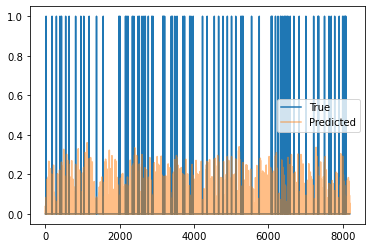

Validation Epoch: 3 [10/582 (1%)]	Loss: 0.042528	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 3 [20/582 (3%)]	Loss: 0.038813	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 3 [30/582 (5%)]	Loss: 0.035192	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 3 [40/582 (6%)]	Loss: 0.040591	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 3 [50/582 (8%)]	Loss: 0.036706	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 3 [60/582 (10%)]	Loss: 0.036973	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 3 [70/582 (12%)]	Loss: 0.037733	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 3 [80/582 (13%)]	Loss: 0.040428	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 3 [90/582 (15%)]	Loss: 0.039033	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 3 [100/582 (17%)]	Loss: 0.041460	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 3 [110/582 (18%)]	Loss: 0.035098	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 3 [120/582 (20%)]	Loss: 0.035105	Pres: 0.000000	F1 Score: 0.0

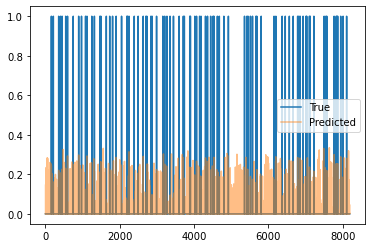

Validation Epoch: 3 [310/582 (53%)]	Loss: 0.043756	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 3 [320/582 (54%)]	Loss: 0.039138	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 3 [330/582 (56%)]	Loss: 0.039290	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 3 [340/582 (58%)]	Loss: 0.037098	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 3 [350/582 (60%)]	Loss: 0.039363	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 3 [360/582 (61%)]	Loss: 0.037345	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 3 [370/582 (63%)]	Loss: 0.034609	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 3 [380/582 (65%)]	Loss: 0.039514	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 3 [390/582 (67%)]	Loss: 0.039812	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 3 [400/582 (68%)]	Loss: 0.035920	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 3 [410/582 (70%)]	Loss: 0.036014	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 3 [420/582 (72%)]	Loss: 0.039448	Pres: 0.000000

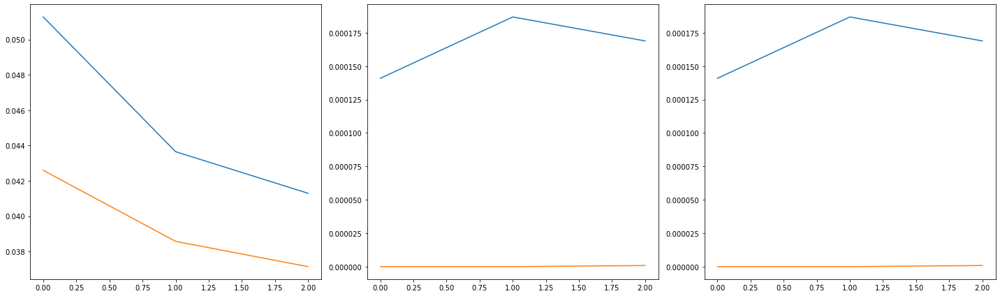

2220 582
Train Epoch: 4 [0/2220 (0%)]	Loss: 0.038428	Pres: 0.000000	F1 Score: 0.000000
78.0 -58976.0


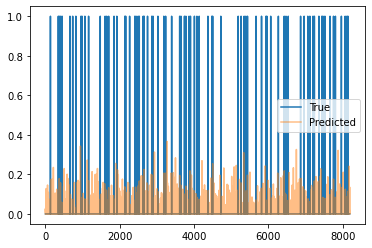

Train Epoch: 4 [10/2220 (0%)]	Loss: 0.038410	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 4 [20/2220 (0%)]	Loss: 0.037621	Pres: 0.000488	F1 Score: 0.000488
Train Epoch: 4 [30/2220 (1%)]	Loss: 0.046483	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 4 [40/2220 (1%)]	Loss: 0.037116	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 4 [50/2220 (2%)]	Loss: 0.039074	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 4 [60/2220 (2%)]	Loss: 0.037242	Pres: 0.000610	F1 Score: 0.000610
Train Epoch: 4 [70/2220 (3%)]	Loss: 0.043312	Pres: 0.000366	F1 Score: 0.000366
Train Epoch: 4 [80/2220 (3%)]	Loss: 0.039716	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 4 [90/2220 (4%)]	Loss: 0.040129	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 4 [100/2220 (4%)]	Loss: 0.039662	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [110/2220 (4%)]	Loss: 0.039536	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [120/2220 (5%)]	Loss: 0.037563	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 4 [130/2220 (5%)]	Loss: 0.038802	Pre

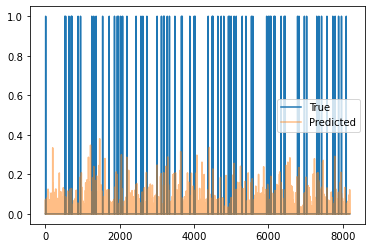

Train Epoch: 4 [310/2220 (13%)]	Loss: 0.038932	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 4 [320/2220 (14%)]	Loss: 0.040582	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 4 [330/2220 (14%)]	Loss: 0.038347	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [340/2220 (15%)]	Loss: 0.042858	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [350/2220 (15%)]	Loss: 0.035468	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 4 [360/2220 (16%)]	Loss: 0.041586	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [370/2220 (16%)]	Loss: 0.043969	Pres: 0.000366	F1 Score: 0.000366
Train Epoch: 4 [380/2220 (17%)]	Loss: 0.043262	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 4 [390/2220 (17%)]	Loss: 0.037526	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 4 [400/2220 (18%)]	Loss: 0.040691	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [410/2220 (18%)]	Loss: 0.039605	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 4 [420/2220 (18%)]	Loss: 0.041081	Pres: 0.000488	F1 Score: 0.000488
Train Epoch: 4 [430/2220 (19

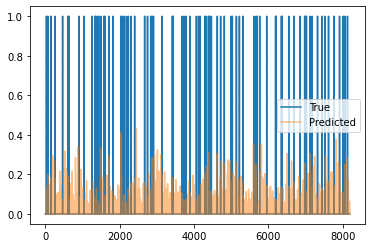

Train Epoch: 4 [610/2220 (27%)]	Loss: 0.037716	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [620/2220 (27%)]	Loss: 0.041623	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 4 [630/2220 (28%)]	Loss: 0.043191	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 4 [640/2220 (28%)]	Loss: 0.040440	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 4 [650/2220 (29%)]	Loss: 0.040597	Pres: 0.000366	F1 Score: 0.000366
Train Epoch: 4 [660/2220 (29%)]	Loss: 0.038673	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [670/2220 (30%)]	Loss: 0.039470	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 4 [680/2220 (30%)]	Loss: 0.037904	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [690/2220 (31%)]	Loss: 0.038833	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [700/2220 (31%)]	Loss: 0.045091	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 4 [710/2220 (31%)]	Loss: 0.046558	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 4 [720/2220 (32%)]	Loss: 0.037224	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [730/2220 (32

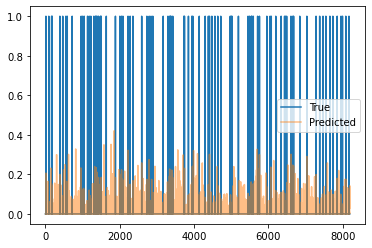

Train Epoch: 4 [910/2220 (40%)]	Loss: 0.042466	Pres: 0.000366	F1 Score: 0.000366
Train Epoch: 4 [920/2220 (41%)]	Loss: 0.037229	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 4 [930/2220 (41%)]	Loss: 0.043686	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 4 [940/2220 (42%)]	Loss: 0.041403	Pres: 0.000366	F1 Score: 0.000366
Train Epoch: 4 [950/2220 (42%)]	Loss: 0.036478	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 4 [960/2220 (43%)]	Loss: 0.041267	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [970/2220 (43%)]	Loss: 0.039522	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 4 [980/2220 (44%)]	Loss: 0.039877	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 4 [990/2220 (44%)]	Loss: 0.043210	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 4 [1000/2220 (45%)]	Loss: 0.041120	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 4 [1010/2220 (45%)]	Loss: 0.041459	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 4 [1020/2220 (45%)]	Loss: 0.041981	Pres: 0.000488	F1 Score: 0.000488
Train Epoch: 4 [1030/2220

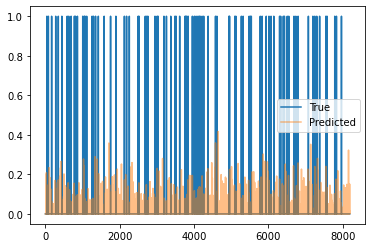

Train Epoch: 4 [1210/2220 (54%)]	Loss: 0.032162	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [1220/2220 (54%)]	Loss: 0.041613	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 4 [1230/2220 (55%)]	Loss: 0.043083	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 4 [1240/2220 (55%)]	Loss: 0.039273	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 4 [1250/2220 (56%)]	Loss: 0.036559	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 4 [1260/2220 (56%)]	Loss: 0.044145	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 4 [1270/2220 (57%)]	Loss: 0.038196	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [1280/2220 (57%)]	Loss: 0.038439	Pres: 0.000366	F1 Score: 0.000366
Train Epoch: 4 [1290/2220 (58%)]	Loss: 0.039267	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [1300/2220 (58%)]	Loss: 0.038254	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 4 [1310/2220 (59%)]	Loss: 0.038458	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 4 [1320/2220 (59%)]	Loss: 0.039671	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 4 [

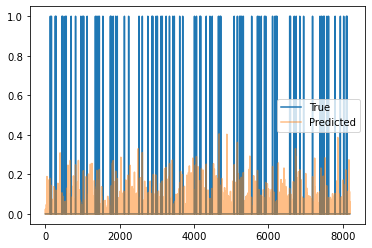

Train Epoch: 4 [1510/2220 (68%)]	Loss: 0.038601	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [1520/2220 (68%)]	Loss: 0.035685	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 4 [1530/2220 (68%)]	Loss: 0.039723	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [1540/2220 (69%)]	Loss: 0.041640	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 4 [1550/2220 (69%)]	Loss: 0.037653	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 4 [1560/2220 (70%)]	Loss: 0.038865	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 4 [1570/2220 (70%)]	Loss: 0.038702	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 4 [1580/2220 (71%)]	Loss: 0.039022	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 4 [1590/2220 (71%)]	Loss: 0.038090	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 4 [1600/2220 (72%)]	Loss: 0.040117	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [1610/2220 (72%)]	Loss: 0.041310	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [1620/2220 (72%)]	Loss: 0.045982	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [

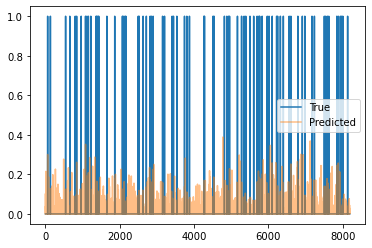

Train Epoch: 4 [1810/2220 (81%)]	Loss: 0.040395	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 4 [1820/2220 (81%)]	Loss: 0.042286	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 4 [1830/2220 (82%)]	Loss: 0.041169	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [1840/2220 (82%)]	Loss: 0.039490	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [1850/2220 (83%)]	Loss: 0.039819	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [1860/2220 (83%)]	Loss: 0.041049	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 4 [1870/2220 (84%)]	Loss: 0.046603	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [1880/2220 (84%)]	Loss: 0.042675	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [1890/2220 (85%)]	Loss: 0.040013	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [1900/2220 (85%)]	Loss: 0.038502	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 4 [1910/2220 (86%)]	Loss: 0.044678	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [1920/2220 (86%)]	Loss: 0.037904	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [

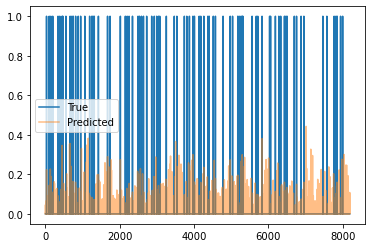

Train Epoch: 4 [2110/2220 (95%)]	Loss: 0.037942	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [2120/2220 (95%)]	Loss: 0.036063	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [2130/2220 (95%)]	Loss: 0.037488	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [2140/2220 (96%)]	Loss: 0.041127	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [2150/2220 (96%)]	Loss: 0.038385	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 4 [2160/2220 (97%)]	Loss: 0.037280	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 4 [2170/2220 (97%)]	Loss: 0.033958	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 4 [2180/2220 (98%)]	Loss: 0.036199	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 4 [2190/2220 (98%)]	Loss: 0.039832	Pres: 0.000488	F1 Score: 0.000488
Train Epoch: 4 [2200/2220 (99%)]	Loss: 0.039833	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 4 [2210/2220 (99%)]	Loss: 0.040790	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 4 [0/582 (0%)]	Loss: 0.043057	Pres: 0.004761	F1 Score: 0.004761


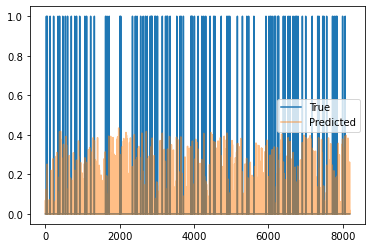

Validation Epoch: 4 [10/582 (1%)]	Loss: 0.038118	Pres: 0.002686	F1 Score: 0.002686
Validation Epoch: 4 [20/582 (3%)]	Loss: 0.037494	Pres: 0.004150	F1 Score: 0.004150
Validation Epoch: 4 [30/582 (5%)]	Loss: 0.039752	Pres: 0.003906	F1 Score: 0.003906
Validation Epoch: 4 [40/582 (6%)]	Loss: 0.041150	Pres: 0.002930	F1 Score: 0.002930
Validation Epoch: 4 [50/582 (8%)]	Loss: 0.039009	Pres: 0.003418	F1 Score: 0.003418
Validation Epoch: 4 [60/582 (10%)]	Loss: 0.040506	Pres: 0.002441	F1 Score: 0.002441
Validation Epoch: 4 [70/582 (12%)]	Loss: 0.039877	Pres: 0.002930	F1 Score: 0.002930
Validation Epoch: 4 [80/582 (13%)]	Loss: 0.038766	Pres: 0.001709	F1 Score: 0.001709
Validation Epoch: 4 [90/582 (15%)]	Loss: 0.038323	Pres: 0.002563	F1 Score: 0.002563
Validation Epoch: 4 [100/582 (17%)]	Loss: 0.038815	Pres: 0.002930	F1 Score: 0.002930
Validation Epoch: 4 [110/582 (18%)]	Loss: 0.036621	Pres: 0.002075	F1 Score: 0.002075
Validation Epoch: 4 [120/582 (20%)]	Loss: 0.036825	Pres: 0.002808	F1 Score: 0.0

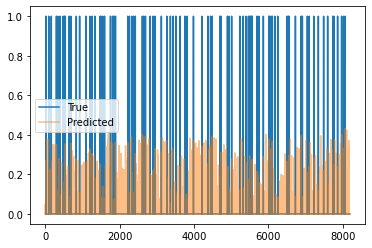

Validation Epoch: 4 [310/582 (53%)]	Loss: 0.040061	Pres: 0.002441	F1 Score: 0.002441
Validation Epoch: 4 [320/582 (54%)]	Loss: 0.036339	Pres: 0.003296	F1 Score: 0.003296
Validation Epoch: 4 [330/582 (56%)]	Loss: 0.037127	Pres: 0.003296	F1 Score: 0.003296
Validation Epoch: 4 [340/582 (58%)]	Loss: 0.037425	Pres: 0.003052	F1 Score: 0.003052
Validation Epoch: 4 [350/582 (60%)]	Loss: 0.035329	Pres: 0.004883	F1 Score: 0.004883
Validation Epoch: 4 [360/582 (61%)]	Loss: 0.036716	Pres: 0.002075	F1 Score: 0.002075
Validation Epoch: 4 [370/582 (63%)]	Loss: 0.040641	Pres: 0.001953	F1 Score: 0.001953
Validation Epoch: 4 [380/582 (65%)]	Loss: 0.039140	Pres: 0.002686	F1 Score: 0.002686
Validation Epoch: 4 [390/582 (67%)]	Loss: 0.040535	Pres: 0.002930	F1 Score: 0.002930
Validation Epoch: 4 [400/582 (68%)]	Loss: 0.042434	Pres: 0.002686	F1 Score: 0.002686
Validation Epoch: 4 [410/582 (70%)]	Loss: 0.040885	Pres: 0.002441	F1 Score: 0.002441
Validation Epoch: 4 [420/582 (72%)]	Loss: 0.038089	Pres: 0.003052

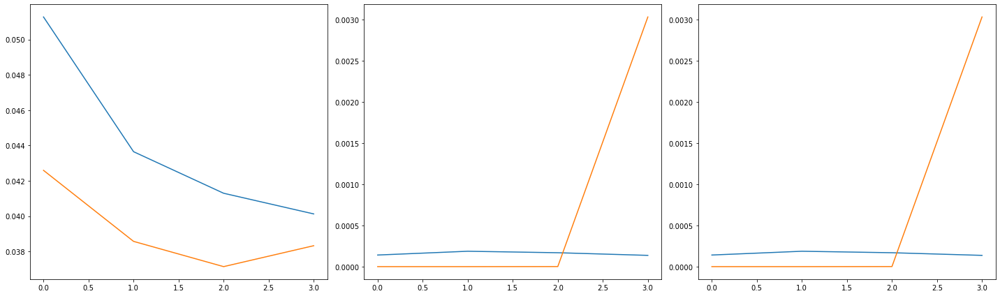

2220 582
Train Epoch: 5 [0/2220 (0%)]	Loss: 0.038850	Pres: 0.000000	F1 Score: 0.000000
83.0 -64928.0


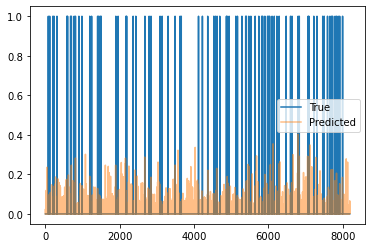

Train Epoch: 5 [10/2220 (0%)]	Loss: 0.039573	Pres: 0.000366	F1 Score: 0.000366
Train Epoch: 5 [20/2220 (0%)]	Loss: 0.045922	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [30/2220 (1%)]	Loss: 0.043203	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [40/2220 (1%)]	Loss: 0.036450	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 5 [50/2220 (2%)]	Loss: 0.046470	Pres: 0.000366	F1 Score: 0.000366
Train Epoch: 5 [60/2220 (2%)]	Loss: 0.039742	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 5 [70/2220 (3%)]	Loss: 0.040258	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [80/2220 (3%)]	Loss: 0.039907	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 5 [90/2220 (4%)]	Loss: 0.041677	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 5 [100/2220 (4%)]	Loss: 0.043760	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 5 [110/2220 (4%)]	Loss: 0.042008	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 5 [120/2220 (5%)]	Loss: 0.036258	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 5 [130/2220 (5%)]	Loss: 0.038564	Pre

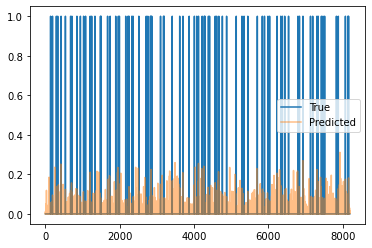

Train Epoch: 5 [310/2220 (13%)]	Loss: 0.045876	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [320/2220 (14%)]	Loss: 0.039180	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [330/2220 (14%)]	Loss: 0.043528	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [340/2220 (15%)]	Loss: 0.045429	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [350/2220 (15%)]	Loss: 0.037959	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [360/2220 (16%)]	Loss: 0.044619	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 5 [370/2220 (16%)]	Loss: 0.044981	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 5 [380/2220 (17%)]	Loss: 0.037671	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 5 [390/2220 (17%)]	Loss: 0.036355	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 5 [400/2220 (18%)]	Loss: 0.037048	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [410/2220 (18%)]	Loss: 0.046611	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 5 [420/2220 (18%)]	Loss: 0.036986	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [430/2220 (19

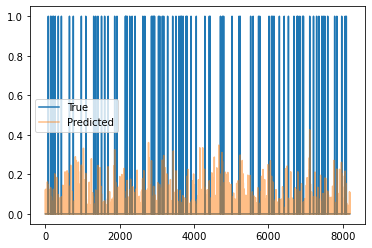

Train Epoch: 5 [610/2220 (27%)]	Loss: 0.042276	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 5 [620/2220 (27%)]	Loss: 0.041354	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 5 [630/2220 (28%)]	Loss: 0.037633	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 5 [640/2220 (28%)]	Loss: 0.036192	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [650/2220 (29%)]	Loss: 0.040722	Pres: 0.000366	F1 Score: 0.000366
Train Epoch: 5 [660/2220 (29%)]	Loss: 0.040807	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [670/2220 (30%)]	Loss: 0.045592	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [680/2220 (30%)]	Loss: 0.039407	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 5 [690/2220 (31%)]	Loss: 0.038282	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [700/2220 (31%)]	Loss: 0.042372	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 5 [710/2220 (31%)]	Loss: 0.039415	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [720/2220 (32%)]	Loss: 0.035167	Pres: 0.000732	F1 Score: 0.000732
Train Epoch: 5 [730/2220 (32

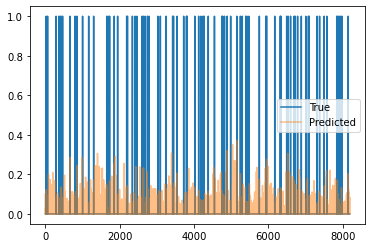

Train Epoch: 5 [910/2220 (40%)]	Loss: 0.037175	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 5 [920/2220 (41%)]	Loss: 0.039638	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [930/2220 (41%)]	Loss: 0.038809	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 5 [940/2220 (42%)]	Loss: 0.046094	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [950/2220 (42%)]	Loss: 0.040400	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [960/2220 (43%)]	Loss: 0.039566	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 5 [970/2220 (43%)]	Loss: 0.039935	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [980/2220 (44%)]	Loss: 0.044476	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 5 [990/2220 (44%)]	Loss: 0.042335	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [1000/2220 (45%)]	Loss: 0.035123	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [1010/2220 (45%)]	Loss: 0.036287	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 5 [1020/2220 (45%)]	Loss: 0.042413	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [1030/2220

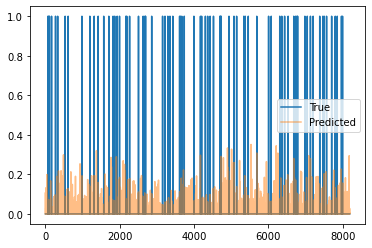

Train Epoch: 5 [1210/2220 (54%)]	Loss: 0.040362	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [1220/2220 (54%)]	Loss: 0.048050	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [1230/2220 (55%)]	Loss: 0.040509	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 5 [1240/2220 (55%)]	Loss: 0.041408	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [1250/2220 (56%)]	Loss: 0.035580	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 5 [1260/2220 (56%)]	Loss: 0.038320	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [1270/2220 (57%)]	Loss: 0.039277	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [1280/2220 (57%)]	Loss: 0.035056	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 5 [1290/2220 (58%)]	Loss: 0.037617	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 5 [1300/2220 (58%)]	Loss: 0.038838	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 5 [1310/2220 (59%)]	Loss: 0.038737	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [1320/2220 (59%)]	Loss: 0.039748	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 5 [

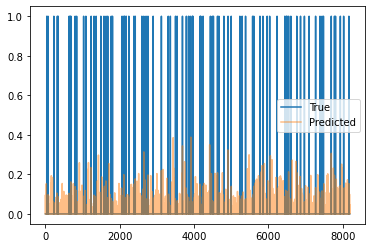

Train Epoch: 5 [1510/2220 (68%)]	Loss: 0.040799	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [1520/2220 (68%)]	Loss: 0.038663	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [1530/2220 (68%)]	Loss: 0.036995	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [1540/2220 (69%)]	Loss: 0.037675	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [1550/2220 (69%)]	Loss: 0.034886	Pres: 0.000366	F1 Score: 0.000366
Train Epoch: 5 [1560/2220 (70%)]	Loss: 0.038108	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 5 [1570/2220 (70%)]	Loss: 0.042644	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 5 [1580/2220 (71%)]	Loss: 0.039554	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [1590/2220 (71%)]	Loss: 0.043232	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [1600/2220 (72%)]	Loss: 0.042627	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [1610/2220 (72%)]	Loss: 0.038176	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 5 [1620/2220 (72%)]	Loss: 0.043107	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 5 [

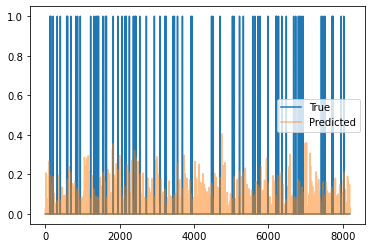

Train Epoch: 5 [1810/2220 (81%)]	Loss: 0.040279	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 5 [1820/2220 (81%)]	Loss: 0.040830	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [1830/2220 (82%)]	Loss: 0.039193	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 5 [1840/2220 (82%)]	Loss: 0.040903	Pres: 0.000366	F1 Score: 0.000366
Train Epoch: 5 [1850/2220 (83%)]	Loss: 0.038206	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [1860/2220 (83%)]	Loss: 0.038483	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [1870/2220 (84%)]	Loss: 0.038091	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [1880/2220 (84%)]	Loss: 0.044256	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [1890/2220 (85%)]	Loss: 0.038164	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 5 [1900/2220 (85%)]	Loss: 0.037315	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 5 [1910/2220 (86%)]	Loss: 0.038028	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 5 [1920/2220 (86%)]	Loss: 0.043877	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [

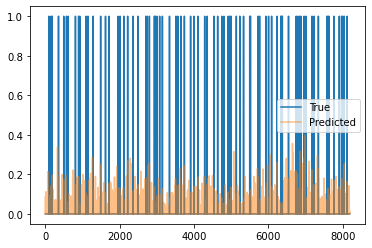

Train Epoch: 5 [2110/2220 (95%)]	Loss: 0.035767	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [2120/2220 (95%)]	Loss: 0.038431	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 5 [2130/2220 (95%)]	Loss: 0.045293	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [2140/2220 (96%)]	Loss: 0.041859	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [2150/2220 (96%)]	Loss: 0.039954	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [2160/2220 (97%)]	Loss: 0.041592	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 5 [2170/2220 (97%)]	Loss: 0.040869	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [2180/2220 (98%)]	Loss: 0.039554	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [2190/2220 (98%)]	Loss: 0.044312	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [2200/2220 (99%)]	Loss: 0.043814	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 5 [2210/2220 (99%)]	Loss: 0.045204	Pres: 0.000122	F1 Score: 0.000122
Validation Epoch: 5 [0/582 (0%)]	Loss: 0.041325	Pres: 0.009399	F1 Score: 0.009399


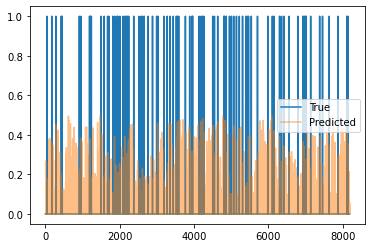

Validation Epoch: 5 [10/582 (1%)]	Loss: 0.042198	Pres: 0.013916	F1 Score: 0.013916
Validation Epoch: 5 [20/582 (3%)]	Loss: 0.041494	Pres: 0.007935	F1 Score: 0.007935
Validation Epoch: 5 [30/582 (5%)]	Loss: 0.040268	Pres: 0.010620	F1 Score: 0.010620
Validation Epoch: 5 [40/582 (6%)]	Loss: 0.039370	Pres: 0.008667	F1 Score: 0.008667
Validation Epoch: 5 [50/582 (8%)]	Loss: 0.040718	Pres: 0.010498	F1 Score: 0.010498
Validation Epoch: 5 [60/582 (10%)]	Loss: 0.042192	Pres: 0.010620	F1 Score: 0.010620
Validation Epoch: 5 [70/582 (12%)]	Loss: 0.041843	Pres: 0.011475	F1 Score: 0.011475
Validation Epoch: 5 [80/582 (13%)]	Loss: 0.043771	Pres: 0.011353	F1 Score: 0.011353
Validation Epoch: 5 [90/582 (15%)]	Loss: 0.043319	Pres: 0.012573	F1 Score: 0.012573
Validation Epoch: 5 [100/582 (17%)]	Loss: 0.042115	Pres: 0.010986	F1 Score: 0.010986
Validation Epoch: 5 [110/582 (18%)]	Loss: 0.043061	Pres: 0.010010	F1 Score: 0.010010
Validation Epoch: 5 [120/582 (20%)]	Loss: 0.042173	Pres: 0.010132	F1 Score: 0.0

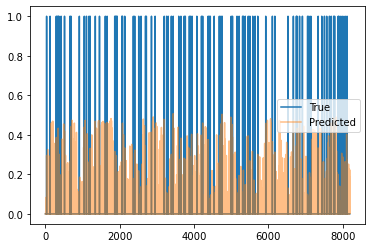

Validation Epoch: 5 [310/582 (53%)]	Loss: 0.039034	Pres: 0.009155	F1 Score: 0.009155
Validation Epoch: 5 [320/582 (54%)]	Loss: 0.039304	Pres: 0.010132	F1 Score: 0.010132
Validation Epoch: 5 [330/582 (56%)]	Loss: 0.039646	Pres: 0.011963	F1 Score: 0.011963
Validation Epoch: 5 [340/582 (58%)]	Loss: 0.039862	Pres: 0.009277	F1 Score: 0.009277
Validation Epoch: 5 [350/582 (60%)]	Loss: 0.041966	Pres: 0.012939	F1 Score: 0.012939
Validation Epoch: 5 [360/582 (61%)]	Loss: 0.038783	Pres: 0.010864	F1 Score: 0.010864
Validation Epoch: 5 [370/582 (63%)]	Loss: 0.040449	Pres: 0.007935	F1 Score: 0.007935
Validation Epoch: 5 [380/582 (65%)]	Loss: 0.040817	Pres: 0.008545	F1 Score: 0.008545
Validation Epoch: 5 [390/582 (67%)]	Loss: 0.042519	Pres: 0.010010	F1 Score: 0.010010
Validation Epoch: 5 [400/582 (68%)]	Loss: 0.041942	Pres: 0.011719	F1 Score: 0.011719
Validation Epoch: 5 [410/582 (70%)]	Loss: 0.042016	Pres: 0.008911	F1 Score: 0.008911
Validation Epoch: 5 [420/582 (72%)]	Loss: 0.039677	Pres: 0.008545

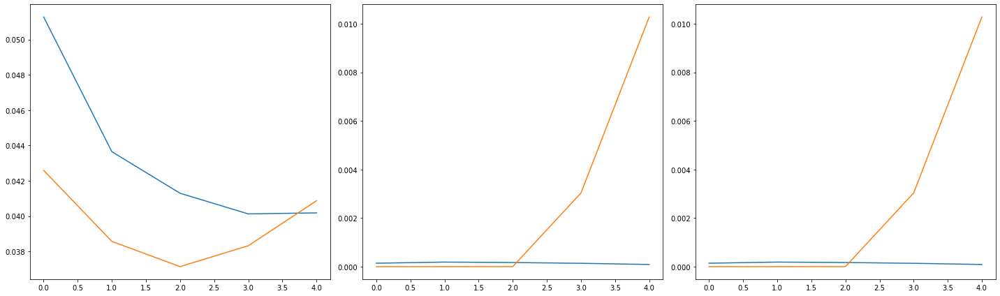

2220 582
Train Epoch: 6 [0/2220 (0%)]	Loss: 0.038877	Pres: 0.000122	F1 Score: 0.000122
80.0 -inf


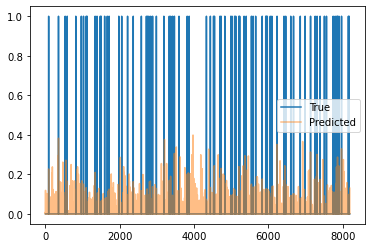

Train Epoch: 6 [10/2220 (0%)]	Loss: 0.040786	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [20/2220 (0%)]	Loss: 0.037287	Pres: 0.000366	F1 Score: 0.000366
Train Epoch: 6 [30/2220 (1%)]	Loss: 0.040666	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 6 [40/2220 (1%)]	Loss: 0.037805	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 6 [50/2220 (2%)]	Loss: 0.040072	Pres: 0.000366	F1 Score: 0.000366
Train Epoch: 6 [60/2220 (2%)]	Loss: 0.037616	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [70/2220 (3%)]	Loss: 0.043649	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [80/2220 (3%)]	Loss: 0.036727	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [90/2220 (4%)]	Loss: 0.043006	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 6 [100/2220 (4%)]	Loss: 0.042384	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 6 [110/2220 (4%)]	Loss: 0.039366	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [120/2220 (5%)]	Loss: 0.036043	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [130/2220 (5%)]	Loss: 0.040445	Pre

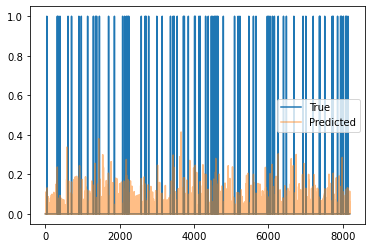

Train Epoch: 6 [310/2220 (13%)]	Loss: 0.041325	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [320/2220 (14%)]	Loss: 0.036288	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 6 [330/2220 (14%)]	Loss: 0.040568	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [340/2220 (15%)]	Loss: 0.039458	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 6 [350/2220 (15%)]	Loss: 0.038931	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [360/2220 (16%)]	Loss: 0.041252	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 6 [370/2220 (16%)]	Loss: 0.046425	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 6 [380/2220 (17%)]	Loss: 0.040351	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 6 [390/2220 (17%)]	Loss: 0.039014	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [400/2220 (18%)]	Loss: 0.041708	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [410/2220 (18%)]	Loss: 0.036159	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 6 [420/2220 (18%)]	Loss: 0.043465	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [430/2220 (19

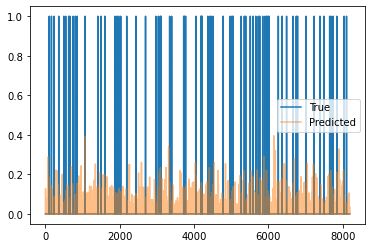

Train Epoch: 6 [610/2220 (27%)]	Loss: 0.042876	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 6 [620/2220 (27%)]	Loss: 0.043319	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [630/2220 (28%)]	Loss: 0.035870	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 6 [640/2220 (28%)]	Loss: 0.044611	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 6 [650/2220 (29%)]	Loss: 0.041250	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 6 [660/2220 (29%)]	Loss: 0.036106	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 6 [670/2220 (30%)]	Loss: 0.038575	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [680/2220 (30%)]	Loss: 0.037277	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [690/2220 (31%)]	Loss: 0.038643	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [700/2220 (31%)]	Loss: 0.041306	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [710/2220 (31%)]	Loss: 0.046580	Pres: 0.000366	F1 Score: 0.000366
Train Epoch: 6 [720/2220 (32%)]	Loss: 0.042172	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [730/2220 (32

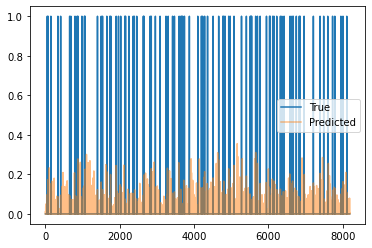

Train Epoch: 6 [910/2220 (40%)]	Loss: 0.043715	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 6 [920/2220 (41%)]	Loss: 0.037699	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [930/2220 (41%)]	Loss: 0.039637	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 6 [940/2220 (42%)]	Loss: 0.043254	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 6 [950/2220 (42%)]	Loss: 0.036431	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [960/2220 (43%)]	Loss: 0.040682	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [970/2220 (43%)]	Loss: 0.039940	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 6 [980/2220 (44%)]	Loss: 0.039872	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [990/2220 (44%)]	Loss: 0.039937	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 6 [1000/2220 (45%)]	Loss: 0.042300	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [1010/2220 (45%)]	Loss: 0.039835	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [1020/2220 (45%)]	Loss: 0.038148	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 6 [1030/2220

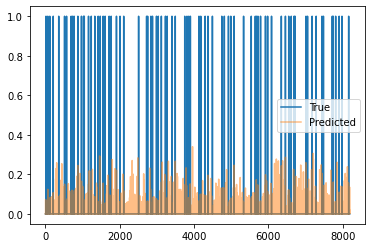

Train Epoch: 6 [1210/2220 (54%)]	Loss: 0.039731	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 6 [1220/2220 (54%)]	Loss: 0.040943	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [1230/2220 (55%)]	Loss: 0.041928	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [1240/2220 (55%)]	Loss: 0.041107	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [1250/2220 (56%)]	Loss: 0.041651	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [1260/2220 (56%)]	Loss: 0.035243	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [1270/2220 (57%)]	Loss: 0.041992	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [1280/2220 (57%)]	Loss: 0.044532	Pres: 0.000366	F1 Score: 0.000366
Train Epoch: 6 [1290/2220 (58%)]	Loss: 0.042983	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [1300/2220 (58%)]	Loss: 0.038792	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 6 [1310/2220 (59%)]	Loss: 0.039465	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [1320/2220 (59%)]	Loss: 0.040476	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 6 [

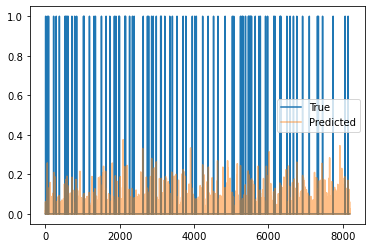

Train Epoch: 6 [1510/2220 (68%)]	Loss: 0.040049	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [1520/2220 (68%)]	Loss: 0.040878	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [1530/2220 (68%)]	Loss: 0.040401	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 6 [1540/2220 (69%)]	Loss: 0.040045	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [1550/2220 (69%)]	Loss: 0.038790	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 6 [1560/2220 (70%)]	Loss: 0.038354	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [1570/2220 (70%)]	Loss: 0.045421	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [1580/2220 (71%)]	Loss: 0.035471	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [1590/2220 (71%)]	Loss: 0.041018	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [1600/2220 (72%)]	Loss: 0.041684	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [1610/2220 (72%)]	Loss: 0.041997	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 6 [1620/2220 (72%)]	Loss: 0.039005	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 6 [

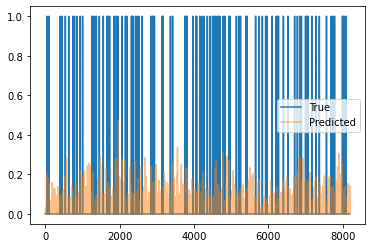

Train Epoch: 6 [1810/2220 (81%)]	Loss: 0.037772	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [1820/2220 (81%)]	Loss: 0.040891	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [1830/2220 (82%)]	Loss: 0.038715	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [1840/2220 (82%)]	Loss: 0.037161	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [1850/2220 (83%)]	Loss: 0.035473	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [1860/2220 (83%)]	Loss: 0.039409	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [1870/2220 (84%)]	Loss: 0.039466	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 6 [1880/2220 (84%)]	Loss: 0.036901	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 6 [1890/2220 (85%)]	Loss: 0.039086	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [1900/2220 (85%)]	Loss: 0.045157	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 6 [1910/2220 (86%)]	Loss: 0.040166	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [1920/2220 (86%)]	Loss: 0.038580	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [

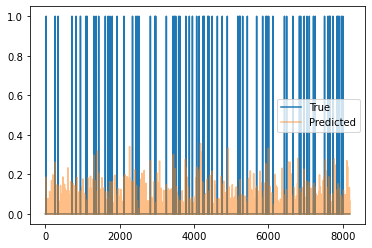

Train Epoch: 6 [2110/2220 (95%)]	Loss: 0.037811	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [2120/2220 (95%)]	Loss: 0.035755	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 6 [2130/2220 (95%)]	Loss: 0.037050	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [2140/2220 (96%)]	Loss: 0.037732	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [2150/2220 (96%)]	Loss: 0.040169	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [2160/2220 (97%)]	Loss: 0.040423	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [2170/2220 (97%)]	Loss: 0.043740	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [2180/2220 (98%)]	Loss: 0.041142	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 6 [2190/2220 (98%)]	Loss: 0.038688	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 6 [2200/2220 (99%)]	Loss: 0.040985	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 6 [2210/2220 (99%)]	Loss: 0.040177	Pres: 0.000122	F1 Score: 0.000122
Validation Epoch: 6 [0/582 (0%)]	Loss: 0.039641	Pres: 0.006958	F1 Score: 0.006958


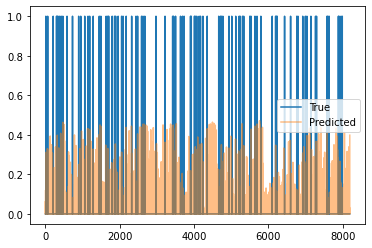

Validation Epoch: 6 [10/582 (1%)]	Loss: 0.041596	Pres: 0.008911	F1 Score: 0.008911
Validation Epoch: 6 [20/582 (3%)]	Loss: 0.040025	Pres: 0.005737	F1 Score: 0.005737
Validation Epoch: 6 [30/582 (5%)]	Loss: 0.043941	Pres: 0.008057	F1 Score: 0.008057
Validation Epoch: 6 [40/582 (6%)]	Loss: 0.040446	Pres: 0.006714	F1 Score: 0.006714
Validation Epoch: 6 [50/582 (8%)]	Loss: 0.038682	Pres: 0.007202	F1 Score: 0.007202
Validation Epoch: 6 [60/582 (10%)]	Loss: 0.040405	Pres: 0.007568	F1 Score: 0.007568
Validation Epoch: 6 [70/582 (12%)]	Loss: 0.038994	Pres: 0.006714	F1 Score: 0.006714
Validation Epoch: 6 [80/582 (13%)]	Loss: 0.039131	Pres: 0.007690	F1 Score: 0.007690
Validation Epoch: 6 [90/582 (15%)]	Loss: 0.039757	Pres: 0.009399	F1 Score: 0.009399
Validation Epoch: 6 [100/582 (17%)]	Loss: 0.037951	Pres: 0.008301	F1 Score: 0.008301
Validation Epoch: 6 [110/582 (18%)]	Loss: 0.040234	Pres: 0.005127	F1 Score: 0.005127
Validation Epoch: 6 [120/582 (20%)]	Loss: 0.040798	Pres: 0.008911	F1 Score: 0.0

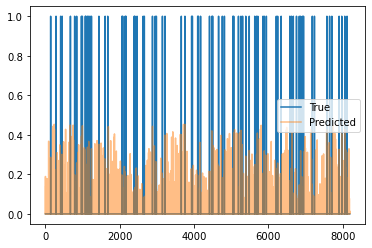

Validation Epoch: 6 [310/582 (53%)]	Loss: 0.036795	Pres: 0.008179	F1 Score: 0.008179
Validation Epoch: 6 [320/582 (54%)]	Loss: 0.041417	Pres: 0.006592	F1 Score: 0.006592
Validation Epoch: 6 [330/582 (56%)]	Loss: 0.042202	Pres: 0.007568	F1 Score: 0.007568
Validation Epoch: 6 [340/582 (58%)]	Loss: 0.039633	Pres: 0.007568	F1 Score: 0.007568
Validation Epoch: 6 [350/582 (60%)]	Loss: 0.040145	Pres: 0.009155	F1 Score: 0.009155
Validation Epoch: 6 [360/582 (61%)]	Loss: 0.038863	Pres: 0.005493	F1 Score: 0.005493
Validation Epoch: 6 [370/582 (63%)]	Loss: 0.040997	Pres: 0.007690	F1 Score: 0.007690
Validation Epoch: 6 [380/582 (65%)]	Loss: 0.040750	Pres: 0.010254	F1 Score: 0.010254
Validation Epoch: 6 [390/582 (67%)]	Loss: 0.037494	Pres: 0.007080	F1 Score: 0.007080
Validation Epoch: 6 [400/582 (68%)]	Loss: 0.038421	Pres: 0.009277	F1 Score: 0.009277
Validation Epoch: 6 [410/582 (70%)]	Loss: 0.038869	Pres: 0.008179	F1 Score: 0.008179
Validation Epoch: 6 [420/582 (72%)]	Loss: 0.040407	Pres: 0.008301

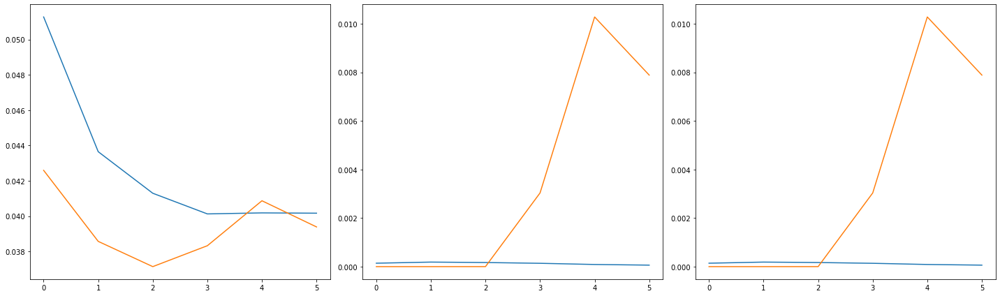

2220 582
Train Epoch: 7 [0/2220 (0%)]	Loss: 0.040003	Pres: 0.000244	F1 Score: 0.000244
85.0 -inf


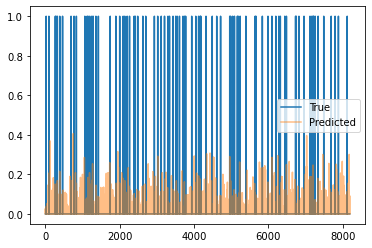

Train Epoch: 7 [10/2220 (0%)]	Loss: 0.038943	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 7 [20/2220 (0%)]	Loss: 0.043418	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [30/2220 (1%)]	Loss: 0.036486	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [40/2220 (1%)]	Loss: 0.040818	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [50/2220 (2%)]	Loss: 0.041061	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 7 [60/2220 (2%)]	Loss: 0.039229	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [70/2220 (3%)]	Loss: 0.032932	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [80/2220 (3%)]	Loss: 0.042175	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [90/2220 (4%)]	Loss: 0.036676	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 7 [100/2220 (4%)]	Loss: 0.040495	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [110/2220 (4%)]	Loss: 0.039699	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [120/2220 (5%)]	Loss: 0.038685	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [130/2220 (5%)]	Loss: 0.043489	Pre

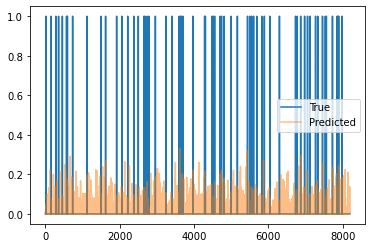

Train Epoch: 7 [310/2220 (13%)]	Loss: 0.039974	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 7 [320/2220 (14%)]	Loss: 0.036924	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [330/2220 (14%)]	Loss: 0.043115	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [340/2220 (15%)]	Loss: 0.040742	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [350/2220 (15%)]	Loss: 0.038824	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [360/2220 (16%)]	Loss: 0.037651	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [370/2220 (16%)]	Loss: 0.040251	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 7 [380/2220 (17%)]	Loss: 0.040299	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 7 [390/2220 (17%)]	Loss: 0.040546	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 7 [400/2220 (18%)]	Loss: 0.041554	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [410/2220 (18%)]	Loss: 0.040368	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [420/2220 (18%)]	Loss: 0.047892	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 7 [430/2220 (19

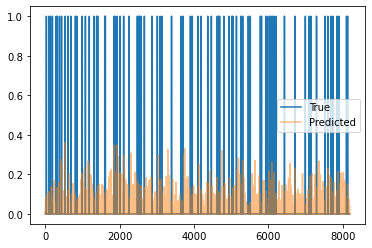

Train Epoch: 7 [610/2220 (27%)]	Loss: 0.043968	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 7 [620/2220 (27%)]	Loss: 0.037487	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [630/2220 (28%)]	Loss: 0.036037	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [640/2220 (28%)]	Loss: 0.038832	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [650/2220 (29%)]	Loss: 0.034915	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 7 [660/2220 (29%)]	Loss: 0.038582	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [670/2220 (30%)]	Loss: 0.036620	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [680/2220 (30%)]	Loss: 0.042467	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [690/2220 (31%)]	Loss: 0.042205	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [700/2220 (31%)]	Loss: 0.044957	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [710/2220 (31%)]	Loss: 0.043987	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 7 [720/2220 (32%)]	Loss: 0.040214	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 7 [730/2220 (32

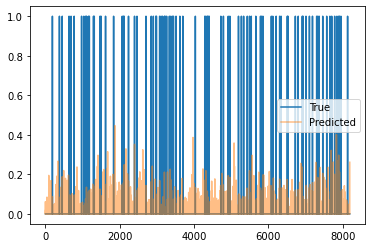

Train Epoch: 7 [910/2220 (40%)]	Loss: 0.037852	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [920/2220 (41%)]	Loss: 0.038760	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [930/2220 (41%)]	Loss: 0.036066	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [940/2220 (42%)]	Loss: 0.037526	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 7 [950/2220 (42%)]	Loss: 0.039460	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 7 [960/2220 (43%)]	Loss: 0.040082	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 7 [970/2220 (43%)]	Loss: 0.037939	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [980/2220 (44%)]	Loss: 0.040250	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 7 [990/2220 (44%)]	Loss: 0.039735	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [1000/2220 (45%)]	Loss: 0.041044	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [1010/2220 (45%)]	Loss: 0.042542	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [1020/2220 (45%)]	Loss: 0.046544	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [1030/2220

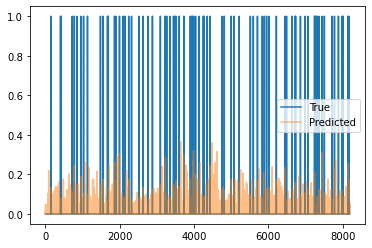

Train Epoch: 7 [1210/2220 (54%)]	Loss: 0.036889	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 7 [1220/2220 (54%)]	Loss: 0.040899	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [1230/2220 (55%)]	Loss: 0.039016	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [1240/2220 (55%)]	Loss: 0.038312	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [1250/2220 (56%)]	Loss: 0.040535	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 7 [1260/2220 (56%)]	Loss: 0.044766	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [1270/2220 (57%)]	Loss: 0.047716	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 7 [1280/2220 (57%)]	Loss: 0.037358	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [1290/2220 (58%)]	Loss: 0.038808	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [1300/2220 (58%)]	Loss: 0.039004	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 7 [1310/2220 (59%)]	Loss: 0.042608	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [1320/2220 (59%)]	Loss: 0.043406	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [

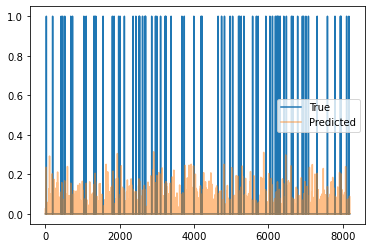

Train Epoch: 7 [1510/2220 (68%)]	Loss: 0.046006	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 7 [1520/2220 (68%)]	Loss: 0.036580	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [1530/2220 (68%)]	Loss: 0.038995	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [1540/2220 (69%)]	Loss: 0.039525	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [1550/2220 (69%)]	Loss: 0.034619	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [1560/2220 (70%)]	Loss: 0.037671	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [1570/2220 (70%)]	Loss: 0.038704	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [1580/2220 (71%)]	Loss: 0.040090	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [1590/2220 (71%)]	Loss: 0.044385	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [1600/2220 (72%)]	Loss: 0.044202	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [1610/2220 (72%)]	Loss: 0.038069	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [1620/2220 (72%)]	Loss: 0.041087	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [

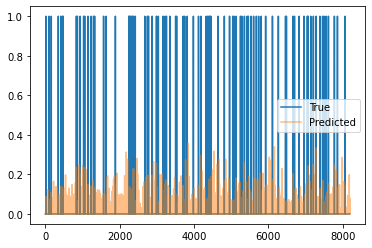

Train Epoch: 7 [1810/2220 (81%)]	Loss: 0.044995	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 7 [1820/2220 (81%)]	Loss: 0.039901	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [1830/2220 (82%)]	Loss: 0.038262	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [1840/2220 (82%)]	Loss: 0.044039	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [1850/2220 (83%)]	Loss: 0.040495	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 7 [1860/2220 (83%)]	Loss: 0.034943	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [1870/2220 (84%)]	Loss: 0.039440	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [1880/2220 (84%)]	Loss: 0.035892	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [1890/2220 (85%)]	Loss: 0.041132	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 7 [1900/2220 (85%)]	Loss: 0.042188	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 7 [1910/2220 (86%)]	Loss: 0.041562	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [1920/2220 (86%)]	Loss: 0.045832	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [

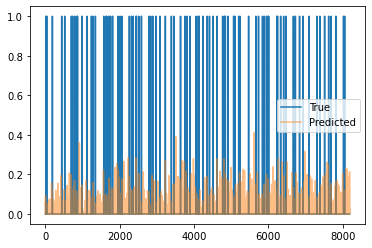

Train Epoch: 7 [2110/2220 (95%)]	Loss: 0.040406	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 7 [2120/2220 (95%)]	Loss: 0.043170	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [2130/2220 (95%)]	Loss: 0.039438	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [2140/2220 (96%)]	Loss: 0.037879	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 7 [2150/2220 (96%)]	Loss: 0.038602	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 7 [2160/2220 (97%)]	Loss: 0.039180	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 7 [2170/2220 (97%)]	Loss: 0.035991	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 7 [2180/2220 (98%)]	Loss: 0.041085	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [2190/2220 (98%)]	Loss: 0.037328	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [2200/2220 (99%)]	Loss: 0.042286	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 7 [2210/2220 (99%)]	Loss: 0.036499	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 7 [0/582 (0%)]	Loss: 0.040784	Pres: 0.008179	F1 Score: 0.008179


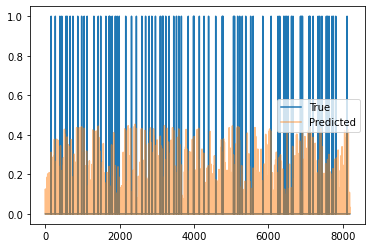

Validation Epoch: 7 [10/582 (1%)]	Loss: 0.041377	Pres: 0.006958	F1 Score: 0.006958
Validation Epoch: 7 [20/582 (3%)]	Loss: 0.036834	Pres: 0.009888	F1 Score: 0.009888
Validation Epoch: 7 [30/582 (5%)]	Loss: 0.037658	Pres: 0.007568	F1 Score: 0.007568
Validation Epoch: 7 [40/582 (6%)]	Loss: 0.037780	Pres: 0.006226	F1 Score: 0.006226
Validation Epoch: 7 [50/582 (8%)]	Loss: 0.036185	Pres: 0.008545	F1 Score: 0.008545
Validation Epoch: 7 [60/582 (10%)]	Loss: 0.040147	Pres: 0.008057	F1 Score: 0.008057
Validation Epoch: 7 [70/582 (12%)]	Loss: 0.038880	Pres: 0.006592	F1 Score: 0.006592
Validation Epoch: 7 [80/582 (13%)]	Loss: 0.037903	Pres: 0.007202	F1 Score: 0.007202
Validation Epoch: 7 [90/582 (15%)]	Loss: 0.040003	Pres: 0.009033	F1 Score: 0.009033
Validation Epoch: 7 [100/582 (17%)]	Loss: 0.039832	Pres: 0.007568	F1 Score: 0.007568
Validation Epoch: 7 [110/582 (18%)]	Loss: 0.040385	Pres: 0.006714	F1 Score: 0.006714
Validation Epoch: 7 [120/582 (20%)]	Loss: 0.037746	Pres: 0.007690	F1 Score: 0.0

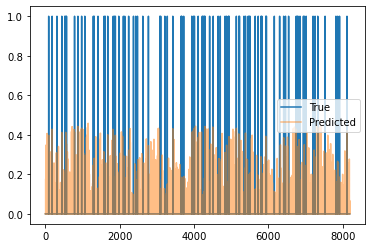

Validation Epoch: 7 [310/582 (53%)]	Loss: 0.037375	Pres: 0.008057	F1 Score: 0.008057
Validation Epoch: 7 [320/582 (54%)]	Loss: 0.034086	Pres: 0.011108	F1 Score: 0.011108
Validation Epoch: 7 [330/582 (56%)]	Loss: 0.041005	Pres: 0.007446	F1 Score: 0.007446
Validation Epoch: 7 [340/582 (58%)]	Loss: 0.038313	Pres: 0.006836	F1 Score: 0.006836
Validation Epoch: 7 [350/582 (60%)]	Loss: 0.038966	Pres: 0.007935	F1 Score: 0.007935
Validation Epoch: 7 [360/582 (61%)]	Loss: 0.038144	Pres: 0.005737	F1 Score: 0.005737
Validation Epoch: 7 [370/582 (63%)]	Loss: 0.041055	Pres: 0.005371	F1 Score: 0.005371
Validation Epoch: 7 [380/582 (65%)]	Loss: 0.039497	Pres: 0.009644	F1 Score: 0.009644
Validation Epoch: 7 [390/582 (67%)]	Loss: 0.037130	Pres: 0.008545	F1 Score: 0.008545
Validation Epoch: 7 [400/582 (68%)]	Loss: 0.040131	Pres: 0.009033	F1 Score: 0.009033
Validation Epoch: 7 [410/582 (70%)]	Loss: 0.039444	Pres: 0.006226	F1 Score: 0.006226
Validation Epoch: 7 [420/582 (72%)]	Loss: 0.037539	Pres: 0.007324

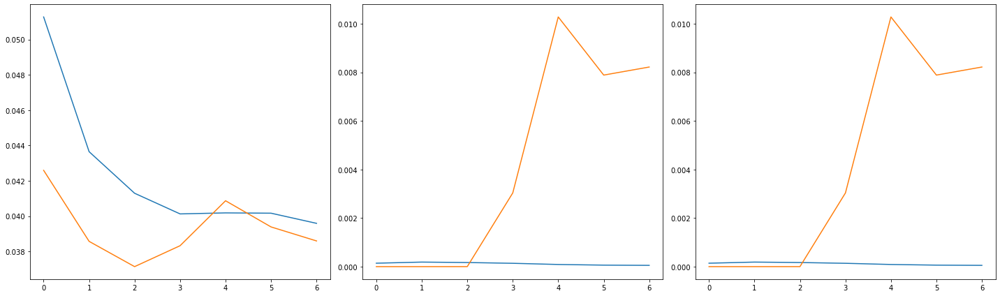

2220 582
Train Epoch: 8 [0/2220 (0%)]	Loss: 0.037598	Pres: 0.000000	F1 Score: 0.000000
75.0 -inf


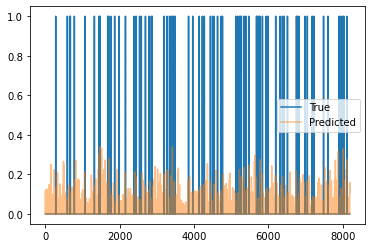

Train Epoch: 8 [10/2220 (0%)]	Loss: 0.036635	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [20/2220 (0%)]	Loss: 0.035014	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [30/2220 (1%)]	Loss: 0.045220	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [40/2220 (1%)]	Loss: 0.039268	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [50/2220 (2%)]	Loss: 0.042015	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 8 [60/2220 (2%)]	Loss: 0.041848	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 8 [70/2220 (3%)]	Loss: 0.039277	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 8 [80/2220 (3%)]	Loss: 0.039091	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [90/2220 (4%)]	Loss: 0.038941	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 8 [100/2220 (4%)]	Loss: 0.049074	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [110/2220 (4%)]	Loss: 0.039025	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [120/2220 (5%)]	Loss: 0.043174	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [130/2220 (5%)]	Loss: 0.039024	Pre

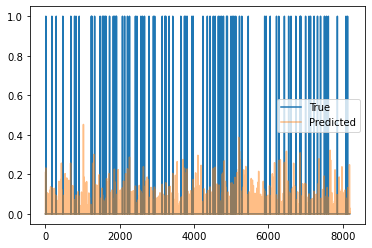

Train Epoch: 8 [310/2220 (13%)]	Loss: 0.039259	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 8 [320/2220 (14%)]	Loss: 0.039451	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [330/2220 (14%)]	Loss: 0.039617	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [340/2220 (15%)]	Loss: 0.037581	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [350/2220 (15%)]	Loss: 0.043484	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [360/2220 (16%)]	Loss: 0.037186	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [370/2220 (16%)]	Loss: 0.040369	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [380/2220 (17%)]	Loss: 0.039780	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 8 [390/2220 (17%)]	Loss: 0.040544	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 8 [400/2220 (18%)]	Loss: 0.036526	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [410/2220 (18%)]	Loss: 0.038830	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 8 [420/2220 (18%)]	Loss: 0.039635	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [430/2220 (19

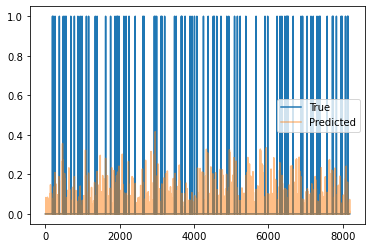

Train Epoch: 8 [610/2220 (27%)]	Loss: 0.038931	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [620/2220 (27%)]	Loss: 0.039639	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 8 [630/2220 (28%)]	Loss: 0.039977	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 8 [640/2220 (28%)]	Loss: 0.038044	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 8 [650/2220 (29%)]	Loss: 0.034525	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [660/2220 (29%)]	Loss: 0.032699	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [670/2220 (30%)]	Loss: 0.040514	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [680/2220 (30%)]	Loss: 0.037440	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [690/2220 (31%)]	Loss: 0.040614	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [700/2220 (31%)]	Loss: 0.040005	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [710/2220 (31%)]	Loss: 0.034965	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [720/2220 (32%)]	Loss: 0.042882	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [730/2220 (32

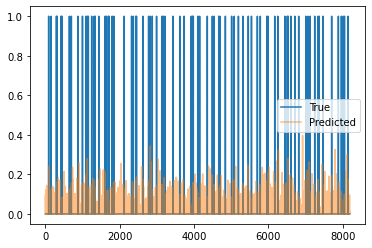

Train Epoch: 8 [910/2220 (40%)]	Loss: 0.042176	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [920/2220 (41%)]	Loss: 0.040744	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [930/2220 (41%)]	Loss: 0.041196	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [940/2220 (42%)]	Loss: 0.036001	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [950/2220 (42%)]	Loss: 0.039312	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [960/2220 (43%)]	Loss: 0.036985	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [970/2220 (43%)]	Loss: 0.043256	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 8 [980/2220 (44%)]	Loss: 0.038908	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [990/2220 (44%)]	Loss: 0.041827	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [1000/2220 (45%)]	Loss: 0.039103	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [1010/2220 (45%)]	Loss: 0.044071	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [1020/2220 (45%)]	Loss: 0.038596	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [1030/2220

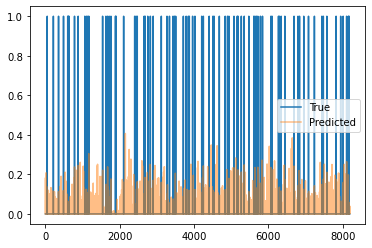

Train Epoch: 8 [1210/2220 (54%)]	Loss: 0.041714	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [1220/2220 (54%)]	Loss: 0.034607	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [1230/2220 (55%)]	Loss: 0.038032	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 8 [1240/2220 (55%)]	Loss: 0.039133	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [1250/2220 (56%)]	Loss: 0.033615	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [1260/2220 (56%)]	Loss: 0.039649	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [1270/2220 (57%)]	Loss: 0.038087	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [1280/2220 (57%)]	Loss: 0.037727	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 8 [1290/2220 (58%)]	Loss: 0.038350	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [1300/2220 (58%)]	Loss: 0.038209	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [1310/2220 (59%)]	Loss: 0.040373	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [1320/2220 (59%)]	Loss: 0.038678	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [

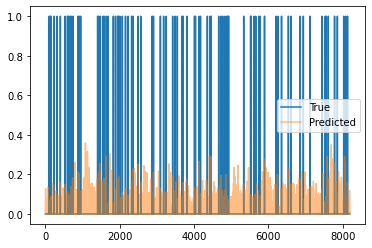

Train Epoch: 8 [1510/2220 (68%)]	Loss: 0.035585	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [1520/2220 (68%)]	Loss: 0.039235	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [1530/2220 (68%)]	Loss: 0.038904	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [1540/2220 (69%)]	Loss: 0.033944	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 8 [1550/2220 (69%)]	Loss: 0.041974	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [1560/2220 (70%)]	Loss: 0.038926	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 8 [1570/2220 (70%)]	Loss: 0.038960	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [1580/2220 (71%)]	Loss: 0.036851	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [1590/2220 (71%)]	Loss: 0.037932	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 8 [1600/2220 (72%)]	Loss: 0.039219	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [1610/2220 (72%)]	Loss: 0.036644	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 8 [1620/2220 (72%)]	Loss: 0.040186	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [

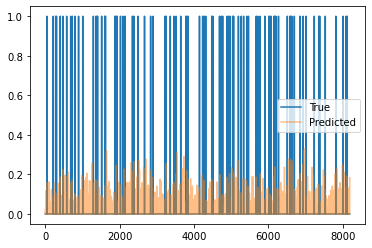

Train Epoch: 8 [1810/2220 (81%)]	Loss: 0.037299	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 8 [1820/2220 (81%)]	Loss: 0.039987	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 8 [1830/2220 (82%)]	Loss: 0.036183	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 8 [1840/2220 (82%)]	Loss: 0.033265	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [1850/2220 (83%)]	Loss: 0.037380	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 8 [1860/2220 (83%)]	Loss: 0.032680	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [1870/2220 (84%)]	Loss: 0.033898	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 8 [1880/2220 (84%)]	Loss: 0.039917	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 8 [1890/2220 (85%)]	Loss: 0.043471	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [1900/2220 (85%)]	Loss: 0.041705	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [1910/2220 (86%)]	Loss: 0.036168	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [1920/2220 (86%)]	Loss: 0.039457	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [

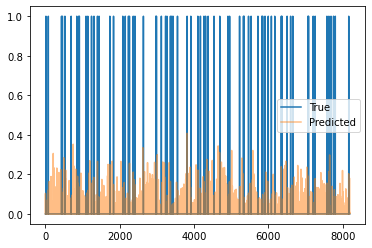

Train Epoch: 8 [2110/2220 (95%)]	Loss: 0.037052	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 8 [2120/2220 (95%)]	Loss: 0.038906	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [2130/2220 (95%)]	Loss: 0.037834	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [2140/2220 (96%)]	Loss: 0.042715	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [2150/2220 (96%)]	Loss: 0.035651	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [2160/2220 (97%)]	Loss: 0.041505	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [2170/2220 (97%)]	Loss: 0.036229	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [2180/2220 (98%)]	Loss: 0.036274	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [2190/2220 (98%)]	Loss: 0.036386	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [2200/2220 (99%)]	Loss: 0.041162	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 8 [2210/2220 (99%)]	Loss: 0.041762	Pres: 0.000244	F1 Score: 0.000244
Validation Epoch: 8 [0/582 (0%)]	Loss: 0.037538	Pres: 0.005493	F1 Score: 0.005493


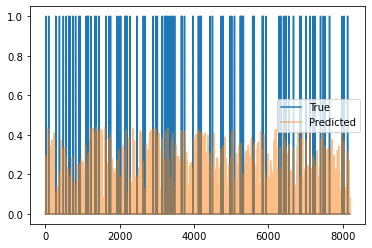

Validation Epoch: 8 [10/582 (1%)]	Loss: 0.039622	Pres: 0.009033	F1 Score: 0.009033
Validation Epoch: 8 [20/582 (3%)]	Loss: 0.040284	Pres: 0.009033	F1 Score: 0.009033
Validation Epoch: 8 [30/582 (5%)]	Loss: 0.039016	Pres: 0.008057	F1 Score: 0.008057
Validation Epoch: 8 [40/582 (6%)]	Loss: 0.037240	Pres: 0.009277	F1 Score: 0.009277
Validation Epoch: 8 [50/582 (8%)]	Loss: 0.038107	Pres: 0.007812	F1 Score: 0.007812
Validation Epoch: 8 [60/582 (10%)]	Loss: 0.038766	Pres: 0.008179	F1 Score: 0.008179
Validation Epoch: 8 [70/582 (12%)]	Loss: 0.038541	Pres: 0.006348	F1 Score: 0.006348
Validation Epoch: 8 [80/582 (13%)]	Loss: 0.037772	Pres: 0.008423	F1 Score: 0.008423
Validation Epoch: 8 [90/582 (15%)]	Loss: 0.040567	Pres: 0.005493	F1 Score: 0.005493
Validation Epoch: 8 [100/582 (17%)]	Loss: 0.041518	Pres: 0.008789	F1 Score: 0.008789
Validation Epoch: 8 [110/582 (18%)]	Loss: 0.040200	Pres: 0.006958	F1 Score: 0.006958
Validation Epoch: 8 [120/582 (20%)]	Loss: 0.040061	Pres: 0.009399	F1 Score: 0.0

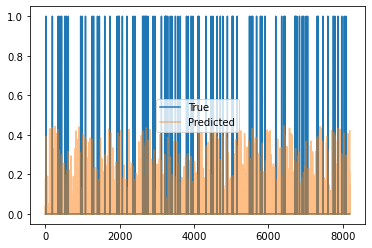

Validation Epoch: 8 [310/582 (53%)]	Loss: 0.036520	Pres: 0.008545	F1 Score: 0.008545
Validation Epoch: 8 [320/582 (54%)]	Loss: 0.037270	Pres: 0.005859	F1 Score: 0.005859
Validation Epoch: 8 [330/582 (56%)]	Loss: 0.041422	Pres: 0.005371	F1 Score: 0.005371
Validation Epoch: 8 [340/582 (58%)]	Loss: 0.038223	Pres: 0.007812	F1 Score: 0.007812
Validation Epoch: 8 [350/582 (60%)]	Loss: 0.040074	Pres: 0.006958	F1 Score: 0.006958
Validation Epoch: 8 [360/582 (61%)]	Loss: 0.040716	Pres: 0.007324	F1 Score: 0.007324
Validation Epoch: 8 [370/582 (63%)]	Loss: 0.037476	Pres: 0.007446	F1 Score: 0.007446
Validation Epoch: 8 [380/582 (65%)]	Loss: 0.038833	Pres: 0.006104	F1 Score: 0.006104
Validation Epoch: 8 [390/582 (67%)]	Loss: 0.037813	Pres: 0.008423	F1 Score: 0.008423
Validation Epoch: 8 [400/582 (68%)]	Loss: 0.037230	Pres: 0.009766	F1 Score: 0.009766
Validation Epoch: 8 [410/582 (70%)]	Loss: 0.037417	Pres: 0.008911	F1 Score: 0.008911
Validation Epoch: 8 [420/582 (72%)]	Loss: 0.038977	Pres: 0.007080

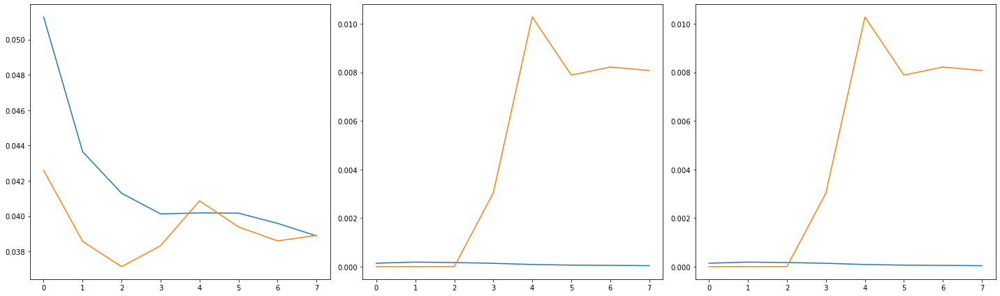

2220 582
Train Epoch: 9 [0/2220 (0%)]	Loss: 0.034225	Pres: 0.000000	F1 Score: 0.000000
73.0 -inf


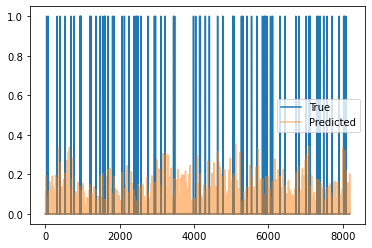

Train Epoch: 9 [10/2220 (0%)]	Loss: 0.040536	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 9 [20/2220 (0%)]	Loss: 0.037244	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [30/2220 (1%)]	Loss: 0.034256	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [40/2220 (1%)]	Loss: 0.041817	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [50/2220 (2%)]	Loss: 0.039721	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 9 [60/2220 (2%)]	Loss: 0.039092	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [70/2220 (3%)]	Loss: 0.038273	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [80/2220 (3%)]	Loss: 0.033574	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [90/2220 (4%)]	Loss: 0.039077	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 9 [100/2220 (4%)]	Loss: 0.035145	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 9 [110/2220 (4%)]	Loss: 0.039806	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [120/2220 (5%)]	Loss: 0.036344	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [130/2220 (5%)]	Loss: 0.043983	Pre

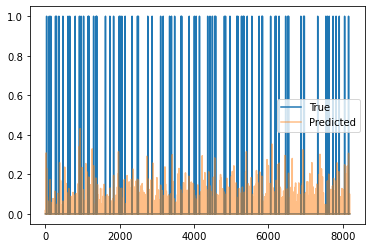

Train Epoch: 9 [310/2220 (13%)]	Loss: 0.039035	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [320/2220 (14%)]	Loss: 0.036979	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [330/2220 (14%)]	Loss: 0.035952	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [340/2220 (15%)]	Loss: 0.038069	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [350/2220 (15%)]	Loss: 0.036510	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 9 [360/2220 (16%)]	Loss: 0.037510	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [370/2220 (16%)]	Loss: 0.039334	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [380/2220 (17%)]	Loss: 0.043171	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [390/2220 (17%)]	Loss: 0.037188	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [400/2220 (18%)]	Loss: 0.039586	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 9 [410/2220 (18%)]	Loss: 0.034842	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [420/2220 (18%)]	Loss: 0.042220	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [430/2220 (19

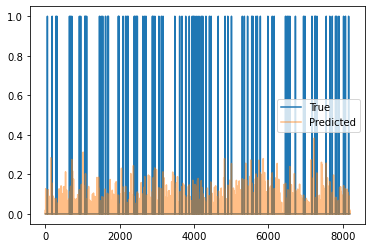

Train Epoch: 9 [610/2220 (27%)]	Loss: 0.041251	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 9 [620/2220 (27%)]	Loss: 0.039000	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [630/2220 (28%)]	Loss: 0.037246	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [640/2220 (28%)]	Loss: 0.042699	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [650/2220 (29%)]	Loss: 0.037775	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [660/2220 (29%)]	Loss: 0.037830	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 9 [670/2220 (30%)]	Loss: 0.034605	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [680/2220 (30%)]	Loss: 0.038578	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [690/2220 (31%)]	Loss: 0.035150	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [700/2220 (31%)]	Loss: 0.039182	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 9 [710/2220 (31%)]	Loss: 0.035325	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 9 [720/2220 (32%)]	Loss: 0.039970	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [730/2220 (32

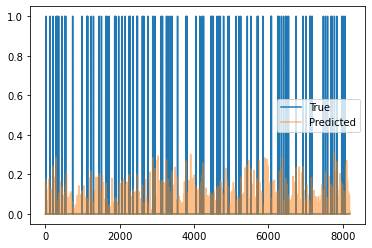

Train Epoch: 9 [910/2220 (40%)]	Loss: 0.039552	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [920/2220 (41%)]	Loss: 0.038200	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [930/2220 (41%)]	Loss: 0.034985	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [940/2220 (42%)]	Loss: 0.038357	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [950/2220 (42%)]	Loss: 0.039155	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [960/2220 (43%)]	Loss: 0.038983	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [970/2220 (43%)]	Loss: 0.037554	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [980/2220 (44%)]	Loss: 0.036969	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 9 [990/2220 (44%)]	Loss: 0.039732	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [1000/2220 (45%)]	Loss: 0.043794	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [1010/2220 (45%)]	Loss: 0.038113	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 9 [1020/2220 (45%)]	Loss: 0.034283	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [1030/2220

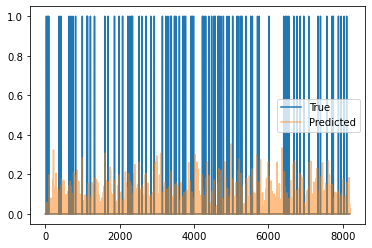

Train Epoch: 9 [1210/2220 (54%)]	Loss: 0.035553	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 9 [1220/2220 (54%)]	Loss: 0.037218	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [1230/2220 (55%)]	Loss: 0.042073	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 9 [1240/2220 (55%)]	Loss: 0.038840	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 9 [1250/2220 (56%)]	Loss: 0.036313	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 9 [1260/2220 (56%)]	Loss: 0.038938	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 9 [1270/2220 (57%)]	Loss: 0.041933	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 9 [1280/2220 (57%)]	Loss: 0.038825	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 9 [1290/2220 (58%)]	Loss: 0.037708	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 9 [1300/2220 (58%)]	Loss: 0.042449	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [1310/2220 (59%)]	Loss: 0.039089	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 9 [1320/2220 (59%)]	Loss: 0.034427	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [

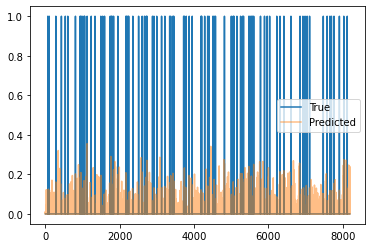

Train Epoch: 9 [1510/2220 (68%)]	Loss: 0.040293	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 9 [1520/2220 (68%)]	Loss: 0.041327	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [1530/2220 (68%)]	Loss: 0.040851	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [1540/2220 (69%)]	Loss: 0.039275	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [1550/2220 (69%)]	Loss: 0.040537	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [1560/2220 (70%)]	Loss: 0.034851	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 9 [1570/2220 (70%)]	Loss: 0.041779	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [1580/2220 (71%)]	Loss: 0.042887	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [1590/2220 (71%)]	Loss: 0.040838	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [1600/2220 (72%)]	Loss: 0.040855	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [1610/2220 (72%)]	Loss: 0.036129	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [1620/2220 (72%)]	Loss: 0.036962	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [

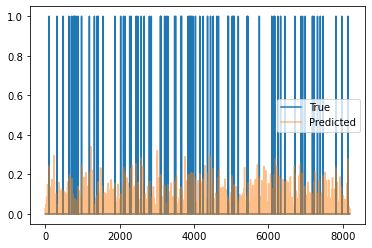

Train Epoch: 9 [1810/2220 (81%)]	Loss: 0.039302	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [1820/2220 (81%)]	Loss: 0.037556	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [1830/2220 (82%)]	Loss: 0.040080	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 9 [1840/2220 (82%)]	Loss: 0.036249	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [1850/2220 (83%)]	Loss: 0.038694	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [1860/2220 (83%)]	Loss: 0.036871	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 9 [1870/2220 (84%)]	Loss: 0.037797	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [1880/2220 (84%)]	Loss: 0.040749	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 9 [1890/2220 (85%)]	Loss: 0.033654	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [1900/2220 (85%)]	Loss: 0.037389	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 9 [1910/2220 (86%)]	Loss: 0.042703	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [1920/2220 (86%)]	Loss: 0.034910	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [

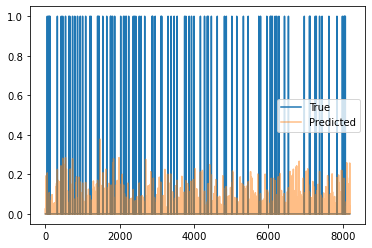

Train Epoch: 9 [2110/2220 (95%)]	Loss: 0.035371	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [2120/2220 (95%)]	Loss: 0.038734	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [2130/2220 (95%)]	Loss: 0.037140	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [2140/2220 (96%)]	Loss: 0.033563	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [2150/2220 (96%)]	Loss: 0.034731	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [2160/2220 (97%)]	Loss: 0.037870	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 9 [2170/2220 (97%)]	Loss: 0.035736	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 9 [2180/2220 (98%)]	Loss: 0.039569	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [2190/2220 (98%)]	Loss: 0.035741	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [2200/2220 (99%)]	Loss: 0.041237	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 9 [2210/2220 (99%)]	Loss: 0.035138	Pres: 0.000122	F1 Score: 0.000122
Validation Epoch: 9 [0/582 (0%)]	Loss: 0.036856	Pres: 0.002197	F1 Score: 0.002197


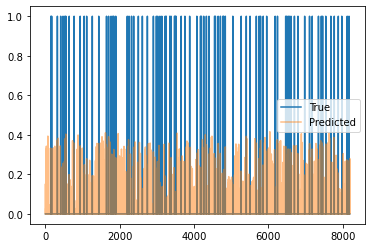

Validation Epoch: 9 [10/582 (1%)]	Loss: 0.039966	Pres: 0.001099	F1 Score: 0.001099
Validation Epoch: 9 [20/582 (3%)]	Loss: 0.039697	Pres: 0.001465	F1 Score: 0.001465
Validation Epoch: 9 [30/582 (5%)]	Loss: 0.039586	Pres: 0.001221	F1 Score: 0.001221
Validation Epoch: 9 [40/582 (6%)]	Loss: 0.037525	Pres: 0.001831	F1 Score: 0.001831
Validation Epoch: 9 [50/582 (8%)]	Loss: 0.038917	Pres: 0.000854	F1 Score: 0.000854
Validation Epoch: 9 [60/582 (10%)]	Loss: 0.038142	Pres: 0.001465	F1 Score: 0.001465
Validation Epoch: 9 [70/582 (12%)]	Loss: 0.038998	Pres: 0.001099	F1 Score: 0.001099
Validation Epoch: 9 [80/582 (13%)]	Loss: 0.039722	Pres: 0.000732	F1 Score: 0.000732
Validation Epoch: 9 [90/582 (15%)]	Loss: 0.036542	Pres: 0.001709	F1 Score: 0.001709
Validation Epoch: 9 [100/582 (17%)]	Loss: 0.036019	Pres: 0.001953	F1 Score: 0.001953
Validation Epoch: 9 [110/582 (18%)]	Loss: 0.037440	Pres: 0.000977	F1 Score: 0.000977
Validation Epoch: 9 [120/582 (20%)]	Loss: 0.036085	Pres: 0.002319	F1 Score: 0.0

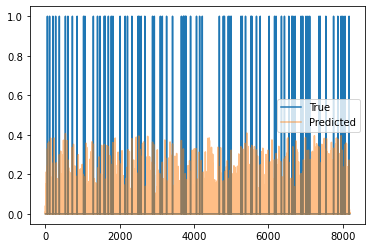

Validation Epoch: 9 [310/582 (53%)]	Loss: 0.037253	Pres: 0.002197	F1 Score: 0.002197
Validation Epoch: 9 [320/582 (54%)]	Loss: 0.037597	Pres: 0.001343	F1 Score: 0.001343
Validation Epoch: 9 [330/582 (56%)]	Loss: 0.038795	Pres: 0.001831	F1 Score: 0.001831
Validation Epoch: 9 [340/582 (58%)]	Loss: 0.034637	Pres: 0.001465	F1 Score: 0.001465
Validation Epoch: 9 [350/582 (60%)]	Loss: 0.036127	Pres: 0.001465	F1 Score: 0.001465
Validation Epoch: 9 [360/582 (61%)]	Loss: 0.037634	Pres: 0.000977	F1 Score: 0.000977
Validation Epoch: 9 [370/582 (63%)]	Loss: 0.040418	Pres: 0.001343	F1 Score: 0.001343
Validation Epoch: 9 [380/582 (65%)]	Loss: 0.037333	Pres: 0.001465	F1 Score: 0.001465
Validation Epoch: 9 [390/582 (67%)]	Loss: 0.039854	Pres: 0.002075	F1 Score: 0.002075
Validation Epoch: 9 [400/582 (68%)]	Loss: 0.037260	Pres: 0.001221	F1 Score: 0.001221
Validation Epoch: 9 [410/582 (70%)]	Loss: 0.040085	Pres: 0.000977	F1 Score: 0.000977
Validation Epoch: 9 [420/582 (72%)]	Loss: 0.040168	Pres: 0.002319

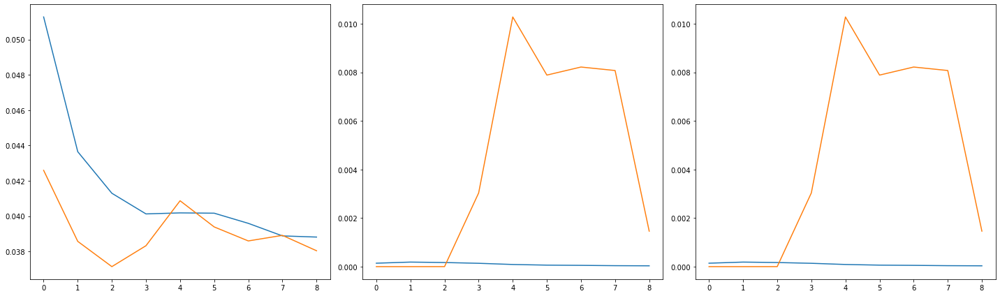

2220 582
Train Epoch: 10 [0/2220 (0%)]	Loss: 0.043301	Pres: 0.000000	F1 Score: 0.000000
95.0 -inf


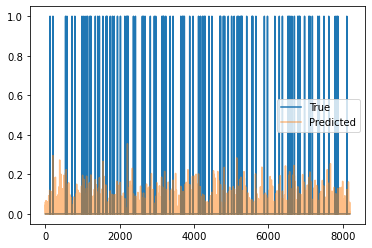

Train Epoch: 10 [10/2220 (0%)]	Loss: 0.038515	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 10 [20/2220 (0%)]	Loss: 0.038693	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [30/2220 (1%)]	Loss: 0.037488	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [40/2220 (1%)]	Loss: 0.038021	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [50/2220 (2%)]	Loss: 0.036644	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [60/2220 (2%)]	Loss: 0.034019	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 10 [70/2220 (3%)]	Loss: 0.036758	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [80/2220 (3%)]	Loss: 0.040799	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [90/2220 (4%)]	Loss: 0.036335	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [100/2220 (4%)]	Loss: 0.040988	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [110/2220 (4%)]	Loss: 0.039703	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [120/2220 (5%)]	Loss: 0.037254	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [130/2220 (5%)]	Loss:

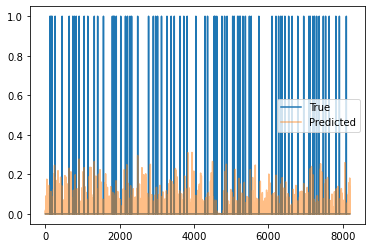

Train Epoch: 10 [310/2220 (13%)]	Loss: 0.038993	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 10 [320/2220 (14%)]	Loss: 0.038710	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [330/2220 (14%)]	Loss: 0.041272	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 10 [340/2220 (15%)]	Loss: 0.036505	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [350/2220 (15%)]	Loss: 0.037532	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [360/2220 (16%)]	Loss: 0.043956	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [370/2220 (16%)]	Loss: 0.036453	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [380/2220 (17%)]	Loss: 0.040311	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [390/2220 (17%)]	Loss: 0.037658	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [400/2220 (18%)]	Loss: 0.034183	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [410/2220 (18%)]	Loss: 0.035950	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [420/2220 (18%)]	Loss: 0.042761	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 

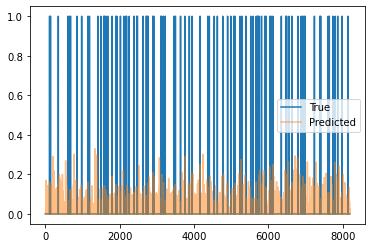

Train Epoch: 10 [610/2220 (27%)]	Loss: 0.038201	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [620/2220 (27%)]	Loss: 0.037626	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [630/2220 (28%)]	Loss: 0.040038	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [640/2220 (28%)]	Loss: 0.042816	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [650/2220 (29%)]	Loss: 0.035331	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [660/2220 (29%)]	Loss: 0.043085	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [670/2220 (30%)]	Loss: 0.037240	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [680/2220 (30%)]	Loss: 0.036124	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [690/2220 (31%)]	Loss: 0.042181	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [700/2220 (31%)]	Loss: 0.037928	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [710/2220 (31%)]	Loss: 0.040601	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [720/2220 (32%)]	Loss: 0.036514	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 

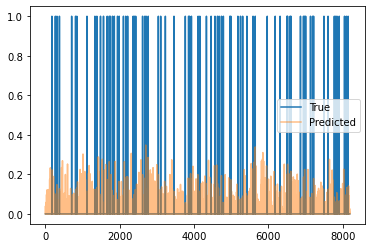

Train Epoch: 10 [910/2220 (40%)]	Loss: 0.042517	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [920/2220 (41%)]	Loss: 0.042694	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 10 [930/2220 (41%)]	Loss: 0.035584	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 10 [940/2220 (42%)]	Loss: 0.044129	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [950/2220 (42%)]	Loss: 0.040054	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 10 [960/2220 (43%)]	Loss: 0.043021	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [970/2220 (43%)]	Loss: 0.038435	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [980/2220 (44%)]	Loss: 0.036149	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [990/2220 (44%)]	Loss: 0.039420	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [1000/2220 (45%)]	Loss: 0.042361	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [1010/2220 (45%)]	Loss: 0.032827	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [1020/2220 (45%)]	Loss: 0.046554	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 

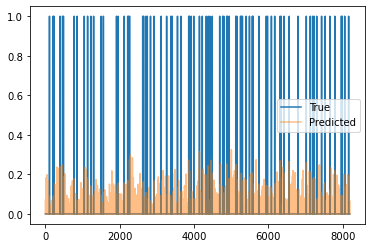

Train Epoch: 10 [1210/2220 (54%)]	Loss: 0.036236	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [1220/2220 (54%)]	Loss: 0.044842	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [1230/2220 (55%)]	Loss: 0.038741	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [1240/2220 (55%)]	Loss: 0.038469	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [1250/2220 (56%)]	Loss: 0.037352	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [1260/2220 (56%)]	Loss: 0.045594	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [1270/2220 (57%)]	Loss: 0.039255	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [1280/2220 (57%)]	Loss: 0.036979	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [1290/2220 (58%)]	Loss: 0.042963	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [1300/2220 (58%)]	Loss: 0.038253	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [1310/2220 (59%)]	Loss: 0.046775	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [1320/2220 (59%)]	Loss: 0.034151	Pres: 0.000000	F1 Score: 0.000000
Trai

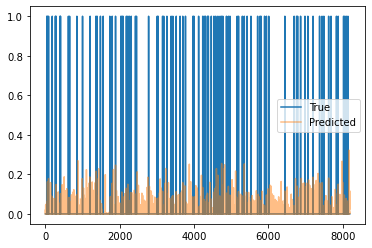

Train Epoch: 10 [1510/2220 (68%)]	Loss: 0.035911	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [1520/2220 (68%)]	Loss: 0.036023	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [1530/2220 (68%)]	Loss: 0.040860	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [1540/2220 (69%)]	Loss: 0.039097	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [1550/2220 (69%)]	Loss: 0.039016	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [1560/2220 (70%)]	Loss: 0.048712	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [1570/2220 (70%)]	Loss: 0.037377	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [1580/2220 (71%)]	Loss: 0.041778	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [1590/2220 (71%)]	Loss: 0.042967	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 10 [1600/2220 (72%)]	Loss: 0.040225	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [1610/2220 (72%)]	Loss: 0.042196	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [1620/2220 (72%)]	Loss: 0.040349	Pres: 0.000000	F1 Score: 0.000000
Trai

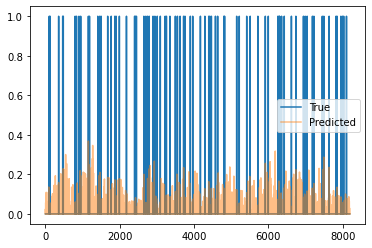

Train Epoch: 10 [1810/2220 (81%)]	Loss: 0.043238	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [1820/2220 (81%)]	Loss: 0.039479	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 10 [1830/2220 (82%)]	Loss: 0.040135	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [1840/2220 (82%)]	Loss: 0.038843	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [1850/2220 (83%)]	Loss: 0.039464	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 10 [1860/2220 (83%)]	Loss: 0.038919	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 10 [1870/2220 (84%)]	Loss: 0.038078	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [1880/2220 (84%)]	Loss: 0.046307	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 10 [1890/2220 (85%)]	Loss: 0.042694	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [1900/2220 (85%)]	Loss: 0.032677	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 10 [1910/2220 (86%)]	Loss: 0.041715	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [1920/2220 (86%)]	Loss: 0.043947	Pres: 0.000000	F1 Score: 0.000000
Trai

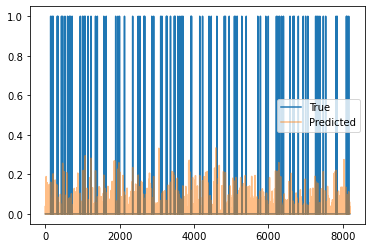

Train Epoch: 10 [2110/2220 (95%)]	Loss: 0.037713	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [2120/2220 (95%)]	Loss: 0.038883	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [2130/2220 (95%)]	Loss: 0.038825	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 10 [2140/2220 (96%)]	Loss: 0.033763	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [2150/2220 (96%)]	Loss: 0.038695	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [2160/2220 (97%)]	Loss: 0.035934	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 10 [2170/2220 (97%)]	Loss: 0.039655	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [2180/2220 (98%)]	Loss: 0.044418	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 10 [2190/2220 (98%)]	Loss: 0.040101	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [2200/2220 (99%)]	Loss: 0.041014	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 10 [2210/2220 (99%)]	Loss: 0.041527	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 10 [0/582 (0%)]	Loss: 0.037311	Pres: 0.000610	F1 Score: 0.000610


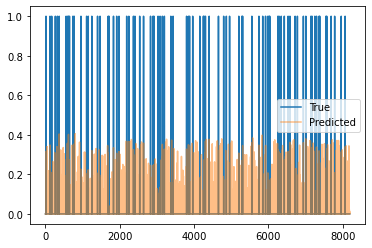

Validation Epoch: 10 [10/582 (1%)]	Loss: 0.037817	Pres: 0.000732	F1 Score: 0.000732
Validation Epoch: 10 [20/582 (3%)]	Loss: 0.038549	Pres: 0.001099	F1 Score: 0.001099
Validation Epoch: 10 [30/582 (5%)]	Loss: 0.037831	Pres: 0.001221	F1 Score: 0.001221
Validation Epoch: 10 [40/582 (6%)]	Loss: 0.040905	Pres: 0.000610	F1 Score: 0.000610
Validation Epoch: 10 [50/582 (8%)]	Loss: 0.038722	Pres: 0.000488	F1 Score: 0.000488
Validation Epoch: 10 [60/582 (10%)]	Loss: 0.037022	Pres: 0.001099	F1 Score: 0.001099
Validation Epoch: 10 [70/582 (12%)]	Loss: 0.040661	Pres: 0.000610	F1 Score: 0.000610
Validation Epoch: 10 [80/582 (13%)]	Loss: 0.037185	Pres: 0.001343	F1 Score: 0.001343
Validation Epoch: 10 [90/582 (15%)]	Loss: 0.039729	Pres: 0.000977	F1 Score: 0.000977
Validation Epoch: 10 [100/582 (17%)]	Loss: 0.036937	Pres: 0.001709	F1 Score: 0.001709
Validation Epoch: 10 [110/582 (18%)]	Loss: 0.038649	Pres: 0.000732	F1 Score: 0.000732
Validation Epoch: 10 [120/582 (20%)]	Loss: 0.038152	Pres: 0.000732	F

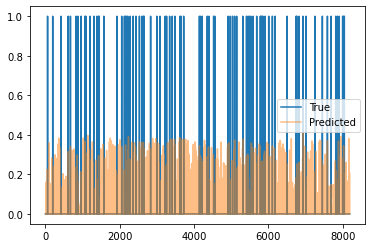

Validation Epoch: 10 [310/582 (53%)]	Loss: 0.038915	Pres: 0.001099	F1 Score: 0.001099
Validation Epoch: 10 [320/582 (54%)]	Loss: 0.038262	Pres: 0.001099	F1 Score: 0.001099
Validation Epoch: 10 [330/582 (56%)]	Loss: 0.036828	Pres: 0.000854	F1 Score: 0.000854
Validation Epoch: 10 [340/582 (58%)]	Loss: 0.039167	Pres: 0.000977	F1 Score: 0.000977
Validation Epoch: 10 [350/582 (60%)]	Loss: 0.038929	Pres: 0.000854	F1 Score: 0.000854
Validation Epoch: 10 [360/582 (61%)]	Loss: 0.042505	Pres: 0.000854	F1 Score: 0.000854
Validation Epoch: 10 [370/582 (63%)]	Loss: 0.044326	Pres: 0.001465	F1 Score: 0.001465
Validation Epoch: 10 [380/582 (65%)]	Loss: 0.041117	Pres: 0.000732	F1 Score: 0.000732
Validation Epoch: 10 [390/582 (67%)]	Loss: 0.039422	Pres: 0.001465	F1 Score: 0.001465
Validation Epoch: 10 [400/582 (68%)]	Loss: 0.038190	Pres: 0.001465	F1 Score: 0.001465
Validation Epoch: 10 [410/582 (70%)]	Loss: 0.039943	Pres: 0.001221	F1 Score: 0.001221
Validation Epoch: 10 [420/582 (72%)]	Loss: 0.039127	Pr

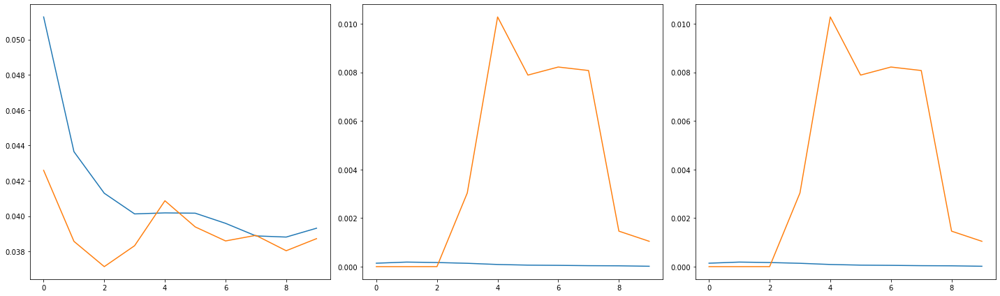

2220 582
Train Epoch: 11 [0/2220 (0%)]	Loss: 0.044985	Pres: 0.000000	F1 Score: 0.000000
81.0 -inf


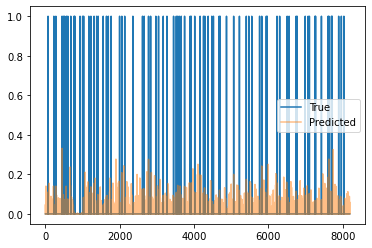

Train Epoch: 11 [10/2220 (0%)]	Loss: 0.039206	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [20/2220 (0%)]	Loss: 0.036679	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [30/2220 (1%)]	Loss: 0.040529	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [40/2220 (1%)]	Loss: 0.038419	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [50/2220 (2%)]	Loss: 0.042462	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [60/2220 (2%)]	Loss: 0.038441	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [70/2220 (3%)]	Loss: 0.039602	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [80/2220 (3%)]	Loss: 0.042726	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [90/2220 (4%)]	Loss: 0.037207	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [100/2220 (4%)]	Loss: 0.040079	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [110/2220 (4%)]	Loss: 0.038849	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [120/2220 (5%)]	Loss: 0.037551	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [130/2220 (5%)]	Loss:

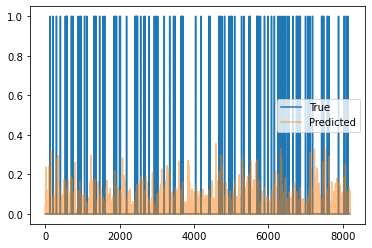

Train Epoch: 11 [310/2220 (13%)]	Loss: 0.040626	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [320/2220 (14%)]	Loss: 0.032872	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [330/2220 (14%)]	Loss: 0.039950	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 11 [340/2220 (15%)]	Loss: 0.038256	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [350/2220 (15%)]	Loss: 0.038603	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [360/2220 (16%)]	Loss: 0.040888	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [370/2220 (16%)]	Loss: 0.040418	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [380/2220 (17%)]	Loss: 0.041299	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [390/2220 (17%)]	Loss: 0.040606	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [400/2220 (18%)]	Loss: 0.039934	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [410/2220 (18%)]	Loss: 0.034913	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [420/2220 (18%)]	Loss: 0.037356	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 

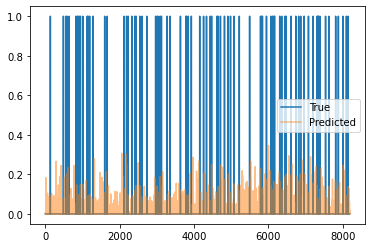

Train Epoch: 11 [610/2220 (27%)]	Loss: 0.041277	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [620/2220 (27%)]	Loss: 0.037032	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [630/2220 (28%)]	Loss: 0.040564	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [640/2220 (28%)]	Loss: 0.041827	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [650/2220 (29%)]	Loss: 0.038587	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [660/2220 (29%)]	Loss: 0.038376	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [670/2220 (30%)]	Loss: 0.039292	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [680/2220 (30%)]	Loss: 0.041148	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [690/2220 (31%)]	Loss: 0.041129	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [700/2220 (31%)]	Loss: 0.035684	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [710/2220 (31%)]	Loss: 0.041102	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [720/2220 (32%)]	Loss: 0.040061	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 

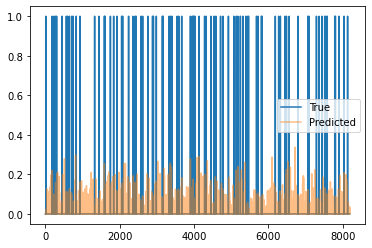

Train Epoch: 11 [910/2220 (40%)]	Loss: 0.040513	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 11 [920/2220 (41%)]	Loss: 0.041452	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [930/2220 (41%)]	Loss: 0.034611	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [940/2220 (42%)]	Loss: 0.041574	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [950/2220 (42%)]	Loss: 0.039378	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [960/2220 (43%)]	Loss: 0.044344	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [970/2220 (43%)]	Loss: 0.040373	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [980/2220 (44%)]	Loss: 0.038643	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 11 [990/2220 (44%)]	Loss: 0.038523	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 11 [1000/2220 (45%)]	Loss: 0.044092	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [1010/2220 (45%)]	Loss: 0.040689	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [1020/2220 (45%)]	Loss: 0.035970	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 

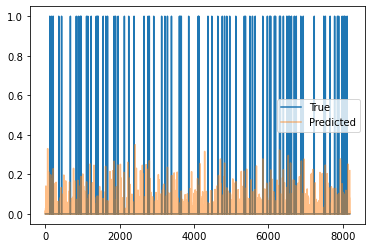

Train Epoch: 11 [1210/2220 (54%)]	Loss: 0.042084	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [1220/2220 (54%)]	Loss: 0.038903	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [1230/2220 (55%)]	Loss: 0.040077	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [1240/2220 (55%)]	Loss: 0.042259	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [1250/2220 (56%)]	Loss: 0.038079	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [1260/2220 (56%)]	Loss: 0.046196	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [1270/2220 (57%)]	Loss: 0.037514	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [1280/2220 (57%)]	Loss: 0.044145	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [1290/2220 (58%)]	Loss: 0.037567	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [1300/2220 (58%)]	Loss: 0.036814	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [1310/2220 (59%)]	Loss: 0.041605	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [1320/2220 (59%)]	Loss: 0.041665	Pres: 0.000000	F1 Score: 0.000000
Trai

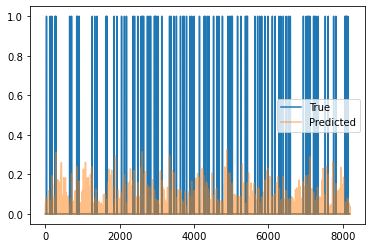

Train Epoch: 11 [1510/2220 (68%)]	Loss: 0.037253	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 11 [1520/2220 (68%)]	Loss: 0.036272	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [1530/2220 (68%)]	Loss: 0.038010	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [1540/2220 (69%)]	Loss: 0.043943	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [1550/2220 (69%)]	Loss: 0.037293	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 11 [1560/2220 (70%)]	Loss: 0.039730	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [1570/2220 (70%)]	Loss: 0.040216	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [1580/2220 (71%)]	Loss: 0.034634	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [1590/2220 (71%)]	Loss: 0.045493	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [1600/2220 (72%)]	Loss: 0.041129	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 11 [1610/2220 (72%)]	Loss: 0.040481	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [1620/2220 (72%)]	Loss: 0.037615	Pres: 0.000000	F1 Score: 0.000000
Trai

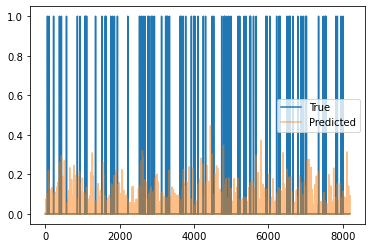

Train Epoch: 11 [1810/2220 (81%)]	Loss: 0.036431	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [1820/2220 (81%)]	Loss: 0.045135	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [1830/2220 (82%)]	Loss: 0.041852	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [1840/2220 (82%)]	Loss: 0.038546	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [1850/2220 (83%)]	Loss: 0.039861	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [1860/2220 (83%)]	Loss: 0.037954	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [1870/2220 (84%)]	Loss: 0.035389	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [1880/2220 (84%)]	Loss: 0.040662	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [1890/2220 (85%)]	Loss: 0.040225	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [1900/2220 (85%)]	Loss: 0.040628	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 11 [1910/2220 (86%)]	Loss: 0.037204	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [1920/2220 (86%)]	Loss: 0.037710	Pres: 0.000000	F1 Score: 0.000000
Trai

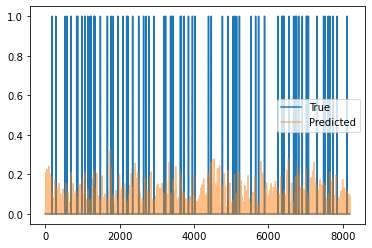

Train Epoch: 11 [2110/2220 (95%)]	Loss: 0.041168	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 11 [2120/2220 (95%)]	Loss: 0.039897	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [2130/2220 (95%)]	Loss: 0.036138	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [2140/2220 (96%)]	Loss: 0.039673	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [2150/2220 (96%)]	Loss: 0.036005	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [2160/2220 (97%)]	Loss: 0.044075	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [2170/2220 (97%)]	Loss: 0.040050	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [2180/2220 (98%)]	Loss: 0.036423	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 11 [2190/2220 (98%)]	Loss: 0.038484	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [2200/2220 (99%)]	Loss: 0.040729	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 11 [2210/2220 (99%)]	Loss: 0.038415	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 11 [0/582 (0%)]	Loss: 0.035000	Pres: 0.000000	F1 Score: 0.000000


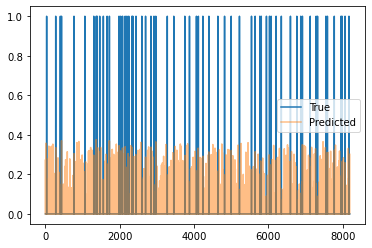

Validation Epoch: 11 [10/582 (1%)]	Loss: 0.039295	Pres: 0.000244	F1 Score: 0.000244
Validation Epoch: 11 [20/582 (3%)]	Loss: 0.039717	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 11 [30/582 (5%)]	Loss: 0.038746	Pres: 0.000122	F1 Score: 0.000122
Validation Epoch: 11 [40/582 (6%)]	Loss: 0.040152	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 11 [50/582 (8%)]	Loss: 0.042390	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 11 [60/582 (10%)]	Loss: 0.039709	Pres: 0.000244	F1 Score: 0.000244
Validation Epoch: 11 [70/582 (12%)]	Loss: 0.038184	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 11 [80/582 (13%)]	Loss: 0.040593	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 11 [90/582 (15%)]	Loss: 0.039939	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 11 [100/582 (17%)]	Loss: 0.039984	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 11 [110/582 (18%)]	Loss: 0.037175	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 11 [120/582 (20%)]	Loss: 0.036458	Pres: 0.000122	F

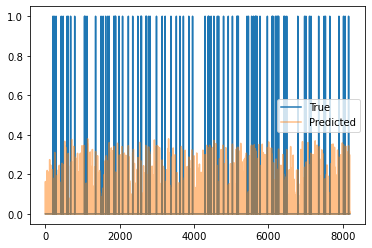

Validation Epoch: 11 [310/582 (53%)]	Loss: 0.038974	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 11 [320/582 (54%)]	Loss: 0.038914	Pres: 0.000488	F1 Score: 0.000488
Validation Epoch: 11 [330/582 (56%)]	Loss: 0.038604	Pres: 0.000244	F1 Score: 0.000244
Validation Epoch: 11 [340/582 (58%)]	Loss: 0.035620	Pres: 0.000244	F1 Score: 0.000244
Validation Epoch: 11 [350/582 (60%)]	Loss: 0.036520	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 11 [360/582 (61%)]	Loss: 0.038313	Pres: 0.000366	F1 Score: 0.000366
Validation Epoch: 11 [370/582 (63%)]	Loss: 0.039184	Pres: 0.000122	F1 Score: 0.000122
Validation Epoch: 11 [380/582 (65%)]	Loss: 0.037212	Pres: 0.000366	F1 Score: 0.000366
Validation Epoch: 11 [390/582 (67%)]	Loss: 0.038331	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 11 [400/582 (68%)]	Loss: 0.040352	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 11 [410/582 (70%)]	Loss: 0.040036	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 11 [420/582 (72%)]	Loss: 0.040412	Pr

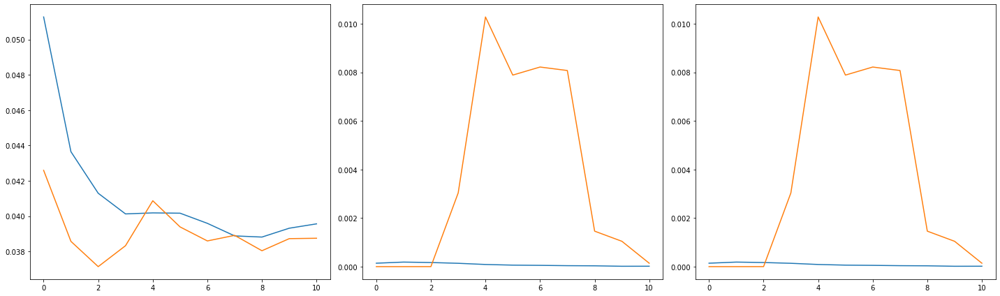

2220 582
Train Epoch: 12 [0/2220 (0%)]	Loss: 0.039886	Pres: 0.000000	F1 Score: 0.000000
79.0 -65280.0


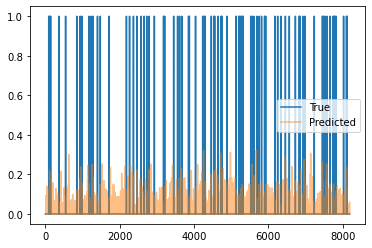

Train Epoch: 12 [10/2220 (0%)]	Loss: 0.037091	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [20/2220 (0%)]	Loss: 0.038967	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [30/2220 (1%)]	Loss: 0.038700	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [40/2220 (1%)]	Loss: 0.042932	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [50/2220 (2%)]	Loss: 0.039481	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [60/2220 (2%)]	Loss: 0.036981	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [70/2220 (3%)]	Loss: 0.043508	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [80/2220 (3%)]	Loss: 0.037839	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [90/2220 (4%)]	Loss: 0.041775	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [100/2220 (4%)]	Loss: 0.044770	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [110/2220 (4%)]	Loss: 0.040228	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [120/2220 (5%)]	Loss: 0.040648	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [130/2220 (5%)]	Loss:

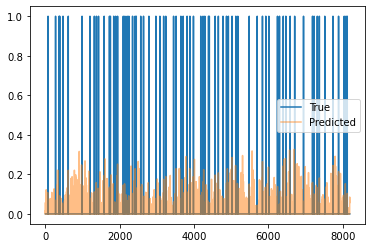

Train Epoch: 12 [310/2220 (13%)]	Loss: 0.039987	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [320/2220 (14%)]	Loss: 0.039354	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [330/2220 (14%)]	Loss: 0.040088	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [340/2220 (15%)]	Loss: 0.040199	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [350/2220 (15%)]	Loss: 0.039938	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [360/2220 (16%)]	Loss: 0.036125	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [370/2220 (16%)]	Loss: 0.038186	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [380/2220 (17%)]	Loss: 0.042867	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [390/2220 (17%)]	Loss: 0.041529	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [400/2220 (18%)]	Loss: 0.040718	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [410/2220 (18%)]	Loss: 0.036285	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [420/2220 (18%)]	Loss: 0.040341	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 12 

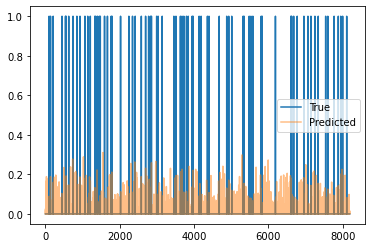

Train Epoch: 12 [610/2220 (27%)]	Loss: 0.039000	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 12 [620/2220 (27%)]	Loss: 0.032054	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [630/2220 (28%)]	Loss: 0.039236	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [640/2220 (28%)]	Loss: 0.036383	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [650/2220 (29%)]	Loss: 0.044573	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [660/2220 (29%)]	Loss: 0.044163	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [670/2220 (30%)]	Loss: 0.037417	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [680/2220 (30%)]	Loss: 0.036202	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [690/2220 (31%)]	Loss: 0.040008	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 12 [700/2220 (31%)]	Loss: 0.038780	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [710/2220 (31%)]	Loss: 0.040583	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [720/2220 (32%)]	Loss: 0.041777	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 

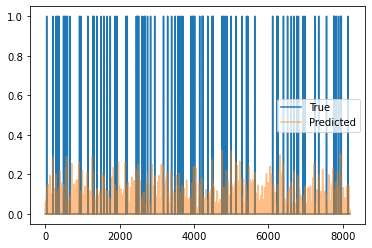

Train Epoch: 12 [910/2220 (40%)]	Loss: 0.035031	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [920/2220 (41%)]	Loss: 0.039895	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [930/2220 (41%)]	Loss: 0.039242	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [940/2220 (42%)]	Loss: 0.037555	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [950/2220 (42%)]	Loss: 0.036652	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [960/2220 (43%)]	Loss: 0.040314	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [970/2220 (43%)]	Loss: 0.037125	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [980/2220 (44%)]	Loss: 0.042070	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [990/2220 (44%)]	Loss: 0.039461	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [1000/2220 (45%)]	Loss: 0.041938	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [1010/2220 (45%)]	Loss: 0.035435	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [1020/2220 (45%)]	Loss: 0.044725	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 

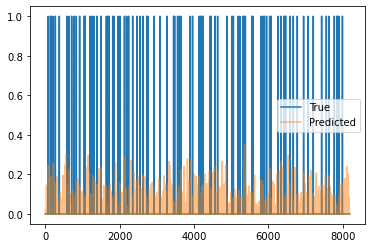

Train Epoch: 12 [1210/2220 (54%)]	Loss: 0.040307	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [1220/2220 (54%)]	Loss: 0.039196	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 12 [1230/2220 (55%)]	Loss: 0.040918	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [1240/2220 (55%)]	Loss: 0.042772	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [1250/2220 (56%)]	Loss: 0.041671	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [1260/2220 (56%)]	Loss: 0.038886	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [1270/2220 (57%)]	Loss: 0.037604	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [1280/2220 (57%)]	Loss: 0.039002	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [1290/2220 (58%)]	Loss: 0.041105	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [1300/2220 (58%)]	Loss: 0.036295	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [1310/2220 (59%)]	Loss: 0.038097	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [1320/2220 (59%)]	Loss: 0.037570	Pres: 0.000000	F1 Score: 0.000000
Trai

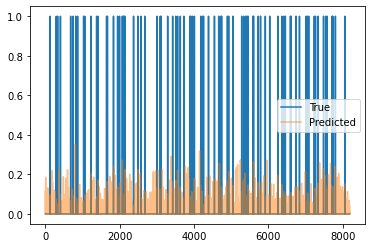

Train Epoch: 12 [1510/2220 (68%)]	Loss: 0.039721	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [1520/2220 (68%)]	Loss: 0.035904	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 12 [1530/2220 (68%)]	Loss: 0.044236	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [1540/2220 (69%)]	Loss: 0.042100	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [1550/2220 (69%)]	Loss: 0.040924	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [1560/2220 (70%)]	Loss: 0.038520	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [1570/2220 (70%)]	Loss: 0.035755	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [1580/2220 (71%)]	Loss: 0.040457	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [1590/2220 (71%)]	Loss: 0.038982	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [1600/2220 (72%)]	Loss: 0.038150	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [1610/2220 (72%)]	Loss: 0.040029	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [1620/2220 (72%)]	Loss: 0.040285	Pres: 0.000000	F1 Score: 0.000000
Trai

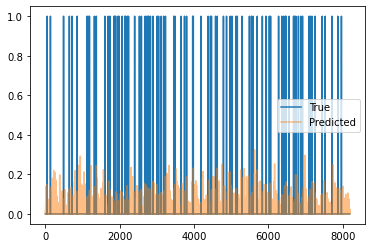

Train Epoch: 12 [1810/2220 (81%)]	Loss: 0.041543	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [1820/2220 (81%)]	Loss: 0.041385	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [1830/2220 (82%)]	Loss: 0.043095	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [1840/2220 (82%)]	Loss: 0.038243	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [1850/2220 (83%)]	Loss: 0.040462	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [1860/2220 (83%)]	Loss: 0.043855	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [1870/2220 (84%)]	Loss: 0.037948	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [1880/2220 (84%)]	Loss: 0.041112	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [1890/2220 (85%)]	Loss: 0.042565	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [1900/2220 (85%)]	Loss: 0.039292	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [1910/2220 (86%)]	Loss: 0.039664	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [1920/2220 (86%)]	Loss: 0.040386	Pres: 0.000000	F1 Score: 0.000000
Trai

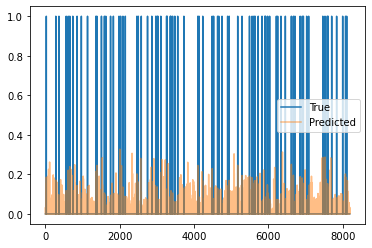

Train Epoch: 12 [2110/2220 (95%)]	Loss: 0.036854	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [2120/2220 (95%)]	Loss: 0.039237	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [2130/2220 (95%)]	Loss: 0.036388	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [2140/2220 (96%)]	Loss: 0.039500	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [2150/2220 (96%)]	Loss: 0.039141	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [2160/2220 (97%)]	Loss: 0.037248	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [2170/2220 (97%)]	Loss: 0.043531	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [2180/2220 (98%)]	Loss: 0.042179	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [2190/2220 (98%)]	Loss: 0.040158	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 12 [2200/2220 (99%)]	Loss: 0.037747	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 12 [2210/2220 (99%)]	Loss: 0.038335	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 12 [0/582 (0%)]	Loss: 0.040345	Pres: 0.000122	F1 Score: 0.000122


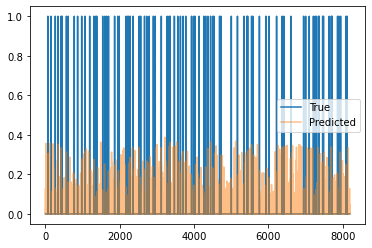

Validation Epoch: 12 [10/582 (1%)]	Loss: 0.038847	Pres: 0.000122	F1 Score: 0.000122
Validation Epoch: 12 [20/582 (3%)]	Loss: 0.038465	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 12 [30/582 (5%)]	Loss: 0.036922	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 12 [40/582 (6%)]	Loss: 0.039167	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 12 [50/582 (8%)]	Loss: 0.037263	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 12 [60/582 (10%)]	Loss: 0.039689	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 12 [70/582 (12%)]	Loss: 0.040872	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 12 [80/582 (13%)]	Loss: 0.038035	Pres: 0.000244	F1 Score: 0.000244
Validation Epoch: 12 [90/582 (15%)]	Loss: 0.038586	Pres: 0.000122	F1 Score: 0.000122
Validation Epoch: 12 [100/582 (17%)]	Loss: 0.037846	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 12 [110/582 (18%)]	Loss: 0.040988	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 12 [120/582 (20%)]	Loss: 0.037135	Pres: 0.000000	F

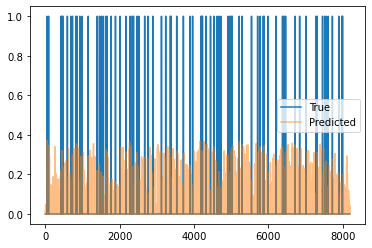

Validation Epoch: 12 [310/582 (53%)]	Loss: 0.036491	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 12 [320/582 (54%)]	Loss: 0.036169	Pres: 0.000122	F1 Score: 0.000122
Validation Epoch: 12 [330/582 (56%)]	Loss: 0.035684	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 12 [340/582 (58%)]	Loss: 0.036160	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 12 [350/582 (60%)]	Loss: 0.039671	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 12 [360/582 (61%)]	Loss: 0.035052	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 12 [370/582 (63%)]	Loss: 0.036341	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 12 [380/582 (65%)]	Loss: 0.039522	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 12 [390/582 (67%)]	Loss: 0.039857	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 12 [400/582 (68%)]	Loss: 0.035904	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 12 [410/582 (70%)]	Loss: 0.036974	Pres: 0.000122	F1 Score: 0.000122
Validation Epoch: 12 [420/582 (72%)]	Loss: 0.035597	Pr

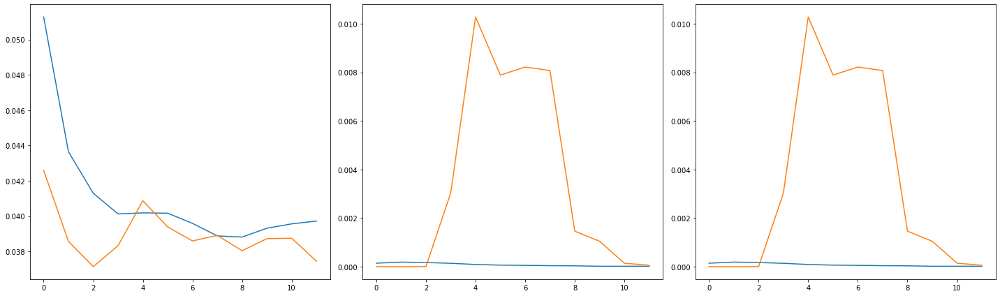

2220 582
Train Epoch: 13 [0/2220 (0%)]	Loss: 0.041006	Pres: 0.000000	F1 Score: 0.000000
89.0 -inf


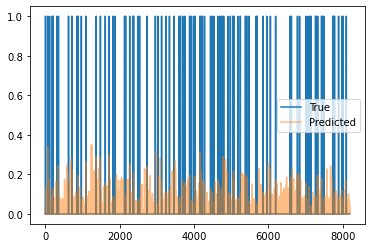

Train Epoch: 13 [10/2220 (0%)]	Loss: 0.041035	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [20/2220 (0%)]	Loss: 0.043123	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [30/2220 (1%)]	Loss: 0.040246	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [40/2220 (1%)]	Loss: 0.040294	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [50/2220 (2%)]	Loss: 0.037543	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [60/2220 (2%)]	Loss: 0.037846	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [70/2220 (3%)]	Loss: 0.035930	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [80/2220 (3%)]	Loss: 0.039084	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [90/2220 (4%)]	Loss: 0.042793	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [100/2220 (4%)]	Loss: 0.038399	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [110/2220 (4%)]	Loss: 0.036245	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [120/2220 (5%)]	Loss: 0.040318	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [130/2220 (5%)]	Loss:

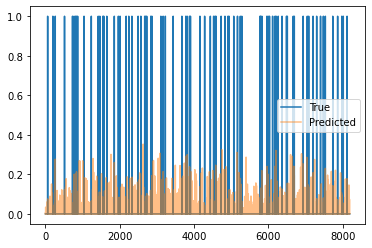

Train Epoch: 13 [310/2220 (13%)]	Loss: 0.036865	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [320/2220 (14%)]	Loss: 0.041137	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [330/2220 (14%)]	Loss: 0.037747	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [340/2220 (15%)]	Loss: 0.036351	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 13 [350/2220 (15%)]	Loss: 0.033587	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [360/2220 (16%)]	Loss: 0.042662	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [370/2220 (16%)]	Loss: 0.036739	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [380/2220 (17%)]	Loss: 0.044948	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [390/2220 (17%)]	Loss: 0.039102	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [400/2220 (18%)]	Loss: 0.040562	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [410/2220 (18%)]	Loss: 0.041370	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [420/2220 (18%)]	Loss: 0.041173	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 

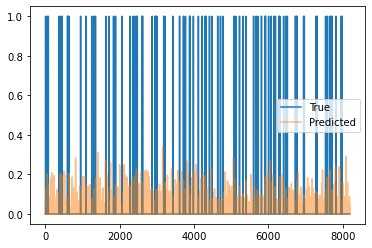

Train Epoch: 13 [610/2220 (27%)]	Loss: 0.036041	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [620/2220 (27%)]	Loss: 0.038666	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [630/2220 (28%)]	Loss: 0.039151	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [640/2220 (28%)]	Loss: 0.038973	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 13 [650/2220 (29%)]	Loss: 0.037246	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [660/2220 (29%)]	Loss: 0.038236	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [670/2220 (30%)]	Loss: 0.037182	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [680/2220 (30%)]	Loss: 0.044569	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [690/2220 (31%)]	Loss: 0.036073	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [700/2220 (31%)]	Loss: 0.036018	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [710/2220 (31%)]	Loss: 0.039699	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [720/2220 (32%)]	Loss: 0.039437	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 

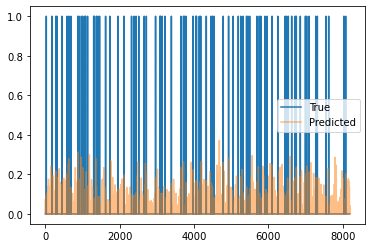

Train Epoch: 13 [910/2220 (40%)]	Loss: 0.037136	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [920/2220 (41%)]	Loss: 0.041850	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [930/2220 (41%)]	Loss: 0.038956	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [940/2220 (42%)]	Loss: 0.044147	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [950/2220 (42%)]	Loss: 0.037922	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [960/2220 (43%)]	Loss: 0.036319	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [970/2220 (43%)]	Loss: 0.036706	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [980/2220 (44%)]	Loss: 0.038836	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [990/2220 (44%)]	Loss: 0.038038	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1000/2220 (45%)]	Loss: 0.045302	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1010/2220 (45%)]	Loss: 0.039572	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1020/2220 (45%)]	Loss: 0.036935	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 

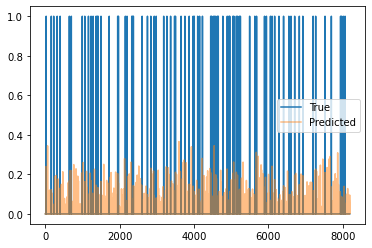

Train Epoch: 13 [1210/2220 (54%)]	Loss: 0.043748	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1220/2220 (54%)]	Loss: 0.041946	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1230/2220 (55%)]	Loss: 0.035720	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1240/2220 (55%)]	Loss: 0.043797	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1250/2220 (56%)]	Loss: 0.041327	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1260/2220 (56%)]	Loss: 0.036021	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1270/2220 (57%)]	Loss: 0.040342	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1280/2220 (57%)]	Loss: 0.040227	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1290/2220 (58%)]	Loss: 0.040768	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1300/2220 (58%)]	Loss: 0.039208	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1310/2220 (59%)]	Loss: 0.039412	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1320/2220 (59%)]	Loss: 0.041665	Pres: 0.000122	F1 Score: 0.000122
Trai

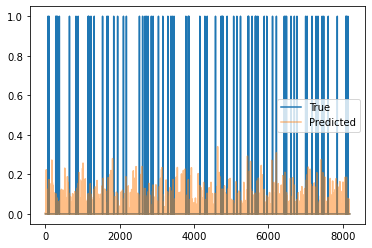

Train Epoch: 13 [1510/2220 (68%)]	Loss: 0.045482	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1520/2220 (68%)]	Loss: 0.039544	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1530/2220 (68%)]	Loss: 0.037751	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1540/2220 (69%)]	Loss: 0.045200	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1550/2220 (69%)]	Loss: 0.036742	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1560/2220 (70%)]	Loss: 0.041209	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1570/2220 (70%)]	Loss: 0.038809	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1580/2220 (71%)]	Loss: 0.042982	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1590/2220 (71%)]	Loss: 0.038901	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1600/2220 (72%)]	Loss: 0.040247	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1610/2220 (72%)]	Loss: 0.034049	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 13 [1620/2220 (72%)]	Loss: 0.037741	Pres: 0.000000	F1 Score: 0.000000
Trai

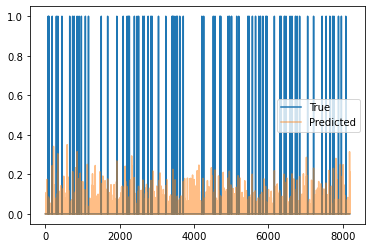

Train Epoch: 13 [1810/2220 (81%)]	Loss: 0.042403	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1820/2220 (81%)]	Loss: 0.043743	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1830/2220 (82%)]	Loss: 0.039600	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1840/2220 (82%)]	Loss: 0.041480	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1850/2220 (83%)]	Loss: 0.039574	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1860/2220 (83%)]	Loss: 0.045153	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1870/2220 (84%)]	Loss: 0.043853	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1880/2220 (84%)]	Loss: 0.039051	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 13 [1890/2220 (85%)]	Loss: 0.038698	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1900/2220 (85%)]	Loss: 0.041492	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1910/2220 (86%)]	Loss: 0.033294	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [1920/2220 (86%)]	Loss: 0.039487	Pres: 0.000000	F1 Score: 0.000000
Trai

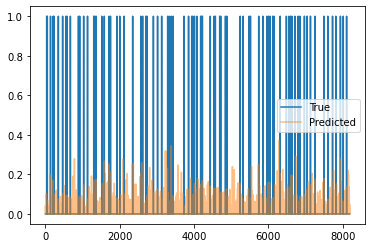

Train Epoch: 13 [2110/2220 (95%)]	Loss: 0.040414	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [2120/2220 (95%)]	Loss: 0.044286	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [2130/2220 (95%)]	Loss: 0.037821	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [2140/2220 (96%)]	Loss: 0.040420	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 13 [2150/2220 (96%)]	Loss: 0.040561	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [2160/2220 (97%)]	Loss: 0.035106	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [2170/2220 (97%)]	Loss: 0.039853	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [2180/2220 (98%)]	Loss: 0.043604	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [2190/2220 (98%)]	Loss: 0.038843	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [2200/2220 (99%)]	Loss: 0.043657	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 13 [2210/2220 (99%)]	Loss: 0.041594	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 13 [0/582 (0%)]	Loss: 0.040126	Pres: 0.002441	F1 Score: 0.002441


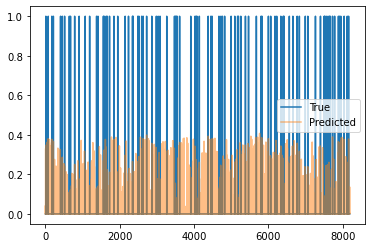

Validation Epoch: 13 [10/582 (1%)]	Loss: 0.039733	Pres: 0.001465	F1 Score: 0.001465
Validation Epoch: 13 [20/582 (3%)]	Loss: 0.037533	Pres: 0.002075	F1 Score: 0.002075
Validation Epoch: 13 [30/582 (5%)]	Loss: 0.040980	Pres: 0.001953	F1 Score: 0.001953
Validation Epoch: 13 [40/582 (6%)]	Loss: 0.038013	Pres: 0.003540	F1 Score: 0.003540
Validation Epoch: 13 [50/582 (8%)]	Loss: 0.037652	Pres: 0.001099	F1 Score: 0.001099
Validation Epoch: 13 [60/582 (10%)]	Loss: 0.038304	Pres: 0.002197	F1 Score: 0.002197
Validation Epoch: 13 [70/582 (12%)]	Loss: 0.039700	Pres: 0.002319	F1 Score: 0.002319
Validation Epoch: 13 [80/582 (13%)]	Loss: 0.040142	Pres: 0.001953	F1 Score: 0.001953
Validation Epoch: 13 [90/582 (15%)]	Loss: 0.038225	Pres: 0.001465	F1 Score: 0.001465
Validation Epoch: 13 [100/582 (17%)]	Loss: 0.037477	Pres: 0.002563	F1 Score: 0.002563
Validation Epoch: 13 [110/582 (18%)]	Loss: 0.040020	Pres: 0.002319	F1 Score: 0.002319
Validation Epoch: 13 [120/582 (20%)]	Loss: 0.040581	Pres: 0.002197	F

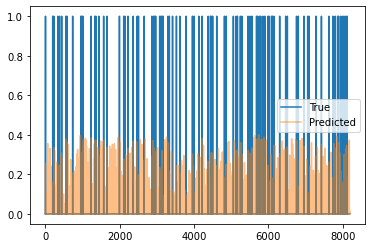

Validation Epoch: 13 [310/582 (53%)]	Loss: 0.041576	Pres: 0.002075	F1 Score: 0.002075
Validation Epoch: 13 [320/582 (54%)]	Loss: 0.040726	Pres: 0.001831	F1 Score: 0.001831
Validation Epoch: 13 [330/582 (56%)]	Loss: 0.040012	Pres: 0.001587	F1 Score: 0.001587
Validation Epoch: 13 [340/582 (58%)]	Loss: 0.036150	Pres: 0.001221	F1 Score: 0.001221
Validation Epoch: 13 [350/582 (60%)]	Loss: 0.037932	Pres: 0.002441	F1 Score: 0.002441
Validation Epoch: 13 [360/582 (61%)]	Loss: 0.036579	Pres: 0.001953	F1 Score: 0.001953
Validation Epoch: 13 [370/582 (63%)]	Loss: 0.037607	Pres: 0.001953	F1 Score: 0.001953
Validation Epoch: 13 [380/582 (65%)]	Loss: 0.042941	Pres: 0.001465	F1 Score: 0.001465
Validation Epoch: 13 [390/582 (67%)]	Loss: 0.040523	Pres: 0.001709	F1 Score: 0.001709
Validation Epoch: 13 [400/582 (68%)]	Loss: 0.037464	Pres: 0.003418	F1 Score: 0.003418
Validation Epoch: 13 [410/582 (70%)]	Loss: 0.037728	Pres: 0.002319	F1 Score: 0.002319
Validation Epoch: 13 [420/582 (72%)]	Loss: 0.040044	Pr

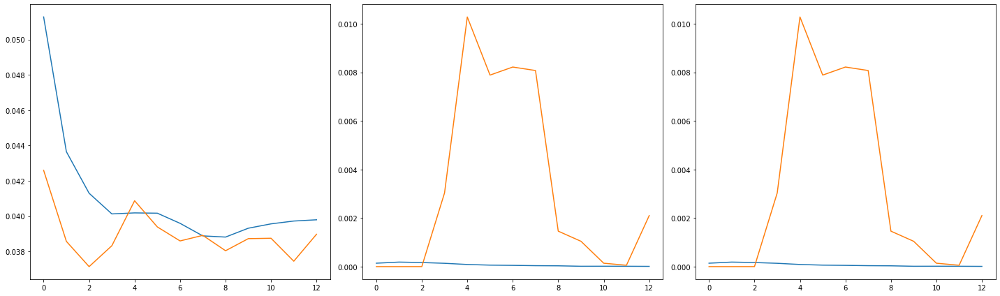

2220 582
Train Epoch: 14 [0/2220 (0%)]	Loss: 0.039517	Pres: 0.000000	F1 Score: 0.000000
86.0 -63648.0


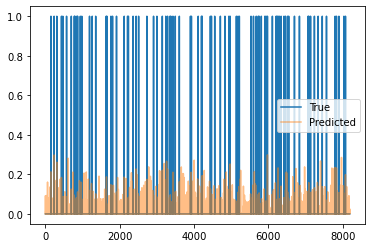

Train Epoch: 14 [10/2220 (0%)]	Loss: 0.036992	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 14 [20/2220 (0%)]	Loss: 0.038556	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [30/2220 (1%)]	Loss: 0.042915	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [40/2220 (1%)]	Loss: 0.041674	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [50/2220 (2%)]	Loss: 0.039715	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [60/2220 (2%)]	Loss: 0.043114	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [70/2220 (3%)]	Loss: 0.035060	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [80/2220 (3%)]	Loss: 0.043594	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [90/2220 (4%)]	Loss: 0.047895	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [100/2220 (4%)]	Loss: 0.048288	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [110/2220 (4%)]	Loss: 0.040321	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [120/2220 (5%)]	Loss: 0.037746	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [130/2220 (5%)]	Loss:

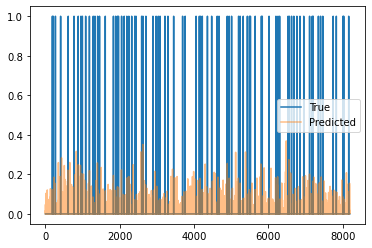

Train Epoch: 14 [310/2220 (13%)]	Loss: 0.040601	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [320/2220 (14%)]	Loss: 0.042742	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [330/2220 (14%)]	Loss: 0.043363	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [340/2220 (15%)]	Loss: 0.042286	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [350/2220 (15%)]	Loss: 0.039250	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [360/2220 (16%)]	Loss: 0.040695	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [370/2220 (16%)]	Loss: 0.042968	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [380/2220 (17%)]	Loss: 0.039183	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [390/2220 (17%)]	Loss: 0.039340	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [400/2220 (18%)]	Loss: 0.041992	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [410/2220 (18%)]	Loss: 0.035033	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [420/2220 (18%)]	Loss: 0.043507	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 

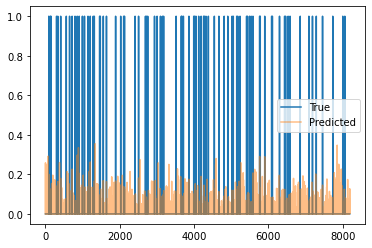

Train Epoch: 14 [610/2220 (27%)]	Loss: 0.038620	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [620/2220 (27%)]	Loss: 0.039758	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [630/2220 (28%)]	Loss: 0.038945	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [640/2220 (28%)]	Loss: 0.037658	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [650/2220 (29%)]	Loss: 0.034503	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [660/2220 (29%)]	Loss: 0.035262	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [670/2220 (30%)]	Loss: 0.038587	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [680/2220 (30%)]	Loss: 0.040729	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [690/2220 (31%)]	Loss: 0.045052	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [700/2220 (31%)]	Loss: 0.040111	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [710/2220 (31%)]	Loss: 0.048216	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [720/2220 (32%)]	Loss: 0.033922	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 

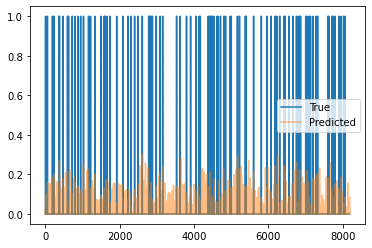

Train Epoch: 14 [910/2220 (40%)]	Loss: 0.038088	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [920/2220 (41%)]	Loss: 0.040060	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [930/2220 (41%)]	Loss: 0.037580	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [940/2220 (42%)]	Loss: 0.044232	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 14 [950/2220 (42%)]	Loss: 0.041334	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 14 [960/2220 (43%)]	Loss: 0.046190	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [970/2220 (43%)]	Loss: 0.037820	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [980/2220 (44%)]	Loss: 0.041848	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [990/2220 (44%)]	Loss: 0.040138	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1000/2220 (45%)]	Loss: 0.036864	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1010/2220 (45%)]	Loss: 0.045215	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1020/2220 (45%)]	Loss: 0.040227	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 

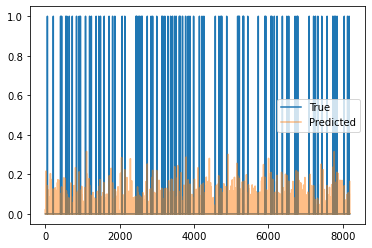

Train Epoch: 14 [1210/2220 (54%)]	Loss: 0.038945	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1220/2220 (54%)]	Loss: 0.040591	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1230/2220 (55%)]	Loss: 0.038914	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1240/2220 (55%)]	Loss: 0.039560	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1250/2220 (56%)]	Loss: 0.042475	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1260/2220 (56%)]	Loss: 0.040713	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1270/2220 (57%)]	Loss: 0.039456	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1280/2220 (57%)]	Loss: 0.036877	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1290/2220 (58%)]	Loss: 0.040419	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1300/2220 (58%)]	Loss: 0.037476	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1310/2220 (59%)]	Loss: 0.031478	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 14 [1320/2220 (59%)]	Loss: 0.040632	Pres: 0.000000	F1 Score: 0.000000
Trai

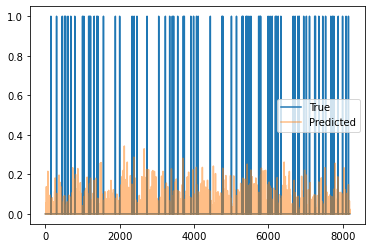

Train Epoch: 14 [1510/2220 (68%)]	Loss: 0.039539	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1520/2220 (68%)]	Loss: 0.038661	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 14 [1530/2220 (68%)]	Loss: 0.043972	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1540/2220 (69%)]	Loss: 0.039078	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 14 [1550/2220 (69%)]	Loss: 0.045222	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1560/2220 (70%)]	Loss: 0.035952	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1570/2220 (70%)]	Loss: 0.041388	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1580/2220 (71%)]	Loss: 0.039731	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1590/2220 (71%)]	Loss: 0.040772	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 14 [1600/2220 (72%)]	Loss: 0.042507	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1610/2220 (72%)]	Loss: 0.045374	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1620/2220 (72%)]	Loss: 0.039357	Pres: 0.000000	F1 Score: 0.000000
Trai

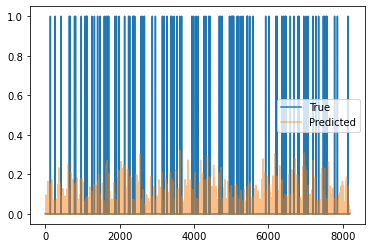

Train Epoch: 14 [1810/2220 (81%)]	Loss: 0.036693	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1820/2220 (81%)]	Loss: 0.039973	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1830/2220 (82%)]	Loss: 0.035811	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1840/2220 (82%)]	Loss: 0.041080	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1850/2220 (83%)]	Loss: 0.042685	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 14 [1860/2220 (83%)]	Loss: 0.044086	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1870/2220 (84%)]	Loss: 0.037279	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1880/2220 (84%)]	Loss: 0.036790	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1890/2220 (85%)]	Loss: 0.033647	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 14 [1900/2220 (85%)]	Loss: 0.042099	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1910/2220 (86%)]	Loss: 0.040242	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [1920/2220 (86%)]	Loss: 0.037100	Pres: 0.000000	F1 Score: 0.000000
Trai

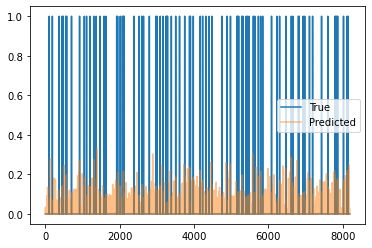

Train Epoch: 14 [2110/2220 (95%)]	Loss: 0.038727	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 14 [2120/2220 (95%)]	Loss: 0.042890	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 14 [2130/2220 (95%)]	Loss: 0.039967	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 14 [2140/2220 (96%)]	Loss: 0.037297	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [2150/2220 (96%)]	Loss: 0.041972	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [2160/2220 (97%)]	Loss: 0.040918	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [2170/2220 (97%)]	Loss: 0.040593	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [2180/2220 (98%)]	Loss: 0.038716	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [2190/2220 (98%)]	Loss: 0.038329	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [2200/2220 (99%)]	Loss: 0.034908	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 14 [2210/2220 (99%)]	Loss: 0.039720	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 14 [0/582 (0%)]	Loss: 0.034788	Pres: 0.006958	F1 Score: 0.006958


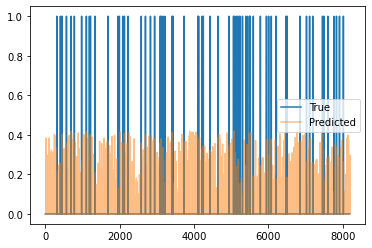

Validation Epoch: 14 [10/582 (1%)]	Loss: 0.039132	Pres: 0.007202	F1 Score: 0.007202
Validation Epoch: 14 [20/582 (3%)]	Loss: 0.039320	Pres: 0.006104	F1 Score: 0.006104
Validation Epoch: 14 [30/582 (5%)]	Loss: 0.037235	Pres: 0.005005	F1 Score: 0.005005
Validation Epoch: 14 [40/582 (6%)]	Loss: 0.040329	Pres: 0.006348	F1 Score: 0.006348
Validation Epoch: 14 [50/582 (8%)]	Loss: 0.041727	Pres: 0.004028	F1 Score: 0.004028
Validation Epoch: 14 [60/582 (10%)]	Loss: 0.039026	Pres: 0.005371	F1 Score: 0.005371
Validation Epoch: 14 [70/582 (12%)]	Loss: 0.041029	Pres: 0.003296	F1 Score: 0.003296
Validation Epoch: 14 [80/582 (13%)]	Loss: 0.039763	Pres: 0.005371	F1 Score: 0.005371
Validation Epoch: 14 [90/582 (15%)]	Loss: 0.037187	Pres: 0.007446	F1 Score: 0.007446
Validation Epoch: 14 [100/582 (17%)]	Loss: 0.040823	Pres: 0.005859	F1 Score: 0.005859
Validation Epoch: 14 [110/582 (18%)]	Loss: 0.039053	Pres: 0.006104	F1 Score: 0.006104
Validation Epoch: 14 [120/582 (20%)]	Loss: 0.040652	Pres: 0.006836	F

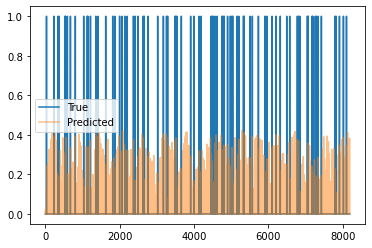

Validation Epoch: 14 [310/582 (53%)]	Loss: 0.038842	Pres: 0.003906	F1 Score: 0.003906
Validation Epoch: 14 [320/582 (54%)]	Loss: 0.038353	Pres: 0.007080	F1 Score: 0.007080
Validation Epoch: 14 [330/582 (56%)]	Loss: 0.037254	Pres: 0.005249	F1 Score: 0.005249
Validation Epoch: 14 [340/582 (58%)]	Loss: 0.041205	Pres: 0.005493	F1 Score: 0.005493
Validation Epoch: 14 [350/582 (60%)]	Loss: 0.039074	Pres: 0.005005	F1 Score: 0.005005
Validation Epoch: 14 [360/582 (61%)]	Loss: 0.038011	Pres: 0.005615	F1 Score: 0.005615
Validation Epoch: 14 [370/582 (63%)]	Loss: 0.038629	Pres: 0.005005	F1 Score: 0.005005
Validation Epoch: 14 [380/582 (65%)]	Loss: 0.039719	Pres: 0.003784	F1 Score: 0.003784
Validation Epoch: 14 [390/582 (67%)]	Loss: 0.038926	Pres: 0.003784	F1 Score: 0.003784
Validation Epoch: 14 [400/582 (68%)]	Loss: 0.038573	Pres: 0.004272	F1 Score: 0.004272
Validation Epoch: 14 [410/582 (70%)]	Loss: 0.038907	Pres: 0.003662	F1 Score: 0.003662
Validation Epoch: 14 [420/582 (72%)]	Loss: 0.036006	Pr

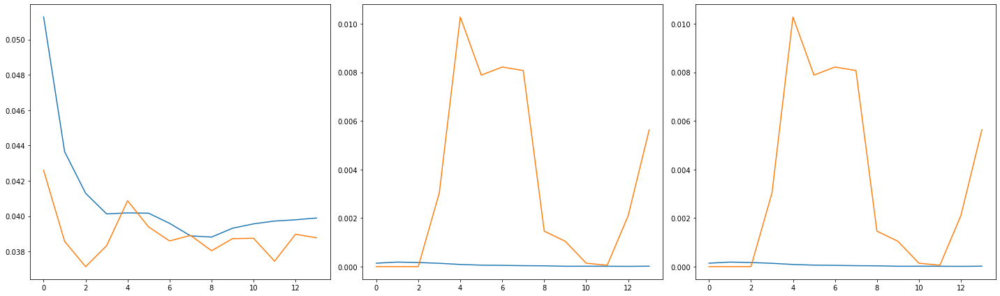

2220 582
Train Epoch: 15 [0/2220 (0%)]	Loss: 0.039519	Pres: 0.000000	F1 Score: 0.000000
88.0 -65312.0


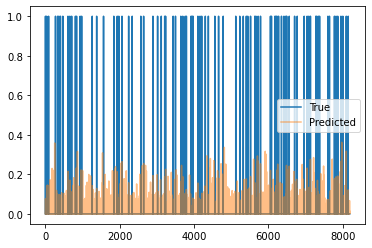

Train Epoch: 15 [10/2220 (0%)]	Loss: 0.039847	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [20/2220 (0%)]	Loss: 0.039734	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [30/2220 (1%)]	Loss: 0.040459	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [40/2220 (1%)]	Loss: 0.041405	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [50/2220 (2%)]	Loss: 0.036478	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [60/2220 (2%)]	Loss: 0.040499	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [70/2220 (3%)]	Loss: 0.039537	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [80/2220 (3%)]	Loss: 0.041872	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 15 [90/2220 (4%)]	Loss: 0.040454	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [100/2220 (4%)]	Loss: 0.047525	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [110/2220 (4%)]	Loss: 0.043199	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [120/2220 (5%)]	Loss: 0.041524	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [130/2220 (5%)]	Loss:

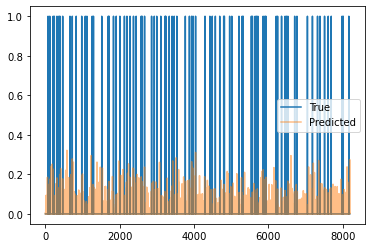

Train Epoch: 15 [310/2220 (13%)]	Loss: 0.044898	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [320/2220 (14%)]	Loss: 0.039848	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [330/2220 (14%)]	Loss: 0.042393	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [340/2220 (15%)]	Loss: 0.038110	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [350/2220 (15%)]	Loss: 0.035413	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [360/2220 (16%)]	Loss: 0.043194	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [370/2220 (16%)]	Loss: 0.041339	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [380/2220 (17%)]	Loss: 0.046976	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [390/2220 (17%)]	Loss: 0.041887	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [400/2220 (18%)]	Loss: 0.040248	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [410/2220 (18%)]	Loss: 0.039525	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [420/2220 (18%)]	Loss: 0.034773	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 

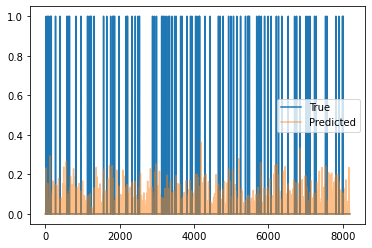

Train Epoch: 15 [610/2220 (27%)]	Loss: 0.041439	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [620/2220 (27%)]	Loss: 0.041503	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [630/2220 (28%)]	Loss: 0.037442	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [640/2220 (28%)]	Loss: 0.043181	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [650/2220 (29%)]	Loss: 0.041277	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [660/2220 (29%)]	Loss: 0.039636	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [670/2220 (30%)]	Loss: 0.038348	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [680/2220 (30%)]	Loss: 0.034724	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [690/2220 (31%)]	Loss: 0.035291	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [700/2220 (31%)]	Loss: 0.036189	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [710/2220 (31%)]	Loss: 0.038311	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [720/2220 (32%)]	Loss: 0.038718	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 

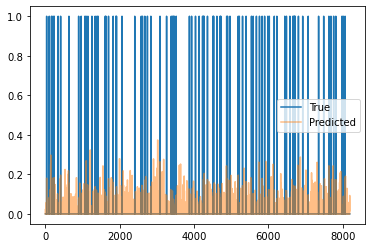

Train Epoch: 15 [910/2220 (40%)]	Loss: 0.041906	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [920/2220 (41%)]	Loss: 0.041464	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [930/2220 (41%)]	Loss: 0.041870	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [940/2220 (42%)]	Loss: 0.039056	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [950/2220 (42%)]	Loss: 0.041483	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [960/2220 (43%)]	Loss: 0.040393	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [970/2220 (43%)]	Loss: 0.037750	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [980/2220 (44%)]	Loss: 0.036987	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [990/2220 (44%)]	Loss: 0.039605	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1000/2220 (45%)]	Loss: 0.039582	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1010/2220 (45%)]	Loss: 0.036506	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 15 [1020/2220 (45%)]	Loss: 0.038067	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 

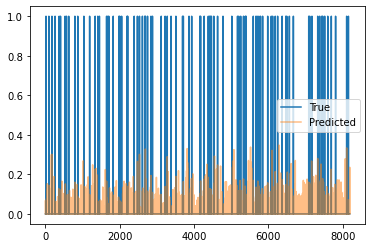

Train Epoch: 15 [1210/2220 (54%)]	Loss: 0.041528	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1220/2220 (54%)]	Loss: 0.040015	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1230/2220 (55%)]	Loss: 0.037891	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1240/2220 (55%)]	Loss: 0.038513	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1250/2220 (56%)]	Loss: 0.039357	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1260/2220 (56%)]	Loss: 0.037826	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1270/2220 (57%)]	Loss: 0.039164	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1280/2220 (57%)]	Loss: 0.040135	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 15 [1290/2220 (58%)]	Loss: 0.037032	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1300/2220 (58%)]	Loss: 0.035712	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1310/2220 (59%)]	Loss: 0.038857	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1320/2220 (59%)]	Loss: 0.040277	Pres: 0.000000	F1 Score: 0.000000
Trai

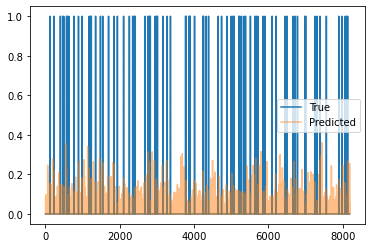

Train Epoch: 15 [1510/2220 (68%)]	Loss: 0.043766	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1520/2220 (68%)]	Loss: 0.036328	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 15 [1530/2220 (68%)]	Loss: 0.042387	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1540/2220 (69%)]	Loss: 0.035653	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1550/2220 (69%)]	Loss: 0.041642	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1560/2220 (70%)]	Loss: 0.042417	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 15 [1570/2220 (70%)]	Loss: 0.039330	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1580/2220 (71%)]	Loss: 0.039640	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1590/2220 (71%)]	Loss: 0.039602	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1600/2220 (72%)]	Loss: 0.038058	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1610/2220 (72%)]	Loss: 0.037937	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 15 [1620/2220 (72%)]	Loss: 0.042205	Pres: 0.000000	F1 Score: 0.000000
Trai

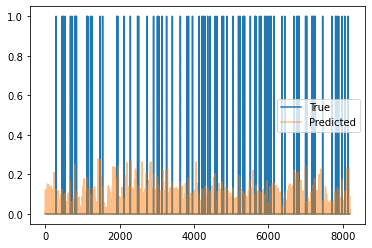

Train Epoch: 15 [1810/2220 (81%)]	Loss: 0.036319	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1820/2220 (81%)]	Loss: 0.034432	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1830/2220 (82%)]	Loss: 0.036513	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1840/2220 (82%)]	Loss: 0.041683	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1850/2220 (83%)]	Loss: 0.037573	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1860/2220 (83%)]	Loss: 0.037212	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1870/2220 (84%)]	Loss: 0.040980	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1880/2220 (84%)]	Loss: 0.039690	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1890/2220 (85%)]	Loss: 0.041455	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1900/2220 (85%)]	Loss: 0.039580	Pres: 0.000244	F1 Score: 0.000244
Train Epoch: 15 [1910/2220 (86%)]	Loss: 0.041770	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [1920/2220 (86%)]	Loss: 0.039254	Pres: 0.000122	F1 Score: 0.000122
Trai

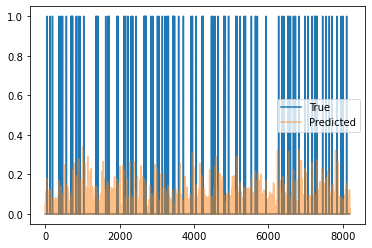

Train Epoch: 15 [2110/2220 (95%)]	Loss: 0.040021	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [2120/2220 (95%)]	Loss: 0.040689	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [2130/2220 (95%)]	Loss: 0.038964	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [2140/2220 (96%)]	Loss: 0.042980	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [2150/2220 (96%)]	Loss: 0.040395	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [2160/2220 (97%)]	Loss: 0.039027	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [2170/2220 (97%)]	Loss: 0.035624	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [2180/2220 (98%)]	Loss: 0.037058	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [2190/2220 (98%)]	Loss: 0.037922	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [2200/2220 (99%)]	Loss: 0.039694	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 15 [2210/2220 (99%)]	Loss: 0.038668	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 15 [0/582 (0%)]	Loss: 0.037557	Pres: 0.000488	F1 Score: 0.000488


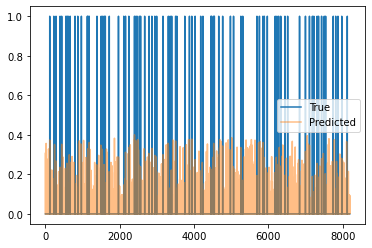

Validation Epoch: 15 [10/582 (1%)]	Loss: 0.037740	Pres: 0.001221	F1 Score: 0.001221
Validation Epoch: 15 [20/582 (3%)]	Loss: 0.039165	Pres: 0.000854	F1 Score: 0.000854
Validation Epoch: 15 [30/582 (5%)]	Loss: 0.038550	Pres: 0.001465	F1 Score: 0.001465
Validation Epoch: 15 [40/582 (6%)]	Loss: 0.036270	Pres: 0.001709	F1 Score: 0.001709
Validation Epoch: 15 [50/582 (8%)]	Loss: 0.040999	Pres: 0.001465	F1 Score: 0.001465
Validation Epoch: 15 [60/582 (10%)]	Loss: 0.042965	Pres: 0.000854	F1 Score: 0.000854
Validation Epoch: 15 [70/582 (12%)]	Loss: 0.039685	Pres: 0.001221	F1 Score: 0.001221
Validation Epoch: 15 [80/582 (13%)]	Loss: 0.038045	Pres: 0.000854	F1 Score: 0.000854
Validation Epoch: 15 [90/582 (15%)]	Loss: 0.039905	Pres: 0.001709	F1 Score: 0.001709
Validation Epoch: 15 [100/582 (17%)]	Loss: 0.038965	Pres: 0.000732	F1 Score: 0.000732
Validation Epoch: 15 [110/582 (18%)]	Loss: 0.038937	Pres: 0.000977	F1 Score: 0.000977
Validation Epoch: 15 [120/582 (20%)]	Loss: 0.041382	Pres: 0.001099	F

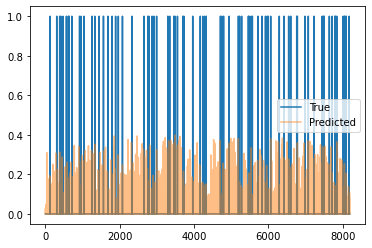

Validation Epoch: 15 [310/582 (53%)]	Loss: 0.038937	Pres: 0.000977	F1 Score: 0.000977
Validation Epoch: 15 [320/582 (54%)]	Loss: 0.038326	Pres: 0.001709	F1 Score: 0.001709
Validation Epoch: 15 [330/582 (56%)]	Loss: 0.034058	Pres: 0.001343	F1 Score: 0.001343
Validation Epoch: 15 [340/582 (58%)]	Loss: 0.038551	Pres: 0.001465	F1 Score: 0.001465
Validation Epoch: 15 [350/582 (60%)]	Loss: 0.038291	Pres: 0.000488	F1 Score: 0.000488
Validation Epoch: 15 [360/582 (61%)]	Loss: 0.038951	Pres: 0.000732	F1 Score: 0.000732
Validation Epoch: 15 [370/582 (63%)]	Loss: 0.041150	Pres: 0.001343	F1 Score: 0.001343
Validation Epoch: 15 [380/582 (65%)]	Loss: 0.038557	Pres: 0.000732	F1 Score: 0.000732
Validation Epoch: 15 [390/582 (67%)]	Loss: 0.039669	Pres: 0.001587	F1 Score: 0.001587
Validation Epoch: 15 [400/582 (68%)]	Loss: 0.040808	Pres: 0.000854	F1 Score: 0.000854
Validation Epoch: 15 [410/582 (70%)]	Loss: 0.041151	Pres: 0.000610	F1 Score: 0.000610
Validation Epoch: 15 [420/582 (72%)]	Loss: 0.035921	Pr

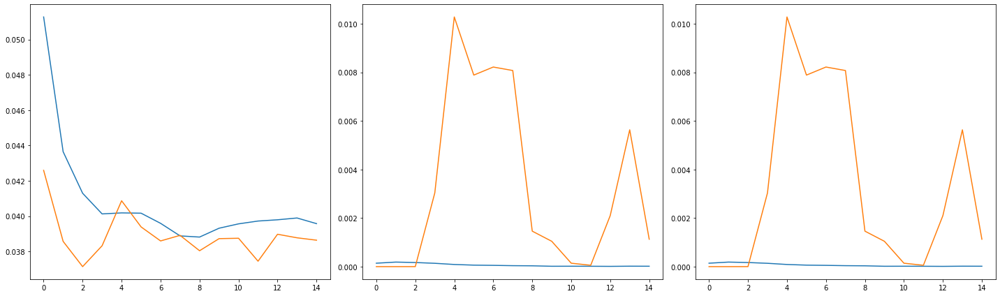

2220 582
Train Epoch: 16 [0/2220 (0%)]	Loss: 0.041620	Pres: 0.000000	F1 Score: 0.000000
93.0 -inf


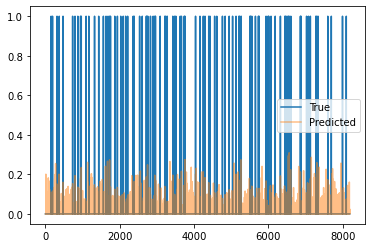

Train Epoch: 16 [10/2220 (0%)]	Loss: 0.044026	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [20/2220 (0%)]	Loss: 0.040585	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [30/2220 (1%)]	Loss: 0.042256	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [40/2220 (1%)]	Loss: 0.038082	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [50/2220 (2%)]	Loss: 0.040791	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [60/2220 (2%)]	Loss: 0.036052	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 16 [70/2220 (3%)]	Loss: 0.032497	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [80/2220 (3%)]	Loss: 0.039018	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [90/2220 (4%)]	Loss: 0.039533	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [100/2220 (4%)]	Loss: 0.038716	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [110/2220 (4%)]	Loss: 0.042210	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [120/2220 (5%)]	Loss: 0.038169	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [130/2220 (5%)]	Loss:

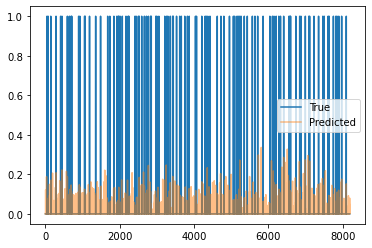

Train Epoch: 16 [310/2220 (13%)]	Loss: 0.039761	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 16 [320/2220 (14%)]	Loss: 0.042917	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [330/2220 (14%)]	Loss: 0.039747	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [340/2220 (15%)]	Loss: 0.042198	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [350/2220 (15%)]	Loss: 0.041182	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [360/2220 (16%)]	Loss: 0.042281	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [370/2220 (16%)]	Loss: 0.040563	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 16 [380/2220 (17%)]	Loss: 0.041202	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [390/2220 (17%)]	Loss: 0.040638	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [400/2220 (18%)]	Loss: 0.042513	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 16 [410/2220 (18%)]	Loss: 0.041044	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [420/2220 (18%)]	Loss: 0.038834	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 

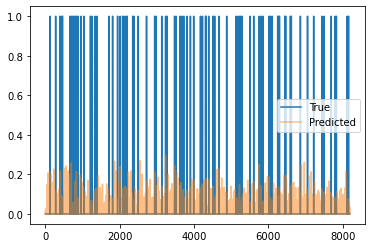

Train Epoch: 16 [610/2220 (27%)]	Loss: 0.043275	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [620/2220 (27%)]	Loss: 0.042474	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [630/2220 (28%)]	Loss: 0.046554	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [640/2220 (28%)]	Loss: 0.040965	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [650/2220 (29%)]	Loss: 0.036621	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [660/2220 (29%)]	Loss: 0.041560	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [670/2220 (30%)]	Loss: 0.034707	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [680/2220 (30%)]	Loss: 0.038693	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [690/2220 (31%)]	Loss: 0.039299	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [700/2220 (31%)]	Loss: 0.037237	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [710/2220 (31%)]	Loss: 0.042595	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [720/2220 (32%)]	Loss: 0.035476	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 

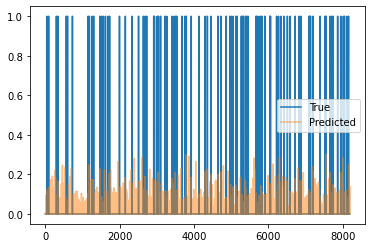

Train Epoch: 16 [910/2220 (40%)]	Loss: 0.038036	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [920/2220 (41%)]	Loss: 0.041733	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [930/2220 (41%)]	Loss: 0.040301	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [940/2220 (42%)]	Loss: 0.042148	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [950/2220 (42%)]	Loss: 0.036103	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [960/2220 (43%)]	Loss: 0.037828	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [970/2220 (43%)]	Loss: 0.041480	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [980/2220 (44%)]	Loss: 0.040580	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [990/2220 (44%)]	Loss: 0.041639	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1000/2220 (45%)]	Loss: 0.039546	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1010/2220 (45%)]	Loss: 0.039114	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1020/2220 (45%)]	Loss: 0.041599	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 

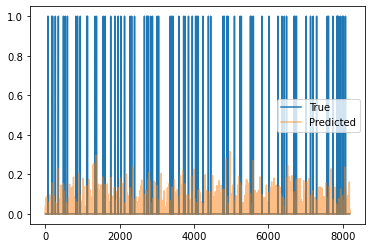

Train Epoch: 16 [1210/2220 (54%)]	Loss: 0.038588	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1220/2220 (54%)]	Loss: 0.042240	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1230/2220 (55%)]	Loss: 0.037971	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1240/2220 (55%)]	Loss: 0.041878	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1250/2220 (56%)]	Loss: 0.034003	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1260/2220 (56%)]	Loss: 0.044181	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1270/2220 (57%)]	Loss: 0.038258	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1280/2220 (57%)]	Loss: 0.040692	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1290/2220 (58%)]	Loss: 0.040548	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1300/2220 (58%)]	Loss: 0.043314	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1310/2220 (59%)]	Loss: 0.043682	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1320/2220 (59%)]	Loss: 0.043094	Pres: 0.000000	F1 Score: 0.000000
Trai

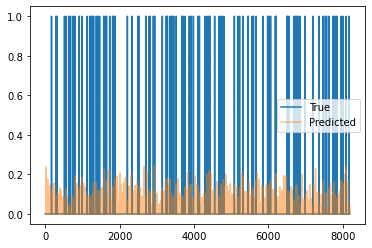

Train Epoch: 16 [1510/2220 (68%)]	Loss: 0.044930	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1520/2220 (68%)]	Loss: 0.040542	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1530/2220 (68%)]	Loss: 0.036735	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1540/2220 (69%)]	Loss: 0.038506	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1550/2220 (69%)]	Loss: 0.035318	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1560/2220 (70%)]	Loss: 0.041841	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1570/2220 (70%)]	Loss: 0.043132	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1580/2220 (71%)]	Loss: 0.038080	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1590/2220 (71%)]	Loss: 0.043320	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1600/2220 (72%)]	Loss: 0.039480	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1610/2220 (72%)]	Loss: 0.036959	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1620/2220 (72%)]	Loss: 0.038924	Pres: 0.000000	F1 Score: 0.000000
Trai

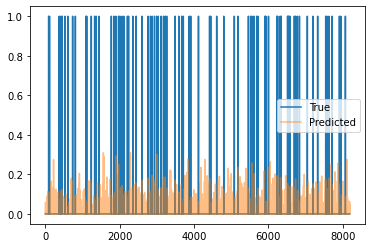

Train Epoch: 16 [1810/2220 (81%)]	Loss: 0.040795	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1820/2220 (81%)]	Loss: 0.040918	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1830/2220 (82%)]	Loss: 0.039452	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1840/2220 (82%)]	Loss: 0.042707	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1850/2220 (83%)]	Loss: 0.038806	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1860/2220 (83%)]	Loss: 0.041756	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 16 [1870/2220 (84%)]	Loss: 0.036561	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1880/2220 (84%)]	Loss: 0.039233	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1890/2220 (85%)]	Loss: 0.039921	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1900/2220 (85%)]	Loss: 0.037407	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1910/2220 (86%)]	Loss: 0.044444	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [1920/2220 (86%)]	Loss: 0.039549	Pres: 0.000000	F1 Score: 0.000000
Trai

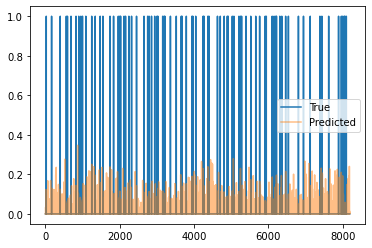

Train Epoch: 16 [2110/2220 (95%)]	Loss: 0.039621	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [2120/2220 (95%)]	Loss: 0.040899	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [2130/2220 (95%)]	Loss: 0.038987	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [2140/2220 (96%)]	Loss: 0.048002	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [2150/2220 (96%)]	Loss: 0.035597	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [2160/2220 (97%)]	Loss: 0.044031	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [2170/2220 (97%)]	Loss: 0.043979	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [2180/2220 (98%)]	Loss: 0.036259	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [2190/2220 (98%)]	Loss: 0.040764	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [2200/2220 (99%)]	Loss: 0.038509	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 16 [2210/2220 (99%)]	Loss: 0.043959	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 16 [0/582 (0%)]	Loss: 0.038471	Pres: 0.000000	F1 Score: 0.000000


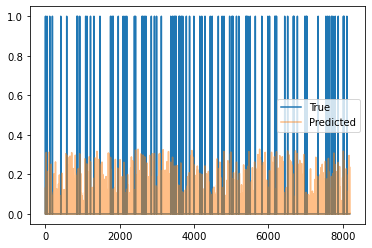

Validation Epoch: 16 [10/582 (1%)]	Loss: 0.036561	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 16 [20/582 (3%)]	Loss: 0.034349	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 16 [30/582 (5%)]	Loss: 0.035808	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 16 [40/582 (6%)]	Loss: 0.037811	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 16 [50/582 (8%)]	Loss: 0.034953	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 16 [60/582 (10%)]	Loss: 0.036291	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 16 [70/582 (12%)]	Loss: 0.035934	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 16 [80/582 (13%)]	Loss: 0.036233	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 16 [90/582 (15%)]	Loss: 0.036851	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 16 [100/582 (17%)]	Loss: 0.036693	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 16 [110/582 (18%)]	Loss: 0.037843	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 16 [120/582 (20%)]	Loss: 0.036996	Pres: 0.000000	F

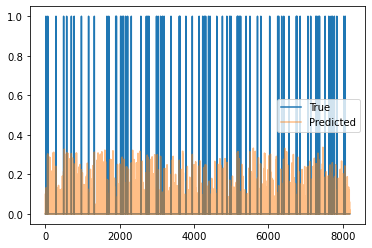

Validation Epoch: 16 [310/582 (53%)]	Loss: 0.037039	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 16 [320/582 (54%)]	Loss: 0.036936	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 16 [330/582 (56%)]	Loss: 0.035999	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 16 [340/582 (58%)]	Loss: 0.036067	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 16 [350/582 (60%)]	Loss: 0.037591	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 16 [360/582 (61%)]	Loss: 0.035460	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 16 [370/582 (63%)]	Loss: 0.033956	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 16 [380/582 (65%)]	Loss: 0.037495	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 16 [390/582 (67%)]	Loss: 0.038803	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 16 [400/582 (68%)]	Loss: 0.035721	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 16 [410/582 (70%)]	Loss: 0.033859	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 16 [420/582 (72%)]	Loss: 0.036429	Pr

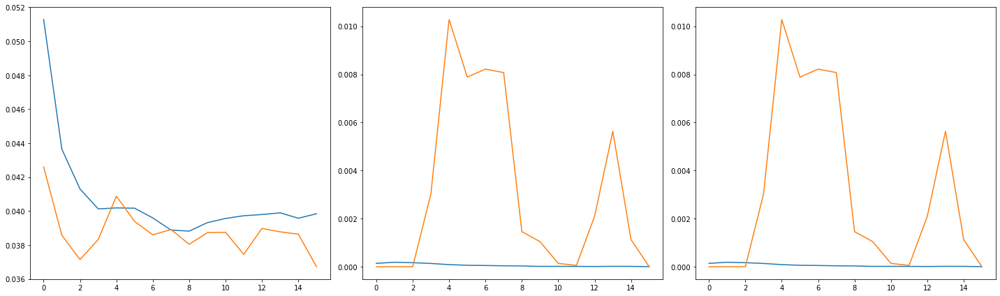

2220 582
Train Epoch: 17 [0/2220 (0%)]	Loss: 0.042008	Pres: 0.000000	F1 Score: 0.000000
89.0 -65088.0


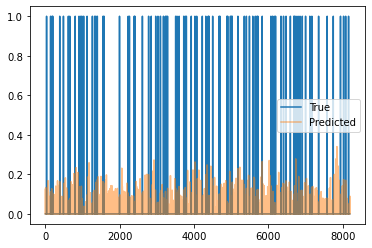

Train Epoch: 17 [10/2220 (0%)]	Loss: 0.038134	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [20/2220 (0%)]	Loss: 0.035567	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [30/2220 (1%)]	Loss: 0.040345	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [40/2220 (1%)]	Loss: 0.041003	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [50/2220 (2%)]	Loss: 0.042570	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 17 [60/2220 (2%)]	Loss: 0.038981	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [70/2220 (3%)]	Loss: 0.038730	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [80/2220 (3%)]	Loss: 0.041735	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [90/2220 (4%)]	Loss: 0.038232	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [100/2220 (4%)]	Loss: 0.047606	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [110/2220 (4%)]	Loss: 0.042203	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [120/2220 (5%)]	Loss: 0.045034	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [130/2220 (5%)]	Loss:

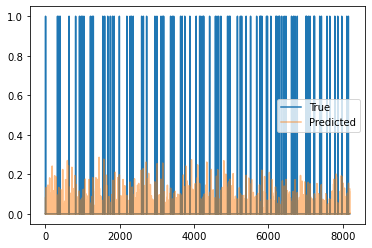

Train Epoch: 17 [310/2220 (13%)]	Loss: 0.046234	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [320/2220 (14%)]	Loss: 0.040138	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [330/2220 (14%)]	Loss: 0.040618	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [340/2220 (15%)]	Loss: 0.037389	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [350/2220 (15%)]	Loss: 0.040696	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [360/2220 (16%)]	Loss: 0.043271	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [370/2220 (16%)]	Loss: 0.037702	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [380/2220 (17%)]	Loss: 0.034936	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [390/2220 (17%)]	Loss: 0.040160	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [400/2220 (18%)]	Loss: 0.039175	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [410/2220 (18%)]	Loss: 0.040369	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [420/2220 (18%)]	Loss: 0.035840	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 

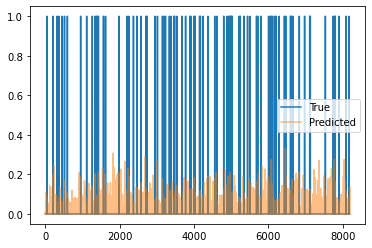

Train Epoch: 17 [610/2220 (27%)]	Loss: 0.045277	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [620/2220 (27%)]	Loss: 0.038706	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [630/2220 (28%)]	Loss: 0.037568	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [640/2220 (28%)]	Loss: 0.036851	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [650/2220 (29%)]	Loss: 0.042135	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [660/2220 (29%)]	Loss: 0.042029	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [670/2220 (30%)]	Loss: 0.036174	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [680/2220 (30%)]	Loss: 0.040837	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [690/2220 (31%)]	Loss: 0.041669	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [700/2220 (31%)]	Loss: 0.044143	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [710/2220 (31%)]	Loss: 0.041676	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [720/2220 (32%)]	Loss: 0.036845	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 

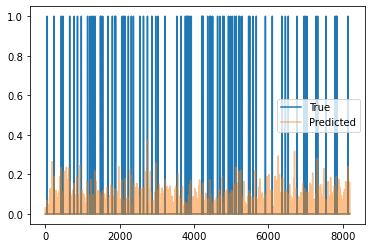

Train Epoch: 17 [910/2220 (40%)]	Loss: 0.037893	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [920/2220 (41%)]	Loss: 0.039261	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [930/2220 (41%)]	Loss: 0.039091	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [940/2220 (42%)]	Loss: 0.035551	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [950/2220 (42%)]	Loss: 0.038309	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [960/2220 (43%)]	Loss: 0.039018	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [970/2220 (43%)]	Loss: 0.040408	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [980/2220 (44%)]	Loss: 0.043276	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [990/2220 (44%)]	Loss: 0.043753	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1000/2220 (45%)]	Loss: 0.037714	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1010/2220 (45%)]	Loss: 0.040627	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1020/2220 (45%)]	Loss: 0.043695	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 

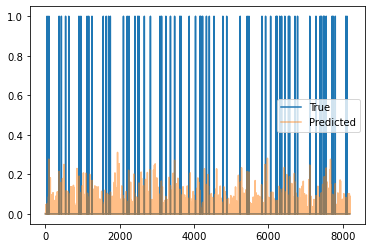

Train Epoch: 17 [1210/2220 (54%)]	Loss: 0.035901	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1220/2220 (54%)]	Loss: 0.038571	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1230/2220 (55%)]	Loss: 0.047141	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1240/2220 (55%)]	Loss: 0.037727	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1250/2220 (56%)]	Loss: 0.040478	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1260/2220 (56%)]	Loss: 0.039197	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1270/2220 (57%)]	Loss: 0.037532	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1280/2220 (57%)]	Loss: 0.038426	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1290/2220 (58%)]	Loss: 0.043043	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1300/2220 (58%)]	Loss: 0.038589	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1310/2220 (59%)]	Loss: 0.043469	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1320/2220 (59%)]	Loss: 0.040003	Pres: 0.000000	F1 Score: 0.000000
Trai

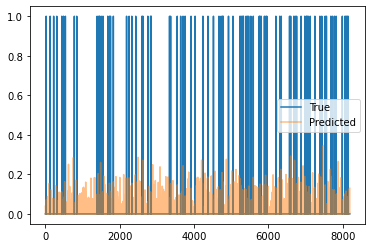

Train Epoch: 17 [1510/2220 (68%)]	Loss: 0.036714	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1520/2220 (68%)]	Loss: 0.040291	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1530/2220 (68%)]	Loss: 0.036369	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1540/2220 (69%)]	Loss: 0.039945	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1550/2220 (69%)]	Loss: 0.041419	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1560/2220 (70%)]	Loss: 0.040770	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1570/2220 (70%)]	Loss: 0.037648	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1580/2220 (71%)]	Loss: 0.039883	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1590/2220 (71%)]	Loss: 0.042873	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1600/2220 (72%)]	Loss: 0.040735	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1610/2220 (72%)]	Loss: 0.036621	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1620/2220 (72%)]	Loss: 0.035162	Pres: 0.000000	F1 Score: 0.000000
Trai

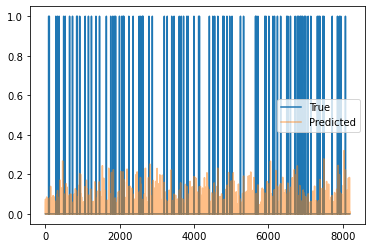

Train Epoch: 17 [1810/2220 (81%)]	Loss: 0.037859	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1820/2220 (81%)]	Loss: 0.040922	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1830/2220 (82%)]	Loss: 0.039314	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 17 [1840/2220 (82%)]	Loss: 0.037551	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1850/2220 (83%)]	Loss: 0.040913	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1860/2220 (83%)]	Loss: 0.040665	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1870/2220 (84%)]	Loss: 0.037945	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1880/2220 (84%)]	Loss: 0.040815	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1890/2220 (85%)]	Loss: 0.039806	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1900/2220 (85%)]	Loss: 0.043234	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1910/2220 (86%)]	Loss: 0.035917	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [1920/2220 (86%)]	Loss: 0.040643	Pres: 0.000000	F1 Score: 0.000000
Trai

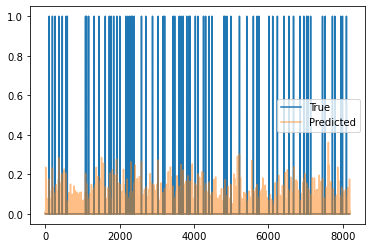

Train Epoch: 17 [2110/2220 (95%)]	Loss: 0.039028	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [2120/2220 (95%)]	Loss: 0.035230	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [2130/2220 (95%)]	Loss: 0.045418	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [2140/2220 (96%)]	Loss: 0.038143	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [2150/2220 (96%)]	Loss: 0.036992	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [2160/2220 (97%)]	Loss: 0.042510	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [2170/2220 (97%)]	Loss: 0.040317	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [2180/2220 (98%)]	Loss: 0.040995	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [2190/2220 (98%)]	Loss: 0.045425	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 17 [2200/2220 (99%)]	Loss: 0.047158	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 17 [2210/2220 (99%)]	Loss: 0.040550	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 17 [0/582 (0%)]	Loss: 0.040526	Pres: 0.000000	F1 Score: 0.000000


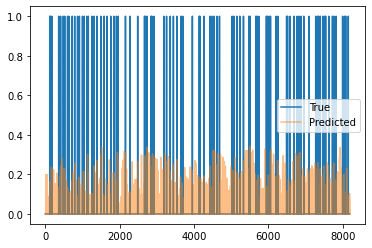

Validation Epoch: 17 [10/582 (1%)]	Loss: 0.035960	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 17 [20/582 (3%)]	Loss: 0.036626	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 17 [30/582 (5%)]	Loss: 0.037574	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 17 [40/582 (6%)]	Loss: 0.034831	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 17 [50/582 (8%)]	Loss: 0.034792	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 17 [60/582 (10%)]	Loss: 0.034777	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 17 [70/582 (12%)]	Loss: 0.037051	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 17 [80/582 (13%)]	Loss: 0.035627	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 17 [90/582 (15%)]	Loss: 0.034795	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 17 [100/582 (17%)]	Loss: 0.036489	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 17 [110/582 (18%)]	Loss: 0.036394	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 17 [120/582 (20%)]	Loss: 0.036842	Pres: 0.000000	F

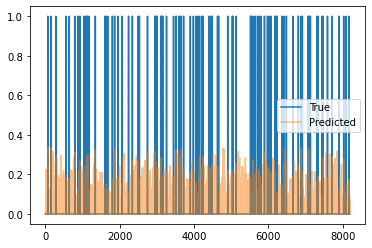

Validation Epoch: 17 [310/582 (53%)]	Loss: 0.040065	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 17 [320/582 (54%)]	Loss: 0.035512	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 17 [330/582 (56%)]	Loss: 0.033703	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 17 [340/582 (58%)]	Loss: 0.034853	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 17 [350/582 (60%)]	Loss: 0.036885	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 17 [360/582 (61%)]	Loss: 0.037226	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 17 [370/582 (63%)]	Loss: 0.035391	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 17 [380/582 (65%)]	Loss: 0.038738	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 17 [390/582 (67%)]	Loss: 0.038276	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 17 [400/582 (68%)]	Loss: 0.033869	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 17 [410/582 (70%)]	Loss: 0.035433	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 17 [420/582 (72%)]	Loss: 0.038902	Pr

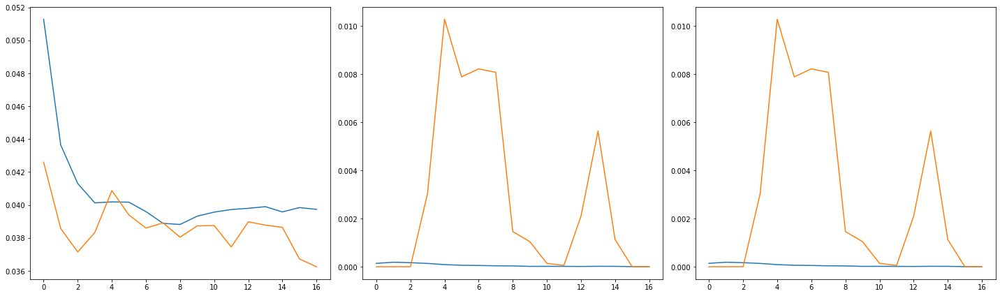

2220 582
Train Epoch: 18 [0/2220 (0%)]	Loss: 0.037171	Pres: 0.000000	F1 Score: 0.000000
82.0 -inf


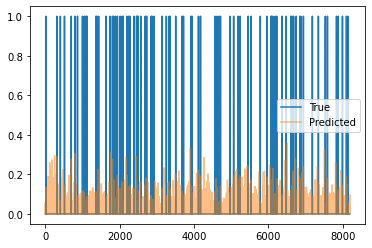

Train Epoch: 18 [10/2220 (0%)]	Loss: 0.044822	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [20/2220 (0%)]	Loss: 0.044296	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [30/2220 (1%)]	Loss: 0.039404	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [40/2220 (1%)]	Loss: 0.037596	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [50/2220 (2%)]	Loss: 0.037397	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [60/2220 (2%)]	Loss: 0.040924	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [70/2220 (3%)]	Loss: 0.040925	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [80/2220 (3%)]	Loss: 0.036867	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [90/2220 (4%)]	Loss: 0.037040	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [100/2220 (4%)]	Loss: 0.040427	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [110/2220 (4%)]	Loss: 0.036695	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [120/2220 (5%)]	Loss: 0.040505	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [130/2220 (5%)]	Loss:

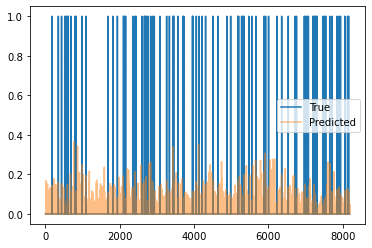

Train Epoch: 18 [310/2220 (13%)]	Loss: 0.036379	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [320/2220 (14%)]	Loss: 0.039090	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [330/2220 (14%)]	Loss: 0.040619	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 18 [340/2220 (15%)]	Loss: 0.039917	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [350/2220 (15%)]	Loss: 0.040122	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [360/2220 (16%)]	Loss: 0.042672	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [370/2220 (16%)]	Loss: 0.038640	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [380/2220 (17%)]	Loss: 0.040582	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [390/2220 (17%)]	Loss: 0.040378	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [400/2220 (18%)]	Loss: 0.037497	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 18 [410/2220 (18%)]	Loss: 0.037583	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [420/2220 (18%)]	Loss: 0.035617	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 

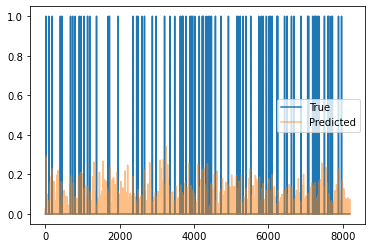

Train Epoch: 18 [610/2220 (27%)]	Loss: 0.033983	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [620/2220 (27%)]	Loss: 0.040051	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [630/2220 (28%)]	Loss: 0.045047	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [640/2220 (28%)]	Loss: 0.038286	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [650/2220 (29%)]	Loss: 0.038212	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [660/2220 (29%)]	Loss: 0.036867	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [670/2220 (30%)]	Loss: 0.036695	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [680/2220 (30%)]	Loss: 0.037788	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [690/2220 (31%)]	Loss: 0.038907	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [700/2220 (31%)]	Loss: 0.038804	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [710/2220 (31%)]	Loss: 0.039874	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [720/2220 (32%)]	Loss: 0.042666	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 

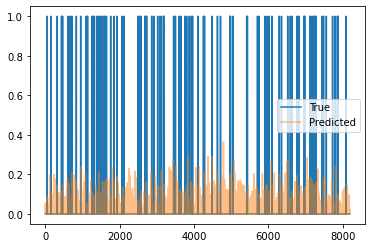

Train Epoch: 18 [910/2220 (40%)]	Loss: 0.041990	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [920/2220 (41%)]	Loss: 0.044535	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [930/2220 (41%)]	Loss: 0.038322	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [940/2220 (42%)]	Loss: 0.036450	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [950/2220 (42%)]	Loss: 0.042990	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [960/2220 (43%)]	Loss: 0.039545	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [970/2220 (43%)]	Loss: 0.041030	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [980/2220 (44%)]	Loss: 0.041347	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [990/2220 (44%)]	Loss: 0.038924	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1000/2220 (45%)]	Loss: 0.038743	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1010/2220 (45%)]	Loss: 0.041374	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1020/2220 (45%)]	Loss: 0.041250	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 

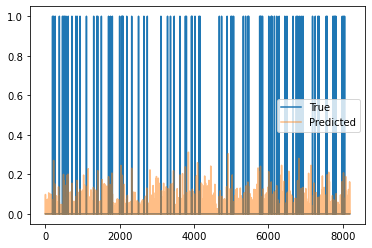

Train Epoch: 18 [1210/2220 (54%)]	Loss: 0.039016	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1220/2220 (54%)]	Loss: 0.040803	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 18 [1230/2220 (55%)]	Loss: 0.042988	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1240/2220 (55%)]	Loss: 0.038830	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1250/2220 (56%)]	Loss: 0.038144	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1260/2220 (56%)]	Loss: 0.041027	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1270/2220 (57%)]	Loss: 0.039913	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1280/2220 (57%)]	Loss: 0.039463	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1290/2220 (58%)]	Loss: 0.034955	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1300/2220 (58%)]	Loss: 0.038141	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1310/2220 (59%)]	Loss: 0.035295	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1320/2220 (59%)]	Loss: 0.040222	Pres: 0.000122	F1 Score: 0.000122
Trai

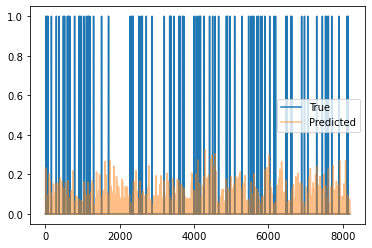

Train Epoch: 18 [1510/2220 (68%)]	Loss: 0.041317	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1520/2220 (68%)]	Loss: 0.042080	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1530/2220 (68%)]	Loss: 0.034540	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1540/2220 (69%)]	Loss: 0.043214	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1550/2220 (69%)]	Loss: 0.044196	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1560/2220 (70%)]	Loss: 0.039691	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1570/2220 (70%)]	Loss: 0.041587	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1580/2220 (71%)]	Loss: 0.035708	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1590/2220 (71%)]	Loss: 0.038339	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1600/2220 (72%)]	Loss: 0.042550	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1610/2220 (72%)]	Loss: 0.039911	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1620/2220 (72%)]	Loss: 0.043209	Pres: 0.000000	F1 Score: 0.000000
Trai

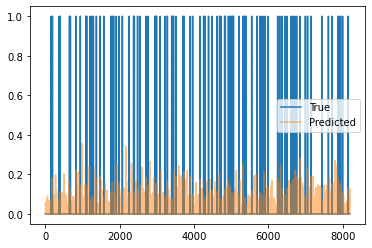

Train Epoch: 18 [1810/2220 (81%)]	Loss: 0.040941	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1820/2220 (81%)]	Loss: 0.040240	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1830/2220 (82%)]	Loss: 0.035665	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1840/2220 (82%)]	Loss: 0.040696	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1850/2220 (83%)]	Loss: 0.039177	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1860/2220 (83%)]	Loss: 0.037989	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1870/2220 (84%)]	Loss: 0.048178	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1880/2220 (84%)]	Loss: 0.036679	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1890/2220 (85%)]	Loss: 0.037740	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1900/2220 (85%)]	Loss: 0.039849	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1910/2220 (86%)]	Loss: 0.037693	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [1920/2220 (86%)]	Loss: 0.035672	Pres: 0.000000	F1 Score: 0.000000
Trai

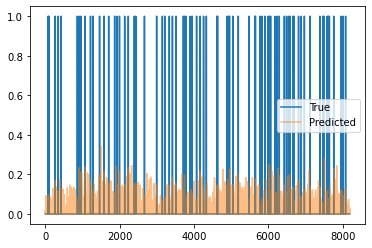

Train Epoch: 18 [2110/2220 (95%)]	Loss: 0.034366	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [2120/2220 (95%)]	Loss: 0.036971	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [2130/2220 (95%)]	Loss: 0.036994	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [2140/2220 (96%)]	Loss: 0.038473	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [2150/2220 (96%)]	Loss: 0.040572	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [2160/2220 (97%)]	Loss: 0.043668	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [2170/2220 (97%)]	Loss: 0.038371	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [2180/2220 (98%)]	Loss: 0.041540	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [2190/2220 (98%)]	Loss: 0.040705	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [2200/2220 (99%)]	Loss: 0.037620	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 18 [2210/2220 (99%)]	Loss: 0.038241	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 18 [0/582 (0%)]	Loss: 0.034089	Pres: 0.000000	F1 Score: 0.000000


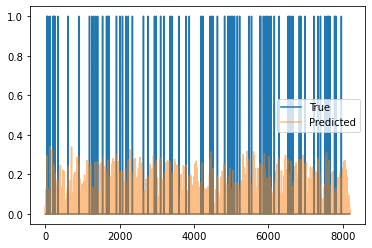

Validation Epoch: 18 [10/582 (1%)]	Loss: 0.033991	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 18 [20/582 (3%)]	Loss: 0.033176	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 18 [30/582 (5%)]	Loss: 0.038226	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 18 [40/582 (6%)]	Loss: 0.033999	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 18 [50/582 (8%)]	Loss: 0.037007	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 18 [60/582 (10%)]	Loss: 0.036742	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 18 [70/582 (12%)]	Loss: 0.035945	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 18 [80/582 (13%)]	Loss: 0.034369	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 18 [90/582 (15%)]	Loss: 0.036993	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 18 [100/582 (17%)]	Loss: 0.035406	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 18 [110/582 (18%)]	Loss: 0.036736	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 18 [120/582 (20%)]	Loss: 0.037232	Pres: 0.000000	F

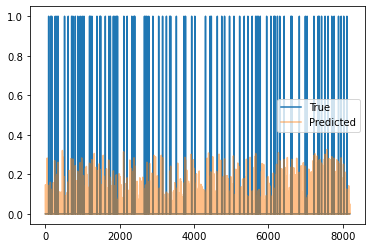

Validation Epoch: 18 [310/582 (53%)]	Loss: 0.035036	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 18 [320/582 (54%)]	Loss: 0.035193	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 18 [330/582 (56%)]	Loss: 0.036460	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 18 [340/582 (58%)]	Loss: 0.034240	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 18 [350/582 (60%)]	Loss: 0.035352	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 18 [360/582 (61%)]	Loss: 0.035059	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 18 [370/582 (63%)]	Loss: 0.035807	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 18 [380/582 (65%)]	Loss: 0.036074	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 18 [390/582 (67%)]	Loss: 0.031352	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 18 [400/582 (68%)]	Loss: 0.035629	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 18 [410/582 (70%)]	Loss: 0.036562	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 18 [420/582 (72%)]	Loss: 0.037494	Pr

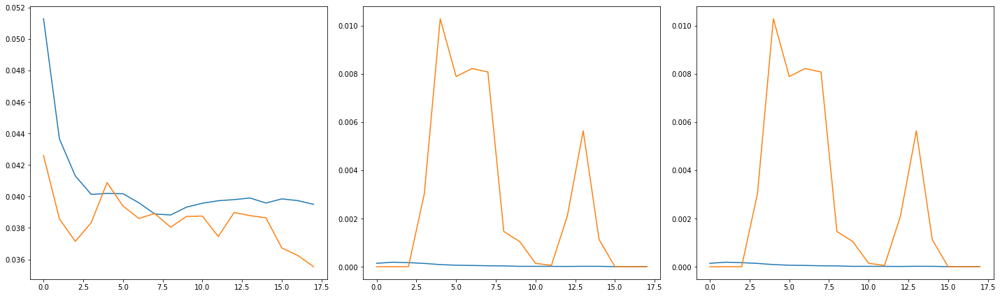

2220 582
Train Epoch: 19 [0/2220 (0%)]	Loss: 0.038822	Pres: 0.000000	F1 Score: 0.000000
85.0 -inf


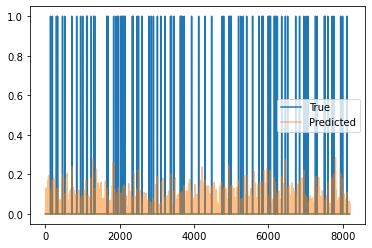

Train Epoch: 19 [10/2220 (0%)]	Loss: 0.039265	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [20/2220 (0%)]	Loss: 0.043747	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [30/2220 (1%)]	Loss: 0.042963	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [40/2220 (1%)]	Loss: 0.038792	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [50/2220 (2%)]	Loss: 0.036816	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [60/2220 (2%)]	Loss: 0.038969	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [70/2220 (3%)]	Loss: 0.042149	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [80/2220 (3%)]	Loss: 0.047513	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [90/2220 (4%)]	Loss: 0.042659	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [100/2220 (4%)]	Loss: 0.039461	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [110/2220 (4%)]	Loss: 0.036577	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [120/2220 (5%)]	Loss: 0.039725	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [130/2220 (5%)]	Loss:

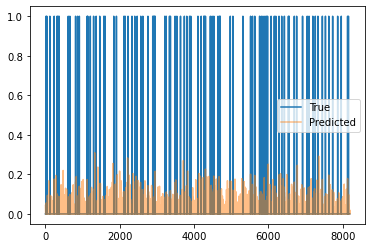

Train Epoch: 19 [310/2220 (13%)]	Loss: 0.037817	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [320/2220 (14%)]	Loss: 0.037893	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [330/2220 (14%)]	Loss: 0.041356	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [340/2220 (15%)]	Loss: 0.042929	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [350/2220 (15%)]	Loss: 0.037856	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [360/2220 (16%)]	Loss: 0.036937	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [370/2220 (16%)]	Loss: 0.037008	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [380/2220 (17%)]	Loss: 0.033651	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [390/2220 (17%)]	Loss: 0.043965	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [400/2220 (18%)]	Loss: 0.037657	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [410/2220 (18%)]	Loss: 0.039662	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [420/2220 (18%)]	Loss: 0.039286	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 

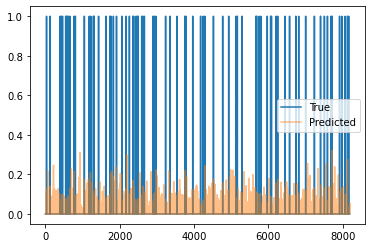

Train Epoch: 19 [610/2220 (27%)]	Loss: 0.035362	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [620/2220 (27%)]	Loss: 0.039690	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [630/2220 (28%)]	Loss: 0.039659	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [640/2220 (28%)]	Loss: 0.040940	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [650/2220 (29%)]	Loss: 0.040494	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [660/2220 (29%)]	Loss: 0.039854	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [670/2220 (30%)]	Loss: 0.040148	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [680/2220 (30%)]	Loss: 0.036937	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [690/2220 (31%)]	Loss: 0.038979	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [700/2220 (31%)]	Loss: 0.038523	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [710/2220 (31%)]	Loss: 0.039533	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [720/2220 (32%)]	Loss: 0.043755	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 

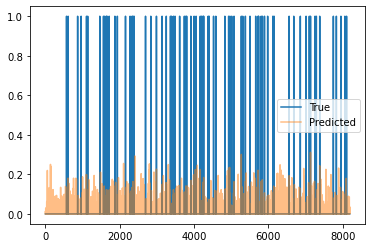

Train Epoch: 19 [910/2220 (40%)]	Loss: 0.041344	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [920/2220 (41%)]	Loss: 0.037356	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [930/2220 (41%)]	Loss: 0.039340	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [940/2220 (42%)]	Loss: 0.040334	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [950/2220 (42%)]	Loss: 0.035979	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [960/2220 (43%)]	Loss: 0.039299	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [970/2220 (43%)]	Loss: 0.041142	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [980/2220 (44%)]	Loss: 0.039954	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [990/2220 (44%)]	Loss: 0.034927	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1000/2220 (45%)]	Loss: 0.035877	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1010/2220 (45%)]	Loss: 0.037392	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1020/2220 (45%)]	Loss: 0.038435	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 

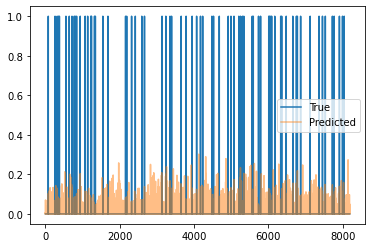

Train Epoch: 19 [1210/2220 (54%)]	Loss: 0.043134	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1220/2220 (54%)]	Loss: 0.037140	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1230/2220 (55%)]	Loss: 0.037531	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1240/2220 (55%)]	Loss: 0.039119	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1250/2220 (56%)]	Loss: 0.038011	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1260/2220 (56%)]	Loss: 0.036290	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1270/2220 (57%)]	Loss: 0.039288	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1280/2220 (57%)]	Loss: 0.035409	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1290/2220 (58%)]	Loss: 0.037542	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1300/2220 (58%)]	Loss: 0.042310	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1310/2220 (59%)]	Loss: 0.038430	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1320/2220 (59%)]	Loss: 0.035341	Pres: 0.000000	F1 Score: 0.000000
Trai

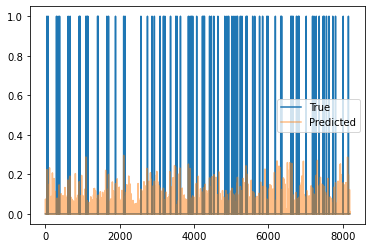

Train Epoch: 19 [1510/2220 (68%)]	Loss: 0.039892	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1520/2220 (68%)]	Loss: 0.040544	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1530/2220 (68%)]	Loss: 0.040107	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1540/2220 (69%)]	Loss: 0.037880	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1550/2220 (69%)]	Loss: 0.043734	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1560/2220 (70%)]	Loss: 0.042505	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1570/2220 (70%)]	Loss: 0.040857	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1580/2220 (71%)]	Loss: 0.040327	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1590/2220 (71%)]	Loss: 0.036491	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1600/2220 (72%)]	Loss: 0.042312	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1610/2220 (72%)]	Loss: 0.044063	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1620/2220 (72%)]	Loss: 0.039395	Pres: 0.000000	F1 Score: 0.000000
Trai

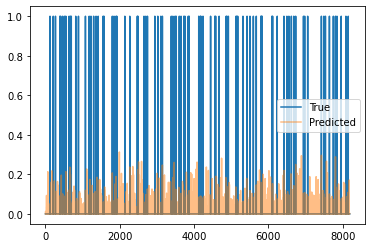

Train Epoch: 19 [1810/2220 (81%)]	Loss: 0.041369	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1820/2220 (81%)]	Loss: 0.034823	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1830/2220 (82%)]	Loss: 0.041569	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1840/2220 (82%)]	Loss: 0.041037	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1850/2220 (83%)]	Loss: 0.041137	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1860/2220 (83%)]	Loss: 0.041131	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1870/2220 (84%)]	Loss: 0.042217	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1880/2220 (84%)]	Loss: 0.036365	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1890/2220 (85%)]	Loss: 0.038718	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1900/2220 (85%)]	Loss: 0.037707	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1910/2220 (86%)]	Loss: 0.038133	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [1920/2220 (86%)]	Loss: 0.035702	Pres: 0.000000	F1 Score: 0.000000
Trai

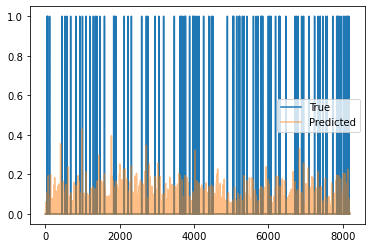

Train Epoch: 19 [2110/2220 (95%)]	Loss: 0.036232	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [2120/2220 (95%)]	Loss: 0.042184	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [2130/2220 (95%)]	Loss: 0.039407	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [2140/2220 (96%)]	Loss: 0.038821	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [2150/2220 (96%)]	Loss: 0.037557	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [2160/2220 (97%)]	Loss: 0.038375	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [2170/2220 (97%)]	Loss: 0.043439	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [2180/2220 (98%)]	Loss: 0.041155	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [2190/2220 (98%)]	Loss: 0.043768	Pres: 0.000122	F1 Score: 0.000122
Train Epoch: 19 [2200/2220 (99%)]	Loss: 0.041482	Pres: 0.000000	F1 Score: 0.000000
Train Epoch: 19 [2210/2220 (99%)]	Loss: 0.038777	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 19 [0/582 (0%)]	Loss: 0.042511	Pres: 0.000000	F1 Score: 0.000000


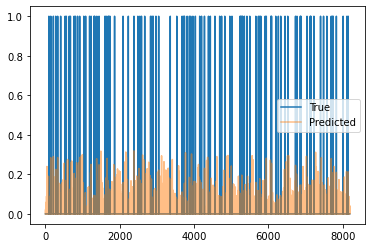

Validation Epoch: 19 [10/582 (1%)]	Loss: 0.038918	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 19 [20/582 (3%)]	Loss: 0.036415	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 19 [30/582 (5%)]	Loss: 0.041041	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 19 [40/582 (6%)]	Loss: 0.035459	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 19 [50/582 (8%)]	Loss: 0.034126	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 19 [60/582 (10%)]	Loss: 0.039211	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 19 [70/582 (12%)]	Loss: 0.035406	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 19 [80/582 (13%)]	Loss: 0.034813	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 19 [90/582 (15%)]	Loss: 0.036079	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 19 [100/582 (17%)]	Loss: 0.033342	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 19 [110/582 (18%)]	Loss: 0.035802	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 19 [120/582 (20%)]	Loss: 0.033929	Pres: 0.000000	F

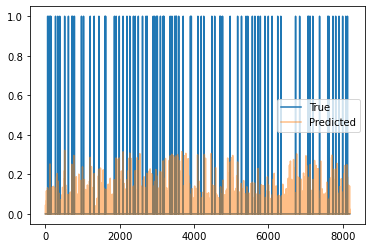

Validation Epoch: 19 [310/582 (53%)]	Loss: 0.037200	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 19 [320/582 (54%)]	Loss: 0.032681	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 19 [330/582 (56%)]	Loss: 0.037382	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 19 [340/582 (58%)]	Loss: 0.037114	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 19 [350/582 (60%)]	Loss: 0.036021	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 19 [360/582 (61%)]	Loss: 0.038476	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 19 [370/582 (63%)]	Loss: 0.039432	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 19 [380/582 (65%)]	Loss: 0.034803	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 19 [390/582 (67%)]	Loss: 0.036570	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 19 [400/582 (68%)]	Loss: 0.038052	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 19 [410/582 (70%)]	Loss: 0.039577	Pres: 0.000000	F1 Score: 0.000000
Validation Epoch: 19 [420/582 (72%)]	Loss: 0.037002	Pr

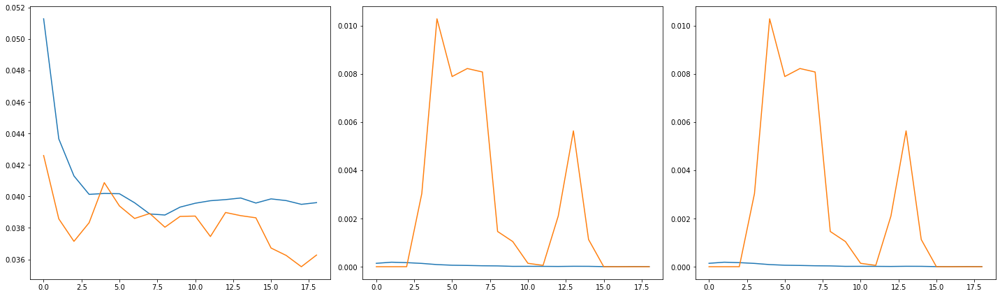

In [11]:
trainer.train(debug=False)